In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import math
import seaborn as sns
from random import seed

from scipy.stats import zscore
from sklearn.model_selection import train_test_split
from sklearn import preprocessing
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import  MinMaxScaler
from sklearn.preprocessing import RobustScaler
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import Normalizer
from sklearn.preprocessing import Imputer
from sklearn.metrics import mean_absolute_error

from keras.models import Sequential
from keras.layers import Dense, Activation, Dropout, LSTM, BatchNormalization
from keras import layers
from keras import optimizers
from keras import callbacks
from keras import models
from keras.utils import to_categorical

Using TensorFlow backend.


In [2]:
#Generate Dataset
#Airfoil Self-Noise
df_airfoil=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Airfoil_self_noise.csv')

#Automobile
df_automobile=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Automobile_data.txt')

#Autompg
df_autompg=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Auto-mpg.csv')

#ChallengerUSA
df_challenger=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Challenger USA Space Shuttle O-Ring.csv')

#Combine Cycle Power
df_combine=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Combine Cycle Power Plant.csv')

#Computer Hardware
df_computer=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Computer Hardware.csv')

#Concrete Compressive Strength
df_concrete_compressive_strength=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Concrete Compressive Strength.csv')

#Concrete Slump Test
df_concrete1=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Concrete Slump Test.csv')
df_concrete2=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Concrete Slump Test.csv')
df_concrete3=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Concrete Slump Test.csv')

#Energy Efficiency
df_energy1=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Energy Efficiency.csv')
df_energy2=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Energy Efficiency.csv')

#Fertility Diagnosis
df_fertility=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\fertility_Diagnosis.csv')

#Forest Fires
df_forest=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\forestfires.csv')

#Housing
df_housing=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Housing.csv')

#Istanbul Stock Exchange
df_istanbul=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Istanbul Stock Exchange.csv')

#WDBC
df_wdbc=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\wdbc.csv')

In [3]:
#remove Nan columns of df_energy1
df_energy1=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Energy Efficiency.csv')
df_energy1.drop(df_energy1.columns[11],inplace=True, axis = 1)
df_energy1.drop(df_energy1.columns[10],inplace=True, axis = 1)

#remove Nan columns of df_energy2
df_energy2=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Energy Efficiency.csv')
df_energy2.drop(df_energy2.columns[11],inplace=True, axis = 1)
df_energy2.drop(df_energy2.columns[10],inplace=True, axis = 1)

#remove question marks
#df_automobile
imp= Imputer(missing_values="NaN", strategy="mean")
df_automobile=df_automobile.replace("?", np.NaN)
df_automobile['num-of-doors'] = df_automobile['num-of-doors'].fillna("four")
for i in df_automobile.columns:
    if df_automobile[i].isnull().sum()>0:
        df_automobile[i]=imp.fit_transform(df_automobile[[i]])
#df_automobile = df_automobile[(df_automobile.astype(str) != '?').all(axis=1)]
#df_automobile.reset_index(drop=True, inplace=True)
df_automobile = df_automobile.drop(['engine-location'], axis=1)
#df_autompg
df_autompg = df_autompg[(df_autompg.astype(str) != '?').all(axis=1)]
df_autompg.reset_index(drop=True, inplace=True)

#convert string to number
le=LabelEncoder()
#df_automobile
string_automobile=df_automobile[['make','fuel-type','aspiration','num-of-doors', 'body-style', 'drive-wheels', 'engine-type', 'num-of-cylinders', 'fuel-system']]
df_automobile[['make','fuel-type','aspiration','num-of-doors', 'body-style', 'drive-wheels', 'engine-type', 'num-of-cylinders', 'fuel-system']]=string_automobile.apply(le.fit_transform)
encoder=df_automobile[['make','fuel-type','aspiration','num-of-doors', 'body-style', 'drive-wheels', 'engine-type', 'num-of-cylinders', 'fuel-system']].astype(np.int64)
df_automobile[['make','fuel-type','aspiration','num-of-doors', 'body-style', 'drive-wheels', 'engine-type', 'num-of-cylinders', 'fuel-system']]=encoder
a=df_automobile[['normalized-losses','horsepower','price']].astype(np.int64)
b=df_automobile[['bore','stroke','peak-rpm']].astype(float)
df_automobile[['normalized-losses','horsepower','price']]=a
df_automobile[['bore','stroke','peak-rpm']]=b

#df_challenger
#category1=[]
#for i in range(len(df_challenger)):
    #if df_challenger['Leak-Check Pressure'].iloc[i]==50:
        #category1.append(0)
    #if df_challenger['Leak-Check Pressure'].iloc[i]==100:
        #category1.append(1)
    #if df_challenger['Leak-Check Pressure'].iloc[i]==200:
        #category1.append(2)
#df_challenger['category']=category1

#df_computer
string_computer=df_computer[['Vendor','Model']]
df_computer[['Vendor','Model']]=string_computer.apply(le.fit_transform)
df_computer[['Vendor','Model']]=df_computer[['Vendor','Model']].astype(np.int64)

#dropna spesific column & special preprocessing
#df_forest
df_forest=df_forest[(df_forest['area'].astype(int) != 0)] 
df_forest.reset_index(drop=True, inplace=True)
num_features=10
dimension=(num_features+1)*9+10
population_size=(2*dimension+1)*2
df_forest=df_forest[:population_size]

C:\Users\user\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:66: DeprecationWarning: Class Imputer is deprecated; Imputer was deprecated in version 0.20 and will be removed in 0.22. Import impute.SimpleImputer from sklearn instead.
  warnings.warn(msg, category=DeprecationWarning)


In [4]:
def preprocessing_data1(df,num_features):
    dimension=(num_features+1)*9+10
    population_size=(2*dimension+1)*2
    df=df.dropna()
    df=df[:population_size]
    df
    return df

In [5]:
def feature_selection(df):
    cor=df.corr()
    plt.figure(figsize=(100,50))
    sns.set(font_scale=3)
    sns.heatmap(cor, annot=True, cmap=plt.cm.Blues)
    plt.show()
    return cor

In [6]:
def train_test_split1(x, y):
    x_train, x_test, y_train, y_test= train_test_split(x, y, test_size=0.15, random_state=42)
    return x_train, x_test, y_train, y_test

In [7]:
#df_airfoil=preprocessing_data1(df_airfoil,5)
#df_automobile=preprocessing_data1(df_automobile,22)
#df_autompg=preprocessing_data1(df_autompg,7)
#df_challenger=preprocessing_data1(df_challenger,3)
#df_combine=preprocessing_data1(df_combine,4)
#df_computer=preprocessing_data1(df_computer,9)
#df_concrete_compressive_strength=preprocessing_data1(df_concrete_compressive_strength,8)
#df_concrete1=preprocessing_data1(df_concrete1,7)
#df_concrete2=preprocessing_data1(df_concrete2,7)
#df_concrete3=preprocessing_data1(df_concrete3,7)
#df_energy1=preprocessing_data1(df_energy1,8)
#df_energy2=preprocessing_data1(df_energy2,8)

#df_fertility=preprocessing_data1(df_fertility,9)
for i in df_fertility:
    df_fertility.Diagnosis[df_fertility.Diagnosis == 'N'] = 1
    df_fertility.Diagnosis[df_fertility.Diagnosis == 'O'] = 2
df_fertility['Diagnosis']=df_fertility['Diagnosis'].astype(np.int64)

#df_forest=preprocessing_data1(df_forest,10)
#df_housing=preprocessing_data1(df_housing,13)

#df_istanbul=preprocessing_data1(df_istanbul,7)
new_header = df_istanbul.iloc[0]
df_istanbul = df_istanbul[1:]
df_istanbul.columns = new_header
df_istanbul[['ISE1','ISE2','SP','DAX','FTSE','NIKKEI','BOVESPA','EU','EM']]=df_istanbul[['ISE1','ISE2','SP','DAX','FTSE','NIKKEI','BOVESPA','EU','EM']].astype(np.float64)


#df_wdbc=preprocessing_data1(df_wdbc,10)
df_wdbc.drop(df_wdbc.columns[0], axis=1, inplace = True)
df_wdbc.columns=['id','diagnosis','radius_mean','texture_mean','perimeter_mean','area_mean','smoothness_mean','compactness_mean','concavity_mean','concave points_mean','symmetry_mean','fractal_dimension_mean','radius_se','texture_se','perimeter_se','area_se','smoothness_se','compactness_se','concavity_se','concave points_se','symmetry_se','fractal_dimension_se','radius_worst','texture_worst','perimeter_worst','area_worst','smoothness_worst','compactness_worst','concavity_worst','concave points_worst','symmetry_worst','fractal_dimension_worst']
for i in df_wdbc:
    df_wdbc.diagnosis[df_wdbc.diagnosis == 'M'] = 1
    df_wdbc.diagnosis[df_wdbc.diagnosis == 'B'] = 2
df_wdbc['diagnosis']=df_wdbc['diagnosis'].astype(np.object)

C:\Users\user\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  app.launch_new_instance()
C:\Users\user\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Users\user\Anaconda3\lib\site-packages\ipykernel_launcher.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Users\user\Anaconda3\lib\site-packages\ipykernel_launcher.py:35: SettingWithCopyWarning: 
A value is trying to be set on a 

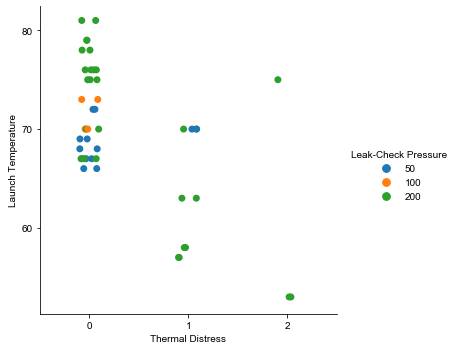

In [8]:
ax = sns.catplot(x='Thermal Distress', y='Launch Temperature', hue='Leak-Check Pressure', data=df_challenger, s=7)
sns.set(font_scale=2)

In [9]:
#Train and Test 17 datasets
#Airfoil
x_airfoil1 = df_airfoil.drop(['Frequency'], axis = 1)
y_airfoil1 = df_airfoil['Frequency']
y_airfoil1 = np.reshape(y_airfoil1.values, (-1,1))
x_airfoil2 = df_airfoil.drop(['Angle of Attack'], axis = 1)
y_airfoil2 = df_airfoil['Angle of Attack']
#x_airfoil2 = df_airfoil.drop(['Free-stream velocity','category'], axis = 1)
#y_airfoil2 = df_airfoil['category']
#y_airfoil2=to_categorical(y_airfoil2)
#Wdbc
#x_wdbc = df_wdbc[['radius_mean','perimeter_mean','area_mean','concavity_mean','concave points_mean','radius_worst','perimeter_worst','area_worst','concave points_worst']]
#y_wdbc = df_wdbc['diagnosis']
#labelencoder_Y = LabelEncoder()
#y_wdbc = labelencoder_Y.fit_transform(y_wdbc)
#Automobile
x_automobile1 = df_automobile.drop(['bore','make','body-style'], axis = 1)
y_automobile1 = df_automobile['bore']
x_automobile2 = df_automobile.drop(['horsepower','make','body-style'], axis = 1)
y_automobile2 = df_automobile['horsepower']
y_automobile2 = np.reshape(y_automobile2.values, (-1,1))
#Autompg
x_autompg1 = df_autompg.drop(['Displacement','Car Name'], axis = 1)
y_autompg1 = df_autompg['Displacement']
y_autompg1 = np.reshape(y_autompg1.values, (-1,1))
x_autompg2 = df_autompg.drop(['Acceleration','Car Name'], axis = 1)
y_autompg2 = df_autompg['Acceleration']
#Challenger
x_challenger1 = df_challenger.drop(['Number of O-rings','Launch Temperature'], axis = 1)
y_challenger1 = df_challenger['Launch Temperature']
x_challenger2 = df_challenger.drop(['Number of O-rings','Leak-Check Pressure'], axis = 1)
y_challenger2 = df_challenger['Leak-Check Pressure']
#y_challenger2=to_categorical(y_challenger2)
#Combine
#x_combine = df_combine.drop(['PE'], axis = 1)
#y_combine = df_combine['PE']
#y_combine = np.reshape(y_combine.values, (-1,1))
#Computer
#x_computer = df_computer.drop(['ERP'], axis = 1)
#y_computer = df_computer['ERP']
#y_computer = np.reshape(y_computer.values, (-1,1))
#Concrete_compressive_strength
#x_concrete_compressive_strength = df_concrete_compressive_strength.drop(['CCS'], axis = 1)
#y_concrete_compressive_strength = df_concrete_compressive_strength['CCS']
#y_concrete_compressive_strength = np.reshape(y_concrete_compressive_strength.values, (-1,1))
#Concrete1
#x_concrete1 = df_concrete1.drop(['No','Compressive Strength (28-day)(Mpa)'], axis = 1)
#y_concrete1 = df_concrete1['Compressive Strength (28-day)(Mpa)']
#Concrete2
#x_concrete2 = df_concrete2.drop(['No','SLUMP(cm)'], axis = 1)
#y_concrete2 = df_concrete2['SLUMP(cm)']
#y_concrete2 = np.reshape(y_concrete2.values, (-1,1))
#Concrete3
#x_concrete3 = df_concrete3.drop(['No','FLOW(cm)'], axis = 1)
#y_concrete3 = df_concrete3['FLOW(cm)']
#y_concrete3 = np.reshape(y_concrete3.values, (-1,1))
#Energy1
#x_energy1 = df_energy1.drop(['Y1'], axis = 1)
#y_energy1 = df_energy1['Y1']
#Energy2
#x_energy2 = df_energy2.drop(['Y2'], axis = 1)
#y_energy2 = df_energy2['Y2']
#Fertility
#x_fertility = df_fertility.drop(['Diagnosis'], axis = 1)
#y_fertility = df_fertility['Diagnosis']
#Forest
#x_forest = df_forest.drop(['month','day','area'], axis = 1)
#y_forest = df_forest['area']
#y_forest = np.reshape(y_forest.values, (-1,1))
#Housing
#x_housing = df_housing.drop(['MEDV'], axis = 1)
#y_housing = df_housing['MEDV']
#Istanbul
#x_istanbul = df_istanbul.drop(['date','ISE1','ISE2'], axis = 1)
#y_istanbul = df_istanbul[['ISE1','ISE2']]
#y_istanbul['mean'] = y_istanbul.mean(axis=1)
#y_istanbul = y_istanbul['mean']

In [10]:
x_train_airfoil1, x_test_airfoil1, y_train_airfoil1, y_test_airfoil1 = train_test_split1(x_airfoil1, y_airfoil1)
x_train_airfoil2, x_test_airfoil2, y_train_airfoil2, y_test_airfoil2 = train_test_split1(x_airfoil2, y_airfoil2)
x_train_automobile1, x_test_automobile1, y_train_automobile1, y_test_automobile1 = train_test_split1(x_automobile1, y_automobile1)
x_train_automobile2, x_test_automobile2, y_train_automobile2, y_test_automobile2 = train_test_split1(x_automobile2, y_automobile2)
x_train_autompg1, x_test_autompg1, y_train_autompg1, y_test_autompg1 = train_test_split1(x_autompg1, y_autompg1)
x_train_autompg2, x_test_autompg2, y_train_autompg2, y_test_autompg2 = train_test_split1(x_autompg2, y_autompg2)
x_train_challenger1, x_test_challenger1, y_train_challenger1, y_test_challenger1 = train_test_split1(x_challenger1, y_challenger1)
x_train_challenger2, x_test_challenger2, y_train_challenger2, y_test_challenger2 = train_test_split1(x_challenger2, y_challenger2)
#x_train_combine, x_test_combine, y_train_combine, y_test_combine = train_test_split1(x_combine, y_combine)
#x_train_computer, x_test_computer, y_train_computer, y_test_computer = train_test_split1(x_computer, y_computer)
#x_train_concrete_compressive_strength, x_test_concrete_compressive_strength, y_train_concrete_compressive_strength, y_test_concrete_compressive_strength = train_test_split1(x_concrete_compressive_strength, y_concrete_compressive_strength)
#x_train_concrete1, x_test_concrete1, y_train_concrete1, y_test_concrete1 = train_test_split1(x_concrete1, y_concrete1)
#x_train_concrete2, x_test_concrete2, y_train_concrete2, y_test_concrete2 = train_test_split1(x_concrete2, y_concrete2)
#x_train_concrete3, x_test_concrete3, y_train_concrete3, y_test_concrete3 = train_test_split1(x_concrete3, y_concrete3)
#x_train_energy1, x_test_energy1, y_train_energy1, y_test_energy1 = train_test_split1(x_energy1, y_energy1)
#x_train_energy2, x_test_energy2, y_train_energy2, y_test_energy2 = train_test_split1(x_energy2, y_energy2)
#x_train_fertility, x_test_fertility, y_train_fertility, y_test_fertility = train_test_split1(x_fertility, y_fertility)
#x_train_forest, x_test_forest, y_train_forest, y_test_forest = train_test_split1(x_forest, y_forest)
#x_train_housing, x_test_housing, y_train_housing, y_test_housing = train_test_split1(x_housing, y_housing)
#x_train_istanbul, x_test_istanbul, y_train_istanbul, y_test_istanbul = train_test_split1(x_istanbul, y_istanbul)
#x_train_wdbc, x_test_wdbc, y_train_wdbc, y_test_wdbc = train_test_split1(x_wdbc, y_wdbc)

In [11]:
def train_val_split(x_train, y_train):
    X_train, X_val, Y_train, Y_val= train_test_split(x_train, y_train, test_size=0.176, random_state=42)
    return X_train, X_val, Y_train, Y_val

In [12]:
def standard_scaler(X_train, X_val, x_test):
    sc=StandardScaler()
    X_train=X_train.values
    X_val=X_val.values
    x_test=x_test.values
    X_scale_train=sc.fit(X_train)
    #X_scale_val=sc.fit(X_val)
    #x_scale_test=sc.fit(x_test)
    X_train=X_scale_train.transform(X_train)
    X_val=X_scale_train.transform(X_val)
    x_test=X_scale_train.transform(x_test)
    return X_train, X_val, x_test, X_scale_train

In [13]:
def min_max_scaler(X_train, X_val, x_test, Y_train, Y_val, y_test):
    min_max_x=MinMaxScaler()
    min_max_y=MinMaxScaler()
    X_train=X_train.values
    X_val=X_val.values
    x_test=x_test.values
    X_scale_train=min_max_x.fit(X_train)
    #X_scale_val=min_max_x.fit(X_val)
    #x_scale_test=min_max_x.fit(x_test)
    Y_scale_train=min_max_y.fit(Y_train)
    #Y_scale_val=min_max_y.fit(Y_val)
    #y_scale_test=min_max_y.fit(y_test)
    X_train=X_scale_train.transform(X_train)
    X_val=X_scale_train.transform(X_val)
    x_test=X_scale_train.transform(x_test)
    Y_train=Y_scale_train.transform(Y_train)
    Y_val=Y_scale_train.transform(Y_val)
    y_test=Y_scale_train.transform(y_test)
    return X_train, X_val, x_test, Y_train, Y_val, y_test, X_scale_train, Y_scale_train

In [14]:
def normalization(X_train, X_val, x_test, Y_train, Y_val, y_test):
    normalizer=Normalizer()
    X_train=normalizer.fit_transform(X_train)
    X_val=normalizer.fit_transform(X_val)
    x_test=normalizer.fit_transform(x_test)
    Y_train=normalizer.fit_transform(Y_train)
    Y_val=normalizer.fit_transform(Y_val)
    y_test=normalizer.fit_transform(y_test)
    return X_train, X_val, x_test, Y_train, Y_val, y_test

In [15]:
#Optimizer list
adam0 = 'adam'
adam1 = optimizers.Adam(lr=0.001)
adam2 = optimizers.Adam(lr=0.01)
adam3 = optimizers.Adam(lr=0.0001)
adam4 = optimizers.Adam(lr=0.00001)
sgd = optimizers.SGD(lr=0.005, decay=1e-4, momentum=0.9, nesterov=True)
RMSprop= optimizers.RMSprop(lr=0.001,rho=0.9)
adagrad = optimizers.Adagrad(lr=0.01)
adadelta = optimizers.Adadelta(lr=1.0)

In [16]:
def NN_model_structure_classification(X_train, X_val, Y_train, Y_val, adam, size, epochs, x_test, y_test, classes):
    model = Sequential()
    model.add(Dense(units = 5, kernel_initializer='uniform', input_dim = (X_train.shape[1])))
    model.add(Activation('relu'))
    model.add(Dense(units = 10, kernel_initializer='uniform'))
    model.add(Activation('relu'))
    model.add(Dense(units = 20, kernel_initializer='uniform'))
    model.add(Dense(units = classes, activation='softmax'))
    model.compile(optimizer = adam , loss = 'categorical_crossentropy', metrics=['acc'])
    model.summary()
    history=model.fit(X_train,Y_train, batch_size=size,epochs=epochs, validation_data=(X_val, Y_val), shuffle=True)
    evaluate = model.evaluate(x_test, y_test, verbose=2, batch_size=size)
    print(evaluate)
    return model, history, evaluate

In [17]:
def NN_model_structure_regression(X_train, X_val, Y_train, Y_val, adam, size, epochs, x_test, y_test):
    model = Sequential()
    model.add(Dense(units = 5, input_dim = (X_train.shape[1])))
    model.add(Activation('tanh'))
    model.add(Dense(units = 10))
    model.add(Activation('linear'))
    model.add(Dense(units = 1))
    model.compile(optimizer = adam , loss = 'mse')
    model.summary()
    history=model.fit(X_train,Y_train, batch_size=size,epochs=epochs, validation_data=(X_val, Y_val), shuffle=True)
    evaluate = model.evaluate(x_test, y_test, verbose=2, batch_size=size)
    print(evaluate)
    return model, history, evaluate

In [18]:
X_train_airfoil1, X_val_airfoil1, Y_train_airfoil1, Y_val_airfoil1 = train_val_split(x_train_airfoil1, y_train_airfoil1)
X_train_airfoil2, X_val_airfoil2, Y_train_airfoil2, Y_val_airfoil2 = train_val_split(x_train_airfoil2, y_train_airfoil2)
X_train_automobile1, X_val_automobile1, Y_train_automobile1, Y_val_automobile1 = train_val_split(x_train_automobile1, y_train_automobile1)
X_train_automobile2, X_val_automobile2, Y_train_automobile2, Y_val_automobile2 = train_val_split(x_train_automobile2, y_train_automobile2)
X_train_autompg1, X_val_autompg1, Y_train_autompg1, Y_val_autompg1 = train_val_split(x_train_autompg1, y_train_autompg1)
X_train_autompg2, X_val_autompg2, Y_train_autompg2, Y_val_autompg2 = train_val_split(x_train_autompg2, y_train_autompg2)
X_train_challenger1, X_val_challenger1, Y_train_challenger1, Y_val_challenger1 = train_val_split(x_train_challenger1, y_train_challenger1)
X_train_challenger2, X_val_challenger2, Y_train_challenger2, Y_val_challenger2 = train_val_split(x_train_challenger2, y_train_challenger2)
#X_train_combine, X_val_combine, Y_train_combine, Y_val_combine = train_val_split(x_train_combine, y_train_combine)
#X_train_computer, X_val_computer, Y_train_computer, Y_val_computer = train_val_split(x_train_computer, y_train_computer)
#X_train_concrete_compressive_strength, X_val_concrete_compressive_strength, Y_train_concrete_compressive_strength, Y_val_concrete_compressive_strength = train_val_split(x_train_concrete_compressive_strength, y_train_concrete_compressive_strength)
#X_train_concrete1, X_val_concrete1, Y_train_concrete1, Y_val_concrete1 = train_val_split(x_train_concrete1, y_train_concrete1)
#X_train_concrete2, X_val_concrete2, Y_train_concrete2, Y_val_concrete2 = train_val_split(x_train_concrete2, y_train_concrete2)
#X_train_concrete3, X_val_concrete3, Y_train_concrete3, Y_val_concrete3 = train_val_split(x_train_concrete3, y_train_concrete3)
#X_train_energy1, X_val_energy1, Y_train_energy1, Y_val_energy1 = train_val_split(x_train_energy1, y_train_energy1)
#X_train_energy2, X_val_energy2, Y_train_energy2, Y_val_energy2 = train_val_split(x_train_energy2, y_train_energy2)
#X_train_fertility, X_val_fertility, Y_train_fertility, Y_val_fertility = train_val_split(x_train_fertility, y_train_fertility)
#X_train_forest, X_val_forest, Y_train_forest, Y_val_forest = train_val_split(x_train_forest, y_train_forest)
#X_train_housing, X_val_housing, Y_train_housing, Y_val_housing = train_val_split(x_train_housing, y_train_housing)
#X_train_istanbul, X_val_istanbul, Y_train_istanbul, Y_val_istanbul = train_val_split(x_train_istanbul, y_train_istanbul)
#X_train_wdbc, X_val_wdbc, Y_train_wdbc, Y_val_wdbc = train_val_split(x_train_wdbc, y_train_wdbc)

In [19]:
X_train_airfoil1, X_val_airfoil1, x_test_airfoil1, Y_train_airfoil1, Y_val_airfoil1, y_test_airfoil1, X_scale_train_airfoil1, Y_scale_train_airfoil1 =min_max_scaler(X_train_airfoil1, X_val_airfoil1, x_test_airfoil1, Y_train_airfoil1, Y_val_airfoil1, y_test_airfoil1)
X_train_airfoil2, X_val_airfoil2, x_test_airfoil2, X_scale_train_airfoil2=standard_scaler(X_train_airfoil2, X_val_airfoil2, x_test_airfoil2)
X_train_automobile1, X_val_automobile1, x_test_automobile1, X_scale_train_automobile1=standard_scaler(X_train_automobile1, X_val_automobile1, x_test_automobile1)
X_train_automobile2, X_val_automobile2, x_test_automobile2, Y_train_automobile2, Y_val_automobile2, y_test_automobile2, X_scale_train_automobile2, Y_scale_train_automobile2=min_max_scaler(X_train_automobile2, X_val_automobile2, x_test_automobile2, Y_train_automobile2, Y_val_automobile2, y_test_automobile2)
X_train_autompg1, X_val_autompg1, x_test_autompg1, Y_train_autompg1, Y_val_autompg1, y_test_autompg1, X_scale_train_autompg1, Y_scale_train_autompg1=min_max_scaler(X_train_autompg1, X_val_autompg1, x_test_autompg1, Y_train_autompg1, Y_val_autompg1, y_test_autompg1)
X_train_autompg2, X_val_autompg2, x_test_autompg2, X_scale_train_autompg2=standard_scaler(X_train_autompg2, X_val_autompg2, x_test_autompg2)
X_train_challenger1, X_val_challenger1, x_test_challenger1, X_scale_train_challenger1=standard_scaler(X_train_challenger1, X_val_challenger1, x_test_challenger1)
X_train_challenger2, X_val_challenger2, x_test_challenger2, X_scale_train_challenger2=standard_scaler(X_train_challenger2, X_val_challenger2, x_test_challenger2)
#X_train_combine, X_val_combine, x_test_combine, Y_train_combine, Y_val_combine, y_test_combine, min_max_combine=min_max_scaler(X_train_combine, X_val_combine, x_test_combine, Y_train_combine, Y_val_combine, y_test_combine)
#X_train_computer, X_val_computer, x_test_computer, Y_train_computer, Y_val_computer, y_test_computer, min_max_computer=min_max_scaler(X_train_computer, X_val_computer, x_test_computer, Y_train_computer, Y_val_computer, y_test_computer)
#X_train_concrete_compressive_strength, X_val_concrete_compressive_strength, x_test_concrete_compressive_strength, Y_train_concrete_compressive_strength, Y_val_concrete_compressive_strength, y_test_concrete_compressive_strength, min_max_concrete_compressive_strength=min_max_scaler(X_train_concrete_compressive_strength, X_val_concrete_compressive_strength, x_test_concrete_compressive_strength, Y_train_concrete_compressive_strength, Y_val_concrete_compressive_strength, y_test_concrete_compressive_strength)
#X_train_concrete1, X_val_concrete1, x_test_concrete1, X_scale_train_concrete1=standard_scaler(X_train_concrete1, X_val_concrete1, x_test_concrete1)
#X_train_concrete2, X_val_concrete2, x_test_concrete2, Y_train_concrete2, Y_val_concrete2, y_test_concrete2, min_max_concrete2=min_max_scaler(X_train_concrete2, X_val_concrete2, x_test_concrete2, Y_train_concrete2, Y_val_concrete2, y_test_concrete2)
#X_train_concrete3, X_val_concrete3, x_test_concrete3, Y_train_concrete3, Y_val_concrete3, y_test_concrete3, min_max_concrete3=min_max_scaler(X_train_concrete3, X_val_concrete3, x_test_concrete3, Y_train_concrete3, Y_val_concrete3, y_test_concrete3)
#X_train_energy1, X_val_energy1, x_test_energy1, X_scale_train_energy1=standard_scaler(X_train_energy1, X_val_energy1, x_test_energy1)
#X_train_energy2, X_val_energy2, x_test_energy2, X_scale_train_energy2=standard_scaler(X_train_energy2, X_val_energy2, x_test_energy2)
#X_train_fertility, X_val_fertility, x_test_fertility, X_scale_train_fertility=standard_scaler(X_train_fertility, X_val_fertility, x_test_fertility)
#X_train_forest, X_val_forest, x_test_forest, Y_train_forest, Y_val_forest, y_test_forest, min_max_forest=min_max_scaler(X_train_forest, X_val_forest, x_test_forest, Y_train_forest, Y_val_forest, y_test_forest)
#X_train_housing, X_val_housing, x_test_housing, X_scale_train_housing=standard_scaler(X_train_housing, X_val_housing, x_test_housing)
#X_train_istanbul, X_val_istanbul, x_test_istanbul, X_scale_train_istanbul=standard_scaler(X_train_istanbul, X_val_istanbul, x_test_istanbul)

In [20]:
model_airfoil1, history_airfoil1, evaluate_airfoil1=NN_model_structure_regression(X_train_airfoil1, X_val_airfoil1, Y_train_airfoil1, Y_val_airfoil1, adam2, 64, 100, x_test_airfoil1, y_test_airfoil1)
model_airfoil1.get_weights()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1 (Dense)              (None, 5)                 30        
_________________________________________________________________
activation_1 (Activation)    (None, 5)                 0         
_________________________________________________________________
dense_2 (Dense)              (None, 10)                60        
_________________________________________________________________
activation_2 (Activation)    (None, 10)                0         
_________________________________________________________________
dense_3 (Dense)              (None, 1)                 11        
Total params: 101
Trainable params: 101
Non-trainable params: 0
_________________________________________________________________

Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 373us/step - l

1052/1052 [==============================] - 0s 46us/step - loss: 0.0100 - val_loss: 0.0137
Epoch 68/100
1052/1052 [==============================] - 0s 48us/step - loss: 0.0100 - val_loss: 0.0137
Epoch 69/100
1052/1052 [==============================] - 0s 47us/step - loss: 0.0104 - val_loss: 0.0141
Epoch 70/100
1052/1052 [==============================] - 0s 48us/step - loss: 0.0101 - val_loss: 0.0139
Epoch 71/100
1052/1052 [==============================] - 0s 46us/step - loss: 0.0099 - val_loss: 0.0140
Epoch 72/100
1052/1052 [==============================] - 0s 48us/step - loss: 0.0097 - val_loss: 0.0138
Epoch 73/100
1052/1052 [==============================] - 0s 45us/step - loss: 0.0100 - val_loss: 0.0145
Epoch 74/100
1052/1052 [==============================] - 0s 46us/step - loss: 0.0098 - val_loss: 0.0135
Epoch 75/100
1052/1052 [==============================] - 0s 47us/step - loss: 0.0098 - val_loss: 0.0134
Epoch 76/100
1052/1052 [==============================] - 0s 48us/st

[array([[ 0.81895304, -0.23427448,  0.6076709 , -0.00931344, -1.566969  ],
        [ 0.20122118, -1.3608106 , -0.77345663,  0.40672964, -0.6701864 ],
        [ 0.14992125, -0.37113285, -0.52209854, -0.31314212,  0.462448  ],
        [-0.40894747,  0.7773711 ,  0.6996978 ,  0.22390696, -0.2370251 ],
        [-0.7268256 ,  0.5473496 , -0.5276421 , -0.9060136 , -1.8665762 ]],
       dtype=float32),
 array([ 0.10384241, -0.14932562, -0.05254095,  0.11162611,  0.16185236],
       dtype=float32),
 array([[-0.01284639, -0.5021268 , -0.22256109,  0.08595372,  0.31283304,
         -0.2683736 , -0.5624661 , -0.22187898, -0.12436058,  0.4133242 ],
        [ 0.12077147, -0.20796934, -0.27475557,  0.07527574, -0.44387195,
         -0.41402587, -0.61202943,  0.03169279, -0.17109369, -0.5928895 ],
        [-0.12756713,  0.10514296, -0.10205591, -0.09834804, -0.02036524,
         -0.01335187,  0.17397973, -0.37051415,  0.26153794,  0.18405849],
        [ 0.27495518,  0.47331706, -0.23795262,  0.016252

In [21]:
model_airfoil2, history_airfoil2, evaluate_airfoil2=NN_model_structure_regression(X_train_airfoil2, X_val_airfoil2, Y_train_airfoil2, Y_val_airfoil2, adam2, 64, 100, x_test_airfoil2, y_test_airfoil2)
model_airfoil2.get_weights()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4 (Dense)              (None, 5)                 30        
_________________________________________________________________
activation_3 (Activation)    (None, 5)                 0         
_________________________________________________________________
dense_5 (Dense)              (None, 10)                60        
_________________________________________________________________
activation_4 (Activation)    (None, 10)                0         
_________________________________________________________________
dense_6 (Dense)              (None, 1)                 11        
Total params: 101
Trainable params: 101
Non-trainable params: 0
_________________________________________________________________
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 174us/step - lo

1052/1052 [==============================] - 0s 46us/step - loss: 0.7409 - val_loss: 0.9352
Epoch 70/100
1052/1052 [==============================] - 0s 48us/step - loss: 0.6756 - val_loss: 1.0042
Epoch 71/100
1052/1052 [==============================] - 0s 46us/step - loss: 0.7166 - val_loss: 0.8891
Epoch 72/100
1052/1052 [==============================] - 0s 47us/step - loss: 0.6632 - val_loss: 0.8234
Epoch 73/100
1052/1052 [==============================] - 0s 48us/step - loss: 0.6636 - val_loss: 0.8592
Epoch 74/100
1052/1052 [==============================] - 0s 46us/step - loss: 0.6556 - val_loss: 0.8077
Epoch 75/100
1052/1052 [==============================] - 0s 58us/step - loss: 0.6817 - val_loss: 0.7954
Epoch 76/100
1052/1052 [==============================] - 0s 48us/step - loss: 0.6666 - val_loss: 0.8204
Epoch 77/100
1052/1052 [==============================] - 0s 48us/step - loss: 0.6371 - val_loss: 0.8094
Epoch 78/100
1052/1052 [==============================] - 0s 43us/st

[array([[-0.07256272, -0.01728563,  0.01844543, -0.26016107, -0.13528715],
        [-0.14330196, -0.14966342,  1.9478916 , -0.04422786, -0.45871925],
        [-0.13525909,  0.00639577, -0.04136291,  0.083026  ,  0.52607304],
        [ 1.5359348 ,  3.132172  , -0.47569525,  0.9569644 ,  0.11186483],
        [-0.15136233, -0.04610571,  0.01875143, -0.38166273, -0.02721588]],
       dtype=float32),
 array([-0.5388008 ,  2.8946264 ,  3.1563575 ,  0.25005856,  0.72306365],
       dtype=float32),
 array([[ 0.06580653,  0.6073255 ,  0.74057907, -0.7095283 , -0.16941005,
         -0.15803066,  0.46111193, -0.4521914 , -0.15566342, -0.53878415],
        [ 1.122546  , -1.9443184 ,  1.3228161 , -1.2085679 ,  0.39214018,
          1.1702986 ,  1.9470038 , -1.0674292 ,  1.3262318 , -1.3104044 ],
        [-1.0539612 ,  2.349174  , -1.0750756 ,  1.4252288 , -0.76545167,
         -1.2202586 , -1.5109969 ,  1.0250182 , -1.2080652 ,  1.6934786 ],
        [ 0.27007025,  0.14614144, -0.631709  , -0.362507

In [22]:
model_automobile1, history_automobile1, evaluate_automobile1=NN_model_structure_regression(X_train_automobile1, X_val_automobile1, Y_train_automobile1, Y_val_automobile1, adam2, 64, 100, x_test_automobile1, y_test_automobile1)
model_automobile1.get_weights()

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_7 (Dense)              (None, 5)                 115       
_________________________________________________________________
activation_5 (Activation)    (None, 5)                 0         
_________________________________________________________________
dense_8 (Dense)              (None, 10)                60        
_________________________________________________________________
activation_6 (Activation)    (None, 10)                0         
_________________________________________________________________
dense_9 (Dense)              (None, 1)                 11        
Total params: 186
Trainable params: 186
Non-trainable params: 0
_________________________________________________________________
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 940us/step - loss: 

143/143 [==============================] - 0s 77us/step - loss: 0.0304 - val_loss: 0.0253
Epoch 71/100
143/143 [==============================] - 0s 76us/step - loss: 0.0308 - val_loss: 0.0253
Epoch 72/100
143/143 [==============================] - 0s 84us/step - loss: 0.0305 - val_loss: 0.0275
Epoch 73/100
143/143 [==============================] - 0s 70us/step - loss: 0.0306 - val_loss: 0.0294
Epoch 74/100
143/143 [==============================] - 0s 70us/step - loss: 0.0318 - val_loss: 0.0289
Epoch 75/100
143/143 [==============================] - 0s 77us/step - loss: 0.0304 - val_loss: 0.0253
Epoch 76/100
143/143 [==============================] - 0s 77us/step - loss: 0.0311 - val_loss: 0.0247
Epoch 77/100
143/143 [==============================] - 0s 77us/step - loss: 0.0331 - val_loss: 0.0281
Epoch 78/100
143/143 [==============================] - 0s 70us/step - loss: 0.0324 - val_loss: 0.0330
Epoch 79/100
143/143 [==============================] - 0s 84us/step - loss: 0.0332 - 

[array([[ 0.40140206, -0.00498485, -0.3747346 ,  0.3529147 , -0.47181785],
        [-0.3984242 ,  0.26918718, -1.1683807 , -0.00416814, -0.20563377],
        [-0.20476556,  0.7702754 ,  0.07547437, -0.4552918 , -0.64031625],
        [ 0.10103747, -0.15185086,  0.42107525,  0.9002903 ,  0.10375366],
        [ 0.12384135,  0.30930802, -0.34613293,  0.17501865, -0.6759515 ],
        [ 0.5529312 ,  0.24796693,  0.03512129, -0.13183223, -0.62883675],
        [-0.03273134,  0.05342351,  0.15455778,  0.19803315,  0.05803257],
        [ 0.20349926,  0.29174033,  0.02357825,  0.23941286,  0.1135317 ],
        [ 0.11467648,  0.5432154 , -0.23948623, -0.50518787, -0.63704157],
        [ 0.03354751,  0.20808919, -0.3314754 ,  0.4201814 ,  0.13228187],
        [ 0.08792289,  0.4670694 ,  0.36626813,  0.07869241, -0.06378089],
        [ 0.5327514 ,  0.22698647, -0.2759587 , -0.01064514, -0.38827723],
        [-0.55256796,  0.3182154 ,  0.9943836 , -0.59108895,  0.40808657],
        [ 0.45920157,  0.

In [23]:
#FPSO
from random import seed
def initial_sol(particles, model, limit):
    np.random.seed(7)
    weights_list=[]
    for j in range(particles):
        print('particle',j)
        #np.random.seed(j+12)
        weight = [np.random.uniform(low = -limit, high = limit, size=(w.shape)) for w in model.get_weights()]
        weights_list.append(weight)
    return weights_list 

In [24]:
def particle_list_generate(particles, model, weights, X_train, Y_train, X_val, Y_val, x_test, y_test, epoch):
    particle_list=[]
    evaluate_list=[]
    train_val_test=[]
    for j in range(particles):
        model.set_weights(weights[j])
        model_training= model.fit(X_train,Y_train, batch_size=32,epochs=epoch, validation_data=(X_val, Y_val))
        model_history= model_training.history
        train_list=list(model_history['loss'])
        train_val_test.append(train_list[epoch-1])
        val_list=list(model_history['val_loss'])
        train_val_test.append(val_list[epoch-1])
        model_evaluation=model.evaluate(x_test, y_test, verbose=0)
        train_val_test.append(model_evaluation)
        weight = model.get_weights()
        particle_list.append(weight)
        evaluate_list.append(train_val_test)
        train_val_test=[]
    return particle_list, evaluate_list

In [25]:
def global_best(evaluate_list, pbest_list):
    #list_score=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\particle_best_list.csv')
    result_global_best=[]
    compare_val=math.inf
    compare_test=math.inf
    for i in range(len(evaluate_list)):
        if evaluate_list[i][1]<compare_val:
            if evaluate_list[i][2]<compare_test:
                compare_val=evaluate_list[i][1]
                compare_test=evaluate_list[i][2]
                global_best_train=evaluate_list[i][0]
                global_best_val=compare_val
                global_best_test=compare_test
                weight_global_best=pbest_list[i]
    result_global_best.append(global_best_train)
    result_global_best.append(global_best_val)
    result_global_best.append(global_best_test)
    return result_global_best, weight_global_best

In [26]:
def initial_velocity(particles, model, limit):
    initial_velocity=[]
    for i in range(particles):
        velocity_weights=[np.random.uniform(low = -(limit*0.1), high = (limit*0.1), size=(w.shape)) for w in model.get_weights()]
        initial_velocity.append(velocity_weights)
    return initial_velocity

In [27]:
def update_velocity(particles, velocity, weight_global_best, particle_list, pbest_list, w, c1, c2, limit):
    update_velocity_list=[]
    for i in range(particles):
        r1=np.random.uniform(0,1)
        r2=np.random.uniform(0,1)
        eq1=c1*r1*(np.array(weight_global_best)-np.array(particle_list[i]))
        eq2=c2*r2*(np.array(pbest_list[i])-np.array(particle_list[i]))
        update_velocity=(w*np.array(velocity[i]))+eq1+eq2
        for array in range(len(update_velocity)):
            update_velocity[array][update_velocity[array]<-(limit*0.1)]=-(limit*0.1)
            update_velocity[array][update_velocity[array]>(limit*0.1)]=(limit*0.1)
        update_velocity_list.append(update_velocity)
    return update_velocity_list

In [28]:
def update_solution(particles, particle_list, velocity, limit):
    solution_list=[]
    for i in range(particles):
        update_solution=np.array(particle_list[i])+np.array(velocity[i])
        for array in range(len(update_solution)):
            update_solution[array][update_solution[array]<-limit]=-limit
            update_solution[array][update_solution[array]>limit]=limit
        solution_list.append(update_solution)
    return solution_list

In [29]:
def generate_PSO(iteration, velocity, weight_global_best, particle_list, pbest_list, 
                 model, X_train, Y_train, X_val, Y_val, x_test, y_test, pbest_list_result, 
                 result_global_best, limit):
    w=0.7
    c1=0.5
    c2=0.5
    
    result_global_best_list=[]
    
    for i in range(iteration):
        #iteration1=i+1
        #w=wmax-(((wmax-wmin)/iteration)*iteration1)
        #c1=(cmin-cmax)*(iteration1/iteration)+cmax
        #c2=(cmax-cmin)*(iteration1/iteration)+cmin
        velocity=update_velocity(10, velocity, weight_global_best, particle_list, pbest_list, w, c1, c2, limit)
        weights=update_solution(10, particle_list, velocity, limit)
        particle_list, particle_list_result=particle_list_generate(10, model, weights, X_train, Y_train, X_val, Y_val, 
                                                          x_test, y_test, 100)
        for j in range(len(particle_list)):
            if particle_list_result[j][1]<pbest_list_result[j][1]:
                if particle_list_result[j][2]<pbest_list_result[j][2]:
                    pbest_list_result[j]=particle_list_result[j]
                    pbest_list[j]=particle_list[j]
            if pbest_list_result[j][1]<result_global_best[1]:
                if pbest_list_result[j][2]<result_global_best[2]:
                    result_global_best=pbest_list_result[j]
                    weight_global_best=pbest_list[j]
            
        result_global_best_list.append(result_global_best)
            
    return weight_global_best, result_global_best, result_global_best_list

In [30]:
#Airfoil1
weights_airfoil1=initial_sol(10, model_airfoil1, 1)
particle_list_airfoil1, particle_list_result_airfoil1=particle_list_generate(10, model_airfoil1, weights_airfoil1, X_train_airfoil1, Y_train_airfoil1, X_val_airfoil1, Y_val_airfoil1, x_test_airfoil1, y_test_airfoil1, 100)
pbest_list_airfoil1=list(particle_list_airfoil1)
pbest_list_result_airfoil1=list(particle_list_result_airfoil1)
result_global_best_airfoil1, weight_global_best_airfoil1=global_best(pbest_list_result_airfoil1, pbest_list_airfoil1)
velocity_airfoil1=initial_velocity(10, model_airfoil1, 1)

particle 0
particle 1
particle 2
particle 3
particle 4
particle 5
particle 6
particle 7
particle 8
particle 9
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.2091 - val_loss: 0.0392
Epoch 2/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0172 - val_loss: 0.0167
Epoch 3/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0142 - val_loss: 0.0166
Epoch 4/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0143 - val_loss: 0.0165
Epoch 5/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0142 - val_loss: 0.0190
Epoch 6/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0145 - val_loss: 0.0175
Epoch 7/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0135 - val_loss: 0.0161
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0134 - val_loss: 0.0174
Epoch 9/100

1052/1052 [==============================] - 0s 93us/step - loss: 0.0098 - val_loss: 0.0140
Epoch 78/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0104 - val_loss: 0.0166
Epoch 79/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0099 - val_loss: 0.0137
Epoch 80/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0101 - val_loss: 0.0160
Epoch 81/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0103 - val_loss: 0.0144
Epoch 82/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0138
Epoch 83/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0094 - val_loss: 0.0134
Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0098 - val_loss: 0.0142
Epoch 85/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0107 - val_loss: 0.0139
Epoch 86/100
1052/1052 [==============================] - 0s 95us/st

1052/1052 [==============================] - 0s 97us/step - loss: 0.0117 - val_loss: 0.0152
Epoch 55/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0113 - val_loss: 0.0155
Epoch 56/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0112 - val_loss: 0.0154
Epoch 57/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0113 - val_loss: 0.0154
Epoch 58/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0111 - val_loss: 0.0150
Epoch 59/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0112 - val_loss: 0.0153
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0118 - val_loss: 0.0153
Epoch 61/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0110 - val_loss: 0.0162
Epoch 62/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0115 - val_loss: 0.0154
Epoch 63/100
1052/1052 [==============================] - 0s 89us/s

1052/1052 [==============================] - 0s 90us/step - loss: 0.0120 - val_loss: 0.0183
Epoch 32/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0126 - val_loss: 0.0162
Epoch 33/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0122 - val_loss: 0.0175
Epoch 34/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0118 - val_loss: 0.0177
Epoch 35/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0114 - val_loss: 0.0154
Epoch 36/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0115 - val_loss: 0.0157
Epoch 37/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0120 - val_loss: 0.0166
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0121 - val_loss: 0.0159
Epoch 39/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0119 - val_loss: 0.0162
Epoch 40/100
1052/1052 [==============================] - 0s 94us/st

Epoch 9/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0147 - val_loss: 0.0165
Epoch 10/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0143 - val_loss: 0.0162
Epoch 11/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0138 - val_loss: 0.0164
Epoch 12/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0134 - val_loss: 0.0159
Epoch 13/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0129 - val_loss: 0.0156
Epoch 14/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0127 - val_loss: 0.0152
Epoch 15/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0124 - val_loss: 0.0152
Epoch 16/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0121 - val_loss: 0.0151
Epoch 17/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0117 - val_loss: 0.0152
Epoch 18/100
1052/1052 [============================

Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0127
Epoch 88/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0092 - val_loss: 0.0131
Epoch 89/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0091 - val_loss: 0.0133
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0136
Epoch 91/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0091 - val_loss: 0.0129
Epoch 92/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0093 - val_loss: 0.0135
Epoch 93/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0096 - val_loss: 0.0134
Epoch 94/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0093 - val_loss: 0.0132
Epoch 95/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0094 - val_loss: 0.0126
Epoch 96/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0135
Epoch 65/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0100 - val_loss: 0.0139
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0097 - val_loss: 0.0137
Epoch 67/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0091 - val_loss: 0.0134
Epoch 68/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0096 - val_loss: 0.0138
Epoch 69/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0097 - val_loss: 0.0146
Epoch 70/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0093 - val_loss: 0.0145
Epoch 71/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0100 - val_loss: 0.0144
Epoch 72/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0094 - val_loss: 0.0140
Epoch 73/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0107 - val_loss: 0.0144
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0102 - val_loss: 0.0143
Epoch 43/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0110 - val_loss: 0.0186
Epoch 44/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0116 - val_loss: 0.0138
Epoch 45/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0101 - val_loss: 0.0149
Epoch 46/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0104 - val_loss: 0.0150
Epoch 47/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0109 - val_loss: 0.0205
Epoch 48/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0122 - val_loss: 0.0153
Epoch 49/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0107 - val_loss: 0.0143
Epoch 50/100
1052/1052 [==============================] - 0s 91us/st

Epoch 19/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0125 - val_loss: 0.0166
Epoch 20/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0122 - val_loss: 0.0158
Epoch 21/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0124 - val_loss: 0.0163
Epoch 22/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0120 - val_loss: 0.0154
Epoch 23/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0116 - val_loss: 0.0162
Epoch 24/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0130 - val_loss: 0.0164
Epoch 25/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0116 - val_loss: 0.0156
Epoch 26/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0115 - val_loss: 0.0149
Epoch 27/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0110 - val_loss: 0.0147
Epoch 28/100
1052/1052 [==============================]

Epoch 97/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0102 - val_loss: 0.0175
Epoch 98/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0099 - val_loss: 0.0130
Epoch 99/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0099 - val_loss: 0.0157
Epoch 100/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0099 - val_loss: 0.0138
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.3481 - val_loss: 0.0690
Epoch 2/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0298 - val_loss: 0.0227
Epoch 3/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0192 - val_loss: 0.0192
Epoch 4/100
1052/1052 [==============================] - 0s 133us/step - loss: 0.0162 - val_loss: 0.0165
Epoch 5/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0143 - val_loss: 0.0168
Epoch 6/100

1052/1052 [==============================] - 0s 85us/step - loss: 0.0092 - val_loss: 0.0129
Epoch 75/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0110 - val_loss: 0.0132
Epoch 76/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0097 - val_loss: 0.0131
Epoch 77/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0094 - val_loss: 0.0134
Epoch 78/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0100 - val_loss: 0.0147
Epoch 79/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0096 - val_loss: 0.0129
Epoch 80/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0095 - val_loss: 0.0134
Epoch 81/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.0096 - val_loss: 0.0139
Epoch 82/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0095 - val_loss: 0.0129
Epoch 83/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 83us/step - loss: 0.0115 - val_loss: 0.0142
Epoch 52/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0110 - val_loss: 0.0138
Epoch 53/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0114 - val_loss: 0.0144
Epoch 54/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.0109 - val_loss: 0.0146
Epoch 55/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0111 - val_loss: 0.0140
Epoch 56/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0108 - val_loss: 0.0144
Epoch 57/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0114 - val_loss: 0.0146
Epoch 58/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0103 - val_loss: 0.0138
Epoch 59/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0102 - val_loss: 0.0134
Epoch 60/100
1052/1052 [==============================] - 0s 78us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.0116 - val_loss: 0.0150
Epoch 29/100
1052/1052 [==============================] - 0s 117us/step - loss: 0.0117 - val_loss: 0.0149
Epoch 30/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0114 - val_loss: 0.0158
Epoch 31/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0116 - val_loss: 0.0153
Epoch 32/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0115 - val_loss: 0.0150
Epoch 33/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.0113 - val_loss: 0.0150
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0116 - val_loss: 0.0151
Epoch 35/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0117 - val_loss: 0.0149
Epoch 36/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0118 - val_loss: 0.0151
Epoch 37/100
1052/1052 [==============================] - 0s 88us/s

In [31]:
#FPSO-MLP with Airfoil
weight_global_best_airfoil1_FPSO, result_global_best_airfoil1_FPSO, list_global_best_airfoil1_FPSO=generate_PSO(100, velocity_airfoil1, weight_global_best_airfoil1, particle_list_airfoil1, pbest_list_airfoil1, 
                                                      model_airfoil1, X_train_airfoil1, Y_train_airfoil1, X_val_airfoil1, Y_val_airfoil1, 
                                                    x_test_airfoil1, y_test_airfoil1, pbest_list_result_airfoil1, result_global_best_airfoil1, 1)

Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0224 - val_loss: 0.0163
Epoch 2/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0121 - val_loss: 0.0153
Epoch 3/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0116 - val_loss: 0.0162
Epoch 4/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0112 - val_loss: 0.0145
Epoch 5/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0109 - val_loss: 0.0146
Epoch 6/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0106 - val_loss: 0.0151
Epoch 7/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0107 - val_loss: 0.0143
Epoch 8/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0106 - val_loss: 0.0159
Epoch 9/100
1052/1052 [==============================] - 0s 116us/step - loss: 0.0109 - val_loss: 0.0152
Epoch 10/100
105

1052/1052 [==============================] - 0s 98us/step - loss: 0.0094 - val_loss: 0.0146
Epoch 79/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0093 - val_loss: 0.0128
Epoch 80/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0094 - val_loss: 0.0139
Epoch 81/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0093 - val_loss: 0.0140
Epoch 82/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0098 - val_loss: 0.0142
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0138
Epoch 84/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0092 - val_loss: 0.0145
Epoch 85/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0133
Epoch 86/100
1052/1052 [==============================] - 0s 117us/step - loss: 0.0090 - val_loss: 0.0132
Epoch 87/100
1052/1052 [==============================] - 0s 103us/

1052/1052 [==============================] - 0s 93us/step - loss: 0.0090 - val_loss: 0.0132
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0095 - val_loss: 0.0135
Epoch 57/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0091 - val_loss: 0.0132
Epoch 58/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0091 - val_loss: 0.0130
Epoch 59/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 60/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0136
Epoch 61/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0090 - val_loss: 0.0136
Epoch 62/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0089 - val_loss: 0.0133
Epoch 63/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 64/100
1052/1052 [==============================] - 0s 94us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.0101 - val_loss: 0.0129
Epoch 33/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0096 - val_loss: 0.0151
Epoch 34/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0094 - val_loss: 0.0133
Epoch 35/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0097 - val_loss: 0.0138
Epoch 36/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0093 - val_loss: 0.0130
Epoch 37/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0094 - val_loss: 0.0126
Epoch 38/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0093 - val_loss: 0.0153
Epoch 39/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0096 - val_loss: 0.0149
Epoch 40/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0094 - val_loss: 0.0135
Epoch 41/100
1052/1052 [==============================] - 0s 80us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0101 - val_loss: 0.0130
Epoch 10/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0095 - val_loss: 0.0132
Epoch 11/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0093 - val_loss: 0.0131
Epoch 12/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0094 - val_loss: 0.0132
Epoch 13/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0098 - val_loss: 0.0135
Epoch 14/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0095 - val_loss: 0.0132
Epoch 15/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0092 - val_loss: 0.0134
Epoch 16/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0096 - val_loss: 0.0148
Epoch 17/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0096 - val_loss: 0.0127
Epoch 18/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 88/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 89/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0148
Epoch 90/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 91/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 92/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0122
Epoch 93/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0122
Epoch 94/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0145
Epoch 96/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0139
Epoch 65/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 66/100
1052/1052 [==============================] - 0s 109us/step - loss: 0.0085 - val_loss: 0.0139
Epoch 67/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0088 - val_loss: 0.0140
Epoch 68/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0089 - val_loss: 0.0137
Epoch 69/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0088 - val_loss: 0.0192
Epoch 70/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0091 - val_loss: 0.0127
Epoch 71/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 72/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 73/100
1052/1052 [==============================] - 0s 100us/

1052/1052 [==============================] - 0s 90us/step - loss: 0.0092 - val_loss: 0.0146
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0103 - val_loss: 0.0135
Epoch 43/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0099 - val_loss: 0.0131
Epoch 44/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0097 - val_loss: 0.0127
Epoch 45/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0098 - val_loss: 0.0145
Epoch 46/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0099 - val_loss: 0.0127
Epoch 47/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0094 - val_loss: 0.0136
Epoch 48/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0093 - val_loss: 0.0132
Epoch 49/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0137
Epoch 50/100
1052/1052 [==============================] - 0s 87us/st

Epoch 19/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0098 - val_loss: 0.0140
Epoch 20/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0100 - val_loss: 0.0140
Epoch 21/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0098 - val_loss: 0.0146
Epoch 22/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0102 - val_loss: 0.0134
Epoch 23/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0097 - val_loss: 0.0134
Epoch 24/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0093 - val_loss: 0.0134
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0140
Epoch 26/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0097 - val_loss: 0.0147
Epoch 27/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0095 - val_loss: 0.0137
Epoch 28/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 98/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0090 - val_loss: 0.0138
Epoch 99/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0090 - val_loss: 0.0125
Epoch 100/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0132
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0254 - val_loss: 0.0164
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0128 - val_loss: 0.0158
Epoch 3/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0126 - val_loss: 0.0152
Epoch 4/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0115 - val_loss: 0.0164
Epoch 5/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0108 - val_loss: 0.0154
Epoch 6/100
1052/1052 [==

Epoch 75/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 76/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 77/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0091 - val_loss: 0.0126
Epoch 78/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 79/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 80/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0093 - val_loss: 0.0134
Epoch 81/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0133
Epoch 82/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 83/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 84/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 53/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 54/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0091 - val_loss: 0.0137
Epoch 55/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0126
Epoch 56/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0093 - val_loss: 0.0133
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0128
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0127
Epoch 59/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0090 - val_loss: 0.0147
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0127
Epoch 61/100
1052/1052 [==============================] - 0s 87us/st

Epoch 30/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0098 - val_loss: 0.0141
Epoch 31/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0097 - val_loss: 0.0152
Epoch 32/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0107 - val_loss: 0.0158
Epoch 33/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0100 - val_loss: 0.0143
Epoch 34/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0098 - val_loss: 0.0141
Epoch 35/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0096 - val_loss: 0.0141
Epoch 36/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0103 - val_loss: 0.0155
Epoch 37/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0101 - val_loss: 0.0136
Epoch 38/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0098 - val_loss: 0.0149
Epoch 39/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 85us/step - loss: 0.0108 - val_loss: 0.0144
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0109 - val_loss: 0.0146
Epoch 9/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0105 - val_loss: 0.0150
Epoch 10/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0109 - val_loss: 0.0146
Epoch 11/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0107 - val_loss: 0.0177
Epoch 12/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0101 - val_loss: 0.0144
Epoch 13/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0103 - val_loss: 0.0152
Epoch 14/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0100 - val_loss: 0.0141
Epoch 15/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0106 - val_loss: 0.0154
Epoch 16/100
1052/1052 [==============================] - 0s 86us/step

1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 85/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0091 - val_loss: 0.0127
Epoch 86/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0135
Epoch 88/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0085 - val_loss: 0.0144
Epoch 89/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 90/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0089 - val_loss: 0.0124
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 92/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 93/100
1052/1052 [==============================] - 0s 87us/st

Epoch 62/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 63/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0148
Epoch 64/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0092 - val_loss: 0.0129
Epoch 65/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 66/100
1052/1052 [==============================] - ETA: 0s - loss: 0.008 - 0s 85us/step - loss: 0.0091 - val_loss: 0.0133
Epoch 67/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 68/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 69/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0091 - val_loss: 0.0137
Epoch 70/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 71/100
1052/1052 [=======

1052/1052 [==============================] - 0s 86us/step - loss: 0.0095 - val_loss: 0.0133
Epoch 40/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0094 - val_loss: 0.0157
Epoch 41/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0092 - val_loss: 0.0145
Epoch 42/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0094 - val_loss: 0.0134
Epoch 43/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0091 - val_loss: 0.0137
Epoch 44/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 45/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0136
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0099 - val_loss: 0.0143
Epoch 47/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0096 - val_loss: 0.0124
Epoch 48/100
1052/1052 [==============================] - 0s 89us/st

Epoch 17/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0090 - val_loss: 0.0140
Epoch 18/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0089 - val_loss: 0.0139
Epoch 19/100
1052/1052 [==============================] - 0s 107us/step - loss: 0.0088 - val_loss: 0.0134
Epoch 20/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0091 - val_loss: 0.0126
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 22/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 23/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0090 - val_loss: 0.0128
Epoch 24/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0097 - val_loss: 0.0132
Epoch 25/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 26/100
1052/1052 [=============================

1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 95/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 96/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 97/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 98/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 99/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 100/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0122
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0270 - val_loss: 0.0174
Epoch 2/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0127 - val_loss: 0.0157
Epoch 3/100
1052/1052 

Epoch 72/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 73/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 74/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 75/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 76/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 77/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 80/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 81/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 79us/step - loss: 0.0088 - val_loss: 0.0142
Epoch 50/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0146
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0118
Epoch 52/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 53/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0139
Epoch 54/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 56/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 57/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 58/100
1052/1052 [==============================] - 0s 97us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0129
Epoch 27/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 28/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0093 - val_loss: 0.0135
Epoch 29/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0094 - val_loss: 0.0130
Epoch 30/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0097 - val_loss: 0.0131
Epoch 31/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 32/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0145
Epoch 33/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 34/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 35/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 82us/step - loss: 0.0112 - val_loss: 0.0144
Epoch 4/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0109 - val_loss: 0.0142
Epoch 5/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0106 - val_loss: 0.0135
Epoch 6/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0101 - val_loss: 0.0136
Epoch 7/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0099 - val_loss: 0.0141
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0104 - val_loss: 0.0137
Epoch 9/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0105 - val_loss: 0.0144
Epoch 10/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0100 - val_loss: 0.0131
Epoch 11/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0094 - val_loss: 0.0131
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - l

1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 82/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 83/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 84/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 85/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 86/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 87/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 88/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 89/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 90/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 59/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 60/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 61/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 62/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 63/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0129
Epoch 64/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 65/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0090 - val_loss: 0.0132
Epoch 66/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 67/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.0096 - val_loss: 0.0139
Epoch 36/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0103 - val_loss: 0.0137
Epoch 37/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0095 - val_loss: 0.0144
Epoch 38/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0097 - val_loss: 0.0134
Epoch 39/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0097 - val_loss: 0.0141
Epoch 40/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0095 - val_loss: 0.0138
Epoch 41/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0098 - val_loss: 0.0137
Epoch 42/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0097 - val_loss: 0.0143
Epoch 43/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0101 - val_loss: 0.0139
Epoch 44/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 84us/step - loss: 0.0102 - val_loss: 0.0136
Epoch 13/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0097 - val_loss: 0.0138
Epoch 14/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0094 - val_loss: 0.0136
Epoch 15/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0097 - val_loss: 0.0130
Epoch 16/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0093 - val_loss: 0.0131
Epoch 17/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0096 - val_loss: 0.0151
Epoch 18/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0099 - val_loss: 0.0140
Epoch 19/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0094 - val_loss: 0.0129
Epoch 20/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0089 - val_loss: 0.0135
Epoch 21/100
1052/1052 [==============================] - 0s 82us/st

1052/1052 [==============================] - 0s 83us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 90/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0140
Epoch 91/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 92/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 93/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 94/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0138
Epoch 95/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 96/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 97/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 98/100
1052/1052 [==============================] - 0s 90us/st

Epoch 67/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 68/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 69/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 70/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 71/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 72/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0083 - val_loss: 0.0134
Epoch 73/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 74/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 75/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 76/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 45/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0090 - val_loss: 0.0128
Epoch 46/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 47/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 48/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 49/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 50/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0091 - val_loss: 0.0128
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 52/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 53/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 79us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 23/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 24/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 25/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 26/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 27/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 28/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 29/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 30/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 100/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0083 - val_loss: 0.0128
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0150 - val_loss: 0.0156
Epoch 2/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0112 - val_loss: 0.0138
Epoch 3/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0104 - val_loss: 0.0150
Epoch 4/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0107 - val_loss: 0.0132
Epoch 5/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0095 - val_loss: 0.0141
Epoch 6/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0109 - val_loss: 0.0129
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0099 - val_loss: 0.0135
Epoch 8/100
1052/1052 [====

1052/1052 [==============================] - 0s 96us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 77/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0134
Epoch 78/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0090 - val_loss: 0.0124
Epoch 79/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 80/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0082 - val_loss: 0.0131
Epoch 81/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 82/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0082 - val_loss: 0.0135
Epoch 83/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 84/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0082 - val_loss: 0.0133
Epoch 85/100
1052/1052 [==============================] - 0s 86us/st

Epoch 54/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 55/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 57/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 58/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0117
Epoch 59/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0120
Epoch 60/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0118
Epoch 61/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 62/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 63/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0135
Epoch 32/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 33/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0140
Epoch 34/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0088 - val_loss: 0.0133
Epoch 35/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 36/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 37/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 38/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0090 - val_loss: 0.0125
Epoch 39/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 40/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.0097 - val_loss: 0.0130
Epoch 9/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0093 - val_loss: 0.0131
Epoch 10/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0092 - val_loss: 0.0132
Epoch 11/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0096 - val_loss: 0.0142
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0101 - val_loss: 0.0132
Epoch 13/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0095 - val_loss: 0.0140
Epoch 14/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0095 - val_loss: 0.0139
Epoch 15/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0092 - val_loss: 0.0130
Epoch 16/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 17/100
1052/1052 [==============================] - 0s 89us/ste

Epoch 86/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 87/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 88/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 89/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0162
Epoch 91/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0090 - val_loss: 0.0142
Epoch 92/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 93/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 94/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 95/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 64/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 65/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0119
Epoch 66/100
1052/1052 [==============================] - 0s 107us/step - loss: 0.0091 - val_loss: 0.0129
Epoch 67/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 68/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0083 - val_loss: 0.0135
Epoch 69/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 70/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 71/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0088 - val_loss: 0.0122
Epoch 72/100
1052/1052 [==============================] - 0s 100u

1052/1052 [==============================] - 0s 86us/step - loss: 0.0094 - val_loss: 0.0138
Epoch 41/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0095 - val_loss: 0.0142
Epoch 42/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0096 - val_loss: 0.0155
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0095 - val_loss: 0.0136
Epoch 44/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0096 - val_loss: 0.0147
Epoch 45/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0099 - val_loss: 0.0143
Epoch 46/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0100 - val_loss: 0.0142
Epoch 47/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0095 - val_loss: 0.0137
Epoch 48/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0095 - val_loss: 0.0146
Epoch 49/100
1052/1052 [==============================] - 0s 87us/st

Epoch 18/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0093 - val_loss: 0.0129
Epoch 19/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0090 - val_loss: 0.0138
Epoch 20/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0094 - val_loss: 0.0133
Epoch 21/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 22/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0091 - val_loss: 0.0134
Epoch 23/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0090 - val_loss: 0.0126
Epoch 24/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0144
Epoch 25/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0089 - val_loss: 0.0143
Epoch 26/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 27/100
1052/1052 [==============================]

Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 97/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 98/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 99/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 100/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0130
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0200 - val_loss: 0.0157
Epoch 2/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0126 - val_loss: 0.0206
Epoch 3/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0122 - val_loss: 0.0152
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0112 - val_loss: 0.0160
Epoch 5/100

1052/1052 [==============================] - 0s 81us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 74/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 75/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 76/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 77/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 78/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 79/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 80/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 82/100
1052/1052 [==============================] - 0s 89us/st

Epoch 51/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 52/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0088 - val_loss: 0.0122
Epoch 53/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0091 - val_loss: 0.0132
Epoch 54/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0091 - val_loss: 0.0121
Epoch 55/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 56/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 57/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 58/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 59/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 60/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 85us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 29/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0138
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 31/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 32/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 33/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 34/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 35/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 36/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 37/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0102 - val_loss: 0.0141
Epoch 6/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0099 - val_loss: 0.0134
Epoch 7/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0098 - val_loss: 0.0135
Epoch 8/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0095 - val_loss: 0.0128
Epoch 9/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0091 - val_loss: 0.0133
Epoch 10/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 11/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 12/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 13/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 14/100
1052/1052 [==============================] - 0s 84us/step -

Epoch 83/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 84/100
1052/1052 [==============================] - ETA: 0s - loss: 0.009 - 0s 88us/step - loss: 0.0083 - val_loss: 0.0134
Epoch 85/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 87/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0131
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 89/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 90/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0136
Epoch 91/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0130
Epoch 92/100
1052/1052 [=======

1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 61/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 62/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0115
Epoch 63/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 64/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 65/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 66/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0080 - val_loss: 0.0122
Epoch 67/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 69/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 99us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 38/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 39/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0084 - val_loss: 0.0137
Epoch 40/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 41/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 42/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 43/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0088 - val_loss: 0.0134
Epoch 44/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 45/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 46/100
1052/1052 [==============================] - 0s 86us/

1052/1052 [==============================] - 0s 86us/step - loss: 0.0093 - val_loss: 0.0136
Epoch 15/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0093 - val_loss: 0.0130
Epoch 16/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0087 - val_loss: 0.0137
Epoch 17/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0090 - val_loss: 0.0132
Epoch 18/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 19/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0090 - val_loss: 0.0126
Epoch 20/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0092 - val_loss: 0.0124
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0142
Epoch 22/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 23/100
1052/1052 [==============================] - 0s 94us/s

1052/1052 [==============================] - 0s 82us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 93/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 94/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 95/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 96/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 97/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 98/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 99/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0127
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/105

Epoch 70/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 71/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 72/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 73/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 74/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 75/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 76/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 77/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 78/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 79/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 0.0097 - val_loss: 0.0143
Epoch 48/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0096 - val_loss: 0.0143
Epoch 49/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0095 - val_loss: 0.0144
Epoch 50/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0099 - val_loss: 0.0137
Epoch 51/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0095 - val_loss: 0.0137
Epoch 52/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0095 - val_loss: 0.0138
Epoch 53/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0096 - val_loss: 0.0137
Epoch 54/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0094 - val_loss: 0.0146
Epoch 55/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0094 - val_loss: 0.0133
Epoch 56/100
1052/1052 [==============================] - 0s 84us/st

Epoch 25/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0093 - val_loss: 0.0138
Epoch 26/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 27/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 28/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 29/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0137
Epoch 30/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0091 - val_loss: 0.0130
Epoch 31/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 32/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 33/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 34/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 83us/step - loss: 0.0120 - val_loss: 0.0161
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0107 - val_loss: 0.0154
Epoch 4/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0103 - val_loss: 0.0166
Epoch 5/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0106 - val_loss: 0.0157
Epoch 6/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0110 - val_loss: 0.0148
Epoch 7/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0106 - val_loss: 0.0146
Epoch 8/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0100 - val_loss: 0.0143
Epoch 9/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0092 - val_loss: 0.0134
Epoch 10/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0090 - val_loss: 0.0172
Epoch 11/100
1052/1052 [==============================] - 0s 85us/step - lo

1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 80/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 81/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0138
Epoch 82/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 83/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 84/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 85/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 87/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0135
Epoch 88/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 81us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 57/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 58/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 59/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 60/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 61/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0091 - val_loss: 0.0130
Epoch 62/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 63/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 64/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 65/100
1052/1052 [==============================] - 0s 84us/st

Epoch 34/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0084 - val_loss: 0.0150
Epoch 35/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 36/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 37/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 38/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 39/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0142
Epoch 40/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 41/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 42/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 43/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 87us/step - loss: 0.0091 - val_loss: 0.0129
Epoch 12/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0092 - val_loss: 0.0139
Epoch 13/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 14/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0088 - val_loss: 0.0137
Epoch 15/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 16/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0087 - val_loss: 0.0138
Epoch 17/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 18/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 19/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 20/100
1052/1052 [==============================] - 0s 100us

Epoch 89/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 90/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 91/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 92/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 94/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 95/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 96/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0131
Epoch 98/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 67/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.0085 - val_loss: 0.0117
Epoch 68/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0116
Epoch 69/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 70/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0115
Epoch 71/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 72/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 73/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0119
Epoch 74/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 75/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 44/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 45/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0141
Epoch 46/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 47/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 48/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 49/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 50/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 51/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 52/100
1052/1052 [==============================] - 0s 88us/st

Epoch 21/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0139
Epoch 22/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 23/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 24/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 25/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 26/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 27/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0135
Epoch 28/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 29/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 30/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 100/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0121
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0169 - val_loss: 0.0161
Epoch 2/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0125 - val_loss: 0.0162
Epoch 3/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0112 - val_loss: 0.0162
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0106 - val_loss: 0.0149
Epoch 5/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0108 - val_loss: 0.0148
Epoch 6/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0096 - val_loss: 0.0142
Epoch 7/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0105 - val_loss: 0.0147
Epoch 8/100
1052/1052 [====

Epoch 77/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 78/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 79/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 80/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 81/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 82/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 83/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 84/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 85/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 86/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 85us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 55/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0091 - val_loss: 0.0138
Epoch 56/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0090 - val_loss: 0.0134
Epoch 57/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0090 - val_loss: 0.0133
Epoch 58/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0133
Epoch 59/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0090 - val_loss: 0.0128
Epoch 60/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0089 - val_loss: 0.0136
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0138
Epoch 62/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0089 - val_loss: 0.0133
Epoch 63/100
1052/1052 [==============================] - 0s 87us/st

Epoch 32/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0088 - val_loss: 0.0122
Epoch 33/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 34/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 35/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 36/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 37/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 38/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0090 - val_loss: 0.0130
Epoch 39/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0135
Epoch 40/100
1052/1052 [==============================] - ETA: 0s - loss: 0.008 - 0s 86us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 41/100
1052/1052 [=======

1052/1052 [==============================] - 0s 92us/step - loss: 0.0093 - val_loss: 0.0142
Epoch 10/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0090 - val_loss: 0.0139
Epoch 11/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 12/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0136
Epoch 13/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0092 - val_loss: 0.0135
Epoch 14/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0088 - val_loss: 0.0137
Epoch 15/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 16/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 17/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 18/100
1052/1052 [==============================] - 0s 86us/st

Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0129
Epoch 88/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 89/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 90/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 91/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 92/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 93/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0142
Epoch 94/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 95/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 96/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 83us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 66/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0135
Epoch 67/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 68/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 69/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 70/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0089 - val_loss: 0.0142
Epoch 71/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 72/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 73/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 42/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 43/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0137
Epoch 44/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 45/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 46/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 47/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 48/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 49/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 50/100
1052/1052 [==============================] - 0s 85us/st

Epoch 19/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 21/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 22/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 23/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0142
Epoch 24/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0090 - val_loss: 0.0138
Epoch 25/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0089 - val_loss: 0.0124
Epoch 26/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0092 - val_loss: 0.0129
Epoch 27/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 28/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 98/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0080 - val_loss: 0.0131
Epoch 99/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0082 - val_loss: 0.0135
Epoch 100/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0129
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0235 - val_loss: 0.0177
Epoch 2/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0146 - val_loss: 0.0144
Epoch 3/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0126 - val_loss: 0.0144
Epoch 4/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0109 - val_loss: 0.0152
Epoch 5/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0107 - val_loss: 0.0141
Epoch 6/100
1052/1052 [==

Epoch 75/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 76/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0080 - val_loss: 0.0123
Epoch 77/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 78/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 79/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 80/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0144
Epoch 81/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 82/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0117
Epoch 83/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 84/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0135
Epoch 53/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 54/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 57/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 58/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0137
Epoch 59/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0137
Epoch 60/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 61/100
1052/1052 [==============================] - 0s 86us/st

Epoch 30/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0091 - val_loss: 0.0129
Epoch 31/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 32/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0139
Epoch 33/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 34/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0136
Epoch 35/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0140
Epoch 36/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 37/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0145
Epoch 38/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 39/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.0096 - val_loss: 0.0137
Epoch 8/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0095 - val_loss: 0.0130
Epoch 9/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0095 - val_loss: 0.0136
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0135
Epoch 11/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0090 - val_loss: 0.0139
Epoch 12/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0092 - val_loss: 0.0128
Epoch 13/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0095 - val_loss: 0.0136
Epoch 14/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0094 - val_loss: 0.0144
Epoch 15/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0091 - val_loss: 0.0129
Epoch 16/100
1052/1052 [==============================] - 0s 87us/step

Epoch 85/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 86/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 87/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 89/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 91/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 92/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 93/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 94/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 101us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 63/100
1052/1052 [==============================] - 0s 112us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 64/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0086 - val_loss: 0.0136
Epoch 65/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 66/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 67/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 68/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0089 - val_loss: 0.0139
Epoch 69/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0092 - val_loss: 0.0125
Epoch 70/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0143
Epoch 71/100
1052/1052 [==============================] - 0s 83us/

1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 40/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 41/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 42/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 43/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 44/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 45/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 46/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 47/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 48/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.0093 - val_loss: 0.0132
Epoch 17/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 18/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 19/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 20/100
1052/1052 [==============================] - ETA: 0s - loss: 0.008 - 0s 86us/step - loss: 0.0088 - val_loss: 0.0135
Epoch 21/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0089 - val_loss: 0.0132
Epoch 22/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 24/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 25/100
1052/1052 [====================

Epoch 94/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 96/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 97/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 98/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 99/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 100/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0083 - val_loss: 0.0127
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0314 - val_loss: 0.0196
Epoch 2/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0142 - val_loss: 0.0161
Epoch 3/1

1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 72/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 73/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 74/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 75/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 76/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 77/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 78/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0139
Epoch 79/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 80/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 49/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 50/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 51/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 52/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 53/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 54/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 55/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0134
Epoch 56/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 57/100
1052/1052 [==============================] - 0s 88us/st

Epoch 26/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 27/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 28/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 29/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 30/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0139
Epoch 31/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0149
Epoch 32/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 33/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 34/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 35/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 87us/step - loss: 0.0118 - val_loss: 0.0150
Epoch 4/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0109 - val_loss: 0.0151
Epoch 5/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0108 - val_loss: 0.0146
Epoch 6/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0107 - val_loss: 0.0164
Epoch 7/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0106 - val_loss: 0.0148
Epoch 8/100
1052/1052 [==============================] - ETA: 0s - loss: 0.011 - 0s 86us/step - loss: 0.0110 - val_loss: 0.0147
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0103 - val_loss: 0.0135
Epoch 10/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0097 - val_loss: 0.0140
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0141
Epoch 12/100
1052/1052 [==========================

1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0127
Epoch 81/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 82/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 83/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0137
Epoch 84/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 85/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0080 - val_loss: 0.0122
Epoch 86/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0117
Epoch 87/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0115
Epoch 88/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0084 - val_loss: 0.0119
Epoch 89/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 58/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0142
Epoch 60/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 61/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 62/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 63/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 65/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 66/100
1052/1052 [==============================] - 0s 88us/st

Epoch 35/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 36/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 37/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0124
Epoch 38/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 39/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0137
Epoch 40/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0136
Epoch 42/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0135
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0135
Epoch 44/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0132
Epoch 13/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0097 - val_loss: 0.0124
Epoch 14/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0090 - val_loss: 0.0130
Epoch 15/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 16/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 17/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0091 - val_loss: 0.0127
Epoch 18/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 19/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0090 - val_loss: 0.0122
Epoch 20/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0087 - val_loss: 0.0151
Epoch 21/100
1052/1052 [==============================] - 0s 97us/s

1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 91/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 92/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 93/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 94/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0081 - val_loss: 0.0128
Epoch 95/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 96/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0081 - val_loss: 0.0129
Epoch 97/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 98/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0082 - val_loss: 0.0118
Epoch 99/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 84us/step - loss: 0.0086 - val_loss: 0.0138
Epoch 68/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0090 - val_loss: 0.0126
Epoch 69/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 70/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 71/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 72/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 73/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 74/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 75/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 76/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 80us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 45/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 46/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 47/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0091 - val_loss: 0.0130
Epoch 48/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 49/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 50/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 51/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0090 - val_loss: 0.0121
Epoch 52/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 53/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 22/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 24/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 25/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0135
Epoch 26/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 27/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 28/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 29/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 30/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 99/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 100/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0125
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0295 - val_loss: 0.0171
Epoch 2/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0130 - val_loss: 0.0162
Epoch 3/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0143 - val_loss: 0.0159
Epoch 4/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0119 - val_loss: 0.0154
Epoch 5/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0114 - val_loss: 0.0163
Epoch 6/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.0115 - val_loss: 0.0165
Epoch 7/100
1052/1052 [===

Epoch 76/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0137
Epoch 77/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 78/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0144
Epoch 79/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 80/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 81/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 82/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 83/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 84/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 85/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0137
Epoch 54/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 55/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 56/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0090 - val_loss: 0.0123
Epoch 57/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 58/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0132
Epoch 59/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 60/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0129
Epoch 61/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 62/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 31/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 32/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 33/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 34/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 35/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 36/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 37/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 38/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 39/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.0102 - val_loss: 0.0166
Epoch 8/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0103 - val_loss: 0.0141
Epoch 9/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0102 - val_loss: 0.0138
Epoch 10/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0094 - val_loss: 0.0129
Epoch 11/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0093 - val_loss: 0.0139
Epoch 12/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0095 - val_loss: 0.0129
Epoch 13/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 14/100
1052/1052 [==============================] - 0s 110us/step - loss: 0.0098 - val_loss: 0.0126
Epoch 15/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0091 - val_loss: 0.0128
Epoch 16/100
1052/1052 [==============================] - 0s 100us/s

1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 86/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 87/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 88/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0080 - val_loss: 0.0126
Epoch 89/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.0080 - val_loss: 0.0112
Epoch 90/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 91/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 92/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 93/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0079 - val_loss: 0.0117
Epoch 94/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 63/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 64/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 65/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0089 - val_loss: 0.0122
Epoch 66/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 67/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 68/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0135
Epoch 69/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 70/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0137
Epoch 71/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 40/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 41/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 42/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 43/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0149
Epoch 44/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 45/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 46/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 47/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 48/100
1052/1052 [==============================] - 0s 86us/st

Epoch 17/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0136
Epoch 18/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0094 - val_loss: 0.0124
Epoch 19/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0137
Epoch 20/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 21/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0090 - val_loss: 0.0138
Epoch 22/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0098 - val_loss: 0.0136
Epoch 23/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 24/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 25/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0090 - val_loss: 0.0127
Epoch 26/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 96/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 97/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 98/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0080 - val_loss: 0.0121
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0128
Epoch 100/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0082 - val_loss: 0.0127
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0231 - val_loss: 0.0154
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0119 - val_loss: 0.0160
Epoch 3/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0117 - val_loss: 0.0154
Epoch 4/100
1052/1052 [

Epoch 73/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 74/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 75/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 76/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 77/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 78/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 79/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 80/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 81/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 82/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0141
Epoch 51/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 52/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0141
Epoch 53/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0091 - val_loss: 0.0130
Epoch 54/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0136
Epoch 56/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 57/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0138
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 59/100
1052/1052 [==============================] - 0s 90us/st

Epoch 28/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0090 - val_loss: 0.0129
Epoch 29/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 30/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 31/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 32/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0093 - val_loss: 0.0130
Epoch 33/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 34/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 35/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 36/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 37/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 100us/step - loss: 0.0112 - val_loss: 0.0152
Epoch 6/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0111 - val_loss: 0.0153
Epoch 7/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0105 - val_loss: 0.0151
Epoch 8/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0113 - val_loss: 0.0185
Epoch 9/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0125 - val_loss: 0.0143
Epoch 10/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0104 - val_loss: 0.0147
Epoch 11/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0102 - val_loss: 0.0144
Epoch 12/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0108 - val_loss: 0.0137
Epoch 13/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0098 - val_loss: 0.0137
Epoch 14/100
1052/1052 [==============================] - 0s 87us/step 

1052/1052 [==============================] - 0s 81us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 83/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 84/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 85/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 86/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 87/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 88/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 89/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0083 - val_loss: 0.0140
Epoch 90/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 91/100
1052/1052 [==============================] - 0s 82us/st

Epoch 60/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 61/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 62/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 63/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 64/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 65/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 66/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 67/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0122
Epoch 68/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 69/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 38/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 39/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0136
Epoch 40/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 41/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 42/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 43/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 44/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 45/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 46/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.0091 - val_loss: 0.0136
Epoch 15/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 16/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0092 - val_loss: 0.0133
Epoch 17/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 18/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0148
Epoch 19/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0093 - val_loss: 0.0142
Epoch 20/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0093 - val_loss: 0.0132
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 22/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0087 - val_loss: 0.0137
Epoch 23/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 92/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0080 - val_loss: 0.0119
Epoch 93/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 94/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0080 - val_loss: 0.0117
Epoch 95/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0080 - val_loss: 0.0120
Epoch 96/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0080 - val_loss: 0.0122
Epoch 97/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0116
Epoch 99/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0138
Epoch 100/100
1052/1052 [==============================] - 0s 90us/s

1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 69/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 70/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 71/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 72/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 73/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 74/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 75/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 76/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0083 - val_loss: 0.0138
Epoch 77/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 46/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0142
Epoch 47/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 48/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 49/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 51/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 52/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0136
Epoch 53/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 54/100
1052/1052 [==============================] - 0s 85us/st

Epoch 23/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 24/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 25/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 26/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 27/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 28/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 29/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 30/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 31/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0092 - val_loss: 0.0148
Epoch 32/100
1052/1052 [==============================]

Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0248 - val_loss: 0.0179
Epoch 2/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0130 - val_loss: 0.0149
Epoch 3/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0115 - val_loss: 0.0141
Epoch 4/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0106 - val_loss: 0.0146
Epoch 5/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0106 - val_loss: 0.0140
Epoch 6/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0100 - val_loss: 0.0136
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0097 - val_loss: 0.0144
Epoch 8/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0098 - val_loss: 0.0130
Epoch 9/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0097 - val_loss: 0.0163
Epoch 10/100
1052

1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 79/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0135
Epoch 80/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 81/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 82/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0126
Epoch 83/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0136
Epoch 84/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 85/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 87/100
1052/1052 [==============================] - 0s 88us/st

Epoch 56/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 57/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 58/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0135
Epoch 59/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 60/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 61/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 62/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0087 - val_loss: 0.0136
Epoch 63/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 64/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 65/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 35/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0136
Epoch 36/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 37/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 38/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 39/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 41/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 42/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.0090 - val_loss: 0.0134
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0139
Epoch 12/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0097 - val_loss: 0.0130
Epoch 13/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0138
Epoch 14/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0134
Epoch 15/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0093 - val_loss: 0.0131
Epoch 16/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0092 - val_loss: 0.0149
Epoch 17/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0092 - val_loss: 0.0124
Epoch 18/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0092 - val_loss: 0.0138
Epoch 19/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 89/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 90/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 92/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0132
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 94/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 95/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 96/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0139
Epoch 97/100
1052/1052 [==============================] - 0s 87us/st

Epoch 66/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 68/100
1052/1052 [==============================] - ETA: 0s - loss: 0.007 - 0s 87us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 69/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 70/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 71/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 72/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 73/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 74/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 75/100
1052/1052 [=======

1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 44/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 45/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 46/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 48/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 49/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 50/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0088 - val_loss: 0.0140
Epoch 51/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 52/100
1052/1052 [==============================] - 0s 82us/st

Epoch 21/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 22/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 23/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 24/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0098 - val_loss: 0.0136
Epoch 25/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 26/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0121
Epoch 27/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0090 - val_loss: 0.0123
Epoch 28/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0090 - val_loss: 0.0125
Epoch 29/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 30/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 81us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 100/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0081 - val_loss: 0.0119
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0234 - val_loss: 0.0162
Epoch 2/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0127 - val_loss: 0.0165
Epoch 3/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0119 - val_loss: 0.0147
Epoch 4/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0108 - val_loss: 0.0146
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0103 - val_loss: 0.0137
Epoch 6/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0101 - val_loss: 0.0138
Epoch 7/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0100 - val_loss: 0.0146
Epoch 8/100
1052/1052 [====

1052/1052 [==============================] - 0s 79us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 77/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 78/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 79/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0146
Epoch 80/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 81/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0137
Epoch 82/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 83/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 84/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0131
Epoch 85/100
1052/1052 [==============================] - 0s 90us/st

Epoch 54/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 55/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 56/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 57/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 58/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 59/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 60/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 61/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 62/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 63/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 82us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 32/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 33/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 35/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 36/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 37/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 38/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 39/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 40/100
1052/1052 [==============================] - 0s 84us/st

Epoch 9/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0098 - val_loss: 0.0137
Epoch 10/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0094 - val_loss: 0.0134
Epoch 11/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0095 - val_loss: 0.0130
Epoch 12/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0093 - val_loss: 0.0143
Epoch 13/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.0091 - val_loss: 0.0128
Epoch 14/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0090 - val_loss: 0.0129
Epoch 15/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.0092 - val_loss: 0.0124
Epoch 16/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0089 - val_loss: 0.0132
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0143
Epoch 18/100
1052/1052 [==============================] 

Epoch 87/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 88/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 89/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 90/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 91/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 92/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 93/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0137
Epoch 94/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 95/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0091 - val_loss: 0.0129
Epoch 96/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 65/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 66/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 67/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 68/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0084 - val_loss: 0.0135
Epoch 69/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 70/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 71/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 72/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0091 - val_loss: 0.0122
Epoch 73/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 42/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 43/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 44/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 45/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 46/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0138
Epoch 47/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 48/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 49/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 50/100
1052/1052 [==============================] - 0s 86us/st

Epoch 19/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 20/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0090 - val_loss: 0.0140
Epoch 21/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0135
Epoch 22/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 23/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0087 - val_loss: 0.0135
Epoch 24/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 25/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0121
Epoch 26/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 27/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0137
Epoch 28/100
1052/1052 [==============================]

Epoch 97/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 98/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 99/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 100/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0131
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0211 - val_loss: 0.0158
Epoch 2/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0120 - val_loss: 0.0177
Epoch 3/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0130 - val_loss: 0.0160
Epoch 4/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0114 - val_loss: 0.0150
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0105 - val_loss: 0.0137
Epoch 6/100


1052/1052 [==============================] - 0s 85us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 75/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 76/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0080 - val_loss: 0.0122
Epoch 77/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0080 - val_loss: 0.0120
Epoch 78/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 79/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0137
Epoch 80/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 81/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 82/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 83/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 52/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 53/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 54/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 55/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 56/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 57/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 58/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0140
Epoch 60/100
1052/1052 [==============================] - 0s 87us/st

Epoch 29/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0121
Epoch 30/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 31/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0091 - val_loss: 0.0145
Epoch 32/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 33/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 34/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 35/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0118
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0121
Epoch 37/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 38/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 85us/step - loss: 0.0102 - val_loss: 0.0135
Epoch 7/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0102 - val_loss: 0.0155
Epoch 8/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0098 - val_loss: 0.0141
Epoch 9/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0093 - val_loss: 0.0131
Epoch 10/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0092 - val_loss: 0.0125
Epoch 11/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 12/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 13/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 14/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0087 - val_loss: 0.0138
Epoch 15/100
1052/1052 [==============================] - 0s 96us/step

Epoch 84/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 85/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 86/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0131
Epoch 87/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0138
Epoch 88/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 89/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0081 - val_loss: 0.0130
Epoch 90/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 91/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 92/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 93/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 62/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 63/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 64/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0120
Epoch 66/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0121
Epoch 67/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 68/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0139
Epoch 69/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0120
Epoch 70/100
1052/1052 [==============================] - 0s 89us/s

1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 41/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 42/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 43/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0134
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0119
Epoch 45/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 46/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 47/100
1052/1052 [==============================] - 0s 94us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0098 - val_loss: 0.0147
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0125
Epoch 17/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0091 - val_loss: 0.0125
Epoch 18/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0093 - val_loss: 0.0127
Epoch 19/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0092 - val_loss: 0.0130
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0133
Epoch 21/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0091 - val_loss: 0.0137
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0129
Epoch 23/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0136
Epoch 24/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 94/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 95/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 96/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 97/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 98/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0143
Epoch 99/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 100/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0086 - val_loss: 0.0131
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0222 - val_loss: 0.0159
Epoch 2/100
1052/105

Epoch 71/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 73/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 74/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 75/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 76/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0138
Epoch 77/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 78/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0138
Epoch 79/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 80/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 50/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 51/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 52/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 53/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 54/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 55/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 56/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 57/100
1052/1052 [==============================] - 0s 91us/st

Epoch 26/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0138
Epoch 27/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 29/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 30/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 31/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0091 - val_loss: 0.0127
Epoch 32/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 33/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 34/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 35/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 0.0120 - val_loss: 0.0151
Epoch 4/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0110 - val_loss: 0.0146
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0107 - val_loss: 0.0152
Epoch 6/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0103 - val_loss: 0.0141
Epoch 7/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0104 - val_loss: 0.0139
Epoch 8/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0099 - val_loss: 0.0142
Epoch 9/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0095 - val_loss: 0.0149
Epoch 10/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0095 - val_loss: 0.0133
Epoch 11/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0100 - val_loss: 0.0135
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - l

1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0132
Epoch 82/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 83/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 84/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0143
Epoch 85/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0121
Epoch 86/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 87/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 89/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 90/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0134
Epoch 59/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 61/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 62/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 63/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0138
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 65/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 66/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 67/100
1052/1052 [==============================] - 0s 88us/st

Epoch 36/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 37/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0091 - val_loss: 0.0125
Epoch 38/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 39/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 40/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 41/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 42/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 43/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 45/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 100us/step - loss: 0.0092 - val_loss: 0.0134
Epoch 14/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0090 - val_loss: 0.0122
Epoch 15/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 16/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0086 - val_loss: 0.0138
Epoch 17/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0089 - val_loss: 0.0133
Epoch 18/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 19/100
1052/1052 [==============================] - 0s 107us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 20/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 21/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 22/100
1052/1052 [==============================] - 0s 88us

1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0134
Epoch 92/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 93/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 94/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0080 - val_loss: 0.0122
Epoch 95/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 96/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 97/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0140
Epoch 98/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0135
Epoch 99/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0082 - val_loss: 0.0133
Epoch 100/100
1052/1052 [==============================] - 0s 84us/s

Epoch 69/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 70/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 71/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 73/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 74/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0134
Epoch 75/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 76/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 77/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 78/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 47/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0137
Epoch 48/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 49/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0135
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 52/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 53/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 54/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 55/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.0088 - val_loss: 0.0136
Epoch 24/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0092 - val_loss: 0.0140
Epoch 25/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0136
Epoch 26/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0097 - val_loss: 0.0143
Epoch 27/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 28/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0132
Epoch 29/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0128
Epoch 30/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 31/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0128
Epoch 32/100
1052/1052 [==============================] - 0s 89us/st

Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0257 - val_loss: 0.0164
Epoch 2/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0132 - val_loss: 0.0160
Epoch 3/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0123 - val_loss: 0.0161
Epoch 4/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0118 - val_loss: 0.0161
Epoch 5/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0118 - val_loss: 0.0164
Epoch 6/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0112 - val_loss: 0.0148
Epoch 7/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0108 - val_loss: 0.0148
Epoch 8/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0105 - val_loss: 0.0142
Epoch 9/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0102 - val_loss: 0.0137
Epoch 10/100
1052

1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 79/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 80/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 81/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 82/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 84/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 86/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 87/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 56/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0135
Epoch 57/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 59/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 61/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 62/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 63/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 64/100
1052/1052 [==============================] - 0s 89us/st

Epoch 33/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 34/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 36/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0140
Epoch 37/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 38/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0124
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 40/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 41/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 42/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.0095 - val_loss: 0.0141
Epoch 11/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0092 - val_loss: 0.0134
Epoch 12/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0090 - val_loss: 0.0155
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0101 - val_loss: 0.0142
Epoch 14/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0093 - val_loss: 0.0147
Epoch 15/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0096 - val_loss: 0.0136
Epoch 16/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0091 - val_loss: 0.0129
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0149
Epoch 18/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0099 - val_loss: 0.0135
Epoch 19/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 90/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0132
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 93/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0081 - val_loss: 0.0132
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 95/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0117
Epoch 96/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0128
Epoch 97/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0137
Epoch 66/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 67/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 68/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0089 - val_loss: 0.0141
Epoch 69/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 70/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0139
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0135
Epoch 72/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 73/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 74/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 43/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0117
Epoch 44/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 45/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 46/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0136
Epoch 47/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 48/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 49/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0119
Epoch 50/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 51/100
1052/1052 [==============================] - 0s 82us/st

Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 21/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 22/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 23/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 24/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0135
Epoch 26/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0132
Epoch 27/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0134
Epoch 28/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0086 - val_loss: 0.0141
Epoch 29/100
1052/1052 [==============================

Epoch 98/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0129
Epoch 99/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 100/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0121
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0229 - val_loss: 0.0154
Epoch 2/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0126 - val_loss: 0.0170
Epoch 3/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0117 - val_loss: 0.0142
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0111 - val_loss: 0.0152
Epoch 5/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0116 - val_loss: 0.0142
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0104 - val_loss: 0.0140
Epoch 7/100
1

1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 76/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 77/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 78/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0134
Epoch 79/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 80/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 81/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 82/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 84/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0135
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 55/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 56/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 57/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 58/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 60/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 61/100
1052/1052 [==============================] - 0s 88us/st

Epoch 30/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0090 - val_loss: 0.0141
Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0134
Epoch 32/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0094 - val_loss: 0.0135
Epoch 33/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0091 - val_loss: 0.0126
Epoch 34/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0140
Epoch 35/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0129
Epoch 36/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 37/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 39/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.0113 - val_loss: 0.0145
Epoch 8/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0110 - val_loss: 0.0160
Epoch 9/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0109 - val_loss: 0.0145
Epoch 10/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0104 - val_loss: 0.0143
Epoch 11/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0101 - val_loss: 0.0136
Epoch 12/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0095 - val_loss: 0.0144
Epoch 13/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0098 - val_loss: 0.0135
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0095 - val_loss: 0.0143
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0131
Epoch 16/100
1052/1052 [==============================] - 0s 91us/step

Epoch 85/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 86/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 87/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0083 - val_loss: 0.0138
Epoch 88/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 89/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 90/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 93/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 94/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 64/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 65/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 66/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 67/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 68/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 69/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 70/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0134
Epoch 71/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 41/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 43/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 44/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 45/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0144
Epoch 46/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 47/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 48/100
1052/1052 [==============================] - 0s 92us/

1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 17/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0087 - val_loss: 0.0136
Epoch 18/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 19/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 20/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 21/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 22/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 23/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0090 - val_loss: 0.0128
Epoch 24/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0089 - val_loss: 0.0133
Epoch 25/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 84us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 95/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0080 - val_loss: 0.0123
Epoch 96/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 97/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0127
Epoch 98/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 99/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0080 - val_loss: 0.0121
Epoch 100/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0130
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0171 - val_loss: 0.0160
Epoch 2/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0120 - val_loss: 0.0151
Epoch 3/100
1052/1052 

1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0133
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 73/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 74/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 75/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 76/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 77/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 78/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 79/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 80/100
1052/1052 [==============================] - 0s 90us/

1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0120
Epoch 49/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 50/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 52/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0135
Epoch 53/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 54/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 55/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 56/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 57/100
1052/1052 [==============================] - 0s 84us/st

Epoch 26/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 27/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 28/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 29/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0134
Epoch 30/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 31/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 32/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 33/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0091 - val_loss: 0.0138
Epoch 34/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 35/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 86us/step - loss: 0.0123 - val_loss: 0.0165
Epoch 4/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0117 - val_loss: 0.0146
Epoch 5/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0111 - val_loss: 0.0148
Epoch 6/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0107 - val_loss: 0.0139
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0103 - val_loss: 0.0132
Epoch 8/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0106 - val_loss: 0.0158
Epoch 9/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0100 - val_loss: 0.0132
Epoch 10/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0099 - val_loss: 0.0134
Epoch 11/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0091 - val_loss: 0.0139
Epoch 12/100
1052/1052 [==============================] - 0s 86us/step - l

1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 82/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0137
Epoch 83/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0134
Epoch 84/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 85/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 86/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 87/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 88/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 90/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 99us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 59/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 61/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 62/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 63/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 64/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 65/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 66/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 67/100
1052/1052 [==============================] - 0s 96us/

1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 37/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 38/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 39/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 40/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 42/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 43/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 44/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0099 - val_loss: 0.0164
Epoch 13/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0099 - val_loss: 0.0135
Epoch 14/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0092 - val_loss: 0.0130
Epoch 15/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0097 - val_loss: 0.0150
Epoch 16/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0091 - val_loss: 0.0125
Epoch 17/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0135
Epoch 18/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0144
Epoch 19/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0093 - val_loss: 0.0121
Epoch 20/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0092 - val_loss: 0.0127
Epoch 21/100
1052/1052 [==============================] - 0s 85us/s

1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 91/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 92/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 93/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0080 - val_loss: 0.0117
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0116
Epoch 95/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0127
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 98/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0117
Epoch 99/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 68/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 69/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 70/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 71/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 72/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 73/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 74/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 75/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 76/100
1052/1052 [==============================] - 0s 95us/st

Epoch 45/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 46/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 48/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 51/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 52/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 53/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 54/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 23/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 24/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 25/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0092 - val_loss: 0.0127
Epoch 26/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 28/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 29/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 30/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 31/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.0080 - val_loss: 0.0118
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0200 - val_loss: 0.0150
Epoch 2/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0115 - val_loss: 0.0153
Epoch 3/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0110 - val_loss: 0.0145
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0107 - val_loss: 0.0150
Epoch 5/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0102 - val_loss: 0.0148
Epoch 6/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0102 - val_loss: 0.0149
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0102 - val_loss: 0.0147
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0144
Epoch 9/100
1052/1052 [======

Epoch 78/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 79/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 80/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 81/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 82/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 83/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 84/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 85/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0137
Epoch 86/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 87/100
1052/1052 [=============================

1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 56/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0119
Epoch 57/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0119
Epoch 58/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 59/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0082 - val_loss: 0.0118
Epoch 60/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0081 - val_loss: 0.0137
Epoch 61/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 62/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0131
Epoch 64/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.0094 - val_loss: 0.0131
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 34/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 35/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 36/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 37/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 39/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 40/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 41/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.0098 - val_loss: 0.0146
Epoch 10/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0100 - val_loss: 0.0131
Epoch 11/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0092 - val_loss: 0.0124
Epoch 12/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0091 - val_loss: 0.0132
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0098 - val_loss: 0.0129
Epoch 14/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0097 - val_loss: 0.0130
Epoch 15/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0132
Epoch 16/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0138
Epoch 17/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 18/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 90/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 91/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 92/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0133
Epoch 93/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 94/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 96/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0134
Epoch 65/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 66/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0134
Epoch 67/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 68/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 69/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 70/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 71/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 72/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 73/100
1052/1052 [==============================] - 0s 87us/st

Epoch 42/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 43/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 44/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 45/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0124
Epoch 47/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0132
Epoch 48/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0096 - val_loss: 0.0120
Epoch 49/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 50/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 51/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0132
Epoch 20/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0089 - val_loss: 0.0140
Epoch 21/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0091 - val_loss: 0.0131
Epoch 22/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0090 - val_loss: 0.0127
Epoch 23/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 24/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0129
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0120
Epoch 26/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 28/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.0081 - val_loss: 0.0117
Epoch 98/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0117
Epoch 99/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0079 - val_loss: 0.0121
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0117
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0204 - val_loss: 0.0184
Epoch 2/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0124 - val_loss: 0.0174
Epoch 3/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0122 - val_loss: 0.0173
Epoch 4/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0116 - val_loss: 0.0148
Epoch 5/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0105 - val_loss: 0.0154
Epoch 6/100
1052/1052 [==

1052/1052 [==============================] - 0s 84us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 75/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 76/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 77/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 78/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 79/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 80/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 81/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 82/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 83/100
1052/1052 [==============================] - 0s 89us/st

Epoch 52/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 53/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 54/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0138
Epoch 55/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 58/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 59/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 60/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 61/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 0.0093 - val_loss: 0.0131
Epoch 30/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0088 - val_loss: 0.0133
Epoch 31/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 32/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 33/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 34/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 36/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 37/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 38/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.0099 - val_loss: 0.0141
Epoch 7/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0098 - val_loss: 0.0142
Epoch 8/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0097 - val_loss: 0.0139
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0141
Epoch 10/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0095 - val_loss: 0.0139
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0150
Epoch 12/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0095 - val_loss: 0.0144
Epoch 13/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0093 - val_loss: 0.0138
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0097 - val_loss: 0.0164
Epoch 15/100
1052/1052 [==============================] - 0s 85us/step 

1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 85/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0139
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 87/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 88/100
1052/1052 [==============================] - 0s 113us/step - loss: 0.0084 - val_loss: 0.0136
Epoch 89/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 90/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0084 - val_loss: 0.0153
Epoch 91/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0095 - val_loss: 0.0149
Epoch 92/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0086 - val_loss: 0.0137
Epoch 93/100
1052/1052 [==============================] - 0s 91us/

1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 62/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0115
Epoch 64/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0115
Epoch 65/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 66/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 67/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0116
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 69/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 70/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 39/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 40/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0135
Epoch 41/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 42/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 43/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 44/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 45/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 46/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 47/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.0090 - val_loss: 0.0127
Epoch 16/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0093 - val_loss: 0.0134
Epoch 17/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0095 - val_loss: 0.0130
Epoch 18/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0135
Epoch 19/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0092 - val_loss: 0.0145
Epoch 20/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0122
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 22/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0135
Epoch 24/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 95/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 96/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 98/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0129
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0200 - val_loss: 0.0199
Epoch 2/100
1052/1052

1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 71/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 72/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 73/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 74/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 75/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 76/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 77/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 78/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0080 - val_loss: 0.0129
Epoch 79/100
1052/1052 [==============================] - 0s 85us/st

Epoch 48/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0137
Epoch 49/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0145
Epoch 50/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0144
Epoch 51/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 52/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 54/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 55/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0122
Epoch 57/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 26/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0134
Epoch 27/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0119
Epoch 29/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0120
Epoch 30/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 31/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0139
Epoch 32/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0119
Epoch 33/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 34/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.0121 - val_loss: 0.0163
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0118 - val_loss: 0.0148
Epoch 4/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0119 - val_loss: 0.0160
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0109 - val_loss: 0.0140
Epoch 6/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0100 - val_loss: 0.0138
Epoch 7/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0096 - val_loss: 0.0150
Epoch 8/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0099 - val_loss: 0.0132
Epoch 9/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0095 - val_loss: 0.0132
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0132
Epoch 11/100
1052/1052 [==============================] - 0s 82us/step - lo

1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 81/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 82/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0133
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 84/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 87/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 88/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 89/100
1052/1052 [==============================] - 0s 89us/st

Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 59/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 61/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0133
Epoch 62/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 64/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 65/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 66/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 67/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 100us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 36/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0083 - val_loss: 0.0118
Epoch 37/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0084 - val_loss: 0.0139
Epoch 38/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 39/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 40/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0138
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 42/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 43/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0118
Epoch 44/100
1052/1052 [==============================] - 0s 88us/

1052/1052 [==============================] - 0s 92us/step - loss: 0.0093 - val_loss: 0.0134
Epoch 13/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0090 - val_loss: 0.0133
Epoch 14/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0094 - val_loss: 0.0149
Epoch 15/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0093 - val_loss: 0.0150
Epoch 16/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0098 - val_loss: 0.0135
Epoch 17/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0092 - val_loss: 0.0131
Epoch 18/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0093 - val_loss: 0.0138
Epoch 19/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 20/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0092 - val_loss: 0.0130
Epoch 21/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 91/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 92/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0136
Epoch 93/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 95/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 96/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 97/100
1052/1052 [==============================] - 0s 118us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 98/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 99/100
1052/1052 [==============================] - 0s 100u

1052/1052 [==============================] - 0s 130us/step - loss: 0.0084 - val_loss: 0.0117
Epoch 68/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 69/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 70/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 71/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0085 - val_loss: 0.0118
Epoch 72/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 73/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 74/100
1052/1052 [==============================] - 0s 118us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 75/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0117
Epoch 76/100
1052/1052 [==============================] - 0s 119us

1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 45/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0088 - val_loss: 0.0122
Epoch 46/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 47/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0118
Epoch 48/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 49/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 50/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 51/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0118
Epoch 52/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 53/100
1052/1052 [==============================] - 0s 100us/s

1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 22/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0146
Epoch 23/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0093 - val_loss: 0.0127
Epoch 24/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0091 - val_loss: 0.0140
Epoch 25/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0122
Epoch 26/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 27/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 28/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 29/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 30/100
1052/1052 [==============================] - 0s 83us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 100/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0125
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0181 - val_loss: 0.0159
Epoch 2/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0113 - val_loss: 0.0141
Epoch 3/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0108 - val_loss: 0.0139
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0099 - val_loss: 0.0139
Epoch 5/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0100 - val_loss: 0.0159
Epoch 6/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0101 - val_loss: 0.0137
Epoch 7/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0093 - val_loss: 0.0134
Epoch 8/100
1052/1052 [====

1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 77/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 78/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 79/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 80/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 81/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 82/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 83/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 84/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 85/100
1052/1052 [==============================] - 0s 91us/st

Epoch 54/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0091 - val_loss: 0.0135
Epoch 55/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 56/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 57/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 58/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 59/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0122
Epoch 60/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 61/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 62/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 63/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0120
Epoch 32/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0119
Epoch 33/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 34/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0089 - val_loss: 0.0138
Epoch 35/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 36/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0086 - val_loss: 0.0119
Epoch 37/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 38/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 39/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0135
Epoch 40/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.0094 - val_loss: 0.0128
Epoch 9/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0095 - val_loss: 0.0124
Epoch 10/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0092 - val_loss: 0.0137
Epoch 11/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 12/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0092 - val_loss: 0.0130
Epoch 13/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0091 - val_loss: 0.0135
Epoch 14/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0147
Epoch 15/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0091 - val_loss: 0.0129
Epoch 16/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 17/100
1052/1052 [==============================] - 0s 89us/ste

Epoch 86/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 87/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 88/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0142
Epoch 89/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 90/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.0082 - val_loss: 0.0132
Epoch 91/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 92/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 93/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 94/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 95/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 64/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 65/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0136
Epoch 66/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 67/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 68/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 69/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 70/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 71/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0080 - val_loss: 0.0129
Epoch 72/100
1052/1052 [==============================] - 0s 86us/st

Epoch 41/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 42/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0085 - val_loss: 0.0119
Epoch 43/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 44/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 45/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 46/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0090 - val_loss: 0.0129
Epoch 47/100
1052/1052 [==============================] - 0s 108us/step - loss: 0.0087 - val_loss: 0.0120
Epoch 48/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 49/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 50/100
1052/1052 [=============================

1052/1052 [==============================] - 0s 85us/step - loss: 0.0095 - val_loss: 0.0134
Epoch 19/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0101 - val_loss: 0.0143
Epoch 20/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0091 - val_loss: 0.0141
Epoch 21/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0091 - val_loss: 0.0133
Epoch 22/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0135
Epoch 23/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0091 - val_loss: 0.0132
Epoch 24/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 25/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0140
Epoch 26/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0091 - val_loss: 0.0131
Epoch 27/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0138
Epoch 97/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 98/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0092 - val_loss: 0.0134
Epoch 99/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 100/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0127
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0264 - val_loss: 0.0171
Epoch 2/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0126 - val_loss: 0.0148
Epoch 3/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0118 - val_loss: 0.0163
Epoch 4/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0123 - val_loss: 0.0145
Epoch 5/100
1052/1052 [=

1052/1052 [==============================] - 0s 93us/step - loss: 0.0081 - val_loss: 0.0117
Epoch 74/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0115
Epoch 75/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0132
Epoch 76/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 77/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0141
Epoch 78/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 79/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 80/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0082 - val_loss: 0.0117
Epoch 81/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0080 - val_loss: 0.0128
Epoch 82/100
1052/1052 [==============================] - ETA: 0s - 

1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 51/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0119
Epoch 52/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0118
Epoch 53/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 54/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0116
Epoch 55/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0119
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0118
Epoch 57/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 58/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0118
Epoch 59/100
1052/1052 [==============================] - 0s 87us/st

Epoch 28/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 29/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 30/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0091 - val_loss: 0.0129
Epoch 31/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 32/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 33/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 34/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 36/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 37/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 82us/step - loss: 0.0106 - val_loss: 0.0141
Epoch 6/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0098 - val_loss: 0.0161
Epoch 7/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0107 - val_loss: 0.0136
Epoch 8/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0097 - val_loss: 0.0133
Epoch 9/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0096 - val_loss: 0.0152
Epoch 10/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0099 - val_loss: 0.0140
Epoch 11/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0092 - val_loss: 0.0136
Epoch 12/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0093 - val_loss: 0.0125
Epoch 13/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0092 - val_loss: 0.0142
Epoch 14/100
1052/1052 [==============================] - 0s 85us/step -

Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 84/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0133
Epoch 85/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 86/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 87/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 88/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0080 - val_loss: 0.0124
Epoch 89/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 90/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0080 - val_loss: 0.0121
Epoch 91/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 92/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 84us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 61/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 62/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 65/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0136
Epoch 66/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 67/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0135
Epoch 68/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 69/100
1052/1052 [==============================] - 0s 83us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0118
Epoch 38/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 39/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 41/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 42/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0087 - val_loss: 0.0121
Epoch 43/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 44/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 45/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 46/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.0093 - val_loss: 0.0129
Epoch 15/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0122
Epoch 16/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0091 - val_loss: 0.0130
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0130
Epoch 18/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 19/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 21/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 22/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 23/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 93/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0132
Epoch 94/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 95/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0083 - val_loss: 0.0134
Epoch 96/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 97/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 98/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 99/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 100/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0082 - val_loss: 0.0128
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1

1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 70/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0118
Epoch 71/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 72/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 73/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 74/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 75/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0080 - val_loss: 0.0126
Epoch 76/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 77/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0127
Epoch 78/100
1052/1052 [==============================] - 0s 89us/st

Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 48/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 49/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 53/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0138
Epoch 54/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 55/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 56/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0143
Epoch 25/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 26/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 27/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0132
Epoch 29/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0091 - val_loss: 0.0133
Epoch 30/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0090 - val_loss: 0.0127
Epoch 31/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 32/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 33/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.0171 - val_loss: 0.0162
Epoch 2/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0120 - val_loss: 0.0153
Epoch 3/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0117 - val_loss: 0.0140
Epoch 4/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0109 - val_loss: 0.0151
Epoch 5/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0108 - val_loss: 0.0144
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0101 - val_loss: 0.0144
Epoch 7/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0103 - val_loss: 0.0135
Epoch 8/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0096 - val_loss: 0.0147
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0133
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - los

Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 80/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0118
Epoch 81/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 82/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0116
Epoch 83/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0116
Epoch 84/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0114
Epoch 85/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0083 - val_loss: 0.0118
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0121
Epoch 87/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 88/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 57/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 58/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 59/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 60/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 61/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 62/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0131
Epoch 63/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0135
Epoch 64/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 65/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0133
Epoch 34/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0136
Epoch 35/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 36/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0125
Epoch 37/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 38/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 39/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0088 - val_loss: 0.0122
Epoch 40/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 41/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 42/100
1052/1052 [==============================] - 0s 87us/st

Epoch 11/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0095 - val_loss: 0.0133
Epoch 12/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0094 - val_loss: 0.0132
Epoch 13/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0140
Epoch 14/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0092 - val_loss: 0.0174
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0095 - val_loss: 0.0124
Epoch 16/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 17/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0138
Epoch 18/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0140
Epoch 19/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0089 - val_loss: 0.0138
Epoch 20/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 95us/step - loss: 0.0081 - val_loss: 0.0127
Epoch 89/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 90/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 91/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 92/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0136
Epoch 93/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0081 - val_loss: 0.0130
Epoch 94/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 95/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 96/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 97/100
1052/1052 [==============================] - 0s 87us/st

Epoch 66/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 67/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 68/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0133
Epoch 69/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 70/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 71/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 72/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 73/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 74/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 75/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 83us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 44/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 45/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 46/100
1052/1052 [==============================] - ETA: 0s - loss: 0.007 - 0s 88us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 47/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 48/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 49/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 50/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 51/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 52/100
1052/1052 [====================

1052/1052 [==============================] - 0s 82us/step - loss: 0.0091 - val_loss: 0.0130
Epoch 21/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 22/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0148
Epoch 24/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 25/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0090 - val_loss: 0.0128
Epoch 26/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 27/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0087 - val_loss: 0.0121
Epoch 28/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 29/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0133
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0136
Epoch 100/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0083 - val_loss: 0.0121
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0235 - val_loss: 0.0196
Epoch 2/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0124 - val_loss: 0.0157
Epoch 3/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0113 - val_loss: 0.0146
Epoch 4/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0116 - val_loss: 0.0156
Epoch 5/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0104 - val_loss: 0.0143
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0103 - val_loss: 0.0148
Epoch 7/100
1052/1052 [===

1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 76/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0080 - val_loss: 0.0122
Epoch 77/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 78/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 79/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 80/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 81/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0081 - val_loss: 0.0135
Epoch 82/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 83/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0080 - val_loss: 0.0130
Epoch 84/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 53/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 54/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 55/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 57/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 58/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 59/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 60/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 61/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 30/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0137
Epoch 31/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0089 - val_loss: 0.0136
Epoch 32/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 33/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 34/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 35/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 36/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 37/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0091 - val_loss: 0.0134
Epoch 38/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.0107 - val_loss: 0.0144
Epoch 7/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0106 - val_loss: 0.0139
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0101 - val_loss: 0.0141
Epoch 9/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0099 - val_loss: 0.0134
Epoch 10/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0096 - val_loss: 0.0135
Epoch 11/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0094 - val_loss: 0.0143
Epoch 12/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0090 - val_loss: 0.0138
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 14/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 15/100
1052/1052 [==============================] - 0s 87us/step 

1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0118
Epoch 84/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0079 - val_loss: 0.0129
Epoch 85/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 86/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 87/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0080 - val_loss: 0.0128
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 89/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0118
Epoch 90/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 91/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0127
Epoch 92/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.0081 - val_loss: 0.0129
Epoch 61/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 62/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0135
Epoch 63/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 64/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 65/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0128
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0137
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 69/100
1052/1052 [==============================] - 0s 89us/st

Epoch 38/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 39/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 40/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 41/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 42/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 43/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 44/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 45/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0121
Epoch 46/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 47/100
1052/1052 [=============================

1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 16/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 17/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0138
Epoch 18/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0132
Epoch 19/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 20/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0135
Epoch 21/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0141
Epoch 22/100
1052/1052 [==============================] - ETA: 0s - loss: 0.007 - 0s 87us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 23/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0137
Epoch 24/100
1052/1052 [====================

1052/1052 [==============================] - ETA: 0s - loss: 0.007 - 0s 85us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 93/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 94/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 95/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 96/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 98/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0080 - val_loss: 0.0120
Epoch 99/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0080 - val_loss: 0.0121
Epoch 100/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0080 - val_loss: 0.0122
Train on 1052 samples, validate on 225 samp

1052/1052 [==============================] - 0s 84us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 70/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 71/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0119
Epoch 72/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 73/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0138
Epoch 74/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 75/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 76/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0119
Epoch 77/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0090 - val_loss: 0.0133
Epoch 78/100
1052/1052 [==============================] - 0s 85us/st

Epoch 47/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0090 - val_loss: 0.0118
Epoch 48/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 49/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 50/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 51/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0091 - val_loss: 0.0119
Epoch 52/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 53/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 54/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 55/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0086 - val_loss: 0.0119
Epoch 56/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 25/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 26/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 27/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 28/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0135
Epoch 29/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 30/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0089 - val_loss: 0.0122
Epoch 31/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 32/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 33/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.0281 - val_loss: 0.0277
Epoch 2/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0131 - val_loss: 0.0154
Epoch 3/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0115 - val_loss: 0.0152
Epoch 4/100
1052/1052 [==============================] - ETA: 0s - loss: 0.012 - 0s 86us/step - loss: 0.0121 - val_loss: 0.0168
Epoch 5/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0119 - val_loss: 0.0158
Epoch 6/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0109 - val_loss: 0.0157
Epoch 7/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0109 - val_loss: 0.0163
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0111 - val_loss: 0.0151
Epoch 9/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0102 - val_loss: 0.0141
Epoch 10/100
1052/1052 [============================

Epoch 79/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 80/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0089 - val_loss: 0.0120
Epoch 81/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0139
Epoch 82/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0140
Epoch 83/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0080 - val_loss: 0.0119
Epoch 84/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 85/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0136
Epoch 86/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0135
Epoch 87/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 88/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 57/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 58/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 59/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 61/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0133
Epoch 62/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 63/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 64/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 65/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.0092 - val_loss: 0.0135
Epoch 34/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0089 - val_loss: 0.0133
Epoch 35/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0137
Epoch 36/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0141
Epoch 37/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 38/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 39/100
1052/1052 [==============================] - ETA: 0s - loss: 0.008 - 0s 87us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 41/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0142
Epoch 42/100
1052/1052 [====================

1052/1052 [==============================] - 0s 88us/step - loss: 0.0099 - val_loss: 0.0141
Epoch 11/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0105 - val_loss: 0.0136
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0099 - val_loss: 0.0150
Epoch 13/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0102 - val_loss: 0.0137
Epoch 14/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0097 - val_loss: 0.0144
Epoch 15/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0096 - val_loss: 0.0135
Epoch 16/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0097 - val_loss: 0.0137
Epoch 17/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0099 - val_loss: 0.0140
Epoch 18/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0106 - val_loss: 0.0147
Epoch 19/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0135
Epoch 89/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 90/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 91/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 92/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 93/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 94/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0118
Epoch 95/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 96/100
1052/1052 [==============================] - ETA: 0s - loss: 0.008 - 0s 84us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 97/100
1052/1052 [====================

1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 66/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 67/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 69/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 70/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 71/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 72/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0080 - val_loss: 0.0124
Epoch 73/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 74/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 45/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 46/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0139
Epoch 47/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 48/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 49/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 50/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 51/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 20/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0093 - val_loss: 0.0132
Epoch 21/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0090 - val_loss: 0.0125
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0126
Epoch 23/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 24/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 25/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0139
Epoch 26/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 27/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 28/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0133
Epoch 98/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 99/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 100/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0079 - val_loss: 0.0128
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0345 - val_loss: 0.0271
Epoch 2/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0224 - val_loss: 0.0177
Epoch 3/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0153 - val_loss: 0.0158
Epoch 4/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0129 - val_loss: 0.0154
Epoch 5/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0111 - val_loss: 0.0151
Epoch 6/100
1052/1052 [==

1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 75/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 76/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0137
Epoch 77/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0149
Epoch 78/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0119
Epoch 79/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0119
Epoch 80/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 81/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 82/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0121
Epoch 83/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0121
Epoch 52/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 53/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 55/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 56/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 57/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 58/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 59/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 60/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 29/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 30/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0090 - val_loss: 0.0126
Epoch 31/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 32/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0136
Epoch 34/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 35/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0122
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 37/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.0109 - val_loss: 0.0165
Epoch 6/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0117 - val_loss: 0.0146
Epoch 7/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0106 - val_loss: 0.0147
Epoch 8/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0102 - val_loss: 0.0146
Epoch 9/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0103 - val_loss: 0.0139
Epoch 10/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0098 - val_loss: 0.0157
Epoch 11/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0100 - val_loss: 0.0142
Epoch 12/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0096 - val_loss: 0.0141
Epoch 13/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0097 - val_loss: 0.0135
Epoch 14/100
1052/1052 [==============================] - 0s 86us/step -

1052/1052 [==============================] - 0s 83us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 84/100
1052/1052 [==============================] - ETA: 0s - loss: 0.009 - 0s 86us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 85/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 86/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 88/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 89/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 90/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0080 - val_loss: 0.0120
Epoch 91/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 92/100
1052/1052 [===================

1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 61/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 62/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 63/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 64/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 66/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 67/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 68/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 69/100
1052/1052 [==============================] - 0s 86us/st

Epoch 38/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0090 - val_loss: 0.0128
Epoch 39/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 40/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 41/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0137
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0128
Epoch 43/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 44/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 45/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 46/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0139
Epoch 47/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.0104 - val_loss: 0.0150
Epoch 16/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0101 - val_loss: 0.0142
Epoch 17/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0097 - val_loss: 0.0138
Epoch 18/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0094 - val_loss: 0.0130
Epoch 19/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0098 - val_loss: 0.0140
Epoch 20/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0101 - val_loss: 0.0133
Epoch 21/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0100 - val_loss: 0.0137
Epoch 22/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0100 - val_loss: 0.0135
Epoch 23/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0096 - val_loss: 0.0133
Epoch 24/100
1052/1052 [==============================] - 0s 86us/st

Epoch 93/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 94/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 95/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 96/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0082 - val_loss: 0.0136
Epoch 97/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 99/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 100/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0125
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0278 - val_loss: 0.0203
Epoch 2/

1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 71/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 72/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 73/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0118
Epoch 74/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 75/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 76/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0131
Epoch 77/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 78/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 79/100
1052/1052 [==============================] - ETA: 0s - 

1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 48/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 49/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 50/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0137
Epoch 51/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 52/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 53/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 54/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 55/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 56/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 25/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 26/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 27/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 28/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 29/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 30/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0092 - val_loss: 0.0127
Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 32/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 33/100
1052/1052 [==============================] - 0s 83us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.0405 - val_loss: 0.0184
Epoch 2/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0162 - val_loss: 0.0167
Epoch 3/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0124 - val_loss: 0.0163
Epoch 4/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0116 - val_loss: 0.0144
Epoch 5/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0108 - val_loss: 0.0143
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0106 - val_loss: 0.0143
Epoch 7/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0099 - val_loss: 0.0145
Epoch 8/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0096 - val_loss: 0.0145
Epoch 9/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0096 - val_loss: 0.0141
Epoch 10/100
1052/1052 [==============================] - 0s 84us/step - los

1052/1052 [==============================] - 0s 97us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 80/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0119
Epoch 81/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0089 - val_loss: 0.0120
Epoch 82/100
1052/1052 [==============================] - 0s 114us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 83/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 84/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 85/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 86/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 87/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 88/100
1052/1052 [==============================] - 0s 86us/s

Epoch 57/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 58/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 59/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 60/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0082 - val_loss: 0.0132
Epoch 61/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0139
Epoch 62/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 63/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 64/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 65/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 66/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 35/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 36/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 37/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 38/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 39/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 40/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0136
Epoch 41/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 42/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0135
Epoch 43/100
1052/1052 [==============================] - 0s 79us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0126
Epoch 12/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0094 - val_loss: 0.0131
Epoch 13/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0095 - val_loss: 0.0125
Epoch 14/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0091 - val_loss: 0.0129
Epoch 15/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 16/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0128
Epoch 18/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0084 - val_loss: 0.0138
Epoch 19/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0091 - val_loss: 0.0128
Epoch 20/100
1052/1052 [==============================] - 0s 82us/st

Epoch 89/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0132
Epoch 90/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 91/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 92/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 93/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 94/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0082 - val_loss: 0.0117
Epoch 95/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0079 - val_loss: 0.0123
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0127
Epoch 98/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 67/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 68/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 69/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 70/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 71/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 72/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0082 - val_loss: 0.0132
Epoch 73/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 74/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 75/100
1052/1052 [==============================] - 0s 86us/st

Epoch 44/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0135
Epoch 45/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0136
Epoch 46/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 47/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 48/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0093 - val_loss: 0.0136
Epoch 49/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0140
Epoch 50/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0134
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 52/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 53/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0144
Epoch 22/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0101 - val_loss: 0.0147
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0141
Epoch 24/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0132
Epoch 25/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0094 - val_loss: 0.0130
Epoch 26/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0093 - val_loss: 0.0142
Epoch 27/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0091 - val_loss: 0.0130
Epoch 28/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0091 - val_loss: 0.0146
Epoch 29/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0092 - val_loss: 0.0127
Epoch 30/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 100/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0138
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0189 - val_loss: 0.0162
Epoch 2/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0120 - val_loss: 0.0153
Epoch 3/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0113 - val_loss: 0.0151
Epoch 4/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0109 - val_loss: 0.0138
Epoch 5/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0108 - val_loss: 0.0139
Epoch 6/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0101 - val_loss: 0.0143
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0104 - val_loss: 0.0155
Epoch 8/100
1052/1052 [====

1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 77/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0118
Epoch 78/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 80/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0080 - val_loss: 0.0127
Epoch 81/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 82/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 83/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 84/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 85/100
1052/1052 [==============================] - 0s 84us/st

Epoch 54/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 55/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 56/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 57/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0135
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 59/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 60/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 61/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 62/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 63/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 98us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 32/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 33/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0091 - val_loss: 0.0127
Epoch 34/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 35/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 36/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0085 - val_loss: 0.0144
Epoch 37/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 38/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 39/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 40/100
1052/1052 [==============================] - 0s 87us/s

1052/1052 [==============================] - 0s 90us/step - loss: 0.0097 - val_loss: 0.0135
Epoch 9/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0095 - val_loss: 0.0134
Epoch 10/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0095 - val_loss: 0.0130
Epoch 11/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0092 - val_loss: 0.0131
Epoch 12/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0091 - val_loss: 0.0138
Epoch 13/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0094 - val_loss: 0.0131
Epoch 14/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0093 - val_loss: 0.0144
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0127
Epoch 16/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 17/100
1052/1052 [==============================] - 0s 86us/ste

1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 87/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 88/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 89/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 90/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 91/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 92/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 93/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 94/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 95/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 65/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 66/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 67/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 68/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0119
Epoch 69/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 70/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 71/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 72/100
1052/1052 [==============================] - 0s 86us/s

Epoch 41/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0088 - val_loss: 0.0122
Epoch 42/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 43/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 44/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 45/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 46/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 47/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 48/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 49/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 50/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 19/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 20/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 21/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 22/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 24/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0124
Epoch 25/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0135
Epoch 26/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0088 - val_loss: 0.0135
Epoch 27/100
1052/1052 [==============================] - 0s 88us/st

Epoch 96/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0080 - val_loss: 0.0123
Epoch 97/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0118
Epoch 98/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0079 - val_loss: 0.0136
Epoch 99/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0080 - val_loss: 0.0122
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0136
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0234 - val_loss: 0.0169
Epoch 2/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0122 - val_loss: 0.0156
Epoch 3/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0113 - val_loss: 0.0166
Epoch 4/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0111 - val_loss: 0.0150
Epoch 5/100

1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0142
Epoch 74/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 75/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 76/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 77/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 78/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 79/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 80/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0139
Epoch 82/100
1052/1052 [==============================] - 0s 89us/st

Epoch 51/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 52/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 53/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 54/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 55/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 56/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 57/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 58/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0138
Epoch 59/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0090 - val_loss: 0.0125
Epoch 60/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 29/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 30/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0090 - val_loss: 0.0124
Epoch 31/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 32/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0090 - val_loss: 0.0130
Epoch 33/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 34/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0087 - val_loss: 0.0140
Epoch 35/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0133
Epoch 36/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0123
Epoch 37/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0107 - val_loss: 0.0149
Epoch 6/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0105 - val_loss: 0.0141
Epoch 7/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0105 - val_loss: 0.0143
Epoch 8/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0101 - val_loss: 0.0149
Epoch 9/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0105 - val_loss: 0.0152
Epoch 10/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0100 - val_loss: 0.0146
Epoch 11/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0096 - val_loss: 0.0141
Epoch 12/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0098 - val_loss: 0.0137
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0150
Epoch 14/100
1052/1052 [==============================] - 0s 88us/step -

1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0119
Epoch 84/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0080 - val_loss: 0.0120
Epoch 85/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 86/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0080 - val_loss: 0.0130
Epoch 87/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 88/100
1052/1052 [==============================] - 0s 108us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 89/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0081 - val_loss: 0.0127
Epoch 90/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 91/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0080 - val_loss: 0.0121
Epoch 92/100
1052/1052 [==============================] - 0s 91us/

1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 61/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 62/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 63/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 64/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 65/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 66/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 67/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0134
Epoch 68/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 69/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 39/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 40/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 41/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 42/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 43/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 44/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 45/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 46/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.0092 - val_loss: 0.0127
Epoch 15/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0092 - val_loss: 0.0127
Epoch 16/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0090 - val_loss: 0.0136
Epoch 17/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0099 - val_loss: 0.0132
Epoch 18/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 19/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0124
Epoch 20/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0092 - val_loss: 0.0127
Epoch 21/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0135
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 23/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 82us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 93/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 94/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0081 - val_loss: 0.0117
Epoch 95/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0115
Epoch 96/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0089 - val_loss: 0.0117
Epoch 97/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 98/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 99/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 100/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0083 - val_loss: 0.0125
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1

1052/1052 [==============================] - 0s 87us/step - loss: 0.0093 - val_loss: 0.0121
Epoch 70/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 71/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0116
Epoch 72/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 73/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 74/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0118
Epoch 75/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 76/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 77/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 78/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 47/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0138
Epoch 48/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0124
Epoch 50/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 51/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 52/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 53/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 54/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 55/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 24/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0137
Epoch 25/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 26/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 27/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 28/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 29/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 30/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 31/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 32/100
1052/1052 [==============================] - 0s 89us/st

Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0240 - val_loss: 0.0210
Epoch 2/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0145 - val_loss: 0.0166
Epoch 3/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0135 - val_loss: 0.0173
Epoch 4/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0124 - val_loss: 0.0181
Epoch 5/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0122 - val_loss: 0.0163
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0115 - val_loss: 0.0162
Epoch 7/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0114 - val_loss: 0.0163
Epoch 8/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0116 - val_loss: 0.0158
Epoch 9/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0118 - val_loss: 0.0145
Epoch 10/100
1052

1052/1052 [==============================] - 0s 96us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 79/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0134
Epoch 80/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 81/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 82/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 83/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 84/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 85/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 86/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 87/100
1052/1052 [==============================] - 0s 83us/st

Epoch 56/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0091 - val_loss: 0.0129
Epoch 57/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 58/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 59/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 60/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 61/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0136
Epoch 62/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 63/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 64/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0137
Epoch 65/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0136
Epoch 34/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 35/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 36/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0093 - val_loss: 0.0126
Epoch 37/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 38/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0121
Epoch 39/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0090 - val_loss: 0.0130
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0136
Epoch 41/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0088 - val_loss: 0.0146
Epoch 42/100
1052/1052 [==============================] - 0s 95us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.0095 - val_loss: 0.0140
Epoch 11/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0095 - val_loss: 0.0132
Epoch 12/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 13/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0090 - val_loss: 0.0125
Epoch 14/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0132
Epoch 15/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 16/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 17/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0092 - val_loss: 0.0125
Epoch 18/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 19/100
1052/1052 [==============================] - 0s 85us/st

Epoch 88/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 89/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 90/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 91/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 92/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0080 - val_loss: 0.0130
Epoch 93/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0117
Epoch 94/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0118
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0129
Epoch 96/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0080 - val_loss: 0.0120
Epoch 97/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 66/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 68/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0148
Epoch 69/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 70/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 71/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 72/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 73/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 74/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0135
Epoch 43/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 44/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 45/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 47/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0143
Epoch 48/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 49/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 50/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0092 - val_loss: 0.0129
Epoch 51/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.0094 - val_loss: 0.0134
Epoch 20/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0134
Epoch 21/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0135
Epoch 23/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0157
Epoch 24/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0093 - val_loss: 0.0130
Epoch 25/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 26/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 27/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 28/100
1052/1052 [==============================] - 0s 86us/st

Epoch 97/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0118
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 99/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 100/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0129
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0266 - val_loss: 0.0168
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0141 - val_loss: 0.0169
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0123 - val_loss: 0.0155
Epoch 4/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0114 - val_loss: 0.0160
Epoch 5/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0119 - val_loss: 0.0151
Epoch 6/100


1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0135
Epoch 75/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 76/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 77/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0082 - val_loss: 0.0136
Epoch 78/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 79/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 80/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 81/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 82/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0137
Epoch 83/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 52/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 53/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 54/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 55/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 56/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 58/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 59/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 60/100
1052/1052 [==============================] - 0s 88us/st

Epoch 29/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 30/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 31/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 32/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0086 - val_loss: 0.0136
Epoch 33/100
1052/1052 [==============================] - 0s 112us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 34/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 35/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0085 - val_loss: 0.0140
Epoch 36/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 37/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 38/100
1052/1052 [============================

1052/1052 [==============================] - 0s 86us/step - loss: 0.0108 - val_loss: 0.0150
Epoch 7/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0099 - val_loss: 0.0137
Epoch 8/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0099 - val_loss: 0.0160
Epoch 9/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0105 - val_loss: 0.0135
Epoch 10/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0104 - val_loss: 0.0171
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0103 - val_loss: 0.0141
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0132
Epoch 13/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0095 - val_loss: 0.0138
Epoch 14/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0095 - val_loss: 0.0131
Epoch 15/100
1052/1052 [==============================] - 0s 91us/step 

1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 85/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0081 - val_loss: 0.0129
Epoch 86/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 88/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 89/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 90/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 91/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 92/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 93/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 62/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 63/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0141
Epoch 64/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 65/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 66/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 67/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 68/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 69/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 70/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 40/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 41/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0152
Epoch 42/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0136
Epoch 43/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0134
Epoch 44/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0090 - val_loss: 0.0135
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 46/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0136
Epoch 47/100
1052/1052 [==============================] - 0s 85us/st

Epoch 16/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0090 - val_loss: 0.0139
Epoch 17/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0092 - val_loss: 0.0132
Epoch 18/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0091 - val_loss: 0.0129
Epoch 19/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 20/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 21/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 22/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 23/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 24/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 25/100
1052/1052 [==============================]

Epoch 94/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0123
Epoch 96/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 97/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0080 - val_loss: 0.0119
Epoch 98/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0079 - val_loss: 0.0120
Epoch 99/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0080 - val_loss: 0.0124
Epoch 100/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0082 - val_loss: 0.0124
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0257 - val_loss: 0.0206
Epoch 2/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0132 - val_loss: 0.0152
Epoch 3/1

1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 72/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 73/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0142
Epoch 74/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 75/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 76/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 77/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0133
Epoch 78/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 79/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 80/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 50/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 51/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 52/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 53/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 54/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 56/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 57/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.0094 - val_loss: 0.0132
Epoch 26/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0091 - val_loss: 0.0128
Epoch 27/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0095 - val_loss: 0.0168
Epoch 29/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0094 - val_loss: 0.0123
Epoch 30/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0132
Epoch 32/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0091 - val_loss: 0.0130
Epoch 33/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 34/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0127 - val_loss: 0.0159
Epoch 3/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0118 - val_loss: 0.0147
Epoch 4/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0112 - val_loss: 0.0145
Epoch 5/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0110 - val_loss: 0.0145
Epoch 6/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0114 - val_loss: 0.0149
Epoch 7/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0108 - val_loss: 0.0142
Epoch 8/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0100 - val_loss: 0.0145
Epoch 9/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0098 - val_loss: 0.0138
Epoch 10/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0095 - val_loss: 0.0142
Epoch 11/100
1052/1052 [==============================] - 0s 87us/step - lo

1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 82/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 83/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 84/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 85/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 86/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0082 - val_loss: 0.0133
Epoch 87/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0082 - val_loss: 0.0136
Epoch 88/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 89/100
1052/1052 [==============================] - 0s 97us/s

1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 58/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 60/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 61/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 62/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 63/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0132
Epoch 64/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 65/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 66/100
1052/1052 [==============================] - 0s 82us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 35/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 36/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 37/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 38/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0119
Epoch 39/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0125
Epoch 40/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 41/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 42/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 43/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.0102 - val_loss: 0.0140
Epoch 12/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0096 - val_loss: 0.0137
Epoch 13/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0098 - val_loss: 0.0138
Epoch 14/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0096 - val_loss: 0.0135
Epoch 15/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0096 - val_loss: 0.0133
Epoch 16/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0093 - val_loss: 0.0137
Epoch 17/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0090 - val_loss: 0.0133
Epoch 18/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0090 - val_loss: 0.0146
Epoch 19/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0132
Epoch 20/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 90/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 91/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 92/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 93/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 94/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 95/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 97/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 98/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0146
Epoch 67/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0137
Epoch 69/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 70/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 71/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 73/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 74/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 75/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 44/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 45/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0093 - val_loss: 0.0138
Epoch 46/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0094 - val_loss: 0.0130
Epoch 47/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0135
Epoch 48/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 49/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0092 - val_loss: 0.0132
Epoch 50/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 51/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0089 - val_loss: 0.0145
Epoch 52/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 21/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 22/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 23/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 24/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 25/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 26/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0134
Epoch 27/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0134
Epoch 28/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0139
Epoch 29/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 97us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 99/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 100/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0079 - val_loss: 0.0120
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0268 - val_loss: 0.0167
Epoch 2/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0131 - val_loss: 0.0160
Epoch 3/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0128 - val_loss: 0.0161
Epoch 4/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0121 - val_loss: 0.0155
Epoch 5/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0119 - val_loss: 0.0148
Epoch 6/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0125 - val_loss: 0.0154
Epoch 7/100
1052/1052 [=

1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 76/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 77/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 78/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 79/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 80/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0082 - val_loss: 0.0131
Epoch 81/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 82/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 83/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 84/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 53/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 54/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 55/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 56/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 57/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 58/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 59/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 60/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 61/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 30/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 31/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 32/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 34/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0135
Epoch 35/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 36/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 37/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 38/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 94us/step - loss: 0.0111 - val_loss: 0.0153
Epoch 7/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0107 - val_loss: 0.0140
Epoch 8/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0106 - val_loss: 0.0141
Epoch 9/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0101 - val_loss: 0.0147
Epoch 10/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0099 - val_loss: 0.0135
Epoch 11/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0099 - val_loss: 0.0171
Epoch 12/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0108 - val_loss: 0.0134
Epoch 13/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0093 - val_loss: 0.0145
Epoch 14/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0094 - val_loss: 0.0131
Epoch 15/100
1052/1052 [==============================] - 0s 88us/step 

Epoch 84/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 85/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 87/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 88/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 89/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 90/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 91/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 92/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 93/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 62/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 63/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0140
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0136
Epoch 65/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0134
Epoch 67/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0093 - val_loss: 0.0131
Epoch 68/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 69/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 70/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 39/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 40/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 41/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 42/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 43/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 44/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0091 - val_loss: 0.0130
Epoch 45/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 46/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 47/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.0090 - val_loss: 0.0134
Epoch 16/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0090 - val_loss: 0.0136
Epoch 17/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0090 - val_loss: 0.0132
Epoch 18/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0091 - val_loss: 0.0142
Epoch 19/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0133
Epoch 20/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0124
Epoch 21/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0089 - val_loss: 0.0134
Epoch 22/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 23/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 24/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.0080 - val_loss: 0.0124
Epoch 94/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 95/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0150
Epoch 96/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 97/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 98/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0081 - val_loss: 0.0128
Epoch 99/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 100/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0083 - val_loss: 0.0131
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0187 - val_loss: 0.0156
Epoch 2/100
1052/1052

1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0138
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 72/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 74/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0091 - val_loss: 0.0140
Epoch 75/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 76/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 77/100
1052/1052 [==============================] - ETA: 0s - loss: 0.007 - 0s 89us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 78/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 79/100
1052/1052 [====================

1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 48/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 49/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 50/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 51/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 52/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 53/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 55/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 56/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 25/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 26/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 27/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 28/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0094 - val_loss: 0.0135
Epoch 29/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 30/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 31/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 32/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0088 - val_loss: 0.0122
Epoch 33/100
1052/1052 [==============================] - 0s 98us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.0301 - val_loss: 0.0175
Epoch 2/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0131 - val_loss: 0.0162
Epoch 3/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0118 - val_loss: 0.0163
Epoch 4/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0120 - val_loss: 0.0148
Epoch 5/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0111 - val_loss: 0.0157
Epoch 6/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0108 - val_loss: 0.0144
Epoch 7/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0107 - val_loss: 0.0139
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0103 - val_loss: 0.0153
Epoch 9/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0103 - val_loss: 0.0135
Epoch 10/100
1052/1052 [==============================] - 0s 87us/step - los

Epoch 79/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0081 - val_loss: 0.0136
Epoch 80/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 81/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 82/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 83/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 84/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0119
Epoch 85/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0128
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 87/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 88/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 58/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 59/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 60/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 61/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 62/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 63/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 64/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0129
Epoch 65/100
1052/1052 [==============================] - 0s 88us/st

Epoch 34/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 35/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 36/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 37/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0138
Epoch 38/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 39/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 40/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 41/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 42/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 43/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0136
Epoch 12/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0096 - val_loss: 0.0134
Epoch 13/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0092 - val_loss: 0.0138
Epoch 14/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0139
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0095 - val_loss: 0.0125
Epoch 16/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0093 - val_loss: 0.0130
Epoch 17/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0090 - val_loss: 0.0124
Epoch 18/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 19/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 20/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 90/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0118
Epoch 91/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 92/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0132
Epoch 93/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 94/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 96/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 97/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 98/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 68/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 69/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 70/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 71/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 72/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 73/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 74/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 75/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 44/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 45/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 46/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 47/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 49/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 50/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 52/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 21/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0096 - val_loss: 0.0148
Epoch 22/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0093 - val_loss: 0.0126
Epoch 23/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 24/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0141
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 26/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0136
Epoch 27/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 28/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0093 - val_loss: 0.0129
Epoch 29/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 99/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0080 - val_loss: 0.0122
Epoch 100/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0128
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0187 - val_loss: 0.0158
Epoch 2/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0125 - val_loss: 0.0154
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0112 - val_loss: 0.0149
Epoch 4/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0107 - val_loss: 0.0147
Epoch 5/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0106 - val_loss: 0.0149
Epoch 6/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0102 - val_loss: 0.0141
Epoch 7/100
1052/1052 [===

Epoch 76/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 77/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0086 - val_loss: 0.0137
Epoch 78/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 79/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 80/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 81/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0133
Epoch 82/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0088 - val_loss: 0.0133
Epoch 83/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 84/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 85/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 96us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 54/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0143
Epoch 55/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 56/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 57/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0137
Epoch 58/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 59/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 60/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 61/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 62/100
1052/1052 [==============================] - 0s 84us/st

Epoch 31/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 32/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 33/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0098 - val_loss: 0.0141
Epoch 34/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0119
Epoch 35/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 36/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 37/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0120
Epoch 38/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 39/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 40/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 80us/step - loss: 0.0104 - val_loss: 0.0135
Epoch 9/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0097 - val_loss: 0.0135
Epoch 10/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0093 - val_loss: 0.0135
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0097 - val_loss: 0.0149
Epoch 12/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0102 - val_loss: 0.0135
Epoch 13/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0090 - val_loss: 0.0136
Epoch 14/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0126
Epoch 15/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0092 - val_loss: 0.0125
Epoch 16/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 17/100
1052/1052 [==============================] - 0s 87us/ste

1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 87/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0119
Epoch 88/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0118
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0117
Epoch 90/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0117
Epoch 91/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0118
Epoch 92/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0080 - val_loss: 0.0122
Epoch 93/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 94/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0080 - val_loss: 0.0116
Epoch 95/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 64/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 65/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0082 - val_loss: 0.0137
Epoch 66/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 67/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 68/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 69/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0127
Epoch 70/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 71/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 72/100
1052/1052 [==============================] - 0s 89us/st

Epoch 41/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 42/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 47/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 48/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 49/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 50/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 19/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 20/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 22/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 24/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 25/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0092 - val_loss: 0.0130
Epoch 26/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 27/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 97/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 98/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 99/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 100/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0081 - val_loss: 0.0122
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0300 - val_loss: 0.0187
Epoch 2/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0138 - val_loss: 0.0159
Epoch 3/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0133 - val_loss: 0.0161
Epoch 4/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0131 - val_loss: 0.0171
Epoch 5/100
1052/1052 [=

1052/1052 [==============================] - 0s 83us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 74/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 75/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 76/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 77/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 78/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 79/100
1052/1052 [==============================] - ETA: 0s - loss: 0.007 - 0s 89us/step - loss: 0.0082 - val_loss: 0.0136
Epoch 80/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 81/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 82/100
1052/1052 [====================

1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 51/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 52/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 53/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0134
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 55/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 57/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 58/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 59/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 28/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 29/100
1052/1052 [==============================] - 0s 110us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 30/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 31/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 32/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 33/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 34/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0090 - val_loss: 0.0134
Epoch 35/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0096 - val_loss: 0.0129
Epoch 36/100
1052/1052 [==============================] - 0s 98us/

1052/1052 [==============================] - 0s 85us/step - loss: 0.0104 - val_loss: 0.0138
Epoch 5/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0102 - val_loss: 0.0170
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0108 - val_loss: 0.0140
Epoch 7/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0101 - val_loss: 0.0138
Epoch 8/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0097 - val_loss: 0.0140
Epoch 9/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0100 - val_loss: 0.0141
Epoch 10/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0096 - val_loss: 0.0138
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0095 - val_loss: 0.0159
Epoch 12/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0099 - val_loss: 0.0149
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - 

1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 83/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0135
Epoch 84/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 85/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 86/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 87/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 88/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 89/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 90/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 91/100
1052/1052 [==============================] - 0s 86us/st

Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0138
Epoch 61/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 62/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 63/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 64/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 65/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 66/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 67/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 68/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 69/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 38/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 40/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 41/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0084 - val_loss: 0.0139
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 43/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0137
Epoch 44/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 45/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0137
Epoch 46/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.0092 - val_loss: 0.0133
Epoch 15/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0097 - val_loss: 0.0155
Epoch 16/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0099 - val_loss: 0.0142
Epoch 17/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0091 - val_loss: 0.0128
Epoch 18/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 19/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0089 - val_loss: 0.0123
Epoch 20/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0119
Epoch 21/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0091 - val_loss: 0.0128
Epoch 22/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 23/100
1052/1052 [==============================] - 0s 88us/st

Epoch 92/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 93/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0116
Epoch 95/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 96/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0117
Epoch 97/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 98/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 99/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 100/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0133
Train on 1052 samples, validate on 225 samples
Epoch 1

1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 70/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 71/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 72/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 73/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 74/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0081 - val_loss: 0.0119
Epoch 75/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 76/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 77/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 78/100
1052/1052 [==============================] - 0s 85us/st

Epoch 47/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 48/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0090 - val_loss: 0.0123
Epoch 49/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 50/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 51/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 52/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 53/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 54/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 55/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 56/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0149
Epoch 25/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0097 - val_loss: 0.0142
Epoch 26/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0142
Epoch 27/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 28/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0135
Epoch 29/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0087 - val_loss: 0.0136
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0140
Epoch 31/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 32/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0135
Epoch 33/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.0309 - val_loss: 0.0171
Epoch 2/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0132 - val_loss: 0.0154
Epoch 3/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0119 - val_loss: 0.0157
Epoch 4/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0126 - val_loss: 0.0148
Epoch 5/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0119 - val_loss: 0.0150
Epoch 6/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0111 - val_loss: 0.0147
Epoch 7/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0107 - val_loss: 0.0159
Epoch 8/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0110 - val_loss: 0.0147
Epoch 9/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0106 - val_loss: 0.0148
Epoch 10/100
1052/1052 [==============================] - 0s 87us/step - los

Epoch 79/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 80/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 81/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 82/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 83/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 84/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 85/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 86/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 87/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0085 - val_loss: 0.0137
Epoch 88/100
1052/1052 [=============================

1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 57/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 58/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 59/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 60/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 61/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 62/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 63/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 64/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 65/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 34/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 35/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 36/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 37/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 38/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 39/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0088 - val_loss: 0.0148
Epoch 40/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 41/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0087 - val_loss: 0.0138
Epoch 42/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.0097 - val_loss: 0.0137
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0139
Epoch 12/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0091 - val_loss: 0.0131
Epoch 13/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0094 - val_loss: 0.0132
Epoch 14/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0092 - val_loss: 0.0142
Epoch 15/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0092 - val_loss: 0.0136
Epoch 16/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 17/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0092 - val_loss: 0.0130
Epoch 18/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0092 - val_loss: 0.0138
Epoch 19/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 89/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 90/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 91/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 92/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 93/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 94/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 95/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 96/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 97/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 66/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0091 - val_loss: 0.0122
Epoch 67/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 68/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 69/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 70/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 71/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 72/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 73/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 74/100
1052/1052 [==============================] - 0s 86us/st

Epoch 43/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 44/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 45/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 46/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 47/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0143
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0133
Epoch 50/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0133
Epoch 52/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.0091 - val_loss: 0.0121
Epoch 21/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0091 - val_loss: 0.0130
Epoch 22/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0120
Epoch 23/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 24/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0134
Epoch 25/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0145
Epoch 26/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 27/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 28/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 29/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 99/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0128
Epoch 100/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0120
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0284 - val_loss: 0.0194
Epoch 2/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0148 - val_loss: 0.0153
Epoch 3/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0123 - val_loss: 0.0150
Epoch 4/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0118 - val_loss: 0.0156
Epoch 5/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0112 - val_loss: 0.0159
Epoch 6/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0107 - val_loss: 0.0143
Epoch 7/100
1052/1052 [===

1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 76/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 77/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 78/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 79/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 80/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0080 - val_loss: 0.0123
Epoch 81/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 82/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 83/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 84/100
1052/1052 [==============================] - 0s 91us/st

Epoch 53/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 54/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 55/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 56/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 57/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 58/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0133
Epoch 59/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 60/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 61/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 62/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0140
Epoch 31/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 32/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 33/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 34/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 35/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 36/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0088 - val_loss: 0.0135
Epoch 37/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 38/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 39/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 81us/step - loss: 0.0113 - val_loss: 0.0155
Epoch 8/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0110 - val_loss: 0.0160
Epoch 9/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0116 - val_loss: 0.0163
Epoch 10/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0109 - val_loss: 0.0152
Epoch 11/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0104 - val_loss: 0.0150
Epoch 12/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0107 - val_loss: 0.0153
Epoch 13/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0104 - val_loss: 0.0153
Epoch 14/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0102 - val_loss: 0.0149
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0100 - val_loss: 0.0149
Epoch 16/100
1052/1052 [==============================] - 0s 88us/step

Epoch 85/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0133
Epoch 86/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 87/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 88/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 89/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 90/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 91/100
1052/1052 [==============================] - ETA: 0s - loss: 0.008 - 0s 87us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 92/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 93/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 94/100
1052/1052 [=======

1052/1052 [==============================] - 0s 95us/step - loss: 0.0083 - val_loss: 0.0136
Epoch 63/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 64/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 65/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 66/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 67/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 68/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 69/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 70/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 71/100
1052/1052 [==============================] - 0s 102us/s

1052/1052 [==============================] - 0s 83us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 40/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0134
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 42/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 43/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 44/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 45/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 46/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 47/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 48/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 84us/step - loss: 0.0090 - val_loss: 0.0136
Epoch 17/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0092 - val_loss: 0.0132
Epoch 18/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 19/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0092 - val_loss: 0.0144
Epoch 20/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0137
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0132
Epoch 23/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0138
Epoch 24/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0132
Epoch 25/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 95/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 96/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 97/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 98/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 99/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0145
Epoch 100/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0130
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0243 - val_loss: 0.0182
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0121 - val_loss: 0.0154
Epoch 3/100
1052/1052 

1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 72/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 73/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0137
Epoch 74/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0151
Epoch 75/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 76/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 77/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 78/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 79/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 80/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 84us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 49/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 50/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 51/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 52/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0133
Epoch 53/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 54/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0133
Epoch 55/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 56/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0081 - val_loss: 0.0131
Epoch 57/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 95us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 26/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 27/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 28/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 29/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 30/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0087 - val_loss: 0.0137
Epoch 31/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 32/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 33/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0139
Epoch 34/100
1052/1052 [==============================] - 0s 87us/s

1052/1052 [==============================] - 0s 101us/step - loss: 0.0135 - val_loss: 0.0157
Epoch 3/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0113 - val_loss: 0.0158
Epoch 4/100
1052/1052 [==============================] - 0s 111us/step - loss: 0.0111 - val_loss: 0.0156
Epoch 5/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0107 - val_loss: 0.0141
Epoch 6/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0102 - val_loss: 0.0136
Epoch 7/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0101 - val_loss: 0.0164
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0100 - val_loss: 0.0142
Epoch 9/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0094 - val_loss: 0.0131
Epoch 10/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0098 - val_loss: 0.0136
Epoch 11/100
1052/1052 [==============================] - 0s 94us/step 

1052/1052 [==============================] - 0s 84us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 81/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 82/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 83/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0080 - val_loss: 0.0121
Epoch 84/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 86/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 87/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 88/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 89/100
1052/1052 [==============================] - 0s 100us

1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0136
Epoch 58/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 59/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0119
Epoch 60/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 61/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0088 - val_loss: 0.0143
Epoch 62/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0117
Epoch 63/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 64/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 65/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 66/100
1052/1052 [==============================] - 0s 97us/s

1052/1052 [==============================] - 0s 98us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 35/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 36/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 37/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 38/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 39/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 40/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0087 - val_loss: 0.0141
Epoch 41/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 42/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0085 - val_loss: 0.0149
Epoch 43/100
1052/1052 [==============================] - 0s 82us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.0097 - val_loss: 0.0152
Epoch 12/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0098 - val_loss: 0.0135
Epoch 13/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0096 - val_loss: 0.0137
Epoch 14/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0093 - val_loss: 0.0134
Epoch 15/100
1052/1052 [==============================] - ETA: 0s - loss: 0.009 - 0s 90us/step - loss: 0.0092 - val_loss: 0.0131
Epoch 16/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0093 - val_loss: 0.0130
Epoch 17/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0093 - val_loss: 0.0146
Epoch 18/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0099 - val_loss: 0.0158
Epoch 19/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.0100 - val_loss: 0.0143
Epoch 20/100
1052/1052 [===================

1052/1052 [==============================] - 0s 82us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 89/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 90/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 91/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 92/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 93/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 94/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 95/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 96/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0084 - val_loss: 0.0136
Epoch 97/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 83us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 66/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 67/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 68/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 69/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 70/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 71/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0086 - val_loss: 0.0137
Epoch 72/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 73/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 74/100
1052/1052 [==============================] - 0s 81us/st

Epoch 43/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 44/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 45/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 46/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 47/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0090 - val_loss: 0.0125
Epoch 48/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 49/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 50/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 51/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 52/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 83us/step - loss: 0.0087 - val_loss: 0.0136
Epoch 21/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0091 - val_loss: 0.0145
Epoch 22/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 23/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0098 - val_loss: 0.0136
Epoch 24/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0093 - val_loss: 0.0130
Epoch 25/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0087 - val_loss: 0.0137
Epoch 26/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 27/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0089 - val_loss: 0.0141
Epoch 28/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0093 - val_loss: 0.0137
Epoch 29/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 79us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 99/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 100/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0085 - val_loss: 0.0131
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.0216 - val_loss: 0.0160
Epoch 2/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0123 - val_loss: 0.0149
Epoch 3/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0116 - val_loss: 0.0152
Epoch 4/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0106 - val_loss: 0.0138
Epoch 5/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0105 - val_loss: 0.0146
Epoch 6/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0102 - val_loss: 0.0140
Epoch 7/100
1052/1052 [===

1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 76/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 77/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 78/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 79/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.0082 - val_loss: 0.0117
Epoch 80/100
1052/1052 [==============================] - 0s 113us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 81/100
1052/1052 [==============================] - 0s 108us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 82/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 83/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0081 - val_loss: 0.0138
Epoch 84/100
1052/1052 [==============================] - 0s 97us

1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0135
Epoch 53/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 54/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0117
Epoch 55/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 56/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 57/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 58/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 59/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 60/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 61/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0137
Epoch 30/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 31/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 32/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0117
Epoch 33/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0091 - val_loss: 0.0139
Epoch 34/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0092 - val_loss: 0.0121
Epoch 35/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 36/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 37/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0121
Epoch 38/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.0100 - val_loss: 0.0132
Epoch 7/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0099 - val_loss: 0.0140
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0100 - val_loss: 0.0141
Epoch 9/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0096 - val_loss: 0.0155
Epoch 10/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0100 - val_loss: 0.0139
Epoch 11/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0104 - val_loss: 0.0141
Epoch 12/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0096 - val_loss: 0.0145
Epoch 13/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0091 - val_loss: 0.0142
Epoch 14/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0092 - val_loss: 0.0130
Epoch 15/100
1052/1052 [==============================] - 0s 85us/step 

1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 85/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0080 - val_loss: 0.0121
Epoch 86/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 88/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 89/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 90/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 91/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 92/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 93/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 62/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 63/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0118
Epoch 64/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 65/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 66/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 67/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0119
Epoch 69/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 70/100
1052/1052 [==============================] - 0s 91us/st

Epoch 39/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 40/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 41/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 42/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 43/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0140
Epoch 44/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 46/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 47/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0094 - val_loss: 0.0124
Epoch 48/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 92us/step - loss: 0.0095 - val_loss: 0.0137
Epoch 17/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0093 - val_loss: 0.0142
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0140
Epoch 19/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0091 - val_loss: 0.0132
Epoch 20/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0096 - val_loss: 0.0139
Epoch 21/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0091 - val_loss: 0.0131
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0135
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0136
Epoch 24/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 25/100
1052/1052 [==============================] - 0s 86us/st

Epoch 94/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 95/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0119
Epoch 96/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 97/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 98/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 99/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 100/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0123
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0214 - val_loss: 0.0163
Epoch 2/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0132 - val_loss: 0.0170
Epoch 3/1

1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0137
Epoch 72/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 74/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 75/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 76/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 77/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 78/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 79/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 80/100
1052/1052 [==============================] - 0s 87us/st

Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 50/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 51/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 52/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 53/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 54/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0135
Epoch 55/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 57/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0135
Epoch 58/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0135
Epoch 28/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 29/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0144
Epoch 30/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0091 - val_loss: 0.0130
Epoch 31/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 32/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0092 - val_loss: 0.0133
Epoch 33/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 34/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0091 - val_loss: 0.0131
Epoch 35/100
1052/1052 [==============================] - 0s 87us/s

1052/1052 [==============================] - 0s 94us/step - loss: 0.0112 - val_loss: 0.0143
Epoch 4/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0107 - val_loss: 0.0149
Epoch 5/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0107 - val_loss: 0.0136
Epoch 6/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0102 - val_loss: 0.0135
Epoch 7/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0100 - val_loss: 0.0134
Epoch 8/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0102 - val_loss: 0.0143
Epoch 9/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0101 - val_loss: 0.0139
Epoch 10/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0102 - val_loss: 0.0138
Epoch 11/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0101 - val_loss: 0.0132
Epoch 12/100
1052/1052 [==============================] - 0s 88us/step - l

1052/1052 [==============================] - 0s 96us/step - loss: 0.0088 - val_loss: 0.0120
Epoch 82/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 83/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 84/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 85/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 86/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 88/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 89/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 90/100
1052/1052 [==============================] - 0s 88us/s

1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0136
Epoch 59/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0138
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 61/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 62/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 63/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 64/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 65/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 66/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 67/100
1052/1052 [==============================] - 0s 89us/st

Epoch 36/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0141
Epoch 37/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 38/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0119
Epoch 39/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 40/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 41/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0087 - val_loss: 0.0121
Epoch 42/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 43/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 44/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 45/100
1052/1052 [==========================

1052/1052 [==============================] - 0s 96us/step - loss: 0.0099 - val_loss: 0.0151
Epoch 14/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0095 - val_loss: 0.0139
Epoch 15/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0097 - val_loss: 0.0139
Epoch 16/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0096 - val_loss: 0.0144
Epoch 17/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0094 - val_loss: 0.0134
Epoch 18/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0093 - val_loss: 0.0146
Epoch 19/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0096 - val_loss: 0.0145
Epoch 20/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0128
Epoch 21/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0090 - val_loss: 0.0130
Epoch 22/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 92/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 93/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0081 - val_loss: 0.0132
Epoch 94/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0118
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 96/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0080 - val_loss: 0.0119
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0120
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 99/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 100/100
1052/1052 [==============================] - 0s 89us/s

1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 69/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0136
Epoch 70/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0117
Epoch 72/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0117
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0119
Epoch 74/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 75/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 76/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 77/100
1052/1052 [==============================] - 0s 82us/st

Epoch 46/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 47/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 49/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 50/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 51/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 52/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0120
Epoch 53/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 54/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 55/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 93us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 24/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0135
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0129
Epoch 26/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0139
Epoch 27/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0094 - val_loss: 0.0132
Epoch 28/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0093 - val_loss: 0.0133
Epoch 29/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0092 - val_loss: 0.0130
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 31/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 32/100
1052/1052 [==============================] - 0s 87us/s

1052/1052 [==============================] - 0s 87us/step - loss: 0.0186 - val_loss: 0.0167
Epoch 2/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0123 - val_loss: 0.0150
Epoch 3/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0114 - val_loss: 0.0146
Epoch 4/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0113 - val_loss: 0.0157
Epoch 5/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0113 - val_loss: 0.0141
Epoch 6/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0103 - val_loss: 0.0141
Epoch 7/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0102 - val_loss: 0.0169
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0110 - val_loss: 0.0148
Epoch 9/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0098 - val_loss: 0.0145
Epoch 10/100
1052/1052 [==============================] - 0s 91us/step - los

1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 80/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 82/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 83/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 84/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 85/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 86/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 87/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 88/100
1052/1052 [==============================] - 0s 93us/st

Epoch 57/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0141
Epoch 58/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 59/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 60/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 62/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 63/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0135
Epoch 65/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 66/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0139
Epoch 35/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 36/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 37/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0130
Epoch 38/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0125
Epoch 39/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 40/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0141
Epoch 41/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0096 - val_loss: 0.0129
Epoch 42/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0139
Epoch 43/100
1052/1052 [==============================] - 0s 90us/st

Epoch 12/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0094 - val_loss: 0.0129
Epoch 13/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0099 - val_loss: 0.0134
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0100 - val_loss: 0.0131
Epoch 15/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0094 - val_loss: 0.0128
Epoch 16/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0093 - val_loss: 0.0134
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0098 - val_loss: 0.0130
Epoch 18/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0140
Epoch 19/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0092 - val_loss: 0.0129
Epoch 20/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0091 - val_loss: 0.0137
Epoch 21/100
1052/1052 [==============================]

Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0121
Epoch 92/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 93/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 94/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 95/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 96/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 97/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 99/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 68/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 69/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 70/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 71/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0080 - val_loss: 0.0125
Epoch 72/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0119
Epoch 73/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 74/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0080 - val_loss: 0.0122
Epoch 75/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 76/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 45/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 46/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0119
Epoch 47/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0119
Epoch 48/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 49/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 50/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0123
Epoch 51/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 52/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0131
Epoch 53/100
1052/1052 [==============================] - 0s 93us/st

Epoch 22/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0135
Epoch 23/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0091 - val_loss: 0.0141
Epoch 24/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0125
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 26/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 27/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0136
Epoch 29/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 30/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 31/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0119
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0410 - val_loss: 0.0218
Epoch 2/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0132 - val_loss: 0.0152
Epoch 3/100
1052/1052 [==============================] - 0s 117us/step - loss: 0.0113 - val_loss: 0.0190
Epoch 4/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0111 - val_loss: 0.0141
Epoch 5/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0102 - val_loss: 0.0140
Epoch 6/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0101 - val_loss: 0.0134
Epoch 7/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0098 - val_loss: 0.0138
Epoch 8/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0097 - val_loss: 0.0137
Epoch 9/100
1052/1052 [====

1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0122
Epoch 78/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 79/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0118
Epoch 80/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 81/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 82/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0084 - val_loss: 0.0117
Epoch 83/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 84/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 85/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 86/100
1052/1052 [==============================] - 0s 88us/st

Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 56/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 57/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 59/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 60/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 61/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 62/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 63/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 64/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 34/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 36/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 37/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0092 - val_loss: 0.0126
Epoch 38/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 39/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 40/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 41/100
1052/1052 [==============================] - 0s 91us/st

Epoch 10/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0098 - val_loss: 0.0158
Epoch 11/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0104 - val_loss: 0.0143
Epoch 12/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0101 - val_loss: 0.0151
Epoch 13/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0096 - val_loss: 0.0134
Epoch 14/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0095 - val_loss: 0.0159
Epoch 15/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0100 - val_loss: 0.0137
Epoch 16/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0091 - val_loss: 0.0140
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0134
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0132
Epoch 19/100
1052/1052 [==============================]

Epoch 88/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 89/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 91/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0081 - val_loss: 0.0129
Epoch 92/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 93/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 94/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 95/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 96/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 97/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 66/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 67/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 68/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 69/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 70/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 71/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 72/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 73/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 74/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0143
Epoch 43/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 44/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 45/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 46/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 47/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 48/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 49/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 50/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 51/100
1052/1052 [==============================] - 0s 88us/st

Epoch 20/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0092 - val_loss: 0.0128
Epoch 21/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0090 - val_loss: 0.0133
Epoch 22/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0134
Epoch 24/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0091 - val_loss: 0.0130
Epoch 25/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 26/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0129
Epoch 27/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 28/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 29/100
1052/1052 [==============================]

Epoch 98/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 99/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0120
Epoch 100/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0124
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0296 - val_loss: 0.0191
Epoch 2/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0137 - val_loss: 0.0151
Epoch 3/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0118 - val_loss: 0.0161
Epoch 4/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0114 - val_loss: 0.0148
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0106 - val_loss: 0.0147
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0107 - val_loss: 0.0163
Epoch 7/100
1

1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 76/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 77/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 78/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 79/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0081 - val_loss: 0.0119
Epoch 80/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 82/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 83/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 84/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 53/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 54/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 55/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 56/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 57/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0119
Epoch 58/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0121
Epoch 59/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 61/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 30/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0127
Epoch 32/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 33/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 34/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0141
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 37/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 38/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.0104 - val_loss: 0.0166
Epoch 7/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0104 - val_loss: 0.0135
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0136
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0142
Epoch 10/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0094 - val_loss: 0.0154
Epoch 11/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0096 - val_loss: 0.0130
Epoch 12/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0136
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 14/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0093 - val_loss: 0.0142
Epoch 15/100
1052/1052 [==============================] - 0s 93us/step 

1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 85/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 86/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 88/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 89/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 90/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 91/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 92/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 93/100
1052/1052 [==============================] - 0s 91us/st

Epoch 62/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 63/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0085 - val_loss: 0.0149
Epoch 64/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 65/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 66/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 67/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 68/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 69/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 70/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 71/100
1052/1052 [===========================

1052/1052 [==============================] - 0s 93us/step - loss: 0.0088 - val_loss: 0.0138
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0134
Epoch 41/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 43/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 44/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 45/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 46/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 48/100
1052/1052 [==============================] - 0s 91us/st

Epoch 17/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0095 - val_loss: 0.0151
Epoch 18/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0091 - val_loss: 0.0131
Epoch 19/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0135
Epoch 20/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0090 - val_loss: 0.0130
Epoch 21/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0091 - val_loss: 0.0130
Epoch 22/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 23/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 24/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 25/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 26/100
1052/1052 [=============================

Epoch 95/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 96/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 97/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 99/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 100/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0125
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0219 - val_loss: 0.0159
Epoch 2/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0119 - val_loss: 0.0155
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0107 - val_loss: 0.0157
Epoch 4/10

1052/1052 [==============================] - 0s 101us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 73/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 74/100
1052/1052 [==============================] - 0s 107us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 75/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 76/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 77/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 78/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 79/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 80/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 81/100
1052/1052 [==============================] - 0s 92us/

1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 50/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 51/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 52/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 53/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0142
Epoch 54/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 55/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 56/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 58/100
1052/1052 [==============================] - 0s 92us/st

Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0120
Epoch 28/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0134
Epoch 29/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 30/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0091 - val_loss: 0.0139
Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 32/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 33/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 34/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 35/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 36/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 87us/step - loss: 0.0104 - val_loss: 0.0139
Epoch 5/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0105 - val_loss: 0.0137
Epoch 6/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0101 - val_loss: 0.0141
Epoch 7/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0096 - val_loss: 0.0130
Epoch 8/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0092 - val_loss: 0.0133
Epoch 9/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0093 - val_loss: 0.0134
Epoch 10/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0093 - val_loss: 0.0137
Epoch 11/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0091 - val_loss: 0.0128
Epoch 12/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0124
Epoch 13/100
1052/1052 [==============================] - 0s 93us/step - 

1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 83/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0079 - val_loss: 0.0123
Epoch 84/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 85/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 87/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0129
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0129
Epoch 89/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0117
Epoch 91/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 60/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 61/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 62/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 63/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0136
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 65/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0134
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 68/100
1052/1052 [==============================] - 0s 91us/st

Epoch 37/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 40/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0144
Epoch 41/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0091 - val_loss: 0.0124
Epoch 42/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0088 - val_loss: 0.0133
Epoch 43/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 44/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 45/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 46/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 86us/step - loss: 0.0093 - val_loss: 0.0126
Epoch 15/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0126
Epoch 16/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0121
Epoch 17/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0138
Epoch 19/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0091 - val_loss: 0.0128
Epoch 20/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0134
Epoch 21/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0092 - val_loss: 0.0131
Epoch 22/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 23/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0133
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 94/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0116
Epoch 95/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0118
Epoch 96/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0116
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 98/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0121
Epoch 99/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0081 - val_loss: 0.0129
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/105

1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 70/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 71/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 72/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 73/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 74/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 75/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 76/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 77/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 78/100
1052/1052 [==============================] - 0s 92us/st

Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 48/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 49/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 50/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 51/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 52/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 54/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 55/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 56/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 93us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 25/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0090 - val_loss: 0.0125
Epoch 26/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0096 - val_loss: 0.0132
Epoch 27/100
1052/1052 [==============================] - 0s 117us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 28/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 29/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 30/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0139
Epoch 31/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0090 - val_loss: 0.0125
Epoch 32/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 33/100
1052/1052 [==============================] - 0s 87us/

1052/1052 [==============================] - 0s 91us/step - loss: 0.0328 - val_loss: 0.0207
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0149 - val_loss: 0.0179
Epoch 3/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0126 - val_loss: 0.0149
Epoch 4/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0116 - val_loss: 0.0148
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0107 - val_loss: 0.0152
Epoch 6/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0107 - val_loss: 0.0140
Epoch 7/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0107 - val_loss: 0.0146
Epoch 8/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0105 - val_loss: 0.0142
Epoch 9/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0101 - val_loss: 0.0138
Epoch 10/100
1052/1052 [==============================] - 0s 91us/step - los

1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 80/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 81/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 82/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 84/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 86/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 88/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 57/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 58/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 60/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0142
Epoch 61/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 62/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 63/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 64/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0137
Epoch 65/100
1052/1052 [==============================] - 0s 90us/st

Epoch 34/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 35/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0090 - val_loss: 0.0128
Epoch 36/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0141
Epoch 37/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0135
Epoch 38/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0087 - val_loss: 0.0145
Epoch 39/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 40/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 41/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 42/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 43/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 94us/step - loss: 0.0092 - val_loss: 0.0128
Epoch 12/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0092 - val_loss: 0.0127
Epoch 13/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0090 - val_loss: 0.0128
Epoch 14/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 15/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 16/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 17/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0135
Epoch 18/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 19/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 20/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 95us/step - loss: 0.0081 - val_loss: 0.0119
Epoch 90/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0080 - val_loss: 0.0119
Epoch 91/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0080 - val_loss: 0.0123
Epoch 92/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0079 - val_loss: 0.0117
Epoch 93/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 94/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0079 - val_loss: 0.0121
Epoch 95/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0080 - val_loss: 0.0122
Epoch 96/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0079 - val_loss: 0.0123
Epoch 97/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0080 - val_loss: 0.0119
Epoch 98/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 67/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0115
Epoch 68/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0116
Epoch 69/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 70/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 71/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 72/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 73/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 74/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 75/100
1052/1052 [==============================] - 0s 89us/st

Epoch 44/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 45/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 46/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 48/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 50/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 51/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 52/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 53/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.0091 - val_loss: 0.0122
Epoch 22/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0123
Epoch 23/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0092 - val_loss: 0.0125
Epoch 24/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 25/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 26/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 27/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0130
Epoch 28/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 29/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0090 - val_loss: 0.0127
Epoch 30/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 100/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0132
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0298 - val_loss: 0.0166
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0132 - val_loss: 0.0150
Epoch 3/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0116 - val_loss: 0.0151
Epoch 4/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0112 - val_loss: 0.0146
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0109 - val_loss: 0.0143
Epoch 6/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0109 - val_loss: 0.0147
Epoch 7/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0104 - val_loss: 0.0154
Epoch 8/100
1052/1052 [====

1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 77/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0129
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0118
Epoch 79/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0118
Epoch 80/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 81/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 82/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 83/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0082 - val_loss: 0.0133
Epoch 84/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 85/100
1052/1052 [==============================] - 0s 89us/

1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 54/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 55/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0141
Epoch 56/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 60/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0135
Epoch 61/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 62/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 31/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 32/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 35/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 36/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 37/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0092 - val_loss: 0.0128
Epoch 38/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 39/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0103 - val_loss: 0.0146
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0101 - val_loss: 0.0137
Epoch 9/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0102 - val_loss: 0.0141
Epoch 10/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0101 - val_loss: 0.0142
Epoch 11/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0098 - val_loss: 0.0139
Epoch 12/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0095 - val_loss: 0.0140
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0143
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0136
Epoch 15/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0091 - val_loss: 0.0143
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step

1052/1052 [==============================] - 0s 101us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 86/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0081 - val_loss: 0.0132
Epoch 87/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 88/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 89/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0085 - val_loss: 0.0135
Epoch 90/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 91/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 92/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 93/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 94/100
1052/1052 [==============================] - 0s 89

1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 63/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 64/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 65/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 66/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 67/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 68/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 69/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 70/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0092 - val_loss: 0.0137
Epoch 71/100
1052/1052 [==============================] - 0s 87us/st

Epoch 40/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 41/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 42/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0124
Epoch 43/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 44/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 45/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 46/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 48/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 49/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 96us/step - loss: 0.0089 - val_loss: 0.0144
Epoch 18/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0089 - val_loss: 0.0139
Epoch 19/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 20/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0088 - val_loss: 0.0136
Epoch 21/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0090 - val_loss: 0.0135
Epoch 22/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 23/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 24/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0134
Epoch 25/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 26/100
1052/1052 [==============================] - 0s 97us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.0079 - val_loss: 0.0121
Epoch 96/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 97/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0080 - val_loss: 0.0121
Epoch 98/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0081 - val_loss: 0.0127
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0125
Epoch 100/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0080 - val_loss: 0.0120
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0236 - val_loss: 0.0155
Epoch 2/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0131 - val_loss: 0.0157
Epoch 3/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0120 - val_loss: 0.0159
Epoch 4/100
1052/1052 [

1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0118
Epoch 73/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 74/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 75/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 76/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 77/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 79/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 80/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 81/100
1052/1052 [==============================] - 0s 90us/st

Epoch 50/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 52/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 53/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0138
Epoch 55/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 57/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 58/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 59/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 28/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 29/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 31/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 32/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0090 - val_loss: 0.0142
Epoch 33/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 34/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 35/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 36/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0112 - val_loss: 0.0148
Epoch 5/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0107 - val_loss: 0.0146
Epoch 6/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0107 - val_loss: 0.0149
Epoch 7/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0104 - val_loss: 0.0151
Epoch 8/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0101 - val_loss: 0.0146
Epoch 9/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0099 - val_loss: 0.0134
Epoch 10/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0093 - val_loss: 0.0139
Epoch 11/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0095 - val_loss: 0.0135
Epoch 12/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0096 - val_loss: 0.0124
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - 

1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 84/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 85/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 87/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0133
Epoch 88/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 90/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0118
Epoch 91/100
1052/1052 [==============================] - 0s 90us/st

Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 61/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 62/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0148
Epoch 63/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0133
Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 67/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 68/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 69/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 82us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 38/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 39/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 40/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 41/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 42/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 43/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 44/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0133
Epoch 45/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 46/100
1052/1052 [==============================] - 0s 87us/s

Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0140
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0137
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0104 - val_loss: 0.0144
Epoch 18/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0097 - val_loss: 0.0132
Epoch 19/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0091 - val_loss: 0.0130
Epoch 20/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0142
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 22/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0090 - val_loss: 0.0137
Epoch 23/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0094 - val_loss: 0.0143
Epoch 24/100
1052/1052 [==============================]

Epoch 93/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 94/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0135
Epoch 95/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 96/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0119
Epoch 97/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 98/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0130
Epoch 99/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0081 - val_loss: 0.0132
Epoch 100/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0122
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0245 - val_loss: 0.0187
Epoch 2/

1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 71/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 72/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 73/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 74/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 75/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 76/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 77/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 78/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 79/100
1052/1052 [==============================] - 0s 90us/st

Epoch 48/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 49/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 50/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0091 - val_loss: 0.0125
Epoch 51/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 52/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0089 - val_loss: 0.0122
Epoch 53/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 54/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 55/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 56/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 57/100
1052/1052 [=============================

1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 26/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 27/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0136
Epoch 28/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 29/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 30/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0120
Epoch 31/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 32/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 33/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 34/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.0152 - val_loss: 0.0171
Epoch 3/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0124 - val_loss: 0.0147
Epoch 4/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0114 - val_loss: 0.0161
Epoch 5/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0116 - val_loss: 0.0148
Epoch 6/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0105 - val_loss: 0.0139
Epoch 7/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0103 - val_loss: 0.0144
Epoch 8/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0104 - val_loss: 0.0134
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0098 - val_loss: 0.0139
Epoch 10/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0093 - val_loss: 0.0132
Epoch 11/100
1052/1052 [==============================] - 0s 100us/step - l

1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 81/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 82/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0118
Epoch 83/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0119
Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0118
Epoch 85/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0080 - val_loss: 0.0121
Epoch 86/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 87/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 88/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 89/100
1052/1052 [==============================] - 0s 92us/st

Epoch 58/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 59/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0091 - val_loss: 0.0120
Epoch 60/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 61/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 62/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0131
Epoch 64/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 65/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 66/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 67/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0124
Epoch 36/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 37/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 38/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0144
Epoch 39/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 40/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 41/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 42/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0143
Epoch 43/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 44/100
1052/1052 [==============================] - 0s 89us/st

Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0133
Epoch 14/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0092 - val_loss: 0.0136
Epoch 15/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0095 - val_loss: 0.0126
Epoch 16/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0138
Epoch 17/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0091 - val_loss: 0.0124
Epoch 18/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0091 - val_loss: 0.0129
Epoch 19/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0139
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0100 - val_loss: 0.0129
Epoch 21/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0092 - val_loss: 0.0129
Epoch 22/100
1052/1052 [==============================]

Epoch 91/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 92/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 93/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0140
Epoch 94/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 95/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 96/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 97/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 98/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 99/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 100/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 69/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 70/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0140
Epoch 71/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 72/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 73/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0132
Epoch 74/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 75/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0133
Epoch 76/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 77/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0137
Epoch 46/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0143
Epoch 48/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 51/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 52/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 53/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 54/100
1052/1052 [==============================] - 0s 99us/st

Epoch 23/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0139
Epoch 24/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0100 - val_loss: 0.0137
Epoch 25/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0091 - val_loss: 0.0126
Epoch 26/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 27/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0090 - val_loss: 0.0127
Epoch 28/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 29/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0090 - val_loss: 0.0127
Epoch 30/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0140
Epoch 31/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0132
Epoch 32/100
1052/1052 [==============================]

Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0195 - val_loss: 0.0154
Epoch 2/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0122 - val_loss: 0.0151
Epoch 3/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0106 - val_loss: 0.0142
Epoch 4/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0103 - val_loss: 0.0153
Epoch 5/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0104 - val_loss: 0.0137
Epoch 6/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0098 - val_loss: 0.0136
Epoch 7/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0098 - val_loss: 0.0143
Epoch 8/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0095 - val_loss: 0.0140
Epoch 9/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0092 - val_loss: 0.0135
Epoch 10/100
1052

1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 79/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 80/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 81/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 82/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 83/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 84/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 86/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 87/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 56/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0151
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0124
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 59/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 60/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 62/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 63/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 64/100
1052/1052 [==============================] - 0s 92us/st

Epoch 33/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 34/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0137
Epoch 35/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0140
Epoch 36/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 37/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 38/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 40/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 41/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 42/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 104us/step - loss: 0.0103 - val_loss: 0.0140
Epoch 11/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0095 - val_loss: 0.0131
Epoch 12/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0092 - val_loss: 0.0129
Epoch 13/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0092 - val_loss: 0.0129
Epoch 14/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0090 - val_loss: 0.0123
Epoch 15/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0090 - val_loss: 0.0130
Epoch 16/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0090 - val_loss: 0.0129
Epoch 17/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0089 - val_loss: 0.0122
Epoch 18/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 19/100
1052/1052 [==============================] - 0s 8

1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0118
Epoch 89/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0080 - val_loss: 0.0125
Epoch 90/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0081 - val_loss: 0.0116
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0122
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0128
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 94/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 95/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0080 - val_loss: 0.0124
Epoch 96/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 97/100
1052/1052 [==============================] - 0s 94us/st

Epoch 66/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 67/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 68/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 69/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 70/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 71/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 72/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 73/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 74/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 75/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 44/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 45/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0124
Epoch 47/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 48/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 49/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 50/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0135
Epoch 51/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0087 - val_loss: 0.0142
Epoch 52/100
1052/1052 [==============================] - 0s 87us/st

Epoch 21/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 22/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 23/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0091 - val_loss: 0.0145
Epoch 24/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0092 - val_loss: 0.0123
Epoch 25/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 26/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0139
Epoch 27/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0143
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0142
Epoch 29/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0089 - val_loss: 0.0132
Epoch 30/100
1052/1052 [==============================]

Epoch 99/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 100/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0136
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0237 - val_loss: 0.0191
Epoch 2/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0129 - val_loss: 0.0157
Epoch 3/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0112 - val_loss: 0.0153
Epoch 4/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0108 - val_loss: 0.0146
Epoch 5/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0108 - val_loss: 0.0148
Epoch 6/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0101 - val_loss: 0.0145
Epoch 7/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0107 - val_loss: 0.0150
Epoch 8/100
10

1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 77/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 78/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 79/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0134
Epoch 80/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 81/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 82/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0127
Epoch 83/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 84/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 85/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 55/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 56/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 58/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0139
Epoch 59/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 61/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 62/100
1052/1052 [==============================] - 0s 89us/st

Epoch 31/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0124
Epoch 32/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0089 - val_loss: 0.0123
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 34/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 35/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 36/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 37/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 39/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 40/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 93us/step - loss: 0.0099 - val_loss: 0.0140
Epoch 9/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0093 - val_loss: 0.0134
Epoch 10/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0092 - val_loss: 0.0133
Epoch 11/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0135
Epoch 13/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0090 - val_loss: 0.0136
Epoch 14/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0092 - val_loss: 0.0135
Epoch 15/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0135
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 17/100
1052/1052 [==============================] - 0s 88us/ste

1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0119
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 88/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 89/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 90/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 91/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0135
Epoch 92/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 93/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 94/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 95/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0128
Epoch 65/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 66/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 68/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 69/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 70/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 71/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 72/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 41/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 42/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 43/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 45/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 46/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0082 - val_loss: 0.0131
Epoch 47/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 48/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 49/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.0095 - val_loss: 0.0128
Epoch 18/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 19/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 20/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 21/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0118
Epoch 22/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 23/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0091 - val_loss: 0.0129
Epoch 24/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 26/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 95us/step - loss: 0.0080 - val_loss: 0.0124
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0123
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 98/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 99/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0118
Epoch 100/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0079 - val_loss: 0.0125
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0229 - val_loss: 0.0167
Epoch 2/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0127 - val_loss: 0.0156
Epoch 3/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0116 - val_loss: 0.0155
Epoch 4/100
1052/1052 [

Epoch 73/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 74/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 75/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 76/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0080 - val_loss: 0.0140
Epoch 77/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 78/100
1052/1052 [==============================] - 0s 108us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 79/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 80/100
1052/1052 [==============================] - 0s 107us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 81/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 82/100
1052/1052 [==========================

1052/1052 [==============================] - 0s 96us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 51/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 52/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 53/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 54/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 55/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0138
Epoch 56/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 57/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 59/100
1052/1052 [==============================] - 0s 88us/st

Epoch 28/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0135
Epoch 29/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0090 - val_loss: 0.0134
Epoch 30/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 31/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 32/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0138
Epoch 33/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0132
Epoch 34/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0138
Epoch 35/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 36/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0138
Epoch 37/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 92us/step - loss: 0.0104 - val_loss: 0.0149
Epoch 6/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0100 - val_loss: 0.0143
Epoch 7/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0099 - val_loss: 0.0134
Epoch 8/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0097 - val_loss: 0.0145
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0135
Epoch 10/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0093 - val_loss: 0.0141
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0137
Epoch 12/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0091 - val_loss: 0.0130
Epoch 13/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0093 - val_loss: 0.0128
Epoch 14/100
1052/1052 [==============================] - 0s 94us/step -

1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 84/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 85/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 86/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 87/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 88/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 89/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0135
Epoch 90/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 91/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 92/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0129
Epoch 62/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0122
Epoch 63/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 64/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 65/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0130
Epoch 66/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 67/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 68/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 69/100
1052/1052 [==============================] - 0s 91us/st

Epoch 38/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0140
Epoch 39/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 40/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 43/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 44/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0141
Epoch 45/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 46/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0135
Epoch 47/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 16/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0092 - val_loss: 0.0132
Epoch 17/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0096 - val_loss: 0.0144
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 19/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0090 - val_loss: 0.0128
Epoch 20/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0096 - val_loss: 0.0132
Epoch 21/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0092 - val_loss: 0.0137
Epoch 22/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0141
Epoch 23/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 24/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 94/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 95/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 96/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0127
Epoch 98/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 99/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 100/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0121
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0237 - val_loss: 0.0179
Epoch 2/100
1052/1052

1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0133
Epoch 72/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 73/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 74/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 75/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 76/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 77/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 78/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0134
Epoch 79/100
1052/1052 [==============================] - 0s 93us/st

Epoch 48/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0137
Epoch 49/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 50/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 51/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 52/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 53/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 54/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 55/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 57/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0126
Epoch 26/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 27/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0087 - val_loss: 0.0121
Epoch 28/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 29/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 30/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 31/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 32/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 33/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 34/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.0137 - val_loss: 0.0154
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0118 - val_loss: 0.0152
Epoch 4/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0110 - val_loss: 0.0148
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0106 - val_loss: 0.0143
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0108 - val_loss: 0.0136
Epoch 7/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0100 - val_loss: 0.0155
Epoch 8/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0100 - val_loss: 0.0137
Epoch 9/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0095 - val_loss: 0.0135
Epoch 10/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0092 - val_loss: 0.0129
Epoch 11/100
1052/1052 [==============================] - 0s 88us/step - lo

1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0132
Epoch 82/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 83/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 84/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 85/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 86/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0082 - val_loss: 0.0143
Epoch 87/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 88/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0131
Epoch 89/100
1052/1052 [==============================] - 0s 88us/st

Epoch 58/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 60/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 62/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 63/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 64/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 65/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0135
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 67/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 100us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 36/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 37/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0088 - val_loss: 0.0133
Epoch 38/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0090 - val_loss: 0.0137
Epoch 39/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 40/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 41/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 42/100
1052/1052 [==============================] - 0s 110us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 43/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 44/100
1052/1052 [==============================] - 0s 8

1052/1052 [==============================] - 0s 88us/step - loss: 0.0093 - val_loss: 0.0130
Epoch 13/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0092 - val_loss: 0.0129
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0136
Epoch 15/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0095 - val_loss: 0.0125
Epoch 16/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0090 - val_loss: 0.0138
Epoch 17/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0089 - val_loss: 0.0135
Epoch 18/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 19/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0127
Epoch 20/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 21/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0080 - val_loss: 0.0123
Epoch 91/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 93/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0130
Epoch 94/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0080 - val_loss: 0.0128
Epoch 95/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0079 - val_loss: 0.0121
Epoch 96/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0133
Epoch 97/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 98/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0080 - val_loss: 0.0129
Epoch 99/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 68/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 69/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 70/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0131
Epoch 71/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0139
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 73/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 74/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 75/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 76/100
1052/1052 [==============================] - 0s 88us/st

Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0137
Epoch 46/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 47/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 48/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0092 - val_loss: 0.0134
Epoch 49/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 50/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 51/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0091 - val_loss: 0.0123
Epoch 52/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 54/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 23/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 24/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0090 - val_loss: 0.0127
Epoch 25/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 26/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0092 - val_loss: 0.0128
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 28/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 29/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 31/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0122
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0286 - val_loss: 0.0207
Epoch 2/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0147 - val_loss: 0.0159
Epoch 3/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0120 - val_loss: 0.0152
Epoch 4/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0119 - val_loss: 0.0145
Epoch 5/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0111 - val_loss: 0.0143
Epoch 6/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0106 - val_loss: 0.0147
Epoch 7/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0112 - val_loss: 0.0137
Epoch 8/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0100 - val_loss: 0.0143
Epoch 9/100
1052/1052 [======

1052/1052 [==============================] - 0s 94us/step - loss: 0.0090 - val_loss: 0.0123
Epoch 78/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 79/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 80/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 82/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0086 - val_loss: 0.0119
Epoch 83/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 84/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 85/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 86/100
1052/1052 [==============================] - 0s 91us/st

Epoch 55/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 57/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 58/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 59/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0137
Epoch 60/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 61/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 62/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 63/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 64/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 87us/step - loss: 0.0092 - val_loss: 0.0128
Epoch 33/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 34/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0091 - val_loss: 0.0128
Epoch 35/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0092 - val_loss: 0.0131
Epoch 36/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0135
Epoch 37/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0090 - val_loss: 0.0129
Epoch 38/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0093 - val_loss: 0.0126
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 40/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0093 - val_loss: 0.0130
Epoch 41/100
1052/1052 [==============================] - 0s 93us/st

Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0098 - val_loss: 0.0142
Epoch 11/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0099 - val_loss: 0.0138
Epoch 12/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0095 - val_loss: 0.0137
Epoch 13/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0095 - val_loss: 0.0134
Epoch 14/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0095 - val_loss: 0.0137
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0142
Epoch 16/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0097 - val_loss: 0.0127
Epoch 17/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0136
Epoch 18/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0093 - val_loss: 0.0141
Epoch 19/100
1052/1052 [==============================]

Epoch 88/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0127
Epoch 89/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 90/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0139
Epoch 91/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 92/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 93/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0080 - val_loss: 0.0127
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 95/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 96/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 97/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 66/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0134
Epoch 68/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 69/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 70/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 71/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0137
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 73/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 74/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0142
Epoch 43/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 44/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 45/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 46/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 47/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 48/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0088 - val_loss: 0.0142
Epoch 49/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 50/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 51/100
1052/1052 [==============================] - 0s 89us/st

Epoch 20/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0147
Epoch 23/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0091 - val_loss: 0.0126
Epoch 24/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 25/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 26/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0145
Epoch 27/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0124
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0122
Epoch 29/100
1052/1052 [==============================]

Epoch 98/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 99/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 100/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0082 - val_loss: 0.0119
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0210 - val_loss: 0.0167
Epoch 2/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0123 - val_loss: 0.0147
Epoch 3/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0110 - val_loss: 0.0146
Epoch 4/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0108 - val_loss: 0.0154
Epoch 5/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0109 - val_loss: 0.0137
Epoch 6/100
1052/1052 [==============================] - 0s 109us/step - loss: 0.0102 - val_loss: 0.0139
Epoch 

1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 76/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 77/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 78/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0082 - val_loss: 0.0116
Epoch 79/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 80/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 81/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 82/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 83/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 84/100
1052/1052 [==============================] - 0s 88us/st

Epoch 53/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 54/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 55/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 56/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 57/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0082 - val_loss: 0.0132
Epoch 58/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 59/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 60/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 61/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 62/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0142
Epoch 32/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 33/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 34/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 35/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 36/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 37/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0135
Epoch 38/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0145
Epoch 39/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.0101 - val_loss: 0.0142
Epoch 8/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0102 - val_loss: 0.0130
Epoch 9/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0104 - val_loss: 0.0134
Epoch 10/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0104 - val_loss: 0.0154
Epoch 11/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0098 - val_loss: 0.0133
Epoch 12/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0100 - val_loss: 0.0137
Epoch 13/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0095 - val_loss: 0.0134
Epoch 14/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0093 - val_loss: 0.0147
Epoch 15/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0095 - val_loss: 0.0140
Epoch 16/100
1052/1052 [==============================] - 0s 87us/step

Epoch 85/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 86/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 88/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 89/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 90/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 91/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0137
Epoch 92/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 93/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 94/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 63/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0118
Epoch 64/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 66/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0130
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 68/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 69/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 70/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0080 - val_loss: 0.0128
Epoch 71/100
1052/1052 [==============================] - 0s 89us/s

1052/1052 [==============================] - 0s 93us/step - loss: 0.0100 - val_loss: 0.0135
Epoch 40/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0096 - val_loss: 0.0142
Epoch 41/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0095 - val_loss: 0.0140
Epoch 42/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0094 - val_loss: 0.0138
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0095 - val_loss: 0.0135
Epoch 44/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0097 - val_loss: 0.0149
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0139
Epoch 46/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0096 - val_loss: 0.0151
Epoch 47/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0095 - val_loss: 0.0138
Epoch 48/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 100us/step - loss: 0.0094 - val_loss: 0.0127
Epoch 17/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0093 - val_loss: 0.0126
Epoch 18/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0091 - val_loss: 0.0134
Epoch 19/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 20/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0135
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 22/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 23/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 24/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 25/100
1052/1052 [==============================] - 0s 90us/s

1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 95/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0080 - val_loss: 0.0125
Epoch 96/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 97/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0080 - val_loss: 0.0123
Epoch 98/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0132
Epoch 99/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0119
Epoch 100/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0081 - val_loss: 0.0119
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0416 - val_loss: 0.0187
Epoch 2/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0150 - val_loss: 0.0178
Epoch 3/100
1052/1052 

Epoch 72/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 74/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 75/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 76/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 77/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0120
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0123
Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 80/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 81/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 50/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 52/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 53/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 54/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 55/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0139
Epoch 56/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 57/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 58/100
1052/1052 [==============================] - 0s 89us/st

Epoch 27/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 28/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 29/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 30/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 31/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 32/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 34/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 35/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 36/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 87us/step - loss: 0.0108 - val_loss: 0.0141
Epoch 5/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0105 - val_loss: 0.0144
Epoch 6/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0111 - val_loss: 0.0142
Epoch 7/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0109 - val_loss: 0.0141
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0100 - val_loss: 0.0137
Epoch 9/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0098 - val_loss: 0.0144
Epoch 10/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0097 - val_loss: 0.0137
Epoch 11/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0095 - val_loss: 0.0136
Epoch 12/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0095 - val_loss: 0.0131
Epoch 13/100
1052/1052 [==============================] - 0s 92us/step - 

1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0128
Epoch 83/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 84/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 85/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 86/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 87/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0080 - val_loss: 0.0121
Epoch 88/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 89/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 90/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 91/100
1052/1052 [==============================] - 0s 87us/st

Epoch 60/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 61/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 62/100
1052/1052 [==============================] - 0s 118us/step - loss: 0.0087 - val_loss: 0.0137
Epoch 63/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 64/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 65/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 66/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 67/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 68/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0139
Epoch 69/100
1052/1052 [============================

1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 38/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 39/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 40/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0140
Epoch 41/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 42/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0135
Epoch 43/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0092 - val_loss: 0.0129
Epoch 44/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 45/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 46/100
1052/1052 [==============================] - 0s 91us/st

Epoch 15/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0090 - val_loss: 0.0129
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0140
Epoch 17/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0092 - val_loss: 0.0137
Epoch 18/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0092 - val_loss: 0.0145
Epoch 19/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0098 - val_loss: 0.0130
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0132
Epoch 21/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0096 - val_loss: 0.0128
Epoch 22/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0096 - val_loss: 0.0127
Epoch 23/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0088 - val_loss: 0.0133
Epoch 24/100
1052/1052 [==============================]

Epoch 93/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0083 - val_loss: 0.0147
Epoch 94/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 95/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 96/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 97/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0133
Epoch 98/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0119
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0119
Epoch 100/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0125
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0269 - val_loss: 0.0158
Epoch 2/

1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 71/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 72/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 74/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 75/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 76/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0118
Epoch 77/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0119
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0129
Epoch 79/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0136
Epoch 48/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 49/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0140
Epoch 50/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 51/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0135
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0138
Epoch 53/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 54/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 56/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 25/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 26/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 27/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 29/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 30/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 31/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 32/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 33/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.0420 - val_loss: 0.0189
Epoch 2/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0172 - val_loss: 0.0189
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0138 - val_loss: 0.0163
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0131 - val_loss: 0.0158
Epoch 5/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0120 - val_loss: 0.0167
Epoch 6/100
1052/1052 [==============================] - ETA: 0s - loss: 0.012 - 0s 86us/step - loss: 0.0114 - val_loss: 0.0149
Epoch 7/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0108 - val_loss: 0.0146
Epoch 8/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0105 - val_loss: 0.0139
Epoch 9/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0106 - val_loss: 0.0135
Epoch 10/100
1052/1052 [============================

Epoch 79/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 80/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 82/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 83/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 84/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 85/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 87/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 88/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 57/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 58/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 59/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 60/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 61/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 62/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 63/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0141
Epoch 64/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0136
Epoch 65/100
1052/1052 [==============================] - 0s 88us/st

Epoch 34/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 35/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 36/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0134
Epoch 37/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 38/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 39/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 40/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0145
Epoch 41/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 42/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 43/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0138
Epoch 12/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0092 - val_loss: 0.0131
Epoch 13/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0093 - val_loss: 0.0129
Epoch 14/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 15/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0132
Epoch 16/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0095 - val_loss: 0.0129
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0136
Epoch 18/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0090 - val_loss: 0.0126
Epoch 19/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 20/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 91/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0146
Epoch 92/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 93/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 94/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 95/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0080 - val_loss: 0.0120
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 97/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0080 - val_loss: 0.0122
Epoch 98/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 67/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 68/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 69/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 70/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 71/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 72/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 73/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 74/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 75/100
1052/1052 [==============================] - 0s 89us/st

Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0138
Epoch 45/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 46/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 48/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 49/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 50/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0135
Epoch 51/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 53/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 95us/step - loss: 0.0091 - val_loss: 0.0126
Epoch 22/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0091 - val_loss: 0.0141
Epoch 23/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0092 - val_loss: 0.0135
Epoch 24/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0090 - val_loss: 0.0134
Epoch 25/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0136
Epoch 26/100
1052/1052 [==============================] - 0s 109us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 27/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 28/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 29/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0088 - val_loss: 0.0133
Epoch 30/100
1052/1052 [==============================] - 0s 88u

1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 100/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0130
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0244 - val_loss: 0.0162
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0126 - val_loss: 0.0150
Epoch 3/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0116 - val_loss: 0.0165
Epoch 4/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0111 - val_loss: 0.0164
Epoch 5/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0109 - val_loss: 0.0138
Epoch 6/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0107 - val_loss: 0.0150
Epoch 7/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0101 - val_loss: 0.0136
Epoch 8/100
1052/1052 [====

Epoch 77/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 78/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 80/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 81/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 82/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 84/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0133
Epoch 86/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 55/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 56/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 57/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 58/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 59/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 60/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 61/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0090 - val_loss: 0.0130
Epoch 62/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 63/100
1052/1052 [==============================] - 0s 89us/st

Epoch 32/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 33/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0124
Epoch 35/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 36/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 37/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 38/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 39/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 40/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 41/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 95us/step - loss: 0.0099 - val_loss: 0.0130
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0095 - val_loss: 0.0133
Epoch 11/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0095 - val_loss: 0.0131
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0144
Epoch 13/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0093 - val_loss: 0.0132
Epoch 14/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0091 - val_loss: 0.0141
Epoch 15/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0093 - val_loss: 0.0130
Epoch 16/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0091 - val_loss: 0.0133
Epoch 17/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0123
Epoch 18/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0133
Epoch 89/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 90/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 91/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0118
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0132
Epoch 93/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 94/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 95/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 96/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 65/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 66/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 67/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 68/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 69/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 70/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 71/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0119
Epoch 72/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 73/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 42/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 44/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0139
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 46/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 47/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 48/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 49/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 50/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0129
Epoch 19/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0090 - val_loss: 0.0133
Epoch 20/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0133
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0099 - val_loss: 0.0125
Epoch 22/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 23/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0137
Epoch 24/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 25/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0091 - val_loss: 0.0127
Epoch 26/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 27/100
1052/1052 [==============================] - 0s 89us/st

Epoch 96/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 97/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 98/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 99/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 100/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0080 - val_loss: 0.0131
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0253 - val_loss: 0.0165
Epoch 2/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0123 - val_loss: 0.0168
Epoch 3/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0117 - val_loss: 0.0152
Epoch 4/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0110 - val_loss: 0.0146
Epoch 5/100

1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 74/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0138
Epoch 75/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 76/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 77/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 78/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 79/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 80/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 81/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 82/100
1052/1052 [==============================] - 0s 91us/st

Epoch 51/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0150
Epoch 52/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0136
Epoch 53/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 56/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0137
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 58/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0138
Epoch 60/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0146
Epoch 29/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0093 - val_loss: 0.0135
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0135
Epoch 31/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 32/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0088 - val_loss: 0.0134
Epoch 33/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 34/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0138
Epoch 35/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 36/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0122
Epoch 37/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.0102 - val_loss: 0.0137
Epoch 6/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0102 - val_loss: 0.0144
Epoch 7/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0099 - val_loss: 0.0133
Epoch 8/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0095 - val_loss: 0.0141
Epoch 9/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0099 - val_loss: 0.0146
Epoch 10/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0096 - val_loss: 0.0133
Epoch 11/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0095 - val_loss: 0.0151
Epoch 12/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0095 - val_loss: 0.0135
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0131
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step -

1052/1052 [==============================] - 0s 101us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 84/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 85/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 86/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 87/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 88/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 89/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0081 - val_loss: 0.0119
Epoch 90/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 91/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0080 - val_loss: 0.0128
Epoch 92/100
1052/1052 [==============================] - 0s 89u

1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0135
Epoch 62/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0091 - val_loss: 0.0142
Epoch 63/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 64/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0133
Epoch 65/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 66/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 68/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 69/100
1052/1052 [==============================] - 0s 86us/st

Epoch 38/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 39/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 40/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 41/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 42/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 43/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 44/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 45/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0119
Epoch 46/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 47/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 92us/step - loss: 0.0091 - val_loss: 0.0126
Epoch 16/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0091 - val_loss: 0.0125
Epoch 17/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0089 - val_loss: 0.0133
Epoch 18/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 19/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0140
Epoch 20/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 21/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 22/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0138
Epoch 23/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 24/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 94/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 95/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 96/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 98/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 99/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 100/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0126
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0246 - val_loss: 0.0207
Epoch 2/100
1052/1052

1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 71/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 72/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0136
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 74/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 75/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 76/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 77/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 78/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 79/100
1052/1052 [==============================] - 0s 92us/st

Epoch 48/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 50/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 51/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 52/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 53/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 55/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 56/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 57/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 26/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0135
Epoch 27/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0095 - val_loss: 0.0136
Epoch 28/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 29/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 31/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 32/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0143
Epoch 33/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0094 - val_loss: 0.0121
Epoch 34/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0119 - val_loss: 0.0151
Epoch 3/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0118 - val_loss: 0.0160
Epoch 4/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0116 - val_loss: 0.0147
Epoch 5/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0111 - val_loss: 0.0153
Epoch 6/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0107 - val_loss: 0.0149
Epoch 7/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0102 - val_loss: 0.0141
Epoch 8/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0101 - val_loss: 0.0149
Epoch 9/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0098 - val_loss: 0.0141
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0098 - val_loss: 0.0137
Epoch 11/100
1052/1052 [==============================] - 0s 90us/step - lo

1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 82/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 83/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0119
Epoch 86/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 87/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 88/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 89/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 100us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 58/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 59/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 60/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 61/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 62/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 63/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 64/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 66/100
1052/1052 [==============================] - 0s 89us/s

1052/1052 [==============================] - 0s 94us/step - loss: 0.0089 - val_loss: 0.0135
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 36/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 37/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 38/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0090 - val_loss: 0.0142
Epoch 39/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 40/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 41/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 42/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 43/100
1052/1052 [==============================] - 0s 90us/st

Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0097 - val_loss: 0.0126
Epoch 13/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0096 - val_loss: 0.0134
Epoch 14/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0091 - val_loss: 0.0130
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 16/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0091 - val_loss: 0.0122
Epoch 17/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 18/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 19/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 20/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0089 - val_loss: 0.0132
Epoch 21/100
1052/1052 [==============================

Epoch 90/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 91/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 92/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 93/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0080 - val_loss: 0.0116
Epoch 94/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0080 - val_loss: 0.0122
Epoch 95/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0080 - val_loss: 0.0125
Epoch 96/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0116
Epoch 97/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0080 - val_loss: 0.0122
Epoch 98/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0079 - val_loss: 0.0120
Epoch 99/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0134
Epoch 68/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0147
Epoch 69/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0089 - val_loss: 0.0132
Epoch 70/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0142
Epoch 71/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 72/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0135
Epoch 74/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 75/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 76/100
1052/1052 [==============================] - 0s 87us/s

1052/1052 [==============================] - 0s 109us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 45/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0083 - val_loss: 0.0117
Epoch 46/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 47/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0082 - val_loss: 0.0142
Epoch 48/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 49/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 50/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 51/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 52/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 53/100
1052/1052 [==============================] - 0s 84u

1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0127
Epoch 22/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0090 - val_loss: 0.0126
Epoch 23/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 24/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 25/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0138
Epoch 26/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0141
Epoch 27/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0137
Epoch 28/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0123
Epoch 29/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 30/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 100/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0122
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0261 - val_loss: 0.0171
Epoch 2/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0130 - val_loss: 0.0151
Epoch 3/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0114 - val_loss: 0.0151
Epoch 4/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0108 - val_loss: 0.0158
Epoch 5/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0106 - val_loss: 0.0146
Epoch 6/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0103 - val_loss: 0.0149
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0101 - val_loss: 0.0139
Epoch 8/100
1052/1052 [====

1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 77/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 78/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 80/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 81/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 82/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 83/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 84/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0144
Epoch 85/100
1052/1052 [==============================] - 0s 89us/st

Epoch 54/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 55/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 56/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 57/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 59/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 60/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 61/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 62/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 63/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0122
Epoch 32/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 34/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 35/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 36/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 37/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 38/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 39/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 40/100
1052/1052 [==============================] - 0s 90us/st

Epoch 9/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0093 - val_loss: 0.0140
Epoch 10/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0095 - val_loss: 0.0131
Epoch 11/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0093 - val_loss: 0.0138
Epoch 12/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0091 - val_loss: 0.0132
Epoch 13/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0098 - val_loss: 0.0128
Epoch 14/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0092 - val_loss: 0.0134
Epoch 15/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0142
Epoch 16/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0089 - val_loss: 0.0124
Epoch 17/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0139
Epoch 18/100
1052/1052 [==============================] 

Epoch 87/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 88/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 90/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 91/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 92/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0136
Epoch 93/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 96/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.0091 - val_loss: 0.0124
Epoch 65/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 66/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 67/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 68/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 69/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 70/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 71/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 72/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 73/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 42/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0144
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0128
Epoch 45/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0135
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 47/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 48/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 49/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0091 - val_loss: 0.0134
Epoch 50/100
1052/1052 [==============================] - 0s 91us/st

Epoch 19/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 20/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 21/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0093 - val_loss: 0.0135
Epoch 22/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 23/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 24/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0133
Epoch 25/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 26/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 27/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 28/100
1052/1052 [==============================]

Epoch 97/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0079 - val_loss: 0.0118
Epoch 98/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0080 - val_loss: 0.0117
Epoch 99/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0080 - val_loss: 0.0117
Epoch 100/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0079 - val_loss: 0.0119
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0253 - val_loss: 0.0180
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0131 - val_loss: 0.0173
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0121 - val_loss: 0.0155
Epoch 4/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0120 - val_loss: 0.0153
Epoch 5/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0118 - val_loss: 0.0148
Epoch 6/100


1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 75/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 76/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 77/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0139
Epoch 78/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 79/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 80/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0140
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 82/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 83/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 52/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 53/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0132
Epoch 54/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 55/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0133
Epoch 56/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 57/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 58/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 59/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 60/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 29/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 30/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 31/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 32/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 33/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0120
Epoch 35/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 37/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 99us/step - loss: 0.0108 - val_loss: 0.0160
Epoch 6/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0103 - val_loss: 0.0139
Epoch 7/100
1052/1052 [==============================] - 0s 115us/step - loss: 0.0097 - val_loss: 0.0137
Epoch 8/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0104 - val_loss: 0.0141
Epoch 9/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0097 - val_loss: 0.0151
Epoch 10/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0095 - val_loss: 0.0133
Epoch 11/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0091 - val_loss: 0.0136
Epoch 12/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0094 - val_loss: 0.0148
Epoch 13/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0090 - val_loss: 0.0129
Epoch 14/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0153
Epoch 84/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 86/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 87/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0133
Epoch 89/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 90/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 91/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 92/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 61/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 62/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 63/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 64/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 65/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 66/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 67/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 68/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 69/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 38/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 39/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 40/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 41/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 42/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 43/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 44/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 45/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0135
Epoch 46/100
1052/1052 [==============================] - 0s 91us/st

Epoch 15/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0094 - val_loss: 0.0137
Epoch 16/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 17/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0127
Epoch 18/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 19/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0155
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0095 - val_loss: 0.0126
Epoch 21/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 23/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 24/100
1052/1052 [==============================

Epoch 93/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0080 - val_loss: 0.0123
Epoch 94/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 95/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0080 - val_loss: 0.0128
Epoch 96/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0081 - val_loss: 0.0127
Epoch 97/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0132
Epoch 98/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0080 - val_loss: 0.0122
Epoch 99/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0080 - val_loss: 0.0119
Epoch 100/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0135
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0228 - val_loss: 0.0186
Epoch 2/

1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 71/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 72/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 73/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 74/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 75/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0132
Epoch 76/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 77/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 78/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 79/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 48/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 50/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 52/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 54/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 55/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 56/100
1052/1052 [==============================] - 0s 88us/st

Epoch 25/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 26/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 27/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 28/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0090 - val_loss: 0.0125
Epoch 29/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0139
Epoch 30/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0118
Epoch 31/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 32/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 33/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 34/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 87us/step - loss: 0.0132 - val_loss: 0.0154
Epoch 3/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0115 - val_loss: 0.0154
Epoch 4/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0112 - val_loss: 0.0146
Epoch 5/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0108 - val_loss: 0.0146
Epoch 6/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0106 - val_loss: 0.0146
Epoch 7/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0106 - val_loss: 0.0145
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0106 - val_loss: 0.0154
Epoch 9/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0103 - val_loss: 0.0148
Epoch 10/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0100 - val_loss: 0.0147
Epoch 11/100
1052/1052 [==============================] - 0s 91us/step - lo

1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0135
Epoch 81/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 82/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0133
Epoch 83/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 84/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 85/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0135
Epoch 86/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 87/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 88/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 89/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 59/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 60/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0134
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 62/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 63/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 64/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 65/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 66/100
1052/1052 [==============================] - 0s 93us/st

Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 36/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 37/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 38/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0122
Epoch 39/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 40/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 41/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0146
Epoch 42/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 43/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 44/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0126
Epoch 13/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 14/100
1052/1052 [==============================] - ETA: 0s - loss: 0.009 - 0s 91us/step - loss: 0.0092 - val_loss: 0.0133
Epoch 15/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0151
Epoch 16/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0095 - val_loss: 0.0136
Epoch 17/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0134
Epoch 18/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0090 - val_loss: 0.0135
Epoch 19/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0091 - val_loss: 0.0125
Epoch 20/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 21/100
1052/1052 [====================

Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0124
Epoch 91/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 92/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 93/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 94/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 95/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 96/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 98/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 99/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 98us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 68/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 69/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0088 - val_loss: 0.0121
Epoch 70/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 71/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 72/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 73/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 74/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 75/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 76/100
1052/1052 [==============================] - 0s 89us/

1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 45/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 46/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 47/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 48/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 49/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 50/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 51/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 53/100
1052/1052 [==============================] - 0s 88us/st

Epoch 22/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0091 - val_loss: 0.0126
Epoch 23/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 24/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 25/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0091 - val_loss: 0.0130
Epoch 26/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0092 - val_loss: 0.0126
Epoch 27/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0135
Epoch 28/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 29/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0089 - val_loss: 0.0145
Epoch 30/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0091 - val_loss: 0.0120
Epoch 31/100
1052/1052 [============================

Epoch 100/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0130
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0170 - val_loss: 0.0158
Epoch 2/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0116 - val_loss: 0.0145
Epoch 3/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0107 - val_loss: 0.0142
Epoch 4/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0101 - val_loss: 0.0173
Epoch 5/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0114 - val_loss: 0.0139
Epoch 6/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0100 - val_loss: 0.0141
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0095 - val_loss: 0.0139
Epoch 8/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0100 - val_loss: 0.0146
Epoch 9/100
105

1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 79/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 80/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 81/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 82/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 83/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 84/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 86/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0135
Epoch 55/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 56/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 59/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 60/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 61/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 62/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 63/100
1052/1052 [==============================] - 0s 87us/st

Epoch 32/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 33/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 34/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 35/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 36/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0090 - val_loss: 0.0128
Epoch 37/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 38/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 39/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 40/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 41/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.0101 - val_loss: 0.0144
Epoch 10/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0100 - val_loss: 0.0147
Epoch 11/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0103 - val_loss: 0.0149
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0156
Epoch 13/100
1052/1052 [==============================] - ETA: 0s - loss: 0.009 - 0s 85us/step - loss: 0.0096 - val_loss: 0.0146
Epoch 14/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0095 - val_loss: 0.0134
Epoch 15/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0137
Epoch 16/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0135
Epoch 17/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0093 - val_loss: 0.0135
Epoch 18/100
1052/1052 [====================

Epoch 87/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 88/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 89/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 90/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0138
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 92/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 93/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 95/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 96/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 65/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 66/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 67/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0118
Epoch 68/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 69/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0081 - val_loss: 0.0131
Epoch 70/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 71/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0079 - val_loss: 0.0123
Epoch 72/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 73/100
1052/1052 [==============================] - 0s 93us/st

Epoch 42/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 43/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 44/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 45/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 46/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 47/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 48/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 49/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 50/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 51/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 93us/step - loss: 0.0091 - val_loss: 0.0137
Epoch 20/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0136
Epoch 21/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 22/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 23/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 24/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 25/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 26/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0090 - val_loss: 0.0132
Epoch 27/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 28/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 94us/step - loss: 0.0081 - val_loss: 0.0118
Epoch 98/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0119
Epoch 99/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0125
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0234 - val_loss: 0.0168
Epoch 2/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0119 - val_loss: 0.0157
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0121 - val_loss: 0.0154
Epoch 4/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0117 - val_loss: 0.0143
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0106 - val_loss: 0.0145
Epoch 6/100
1052/1052 [==

1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 75/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 76/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 77/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 78/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 80/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 81/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 82/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 83/100
1052/1052 [==============================] - 0s 88us/st

Epoch 52/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 53/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0132
Epoch 54/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0091 - val_loss: 0.0122
Epoch 55/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 56/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0134
Epoch 57/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 58/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 59/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0080 - val_loss: 0.0130
Epoch 60/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 61/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 99us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 30/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 31/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0130
Epoch 32/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0144
Epoch 33/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0092 - val_loss: 0.0129
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 35/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 37/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 38/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.0100 - val_loss: 0.0158
Epoch 7/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0103 - val_loss: 0.0142
Epoch 8/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0097 - val_loss: 0.0142
Epoch 9/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0095 - val_loss: 0.0137
Epoch 10/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0097 - val_loss: 0.0131
Epoch 11/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0093 - val_loss: 0.0134
Epoch 12/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0124
Epoch 14/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0094 - val_loss: 0.0134
Epoch 15/100
1052/1052 [==============================] - 0s 93us/step 

1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 85/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0140
Epoch 86/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 87/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0084 - val_loss: 0.0135
Epoch 88/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 89/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 90/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 91/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 92/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 93/100
1052/1052 [==============================] - 0s 11

1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 62/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 63/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 64/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 65/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 66/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 67/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 68/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 69/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 70/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 39/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 40/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 41/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 42/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 43/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 44/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 45/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 46/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0133
Epoch 47/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.0095 - val_loss: 0.0143
Epoch 16/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0095 - val_loss: 0.0143
Epoch 17/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0095 - val_loss: 0.0137
Epoch 18/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0095 - val_loss: 0.0134
Epoch 19/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0091 - val_loss: 0.0132
Epoch 20/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0091 - val_loss: 0.0135
Epoch 21/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0091 - val_loss: 0.0136
Epoch 22/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0094 - val_loss: 0.0134
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0143
Epoch 24/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0137
Epoch 94/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0137
Epoch 95/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 97/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 98/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0135
Epoch 100/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0130
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0223 - val_loss: 0.0179
Epoch 2/100
1052/1052

1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0118
Epoch 71/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 72/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 73/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 74/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 75/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0130
Epoch 76/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0119
Epoch 77/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 78/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 79/100
1052/1052 [==============================] - 0s 90us/st

Epoch 48/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 49/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 50/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 51/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 53/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 54/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 55/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0135
Epoch 56/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 57/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 97us/step - loss: 0.0088 - val_loss: 0.0119
Epoch 26/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0090 - val_loss: 0.0124
Epoch 27/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 28/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 29/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 30/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 31/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0137
Epoch 32/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 33/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 34/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.0132 - val_loss: 0.0160
Epoch 3/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0122 - val_loss: 0.0149
Epoch 4/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0109 - val_loss: 0.0147
Epoch 5/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0106 - val_loss: 0.0140
Epoch 6/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0100 - val_loss: 0.0150
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0100 - val_loss: 0.0138
Epoch 8/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0095 - val_loss: 0.0148
Epoch 9/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0101 - val_loss: 0.0140
Epoch 10/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0098 - val_loss: 0.0131
Epoch 11/100
1052/1052 [==============================] - 0s 86us/step - lo

1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 81/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 82/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 83/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 84/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0080 - val_loss: 0.0122
Epoch 85/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0127
Epoch 86/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 87/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 89/100
1052/1052 [==============================] - 0s 92us/st

Epoch 58/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0133
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0135
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 62/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 63/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0128
Epoch 64/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 65/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 66/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 67/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 36/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 37/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 38/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 39/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 40/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 42/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 43/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 44/100
1052/1052 [==============================] - 0s 93us/st

Epoch 13/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0091 - val_loss: 0.0132
Epoch 14/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0132
Epoch 16/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0097 - val_loss: 0.0137
Epoch 17/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0134
Epoch 18/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0093 - val_loss: 0.0131
Epoch 19/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 20/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 21/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 22/100
1052/1052 [==============================]

Epoch 91/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0132
Epoch 93/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 94/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 95/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 97/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 98/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0136
Epoch 99/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0092 - val_loss: 0.0121
Epoch 100/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 69/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 70/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 71/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 72/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 73/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 74/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 75/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 76/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 77/100
1052/1052 [==============================] - 0s 83us/st

Epoch 46/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 47/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 48/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 49/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 50/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 51/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 52/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 53/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 54/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 55/100
1052/1052 [=========================

1052/1052 [==============================] - 0s 92us/step - loss: 0.0092 - val_loss: 0.0131
Epoch 24/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 25/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0138
Epoch 26/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0143
Epoch 27/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0135
Epoch 28/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0090 - val_loss: 0.0146
Epoch 29/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0094 - val_loss: 0.0154
Epoch 30/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0089 - val_loss: 0.0133
Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0136
Epoch 32/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0268 - val_loss: 0.0188
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0137 - val_loss: 0.0172
Epoch 3/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0123 - val_loss: 0.0160
Epoch 4/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0126 - val_loss: 0.0147
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0116 - val_loss: 0.0150
Epoch 6/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0111 - val_loss: 0.0152
Epoch 7/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0109 - val_loss: 0.0153
Epoch 8/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0103 - val_loss: 0.0146
Epoch 9/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0102 - val_loss: 0.0140
Epoch 10/100
1052/1052 [==============================] - 0s 94us/step - los

Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 80/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 81/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 82/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 83/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 84/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0080 - val_loss: 0.0122
Epoch 85/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 86/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 87/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 88/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 57/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 58/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 59/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 60/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 61/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 62/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 63/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 65/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0139
Epoch 34/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 35/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 36/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0121
Epoch 37/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 38/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 39/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 40/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 41/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 42/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0100 - val_loss: 0.0141
Epoch 11/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0099 - val_loss: 0.0141
Epoch 12/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0096 - val_loss: 0.0133
Epoch 13/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0092 - val_loss: 0.0133
Epoch 14/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0090 - val_loss: 0.0134
Epoch 15/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0125
Epoch 16/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0093 - val_loss: 0.0140
Epoch 17/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0092 - val_loss: 0.0137
Epoch 18/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0092 - val_loss: 0.0128
Epoch 19/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0134
Epoch 89/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 90/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 92/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 93/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 94/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0134
Epoch 95/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 96/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 97/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 66/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0080 - val_loss: 0.0120
Epoch 67/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 68/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 69/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 70/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0080 - val_loss: 0.0127
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 72/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 73/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 74/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 43/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 44/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 46/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 47/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 48/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 49/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0119
Epoch 50/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 51/100
1052/1052 [==============================] - 0s 88us/st

Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 21/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0092 - val_loss: 0.0126
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0136
Epoch 23/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 24/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0091 - val_loss: 0.0123
Epoch 25/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 26/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 27/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 28/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 29/100
1052/1052 [==============================]

Epoch 98/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 100/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0130
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0258 - val_loss: 0.0168
Epoch 2/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0128 - val_loss: 0.0161
Epoch 3/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0115 - val_loss: 0.0145
Epoch 4/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0109 - val_loss: 0.0147
Epoch 5/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0105 - val_loss: 0.0141
Epoch 6/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0107 - val_loss: 0.0162
Epoch 7/100
1

1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 76/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 77/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 78/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 80/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 81/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 82/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 84/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 53/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 54/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 55/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 56/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 57/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 59/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 60/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0117
Epoch 61/100
1052/1052 [==============================] - 0s 89us/s

Epoch 30/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0095 - val_loss: 0.0130
Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0136
Epoch 32/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 33/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0090 - val_loss: 0.0134
Epoch 34/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 35/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0138
Epoch 37/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0133
Epoch 38/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0143
Epoch 39/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 109us/step - loss: 0.0109 - val_loss: 0.0155
Epoch 8/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0107 - val_loss: 0.0148
Epoch 9/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0106 - val_loss: 0.0144
Epoch 10/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0103 - val_loss: 0.0143
Epoch 11/100
1052/1052 [==============================] - 0s 110us/step - loss: 0.0102 - val_loss: 0.0141
Epoch 12/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0101 - val_loss: 0.0143
Epoch 13/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0101 - val_loss: 0.0137
Epoch 14/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0095 - val_loss: 0.0149
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0100 - val_loss: 0.0136
Epoch 16/100
1052/1052 [==============================] - 0s 86us

1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0120
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0118
Epoch 87/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0080 - val_loss: 0.0123
Epoch 88/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0080 - val_loss: 0.0118
Epoch 89/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0080 - val_loss: 0.0122
Epoch 90/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 91/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0081 - val_loss: 0.0129
Epoch 92/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 93/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 94/100
1052/1052 [==============================] - 0s 94us/st

Epoch 63/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 64/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 65/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 67/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 68/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0133
Epoch 69/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0145
Epoch 70/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 71/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 72/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 92us/step - loss: 0.0091 - val_loss: 0.0130
Epoch 41/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 42/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 43/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 44/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 45/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 46/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 47/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 49/100
1052/1052 [==============================] - 0s 93us/st

Epoch 18/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0091 - val_loss: 0.0132
Epoch 19/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0091 - val_loss: 0.0124
Epoch 20/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 21/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0152
Epoch 22/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0096 - val_loss: 0.0129
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 24/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 25/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0135
Epoch 26/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0090 - val_loss: 0.0125
Epoch 27/100
1052/1052 [==============================]

Epoch 96/100
1052/1052 [==============================] - ETA: 0s - loss: 0.008 - 0s 88us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 97/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0080 - val_loss: 0.0131
Epoch 98/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 99/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 100/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0121
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0252 - val_loss: 0.0155
Epoch 2/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0123 - val_loss: 0.0154
Epoch 3/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0119 - val_loss: 0.0151
Epoch 4/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0110 - val_

1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 74/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 75/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 76/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 77/100
1052/1052 [==============================] - ETA: 0s - loss: 0.009 - 0s 86us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 78/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 79/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0080 - val_loss: 0.0125
Epoch 80/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 81/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 82/100
1052/1052 [====================

1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 52/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0136
Epoch 53/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 54/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 55/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 56/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0118
Epoch 57/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 58/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0146
Epoch 59/100
1052/1052 [==============================] - 0s 88us/st

Epoch 28/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 29/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0136
Epoch 30/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 31/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 32/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 33/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 35/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 36/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 37/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 0.0110 - val_loss: 0.0150
Epoch 6/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0106 - val_loss: 0.0146
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0104 - val_loss: 0.0135
Epoch 8/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0104 - val_loss: 0.0155
Epoch 9/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0099 - val_loss: 0.0136
Epoch 10/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0096 - val_loss: 0.0138
Epoch 11/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0096 - val_loss: 0.0135
Epoch 12/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0093 - val_loss: 0.0136
Epoch 13/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0097 - val_loss: 0.0151
Epoch 14/100
1052/1052 [==============================] - 0s 91us/step -

Epoch 83/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 84/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 85/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 86/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 87/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 88/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 89/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 90/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 91/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 92/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 61/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 62/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 63/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0127
Epoch 64/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 65/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0117
Epoch 66/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 67/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0117
Epoch 68/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 69/100
1052/1052 [==============================] - 0s 92us/st

Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 39/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0092 - val_loss: 0.0130
Epoch 40/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 41/100
1052/1052 [==============================] - ETA: 0s - loss: 0.008 - 0s 90us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 42/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 43/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 44/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 45/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 47/100
1052/1052 [=======

1052/1052 [==============================] - 0s 91us/step - loss: 0.0092 - val_loss: 0.0134
Epoch 16/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0092 - val_loss: 0.0138
Epoch 17/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 18/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0091 - val_loss: 0.0122
Epoch 19/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0093 - val_loss: 0.0130
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 21/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 22/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 23/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 24/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.0080 - val_loss: 0.0131
Epoch 94/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0080 - val_loss: 0.0121
Epoch 95/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0080 - val_loss: 0.0126
Epoch 96/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0080 - val_loss: 0.0121
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0120
Epoch 98/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0119
Epoch 99/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 100/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0080 - val_loss: 0.0124
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0328 - val_loss: 0.0204
Epoch 2/100
1052/1052

1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 71/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 72/100
1052/1052 [==============================] - 0s 108us/step - loss: 0.0090 - val_loss: 0.0119
Epoch 73/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 74/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 75/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 76/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 77/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 78/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 79/100
1052/1052 [==============================] - 0s 88us/s

Epoch 48/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0146
Epoch 49/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0093 - val_loss: 0.0122
Epoch 50/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 51/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 52/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 53/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 54/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 55/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 56/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 57/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 26/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 27/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 28/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0136
Epoch 29/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0093 - val_loss: 0.0129
Epoch 30/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 31/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 32/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0087 - val_loss: 0.0135
Epoch 33/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 34/100
1052/1052 [==============================] - 0s 99us/

1052/1052 [==============================] - 0s 91us/step - loss: 0.0122 - val_loss: 0.0152
Epoch 3/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0113 - val_loss: 0.0145
Epoch 4/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0105 - val_loss: 0.0151
Epoch 5/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0102 - val_loss: 0.0136
Epoch 6/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0100 - val_loss: 0.0145
Epoch 7/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0102 - val_loss: 0.0140
Epoch 8/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0095 - val_loss: 0.0141
Epoch 9/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0097 - val_loss: 0.0134
Epoch 10/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0094 - val_loss: 0.0135
Epoch 11/100
1052/1052 [==============================] - 0s 91us/step - lo

Epoch 80/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 81/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0134
Epoch 82/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0118
Epoch 83/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0079 - val_loss: 0.0138
Epoch 84/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 85/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 86/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0117
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 88/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 89/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 58/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 59/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0137
Epoch 60/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 61/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 62/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 63/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 64/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 65/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 66/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 35/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0124
Epoch 36/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 37/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0124
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 40/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 41/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 42/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 43/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.0098 - val_loss: 0.0146
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0097 - val_loss: 0.0135
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0097 - val_loss: 0.0136
Epoch 14/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0094 - val_loss: 0.0132
Epoch 15/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0094 - val_loss: 0.0142
Epoch 16/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0093 - val_loss: 0.0140
Epoch 17/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0097 - val_loss: 0.0141
Epoch 18/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0095 - val_loss: 0.0138
Epoch 19/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0138
Epoch 20/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 90/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 92/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 93/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 94/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 95/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 96/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0119
Epoch 97/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0081 - val_loss: 0.0127
Epoch 98/100
1052/1052 [==============================] - 0s 95us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 68/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 69/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 70/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 71/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0127
Epoch 72/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 73/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0080 - val_loss: 0.0128
Epoch 74/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 75/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 45/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 46/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 47/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 48/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 49/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 50/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 51/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 52/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 21/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 22/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 23/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0091 - val_loss: 0.0135
Epoch 24/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 25/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0124
Epoch 26/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 27/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 28/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 29/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 99/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 100/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0126
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0403 - val_loss: 0.0178
Epoch 2/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0161 - val_loss: 0.0160
Epoch 3/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0134 - val_loss: 0.0156
Epoch 4/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0126 - val_loss: 0.0148
Epoch 5/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0116 - val_loss: 0.0147
Epoch 6/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0111 - val_loss: 0.0151
Epoch 7/100
1052/1052 [===

1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 76/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0118
Epoch 77/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 78/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 79/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 80/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 81/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 82/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 83/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0117
Epoch 84/100
1052/1052 [==============================] - 0s 90us/st

Epoch 53/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 54/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 55/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0085 - val_loss: 0.0148
Epoch 56/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 57/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 58/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 59/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0092 - val_loss: 0.0126
Epoch 60/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0132
Epoch 61/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0119
Epoch 62/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 31/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 32/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0126
Epoch 34/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 35/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 36/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 37/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 38/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 39/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0099 - val_loss: 0.0138
Epoch 8/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0094 - val_loss: 0.0148
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0137
Epoch 10/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0093 - val_loss: 0.0140
Epoch 11/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0092 - val_loss: 0.0137
Epoch 12/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0091 - val_loss: 0.0145
Epoch 13/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0095 - val_loss: 0.0133
Epoch 14/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0090 - val_loss: 0.0146
Epoch 15/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0130
Epoch 16/100
1052/1052 [==============================] - 0s 92us/step

1052/1052 [==============================] - 0s 94us/step - loss: 0.0080 - val_loss: 0.0125
Epoch 86/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 87/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 88/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0080 - val_loss: 0.0121
Epoch 89/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0080 - val_loss: 0.0123
Epoch 90/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0079 - val_loss: 0.0124
Epoch 91/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0082 - val_loss: 0.0133
Epoch 92/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 93/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 94/100
1052/1052 [==============================] - 0s 102u

1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 64/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 65/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 66/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 67/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 68/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 69/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 70/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 71/100
1052/1052 [==============================] - 0s 92us/st

Epoch 40/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 41/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 42/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0136
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 44/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 46/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 47/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 48/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 49/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0139
Epoch 18/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0091 - val_loss: 0.0136
Epoch 19/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0133
Epoch 20/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0092 - val_loss: 0.0137
Epoch 21/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0092 - val_loss: 0.0140
Epoch 22/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0092 - val_loss: 0.0143
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0124
Epoch 24/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0129
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 26/100
1052/1052 [==============================] - 0s 94us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0135
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0140
Epoch 97/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 98/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 99/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 100/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0125
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0224 - val_loss: 0.0168
Epoch 2/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0117 - val_loss: 0.0140
Epoch 3/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0108 - val_loss: 0.0146
Epoch 4/100
1052/1052 [

1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 73/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0118
Epoch 74/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 75/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 76/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 77/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 78/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0080 - val_loss: 0.0132
Epoch 79/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 80/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 81/100
1052/1052 [==============================] - 0s 91us/st

Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 51/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 52/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0133
Epoch 54/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 55/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 56/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 57/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0092 - val_loss: 0.0132
Epoch 58/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0091 - val_loss: 0.0129
Epoch 59/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0124
Epoch 28/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 29/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 31/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 32/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0121
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0132
Epoch 34/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 35/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 36/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 94us/step - loss: 0.0111 - val_loss: 0.0142
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0105 - val_loss: 0.0144
Epoch 6/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0106 - val_loss: 0.0141
Epoch 7/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0100 - val_loss: 0.0142
Epoch 8/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0097 - val_loss: 0.0133
Epoch 9/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0094 - val_loss: 0.0130
Epoch 10/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0092 - val_loss: 0.0128
Epoch 11/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0093 - val_loss: 0.0127
Epoch 12/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0092 - val_loss: 0.0130
Epoch 13/100
1052/1052 [==============================] - 0s 90us/step - 

1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 83/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 84/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0132
Epoch 85/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 86/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 87/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0115
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 89/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 90/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 91/100
1052/1052 [==============================] - 0s 88us/st

Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 61/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 62/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0135
Epoch 63/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0119
Epoch 64/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0118
Epoch 65/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0146
Epoch 66/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0119
Epoch 67/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0137
Epoch 68/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 69/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 38/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 39/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0134
Epoch 40/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 41/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 42/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 44/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0136
Epoch 45/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0091 - val_loss: 0.0129
Epoch 46/100
1052/1052 [==============================] - 0s 85us/st

Epoch 15/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 16/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0091 - val_loss: 0.0131
Epoch 17/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0132
Epoch 18/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 19/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 20/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 21/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0134
Epoch 22/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 23/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 24/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 93/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0118
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0131
Epoch 95/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 96/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0079 - val_loss: 0.0121
Epoch 97/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0080 - val_loss: 0.0124
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0078 - val_loss: 0.0127
Epoch 99/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0080 - val_loss: 0.0123
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0120
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/105

Epoch 70/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 71/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 73/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 74/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 75/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 76/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0119
Epoch 77/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0118
Epoch 78/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0080 - val_loss: 0.0123
Epoch 79/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 94us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 48/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 49/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 50/100
1052/1052 [==============================] - 0s 110us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 51/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 52/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 53/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 55/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 56/100
1052/1052 [==============================] - 0s 93us/

1052/1052 [==============================] - 0s 96us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 25/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 26/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 28/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 29/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0133
Epoch 30/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 31/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0090 - val_loss: 0.0138
Epoch 32/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0089 - val_loss: 0.0136
Epoch 33/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0223 - val_loss: 0.0158
Epoch 2/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0119 - val_loss: 0.0141
Epoch 3/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0107 - val_loss: 0.0146
Epoch 4/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0107 - val_loss: 0.0151
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0103 - val_loss: 0.0136
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0147
Epoch 7/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0101 - val_loss: 0.0147
Epoch 8/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0098 - val_loss: 0.0142
Epoch 9/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0095 - val_loss: 0.0135
Epoch 10/100
1052/1052 [==============================] - 0s 96us/step - los

1052/1052 [==============================] - 0s 94us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 80/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0080 - val_loss: 0.0121
Epoch 81/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 82/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0117
Epoch 83/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 84/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0121
Epoch 85/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 86/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0118
Epoch 87/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 88/100
1052/1052 [==============================] - 0s 92us/st

Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 59/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0137
Epoch 60/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 61/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 62/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 63/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 64/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 66/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 96us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 35/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 36/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 37/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 38/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0146
Epoch 39/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0121
Epoch 41/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 42/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0134
Epoch 43/100
1052/1052 [==============================] - 0s 90us/s

Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0127
Epoch 13/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0091 - val_loss: 0.0136
Epoch 14/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0091 - val_loss: 0.0127
Epoch 15/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 16/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 17/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0092 - val_loss: 0.0134
Epoch 18/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 19/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 21/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0118
Epoch 90/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 91/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0138
Epoch 92/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 93/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0122
Epoch 94/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 95/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 96/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 97/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 98/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 67/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 68/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 69/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0117
Epoch 70/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 71/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0135
Epoch 73/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 74/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0135
Epoch 75/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0142
Epoch 45/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0090 - val_loss: 0.0132
Epoch 46/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 47/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 48/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 50/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 51/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 52/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0120
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 23/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 24/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 25/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 26/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 27/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0119
Epoch 28/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0093 - val_loss: 0.0166
Epoch 29/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0079 - val_loss: 0.0122
Epoch 99/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0080 - val_loss: 0.0122
Epoch 100/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0124
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0248 - val_loss: 0.0191
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0140 - val_loss: 0.0167
Epoch 3/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0121 - val_loss: 0.0166
Epoch 4/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0119 - val_loss: 0.0145
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0108 - val_loss: 0.0144
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0104 - val_loss: 0.0148
Epoch 7/100
1052/1052 [===

Epoch 76/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0080 - val_loss: 0.0131
Epoch 77/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 78/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0080 - val_loss: 0.0122
Epoch 79/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 80/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0118
Epoch 82/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0128
Epoch 83/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0142
Epoch 84/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 85/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 54/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0093 - val_loss: 0.0130
Epoch 55/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0136
Epoch 56/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0117
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 58/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 59/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 60/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 62/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 31/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 32/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 33/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0138
Epoch 34/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 35/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0135
Epoch 36/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 37/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0140
Epoch 38/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 39/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 97us/step - loss: 0.0098 - val_loss: 0.0135
Epoch 8/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0096 - val_loss: 0.0128
Epoch 9/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0095 - val_loss: 0.0140
Epoch 10/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0091 - val_loss: 0.0131
Epoch 11/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0091 - val_loss: 0.0159
Epoch 12/100
1052/1052 [==============================] - 0s 113us/step - loss: 0.0100 - val_loss: 0.0133
Epoch 13/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 14/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0134
Epoch 16/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0128
Epoch 86/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0120
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0125
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 90/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 91/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 92/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 93/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 94/100
1052/1052 [==============================] - 0s 87us/st

Epoch 63/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0088 - val_loss: 0.0147
Epoch 64/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0090 - val_loss: 0.0128
Epoch 65/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 66/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 67/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 68/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 69/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 70/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 71/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 72/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0119
Epoch 41/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 43/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 44/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 45/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0121
Epoch 47/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 49/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0092 - val_loss: 0.0132
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0131
Epoch 19/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0093 - val_loss: 0.0127
Epoch 20/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0093 - val_loss: 0.0127
Epoch 21/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 23/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0134
Epoch 24/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0128
Epoch 25/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 26/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 84us/step - loss: 0.0085 - val_loss: 0.0137
Epoch 96/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0137
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 99/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0136
Epoch 100/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0135
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0249 - val_loss: 0.0172
Epoch 2/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0121 - val_loss: 0.0163
Epoch 3/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0113 - val_loss: 0.0160
Epoch 4/100
1052/1052 [

Epoch 73/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 74/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 75/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 76/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 77/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 78/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 79/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 80/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 82/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 51/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 52/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 54/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 55/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 56/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 57/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 59/100
1052/1052 [==============================] - 0s 89us/st

Epoch 28/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 29/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0133
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 32/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 34/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 35/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 37/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 0.0106 - val_loss: 0.0146
Epoch 6/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0106 - val_loss: 0.0145
Epoch 7/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0103 - val_loss: 0.0150
Epoch 8/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0101 - val_loss: 0.0149
Epoch 9/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0098 - val_loss: 0.0146
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0099 - val_loss: 0.0149
Epoch 11/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0100 - val_loss: 0.0133
Epoch 12/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0093 - val_loss: 0.0135
Epoch 13/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0095 - val_loss: 0.0141
Epoch 14/100
1052/1052 [==============================] - 0s 83us/step -

1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 84/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 85/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0079 - val_loss: 0.0122
Epoch 86/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 87/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 88/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0080 - val_loss: 0.0125
Epoch 89/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 90/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0132
Epoch 91/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 92/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 61/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 62/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 63/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0139
Epoch 64/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 65/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 67/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 68/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 69/100
1052/1052 [==============================] - 0s 92us/st

Epoch 38/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 39/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 40/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0093 - val_loss: 0.0127
Epoch 41/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 43/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 44/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 45/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 46/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 47/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 16/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0133
Epoch 17/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0119
Epoch 19/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 20/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0137
Epoch 21/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 22/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0134
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 24/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 95/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0080 - val_loss: 0.0124
Epoch 96/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0080 - val_loss: 0.0118
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0121
Epoch 98/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 99/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0081 - val_loss: 0.0129
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0079 - val_loss: 0.0119
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0263 - val_loss: 0.0169
Epoch 2/100
1052/1052

1052/1052 [==============================] - 0s 97us/step - loss: 0.0087 - val_loss: 0.0137
Epoch 71/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 72/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 73/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 74/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0084 - val_loss: 0.0136
Epoch 75/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 76/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0133
Epoch 77/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 78/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 79/100
1052/1052 [==============================] - 0s 93us/s

1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 48/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 49/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 50/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 51/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 52/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 53/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 54/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 56/100
1052/1052 [==============================] - 0s 86us/st

Epoch 25/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 26/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0089 - val_loss: 0.0137
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 28/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0094 - val_loss: 0.0131
Epoch 29/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 30/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0089 - val_loss: 0.0123
Epoch 31/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 32/100
1052/1052 [==============================] - 0s 113us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 33/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 34/100
1052/1052 [=============================

1052/1052 [==============================] - 0s 89us/step - loss: 0.0115 - val_loss: 0.0146
Epoch 3/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0111 - val_loss: 0.0145
Epoch 4/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0111 - val_loss: 0.0145
Epoch 5/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0108 - val_loss: 0.0142
Epoch 6/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0103 - val_loss: 0.0133
Epoch 7/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0099 - val_loss: 0.0146
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0097 - val_loss: 0.0134
Epoch 9/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0097 - val_loss: 0.0131
Epoch 10/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0095 - val_loss: 0.0136
Epoch 11/100
1052/1052 [==============================] - 0s 91us/step - lo

1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 81/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 82/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 83/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 84/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 85/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 86/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0118
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 88/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 89/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0134
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 59/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 60/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0119
Epoch 61/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 62/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 63/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 64/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0122
Epoch 65/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 66/100
1052/1052 [==============================] - 0s 91us/st

Epoch 35/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 36/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 37/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 38/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 39/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 40/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 41/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 44/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 94us/step - loss: 0.0099 - val_loss: 0.0138
Epoch 13/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0092 - val_loss: 0.0134
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0136
Epoch 15/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0092 - val_loss: 0.0123
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0122
Epoch 17/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0155
Epoch 18/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 19/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 20/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 21/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.0080 - val_loss: 0.0124
Epoch 91/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0119
Epoch 92/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0119
Epoch 93/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0080 - val_loss: 0.0122
Epoch 94/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0080 - val_loss: 0.0125
Epoch 95/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 96/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 97/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 98/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0118
Epoch 99/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 68/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 69/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 70/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 71/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0131
Epoch 72/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 74/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 75/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 76/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 96us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 46/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 47/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0087 - val_loss: 0.0136
Epoch 48/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0151
Epoch 49/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 50/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 52/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 53/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 22/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 24/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 25/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 26/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 27/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 28/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 29/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 30/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.0078 - val_loss: 0.0130
Epoch 100/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0133
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0218 - val_loss: 0.0212
Epoch 2/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0125 - val_loss: 0.0182
Epoch 3/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0117 - val_loss: 0.0157
Epoch 4/100
1052/1052 [==============================] - 0s 116us/step - loss: 0.0118 - val_loss: 0.0157
Epoch 5/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0112 - val_loss: 0.0151
Epoch 6/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0108 - val_loss: 0.0142
Epoch 7/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0110 - val_loss: 0.0143
Epoch 8/100
1052/1052 [===

1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 77/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 78/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 79/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 80/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0135
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 82/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0137
Epoch 83/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0137
Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 85/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 54/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 55/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 56/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0119
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 58/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0118
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 60/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 61/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 62/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 96us/step - loss: 0.0087 - val_loss: 0.0154
Epoch 31/100
1052/1052 [==============================] - 0s 125us/step - loss: 0.0091 - val_loss: 0.0146
Epoch 32/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0123
Epoch 33/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 34/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0137
Epoch 35/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0137
Epoch 37/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 38/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0121
Epoch 39/100
1052/1052 [==============================] - 0s 93us/s

1052/1052 [==============================] - 0s 91us/step - loss: 0.0099 - val_loss: 0.0140
Epoch 8/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0096 - val_loss: 0.0146
Epoch 9/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0095 - val_loss: 0.0129
Epoch 10/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0096 - val_loss: 0.0136
Epoch 11/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0092 - val_loss: 0.0152
Epoch 12/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0094 - val_loss: 0.0130
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0133
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0144
Epoch 15/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0090 - val_loss: 0.0155
Epoch 16/100
1052/1052 [==============================] - 0s 93us/step

Epoch 85/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0118
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0118
Epoch 87/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 88/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 89/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0087 - val_loss: 0.0119
Epoch 90/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 91/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 92/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 93/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 94/100
1052/1052 [============================

1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 63/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 64/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 66/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 67/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 68/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0154
Epoch 69/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 70/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 71/100
1052/1052 [==============================] - 0s 87us/st

Epoch 40/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 41/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 42/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 43/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 44/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 46/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0125
Epoch 47/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 48/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 49/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 92us/step - loss: 0.0094 - val_loss: 0.0126
Epoch 18/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0091 - val_loss: 0.0126
Epoch 19/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0122
Epoch 20/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0138
Epoch 21/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0120
Epoch 23/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 24/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 25/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 26/100
1052/1052 [==============================] - 0s 86us/st

Epoch 95/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 97/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0080 - val_loss: 0.0119
Epoch 98/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 99/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0080 - val_loss: 0.0125
Epoch 100/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0123
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0166 - val_loss: 0.0157
Epoch 2/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0114 - val_loss: 0.0158
Epoch 3/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0102 - val_loss: 0.0146
Epoch 4/10

1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 73/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 74/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 75/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 76/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 77/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0133
Epoch 78/100
1052/1052 [==============================] - ETA: 0s - loss: 0.009 - 0s 95us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0119
Epoch 80/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 81/100
1052/1052 [====================

1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 51/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0091 - val_loss: 0.0123
Epoch 52/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0092 - val_loss: 0.0129
Epoch 53/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0137
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 56/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 57/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0090 - val_loss: 0.0128
Epoch 58/100
1052/1052 [==============================] - 0s 97us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 29/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 30/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0124
Epoch 32/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 33/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 34/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 35/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.0127 - val_loss: 0.0153
Epoch 4/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0116 - val_loss: 0.0150
Epoch 5/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0110 - val_loss: 0.0162
Epoch 6/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0112 - val_loss: 0.0166
Epoch 7/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0106 - val_loss: 0.0150
Epoch 8/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0108 - val_loss: 0.0146
Epoch 9/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0104 - val_loss: 0.0145
Epoch 10/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0103 - val_loss: 0.0148
Epoch 11/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0103 - val_loss: 0.0156
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - l

1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 82/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0139
Epoch 83/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 85/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 86/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 87/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 88/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0135
Epoch 90/100
1052/1052 [==============================] - 0s 88us/st

Epoch 59/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 60/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 61/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 62/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 63/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0118
Epoch 64/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 65/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 66/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 67/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0128
Epoch 68/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 37/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0092 - val_loss: 0.0139
Epoch 38/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 39/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 40/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 41/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 42/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0091 - val_loss: 0.0130
Epoch 43/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0123
Epoch 44/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 45/100
1052/1052 [==============================] - 0s 91us/st

Epoch 14/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0092 - val_loss: 0.0127
Epoch 15/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0125
Epoch 16/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0120
Epoch 17/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0126
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0121
Epoch 19/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 20/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0120
Epoch 21/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 22/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 23/100
1052/1052 [==============================]

Epoch 92/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 93/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 94/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 95/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 96/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 97/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 98/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 99/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0130
Epoch 100/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0121
Train on 1052 samples, validate on 225 samples
Epoch 1

1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 70/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 71/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 73/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 74/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 75/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 76/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 77/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 78/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 98us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 47/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 48/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 49/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 50/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 51/100
1052/1052 [==============================] - 0s 110us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 52/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 53/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 54/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 55/100
1052/1052 [==============================] - 0s 88us/s

1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 24/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 25/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 26/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0145
Epoch 27/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 28/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 29/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 31/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 32/100
1052/1052 [==============================] - 0s 89us/st

Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0186 - val_loss: 0.0151
Epoch 2/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0131 - val_loss: 0.0168
Epoch 3/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0108 - val_loss: 0.0150
Epoch 4/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0102 - val_loss: 0.0143
Epoch 5/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0101 - val_loss: 0.0137
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0104 - val_loss: 0.0151
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0102 - val_loss: 0.0143
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0095 - val_loss: 0.0136
Epoch 9/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0096 - val_loss: 0.0137
Epoch 10/100
1052

1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 80/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 81/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 82/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 84/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 85/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0088 - val_loss: 0.0134
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 87/100
1052/1052 [==============================] - 0s 89us/st

Epoch 56/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 57/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 58/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 59/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 61/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 62/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 63/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 64/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 65/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 34/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 35/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 37/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 38/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 39/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 40/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 41/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 42/100
1052/1052 [==============================] - 0s 87us/s

Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0103 - val_loss: 0.0156
Epoch 12/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0100 - val_loss: 0.0138
Epoch 13/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0096 - val_loss: 0.0136
Epoch 14/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0095 - val_loss: 0.0140
Epoch 15/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0094 - val_loss: 0.0141
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0156
Epoch 17/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0099 - val_loss: 0.0136
Epoch 18/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0093 - val_loss: 0.0132
Epoch 19/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0093 - val_loss: 0.0133
Epoch 20/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 89/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0144
Epoch 92/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 93/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 94/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 95/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 96/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 97/100
1052/1052 [==============================] - 0s 81us/st

Epoch 66/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 68/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0118
Epoch 69/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 70/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 71/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 74/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0080 - val_loss: 0.0121
Epoch 75/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 45/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 46/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 47/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 48/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0137
Epoch 49/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 50/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 51/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 52/100
1052/1052 [==============================] - 0s 80us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0137
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 22/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0145
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0121
Epoch 24/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0134
Epoch 25/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 26/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 27/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0093 - val_loss: 0.0128
Epoch 28/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 29/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 99/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0131
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0117
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0279 - val_loss: 0.0160
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0122 - val_loss: 0.0151
Epoch 3/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0115 - val_loss: 0.0156
Epoch 4/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0111 - val_loss: 0.0148
Epoch 5/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0105 - val_loss: 0.0142
Epoch 6/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0102 - val_loss: 0.0157
Epoch 7/100
1052/1052 [===

Epoch 76/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 77/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 78/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 79/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 80/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 81/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 82/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 83/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 84/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 85/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 84us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 55/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 57/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0088 - val_loss: 0.0137
Epoch 58/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 61/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 62/100
1052/1052 [==============================] - 0s 92us/st

Epoch 31/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 32/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 33/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 34/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0125
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 36/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 37/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0124
Epoch 38/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 39/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 40/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 96us/step - loss: 0.0097 - val_loss: 0.0145
Epoch 9/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0093 - val_loss: 0.0132
Epoch 10/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0091 - val_loss: 0.0152
Epoch 11/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0094 - val_loss: 0.0143
Epoch 12/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0152
Epoch 13/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0093 - val_loss: 0.0134
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0130
Epoch 15/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0091 - val_loss: 0.0132
Epoch 16/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0124
Epoch 17/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0134
Epoch 88/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 89/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0138
Epoch 90/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 91/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 92/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 93/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 94/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0081 - val_loss: 0.0127
Epoch 95/100
1052/1052 [==============================] - 0s 86us/s

1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 64/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 65/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 66/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 67/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0133
Epoch 68/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0090 - val_loss: 0.0129
Epoch 69/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 70/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 71/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0085 - val_loss: 0.0135
Epoch 72/100
1052/1052 [==============================] - 0s 101us/

1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 41/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 43/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 44/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 45/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0135
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 48/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 49/100
1052/1052 [==============================] - 0s 91us/st

Epoch 18/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0104 - val_loss: 0.0150
Epoch 19/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0097 - val_loss: 0.0135
Epoch 20/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0093 - val_loss: 0.0139
Epoch 21/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0093 - val_loss: 0.0149
Epoch 22/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0091 - val_loss: 0.0134
Epoch 23/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0091 - val_loss: 0.0139
Epoch 24/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0096 - val_loss: 0.0135
Epoch 25/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0090 - val_loss: 0.0149
Epoch 26/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0097 - val_loss: 0.0141
Epoch 27/100
1052/1052 [==============================]

Epoch 96/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 97/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 98/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0137
Epoch 99/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0090 - val_loss: 0.0132
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0126
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0268 - val_loss: 0.0172
Epoch 2/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0133 - val_loss: 0.0149
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0119 - val_loss: 0.0156
Epoch 4/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0111 - val_loss: 0.0145
Epoch 5/100

1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 74/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0117
Epoch 75/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0117
Epoch 76/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0117
Epoch 77/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0081 - val_loss: 0.0119
Epoch 78/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 79/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 80/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0080 - val_loss: 0.0121
Epoch 81/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 82/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 51/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0126
Epoch 53/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 57/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 58/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 59/100
1052/1052 [==============================] - 0s 92us/st

Epoch 28/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0139
Epoch 29/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 30/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 31/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 32/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 33/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 34/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 35/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 36/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 37/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 95us/step - loss: 0.0109 - val_loss: 0.0151
Epoch 6/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0108 - val_loss: 0.0149
Epoch 7/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0108 - val_loss: 0.0150
Epoch 8/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0102 - val_loss: 0.0140
Epoch 9/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0102 - val_loss: 0.0136
Epoch 10/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0098 - val_loss: 0.0136
Epoch 11/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0096 - val_loss: 0.0137
Epoch 12/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0094 - val_loss: 0.0132
Epoch 13/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0093 - val_loss: 0.0143
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step -

1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 84/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 85/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 86/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 87/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 89/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 90/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 91/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 92/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 62/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 63/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0142
Epoch 64/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 66/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 67/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 69/100
1052/1052 [==============================] - 0s 91us/st

Epoch 38/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 39/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0090 - val_loss: 0.0126
Epoch 40/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 41/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 42/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 43/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 44/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 45/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 46/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 47/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 16/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 17/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 18/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 19/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0133
Epoch 20/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 21/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0136
Epoch 22/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0121
Epoch 23/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0120
Epoch 24/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 94/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0117
Epoch 95/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0131
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 97/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0142
Epoch 98/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 99/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 100/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0145
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0204 - val_loss: 0.0165
Epoch 2/100
1052/1052

1052/1052 [==============================] - 0s 99us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 71/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 72/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 74/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 75/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 76/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 77/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 78/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0120
Epoch 79/100
1052/1052 [==============================] - 0s 92us/st

Epoch 48/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 49/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0119
Epoch 50/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 55/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 56/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 57/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0136
Epoch 26/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0138
Epoch 27/100
1052/1052 [==============================] - 0s 108us/step - loss: 0.0092 - val_loss: 0.0137
Epoch 28/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0089 - val_loss: 0.0135
Epoch 29/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 30/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 31/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0089 - val_loss: 0.0138
Epoch 32/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0094 - val_loss: 0.0128
Epoch 33/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0090 - val_loss: 0.0142
Epoch 34/100
1052/1052 [==============================] - 0s 96u

1052/1052 [==============================] - 0s 87us/step - loss: 0.0142 - val_loss: 0.0157
Epoch 3/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0126 - val_loss: 0.0153
Epoch 4/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0115 - val_loss: 0.0150
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0109 - val_loss: 0.0145
Epoch 6/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0103 - val_loss: 0.0151
Epoch 7/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0100 - val_loss: 0.0152
Epoch 8/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0107 - val_loss: 0.0151
Epoch 9/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0102 - val_loss: 0.0135
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0095 - val_loss: 0.0141
Epoch 11/100
1052/1052 [==============================] - 0s 91us/step - lo

1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0118
Epoch 81/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0119
Epoch 82/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 83/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0080 - val_loss: 0.0115
Epoch 84/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 85/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0131
Epoch 86/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0080 - val_loss: 0.0122
Epoch 87/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 88/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 89/100
1052/1052 [==============================] - 0s 94us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 58/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 59/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 60/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0134
Epoch 61/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0144
Epoch 62/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 63/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 64/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0119
Epoch 65/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 66/100
1052/1052 [==============================] - 0s 93us/st

Epoch 35/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0154
Epoch 36/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 37/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0130
Epoch 38/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 39/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 40/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 42/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0130
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 44/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 87us/step - loss: 0.0096 - val_loss: 0.0135
Epoch 13/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0097 - val_loss: 0.0128
Epoch 14/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0092 - val_loss: 0.0129
Epoch 15/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0092 - val_loss: 0.0128
Epoch 16/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0132
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 18/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0095 - val_loss: 0.0134
Epoch 19/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 20/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 21/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 91/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 92/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 93/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 94/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 96/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 97/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 98/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0131
Epoch 99/100
1052/1052 [==============================] - 0s 95us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0134
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 69/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 70/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0080 - val_loss: 0.0126
Epoch 71/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 74/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0119
Epoch 75/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 76/100
1052/1052 [==============================] - 0s 89us/st

Epoch 45/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 47/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 48/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 49/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 50/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0119
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 53/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 54/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 24/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0090 - val_loss: 0.0139
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 26/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0137
Epoch 27/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0092 - val_loss: 0.0130
Epoch 28/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 29/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0138
Epoch 30/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0133
Epoch 31/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0125
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0266 - val_loss: 0.0177
Epoch 2/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0123 - val_loss: 0.0142
Epoch 3/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0123 - val_loss: 0.0147
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0112 - val_loss: 0.0160
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0111 - val_loss: 0.0140
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0106 - val_loss: 0.0135
Epoch 7/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0100 - val_loss: 0.0149
Epoch 8/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0100 - val_loss: 0.0137
Epoch 9/100
1052/1052 [======

1052/1052 [==============================] - 0s 146us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 78/100
1052/1052 [==============================] - 0s 126us/step - loss: 0.0087 - val_loss: 0.0120
Epoch 79/100
1052/1052 [==============================] - 0s 131us/step - loss: 0.0082 - val_loss: 0.0137
Epoch 80/100
1052/1052 [==============================] - 0s 146us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 81/100
1052/1052 [==============================] - 0s 144us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 82/100
1052/1052 [==============================] - 0s 134us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 83/100
1052/1052 [==============================] - 0s 111us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 84/100
1052/1052 [==============================] - 0s 127us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 85/100
1052/1052 [==============================] - 0s 129us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 86/100
1052/1052 [==============================] - 0

1052/1052 [==============================] - 0s 102us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 55/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 56/100
1052/1052 [==============================] - 0s 107us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 57/100
1052/1052 [==============================] - 0s 108us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 58/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 59/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 60/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 61/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 62/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 63/100
1052/1052 [==============================] - 0s 95u

1052/1052 [==============================] - 0s 86us/step - loss: 0.0091 - val_loss: 0.0126
Epoch 32/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0136
Epoch 33/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0135
Epoch 34/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0090 - val_loss: 0.0137
Epoch 35/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0134
Epoch 36/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0089 - val_loss: 0.0133
Epoch 37/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0130
Epoch 38/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 39/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 40/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0100 - val_loss: 0.0135
Epoch 9/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0094 - val_loss: 0.0131
Epoch 10/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0094 - val_loss: 0.0128
Epoch 11/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0093 - val_loss: 0.0131
Epoch 12/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0091 - val_loss: 0.0124
Epoch 13/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 14/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0093 - val_loss: 0.0125
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 17/100
1052/1052 [==============================] - 0s 90us/ste

1052/1052 [==============================] - 0s 86us/step - loss: 0.0080 - val_loss: 0.0127
Epoch 87/100
1052/1052 [==============================] - ETA: 0s - loss: 0.008 - 0s 84us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 88/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0134
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 90/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0080 - val_loss: 0.0119
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0116
Epoch 92/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0121
Epoch 94/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 95/100
1052/1052 [====================

1052/1052 [==============================] - 0s 94us/step - loss: 0.0091 - val_loss: 0.0122
Epoch 64/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 65/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 66/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0141
Epoch 67/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 68/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 69/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 70/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 71/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 72/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 41/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 42/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0093 - val_loss: 0.0142
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0132
Epoch 44/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0140
Epoch 45/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0088 - val_loss: 0.0134
Epoch 46/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 47/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 49/100
1052/1052 [==============================] - 0s 89us/st

Epoch 18/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0093 - val_loss: 0.0130
Epoch 19/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0136
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0126
Epoch 21/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 22/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0091 - val_loss: 0.0128
Epoch 23/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 24/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0128
Epoch 25/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 26/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 27/100
1052/1052 [==============================]

Epoch 96/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 97/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 98/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0081 - val_loss: 0.0136
Epoch 99/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 100/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0084 - val_loss: 0.0124
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0307 - val_loss: 0.0171
Epoch 2/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0138 - val_loss: 0.0154
Epoch 3/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0129 - val_loss: 0.0161
Epoch 4/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0111 - val_loss: 0.0150
Epoch 

1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 74/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0130
Epoch 75/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0131
Epoch 76/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 77/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 78/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 79/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 80/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0125
Epoch 81/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 82/100
1052/1052 [==============================] - 0s 88us/st

Epoch 51/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 52/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 53/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 54/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 55/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0132
Epoch 56/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0118
Epoch 57/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 58/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 59/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 60/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 29/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0136
Epoch 30/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 31/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 32/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0091 - val_loss: 0.0124
Epoch 33/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0083 - val_loss: 0.0141
Epoch 34/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0093 - val_loss: 0.0128
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 36/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 37/100
1052/1052 [==============================] - 0s 88us/s

1052/1052 [==============================] - 0s 90us/step - loss: 0.0107 - val_loss: 0.0140
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0106 - val_loss: 0.0139
Epoch 7/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0103 - val_loss: 0.0134
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0100 - val_loss: 0.0152
Epoch 9/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0102 - val_loss: 0.0131
Epoch 10/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0098 - val_loss: 0.0139
Epoch 11/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0098 - val_loss: 0.0141
Epoch 12/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0098 - val_loss: 0.0149
Epoch 13/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0093 - val_loss: 0.0132
Epoch 14/100
1052/1052 [==============================] - 0s 92us/step -

1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 84/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0143
Epoch 86/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 87/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 89/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 90/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 91/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 92/100
1052/1052 [==============================] - 0s 91us/st

Epoch 61/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 62/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 63/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 64/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 65/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0139
Epoch 66/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 67/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 68/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 69/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0119
Epoch 70/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0142
Epoch 39/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 40/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0090 - val_loss: 0.0129
Epoch 41/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0133
Epoch 42/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0145
Epoch 43/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0091 - val_loss: 0.0145
Epoch 44/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 45/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0092 - val_loss: 0.0126
Epoch 46/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0091 - val_loss: 0.0130
Epoch 47/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0094 - val_loss: 0.0124
Epoch 16/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0122
Epoch 17/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0091 - val_loss: 0.0144
Epoch 18/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0094 - val_loss: 0.0123
Epoch 19/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 20/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0093 - val_loss: 0.0138
Epoch 21/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0088 - val_loss: 0.0141
Epoch 22/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 23/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0122
Epoch 24/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 94/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0080 - val_loss: 0.0121
Epoch 95/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 96/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0081 - val_loss: 0.0119
Epoch 97/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 98/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 99/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0119
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0125
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0480 - val_loss: 0.0199
Epoch 2/100
1052/1052

1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 71/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 72/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0118
Epoch 73/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 74/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 75/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 76/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0133
Epoch 77/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 78/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0138
Epoch 79/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 48/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 49/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0137
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0139
Epoch 51/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0146
Epoch 52/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 54/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 55/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 56/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 25/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0088 - val_loss: 0.0133
Epoch 26/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 27/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 28/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 29/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 31/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 32/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 33/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0281 - val_loss: 0.0170
Epoch 2/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0125 - val_loss: 0.0169
Epoch 3/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0110 - val_loss: 0.0146
Epoch 4/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0107 - val_loss: 0.0137
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0103 - val_loss: 0.0163
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0108 - val_loss: 0.0133
Epoch 7/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0097 - val_loss: 0.0134
Epoch 8/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0094 - val_loss: 0.0143
Epoch 9/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0100 - val_loss: 0.0131
Epoch 10/100
1052/1052 [==============================] - 0s 86us/step - los

1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 80/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 81/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 82/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 83/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 84/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 85/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 88/100
1052/1052 [==============================] - 0s 92us/st

Epoch 57/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 58/100
1052/1052 [==============================] - 0s 108us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 59/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 60/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 61/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0082 - val_loss: 0.0135
Epoch 62/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0085 - val_loss: 0.0155
Epoch 63/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 64/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 65/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 66/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 35/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 36/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 37/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0138
Epoch 38/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 39/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0119
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 41/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 42/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 43/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.0099 - val_loss: 0.0132
Epoch 12/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0096 - val_loss: 0.0132
Epoch 13/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0096 - val_loss: 0.0136
Epoch 14/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0093 - val_loss: 0.0131
Epoch 15/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0093 - val_loss: 0.0139
Epoch 16/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0093 - val_loss: 0.0133
Epoch 17/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0092 - val_loss: 0.0129
Epoch 18/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0093 - val_loss: 0.0134
Epoch 19/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0092 - val_loss: 0.0133
Epoch 20/100
1052/1052 [==============================] - 0s 103us/s

1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 91/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 93/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 94/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 95/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 96/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 98/100
1052/1052 [==============================] - 0s 91us/st

Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0136
Epoch 68/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 69/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 70/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 71/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 72/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0119
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 74/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 75/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0117
Epoch 76/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 93us/step - loss: 0.0089 - val_loss: 0.0145
Epoch 45/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0090 - val_loss: 0.0130
Epoch 46/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 47/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0133
Epoch 48/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 49/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 50/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 51/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 52/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0092 - val_loss: 0.0130
Epoch 53/100
1052/1052 [==============================] - 0s 88us/st

Epoch 22/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 23/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 24/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 25/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 26/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 27/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 28/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0138
Epoch 29/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 30/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 31/100
1052/1052 [==============================]

Epoch 100/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0081 - val_loss: 0.0125
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0411 - val_loss: 0.0188
Epoch 2/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0152 - val_loss: 0.0157
Epoch 3/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0117 - val_loss: 0.0160
Epoch 4/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0110 - val_loss: 0.0154
Epoch 5/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0109 - val_loss: 0.0140
Epoch 6/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0102 - val_loss: 0.0139
Epoch 7/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0099 - val_loss: 0.0142
Epoch 8/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0097 - val_loss: 0.0148
Epoch 9/100
105

1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 78/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0121
Epoch 79/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 80/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0118
Epoch 81/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 82/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 84/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 85/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 86/100
1052/1052 [==============================] - 0s 96us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0136
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 56/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 57/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0134
Epoch 59/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 60/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0118
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 62/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 63/100
1052/1052 [==============================] - 0s 90us/st

Epoch 32/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0141
Epoch 33/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0094 - val_loss: 0.0124
Epoch 34/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 35/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 36/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 37/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 38/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 39/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 40/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 41/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.0097 - val_loss: 0.0139
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0100 - val_loss: 0.0145
Epoch 11/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0094 - val_loss: 0.0133
Epoch 12/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0093 - val_loss: 0.0130
Epoch 13/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0092 - val_loss: 0.0135
Epoch 14/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0091 - val_loss: 0.0138
Epoch 15/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 16/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0091 - val_loss: 0.0136
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0155
Epoch 18/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0119
Epoch 88/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 89/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 90/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 91/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 92/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 93/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 94/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0080 - val_loss: 0.0124
Epoch 95/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 96/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 65/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0134
Epoch 66/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0119
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0137
Epoch 69/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 70/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 71/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 73/100
1052/1052 [==============================] - 0s 92us/st

Epoch 42/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 43/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 44/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 46/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 47/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 48/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 50/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 51/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 96us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 20/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0093 - val_loss: 0.0128
Epoch 21/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0132
Epoch 23/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0134
Epoch 24/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0130
Epoch 26/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0092 - val_loss: 0.0129
Epoch 27/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 28/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 98/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 99/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 100/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0128
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0241 - val_loss: 0.0169
Epoch 2/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0144 - val_loss: 0.0160
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0119 - val_loss: 0.0158
Epoch 4/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0116 - val_loss: 0.0159
Epoch 5/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0115 - val_loss: 0.0138
Epoch 6/100
1052/1052 [==

Epoch 75/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 76/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0120
Epoch 77/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 78/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0082 - val_loss: 0.0118
Epoch 79/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 80/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0081 - val_loss: 0.0136
Epoch 81/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 82/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 83/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 84/100
1052/1052 [==========================

1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 53/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 54/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0137
Epoch 55/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 57/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 58/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0137
Epoch 59/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 60/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 61/100
1052/1052 [==============================] - 0s 88us/st

Epoch 30/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 31/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 32/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0119
Epoch 33/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 34/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 36/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0132
Epoch 37/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 38/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 39/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.0105 - val_loss: 0.0148
Epoch 8/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0102 - val_loss: 0.0140
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0102 - val_loss: 0.0138
Epoch 10/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0100 - val_loss: 0.0143
Epoch 11/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0098 - val_loss: 0.0143
Epoch 12/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0097 - val_loss: 0.0142
Epoch 13/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0093 - val_loss: 0.0130
Epoch 14/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0093 - val_loss: 0.0151
Epoch 15/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0094 - val_loss: 0.0141
Epoch 16/100
1052/1052 [==============================] - 0s 91us/step

1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 86/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 87/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 88/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 89/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 91/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 92/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0121
Epoch 93/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 94/100
1052/1052 [==============================] - 0s 95us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 63/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 64/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 65/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 66/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0118
Epoch 67/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 68/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0117
Epoch 69/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0127
Epoch 70/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 71/100
1052/1052 [==============================] - 0s 92us/st

Epoch 40/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0140
Epoch 41/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 42/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 44/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0090 - val_loss: 0.0129
Epoch 45/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 46/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0093 - val_loss: 0.0125
Epoch 47/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 48/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 49/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0140
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0131
Epoch 19/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0141
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0142
Epoch 21/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0121
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0122
Epoch 23/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 24/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 25/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0091 - val_loss: 0.0125
Epoch 26/100
1052/1052 [==============================] - 0s 95us/st

Epoch 95/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0133
Epoch 96/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 97/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0080 - val_loss: 0.0118
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 99/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0079 - val_loss: 0.0128
Epoch 100/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0079 - val_loss: 0.0127
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0238 - val_loss: 0.0179
Epoch 2/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0118 - val_loss: 0.0148
Epoch 3/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0110 - val_loss: 0.0143
Epoch 4/10

1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 73/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 74/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0121
Epoch 75/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 76/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 77/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 78/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 79/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 80/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 81/100
1052/1052 [==============================] - 0s 93us/st

Epoch 50/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 51/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 53/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 54/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 55/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 56/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 57/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 58/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 59/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0144
Epoch 28/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 29/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 30/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0092 - val_loss: 0.0139
Epoch 31/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 32/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0136
Epoch 33/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0096 - val_loss: 0.0127
Epoch 34/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 35/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 36/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0106 - val_loss: 0.0143
Epoch 5/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0104 - val_loss: 0.0151
Epoch 6/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0100 - val_loss: 0.0135
Epoch 7/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0100 - val_loss: 0.0136
Epoch 8/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0094 - val_loss: 0.0131
Epoch 9/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0142
Epoch 10/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0102 - val_loss: 0.0134
Epoch 11/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0093 - val_loss: 0.0125
Epoch 12/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0094 - val_loss: 0.0125
Epoch 13/100
1052/1052 [==============================] - 0s 88us/step - 

1052/1052 [==============================] - 0s 92us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 83/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0081 - val_loss: 0.0127
Epoch 84/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 85/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0084 - val_loss: 0.0118
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0133
Epoch 87/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 88/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 89/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0080 - val_loss: 0.0124
Epoch 90/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 91/100
1052/1052 [==============================] - 0s 91us/st

Epoch 60/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 61/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0137
Epoch 62/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 63/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 64/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 65/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 66/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 67/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 68/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 69/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 106us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 38/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 39/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0088 - val_loss: 0.0138
Epoch 40/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 41/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0086 - val_loss: 0.0117
Epoch 42/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0085 - val_loss: 0.0119
Epoch 43/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 44/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 45/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 46/100
1052/1052 [==============================] - 0s 84

1052/1052 [==============================] - 0s 90us/step - loss: 0.0093 - val_loss: 0.0138
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0126
Epoch 16/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0135
Epoch 17/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0094 - val_loss: 0.0126
Epoch 18/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0091 - val_loss: 0.0134
Epoch 19/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 20/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0129
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 22/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 23/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0139
Epoch 93/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0119
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 96/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 97/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 98/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 100/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0122
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/105

1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 70/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 71/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 72/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 73/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0135
Epoch 74/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0119
Epoch 75/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 76/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 77/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 78/100
1052/1052 [==============================] - 0s 91us/st

Epoch 47/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0133
Epoch 48/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 49/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 50/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0091 - val_loss: 0.0123
Epoch 51/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 52/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 53/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 54/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 55/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 56/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 25/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 26/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 27/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0091 - val_loss: 0.0131
Epoch 28/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 29/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 30/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 31/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 32/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 33/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.0223 - val_loss: 0.0165
Epoch 2/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0127 - val_loss: 0.0169
Epoch 3/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0120 - val_loss: 0.0142
Epoch 4/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0105 - val_loss: 0.0167
Epoch 5/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0107 - val_loss: 0.0152
Epoch 6/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0106 - val_loss: 0.0181
Epoch 7/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0107 - val_loss: 0.0158
Epoch 8/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0101 - val_loss: 0.0131
Epoch 9/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0100 - val_loss: 0.0139
Epoch 10/100
1052/1052 [==============================] - 0s 95us/step - los

1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 80/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 81/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0079 - val_loss: 0.0123
Epoch 82/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0080 - val_loss: 0.0121
Epoch 83/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 84/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0081 - val_loss: 0.0118
Epoch 85/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 86/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 88/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 57/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 58/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 60/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0135
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 62/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 63/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 64/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 65/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 34/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 35/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0123
Epoch 37/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 38/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0133
Epoch 39/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 40/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 41/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0090 - val_loss: 0.0132
Epoch 42/100
1052/1052 [==============================] - 0s 89us/st

Epoch 11/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 12/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0091 - val_loss: 0.0129
Epoch 13/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0092 - val_loss: 0.0142
Epoch 14/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0091 - val_loss: 0.0129
Epoch 15/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 16/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0091 - val_loss: 0.0133
Epoch 17/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0121
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 19/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0146
Epoch 20/100
1052/1052 [==============================]

Epoch 89/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0080 - val_loss: 0.0121
Epoch 90/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0080 - val_loss: 0.0122
Epoch 91/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 92/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0080 - val_loss: 0.0126
Epoch 93/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0118
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0079 - val_loss: 0.0118
Epoch 95/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0079 - val_loss: 0.0129
Epoch 96/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0079 - val_loss: 0.0119
Epoch 97/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0079 - val_loss: 0.0120
Epoch 98/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 67/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 68/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0134
Epoch 69/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 70/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0142
Epoch 72/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 73/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 74/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 75/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0121
Epoch 44/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 46/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 47/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 48/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0115
Epoch 49/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0120
Epoch 50/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 51/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 52/100
1052/1052 [==============================] - 0s 92us/st

Epoch 21/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 22/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 23/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 24/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 25/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 26/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 27/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 29/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0091 - val_loss: 0.0185
Epoch 30/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 100us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 100/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0084 - val_loss: 0.0124
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0262 - val_loss: 0.0155
Epoch 2/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0119 - val_loss: 0.0161
Epoch 3/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0109 - val_loss: 0.0159
Epoch 4/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0111 - val_loss: 0.0149
Epoch 5/100
1052/1052 [==============================] - 0s 117us/step - loss: 0.0105 - val_loss: 0.0153
Epoch 6/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0102 - val_loss: 0.0140
Epoch 7/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0100 - val_loss: 0.0141
Epoch 8/100
1052/1052 [=

1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 77/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0123
Epoch 78/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 79/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 80/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 81/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 82/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0119
Epoch 83/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 84/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 85/100
1052/1052 [==============================] - 0s 90us/st

Epoch 54/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 55/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 56/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 57/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 60/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 61/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0135
Epoch 62/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 63/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 32/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 33/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 34/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 35/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 36/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 37/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 39/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 40/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 95us/step - loss: 0.0104 - val_loss: 0.0137
Epoch 9/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0099 - val_loss: 0.0137
Epoch 10/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0097 - val_loss: 0.0142
Epoch 11/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0095 - val_loss: 0.0136
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0130
Epoch 13/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0095 - val_loss: 0.0137
Epoch 14/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0091 - val_loss: 0.0139
Epoch 15/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0093 - val_loss: 0.0134
Epoch 16/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0092 - val_loss: 0.0134
Epoch 17/100
1052/1052 [==============================] - 0s 95us/ste

1052/1052 [==============================] - 0s 95us/step - loss: 0.0089 - val_loss: 0.0120
Epoch 87/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 88/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0080 - val_loss: 0.0118
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0133
Epoch 90/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0080 - val_loss: 0.0120
Epoch 91/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0080 - val_loss: 0.0132
Epoch 92/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 93/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0079 - val_loss: 0.0124
Epoch 94/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 95/100
1052/1052 [==============================] - 0s 95us/st

Epoch 64/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 65/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 66/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 67/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 68/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 69/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 70/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0119
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0136
Epoch 73/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 93us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 42/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 43/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0090 - val_loss: 0.0122
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 46/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 47/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0141
Epoch 48/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 49/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 50/100
1052/1052 [==============================] - 0s 87us/st

Epoch 19/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0091 - val_loss: 0.0129
Epoch 20/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 22/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0137
Epoch 23/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 24/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0136
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 26/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 27/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 28/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 87us/step - loss: 0.0080 - val_loss: 0.0123
Epoch 97/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 98/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 99/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0084 - val_loss: 0.0119
Epoch 100/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0080 - val_loss: 0.0122
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0239 - val_loss: 0.0159
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0133 - val_loss: 0.0163
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0118 - val_loss: 0.0168
Epoch 4/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0126 - val_loss: 0.0161
Epoch 5/100
1052/1052 [=

Epoch 74/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 75/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 76/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 77/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 79/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 80/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 82/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 83/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0117
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 53/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 55/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0118
Epoch 56/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 57/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 58/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 59/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0116
Epoch 60/100
1052/1052 [==============================] - 0s 89us/st

Epoch 29/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 30/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0136
Epoch 31/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 32/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0141
Epoch 33/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0090 - val_loss: 0.0124
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0138
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0139
Epoch 36/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 37/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0122
Epoch 38/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 91us/step - loss: 0.0099 - val_loss: 0.0152
Epoch 7/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0097 - val_loss: 0.0137
Epoch 8/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0098 - val_loss: 0.0153
Epoch 9/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0097 - val_loss: 0.0133
Epoch 10/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0094 - val_loss: 0.0130
Epoch 11/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0127
Epoch 12/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0138
Epoch 13/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0092 - val_loss: 0.0129
Epoch 14/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0137
Epoch 15/100
1052/1052 [==============================] - 0s 91us/step 

1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 85/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 86/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 87/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0133
Epoch 88/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 89/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 90/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 91/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0083 - val_loss: 0.0117
Epoch 92/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 93/100
1052/1052 [==============================] - 0s 92us/s

1052/1052 [==============================] - 0s 99us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 62/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0139
Epoch 64/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 65/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 66/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 67/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 68/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 69/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0134
Epoch 70/100
1052/1052 [==============================] - 0s 91us/s

1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 40/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 41/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 42/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 45/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 46/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 47/100
1052/1052 [==============================] - 0s 88us/st

Epoch 16/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0091 - val_loss: 0.0130
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 18/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0094 - val_loss: 0.0125
Epoch 19/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 20/100
1052/1052 [==============================] - 0s 107us/step - loss: 0.0090 - val_loss: 0.0136
Epoch 21/100
1052/1052 [==============================] - 0s 112us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 22/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 23/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0085 - val_loss: 0.0135
Epoch 24/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0086 - val_loss: 0.0141
Epoch 25/100
1052/1052 [============================

Epoch 94/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 95/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0080 - val_loss: 0.0122
Epoch 96/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0115
Epoch 97/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 98/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 99/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0130
Epoch 100/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0122
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0196 - val_loss: 0.0144
Epoch 2/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0106 - val_loss: 0.0157
Epoch 3/1

1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 72/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 73/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 74/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 75/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 76/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 77/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 78/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 79/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 80/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 97us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 49/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 50/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 51/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0085 - val_loss: 0.0139
Epoch 52/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0093 - val_loss: 0.0133
Epoch 53/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0145
Epoch 54/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0089 - val_loss: 0.0134
Epoch 55/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 56/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 57/100
1052/1052 [==============================] - 0s 89us/st

Epoch 26/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 27/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 28/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0138
Epoch 29/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0128
Epoch 30/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 31/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 32/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0091 - val_loss: 0.0123
Epoch 33/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 34/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 35/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 87us/step - loss: 0.0121 - val_loss: 0.0173
Epoch 4/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0115 - val_loss: 0.0147
Epoch 5/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0112 - val_loss: 0.0150
Epoch 6/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0104 - val_loss: 0.0150
Epoch 7/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0102 - val_loss: 0.0154
Epoch 8/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0101 - val_loss: 0.0151
Epoch 9/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0103 - val_loss: 0.0156
Epoch 10/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0101 - val_loss: 0.0143
Epoch 11/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0101 - val_loss: 0.0143
Epoch 12/100
1052/1052 [==============================] - 0s 92us/step - l

1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 82/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0136
Epoch 83/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 84/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 85/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0138
Epoch 86/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 87/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0141
Epoch 88/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 89/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 90/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0129
Epoch 61/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 62/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0124
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0118
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0119
Epoch 65/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0119
Epoch 66/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 67/100
1052/1052 [==============================] - 0s 89us/st

Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0132
Epoch 37/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0138
Epoch 38/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 39/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 41/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 43/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 45/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 86us/step - loss: 0.0096 - val_loss: 0.0129
Epoch 14/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0095 - val_loss: 0.0131
Epoch 15/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0091 - val_loss: 0.0134
Epoch 16/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0134
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0129
Epoch 18/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 19/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0148
Epoch 20/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0126
Epoch 21/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0089 - val_loss: 0.0134
Epoch 22/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0136
Epoch 92/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0127
Epoch 93/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0148
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 96/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 97/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 98/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0118
Epoch 99/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0085 - val_loss: 0.0117
Epoch 100/100
1052/1052 [==============================] - 0s 88us/s

1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 69/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 70/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 73/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 74/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 75/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 76/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 77/100
1052/1052 [==============================] - 0s 91us/st

Epoch 46/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 47/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 48/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 49/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0087 - val_loss: 0.0118
Epoch 50/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 51/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 52/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 53/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 54/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 55/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 24/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 25/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0139
Epoch 26/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 27/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 28/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 29/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0136
Epoch 30/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 31/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0091 - val_loss: 0.0129
Epoch 32/100
1052/1052 [==============================] - 0s 97us/st

Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0250 - val_loss: 0.0166
Epoch 2/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0121 - val_loss: 0.0145
Epoch 3/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0108 - val_loss: 0.0143
Epoch 4/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0102 - val_loss: 0.0142
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0100 - val_loss: 0.0145
Epoch 6/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0096 - val_loss: 0.0137
Epoch 7/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0100 - val_loss: 0.0135
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0138
Epoch 9/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0094 - val_loss: 0.0133
Epoch 10/100
1052

1052/1052 [==============================] - 0s 101us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 79/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 80/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 81/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 82/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 83/100
1052/1052 [==============================] - 0s 112us/step - loss: 0.0082 - val_loss: 0.0132
Epoch 84/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 85/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 86/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0092 - val_loss: 0.0123
Epoch 87/100
1052/1052 [==============================] - 0s 8

1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 56/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 57/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0140
Epoch 58/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0136
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0137
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 61/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 62/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 64/100
1052/1052 [==============================] - 0s 93us/s

Epoch 33/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 35/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 36/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 37/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 38/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0119
Epoch 40/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 41/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 42/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 87us/step - loss: 0.0105 - val_loss: 0.0153
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0108 - val_loss: 0.0155
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0097 - val_loss: 0.0138
Epoch 13/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0098 - val_loss: 0.0136
Epoch 14/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0097 - val_loss: 0.0148
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0143
Epoch 16/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0095 - val_loss: 0.0142
Epoch 17/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0098 - val_loss: 0.0144
Epoch 18/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0094 - val_loss: 0.0147
Epoch 19/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 89/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 90/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0135
Epoch 91/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 92/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 93/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0086 - val_loss: 0.0141
Epoch 94/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 95/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0141
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 97/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0117
Epoch 66/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0080 - val_loss: 0.0123
Epoch 67/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 68/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 69/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0118
Epoch 70/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0080 - val_loss: 0.0123
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 72/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 74/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 43/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 44/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 45/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 46/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 47/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0135
Epoch 48/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 49/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 50/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 51/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.0090 - val_loss: 0.0129
Epoch 20/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0144
Epoch 21/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0092 - val_loss: 0.0138
Epoch 22/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0093 - val_loss: 0.0152
Epoch 23/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0094 - val_loss: 0.0122
Epoch 24/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 25/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0124
Epoch 26/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 27/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 28/100
1052/1052 [==============================] - 0s 87us/st

Epoch 97/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 98/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 99/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 100/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0130
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0255 - val_loss: 0.0171
Epoch 2/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0131 - val_loss: 0.0165
Epoch 3/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0122 - val_loss: 0.0150
Epoch 4/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0118 - val_loss: 0.0151
Epoch 5/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0113 - val_loss: 0.0165
Epoch 6/100


1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 75/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0138
Epoch 76/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 77/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 79/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 80/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 82/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 83/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 52/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 53/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 54/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 55/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0122
Epoch 56/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 57/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 59/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 60/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 29/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0122
Epoch 30/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0088 - val_loss: 0.0148
Epoch 31/100
1052/1052 [==============================] - 0s 108us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 32/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 33/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 34/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 35/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 36/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 37/100
1052/1052 [==============================] - 0s 77us/

1052/1052 [==============================] - 0s 88us/step - loss: 0.0106 - val_loss: 0.0155
Epoch 6/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0100 - val_loss: 0.0143
Epoch 7/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0101 - val_loss: 0.0146
Epoch 8/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0097 - val_loss: 0.0137
Epoch 9/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0095 - val_loss: 0.0139
Epoch 10/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0093 - val_loss: 0.0134
Epoch 11/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0096 - val_loss: 0.0140
Epoch 12/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0092 - val_loss: 0.0134
Epoch 13/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0094 - val_loss: 0.0130
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step -

Epoch 83/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 84/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 85/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 86/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 87/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 89/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 90/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 91/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0081 - val_loss: 0.0134
Epoch 92/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 61/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0135
Epoch 62/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 63/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 64/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 65/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 66/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 67/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 68/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 69/100
1052/1052 [==============================] - 0s 94us/st

1052/1052 [==============================] - 0s 100us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 38/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 39/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 40/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 41/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0090 - val_loss: 0.0118
Epoch 42/100
1052/1052 [==============================] - 0s 112us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 43/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 44/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 45/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0135
Epoch 46/100
1052/1052 [==============================] - 0s 85u

1052/1052 [==============================] - 0s 89us/step - loss: 0.0101 - val_loss: 0.0140
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0147
Epoch 16/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0098 - val_loss: 0.0153
Epoch 17/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0100 - val_loss: 0.0143
Epoch 18/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0098 - val_loss: 0.0140
Epoch 19/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0104 - val_loss: 0.0137
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0107 - val_loss: 0.0135
Epoch 21/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0096 - val_loss: 0.0134
Epoch 22/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0092 - val_loss: 0.0134
Epoch 23/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 93/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 94/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 95/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 96/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 97/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 98/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0140
Epoch 99/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 100/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0084 - val_loss: 0.0130
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/105

1052/1052 [==============================] - 0s 100us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 70/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0123
Epoch 72/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0080 - val_loss: 0.0126
Epoch 73/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 74/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0117
Epoch 75/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 76/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0119
Epoch 77/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0081 - val_loss: 0.0119
Epoch 78/100
1052/1052 [==============================] - 0s 91us/s

Epoch 47/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0136
Epoch 49/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0135
Epoch 51/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 52/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 53/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 54/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0138
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 56/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 26/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 27/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0139
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0132
Epoch 29/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 30/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 32/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0119
Epoch 33/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.0274 - val_loss: 0.0185
Epoch 2/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0125 - val_loss: 0.0171
Epoch 3/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0125 - val_loss: 0.0146
Epoch 4/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0118 - val_loss: 0.0154
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0118 - val_loss: 0.0154
Epoch 6/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0109 - val_loss: 0.0146
Epoch 7/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0106 - val_loss: 0.0141
Epoch 8/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0104 - val_loss: 0.0142
Epoch 9/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0100 - val_loss: 0.0140
Epoch 10/100
1052/1052 [==============================] - 0s 93us/step - los

1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 80/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 81/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 82/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 84/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 85/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 86/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 88/100
1052/1052 [==============================] - 0s 86us/st

Epoch 57/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 58/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 59/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 61/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 62/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 64/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 65/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 66/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 35/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 36/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 37/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0120
Epoch 38/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 39/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 40/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 41/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 43/100
1052/1052 [==============================] - 0s 84us/st

Epoch 12/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0137
Epoch 13/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0133
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0133
Epoch 15/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0092 - val_loss: 0.0143
Epoch 16/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0091 - val_loss: 0.0139
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0136
Epoch 18/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 19/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 20/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 21/100
1052/1052 [==============================]

Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 91/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 92/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 93/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 94/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 95/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0138
Epoch 96/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 97/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 98/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 99/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 68/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 69/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 70/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 71/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 73/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 74/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 75/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0137
Epoch 76/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 45/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 46/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 47/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 48/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 49/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 50/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 51/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 52/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 53/100
1052/1052 [==============================] - 0s 87us/st

Epoch 22/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0091 - val_loss: 0.0132
Epoch 23/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0091 - val_loss: 0.0131
Epoch 24/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 25/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0093 - val_loss: 0.0133
Epoch 26/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0129
Epoch 28/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 29/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0091 - val_loss: 0.0134
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0133
Epoch 31/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 101us/step - loss: 0.0085 - val_loss: 0.0141
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 111us/step - loss: 0.0237 - val_loss: 0.0183
Epoch 2/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0145 - val_loss: 0.0183
Epoch 3/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0130 - val_loss: 0.0153
Epoch 4/100
1052/1052 [==============================] - 0s 109us/step - loss: 0.0123 - val_loss: 0.0157
Epoch 5/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0117 - val_loss: 0.0156
Epoch 6/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0122 - val_loss: 0.0146
Epoch 7/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0109 - val_loss: 0.0144
Epoch 8/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0104 - val_loss: 0.0145
Epoch 9/100
1052/1052 [==

1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 78/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 79/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 80/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0118
Epoch 81/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 82/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 83/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0127
Epoch 84/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 85/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 86/100
1052/1052 [==============================] - 0s 94us/st

Epoch 55/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 60/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 61/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 62/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0091 - val_loss: 0.0126
Epoch 63/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 64/100
1052/1052 [=============================

1052/1052 [==============================] - 0s 85us/step - loss: 0.0090 - val_loss: 0.0124
Epoch 33/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 34/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 35/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 36/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 37/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0141
Epoch 38/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0093 - val_loss: 0.0129
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0120
Epoch 40/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 41/100
1052/1052 [==============================] - 0s 90us/st

Epoch 10/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0105 - val_loss: 0.0141
Epoch 11/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0096 - val_loss: 0.0135
Epoch 12/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0095 - val_loss: 0.0134
Epoch 13/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0092 - val_loss: 0.0133
Epoch 14/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0092 - val_loss: 0.0133
Epoch 15/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0093 - val_loss: 0.0131
Epoch 16/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0090 - val_loss: 0.0128
Epoch 17/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0090 - val_loss: 0.0128
Epoch 18/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0090 - val_loss: 0.0136
Epoch 19/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0131
Epoch 88/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 89/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 90/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 91/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 93/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 94/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 95/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0080 - val_loss: 0.0134
Epoch 96/100
1052/1052 [==============================] - 0s 87us/st

Epoch 65/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 66/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0137
Epoch 67/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 68/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 69/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 70/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 71/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0132
Epoch 72/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 73/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0132
Epoch 74/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 43/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 44/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 45/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0093 - val_loss: 0.0126
Epoch 46/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 47/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 49/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 50/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0090 - val_loss: 0.0128
Epoch 51/100
1052/1052 [==============================] - 0s 92us/st

Epoch 20/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 21/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0095 - val_loss: 0.0131
Epoch 23/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 24/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 25/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 26/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 27/100
1052/1052 [==============================] - ETA: 0s - loss: 0.007 - 0s 89us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 28/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0133
Epoch 29/100
1052/1052 [=======

Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 99/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 100/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0131
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0269 - val_loss: 0.0167
Epoch 2/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0129 - val_loss: 0.0150
Epoch 3/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0119 - val_loss: 0.0146
Epoch 4/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0108 - val_loss: 0.0157
Epoch 5/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0109 - val_loss: 0.0148
Epoch 6/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0104 - val_loss: 0.0143
Epoch 7/100
1

1052/1052 [==============================] - 0s 90us/step - loss: 0.0091 - val_loss: 0.0131
Epoch 76/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 77/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0135
Epoch 78/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 79/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 80/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 81/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 82/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 83/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 84/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 53/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 54/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 55/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 56/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 57/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0118
Epoch 59/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 60/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 61/100
1052/1052 [==============================] - 0s 93us/st

Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 31/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 32/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0141
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0125
Epoch 34/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0093 - val_loss: 0.0132
Epoch 35/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 36/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0137
Epoch 37/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0138
Epoch 38/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0130
Epoch 39/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 92us/step - loss: 0.0106 - val_loss: 0.0146
Epoch 8/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0101 - val_loss: 0.0143
Epoch 9/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0098 - val_loss: 0.0135
Epoch 10/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0095 - val_loss: 0.0130
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0128
Epoch 12/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0093 - val_loss: 0.0126
Epoch 13/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0095 - val_loss: 0.0129
Epoch 14/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0099 - val_loss: 0.0124
Epoch 15/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0092 - val_loss: 0.0131
Epoch 16/100
1052/1052 [==============================] - 0s 93us/step

1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 86/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0081 - val_loss: 0.0130
Epoch 87/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 88/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 89/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0080 - val_loss: 0.0117
Epoch 90/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0079 - val_loss: 0.0122
Epoch 92/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0080 - val_loss: 0.0119
Epoch 93/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0080 - val_loss: 0.0121
Epoch 94/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 96us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 63/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 64/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.0089 - val_loss: 0.0144
Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0097 - val_loss: 0.0135
Epoch 66/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0140
Epoch 67/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 68/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 69/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0087 - val_loss: 0.0121
Epoch 70/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 71/100
1052/1052 [==============================] - 0s 95us/s

1052/1052 [==============================] - 0s 95us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 40/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 41/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 42/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0137
Epoch 44/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 45/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 46/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 47/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 48/100
1052/1052 [==============================] - 0s 93us/st

Epoch 17/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0090 - val_loss: 0.0133
Epoch 18/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0089 - val_loss: 0.0135
Epoch 19/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0095 - val_loss: 0.0131
Epoch 20/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0092 - val_loss: 0.0132
Epoch 21/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 22/100
1052/1052 [==============================] - 0s 107us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 23/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 24/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0089 - val_loss: 0.0145
Epoch 25/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0090 - val_loss: 0.0136
Epoch 26/100
1052/1052 [============================

1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 95/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 96/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 97/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 98/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0136
Epoch 99/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 100/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0127
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0190 - val_loss: 0.0159
Epoch 2/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0121 - val_loss: 0.0152
Epoch 3/100
1052/1052 

1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 72/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0080 - val_loss: 0.0124
Epoch 73/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0118
Epoch 74/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 75/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 76/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 77/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0119
Epoch 78/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 79/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 80/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 49/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0137
Epoch 52/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 53/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0092 - val_loss: 0.0132
Epoch 54/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 56/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 57/100
1052/1052 [==============================] - 0s 94us/st

Epoch 26/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 27/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 28/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 29/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 30/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 31/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 32/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0093 - val_loss: 0.0124
Epoch 33/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0121
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 35/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.0123 - val_loss: 0.0152
Epoch 4/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0109 - val_loss: 0.0190
Epoch 5/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0114 - val_loss: 0.0146
Epoch 6/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0107 - val_loss: 0.0144
Epoch 7/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0099 - val_loss: 0.0142
Epoch 8/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0099 - val_loss: 0.0137
Epoch 9/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0095 - val_loss: 0.0136
Epoch 10/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0096 - val_loss: 0.0131
Epoch 11/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0094 - val_loss: 0.0134
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - 

Epoch 81/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 82/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 83/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 86/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 87/100
1052/1052 [==============================] - 0s 115us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 88/100
1052/1052 [==============================] - 0s 109us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 89/100
1052/1052 [==============================] - 0s 124us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 90/100
1052/1052 [============================

1052/1052 [==============================] - 0s 82us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 59/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 60/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 61/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 62/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 63/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 64/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0081 - val_loss: 0.0127
Epoch 65/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 66/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 67/100
1052/1052 [==============================] - 0s 95us/st

Epoch 36/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0092 - val_loss: 0.0138
Epoch 37/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 38/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 39/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 40/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 41/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 43/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0138
Epoch 44/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0091 - val_loss: 0.0127
Epoch 45/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 87us/step - loss: 0.0091 - val_loss: 0.0128
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0099 - val_loss: 0.0135
Epoch 15/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0097 - val_loss: 0.0125
Epoch 16/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0093 - val_loss: 0.0151
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0097 - val_loss: 0.0130
Epoch 18/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 19/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 20/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0091 - val_loss: 0.0124
Epoch 21/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 22/100
1052/1052 [==============================] - 0s 85us/st

Epoch 91/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0080 - val_loss: 0.0120
Epoch 92/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0080 - val_loss: 0.0116
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 94/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 95/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 96/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 97/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0131
Epoch 98/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 99/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0079 - val_loss: 0.0118
Epoch 100/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0137
Epoch 69/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 70/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0122
Epoch 71/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 72/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 74/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 75/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 76/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 77/100
1052/1052 [==============================] - 0s 84us/st

Epoch 46/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0090 - val_loss: 0.0122
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 48/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 50/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 51/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0137
Epoch 53/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0139
Epoch 54/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 55/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 24/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 25/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 26/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 27/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 28/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 29/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 30/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 32/100
1052/1052 [==============================] - 0s 88us/s

1052/1052 [==============================] - 0s 89us/step - loss: 0.0298 - val_loss: 0.0163
Epoch 2/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0128 - val_loss: 0.0150
Epoch 3/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0113 - val_loss: 0.0147
Epoch 4/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0110 - val_loss: 0.0142
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0101 - val_loss: 0.0137
Epoch 6/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0097 - val_loss: 0.0146
Epoch 7/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0098 - val_loss: 0.0142
Epoch 8/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0098 - val_loss: 0.0144
Epoch 9/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0099 - val_loss: 0.0156
Epoch 10/100
1052/1052 [==============================] - 0s 93us/step - los

Epoch 79/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 80/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0081 - val_loss: 0.0127
Epoch 81/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 82/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0119
Epoch 83/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 84/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0084 - val_loss: 0.0116
Epoch 85/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 87/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0080 - val_loss: 0.0119
Epoch 88/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 58/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 59/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 60/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 61/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0136
Epoch 62/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0121
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 64/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 65/100
1052/1052 [==============================] - 0s 90us/st

Epoch 34/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0139
Epoch 36/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 37/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 38/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0088 - val_loss: 0.0143
Epoch 39/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0094 - val_loss: 0.0125
Epoch 40/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 41/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 42/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 43/100
1052/1052 [==========================

1052/1052 [==============================] - 0s 91us/step - loss: 0.0099 - val_loss: 0.0137
Epoch 12/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0093 - val_loss: 0.0133
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0148
Epoch 14/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0094 - val_loss: 0.0154
Epoch 15/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0096 - val_loss: 0.0136
Epoch 16/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0139
Epoch 17/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0091 - val_loss: 0.0137
Epoch 18/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0092 - val_loss: 0.0130
Epoch 19/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 20/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 91/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0137
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 93/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 94/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 95/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 96/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 97/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 98/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 67/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 69/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 70/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0119
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 72/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 73/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 74/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 75/100
1052/1052 [==============================] - 0s 87us/st

Epoch 44/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 45/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0088 - val_loss: 0.0142
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 47/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 49/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 50/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 51/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0137
Epoch 52/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0140
Epoch 53/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 92us/step - loss: 0.0093 - val_loss: 0.0130
Epoch 22/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 23/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 24/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 25/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 26/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 27/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0140
Epoch 28/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0095 - val_loss: 0.0142
Epoch 29/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 30/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0129
Epoch 100/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0080 - val_loss: 0.0124
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0328 - val_loss: 0.0153
Epoch 2/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0142 - val_loss: 0.0155
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0113 - val_loss: 0.0148
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0108 - val_loss: 0.0147
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0105 - val_loss: 0.0145
Epoch 6/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0101 - val_loss: 0.0143
Epoch 7/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0100 - val_loss: 0.0135
Epoch 8/100
1052/1052 [====

1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0139
Epoch 77/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 78/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 79/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 80/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 81/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 82/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 83/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 84/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 85/100
1052/1052 [==============================] - 0s 89us/st

Epoch 54/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 55/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 56/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 57/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0118
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 59/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0132
Epoch 60/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 61/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 62/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 63/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0134
Epoch 32/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 34/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 35/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 36/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 37/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 38/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 39/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 40/100
1052/1052 [==============================] - 0s 90us/st

Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0152
Epoch 10/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0095 - val_loss: 0.0145
Epoch 11/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0095 - val_loss: 0.0137
Epoch 12/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0092 - val_loss: 0.0132
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0135
Epoch 14/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0148
Epoch 15/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 16/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0148
Epoch 17/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0092 - val_loss: 0.0138
Epoch 18/100
1052/1052 [==============================] 

1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 88/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0079 - val_loss: 0.0123
Epoch 89/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0080 - val_loss: 0.0131
Epoch 90/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0079 - val_loss: 0.0140
Epoch 91/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 92/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 93/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 94/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0119
Epoch 95/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0079 - val_loss: 0.0122
Epoch 96/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 65/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 66/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 67/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 68/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0080 - val_loss: 0.0125
Epoch 69/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0135
Epoch 70/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 71/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0118
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 73/100
1052/1052 [==============================] - 0s 88us/s

1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0134
Epoch 42/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 43/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 44/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0123
Epoch 45/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 46/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 47/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 49/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 50/100
1052/1052 [==============================] - 0s 92us/st

Epoch 19/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0093 - val_loss: 0.0134
Epoch 20/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0090 - val_loss: 0.0129
Epoch 21/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 22/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 23/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0091 - val_loss: 0.0131
Epoch 24/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0136
Epoch 25/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0092 - val_loss: 0.0128
Epoch 26/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0130
Epoch 27/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0146
Epoch 28/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 101us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 98/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 99/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 100/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0084 - val_loss: 0.0131
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0229 - val_loss: 0.0174
Epoch 2/100
1052/1052 [==============================] - 0s 108us/step - loss: 0.0129 - val_loss: 0.0144
Epoch 3/100
1052/1052 [==============================] - 0s 119us/step - loss: 0.0111 - val_loss: 0.0137
Epoch 4/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.0102 - val_loss: 0.0139
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0100 - val_loss: 0.0138
Epoch 6/100
1052/1

1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 75/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0136
Epoch 76/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 77/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 78/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 79/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 80/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0081 - val_loss: 0.0119
Epoch 81/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 82/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 83/100
1052/1052 [==============================] - 0s 85us/st

Epoch 52/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 53/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0142
Epoch 54/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0141
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0135
Epoch 56/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 57/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 58/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 59/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0137
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 61/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 93us/step - loss: 0.0091 - val_loss: 0.0128
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 32/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 34/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 35/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 36/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 37/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 38/100
1052/1052 [==============================] - 0s 94us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0103 - val_loss: 0.0136
Epoch 7/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0098 - val_loss: 0.0137
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0139
Epoch 9/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0093 - val_loss: 0.0129
Epoch 10/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0091 - val_loss: 0.0130
Epoch 11/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0092 - val_loss: 0.0135
Epoch 12/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0090 - val_loss: 0.0137
Epoch 13/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0093 - val_loss: 0.0145
Epoch 14/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0094 - val_loss: 0.0128
Epoch 15/100
1052/1052 [==============================] - 0s 94us/step 

1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 85/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 87/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 88/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 89/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 90/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0135
Epoch 91/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 92/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 93/100
1052/1052 [==============================] - 0s 90us/st

Epoch 62/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0119
Epoch 63/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0117
Epoch 64/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 65/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 66/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 67/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 68/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 69/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 70/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 71/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 40/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0132
Epoch 41/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 43/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 44/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 45/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 46/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 47/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 48/100
1052/1052 [==============================] - 0s 90us/st

Epoch 17/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 18/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0120
Epoch 19/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 20/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0145
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0129
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 23/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0141
Epoch 24/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 25/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 26/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 86us/step - loss: 0.0080 - val_loss: 0.0128
Epoch 95/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 96/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0080 - val_loss: 0.0133
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0134
Epoch 98/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0133
Epoch 99/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0080 - val_loss: 0.0123
Epoch 100/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0079 - val_loss: 0.0119
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0302 - val_loss: 0.0178
Epoch 2/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0121 - val_loss: 0.0152
Epoch 3/100
1052/1052 

Epoch 72/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 73/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 74/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 75/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 76/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0134
Epoch 77/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0136
Epoch 78/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 79/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 80/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0118
Epoch 81/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 50/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 51/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 52/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 54/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 55/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 56/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 57/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 58/100
1052/1052 [==============================] - 0s 91us/st

Epoch 27/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0094 - val_loss: 0.0129
Epoch 28/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0091 - val_loss: 0.0129
Epoch 29/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 30/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 31/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0132
Epoch 32/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0136
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0132
Epoch 35/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0096 - val_loss: 0.0131
Epoch 36/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.0104 - val_loss: 0.0144
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0100 - val_loss: 0.0136
Epoch 6/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0095 - val_loss: 0.0142
Epoch 7/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0094 - val_loss: 0.0130
Epoch 8/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0093 - val_loss: 0.0138
Epoch 9/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0097 - val_loss: 0.0135
Epoch 10/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0091 - val_loss: 0.0125
Epoch 11/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0096 - val_loss: 0.0140
Epoch 12/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0092 - val_loss: 0.0130
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - 

Epoch 82/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0132
Epoch 83/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 84/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0080 - val_loss: 0.0122
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0079 - val_loss: 0.0134
Epoch 86/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 87/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0119
Epoch 89/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0119
Epoch 90/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 91/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 101us/step - loss: 0.0088 - val_loss: 0.0136
Epoch 60/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0090 - val_loss: 0.0135
Epoch 61/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0088 - val_loss: 0.0136
Epoch 62/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0088 - val_loss: 0.0137
Epoch 63/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0088 - val_loss: 0.0135
Epoch 64/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0091 - val_loss: 0.0136
Epoch 65/100
1052/1052 [==============================] - 0s 108us/step - loss: 0.0091 - val_loss: 0.0132
Epoch 66/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 67/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0133
Epoch 68/100
1052/1052 [==============================] - 0s 93u

1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 37/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 38/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 39/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 40/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 41/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 42/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 43/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 44/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0121
Epoch 45/100
1052/1052 [==============================] - 0s 85us/st

Epoch 14/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0095 - val_loss: 0.0131
Epoch 15/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 16/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0090 - val_loss: 0.0130
Epoch 17/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 18/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0136
Epoch 19/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0091 - val_loss: 0.0129
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0143
Epoch 21/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0089 - val_loss: 0.0124
Epoch 22/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0089 - val_loss: 0.0136
Epoch 23/100
1052/1052 [==============================

Epoch 92/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 93/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 94/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 95/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 96/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 97/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 99/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 100/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0132
Train on 1052 samples, validate on 225 samples
Epoch 1

1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 70/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 71/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 72/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 73/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 74/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0118
Epoch 75/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0120
Epoch 76/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 77/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 78/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 47/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0090 - val_loss: 0.0128
Epoch 48/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 49/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 51/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 53/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 54/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 55/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 24/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 25/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 26/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 27/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 29/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 30/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 31/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 32/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0236 - val_loss: 0.0212
Epoch 2/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0134 - val_loss: 0.0170
Epoch 3/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0117 - val_loss: 0.0152
Epoch 4/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0109 - val_loss: 0.0142
Epoch 5/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0105 - val_loss: 0.0153
Epoch 6/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0103 - val_loss: 0.0145
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0100 - val_loss: 0.0142
Epoch 8/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0104 - val_loss: 0.0147
Epoch 9/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0097 - val_loss: 0.0140
Epoch 10/100
1052/1052 [==============================] - 0s 91us/step - los

1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 80/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 81/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 82/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 83/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0081 - val_loss: 0.0127
Epoch 84/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0118
Epoch 86/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 87/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 88/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0146
Epoch 57/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 58/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 59/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 60/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 62/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 63/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 64/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 65/100
1052/1052 [==============================] - 0s 88us/st

Epoch 34/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 35/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 36/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 37/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 38/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 39/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0089 - val_loss: 0.0141
Epoch 40/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 41/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0137
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0146
Epoch 43/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.0096 - val_loss: 0.0147
Epoch 12/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0091 - val_loss: 0.0126
Epoch 13/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 14/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0089 - val_loss: 0.0132
Epoch 15/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 16/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0095 - val_loss: 0.0145
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0127
Epoch 18/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0091 - val_loss: 0.0125
Epoch 19/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 20/100
1052/1052 [==============================] - 0s 89us/st

Epoch 89/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0085 - val_loss: 0.0116
Epoch 90/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 91/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0080 - val_loss: 0.0120
Epoch 92/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0081 - val_loss: 0.0116
Epoch 93/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 94/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 95/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 96/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0081 - val_loss: 0.0127
Epoch 97/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 98/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0136
Epoch 68/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0136
Epoch 69/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 70/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 71/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 72/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 74/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 75/100
1052/1052 [==============================] - 0s 86us/st

Epoch 44/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 45/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0119
Epoch 46/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 47/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0143
Epoch 48/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0117
Epoch 49/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 50/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 52/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 53/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 100us/step - loss: 0.0090 - val_loss: 0.0125
Epoch 22/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 23/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 24/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0124
Epoch 26/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 27/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 28/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 29/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 30/100
1052/1052 [==============================] - 0s 90us/

1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0132
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0119
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0220 - val_loss: 0.0149
Epoch 2/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0122 - val_loss: 0.0146
Epoch 3/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0118 - val_loss: 0.0148
Epoch 4/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0111 - val_loss: 0.0142
Epoch 5/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0106 - val_loss: 0.0144
Epoch 6/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0102 - val_loss: 0.0159
Epoch 7/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0103 - val_loss: 0.0132
Epoch 8/100
1052/1052 [====

Epoch 77/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0132
Epoch 78/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0119
Epoch 79/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 80/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 81/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 82/100
1052/1052 [==============================] - 0s 110us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 83/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 84/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 85/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 86/100
1052/1052 [=============================

1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 55/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 56/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 57/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 58/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 59/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 60/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 61/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 62/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 63/100
1052/1052 [==============================] - 0s 92us/st

Epoch 32/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 33/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 34/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 35/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 36/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 37/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 38/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 39/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 40/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 41/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 0.0097 - val_loss: 0.0133
Epoch 10/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0097 - val_loss: 0.0142
Epoch 11/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0094 - val_loss: 0.0145
Epoch 12/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0094 - val_loss: 0.0132
Epoch 13/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0125
Epoch 14/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0094 - val_loss: 0.0153
Epoch 15/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0093 - val_loss: 0.0137
Epoch 16/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0091 - val_loss: 0.0126
Epoch 17/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0091 - val_loss: 0.0128
Epoch 18/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0139
Epoch 88/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 89/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 90/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0080 - val_loss: 0.0127
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0120
Epoch 92/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 93/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 94/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 95/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0080 - val_loss: 0.0132
Epoch 96/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 65/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 66/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 67/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 68/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 69/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0152
Epoch 70/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0147
Epoch 72/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 73/100
1052/1052 [==============================] - 0s 85us/st

Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 43/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0140
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0135
Epoch 45/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0137
Epoch 46/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0093 - val_loss: 0.0143
Epoch 47/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0135
Epoch 48/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 49/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0090 - val_loss: 0.0130
Epoch 50/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 51/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 20/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 21/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 22/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 23/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 24/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0099 - val_loss: 0.0131
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0124
Epoch 26/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 27/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 28/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 98/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 99/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0118
Epoch 100/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0122
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0276 - val_loss: 0.0167
Epoch 2/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0126 - val_loss: 0.0153
Epoch 3/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0117 - val_loss: 0.0159
Epoch 4/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0120 - val_loss: 0.0163
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0114 - val_loss: 0.0159
Epoch 6/100
1052/1052 [==

1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 75/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 76/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 77/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 79/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0138
Epoch 80/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 81/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 82/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 83/100
1052/1052 [==============================] - 0s 89us/st

Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 53/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0119
Epoch 54/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0081 - val_loss: 0.0142
Epoch 55/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 56/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 57/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 58/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 59/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 60/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 61/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 30/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 31/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 32/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 33/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 34/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 35/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 36/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 37/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 38/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 94us/step - loss: 0.0102 - val_loss: 0.0142
Epoch 7/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0101 - val_loss: 0.0153
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0104 - val_loss: 0.0147
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0098 - val_loss: 0.0146
Epoch 10/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0095 - val_loss: 0.0146
Epoch 11/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0093 - val_loss: 0.0144
Epoch 12/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0091 - val_loss: 0.0133
Epoch 13/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0090 - val_loss: 0.0129
Epoch 14/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 15/100
1052/1052 [==============================] - 0s 91us/step 

1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 85/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 86/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 87/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0140
Epoch 88/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0118
Epoch 90/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 91/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0132
Epoch 92/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 93/100
1052/1052 [==============================] - 0s 88us/st

Epoch 62/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 63/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 64/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 65/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 66/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 67/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 68/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 69/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 70/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 71/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0119
Epoch 40/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 41/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 42/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 43/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 44/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 45/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 46/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 47/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 48/100
1052/1052 [==============================] - 0s 111us/

1052/1052 [==============================] - 0s 88us/step - loss: 0.0092 - val_loss: 0.0134
Epoch 17/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0134
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0138
Epoch 19/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0091 - val_loss: 0.0129
Epoch 20/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 21/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 22/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 23/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0095 - val_loss: 0.0132
Epoch 24/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0142
Epoch 25/100
1052/1052 [==============================] - 0s 94us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 96/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 97/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 98/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0080 - val_loss: 0.0122
Epoch 99/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0080 - val_loss: 0.0124
Epoch 100/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0081 - val_loss: 0.0119
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0212 - val_loss: 0.0157
Epoch 2/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0109 - val_loss: 0.0153
Epoch 3/100
1052/1052 

1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 72/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 73/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 74/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 75/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 76/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 77/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0151
Epoch 78/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 79/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 80/100
1052/1052 [==============================] - 0s 86us/st

Epoch 49/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 50/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0139
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0129
Epoch 52/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0092 - val_loss: 0.0129
Epoch 53/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 54/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 55/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 56/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0088 - val_loss: 0.0120
Epoch 57/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 58/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 27/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 29/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 30/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0163
Epoch 31/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0096 - val_loss: 0.0132
Epoch 32/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0088 - val_loss: 0.0119
Epoch 33/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 34/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 35/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.0117 - val_loss: 0.0150
Epoch 4/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0117 - val_loss: 0.0153
Epoch 5/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0115 - val_loss: 0.0153
Epoch 6/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0107 - val_loss: 0.0155
Epoch 7/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0108 - val_loss: 0.0148
Epoch 8/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0103 - val_loss: 0.0149
Epoch 9/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0103 - val_loss: 0.0151
Epoch 10/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0103 - val_loss: 0.0151
Epoch 11/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0103 - val_loss: 0.0148
Epoch 12/100
1052/1052 [==============================] - 0s 95us/step - l

1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0139
Epoch 82/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 84/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 85/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 86/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 87/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 88/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 89/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 90/100
1052/1052 [==============================] - 0s 89us/st

Epoch 59/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 60/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0118
Epoch 61/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 62/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 64/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 65/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 66/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 67/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0081 - val_loss: 0.0130
Epoch 68/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 37/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 38/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 39/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 40/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0091 - val_loss: 0.0122
Epoch 41/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0090 - val_loss: 0.0132
Epoch 42/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 43/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 44/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 45/100
1052/1052 [==============================] - 0s 92us/st

Epoch 14/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0093 - val_loss: 0.0133
Epoch 15/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0090 - val_loss: 0.0128
Epoch 16/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0130
Epoch 18/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 19/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 20/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0132
Epoch 22/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0089 - val_loss: 0.0135
Epoch 23/100
1052/1052 [==============================]

Epoch 92/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 93/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0118
Epoch 94/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 96/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0137
Epoch 97/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 99/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 100/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0123
Train on 1052 samples, validate on 225 samples
Epoch 1

1052/1052 [==============================] - 0s 92us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 70/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 72/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 73/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 74/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 75/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 76/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 77/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 78/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 47/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 48/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 49/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 50/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 51/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 52/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 53/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 54/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 55/100
1052/1052 [==============================] - 0s 93us/st

Epoch 24/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0141
Epoch 25/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 26/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 27/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0089 - val_loss: 0.0144
Epoch 28/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 29/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 30/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 31/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0089 - val_loss: 0.0134
Epoch 32/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 33/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 94us/step - loss: 0.0209 - val_loss: 0.0162
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0111 - val_loss: 0.0141
Epoch 3/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0104 - val_loss: 0.0139
Epoch 4/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0098 - val_loss: 0.0140
Epoch 5/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0101 - val_loss: 0.0154
Epoch 6/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0106 - val_loss: 0.0135
Epoch 7/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0096 - val_loss: 0.0142
Epoch 8/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0094 - val_loss: 0.0136
Epoch 9/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0096 - val_loss: 0.0136
Epoch 10/100
1052/1052 [==============================] - 0s 103us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.0090 - val_loss: 0.0121
Epoch 80/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 81/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 82/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 83/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 84/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0117
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 86/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 87/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 88/100
1052/1052 [==============================] - 0s 89us/st

Epoch 57/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 58/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 59/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0092 - val_loss: 0.0137
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0135
Epoch 61/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 62/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0145
Epoch 63/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0135
Epoch 64/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 65/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 66/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 36/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 37/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 38/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 39/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 40/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 42/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 43/100
1052/1052 [==============================] - 0s 94us/st

Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0104 - val_loss: 0.0142
Epoch 13/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0098 - val_loss: 0.0143
Epoch 14/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0097 - val_loss: 0.0133
Epoch 15/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0097 - val_loss: 0.0140
Epoch 16/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0096 - val_loss: 0.0140
Epoch 17/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0095 - val_loss: 0.0139
Epoch 18/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0100 - val_loss: 0.0132
Epoch 19/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0098 - val_loss: 0.0149
Epoch 20/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0099 - val_loss: 0.0142
Epoch 21/100
1052/1052 [==============================]

Epoch 90/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 91/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 93/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 94/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 95/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 96/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 97/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 98/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0143
Epoch 99/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0123
Epoch 68/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 69/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 70/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0119
Epoch 71/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 72/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0128
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 74/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0082 - val_loss: 0.0116
Epoch 75/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0131
Epoch 76/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 45/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 46/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0136
Epoch 50/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0141
Epoch 51/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 52/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0119
Epoch 53/100
1052/1052 [==============================] - 0s 88us/st

Epoch 22/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0091 - val_loss: 0.0134
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 24/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 25/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 26/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 28/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 29/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0138
Epoch 30/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 31/100
1052/1052 [==============================]

Epoch 100/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0122
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0322 - val_loss: 0.0157
Epoch 2/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0127 - val_loss: 0.0171
Epoch 3/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0129 - val_loss: 0.0153
Epoch 4/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0123 - val_loss: 0.0151
Epoch 5/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0114 - val_loss: 0.0148
Epoch 6/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0110 - val_loss: 0.0155
Epoch 7/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0108 - val_loss: 0.0145
Epoch 8/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0107 - val_loss: 0.0157
Epoch 9/100
105

1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 78/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0135
Epoch 79/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 80/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 81/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 82/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 83/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 84/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 85/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 86/100
1052/1052 [==============================] - 0s 94us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 55/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 56/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 57/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 58/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0127
Epoch 59/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 60/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 61/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 62/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 63/100
1052/1052 [==============================] - 0s 89us/st

Epoch 32/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 33/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0135
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0135
Epoch 35/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 36/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 37/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 38/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 39/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0123
Epoch 40/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 41/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0141
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0135
Epoch 11/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0095 - val_loss: 0.0145
Epoch 12/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0096 - val_loss: 0.0137
Epoch 13/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0143
Epoch 14/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0143
Epoch 16/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0090 - val_loss: 0.0125
Epoch 17/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 18/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 89/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 90/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 91/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0134
Epoch 92/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 93/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 94/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 95/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 96/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 104us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 65/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 66/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0084 - val_loss: 0.0136
Epoch 67/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0086 - val_loss: 0.0137
Epoch 68/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 69/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 70/100
1052/1052 [==============================] - 0s 109us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 71/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 72/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 73/100
1052/1052 [==============================] - 0s 

1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0143
Epoch 43/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0123
Epoch 44/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0145
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 49/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 50/100
1052/1052 [==============================] - 0s 92us/st

Epoch 19/100
1052/1052 [==============================] - 0s 71us/step - loss: 0.0093 - val_loss: 0.0137
Epoch 20/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0090 - val_loss: 0.0152
Epoch 21/100
1052/1052 [==============================] - 0s 75us/step - loss: 0.0094 - val_loss: 0.0136
Epoch 22/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0092 - val_loss: 0.0134
Epoch 23/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0092 - val_loss: 0.0150
Epoch 24/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0090 - val_loss: 0.0147
Epoch 25/100
1052/1052 [==============================] - 0s 75us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 26/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0090 - val_loss: 0.0132
Epoch 27/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 28/100
1052/1052 [==============================]

Epoch 97/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 98/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 99/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 100/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0087 - val_loss: 0.0127
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0270 - val_loss: 0.0166
Epoch 2/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0134 - val_loss: 0.0166
Epoch 3/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0124 - val_loss: 0.0164
Epoch 4/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0118 - val_loss: 0.0185
Epoch 5/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0126 - val_loss: 0.0158
Epoch 6/1

1052/1052 [==============================] - 0s 92us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 75/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0117
Epoch 76/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 77/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 79/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 80/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 81/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 82/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 83/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.0091 - val_loss: 0.0121
Epoch 52/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 53/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 54/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 55/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 56/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 57/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 58/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 59/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 60/100
1052/1052 [==============================] - 0s 92us/st

Epoch 29/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0138
Epoch 30/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0142
Epoch 31/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0096 - val_loss: 0.0131
Epoch 32/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 33/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 34/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 35/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 36/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 37/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 38/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 94us/step - loss: 0.0109 - val_loss: 0.0139
Epoch 7/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0106 - val_loss: 0.0145
Epoch 8/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0102 - val_loss: 0.0139
Epoch 9/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0100 - val_loss: 0.0143
Epoch 10/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0101 - val_loss: 0.0153
Epoch 11/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0106 - val_loss: 0.0146
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0097 - val_loss: 0.0133
Epoch 13/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0094 - val_loss: 0.0128
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0132
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step 

Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 85/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 87/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 88/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0133
Epoch 89/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 90/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 91/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 92/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 93/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 96us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 62/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 63/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0119
Epoch 64/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 65/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 66/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 67/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0117
Epoch 68/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 69/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 70/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 39/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0121
Epoch 40/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 41/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0119
Epoch 42/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 43/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 45/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 47/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0128
Epoch 16/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0141
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0133
Epoch 18/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0123
Epoch 19/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 20/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0097 - val_loss: 0.0133
Epoch 21/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 22/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0094 - val_loss: 0.0146
Epoch 23/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0090 - val_loss: 0.0132
Epoch 24/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 94/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0119
Epoch 95/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 96/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 97/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 98/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0137
Epoch 99/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 100/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0121
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0205 - val_loss: 0.0181
Epoch 2/100
1052/1052

1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0138
Epoch 71/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 72/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 73/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0088 - val_loss: 0.0138
Epoch 74/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0124
Epoch 75/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 76/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 77/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 78/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0133
Epoch 79/100
1052/1052 [==============================] - 0s 89us/st

Epoch 48/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 49/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 50/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0151
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 53/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 54/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0134
Epoch 55/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 56/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 57/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 103us/step - loss: 0.0089 - val_loss: 0.0138
Epoch 26/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0093 - val_loss: 0.0131
Epoch 27/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0090 - val_loss: 0.0142
Epoch 28/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.0095 - val_loss: 0.0134
Epoch 29/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0092 - val_loss: 0.0134
Epoch 30/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0139
Epoch 31/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 32/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0093 - val_loss: 0.0133
Epoch 33/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0089 - val_loss: 0.0132
Epoch 34/100
1052/1052 [==============================] - 0s 93us

1052/1052 [==============================] - 0s 91us/step - loss: 0.0138 - val_loss: 0.0154
Epoch 3/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0124 - val_loss: 0.0152
Epoch 4/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0122 - val_loss: 0.0183
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0119 - val_loss: 0.0158
Epoch 6/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0109 - val_loss: 0.0156
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0105 - val_loss: 0.0140
Epoch 8/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0105 - val_loss: 0.0151
Epoch 9/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0101 - val_loss: 0.0133
Epoch 10/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0099 - val_loss: 0.0142
Epoch 11/100
1052/1052 [==============================] - 0s 90us/step - lo

1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 81/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 82/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 83/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 84/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0143
Epoch 85/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 86/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0081 - val_loss: 0.0143
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0118
Epoch 88/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0118
Epoch 89/100
1052/1052 [==============================] - 0s 102us/s

1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 58/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 59/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 61/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 62/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 64/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 65/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 66/100
1052/1052 [==============================] - 0s 91us/st

Epoch 35/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0143
Epoch 36/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 37/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 38/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0147
Epoch 39/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 40/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 41/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 42/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 43/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 44/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 86us/step - loss: 0.0105 - val_loss: 0.0136
Epoch 13/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0096 - val_loss: 0.0138
Epoch 14/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0093 - val_loss: 0.0135
Epoch 15/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0093 - val_loss: 0.0142
Epoch 16/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0094 - val_loss: 0.0128
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0133
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0135
Epoch 19/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0094 - val_loss: 0.0134
Epoch 20/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0133
Epoch 21/100
1052/1052 [==============================] - 0s 92us/st

Epoch 90/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 92/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0129
Epoch 93/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 94/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0119
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 97/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 98/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 99/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 68/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 69/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0117
Epoch 70/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 71/100
1052/1052 [==============================] - ETA: 0s - loss: 0.008 - 0s 84us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 72/100
1052/1052 [==============================] - ETA: 0s - loss: 0.007 - 0s 88us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 73/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0118
Epoch 74/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 75/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 76/100
1052/10

1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 47/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 48/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 49/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 51/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 52/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 53/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 22/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 24/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 25/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0088 - val_loss: 0.0141
Epoch 26/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0091 - val_loss: 0.0126
Epoch 27/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0120
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 29/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 30/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 83us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 100/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0119
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0242 - val_loss: 0.0170
Epoch 2/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0132 - val_loss: 0.0154
Epoch 3/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0122 - val_loss: 0.0156
Epoch 4/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0129 - val_loss: 0.0152
Epoch 5/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0114 - val_loss: 0.0163
Epoch 6/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0109 - val_loss: 0.0147
Epoch 7/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0107 - val_loss: 0.0143
Epoch 8/100
1052/1052 [====

1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 77/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 78/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 79/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 80/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 81/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 82/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 83/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0149
Epoch 84/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 85/100
1052/1052 [==============================] - 0s 84us/st

Epoch 54/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 55/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0121
Epoch 56/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 57/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 58/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 60/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 61/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0135
Epoch 62/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0124
Epoch 63/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0138
Epoch 32/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0132
Epoch 33/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 34/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0138
Epoch 35/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 36/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0135
Epoch 37/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0089 - val_loss: 0.0138
Epoch 38/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 39/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 40/100
1052/1052 [==============================] - 0s 95us/st

Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0098 - val_loss: 0.0134
Epoch 10/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0096 - val_loss: 0.0136
Epoch 11/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0094 - val_loss: 0.0134
Epoch 12/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0092 - val_loss: 0.0142
Epoch 13/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0095 - val_loss: 0.0130
Epoch 14/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0094 - val_loss: 0.0125
Epoch 15/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 16/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0126
Epoch 17/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 18/100
1052/1052 [==============================] 

1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 88/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0080 - val_loss: 0.0125
Epoch 89/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 90/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 91/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0081 - val_loss: 0.0119
Epoch 92/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0080 - val_loss: 0.0124
Epoch 93/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0136
Epoch 94/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 95/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0121
Epoch 96/100
1052/1052 [==============================] - 0s 91us/st

Epoch 65/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0139
Epoch 66/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 67/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0141
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 69/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0121
Epoch 70/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0090 - val_loss: 0.0126
Epoch 71/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 74/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0139
Epoch 43/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0090 - val_loss: 0.0132
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 45/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 46/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 47/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 49/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 50/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0085 - val_loss: 0.0138
Epoch 51/100
1052/1052 [==============================] - 0s 96us/

1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 20/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 21/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 22/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0129
Epoch 23/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 24/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 25/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 26/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 27/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0092 - val_loss: 0.0149
Epoch 28/100
1052/1052 [==============================] - 0s 91us/st

Epoch 97/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 99/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 100/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0122
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0231 - val_loss: 0.0156
Epoch 2/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0122 - val_loss: 0.0146
Epoch 3/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0111 - val_loss: 0.0140
Epoch 4/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0106 - val_loss: 0.0139
Epoch 5/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0101 - val_loss: 0.0132
Epoch 6/100


1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 75/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 76/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 77/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 78/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 79/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 80/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.0080 - val_loss: 0.0131
Epoch 81/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 82/100
1052/1052 [==============================] - 0s 110us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 83/100
1052/1052 [==============================] - 0s 83u

1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 52/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 53/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 54/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 55/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0119
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 57/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 60/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 29/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 32/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0136
Epoch 33/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 34/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 35/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 37/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0107 - val_loss: 0.0149
Epoch 6/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0103 - val_loss: 0.0152
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0102 - val_loss: 0.0153
Epoch 8/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0105 - val_loss: 0.0156
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0100 - val_loss: 0.0142
Epoch 10/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0105 - val_loss: 0.0143
Epoch 11/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0096 - val_loss: 0.0140
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0095 - val_loss: 0.0138
Epoch 13/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0098 - val_loss: 0.0134
Epoch 14/100
1052/1052 [==============================] - 0s 91us/step -

1052/1052 [==============================] - 0s 98us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 84/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 85/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0140
Epoch 87/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 88/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 89/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 90/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 91/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 92/100
1052/1052 [==============================] - 0s 97us/s

1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 61/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 62/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0137
Epoch 63/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 64/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 65/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0090 - val_loss: 0.0133
Epoch 66/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 67/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 69/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.0092 - val_loss: 0.0135
Epoch 38/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0142
Epoch 39/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 40/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0088 - val_loss: 0.0134
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 42/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0143
Epoch 43/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 44/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0091 - val_loss: 0.0137
Epoch 45/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 46/100
1052/1052 [==============================] - 0s 90us/st

Epoch 15/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0098 - val_loss: 0.0128
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0160
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0134
Epoch 18/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 19/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 20/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 22/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0136
Epoch 23/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0091 - val_loss: 0.0123
Epoch 24/100
1052/1052 [==============================]

Epoch 93/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0079 - val_loss: 0.0118
Epoch 94/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 95/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0080 - val_loss: 0.0122
Epoch 96/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 97/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 98/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 99/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 100/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0082 - val_loss: 0.0125
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0334 - val_loss: 0.0187
Epoch 2/

1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 71/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 73/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 74/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 75/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 76/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 77/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 78/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0137
Epoch 79/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 48/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 49/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0122
Epoch 50/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 51/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 52/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 53/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 54/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 55/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 56/100
1052/1052 [==============================] - 0s 85us/st

Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 26/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 27/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0089 - val_loss: 0.0132
Epoch 28/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 29/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 30/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 31/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 32/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0091 - val_loss: 0.0125
Epoch 33/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 34/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.0118 - val_loss: 0.0145
Epoch 3/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0112 - val_loss: 0.0143
Epoch 4/100
1052/1052 [==============================] - 0s 110us/step - loss: 0.0106 - val_loss: 0.0143
Epoch 5/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0102 - val_loss: 0.0134
Epoch 6/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0102 - val_loss: 0.0136
Epoch 7/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0100 - val_loss: 0.0135
Epoch 8/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0095 - val_loss: 0.0136
Epoch 9/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0098 - val_loss: 0.0129
Epoch 10/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0092 - val_loss: 0.0146
Epoch 11/100
1052/1052 [==============================] - 0s 105us/step

1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 82/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0080 - val_loss: 0.0121
Epoch 83/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 84/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0080 - val_loss: 0.0121
Epoch 85/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0135
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0117
Epoch 87/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0079 - val_loss: 0.0126
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0127
Epoch 89/100
1052/1052 [==============================] - 0s 89us/st

Epoch 58/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0081 - val_loss: 0.0133
Epoch 59/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0119
Epoch 60/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 61/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 62/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 63/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 64/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0134
Epoch 65/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 66/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0083 - val_loss: 0.0136
Epoch 67/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 83us/step - loss: 0.0084 - val_loss: 0.0144
Epoch 36/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 37/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0136
Epoch 38/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 39/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0137
Epoch 40/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 41/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0119
Epoch 42/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0133
Epoch 43/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 44/100
1052/1052 [==============================] - 0s 92us/st

Epoch 13/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0099 - val_loss: 0.0134
Epoch 14/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0101 - val_loss: 0.0142
Epoch 15/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0096 - val_loss: 0.0131
Epoch 16/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0091 - val_loss: 0.0136
Epoch 17/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0092 - val_loss: 0.0136
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0097 - val_loss: 0.0132
Epoch 19/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0137
Epoch 20/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0091 - val_loss: 0.0128
Epoch 21/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0140
Epoch 22/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 98us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 91/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0134
Epoch 92/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 93/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 94/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 95/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0090 - val_loss: 0.0139
Epoch 96/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 97/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 99/100
1052/1052 [==============================] - 0s 92us/st

Epoch 68/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 69/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 70/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 71/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 73/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 74/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 75/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 76/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0080 - val_loss: 0.0123
Epoch 77/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0134
Epoch 46/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0141
Epoch 47/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0137
Epoch 49/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0091 - val_loss: 0.0138
Epoch 50/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 51/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0140
Epoch 53/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0136
Epoch 54/100
1052/1052 [==============================] - 0s 89us/st

Epoch 23/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0135
Epoch 24/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 25/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 26/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 27/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0117
Epoch 28/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 29/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 30/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 31/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 32/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0126
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0370 - val_loss: 0.0192
Epoch 2/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0148 - val_loss: 0.0157
Epoch 3/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0128 - val_loss: 0.0158
Epoch 4/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0117 - val_loss: 0.0156
Epoch 5/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0114 - val_loss: 0.0154
Epoch 6/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0110 - val_loss: 0.0146
Epoch 7/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0106 - val_loss: 0.0139
Epoch 8/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0102 - val_loss: 0.0145
Epoch 9/100
1052/1052 [======

Epoch 78/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0091 - val_loss: 0.0133
Epoch 79/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 80/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 81/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 82/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0091 - val_loss: 0.0128
Epoch 83/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 84/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 86/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 87/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 56/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 57/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0135
Epoch 58/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 59/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 60/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 61/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 62/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 63/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 64/100
1052/1052 [==============================] - 0s 88us/st

Epoch 33/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0093 - val_loss: 0.0136
Epoch 34/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0091 - val_loss: 0.0125
Epoch 35/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 36/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 37/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0137
Epoch 38/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 39/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 42/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 92us/step - loss: 0.0091 - val_loss: 0.0124
Epoch 11/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0093 - val_loss: 0.0127
Epoch 12/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0091 - val_loss: 0.0127
Epoch 13/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 14/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0164
Epoch 15/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0094 - val_loss: 0.0125
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 17/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 18/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0135
Epoch 19/100
1052/1052 [==============================] - 0s 89us/st

Epoch 88/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 89/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 90/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0080 - val_loss: 0.0125
Epoch 91/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0079 - val_loss: 0.0120
Epoch 92/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 93/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 94/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0079 - val_loss: 0.0124
Epoch 95/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 96/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0079 - val_loss: 0.0125
Epoch 97/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 106us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 66/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 67/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 68/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 69/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 70/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 71/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0135
Epoch 72/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 74/100
1052/1052 [==============================] - 0s 91us

1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 43/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 44/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0140
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 46/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0143
Epoch 47/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0090 - val_loss: 0.0133
Epoch 48/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0149
Epoch 50/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 51/100
1052/1052 [==============================] - 0s 91us/st

Epoch 20/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0091 - val_loss: 0.0134
Epoch 21/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0090 - val_loss: 0.0140
Epoch 22/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0095 - val_loss: 0.0135
Epoch 23/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0136
Epoch 24/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0139
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0131
Epoch 26/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0129
Epoch 27/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0089 - val_loss: 0.0132
Epoch 28/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0087 - val_loss: 0.0137
Epoch 29/100
1052/1052 [=============================

Epoch 98/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 99/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 100/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0128
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0211 - val_loss: 0.0160
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0125 - val_loss: 0.0169
Epoch 3/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0113 - val_loss: 0.0150
Epoch 4/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0120 - val_loss: 0.0147
Epoch 5/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0112 - val_loss: 0.0145
Epoch 6/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0106 - val_loss: 0.0148
Epoch 7/100


1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 76/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 77/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 78/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 79/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 80/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0117
Epoch 81/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0119
Epoch 82/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 84/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.0093 - val_loss: 0.0145
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0136
Epoch 54/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 56/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 57/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 58/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 59/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 60/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 61/100
1052/1052 [==============================] - 0s 88us/st

Epoch 30/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 31/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 32/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 33/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 34/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 35/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 36/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 37/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0118
Epoch 38/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 39/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 92us/step - loss: 0.0109 - val_loss: 0.0147
Epoch 8/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0105 - val_loss: 0.0149
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0108 - val_loss: 0.0145
Epoch 10/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0099 - val_loss: 0.0137
Epoch 11/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0095 - val_loss: 0.0135
Epoch 12/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0095 - val_loss: 0.0142
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0133
Epoch 14/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0091 - val_loss: 0.0136
Epoch 15/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0094 - val_loss: 0.0138
Epoch 16/100
1052/1052 [==============================] - 0s 91us/step

1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 86/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 87/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 89/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 90/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0121
Epoch 91/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0124
Epoch 92/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 94/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0119
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 64/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0091 - val_loss: 0.0151
Epoch 65/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0133
Epoch 66/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 67/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0136
Epoch 68/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 69/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 70/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 71/100
1052/1052 [==============================] - 0s 86us/st

Epoch 40/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 41/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 42/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 45/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 46/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 47/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 48/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 49/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0122
Epoch 18/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 19/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0128
Epoch 20/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 21/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0121
Epoch 23/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0136
Epoch 24/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0133
Epoch 26/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0120
Epoch 97/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0080 - val_loss: 0.0120
Epoch 98/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0080 - val_loss: 0.0125
Epoch 99/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0080 - val_loss: 0.0120
Epoch 100/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0120
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0259 - val_loss: 0.0166
Epoch 2/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0124 - val_loss: 0.0157
Epoch 3/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0116 - val_loss: 0.0156
Epoch 4/100
1052/1052 [

1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 74/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 75/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0092 - val_loss: 0.0121
Epoch 76/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 77/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0137
Epoch 78/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 79/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 80/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 81/100
1052/1052 [==============================] - 0s 89us/st

Epoch 50/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 52/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 53/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 54/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0140
Epoch 55/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0123
Epoch 56/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 57/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 58/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 59/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 95us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 28/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 29/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0124
Epoch 30/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0133
Epoch 31/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0135
Epoch 32/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0140
Epoch 33/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0162
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 36/100
1052/1052 [==============================] - 0s 89us/s

1052/1052 [==============================] - 0s 93us/step - loss: 0.0112 - val_loss: 0.0165
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0110 - val_loss: 0.0153
Epoch 6/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0107 - val_loss: 0.0146
Epoch 7/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0107 - val_loss: 0.0153
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0112 - val_loss: 0.0146
Epoch 9/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0103 - val_loss: 0.0146
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0100 - val_loss: 0.0138
Epoch 11/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0100 - val_loss: 0.0142
Epoch 12/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0098 - val_loss: 0.0150
Epoch 13/100
1052/1052 [==============================] - 0s 86us/step -

1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 83/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 84/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 85/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0133
Epoch 86/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 87/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0082 - val_loss: 0.0131
Epoch 88/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 89/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 90/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 91/100
1052/1052 [==============================] - 0s 96us/

1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0137
Epoch 60/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0144
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0141
Epoch 62/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0088 - val_loss: 0.0140
Epoch 63/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0139
Epoch 64/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0089 - val_loss: 0.0133
Epoch 65/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 66/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 67/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 68/100
1052/1052 [==============================] - 0s 92us/st

Epoch 37/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0161
Epoch 39/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0124
Epoch 40/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 41/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 42/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0133
Epoch 43/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 45/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 46/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 91us/step - loss: 0.0091 - val_loss: 0.0127
Epoch 15/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0134
Epoch 16/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0093 - val_loss: 0.0147
Epoch 17/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0091 - val_loss: 0.0125
Epoch 18/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0135
Epoch 19/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0090 - val_loss: 0.0135
Epoch 20/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0095 - val_loss: 0.0130
Epoch 21/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0138
Epoch 22/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0091 - val_loss: 0.0126
Epoch 23/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 93/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0136
Epoch 94/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 95/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 96/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 97/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0089 - val_loss: 0.0146
Epoch 98/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0130
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/105

1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 70/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 71/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0119
Epoch 72/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0134
Epoch 73/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0137
Epoch 74/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 75/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0144
Epoch 76/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 77/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0136
Epoch 78/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 47/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 48/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 49/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 50/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 51/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 52/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 53/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 55/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 24/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0135
Epoch 25/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0133
Epoch 26/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 27/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0091 - val_loss: 0.0122
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 29/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0086 - val_loss: 0.0148
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 31/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0141
Epoch 32/100
1052/1052 [==============================] - ETA: 0s - 

Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0228 - val_loss: 0.0189
Epoch 2/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0137 - val_loss: 0.0151
Epoch 3/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0116 - val_loss: 0.0159
Epoch 4/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0112 - val_loss: 0.0183
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0112 - val_loss: 0.0146
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0106 - val_loss: 0.0146
Epoch 7/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0107 - val_loss: 0.0139
Epoch 8/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0102 - val_loss: 0.0137
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0100 - val_loss: 0.0137
Epoch 10/100
1052

1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0129
Epoch 79/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 80/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 81/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0080 - val_loss: 0.0121
Epoch 82/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 83/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 84/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0116
Epoch 85/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0081 - val_loss: 0.0131
Epoch 86/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 87/100
1052/1052 [==============================] - 0s 94us/st

Epoch 56/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 57/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 58/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 59/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 60/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 61/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 62/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 63/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 64/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 65/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 34/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0140
Epoch 35/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 36/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0090 - val_loss: 0.0130
Epoch 37/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 38/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 39/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 40/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 41/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 42/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0106 - val_loss: 0.0142
Epoch 11/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0097 - val_loss: 0.0132
Epoch 12/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0094 - val_loss: 0.0136
Epoch 13/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0092 - val_loss: 0.0137
Epoch 14/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0091 - val_loss: 0.0126
Epoch 15/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0094 - val_loss: 0.0140
Epoch 16/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0095 - val_loss: 0.0134
Epoch 17/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0090 - val_loss: 0.0149
Epoch 18/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0091 - val_loss: 0.0131
Epoch 19/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 98us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 89/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 90/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 91/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 92/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0080 - val_loss: 0.0123
Epoch 93/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 94/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 95/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 96/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 97/100
1052/1052 [==============================] - 0s 95us/s

Epoch 66/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0136
Epoch 67/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 68/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 69/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 70/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 71/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 72/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 73/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 74/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 75/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0118
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0118
Epoch 45/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 46/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 47/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 48/100
1052/1052 [==============================] - 0s 111us/step - loss: 0.0084 - val_loss: 0.0118
Epoch 49/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.0083 - val_loss: 0.0118
Epoch 50/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 51/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0081 - val_loss: 0.0128
Epoch 52/100
1052/1052 [==============================] - 0s 98

1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 21/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0090 - val_loss: 0.0150
Epoch 22/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 23/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0130
Epoch 24/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0122
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0133
Epoch 26/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0091 - val_loss: 0.0126
Epoch 27/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 28/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 29/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0143
Epoch 100/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0127
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0224 - val_loss: 0.0158
Epoch 2/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0119 - val_loss: 0.0150
Epoch 3/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0112 - val_loss: 0.0146
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0109 - val_loss: 0.0144
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0107 - val_loss: 0.0147
Epoch 6/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0100 - val_loss: 0.0144
Epoch 7/100
1052/1052 [===

1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 76/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0117
Epoch 77/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0119
Epoch 78/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 79/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 80/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 81/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0139
Epoch 82/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 83/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 84/100
1052/1052 [==============================] - 0s 90us/st

Epoch 53/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 54/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 56/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 57/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 58/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 59/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 61/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 62/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0138
Epoch 32/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 33/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0138
Epoch 34/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 36/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 37/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0144
Epoch 38/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 39/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0104 - val_loss: 0.0139
Epoch 8/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0103 - val_loss: 0.0138
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0101 - val_loss: 0.0151
Epoch 10/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0101 - val_loss: 0.0152
Epoch 11/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0095 - val_loss: 0.0132
Epoch 12/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0096 - val_loss: 0.0134
Epoch 13/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0092 - val_loss: 0.0124
Epoch 14/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0093 - val_loss: 0.0125
Epoch 15/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0093 - val_loss: 0.0133
Epoch 16/100
1052/1052 [==============================] - 0s 87us/step

1052/1052 [==============================] - 0s 92us/step - loss: 0.0081 - val_loss: 0.0132
Epoch 86/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 87/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0080 - val_loss: 0.0123
Epoch 88/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 89/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0080 - val_loss: 0.0127
Epoch 90/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0080 - val_loss: 0.0122
Epoch 91/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0080 - val_loss: 0.0121
Epoch 92/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0127
Epoch 93/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0080 - val_loss: 0.0116
Epoch 94/100
1052/1052 [==============================] - 0s 93us/st

Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 65/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 66/100
1052/1052 [==============================] - ETA: 0s - loss: 0.009 - 0s 87us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 69/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 70/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 72/100
1052/1052 [=======

1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 41/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0132
Epoch 42/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 43/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 44/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 45/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 46/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 47/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 49/100
1052/1052 [==============================] - 0s 96us/st

Epoch 18/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0091 - val_loss: 0.0129
Epoch 19/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0095 - val_loss: 0.0128
Epoch 20/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0092 - val_loss: 0.0135
Epoch 21/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0090 - val_loss: 0.0127
Epoch 22/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0091 - val_loss: 0.0129
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0133
Epoch 24/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0132
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 26/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0136
Epoch 27/100
1052/1052 [==============================]

Epoch 96/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0080 - val_loss: 0.0119
Epoch 97/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 98/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 99/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 100/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0119
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0266 - val_loss: 0.0182
Epoch 2/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0129 - val_loss: 0.0155
Epoch 3/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0115 - val_loss: 0.0162
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0124 - val_loss: 0.0146
Epoch 5/100

1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 74/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 75/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 76/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 77/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 78/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 79/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0135
Epoch 80/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 81/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0140
Epoch 82/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 98us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 51/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 52/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 53/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 54/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 55/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0082 - val_loss: 0.0135
Epoch 56/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 58/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0088 - val_loss: 0.0121
Epoch 59/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0140
Epoch 28/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0124
Epoch 29/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 30/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 32/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 33/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 35/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 36/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.0108 - val_loss: 0.0148
Epoch 5/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0107 - val_loss: 0.0140
Epoch 6/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0104 - val_loss: 0.0147
Epoch 7/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0103 - val_loss: 0.0138
Epoch 8/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0097 - val_loss: 0.0136
Epoch 9/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0099 - val_loss: 0.0173
Epoch 10/100
1052/1052 [==============================] - 0s 112us/step - loss: 0.0100 - val_loss: 0.0134
Epoch 11/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0094 - val_loss: 0.0135
Epoch 12/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0090 - val_loss: 0.0129
Epoch 13/100
1052/1052 [==============================] - 0s 100us/step

1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 83/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 85/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 86/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0119
Epoch 87/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 89/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 90/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 91/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 60/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 61/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 62/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 63/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 64/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0135
Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 66/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 67/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 68/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 37/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0127
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0126
Epoch 39/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 40/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 41/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 43/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0127
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 45/100
1052/1052 [==============================] - 0s 92us/st

Epoch 14/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0095 - val_loss: 0.0146
Epoch 15/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0099 - val_loss: 0.0133
Epoch 16/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0093 - val_loss: 0.0150
Epoch 17/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0091 - val_loss: 0.0133
Epoch 18/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0091 - val_loss: 0.0134
Epoch 19/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0133
Epoch 20/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0092 - val_loss: 0.0126
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 22/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 23/100
1052/1052 [==============================]

Epoch 92/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 93/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0128
Epoch 94/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0079 - val_loss: 0.0118
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0118
Epoch 97/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0080 - val_loss: 0.0134
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0127
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 100/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0125
Train on 1052 samples, validate on 225 samples
Epoch 1

1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 70/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 72/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 73/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0121
Epoch 74/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 75/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 76/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0136
Epoch 77/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 78/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 47/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 48/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 49/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 50/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 51/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 54/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 55/100
1052/1052 [==============================] - 0s 91us/st

Epoch 24/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0136
Epoch 25/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 26/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0122
Epoch 27/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 28/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0146
Epoch 29/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0135
Epoch 30/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 31/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 32/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 33/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 87us/step - loss: 0.0276 - val_loss: 0.0180
Epoch 2/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0129 - val_loss: 0.0159
Epoch 3/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0116 - val_loss: 0.0186
Epoch 4/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0115 - val_loss: 0.0156
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0111 - val_loss: 0.0157
Epoch 6/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0117 - val_loss: 0.0145
Epoch 7/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0112 - val_loss: 0.0144
Epoch 8/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0102 - val_loss: 0.0145
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0101 - val_loss: 0.0141
Epoch 10/100
1052/1052 [==============================] - 0s 91us/step - los

1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 80/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 81/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0134
Epoch 82/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 84/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 85/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 86/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 87/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 88/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 57/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 58/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 59/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 60/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 61/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 62/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0118
Epoch 63/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 64/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 65/100
1052/1052 [==============================] - 0s 92us/st

Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 36/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0142
Epoch 37/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0123
Epoch 38/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 40/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0137
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 43/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 100us/step - loss: 0.0095 - val_loss: 0.0131
Epoch 12/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0093 - val_loss: 0.0126
Epoch 13/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0090 - val_loss: 0.0127
Epoch 14/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0094 - val_loss: 0.0143
Epoch 15/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0123
Epoch 16/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0126
Epoch 17/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0094 - val_loss: 0.0146
Epoch 18/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 19/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 20/100
1052/1052 [==============================] - 0s 87us/

Epoch 89/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 90/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 91/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 92/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 93/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 94/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0117
Epoch 95/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0118
Epoch 96/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0117
Epoch 97/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 98/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 68/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 69/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 70/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 71/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 72/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0083 - val_loss: 0.0147
Epoch 73/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 74/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 75/100
1052/1052 [==============================] - 0s 100u

1052/1052 [==============================] - 0s 93us/step - loss: 0.0089 - val_loss: 0.0121
Epoch 44/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0121
Epoch 45/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0139
Epoch 46/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 47/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 48/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 49/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 50/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 51/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 52/100
1052/1052 [==============================] - 0s 93us/st

Epoch 21/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0093 - val_loss: 0.0130
Epoch 22/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0091 - val_loss: 0.0129
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0136
Epoch 24/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 25/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 26/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0136
Epoch 27/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0121
Epoch 28/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 29/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 30/100
1052/1052 [==============================]

Epoch 99/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 100/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0081 - val_loss: 0.0137
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0218 - val_loss: 0.0165
Epoch 2/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0110 - val_loss: 0.0149
Epoch 3/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0104 - val_loss: 0.0162
Epoch 4/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0106 - val_loss: 0.0142
Epoch 5/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0104 - val_loss: 0.0146
Epoch 6/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0098 - val_loss: 0.0140
Epoch 7/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0097 - val_loss: 0.0149
Epoch 8/100
10

1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 77/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 78/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 79/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 80/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0118
Epoch 81/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 82/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 83/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 84/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 85/100
1052/1052 [==============================] - 0s 94us/st

1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 54/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 55/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 56/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 57/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 59/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 60/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 61/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 62/100
1052/1052 [==============================] - 0s 90us/st

Epoch 31/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 32/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0089 - val_loss: 0.0124
Epoch 33/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 34/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0135
Epoch 35/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 36/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0138
Epoch 37/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 38/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0141
Epoch 39/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 40/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 94us/step - loss: 0.0102 - val_loss: 0.0147
Epoch 9/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0099 - val_loss: 0.0143
Epoch 10/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0099 - val_loss: 0.0144
Epoch 11/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0101 - val_loss: 0.0150
Epoch 12/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0096 - val_loss: 0.0144
Epoch 13/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0094 - val_loss: 0.0139
Epoch 14/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0096 - val_loss: 0.0135
Epoch 15/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0095 - val_loss: 0.0140
Epoch 16/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0094 - val_loss: 0.0142
Epoch 17/100
1052/1052 [==============================] - 0s 87us/ste

1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 87/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 88/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 89/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 91/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 92/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 93/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 94/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 95/100
1052/1052 [==============================] - 0s 94us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0119
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0117
Epoch 65/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0117
Epoch 66/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 67/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 68/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 69/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 70/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0121
Epoch 71/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0080 - val_loss: 0.0122
Epoch 72/100
1052/1052 [==============================] - 0s 88us/st

Epoch 41/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 42/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0136
Epoch 44/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 45/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 46/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 47/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 48/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 49/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 50/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0142
Epoch 19/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 21/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 22/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0140
Epoch 23/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0139
Epoch 24/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0129
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 26/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 27/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 95us/step - loss: 0.0083 - val_loss: 0.0145
Epoch 97/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 98/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 99/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0083 - val_loss: 0.0133
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0136
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0301 - val_loss: 0.0157
Epoch 2/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0132 - val_loss: 0.0161
Epoch 3/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0125 - val_loss: 0.0151
Epoch 4/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0124 - val_loss: 0.0157
Epoch 5/100
1052/1052 [=

1052/1052 [==============================] - 0s 98us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 74/100
1052/1052 [==============================] - 0s 107us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 75/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 76/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 77/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 78/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 80/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 81/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 82/100
1052/1052 [==============================] - 0s 85us/s

1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 51/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0135
Epoch 52/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 53/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 54/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 55/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 57/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 58/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 59/100
1052/1052 [==============================] - 0s 90us/st

Epoch 28/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 29/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0136
Epoch 30/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0134
Epoch 31/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 32/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 33/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 34/100
1052/1052 [==============================] - 0s 110us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 35/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 36/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 37/100
1052/1052 [===========================

1052/1052 [==============================] - 0s 91us/step - loss: 0.0102 - val_loss: 0.0151
Epoch 6/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0098 - val_loss: 0.0142
Epoch 7/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0098 - val_loss: 0.0136
Epoch 8/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0094 - val_loss: 0.0146
Epoch 9/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0101 - val_loss: 0.0157
Epoch 10/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0095 - val_loss: 0.0134
Epoch 11/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0092 - val_loss: 0.0128
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0129
Epoch 13/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 14/100
1052/1052 [==============================] - 0s 87us/step -

1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0131
Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 86/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 87/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 88/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 89/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 90/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 91/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 92/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 62/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 63/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 64/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 65/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 66/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 67/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 68/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 69/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0138
Epoch 39/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0138
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 41/100
1052/1052 [==============================] - ETA: 0s - loss: 0.009 - 0s 98us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 42/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 43/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 44/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0126
Epoch 45/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0084 - val_loss: 0.0142
Epoch 46/100
1052/1052 [====================

1052/1052 [==============================] - 0s 90us/step - loss: 0.0098 - val_loss: 0.0141
Epoch 15/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0097 - val_loss: 0.0144
Epoch 16/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0096 - val_loss: 0.0141
Epoch 17/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0103 - val_loss: 0.0135
Epoch 18/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0097 - val_loss: 0.0146
Epoch 19/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0091 - val_loss: 0.0141
Epoch 20/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0091 - val_loss: 0.0136
Epoch 21/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0097 - val_loss: 0.0166
Epoch 22/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0105 - val_loss: 0.0136
Epoch 23/100
1052/1052 [==============================] - 0s 92us/st

Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 93/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 94/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 95/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 96/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 97/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 98/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0147
Epoch 99/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0090 - val_loss: 0.0132
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0130
Train on 1052 samples, validate on 225 samples
Epoch 1

1052/1052 [==============================] - 0s 93us/step - loss: 0.0081 - val_loss: 0.0128
Epoch 70/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 71/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 72/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0132
Epoch 73/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0080 - val_loss: 0.0126
Epoch 74/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 75/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 76/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 77/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0085 - val_loss: 0.0116
Epoch 78/100
1052/1052 [==============================] - 0s 87us/st

Epoch 47/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 48/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 49/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0141
Epoch 50/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 51/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 52/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 53/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 54/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 55/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 56/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 93us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 25/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0142
Epoch 26/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0121
Epoch 28/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 29/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 30/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 31/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0088 - val_loss: 0.0120
Epoch 32/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0086 - val_loss: 0.0119
Epoch 33/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.0261 - val_loss: 0.0255
Epoch 2/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0147 - val_loss: 0.0165
Epoch 3/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0123 - val_loss: 0.0152
Epoch 4/100
1052/1052 [==============================] - 0s 125us/step - loss: 0.0114 - val_loss: 0.0148
Epoch 5/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0109 - val_loss: 0.0147
Epoch 6/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0106 - val_loss: 0.0153
Epoch 7/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0104 - val_loss: 0.0138
Epoch 8/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0101 - val_loss: 0.0142
Epoch 9/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0098 - val_loss: 0.0143
Epoch 10/100
1052/1052 [==============================] - 0s 83us/step - l

Epoch 79/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 80/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 81/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 82/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 83/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 84/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 85/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 86/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 87/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 88/100
1052/1052 [==============================]

1052/1052 [==============================] - ETA: 0s - loss: 0.009 - 0s 90us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 58/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 59/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 60/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 61/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 62/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 63/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 65/100
1052/1052 [====================

1052/1052 [==============================] - 0s 105us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 34/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 35/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 36/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 37/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 38/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 39/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0126
Epoch 40/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 41/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 42/100
1052/1052 [==============================] - 0s 91us/s

Epoch 11/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0091 - val_loss: 0.0133
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0137
Epoch 13/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0140
Epoch 14/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 15/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 16/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0136
Epoch 17/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0092 - val_loss: 0.0133
Epoch 18/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0091 - val_loss: 0.0129
Epoch 19/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 20/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 95us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 90/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0122
Epoch 91/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 92/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 93/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 94/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 95/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.0082 - val_loss: 0.0134
Epoch 96/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 97/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0083 - val_loss: 0.0117
Epoch 98/100
1052/1052 [==============================] - 0s 1

1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 68/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 69/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0122
Epoch 70/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 72/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 74/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0135
Epoch 75/100
1052/1052 [==============================] - 0s 91us/st

Epoch 44/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 45/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 46/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 48/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0137
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0129
Epoch 50/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 52/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 53/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.0093 - val_loss: 0.0143
Epoch 22/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0091 - val_loss: 0.0134
Epoch 23/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0091 - val_loss: 0.0138
Epoch 24/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0134
Epoch 25/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0139
Epoch 26/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0132
Epoch 27/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0136
Epoch 28/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0136
Epoch 29/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0136
Epoch 30/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 100/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0127
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0255 - val_loss: 0.0243
Epoch 2/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0130 - val_loss: 0.0151
Epoch 3/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0115 - val_loss: 0.0165
Epoch 4/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0114 - val_loss: 0.0161
Epoch 5/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0109 - val_loss: 0.0146
Epoch 6/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0106 - val_loss: 0.0149
Epoch 7/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0107 - val_loss: 0.0149
Epoch 8/100
1052/1052 [====

1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 77/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0135
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0118
Epoch 80/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 81/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 82/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0128
Epoch 83/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0117
Epoch 85/100
1052/1052 [==============================] - 0s 92us/st

Epoch 54/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 56/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 57/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0093 - val_loss: 0.0134
Epoch 58/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0089 - val_loss: 0.0135
Epoch 59/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0090 - val_loss: 0.0123
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 61/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0088 - val_loss: 0.0137
Epoch 62/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 63/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 32/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0135
Epoch 33/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 34/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0120
Epoch 35/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 36/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 37/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 40/100
1052/1052 [==============================] - 0s 90us/st

Epoch 9/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0104 - val_loss: 0.0138
Epoch 10/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0100 - val_loss: 0.0136
Epoch 11/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0097 - val_loss: 0.0136
Epoch 12/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0094 - val_loss: 0.0133
Epoch 13/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0093 - val_loss: 0.0133
Epoch 14/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0095 - val_loss: 0.0132
Epoch 15/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0093 - val_loss: 0.0137
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0130
Epoch 17/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0129
Epoch 18/100
1052/1052 [==============================] 

1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 89/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 90/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 91/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 92/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 93/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 94/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0131
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 96/100
1052/1052 [==============================] - 0s 86us/st

Epoch 65/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 66/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0121
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 68/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 69/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 70/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 71/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 72/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 73/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 74/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 96us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 43/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 44/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 45/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 46/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 47/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 48/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 49/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 51/100
1052/1052 [==============================] - 0s 90us/st

Epoch 20/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0097 - val_loss: 0.0124
Epoch 21/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0092 - val_loss: 0.0145
Epoch 22/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 23/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0135
Epoch 24/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 25/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 26/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 29/100
1052/1052 [==============================]

Epoch 98/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 99/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 100/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0134
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0235 - val_loss: 0.0164
Epoch 2/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0127 - val_loss: 0.0150
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0116 - val_loss: 0.0158
Epoch 4/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0114 - val_loss: 0.0145
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0104 - val_loss: 0.0147
Epoch 6/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0104 - val_loss: 0.0148
Epoch 7/100
1

1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 76/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 77/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0142
Epoch 78/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 80/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0134
Epoch 81/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 82/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0082 - val_loss: 0.0132
Epoch 83/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 84/100
1052/1052 [==============================] - 0s 95us/st

Epoch 53/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0094 - val_loss: 0.0133
Epoch 54/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 55/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 56/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 57/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0125
Epoch 58/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 59/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 60/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 61/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 62/100
1052/1052 [=============================

1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 31/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0089 - val_loss: 0.0141
Epoch 32/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0090 - val_loss: 0.0129
Epoch 33/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0144
Epoch 34/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0092 - val_loss: 0.0130
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0139
Epoch 36/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0093 - val_loss: 0.0131
Epoch 37/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0137
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 39/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0100 - val_loss: 0.0132
Epoch 8/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0096 - val_loss: 0.0143
Epoch 9/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0096 - val_loss: 0.0134
Epoch 10/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0096 - val_loss: 0.0130
Epoch 11/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0098 - val_loss: 0.0127
Epoch 12/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0093 - val_loss: 0.0131
Epoch 13/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0090 - val_loss: 0.0127
Epoch 14/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 15/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 16/100
1052/1052 [==============================] - 0s 99us/step

1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 86/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 87/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 88/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0118
Epoch 89/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0079 - val_loss: 0.0120
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 91/100
1052/1052 [==============================] - ETA: 0s - loss: 0.007 - 0s 88us/step - loss: 0.0080 - val_loss: 0.0122
Epoch 92/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0117
Epoch 93/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 94/100
1052/1052 [====================

1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0140
Epoch 63/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 64/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0138
Epoch 67/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 68/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 69/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0120
Epoch 70/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 71/100
1052/1052 [==============================] - 0s 86us/st

In [32]:
print(weight_global_best_airfoil1_FPSO)
print(result_global_best_airfoil1_FPSO)

[array([[-1.228565  ,  0.9401417 , -0.7831602 , -1.0512308 ,  1.7029053 ],
       [ 1.3221433 ,  1.0995797 , -3.360518  ,  0.5800211 ,  0.6941811 ],
       [ 0.6879183 , -0.72021675,  0.08794471, -0.21485884, -0.41903964],
       [ 2.8722231 ,  1.5855325 , -1.9547881 ,  1.6528568 ,  0.34547502],
       [ 1.2472268 ,  1.3089353 ,  0.45953062,  1.1533676 ,  2.4521277 ]],
      dtype=float32), array([ 0.19996923, -0.9112326 , -0.66260886, -0.71963793, -0.5849797 ],
      dtype=float32), array([[-0.3378808 ,  0.04523443,  0.00701691,  0.34816593, -0.09778534,
        -0.16837981,  0.01954886,  0.08051174, -0.09801546, -0.24382906],
       [-0.03962337,  0.08261221, -0.01688315,  0.23000215,  0.09679507,
        -0.11381404, -0.00526858, -0.01771104,  0.02622632, -0.30225658],
       [-0.36445057,  0.02977049, -0.00362531,  0.5125775 ,  0.05265959,
        -0.09247155,  0.02249691,  0.04959762, -0.05651714, -0.24902591],
       [-0.27811354, -0.04462434, -0.03923183, -0.20800307,  0.0272324

In [33]:
model_airfoil1.set_weights(weight_global_best_airfoil1_FPSO)
validating=model_airfoil1.evaluate(X_val_airfoil1, Y_val_airfoil1, verbose=0)
testing=model_airfoil1.evaluate(x_test_airfoil1, y_test_airfoil1, verbose=0)
print(validating)
print(testing)

0.011650811012109949
0.00610007912557226


In [34]:
#Airfoil1_train
prediction_train = model_airfoil1.predict(X_train_airfoil1)
prediction_train_inverse = Y_scale_train_airfoil1.inverse_transform(prediction_train.reshape(-1,1))
Y_train_airfoil1_inverse=Y_scale_train_airfoil1.inverse_transform(Y_train_airfoil1)
Y_train_list=list(Y_train_airfoil1_inverse)
X_train_airfoil1_inverse=X_scale_train_airfoil1.inverse_transform(X_train_airfoil1)
for i in range(len(Y_train_list)):
    print("predict", prediction_train_inverse[i][0], "actual", Y_train_list[i])

predict 2994.591 actual [4000.]
predict 1689.3423 actual [1000.]
predict 579.58844 actual [200.]
predict 1725.2153 actual [2500.]
predict 4340.5327 actual [4000.]
predict 1338.0004 actual [2000.]
predict 468.41568 actual [500.]
predict 1680.7979 actual [2000.]
predict 1385.1255 actual [800.]
predict 2905.1257 actual [2000.]
predict 2333.4868 actual [3150.]
predict 1519.0532 actual [800.]
predict 2101.5579 actual [3150.]
predict 2474.29 actual [2000.]
predict 330.22668 actual [800.]
predict 5602.393 actual [6300.]
predict 1965.1886 actual [2000.]
predict 13480.584 actual [20000.]
predict 2649.461 actual [3150.]
predict 1248.5991 actual [800.]
predict 1254.0645 actual [500.]
predict 7136.2554 actual [16000.]
predict 1778.2423 actual [1250.]
predict 377.40878 actual [315.]
predict 1628.556 actual [500.]
predict 1874.0631 actual [3150.]
predict 6419.7544 actual [16000.]
predict 1210.1561 actual [1000.]
predict 4328.2407 actual [5000.]
predict 408.632 actual [500.]
predict 533.78687 actual 

predict 1004.44415 actual [1250.]
predict 2645.314 actual [3150.]
predict 6108.576 actual [2000.]
predict 601.54913 actual [200.]
predict 2351.4902 actual [3150.]
predict 1368.676 actual [1600.]
predict 1133.5576 actual [500.]
predict 1284.9015 actual [1000.]
predict 1158.875 actual [400.]
predict 2871.8992 actual [4000.]
predict 8640.038 actual [10000.]
predict 1999.0844 actual [250.]
predict 3318.0825 actual [4000.]
predict 3060.2031 actual [4000.]
predict 2181.7932 actual [800.]
predict 1855.9843 actual [3150.]
predict 1814.3783 actual [2000.]
predict 2666.3755 actual [6300.]
predict 3746.885 actual [6300.]
predict 1947.4568 actual [2000.]
predict 496.3102 actual [250.]
predict 1096.9658 actual [400.]
predict 897.23145 actual [1250.]
predict 208.8333 actual [315.]
predict 2576.9612 actual [2500.]
predict 520.2884 actual [800.]
predict 2490.0278 actual [2500.]
predict 1241.5156 actual [400.]
predict 9394.8125 actual [10000.]
predict 2529.1394 actual [3150.]
predict 8784.182 actual [8

predict 5352.243 actual [6300.]
predict 231.48846 actual [400.]
predict 1148.8695 actual [1600.]
predict 668.44385 actual [630.]
predict 1951.5612 actual [2500.]
predict 3909.8918 actual [250.]
predict 2601.959 actual [4000.]
predict 2297.2742 actual [3150.]
predict 5869.312 actual [8000.]
predict 13506.765 actual [20000.]
predict 998.1491 actual [800.]
predict 682.1277 actual [630.]
predict 2396.3865 actual [2500.]
predict 1831.5309 actual [2500.]
predict 1370.458 actual [500.]
predict 3759.6624 actual [6300.]
predict 5437.799 actual [5000.]
predict 3707.3826 actual [250.]
predict 4029.1711 actual [1250.]
predict 5.186063 actual [400.]
predict 1830.8488 actual [315.]
predict 1838.2915 actual [1600.]
predict 3238.5352 actual [630.]
predict 1634.1854 actual [2000.]
predict 4598.2573 actual [5000.]
predict 2754.2427 actual [5000.]
predict 6127.33 actual [800.]
predict 9251.152 actual [8000.]
predict 2838.036 actual [1600.]
predict 1406.4866 actual [800.]
predict 1783.2533 actual [250.]
p

predict 1403.4565 actual [1600.]
predict 1716.699 actual [500.]
predict 2958.6052 actual [315.]
predict 1573.144 actual [1250.]
predict 2748.52 actual [1000.]
predict 3186.2593 actual [3150.]
predict 1629.2792 actual [1600.]
predict 2632.7134 actual [3150.]


In [35]:
mae=mean_absolute_error(Y_train_airfoil1, prediction_train)
print(mae)

0.057018099585446104


In [36]:
df_prediction=pd.DataFrame(prediction_train, columns=['Frequency(prediction)'])
df_prediction.to_csv('prediction_train_result_airfoil1_PSO.csv', sep = ',')
df_prediction_inverse=pd.DataFrame(prediction_train_inverse, columns=['Frequency(prediction)'])
df_prediction_inverse.to_csv('prediction_train_result_inverse_airfoil1_PSO.csv', sep = ',')
df_X_train=pd.DataFrame(X_train_airfoil1_inverse, columns=['Angle_of_Attack','Chord_length','Free-stream_velocity','Suction_side_displacement_thickness','Scaled sound pressure level'])
df_X_train.to_csv('X_train_airfoil1_PSO.csv', sep = ',')
df_Y_train=pd.DataFrame(Y_train_airfoil1, columns=['Frequency'])
df_Y_train.to_csv('Y_train_airfoil1_PSO.csv', sep = ',')
df_Y_train_inverse=pd.DataFrame(Y_train_airfoil1_inverse, columns=['Frequency'])
df_Y_train_inverse.to_csv('Y_train_airfoil1_inverse_PSO.csv', sep = ',')

In [37]:
#Airfoil1_validation
prediction_val = model_airfoil1.predict(X_val_airfoil1)
prediction_val_inverse = Y_scale_train_airfoil1.inverse_transform(prediction_val.reshape(-1,1))
Y_val_airfoil1_inverse=Y_scale_train_airfoil1.inverse_transform(Y_val_airfoil1)
Y_val_list=list(Y_val_airfoil1_inverse)
X_val_airfoil1_inverse=X_scale_train_airfoil1.inverse_transform(X_val_airfoil1)
for i in range(len(Y_val_list)):
    print("predict", prediction_val_inverse[i][0], "actual", Y_val_list[i])

predict 751.95135 actual [315.]
predict 1156.3116 actual [1600.]
predict 852.0258 actual [1600.]
predict 1738.6345 actual [630.]
predict 3320.4907 actual [5000.]
predict 2813.2598 actual [4000.]
predict 658.57025 actual [800.]
predict 5131.3784 actual [5000.]
predict 4856.053 actual [5000.]
predict 2831.9534 actual [400.]
predict 9828.3125 actual [10000.]
predict 2228.8691 actual [1600.]
predict 5222.2095 actual [8000.]
predict 554.9223 actual [630.]
predict 2072.4358 actual [315.]
predict 1477.5427 actual [1000.]
predict 3417.1387 actual [5000.]
predict 2746.9543 actual [3150.]
predict 1958.5908 actual [630.]
predict 1064.3654 actual [1000.]
predict 12878.744 actual [12500.]
predict 2367.586 actual [315.]
predict 8398.755 actual [16000.]
predict 3461.1035 actual [4000.]
predict 2349.532 actual [2500.]
predict 918.4297 actual [630.]
predict 1963.7192 actual [2000.]
predict 5500.0405 actual [6300.]
predict 985.65875 actual [1000.]
predict 2751.37 actual [3150.]
predict 2141.9827 actual 

In [38]:
mae=mean_absolute_error(Y_val_airfoil1, prediction_val)
print(mae)

0.06595040193939315


In [39]:
df_prediction=pd.DataFrame(prediction_val, columns=['Frequency(prediction)'])
df_prediction.to_csv('prediction_val_result_airfoil1_PSO.csv', sep = ',')
df_prediction_inverse=pd.DataFrame(prediction_val_inverse, columns=['Frequency(prediction)'])
df_prediction_inverse.to_csv('prediction_val_result_inverse_airfoil1_PSO.csv', sep = ',')
df_X_val=pd.DataFrame(X_val_airfoil1_inverse, columns=['Angle_of_Attack','Chord_length','Free-stream_velocity','Suction_side_displacement_thickness','Scaled sound pressure level'])
df_X_val.to_csv('X_val_airfoil1_PSO.csv', sep = ',')
df_Y_val=pd.DataFrame(Y_val_airfoil1, columns=['Frequency'])
df_Y_val.to_csv('Y_val_airfoil1_PSO.csv', sep = ',')
df_Y_val_inverse=pd.DataFrame(Y_val_airfoil1_inverse, columns=['Frequency'])
df_Y_val_inverse.to_csv('Y_val_airfoil1_inverse_PSO.csv', sep = ',')

In [40]:
#Airfoil1_test
prediction_test = model_airfoil1.predict(x_test_airfoil1)
prediction_test_inverse = Y_scale_train_airfoil1.inverse_transform(prediction_test.reshape(-1,1))
y_test_airfoil1_inverse=Y_scale_train_airfoil1.inverse_transform(y_test_airfoil1)
y_test_list=list(y_test_airfoil1_inverse)
x_test_airfoil1_inverse=X_scale_train_airfoil1.inverse_transform(x_test_airfoil1)
for i in range(len(y_test_list)):
    print("predict", prediction_test_inverse[i][0], "actual", y_test_list[i])

predict 1246.4901 actual [400.]
predict 1290.4093 actual [1250.]
predict 2089.694 actual [2500.]
predict 4631.1606 actual [4000.]
predict 3733.098 actual [5000.]
predict 6257.043 actual [800.]
predict 1459.4636 actual [1000.]
predict 153.5971 actual [500.]
predict 930.15497 actual [400.]
predict 1706.5217 actual [1250.]
predict 4852.5796 actual [1000.]
predict 7125.0796 actual [8000.]
predict 2094.2466 actual [1600.]
predict 2929.55 actual [1600.]
predict 1727.5184 actual [1600.]
predict 5458.755 actual [6300.]
predict 1281.2296 actual [1000.]
predict 858.35864 actual [315.]
predict 1116.0701 actual [1000.]
predict 3747.0286 actual [400.]
predict 2752.5786 actual [4000.]
predict 7564.5874 actual [10000.]
predict 4920.304 actual [5000.]
predict 1913.5944 actual [500.]
predict 1662.401 actual [315.]
predict 3715.9907 actual [6300.]
predict 3548.1052 actual [1000.]
predict 744.0218 actual [800.]
predict 5098.0005 actual [5000.]
predict 413.73093 actual [200.]
predict 1778.3134 actual [100

In [41]:
mae=mean_absolute_error(y_test_airfoil1, prediction_test)
print(mae)

0.055874453181181276


In [42]:
model_airfoil1.save_weights('C:\\Users\\user\\Desktop\\Thesis\\model_weights\\PSO-MLP_model_airfoil_weights_second_step1.h5')
model_airfoil1.save('C:\\Users\\user\\Desktop\\Thesis\\model_weights\\PSO-MLP_model_airfoil_model_second_step1.h5')
np.savetxt("airfoil_global_best_list_PSO_second_step1.csv", list_global_best_airfoil1_FPSO, delimiter=",") #done
df_prediction=pd.DataFrame(prediction_test, columns=['Frequency(prediction)'])
df_prediction.to_csv('prediction_test_result_airfoil1_PSO.csv', sep = ',')
df_prediction_inverse=pd.DataFrame(prediction_test_inverse, columns=['Frequency(prediction)'])
df_prediction_inverse.to_csv('prediction_test_result_inverse_airfoil1_PSO.csv', sep = ',')
df_x_test=pd.DataFrame(x_test_airfoil1_inverse, columns=['Angle_of_Attack','Chord_length','Free-stream_velocity','Suction_side_displacement_thickness','Scaled sound pressure level'])
df_x_test.to_csv('x_test_airfoil1_PSO.csv', sep = ',')
df_y_test=pd.DataFrame(y_test_airfoil1, columns=['Frequency'])
df_y_test.to_csv('y_test_airfoil1_PSO.csv', sep = ',')
df_y_test_inverse=pd.DataFrame(y_test_airfoil1_inverse, columns=['Frequency'])
df_y_test_inverse.to_csv('y_test_airfoil1_inverse_PSO.csv', sep = ',')

In [43]:
#Airfoil2
weights_airfoil2=initial_sol(10, model_airfoil2, 2)
particle_list_airfoil2, particle_list_result_airfoil2=particle_list_generate(10, model_airfoil2, weights_airfoil2, X_train_airfoil2, Y_train_airfoil2, X_val_airfoil2, Y_val_airfoil2, x_test_airfoil2, y_test_airfoil2, 100)
pbest_list_airfoil2=list(particle_list_airfoil2)
pbest_list_result_airfoil2=list(particle_list_result_airfoil2)
result_global_best_airfoil2, weight_global_best_airfoil2=global_best(pbest_list_result_airfoil2, pbest_list_airfoil2)
velocity_airfoil2=initial_velocity(10, model_airfoil2, 2)

particle 0
particle 1
particle 2
particle 3
particle 4
particle 5
particle 6
particle 7
particle 8
particle 9
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 99us/step - loss: 30.9602 - val_loss: 13.8696
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 8.4291 - val_loss: 8.0822
Epoch 3/100
1052/1052 [==============================] - 0s 100us/step - loss: 6.5196 - val_loss: 6.7019
Epoch 4/100
1052/1052 [==============================] - 0s 114us/step - loss: 5.4305 - val_loss: 5.7041
Epoch 5/100
1052/1052 [==============================] - 0s 120us/step - loss: 4.6582 - val_loss: 4.8802
Epoch 6/100
1052/1052 [==============================] - 0s 115us/step - loss: 3.9549 - val_loss: 4.2012
Epoch 7/100
1052/1052 [==============================] - 0s 119us/step - loss: 3.4144 - val_loss: 3.4899
Epoch 8/100
1052/1052 [==============================] - 0s 91us/step - loss: 3.0506 - val_loss: 3.1597
Epoc

1052/1052 [==============================] - 0s 88us/step - loss: 0.7212 - val_loss: 0.9507
Epoch 78/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6960 - val_loss: 0.9233
Epoch 79/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7237 - val_loss: 0.8353
Epoch 80/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7511 - val_loss: 0.9180
Epoch 81/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7435 - val_loss: 0.9820
Epoch 82/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8180 - val_loss: 0.8286
Epoch 83/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6458 - val_loss: 0.8381
Epoch 84/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7375 - val_loss: 0.9642
Epoch 85/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8215 - val_loss: 0.7873
Epoch 86/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.9103 - val_loss: 1.0994
Epoch 55/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9113 - val_loss: 0.9739
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9087 - val_loss: 1.1693
Epoch 57/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9344 - val_loss: 1.0333
Epoch 58/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8530 - val_loss: 0.9792
Epoch 59/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.9371 - val_loss: 1.0014
Epoch 60/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8410 - val_loss: 1.0313
Epoch 61/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8435 - val_loss: 0.9395
Epoch 62/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8219 - val_loss: 1.1643
Epoch 63/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 90us/step - loss: 1.7828 - val_loss: 2.3288
Epoch 32/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.7326 - val_loss: 2.1835
Epoch 33/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.6899 - val_loss: 2.1106
Epoch 34/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.5913 - val_loss: 1.9483
Epoch 35/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.5217 - val_loss: 2.1145
Epoch 36/100
1052/1052 [==============================] - 0s 95us/step - loss: 1.5064 - val_loss: 1.7406
Epoch 37/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.3056 - val_loss: 1.6912
Epoch 38/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.2627 - val_loss: 1.5857
Epoch 39/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.2528 - val_loss: 1.5451
Epoch 40/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 104us/step - loss: 1.7166 - val_loss: 2.1046
Epoch 9/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.3837 - val_loss: 1.6819
Epoch 10/100
1052/1052 [==============================] - 0s 84us/step - loss: 1.4249 - val_loss: 1.6183
Epoch 11/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.1957 - val_loss: 1.6977
Epoch 12/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.1562 - val_loss: 1.4103
Epoch 13/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.0813 - val_loss: 1.3720
Epoch 14/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.0472 - val_loss: 1.4677
Epoch 15/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0604 - val_loss: 1.3320
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.0923 - val_loss: 1.4555
Epoch 17/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.6204 - val_loss: 0.7322
Epoch 87/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6173 - val_loss: 0.7202
Epoch 88/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5904 - val_loss: 0.7663
Epoch 89/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6708 - val_loss: 0.7081
Epoch 90/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6271 - val_loss: 0.8119
Epoch 91/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7277 - val_loss: 0.7947
Epoch 92/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6508 - val_loss: 0.7651
Epoch 93/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6455 - val_loss: 0.8760
Epoch 94/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6244 - val_loss: 0.7905
Epoch 95/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.9245 - val_loss: 1.1564
Epoch 64/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9192 - val_loss: 1.0830
Epoch 65/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9579 - val_loss: 1.1042
Epoch 66/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9595 - val_loss: 1.0884
Epoch 67/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8887 - val_loss: 1.0844
Epoch 68/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.9164 - val_loss: 1.0493
Epoch 69/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9524 - val_loss: 1.1124
Epoch 70/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.9232 - val_loss: 1.2765
Epoch 71/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.8871 - val_loss: 1.0858
Epoch 72/100
1052/1052 [==============================] - 0s 95us/s

1052/1052 [==============================] - 0s 90us/step - loss: 1.0568 - val_loss: 1.6048
Epoch 41/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.0633 - val_loss: 1.2362
Epoch 42/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9812 - val_loss: 1.2404
Epoch 43/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.0469 - val_loss: 1.2700
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9960 - val_loss: 1.1981
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9482 - val_loss: 1.2329
Epoch 46/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.0118 - val_loss: 1.2762
Epoch 47/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.0361 - val_loss: 1.2069
Epoch 48/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9297 - val_loss: 1.2115
Epoch 49/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 83us/step - loss: 1.8902 - val_loss: 2.2879
Epoch 18/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.7107 - val_loss: 2.1209
Epoch 19/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.6109 - val_loss: 2.0920
Epoch 20/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.5633 - val_loss: 1.8532
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.4211 - val_loss: 1.7489
Epoch 22/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.3700 - val_loss: 1.8616
Epoch 23/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.3123 - val_loss: 1.5895
Epoch 24/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.2528 - val_loss: 1.5713
Epoch 25/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.2360 - val_loss: 1.4531
Epoch 26/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 82us/step - loss: 0.6827 - val_loss: 0.8477
Epoch 96/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6926 - val_loss: 0.8802
Epoch 97/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6566 - val_loss: 0.8424
Epoch 98/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7078 - val_loss: 0.8011
Epoch 99/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6887 - val_loss: 0.9612
Epoch 100/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6733 - val_loss: 0.7401
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 86us/step - loss: 30.7265 - val_loss: 9.5203
Epoch 2/100
1052/1052 [==============================] - 0s 93us/step - loss: 6.1917 - val_loss: 6.2347
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 4.6883 - val_loss: 4.8463
Epoch 4/100
1052/1052 

Epoch 73/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8337 - val_loss: 1.2364
Epoch 74/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9158 - val_loss: 1.0161
Epoch 75/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9822 - val_loss: 1.2319
Epoch 76/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8451 - val_loss: 1.0308
Epoch 77/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8294 - val_loss: 1.0330
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7694 - val_loss: 1.0527
Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8010 - val_loss: 1.0136
Epoch 80/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7738 - val_loss: 1.0591
Epoch 81/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7815 - val_loss: 1.0193
Epoch 82/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 86us/step - loss: 0.9483 - val_loss: 1.2521
Epoch 51/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.9396 - val_loss: 1.0595
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8987 - val_loss: 1.1097
Epoch 53/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.9268 - val_loss: 1.0537
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9327 - val_loss: 1.1891
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9179 - val_loss: 1.0876
Epoch 56/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9440 - val_loss: 0.9799
Epoch 57/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9223 - val_loss: 1.0867
Epoch 58/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9021 - val_loss: 1.0833
Epoch 59/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 85us/step - loss: 1.3005 - val_loss: 1.5589
Epoch 28/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.2721 - val_loss: 1.6136
Epoch 29/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.2906 - val_loss: 1.4142
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.1789 - val_loss: 1.4404
Epoch 31/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.1995 - val_loss: 1.4145
Epoch 32/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.1495 - val_loss: 1.4834
Epoch 33/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.1445 - val_loss: 1.3907
Epoch 34/100
1052/1052 [==============================] - 0s 93us/step - loss: 1.1511 - val_loss: 1.3299
Epoch 35/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.0713 - val_loss: 1.3321
Epoch 36/100
1052/1052 [==============================] - 0s 87us/st

In [44]:
#PSO-MLP with Airfoil2
weight_global_best_airfoil2_FPSO, result_global_best_airfoil2_FPSO, list_global_best_airfoil2_FPSO=generate_PSO(100, velocity_airfoil2, weight_global_best_airfoil2, particle_list_airfoil2, pbest_list_airfoil2, 
                                                      model_airfoil2, X_train_airfoil2, Y_train_airfoil2, X_val_airfoil2, Y_val_airfoil2, 
                                                    x_test_airfoil2, y_test_airfoil2, pbest_list_result_airfoil2, result_global_best_airfoil2, 2)

Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 105us/step - loss: 7.8534 - val_loss: 2.2868
Epoch 2/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.3831 - val_loss: 1.5053
Epoch 3/100
1052/1052 [==============================] - 0s 93us/step - loss: 1.2812 - val_loss: 1.7363
Epoch 4/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.1971 - val_loss: 1.5702
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.1286 - val_loss: 1.6973
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.1409 - val_loss: 1.4511
Epoch 7/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.0893 - val_loss: 1.3278
Epoch 8/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.1618 - val_loss: 1.3316
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.1655 - val_loss: 1.2946
Epoch 10/100
105

1052/1052 [==============================] - 0s 89us/step - loss: 0.5582 - val_loss: 0.6930
Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5222 - val_loss: 0.6935
Epoch 80/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5515 - val_loss: 0.6935
Epoch 81/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5938 - val_loss: 0.7061
Epoch 82/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5830 - val_loss: 0.6649
Epoch 83/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6404 - val_loss: 0.6490
Epoch 84/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5455 - val_loss: 0.7244
Epoch 85/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5346 - val_loss: 0.6148
Epoch 86/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5151 - val_loss: 0.7621
Epoch 87/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.7294 - val_loss: 0.7418
Epoch 56/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6668 - val_loss: 0.6549
Epoch 57/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6049 - val_loss: 0.7158
Epoch 58/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6273 - val_loss: 0.6960
Epoch 59/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6201 - val_loss: 0.7023
Epoch 60/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5912 - val_loss: 0.6598
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6339 - val_loss: 0.7025
Epoch 62/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6182 - val_loss: 0.6666
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6291 - val_loss: 0.7852
Epoch 64/100
1052/1052 [==============================] - 0s 89us/st

Epoch 33/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6862 - val_loss: 0.7998
Epoch 34/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7478 - val_loss: 0.8331
Epoch 35/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6464 - val_loss: 0.9018
Epoch 36/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7194 - val_loss: 0.8717
Epoch 37/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7474 - val_loss: 0.8744
Epoch 38/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6898 - val_loss: 0.9517
Epoch 39/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7222 - val_loss: 0.8175
Epoch 40/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6752 - val_loss: 0.7478
Epoch 41/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6749 - val_loss: 0.7227
Epoch 42/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 85us/step - loss: 1.0490 - val_loss: 1.3231
Epoch 11/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.0267 - val_loss: 1.2600
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.0194 - val_loss: 1.2717
Epoch 13/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0021 - val_loss: 1.4513
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.0095 - val_loss: 1.3220
Epoch 15/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.9741 - val_loss: 1.1454
Epoch 16/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.9196 - val_loss: 1.1847
Epoch 17/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.9541 - val_loss: 1.1762
Epoch 18/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.9617 - val_loss: 1.1481
Epoch 19/100
1052/1052 [==============================] - 0s 97us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.6004 - val_loss: 0.8165
Epoch 88/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6809 - val_loss: 0.7239
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6511 - val_loss: 0.8026
Epoch 90/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6224 - val_loss: 0.7346
Epoch 91/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6260 - val_loss: 0.6695
Epoch 92/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6098 - val_loss: 0.7389
Epoch 93/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5841 - val_loss: 0.6919
Epoch 94/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6313 - val_loss: 0.7756
Epoch 95/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6325 - val_loss: 0.6879
Epoch 96/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.5623 - val_loss: 0.7406
Epoch 65/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5481 - val_loss: 0.7765
Epoch 66/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5619 - val_loss: 0.7253
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5820 - val_loss: 0.7044
Epoch 68/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6010 - val_loss: 0.6862
Epoch 69/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5410 - val_loss: 0.6408
Epoch 70/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5498 - val_loss: 0.7399
Epoch 71/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5720 - val_loss: 0.6891
Epoch 72/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5472 - val_loss: 0.8244
Epoch 73/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.6887 - val_loss: 0.8283
Epoch 42/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6358 - val_loss: 0.8060
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6483 - val_loss: 0.7954
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6311 - val_loss: 0.8536
Epoch 45/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6323 - val_loss: 0.7818
Epoch 46/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6309 - val_loss: 0.8147
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6014 - val_loss: 0.7744
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6544 - val_loss: 0.8929
Epoch 49/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5872 - val_loss: 0.8531
Epoch 50/100
1052/1052 [==============================] - 0s 88us/st

Epoch 19/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8211 - val_loss: 0.9466
Epoch 20/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8280 - val_loss: 1.0252
Epoch 21/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8109 - val_loss: 1.0210
Epoch 22/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8324 - val_loss: 1.0766
Epoch 23/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.8124 - val_loss: 0.9329
Epoch 24/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7616 - val_loss: 1.0243
Epoch 25/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.8157 - val_loss: 1.0703
Epoch 26/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7991 - val_loss: 1.0537
Epoch 27/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7679 - val_loss: 0.9192
Epoch 28/100
1052/1052 [==============================]

Epoch 97/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5558 - val_loss: 0.6451
Epoch 98/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5782 - val_loss: 0.7072
Epoch 99/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5856 - val_loss: 0.7133
Epoch 100/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5734 - val_loss: 0.6854
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 87us/step - loss: 5.7239 - val_loss: 2.6871
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.5862 - val_loss: 1.5216
Epoch 3/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.2065 - val_loss: 1.5215
Epoch 4/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.0915 - val_loss: 1.6289
Epoch 5/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.1143 - val_loss: 1.5342
Epoch 6/100


1052/1052 [==============================] - 0s 87us/step - loss: 0.5528 - val_loss: 0.6650
Epoch 75/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4876 - val_loss: 0.5775
Epoch 76/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5359 - val_loss: 0.7268
Epoch 77/100
1052/1052 [==============================] - ETA: 0s - loss: 0.510 - 0s 88us/step - loss: 0.5289 - val_loss: 0.5568
Epoch 78/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5197 - val_loss: 0.7553
Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5156 - val_loss: 0.5383
Epoch 80/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5037 - val_loss: 0.5920
Epoch 81/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5071 - val_loss: 0.6070
Epoch 82/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5293 - val_loss: 0.5289
Epoch 83/100
1052/1052 [====================

1052/1052 [==============================] - 0s 92us/step - loss: 0.8402 - val_loss: 0.9805
Epoch 52/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8480 - val_loss: 0.9932
Epoch 53/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8269 - val_loss: 1.0519
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8177 - val_loss: 1.1387
Epoch 55/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8699 - val_loss: 1.0900
Epoch 56/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8501 - val_loss: 1.0299
Epoch 57/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8583 - val_loss: 0.9631
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8524 - val_loss: 1.1816
Epoch 59/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8004 - val_loss: 0.9231
Epoch 60/100
1052/1052 [==============================] - 0s 90us/st

Epoch 29/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8742 - val_loss: 1.0486
Epoch 30/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8974 - val_loss: 1.0082
Epoch 31/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8535 - val_loss: 1.0491
Epoch 32/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8324 - val_loss: 1.0463
Epoch 33/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8536 - val_loss: 1.0481
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9062 - val_loss: 1.1270
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9632 - val_loss: 1.1008
Epoch 36/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.8070 - val_loss: 0.9967
Epoch 37/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8624 - val_loss: 1.0208
Epoch 38/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 91us/step - loss: 1.1398 - val_loss: 1.5037
Epoch 7/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.1029 - val_loss: 1.3972
Epoch 8/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.0625 - val_loss: 1.4209
Epoch 9/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.0682 - val_loss: 1.3408
Epoch 10/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.0613 - val_loss: 1.3360
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.0227 - val_loss: 1.4372
Epoch 12/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.0549 - val_loss: 1.3546
Epoch 13/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9694 - val_loss: 1.2679
Epoch 14/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9885 - val_loss: 1.2260
Epoch 15/100
1052/1052 [==============================] - 0s 87us/step 

1052/1052 [==============================] - 0s 90us/step - loss: 0.5175 - val_loss: 0.6437
Epoch 85/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5723 - val_loss: 0.7523
Epoch 86/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5136 - val_loss: 0.5568
Epoch 87/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4926 - val_loss: 0.6142
Epoch 88/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5005 - val_loss: 0.7261
Epoch 89/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5328 - val_loss: 0.5820
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4875 - val_loss: 0.5442
Epoch 91/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5081 - val_loss: 0.6906
Epoch 92/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5907 - val_loss: 0.6043
Epoch 93/100
1052/1052 [==============================] - 0s 85us/st

Epoch 62/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6005 - val_loss: 0.8171
Epoch 63/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6293 - val_loss: 0.8376
Epoch 64/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6752 - val_loss: 0.7189
Epoch 65/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6130 - val_loss: 0.6975
Epoch 66/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6236 - val_loss: 0.6663
Epoch 67/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5915 - val_loss: 0.6900
Epoch 68/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5770 - val_loss: 0.7025
Epoch 69/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5790 - val_loss: 0.6461
Epoch 70/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5841 - val_loss: 0.7146
Epoch 71/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 87us/step - loss: 0.6252 - val_loss: 0.7884
Epoch 40/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6612 - val_loss: 0.7173
Epoch 41/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6619 - val_loss: 0.8607
Epoch 42/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6795 - val_loss: 0.8772
Epoch 43/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6215 - val_loss: 0.8592
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6548 - val_loss: 0.7202
Epoch 45/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6507 - val_loss: 0.8029
Epoch 46/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6379 - val_loss: 0.8748
Epoch 47/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6734 - val_loss: 0.7680
Epoch 48/100
1052/1052 [==============================] - 0s 87us/st

Epoch 17/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7685 - val_loss: 0.8725
Epoch 18/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7837 - val_loss: 1.0981
Epoch 19/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8382 - val_loss: 1.1758
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7943 - val_loss: 0.8800
Epoch 21/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7069 - val_loss: 0.9816
Epoch 22/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7308 - val_loss: 0.8798
Epoch 23/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8089 - val_loss: 0.8033
Epoch 24/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7493 - val_loss: 1.1079
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7854 - val_loss: 1.0183
Epoch 26/100
1052/1052 [==============================]

Epoch 95/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6074 - val_loss: 0.7138
Epoch 96/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6024 - val_loss: 0.6018
Epoch 97/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5675 - val_loss: 0.7531
Epoch 98/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5522 - val_loss: 0.6494
Epoch 99/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5460 - val_loss: 0.6220
Epoch 100/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5638 - val_loss: 0.6118
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 85us/step - loss: 7.7774 - val_loss: 2.8746
Epoch 2/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.7772 - val_loss: 1.8545
Epoch 3/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.2657 - val_loss: 1.6659
Epoch 4/10

1052/1052 [==============================] - 0s 90us/step - loss: 0.5355 - val_loss: 0.6733
Epoch 73/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5331 - val_loss: 0.6589
Epoch 74/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5399 - val_loss: 0.6726
Epoch 75/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5272 - val_loss: 0.6436
Epoch 76/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5261 - val_loss: 0.6484
Epoch 77/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5000 - val_loss: 0.6251
Epoch 78/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5135 - val_loss: 0.7042
Epoch 79/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5504 - val_loss: 0.6698
Epoch 80/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5816 - val_loss: 0.6179
Epoch 81/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.6752 - val_loss: 0.7899
Epoch 50/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6379 - val_loss: 0.9997
Epoch 51/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6499 - val_loss: 0.7428
Epoch 52/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6042 - val_loss: 0.7434
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6235 - val_loss: 0.8212
Epoch 54/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6125 - val_loss: 0.8375
Epoch 55/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6237 - val_loss: 0.7741
Epoch 56/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6347 - val_loss: 1.0179
Epoch 57/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6171 - val_loss: 0.7745
Epoch 58/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.7141 - val_loss: 0.9345
Epoch 27/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8114 - val_loss: 0.9425
Epoch 28/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7794 - val_loss: 1.0134
Epoch 29/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7687 - val_loss: 0.9962
Epoch 30/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7363 - val_loss: 0.9798
Epoch 31/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7336 - val_loss: 0.9582
Epoch 32/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7764 - val_loss: 0.8924
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7203 - val_loss: 0.9119
Epoch 34/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6981 - val_loss: 0.8828
Epoch 35/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 81us/step - loss: 1.1157 - val_loss: 1.2591
Epoch 4/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.0039 - val_loss: 1.2523
Epoch 5/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.9404 - val_loss: 1.1251
Epoch 6/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.9256 - val_loss: 1.0495
Epoch 7/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9470 - val_loss: 1.0788
Epoch 8/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.8818 - val_loss: 1.0030
Epoch 9/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.7939 - val_loss: 1.0410
Epoch 10/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7746 - val_loss: 0.9194
Epoch 11/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7352 - val_loss: 0.9034
Epoch 12/100
1052/1052 [==============================] - 0s 87us/step - 

1052/1052 [==============================] - 0s 90us/step - loss: 0.4279 - val_loss: 0.4709
Epoch 82/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4228 - val_loss: 0.4893
Epoch 83/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4631 - val_loss: 0.4864
Epoch 84/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4291 - val_loss: 0.5448
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4539 - val_loss: 0.4713
Epoch 86/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4579 - val_loss: 0.4952
Epoch 87/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4376 - val_loss: 0.5576
Epoch 88/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4432 - val_loss: 0.5560
Epoch 89/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4499 - val_loss: 0.4988
Epoch 90/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.6871 - val_loss: 0.8339
Epoch 59/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6605 - val_loss: 0.8709
Epoch 60/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6988 - val_loss: 0.7822
Epoch 61/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6805 - val_loss: 0.9094
Epoch 62/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6958 - val_loss: 0.8229
Epoch 63/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6319 - val_loss: 0.8951
Epoch 64/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7200 - val_loss: 0.8682
Epoch 65/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6802 - val_loss: 0.8311
Epoch 66/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6635 - val_loss: 0.8202
Epoch 67/100
1052/1052 [==============================] - 0s 88us/st

Epoch 36/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6603 - val_loss: 0.9084
Epoch 37/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6678 - val_loss: 0.8909
Epoch 38/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7295 - val_loss: 0.9619
Epoch 39/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6653 - val_loss: 0.8088
Epoch 40/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6289 - val_loss: 0.9093
Epoch 41/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6120 - val_loss: 0.8308
Epoch 42/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6928 - val_loss: 0.9380
Epoch 43/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6522 - val_loss: 0.8009
Epoch 44/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6587 - val_loss: 0.8070
Epoch 45/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 98us/step - loss: 0.8449 - val_loss: 1.0142
Epoch 14/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.9621 - val_loss: 0.9378
Epoch 15/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7974 - val_loss: 1.0073
Epoch 16/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7612 - val_loss: 0.9648
Epoch 17/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7866 - val_loss: 0.8918
Epoch 18/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7629 - val_loss: 0.9531
Epoch 19/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7691 - val_loss: 0.8640
Epoch 20/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7689 - val_loss: 1.1394
Epoch 21/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7916 - val_loss: 0.9140
Epoch 22/100
1052/1052 [==============================] - 0s 85us/s

1052/1052 [==============================] - 0s 89us/step - loss: 0.5197 - val_loss: 0.5092
Epoch 92/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5103 - val_loss: 0.6054
Epoch 93/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4957 - val_loss: 0.5078
Epoch 94/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5001 - val_loss: 0.4637
Epoch 95/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4756 - val_loss: 0.4953
Epoch 96/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4839 - val_loss: 0.5525
Epoch 97/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5444 - val_loss: 0.4853
Epoch 98/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4729 - val_loss: 0.4391
Epoch 99/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4721 - val_loss: 0.4359
Epoch 100/100
1052/1052 [==============================] - 0s 90us/s

Epoch 69/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6266 - val_loss: 0.7032
Epoch 70/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5986 - val_loss: 0.7701
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5735 - val_loss: 0.6587
Epoch 72/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5642 - val_loss: 0.7141
Epoch 73/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5997 - val_loss: 0.7843
Epoch 74/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5653 - val_loss: 0.6706
Epoch 75/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5576 - val_loss: 0.6882
Epoch 76/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.5362 - val_loss: 0.6364
Epoch 77/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.5640 - val_loss: 0.6283
Epoch 78/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 88us/step - loss: 0.6445 - val_loss: 0.7999
Epoch 47/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6390 - val_loss: 0.7540
Epoch 48/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6224 - val_loss: 0.7569
Epoch 49/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6636 - val_loss: 0.7136
Epoch 50/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6327 - val_loss: 0.8212
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6522 - val_loss: 0.7432
Epoch 52/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6693 - val_loss: 0.7132
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6412 - val_loss: 0.7090
Epoch 54/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6513 - val_loss: 0.6983
Epoch 55/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.7573 - val_loss: 0.8678
Epoch 24/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7111 - val_loss: 0.9129
Epoch 25/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6960 - val_loss: 0.8208
Epoch 26/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6906 - val_loss: 0.7839
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6682 - val_loss: 0.8038
Epoch 28/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6861 - val_loss: 0.9130
Epoch 29/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7316 - val_loss: 0.8291
Epoch 30/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6817 - val_loss: 0.8780
Epoch 31/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6825 - val_loss: 0.8325
Epoch 32/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 88us/step - loss: 12.0465 - val_loss: 2.4440
Epoch 2/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.5496 - val_loss: 1.7556
Epoch 3/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.2927 - val_loss: 1.6894
Epoch 4/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.2256 - val_loss: 1.5715
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.2229 - val_loss: 1.5104
Epoch 6/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.2132 - val_loss: 1.5408
Epoch 7/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.1484 - val_loss: 1.4399
Epoch 8/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.1448 - val_loss: 1.3832
Epoch 9/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.1640 - val_loss: 1.4216
Epoch 10/100
1052/1052 [==============================] - 0s 87us/step - lo

Epoch 79/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5624 - val_loss: 0.7275
Epoch 80/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6018 - val_loss: 0.7250
Epoch 81/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5945 - val_loss: 0.7733
Epoch 82/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6062 - val_loss: 0.7607
Epoch 83/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6192 - val_loss: 0.7158
Epoch 84/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5956 - val_loss: 0.8408
Epoch 85/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5701 - val_loss: 0.7120
Epoch 86/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5793 - val_loss: 0.7349
Epoch 87/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5489 - val_loss: 0.7666
Epoch 88/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.6323 - val_loss: 0.8139
Epoch 57/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6886 - val_loss: 0.9630
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6321 - val_loss: 0.7592
Epoch 59/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6381 - val_loss: 0.7868
Epoch 60/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5910 - val_loss: 0.7547
Epoch 61/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6156 - val_loss: 0.7907
Epoch 62/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6359 - val_loss: 0.8050
Epoch 63/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5885 - val_loss: 0.7915
Epoch 64/100
1052/1052 [==============================] - ETA: 0s - loss: 0.577 - 0s 90us/step - loss: 0.5923 - val_loss: 0.7641
Epoch 65/100
1052/1052 [====================

1052/1052 [==============================] - 0s 90us/step - loss: 0.6029 - val_loss: 0.7140
Epoch 34/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5911 - val_loss: 0.7628
Epoch 35/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6353 - val_loss: 0.8143
Epoch 36/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5762 - val_loss: 0.7550
Epoch 37/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5999 - val_loss: 0.7144
Epoch 38/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5887 - val_loss: 0.7023
Epoch 39/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5973 - val_loss: 0.7677
Epoch 40/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5879 - val_loss: 0.7822
Epoch 41/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6110 - val_loss: 0.6766
Epoch 42/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.6501 - val_loss: 0.7263
Epoch 11/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.6395 - val_loss: 0.6757
Epoch 12/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6098 - val_loss: 0.7139
Epoch 13/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6521 - val_loss: 0.6761
Epoch 14/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6506 - val_loss: 0.7250
Epoch 15/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6201 - val_loss: 0.5982
Epoch 16/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5597 - val_loss: 0.6062
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5648 - val_loss: 0.5935
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5383 - val_loss: 0.5418
Epoch 19/100
1052/1052 [==============================] - 0s 87us/s

1052/1052 [==============================] - 0s 89us/step - loss: 0.4392 - val_loss: 0.5097
Epoch 89/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4670 - val_loss: 0.5025
Epoch 90/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4795 - val_loss: 0.5264
Epoch 91/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4382 - val_loss: 0.4190
Epoch 92/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.4216 - val_loss: 0.4624
Epoch 93/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4162 - val_loss: 0.5311
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4628 - val_loss: 0.4723
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4342 - val_loss: 0.4839
Epoch 96/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4427 - val_loss: 0.6545
Epoch 97/100
1052/1052 [==============================] - 0s 86us/st

Epoch 66/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6380 - val_loss: 0.7935
Epoch 67/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5811 - val_loss: 0.8979
Epoch 68/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6019 - val_loss: 0.7218
Epoch 69/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5959 - val_loss: 0.7767
Epoch 70/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5895 - val_loss: 0.7828
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5712 - val_loss: 0.7586
Epoch 72/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5814 - val_loss: 0.6859
Epoch 73/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6056 - val_loss: 0.7981
Epoch 74/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5607 - val_loss: 0.7385
Epoch 75/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 0.6288 - val_loss: 0.8902
Epoch 44/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6429 - val_loss: 0.8349
Epoch 45/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6188 - val_loss: 0.7839
Epoch 46/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6005 - val_loss: 0.7413
Epoch 47/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6433 - val_loss: 0.9658
Epoch 48/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6354 - val_loss: 0.8900
Epoch 49/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6521 - val_loss: 0.8098
Epoch 50/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6961 - val_loss: 0.9559
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6206 - val_loss: 0.8028
Epoch 52/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.6119 - val_loss: 0.5216
Epoch 21/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5814 - val_loss: 0.5404
Epoch 22/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5513 - val_loss: 0.5534
Epoch 23/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5174 - val_loss: 0.5215
Epoch 24/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4933 - val_loss: 0.5213
Epoch 25/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.5254 - val_loss: 0.4741
Epoch 26/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.5194 - val_loss: 0.5668
Epoch 27/100
1052/1052 [==============================] - 0s 107us/step - loss: 0.5342 - val_loss: 0.6973
Epoch 28/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5267 - val_loss: 0.4914
Epoch 29/100
1052/1052 [==============================] - 0s 94us/

Epoch 98/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4319 - val_loss: 0.4223
Epoch 99/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4073 - val_loss: 0.4310
Epoch 100/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4153 - val_loss: 0.4068
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 7.1664 - val_loss: 3.1350
Epoch 2/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.7995 - val_loss: 1.8969
Epoch 3/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.2030 - val_loss: 1.4718
Epoch 4/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.1288 - val_loss: 1.4524
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.0871 - val_loss: 1.2470
Epoch 6/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9959 - val_loss: 1.2167
Epoch 7/100
1

1052/1052 [==============================] - 0s 88us/step - loss: 0.5736 - val_loss: 0.6562
Epoch 76/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6080 - val_loss: 0.7001
Epoch 77/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5855 - val_loss: 0.6334
Epoch 78/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6219 - val_loss: 0.7976
Epoch 79/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5680 - val_loss: 0.6677
Epoch 80/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5259 - val_loss: 0.8314
Epoch 81/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5876 - val_loss: 0.7110
Epoch 82/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5797 - val_loss: 0.6800
Epoch 83/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5598 - val_loss: 0.7255
Epoch 84/100
1052/1052 [==============================] - 0s 91us/s

1052/1052 [==============================] - 0s 89us/step - loss: 0.6888 - val_loss: 0.6974
Epoch 53/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7106 - val_loss: 0.7902
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6543 - val_loss: 0.7424
Epoch 55/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6177 - val_loss: 0.7504
Epoch 56/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6244 - val_loss: 0.8120
Epoch 57/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5965 - val_loss: 0.7268
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6459 - val_loss: 0.7199
Epoch 59/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6407 - val_loss: 0.8388
Epoch 60/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6400 - val_loss: 0.7042
Epoch 61/100
1052/1052 [==============================] - 0s 85us/st

Epoch 30/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7026 - val_loss: 0.7723
Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6991 - val_loss: 0.9132
Epoch 32/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6957 - val_loss: 0.7350
Epoch 33/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6463 - val_loss: 0.8588
Epoch 34/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6869 - val_loss: 0.7725
Epoch 35/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6662 - val_loss: 0.7157
Epoch 36/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6306 - val_loss: 0.9129
Epoch 37/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6735 - val_loss: 0.7860
Epoch 38/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6703 - val_loss: 0.7594
Epoch 39/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 0.9946 - val_loss: 1.3386
Epoch 8/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9836 - val_loss: 1.5053
Epoch 9/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9819 - val_loss: 1.3698
Epoch 10/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.9301 - val_loss: 1.2752
Epoch 11/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.9035 - val_loss: 1.4323
Epoch 12/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9043 - val_loss: 1.1760
Epoch 13/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9175 - val_loss: 1.1663
Epoch 14/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8705 - val_loss: 1.2335
Epoch 15/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8855 - val_loss: 1.2469
Epoch 16/100
1052/1052 [==============================] - 0s 86us/step

Epoch 85/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5014 - val_loss: 0.6158
Epoch 86/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5832 - val_loss: 0.7275
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5415 - val_loss: 0.7219
Epoch 88/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5066 - val_loss: 0.6445
Epoch 89/100
1052/1052 [==============================] - ETA: 0s - loss: 0.494 - 0s 88us/step - loss: 0.5292 - val_loss: 0.6641
Epoch 90/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5332 - val_loss: 0.6822
Epoch 91/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5515 - val_loss: 0.6422
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5316 - val_loss: 0.7195
Epoch 93/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5471 - val_loss: 0.6469
Epoch 94/100
1052/1052 [=======

1052/1052 [==============================] - 0s 89us/step - loss: 0.5609 - val_loss: 0.8007
Epoch 63/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5689 - val_loss: 0.7243
Epoch 64/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5751 - val_loss: 0.7158
Epoch 65/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5859 - val_loss: 0.8112
Epoch 66/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6224 - val_loss: 0.6800
Epoch 67/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5607 - val_loss: 0.7128
Epoch 68/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5777 - val_loss: 0.7297
Epoch 69/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5558 - val_loss: 0.6739
Epoch 70/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5404 - val_loss: 0.7165
Epoch 71/100
1052/1052 [==============================] - 0s 87us/st

Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5274 - val_loss: 0.7398
Epoch 41/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5867 - val_loss: 0.6518
Epoch 42/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5293 - val_loss: 0.6430
Epoch 43/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5060 - val_loss: 0.6972
Epoch 44/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5336 - val_loss: 0.6346
Epoch 45/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5560 - val_loss: 0.6206
Epoch 46/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5087 - val_loss: 0.6292
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5770 - val_loss: 0.7173
Epoch 48/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5178 - val_loss: 0.6047
Epoch 49/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 87us/step - loss: 0.5971 - val_loss: 0.6078
Epoch 18/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5474 - val_loss: 0.6074
Epoch 19/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5701 - val_loss: 0.5863
Epoch 20/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5863 - val_loss: 0.7160
Epoch 21/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5500 - val_loss: 0.6129
Epoch 22/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5333 - val_loss: 0.6194
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5375 - val_loss: 0.5505
Epoch 24/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4975 - val_loss: 0.5511
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5079 - val_loss: 0.5086
Epoch 26/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.4137 - val_loss: 0.4601
Epoch 96/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4558 - val_loss: 0.5833
Epoch 97/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4687 - val_loss: 0.4652
Epoch 98/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4744 - val_loss: 0.4501
Epoch 99/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4031 - val_loss: 0.4425
Epoch 100/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4361 - val_loss: 0.4588
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 88us/step - loss: 8.8953 - val_loss: 2.6941
Epoch 2/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.6872 - val_loss: 1.8828
Epoch 3/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.2266 - val_loss: 1.6223
Epoch 4/100
1052/1052 [

1052/1052 [==============================] - 0s 97us/step - loss: 0.6355 - val_loss: 0.7088
Epoch 73/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.5308 - val_loss: 0.7227
Epoch 74/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5698 - val_loss: 0.8161
Epoch 75/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5820 - val_loss: 0.7512
Epoch 76/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5390 - val_loss: 0.8185
Epoch 77/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5968 - val_loss: 0.8452
Epoch 78/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5710 - val_loss: 0.7398
Epoch 79/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5873 - val_loss: 0.6322
Epoch 80/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5568 - val_loss: 0.7167
Epoch 81/100
1052/1052 [==============================] - 0s 85us/s

1052/1052 [==============================] - 0s 86us/step - loss: 0.5805 - val_loss: 0.7420
Epoch 50/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7097 - val_loss: 1.0218
Epoch 51/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6459 - val_loss: 0.9064
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6317 - val_loss: 0.7931
Epoch 53/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5846 - val_loss: 0.7930
Epoch 54/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5810 - val_loss: 0.7961
Epoch 55/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5553 - val_loss: 0.7291
Epoch 56/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5632 - val_loss: 0.7873
Epoch 57/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5948 - val_loss: 0.6971
Epoch 58/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.4753 - val_loss: 0.5139
Epoch 27/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5163 - val_loss: 0.4956
Epoch 28/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5057 - val_loss: 0.5091
Epoch 29/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5124 - val_loss: 0.4671
Epoch 30/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4848 - val_loss: 0.4906
Epoch 31/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4789 - val_loss: 0.4424
Epoch 32/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4246 - val_loss: 0.5004
Epoch 33/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4818 - val_loss: 0.4759
Epoch 34/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4903 - val_loss: 0.5963
Epoch 35/100
1052/1052 [==============================] - 0s 81us/st

1052/1052 [==============================] - 0s 85us/step - loss: 1.2907 - val_loss: 1.5306
Epoch 4/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.0982 - val_loss: 1.5086
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.1260 - val_loss: 1.3111
Epoch 6/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.0325 - val_loss: 1.5636
Epoch 7/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.0331 - val_loss: 1.4248
Epoch 8/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9635 - val_loss: 1.2458
Epoch 9/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.9384 - val_loss: 1.3113
Epoch 10/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.9492 - val_loss: 1.3365
Epoch 11/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.9115 - val_loss: 1.1143
Epoch 12/100
1052/1052 [==============================] - 0s 86us/step - l

Epoch 81/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5910 - val_loss: 0.6693
Epoch 82/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5508 - val_loss: 0.6322
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5614 - val_loss: 0.6628
Epoch 84/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5581 - val_loss: 0.6740
Epoch 85/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5932 - val_loss: 0.6296
Epoch 86/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5678 - val_loss: 0.6837
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5736 - val_loss: 0.7206
Epoch 88/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5418 - val_loss: 0.6458
Epoch 89/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5349 - val_loss: 0.6831
Epoch 90/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.6752 - val_loss: 0.7846
Epoch 59/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6230 - val_loss: 0.7059
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6713 - val_loss: 0.7778
Epoch 61/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7225 - val_loss: 0.7701
Epoch 62/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6230 - val_loss: 0.6675
Epoch 63/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5874 - val_loss: 0.6978
Epoch 64/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5817 - val_loss: 0.7017
Epoch 65/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5880 - val_loss: 0.7790
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6104 - val_loss: 0.6991
Epoch 67/100
1052/1052 [==============================] - 0s 87us/st

Epoch 36/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6688 - val_loss: 0.7580
Epoch 37/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6934 - val_loss: 1.0163
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7879 - val_loss: 0.8679
Epoch 39/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6452 - val_loss: 0.7827
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6133 - val_loss: 0.7133
Epoch 41/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6219 - val_loss: 0.7053
Epoch 42/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5961 - val_loss: 0.7724
Epoch 43/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6040 - val_loss: 0.6689
Epoch 44/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5940 - val_loss: 0.7193
Epoch 45/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 87us/step - loss: 0.8652 - val_loss: 1.1952
Epoch 14/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8630 - val_loss: 1.0772
Epoch 15/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8249 - val_loss: 1.1945
Epoch 16/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8000 - val_loss: 1.1055
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8386 - val_loss: 1.0624
Epoch 18/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7775 - val_loss: 1.0462
Epoch 19/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7826 - val_loss: 1.0390
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8152 - val_loss: 1.0865
Epoch 21/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8378 - val_loss: 1.1919
Epoch 22/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.5232 - val_loss: 0.7524
Epoch 92/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5168 - val_loss: 0.6337
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4819 - val_loss: 0.6530
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4968 - val_loss: 0.8055
Epoch 95/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5333 - val_loss: 0.6200
Epoch 96/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5681 - val_loss: 0.7344
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4965 - val_loss: 0.6465
Epoch 98/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5752 - val_loss: 0.6791
Epoch 99/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5231 - val_loss: 0.6288
Epoch 100/100
1052/1052 [==============================] - 0s 87us/s

1052/1052 [==============================] - 0s 85us/step - loss: 0.5799 - val_loss: 0.8045
Epoch 69/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6139 - val_loss: 0.7844
Epoch 70/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5563 - val_loss: 0.7416
Epoch 71/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5627 - val_loss: 0.6851
Epoch 72/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5426 - val_loss: 0.7174
Epoch 73/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5571 - val_loss: 0.7729
Epoch 74/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5336 - val_loss: 0.7593
Epoch 75/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5593 - val_loss: 0.7064
Epoch 76/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5318 - val_loss: 0.6995
Epoch 77/100
1052/1052 [==============================] - 0s 89us/st

Epoch 46/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5158 - val_loss: 0.6550
Epoch 47/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5476 - val_loss: 0.8306
Epoch 48/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5255 - val_loss: 0.5846
Epoch 49/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4952 - val_loss: 0.5787
Epoch 50/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5051 - val_loss: 0.5383
Epoch 51/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5061 - val_loss: 0.5647
Epoch 52/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4564 - val_loss: 0.5969
Epoch 53/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4805 - val_loss: 0.5348
Epoch 54/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5092 - val_loss: 0.5386
Epoch 55/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.5290 - val_loss: 0.6405
Epoch 24/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5564 - val_loss: 0.6886
Epoch 25/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6231 - val_loss: 0.6664
Epoch 26/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5248 - val_loss: 0.4991
Epoch 27/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5192 - val_loss: 0.5976
Epoch 28/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5313 - val_loss: 0.5087
Epoch 29/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5433 - val_loss: 0.5457
Epoch 30/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4983 - val_loss: 0.5440
Epoch 31/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4927 - val_loss: 0.4855
Epoch 32/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 87us/step - loss: 9.3352 - val_loss: 2.0452
Epoch 2/100
1052/1052 [==============================] - 0s 83us/step - loss: 1.5294 - val_loss: 1.8802
Epoch 3/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.3270 - val_loss: 1.6954
Epoch 4/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.2646 - val_loss: 1.7151
Epoch 5/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.1347 - val_loss: 1.4537
Epoch 6/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.0756 - val_loss: 1.4363
Epoch 7/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.0437 - val_loss: 1.3963
Epoch 8/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9727 - val_loss: 1.3491
Epoch 9/100
1052/1052 [==============================] - 0s 84us/step - loss: 1.0216 - val_loss: 1.2807
Epoch 10/100
1052/1052 [==============================] - 0s 86us/step - los

1052/1052 [==============================] - 0s 87us/step - loss: 0.5110 - val_loss: 0.7111
Epoch 80/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5740 - val_loss: 0.7731
Epoch 81/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5647 - val_loss: 0.6520
Epoch 82/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5225 - val_loss: 0.6316
Epoch 83/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5159 - val_loss: 0.6665
Epoch 84/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.5287 - val_loss: 0.6613
Epoch 85/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5332 - val_loss: 0.6848
Epoch 86/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.4737 - val_loss: 0.6950
Epoch 87/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5146 - val_loss: 0.6866
Epoch 88/100
1052/1052 [==============================] - 0s 98us/s

Epoch 57/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5950 - val_loss: 0.7534
Epoch 58/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5882 - val_loss: 0.7778
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5811 - val_loss: 0.7365
Epoch 60/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5822 - val_loss: 0.7075
Epoch 61/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5766 - val_loss: 0.7190
Epoch 62/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5458 - val_loss: 0.6630
Epoch 63/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5785 - val_loss: 0.7268
Epoch 64/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5468 - val_loss: 0.7353
Epoch 65/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6051 - val_loss: 0.7190
Epoch 66/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 87us/step - loss: 0.4773 - val_loss: 0.4503
Epoch 35/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4586 - val_loss: 0.5602
Epoch 36/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4465 - val_loss: 0.5924
Epoch 37/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4764 - val_loss: 0.4652
Epoch 38/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4370 - val_loss: 0.5668
Epoch 39/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4690 - val_loss: 0.4925
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5661 - val_loss: 0.6758
Epoch 41/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4633 - val_loss: 0.5670
Epoch 42/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4753 - val_loss: 0.4153
Epoch 43/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.8599 - val_loss: 1.1091
Epoch 12/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8693 - val_loss: 1.0930
Epoch 13/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.8376 - val_loss: 0.9758
Epoch 14/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8162 - val_loss: 1.0756
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8342 - val_loss: 0.9969
Epoch 16/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7719 - val_loss: 1.0744
Epoch 17/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7847 - val_loss: 0.9533
Epoch 18/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7295 - val_loss: 0.9698
Epoch 19/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7246 - val_loss: 0.9531
Epoch 20/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.5318 - val_loss: 0.6201
Epoch 90/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5684 - val_loss: 0.6688
Epoch 91/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5652 - val_loss: 0.6577
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5696 - val_loss: 0.6411
Epoch 93/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5388 - val_loss: 0.6666
Epoch 94/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5141 - val_loss: 0.6144
Epoch 95/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5647 - val_loss: 0.6085
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5332 - val_loss: 0.6001
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5662 - val_loss: 0.7039
Epoch 98/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.5961 - val_loss: 0.7583
Epoch 67/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5953 - val_loss: 0.7413
Epoch 68/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6282 - val_loss: 0.7700
Epoch 69/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5950 - val_loss: 0.6732
Epoch 70/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6422 - val_loss: 0.7264
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5975 - val_loss: 0.6604
Epoch 72/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6029 - val_loss: 0.6676
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6335 - val_loss: 0.6695
Epoch 74/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6433 - val_loss: 0.7257
Epoch 75/100
1052/1052 [==============================] - 0s 87us/st

Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6044 - val_loss: 0.6894
Epoch 45/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5789 - val_loss: 0.6683
Epoch 46/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5889 - val_loss: 0.7326
Epoch 47/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6432 - val_loss: 0.7810
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5984 - val_loss: 0.6944
Epoch 49/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6176 - val_loss: 0.8033
Epoch 50/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6068 - val_loss: 0.6651
Epoch 51/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5797 - val_loss: 0.6598
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5672 - val_loss: 0.6293
Epoch 53/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 91us/step - loss: 0.7772 - val_loss: 0.9995
Epoch 22/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.9047 - val_loss: 1.2268
Epoch 23/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8267 - val_loss: 1.0988
Epoch 24/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7833 - val_loss: 1.0258
Epoch 25/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7700 - val_loss: 1.0261
Epoch 26/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8107 - val_loss: 1.0668
Epoch 27/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7591 - val_loss: 1.0615
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7653 - val_loss: 0.9447
Epoch 29/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7470 - val_loss: 0.9751
Epoch 30/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.5506 - val_loss: 0.6702
Epoch 100/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5513 - val_loss: 0.6552
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 7.1102 - val_loss: 2.9456
Epoch 2/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.6260 - val_loss: 1.6907
Epoch 3/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.1636 - val_loss: 1.4083
Epoch 4/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.1507 - val_loss: 1.3812
Epoch 5/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.0637 - val_loss: 1.4119
Epoch 6/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0028 - val_loss: 1.4050
Epoch 7/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.9805 - val_loss: 1.3917
Epoch 8/100
1052/1052 [====

1052/1052 [==============================] - 0s 86us/step - loss: 0.6509 - val_loss: 0.8863
Epoch 77/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5776 - val_loss: 0.8143
Epoch 78/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5531 - val_loss: 0.7306
Epoch 79/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5491 - val_loss: 0.7464
Epoch 80/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5584 - val_loss: 0.6150
Epoch 81/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5035 - val_loss: 0.6245
Epoch 82/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5186 - val_loss: 0.6267
Epoch 83/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5613 - val_loss: 0.6769
Epoch 84/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5571 - val_loss: 0.6909
Epoch 85/100
1052/1052 [==============================] - 0s 89us/st

Epoch 54/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4757 - val_loss: 0.5180
Epoch 55/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4937 - val_loss: 0.7267
Epoch 56/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5376 - val_loss: 0.5686
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4688 - val_loss: 0.5113
Epoch 58/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4739 - val_loss: 0.6613
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4813 - val_loss: 0.5767
Epoch 60/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4940 - val_loss: 0.5724
Epoch 61/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4706 - val_loss: 0.4949
Epoch 62/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4538 - val_loss: 0.5663
Epoch 63/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 100us/step - loss: 0.4839 - val_loss: 0.5402
Epoch 32/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4844 - val_loss: 0.6076
Epoch 33/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5007 - val_loss: 0.4796
Epoch 34/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4673 - val_loss: 0.5120
Epoch 35/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4477 - val_loss: 0.5884
Epoch 36/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4876 - val_loss: 0.5398
Epoch 37/100
1052/1052 [==============================] - 0s 107us/step - loss: 0.4622 - val_loss: 0.4664
Epoch 38/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5695 - val_loss: 0.6597
Epoch 39/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.5206 - val_loss: 0.5626
Epoch 40/100
1052/1052 [==============================] - 0s 87us

1052/1052 [==============================] - 0s 88us/step - loss: 1.0649 - val_loss: 1.4268
Epoch 9/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0871 - val_loss: 1.4610
Epoch 10/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0002 - val_loss: 1.3156
Epoch 11/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9420 - val_loss: 1.2492
Epoch 12/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.0230 - val_loss: 1.4255
Epoch 13/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9332 - val_loss: 1.3865
Epoch 14/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9159 - val_loss: 1.2539
Epoch 15/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9168 - val_loss: 1.2640
Epoch 16/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9000 - val_loss: 1.1818
Epoch 17/100
1052/1052 [==============================] - 0s 86us/ste

1052/1052 [==============================] - 0s 89us/step - loss: 0.5369 - val_loss: 0.8071
Epoch 87/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5533 - val_loss: 0.7401
Epoch 88/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5676 - val_loss: 0.7654
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5928 - val_loss: 0.7134
Epoch 90/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5343 - val_loss: 0.6481
Epoch 91/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5608 - val_loss: 0.6457
Epoch 92/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5223 - val_loss: 0.6706
Epoch 93/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5749 - val_loss: 0.6721
Epoch 94/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5315 - val_loss: 0.6495
Epoch 95/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.5785 - val_loss: 0.7621
Epoch 64/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5935 - val_loss: 0.7733
Epoch 65/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5431 - val_loss: 0.7574
Epoch 66/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5962 - val_loss: 0.7426
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6427 - val_loss: 0.7485
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5875 - val_loss: 0.8427
Epoch 69/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5475 - val_loss: 0.8082
Epoch 70/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5663 - val_loss: 0.6918
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5636 - val_loss: 0.6983
Epoch 72/100
1052/1052 [==============================] - 0s 86us/st

Epoch 41/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5039 - val_loss: 0.4766
Epoch 42/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5220 - val_loss: 0.5090
Epoch 43/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4302 - val_loss: 0.5142
Epoch 44/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4284 - val_loss: 0.4594
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4407 - val_loss: 0.4298
Epoch 46/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4465 - val_loss: 0.4119
Epoch 47/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4547 - val_loss: 0.5311
Epoch 48/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4484 - val_loss: 0.4347
Epoch 49/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4210 - val_loss: 0.4261
Epoch 50/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 0.7899 - val_loss: 0.9294
Epoch 19/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7454 - val_loss: 0.8829
Epoch 20/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7327 - val_loss: 0.9488
Epoch 21/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8237 - val_loss: 0.9641
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7379 - val_loss: 0.9705
Epoch 23/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6812 - val_loss: 0.8722
Epoch 24/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7059 - val_loss: 0.8738
Epoch 25/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6789 - val_loss: 0.8513
Epoch 26/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6637 - val_loss: 0.8547
Epoch 27/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.4721 - val_loss: 0.6186
Epoch 96/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4966 - val_loss: 0.5189
Epoch 97/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4968 - val_loss: 0.4959
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4981 - val_loss: 0.5788
Epoch 99/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4872 - val_loss: 0.5948
Epoch 100/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4847 - val_loss: 0.5739
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 87us/step - loss: 4.9764 - val_loss: 1.9972
Epoch 2/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.3217 - val_loss: 1.4147
Epoch 3/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.1324 - val_loss: 1.3654
Epoch 4/100
1052/1052 [

1052/1052 [==============================] - 0s 89us/step - loss: 0.6265 - val_loss: 0.6929
Epoch 73/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5714 - val_loss: 0.6898
Epoch 74/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5956 - val_loss: 0.9325
Epoch 75/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6083 - val_loss: 0.6703
Epoch 76/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5953 - val_loss: 0.7381
Epoch 77/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5999 - val_loss: 0.6927
Epoch 78/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6075 - val_loss: 0.6661
Epoch 79/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6327 - val_loss: 0.7025
Epoch 80/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6583 - val_loss: 0.7621
Epoch 81/100
1052/1052 [==============================] - 0s 86us/st

Epoch 50/100
1052/1052 [==============================] - 0s 113us/step - loss: 0.5563 - val_loss: 0.6816
Epoch 51/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5512 - val_loss: 0.6971
Epoch 52/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6074 - val_loss: 0.6904
Epoch 53/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5772 - val_loss: 0.7676
Epoch 54/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5793 - val_loss: 0.6277
Epoch 55/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5578 - val_loss: 0.6328
Epoch 56/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5908 - val_loss: 0.8592
Epoch 57/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5763 - val_loss: 0.5981
Epoch 58/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5581 - val_loss: 0.7274
Epoch 59/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 91us/step - loss: 0.7541 - val_loss: 0.9676
Epoch 28/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7772 - val_loss: 0.9434
Epoch 29/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7298 - val_loss: 0.9204
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7176 - val_loss: 0.9953
Epoch 31/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7099 - val_loss: 0.9126
Epoch 32/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7192 - val_loss: 0.9101
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7337 - val_loss: 0.8943
Epoch 34/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6855 - val_loss: 0.9840
Epoch 35/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6879 - val_loss: 0.8775
Epoch 36/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 90us/step - loss: 1.0800 - val_loss: 1.3932
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.0457 - val_loss: 1.2505
Epoch 6/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9806 - val_loss: 1.2760
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9660 - val_loss: 1.2833
Epoch 8/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.9399 - val_loss: 1.2037
Epoch 9/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8874 - val_loss: 1.1493
Epoch 10/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8960 - val_loss: 1.1100
Epoch 11/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.8626 - val_loss: 1.0720
Epoch 12/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8399 - val_loss: 1.1399
Epoch 13/100
1052/1052 [==============================] - 0s 88us/step - 

Epoch 82/100
1052/1052 [==============================] - 0s 107us/step - loss: 0.5581 - val_loss: 0.7009
Epoch 83/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.5542 - val_loss: 0.7061
Epoch 84/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5097 - val_loss: 0.7175
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5817 - val_loss: 0.6622
Epoch 86/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5294 - val_loss: 0.6655
Epoch 87/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5446 - val_loss: 0.8298
Epoch 88/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5908 - val_loss: 0.7282
Epoch 89/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5423 - val_loss: 0.6756
Epoch 90/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5254 - val_loss: 0.6753
Epoch 91/100
1052/1052 [=============================

1052/1052 [==============================] - 0s 89us/step - loss: 0.5259 - val_loss: 0.6467
Epoch 60/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5052 - val_loss: 0.6323
Epoch 61/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4864 - val_loss: 0.5851
Epoch 62/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4950 - val_loss: 0.5041
Epoch 63/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4447 - val_loss: 0.5311
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4743 - val_loss: 0.5004
Epoch 65/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4209 - val_loss: 0.5489
Epoch 66/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4609 - val_loss: 0.4908
Epoch 67/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4720 - val_loss: 0.4751
Epoch 68/100
1052/1052 [==============================] - 0s 87us/st

Epoch 37/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4675 - val_loss: 0.5029
Epoch 38/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4757 - val_loss: 0.5727
Epoch 39/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4739 - val_loss: 0.4780
Epoch 40/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4560 - val_loss: 0.5661
Epoch 41/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4747 - val_loss: 0.5264
Epoch 42/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4744 - val_loss: 0.4907
Epoch 43/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4632 - val_loss: 0.6426
Epoch 44/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5398 - val_loss: 0.5702
Epoch 45/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.4632 - val_loss: 0.5539
Epoch 46/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 90us/step - loss: 0.9099 - val_loss: 1.3384
Epoch 15/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9646 - val_loss: 1.1872
Epoch 16/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.9032 - val_loss: 1.0637
Epoch 17/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8847 - val_loss: 1.0914
Epoch 18/100
1052/1052 [==============================] - ETA: 0s - loss: 0.901 - 0s 88us/step - loss: 0.8281 - val_loss: 1.0617
Epoch 19/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8269 - val_loss: 1.1035
Epoch 20/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8554 - val_loss: 1.1348
Epoch 21/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7957 - val_loss: 1.0543
Epoch 22/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8370 - val_loss: 1.2401
Epoch 23/100
1052/1052 [====================

Epoch 92/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5663 - val_loss: 0.7817
Epoch 93/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6336 - val_loss: 0.7952
Epoch 94/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6365 - val_loss: 0.7941
Epoch 95/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5931 - val_loss: 0.6566
Epoch 96/100
1052/1052 [==============================] - ETA: 0s - loss: 0.519 - 0s 88us/step - loss: 0.5342 - val_loss: 0.7005
Epoch 97/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5332 - val_loss: 0.6388
Epoch 98/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5005 - val_loss: 0.6379
Epoch 99/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5316 - val_loss: 0.8906
Epoch 100/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5732 - val_loss: 0.7029
Train on 1052 samples, validat

1052/1052 [==============================] - 0s 93us/step - loss: 0.5399 - val_loss: 0.7516
Epoch 70/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5919 - val_loss: 0.7437
Epoch 71/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5289 - val_loss: 0.7186
Epoch 72/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5509 - val_loss: 0.8548
Epoch 73/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5626 - val_loss: 0.6860
Epoch 74/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5722 - val_loss: 0.7535
Epoch 75/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5263 - val_loss: 0.6275
Epoch 76/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5335 - val_loss: 0.7542
Epoch 77/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5106 - val_loss: 0.6729
Epoch 78/100
1052/1052 [==============================] - 0s 88us/st

Epoch 47/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4370 - val_loss: 0.4474
Epoch 48/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4495 - val_loss: 0.5502
Epoch 49/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4939 - val_loss: 0.4417
Epoch 50/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4828 - val_loss: 0.4491
Epoch 51/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4724 - val_loss: 0.4726
Epoch 52/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4025 - val_loss: 0.4201
Epoch 53/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4458 - val_loss: 0.4775
Epoch 54/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4382 - val_loss: 0.4101
Epoch 55/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.3942 - val_loss: 0.4332
Epoch 56/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 91us/step - loss: 0.6750 - val_loss: 0.7541
Epoch 25/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6202 - val_loss: 0.7112
Epoch 26/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6351 - val_loss: 0.7381
Epoch 27/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6207 - val_loss: 0.7282
Epoch 28/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6456 - val_loss: 0.7856
Epoch 29/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6615 - val_loss: 0.7912
Epoch 30/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6075 - val_loss: 0.7183
Epoch 31/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6494 - val_loss: 0.6585
Epoch 32/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6050 - val_loss: 0.8146
Epoch 33/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 89us/step - loss: 5.8171 - val_loss: 3.2792
Epoch 2/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.6180 - val_loss: 1.3798
Epoch 3/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.1339 - val_loss: 1.4739
Epoch 4/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.0685 - val_loss: 1.3482
Epoch 5/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.0552 - val_loss: 1.2388
Epoch 6/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.9679 - val_loss: 1.1741
Epoch 7/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.9646 - val_loss: 1.1653
Epoch 8/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.9610 - val_loss: 1.2190
Epoch 9/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.9135 - val_loss: 1.1626
Epoch 10/100
1052/1052 [==============================] - 0s 97us/step - 

1052/1052 [==============================] - 0s 85us/step - loss: 0.6150 - val_loss: 0.8181
Epoch 80/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6811 - val_loss: 0.8012
Epoch 81/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5863 - val_loss: 0.6712
Epoch 82/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5945 - val_loss: 0.7198
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6443 - val_loss: 0.7595
Epoch 84/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6362 - val_loss: 0.7580
Epoch 85/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6554 - val_loss: 0.8472
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6401 - val_loss: 0.6649
Epoch 87/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6257 - val_loss: 0.6292
Epoch 88/100
1052/1052 [==============================] - 0s 88us/st

Epoch 57/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5660 - val_loss: 0.7766
Epoch 58/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5357 - val_loss: 0.6402
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5332 - val_loss: 0.6244
Epoch 60/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5584 - val_loss: 0.8091
Epoch 61/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5199 - val_loss: 0.5724
Epoch 62/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5416 - val_loss: 0.6440
Epoch 63/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5605 - val_loss: 0.5603
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5350 - val_loss: 0.5939
Epoch 65/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5104 - val_loss: 0.6634
Epoch 66/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.7692 - val_loss: 1.0167
Epoch 35/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7068 - val_loss: 0.8681
Epoch 36/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7105 - val_loss: 0.8724
Epoch 37/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6963 - val_loss: 0.9077
Epoch 38/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6728 - val_loss: 0.8776
Epoch 39/100
1052/1052 [==============================] - ETA: 0s - loss: 0.674 - 0s 86us/step - loss: 0.6984 - val_loss: 0.8244
Epoch 40/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6820 - val_loss: 0.8624
Epoch 41/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7233 - val_loss: 0.8211
Epoch 42/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6505 - val_loss: 0.8127
Epoch 43/100
1052/1052 [====================

1052/1052 [==============================] - 0s 89us/step - loss: 0.8199 - val_loss: 1.0668
Epoch 12/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8546 - val_loss: 1.0929
Epoch 13/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8289 - val_loss: 1.0728
Epoch 14/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.7919 - val_loss: 1.1092
Epoch 15/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7910 - val_loss: 1.1159
Epoch 16/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7841 - val_loss: 1.0818
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8708 - val_loss: 1.0035
Epoch 18/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7343 - val_loss: 1.0212
Epoch 19/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7390 - val_loss: 0.9551
Epoch 20/100
1052/1052 [==============================] - 0s 90us/s

1052/1052 [==============================] - 0s 101us/step - loss: 0.5194 - val_loss: 0.8671
Epoch 90/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5569 - val_loss: 0.7706
Epoch 91/100
1052/1052 [==============================] - 0s 108us/step - loss: 0.5548 - val_loss: 0.7031
Epoch 92/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.5319 - val_loss: 0.6928
Epoch 93/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5314 - val_loss: 0.9180
Epoch 94/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5938 - val_loss: 0.7401
Epoch 95/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5048 - val_loss: 0.7943
Epoch 96/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5217 - val_loss: 0.6314
Epoch 97/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4951 - val_loss: 0.6474
Epoch 98/100
1052/1052 [==============================] - 0s 83us/

1052/1052 [==============================] - 0s 89us/step - loss: 0.4142 - val_loss: 0.4972
Epoch 67/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4375 - val_loss: 0.4621
Epoch 68/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4727 - val_loss: 0.6111
Epoch 69/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4216 - val_loss: 0.4675
Epoch 70/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4243 - val_loss: 0.4365
Epoch 71/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4092 - val_loss: 0.4601
Epoch 72/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4354 - val_loss: 0.5061
Epoch 73/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4777 - val_loss: 0.4752
Epoch 74/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4332 - val_loss: 0.4998
Epoch 75/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.4610 - val_loss: 0.5351
Epoch 44/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4918 - val_loss: 0.4786
Epoch 45/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4773 - val_loss: 0.4733
Epoch 46/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4406 - val_loss: 0.4538
Epoch 47/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4617 - val_loss: 0.4566
Epoch 48/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4792 - val_loss: 0.4891
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4460 - val_loss: 0.4784
Epoch 50/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4396 - val_loss: 0.5503
Epoch 51/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4408 - val_loss: 0.5182
Epoch 52/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.7740 - val_loss: 1.2727
Epoch 21/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7957 - val_loss: 1.0765
Epoch 22/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7513 - val_loss: 1.0400
Epoch 23/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7506 - val_loss: 1.0272
Epoch 24/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7853 - val_loss: 1.0173
Epoch 25/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7821 - val_loss: 1.0591
Epoch 26/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8922 - val_loss: 1.2901
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7446 - val_loss: 1.0405
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7496 - val_loss: 0.9664
Epoch 29/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.5688 - val_loss: 0.7113
Epoch 99/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5105 - val_loss: 0.6173
Epoch 100/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5079 - val_loss: 0.6081
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 4.7667 - val_loss: 1.9016
Epoch 2/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.1946 - val_loss: 1.7822
Epoch 3/100
1052/1052 [==============================] - 0s 84us/step - loss: 1.1358 - val_loss: 1.2755
Epoch 4/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9800 - val_loss: 1.2860
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9834 - val_loss: 1.1830
Epoch 6/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8964 - val_loss: 1.2552
Epoch 7/100
1052/1052 [===

1052/1052 [==============================] - 0s 87us/step - loss: 0.5691 - val_loss: 0.6310
Epoch 76/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5360 - val_loss: 0.6919
Epoch 77/100
1052/1052 [==============================] - ETA: 0s - loss: 0.542 - 0s 88us/step - loss: 0.5522 - val_loss: 0.6552
Epoch 78/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5578 - val_loss: 0.6880
Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5266 - val_loss: 0.7998
Epoch 80/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6349 - val_loss: 0.7928
Epoch 81/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5349 - val_loss: 0.6938
Epoch 82/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5409 - val_loss: 0.6379
Epoch 83/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5386 - val_loss: 0.6256
Epoch 84/100
1052/1052 [====================

1052/1052 [==============================] - 0s 89us/step - loss: 0.4057 - val_loss: 0.4332
Epoch 53/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4204 - val_loss: 0.4625
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4591 - val_loss: 0.4821
Epoch 55/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4457 - val_loss: 0.4998
Epoch 56/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4538 - val_loss: 0.5253
Epoch 57/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4297 - val_loss: 0.4097
Epoch 58/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.3898 - val_loss: 0.4683
Epoch 59/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4199 - val_loss: 0.7857
Epoch 60/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5045 - val_loss: 0.4799
Epoch 61/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.5968 - val_loss: 0.7437
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6273 - val_loss: 0.9044
Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6314 - val_loss: 0.7368
Epoch 32/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5831 - val_loss: 0.6630
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5917 - val_loss: 0.6864
Epoch 34/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5759 - val_loss: 0.7051
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6029 - val_loss: 0.7266
Epoch 36/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5632 - val_loss: 0.7098
Epoch 37/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6117 - val_loss: 0.6976
Epoch 38/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.9546 - val_loss: 1.3597
Epoch 7/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9977 - val_loss: 1.2093
Epoch 8/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9557 - val_loss: 1.1534
Epoch 9/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.9157 - val_loss: 1.0883
Epoch 10/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8807 - val_loss: 1.2629
Epoch 11/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8524 - val_loss: 1.0458
Epoch 12/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8435 - val_loss: 1.1471
Epoch 13/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8590 - val_loss: 1.0149
Epoch 14/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8486 - val_loss: 1.1034
Epoch 15/100
1052/1052 [==============================] - 0s 87us/step 

Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6144 - val_loss: 0.7253
Epoch 85/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6215 - val_loss: 0.7251
Epoch 86/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5864 - val_loss: 0.6905
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6077 - val_loss: 0.6943
Epoch 88/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5921 - val_loss: 0.6660
Epoch 89/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6306 - val_loss: 0.6836
Epoch 90/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5808 - val_loss: 0.6945
Epoch 91/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6270 - val_loss: 0.7001
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6124 - val_loss: 0.6866
Epoch 93/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.5386 - val_loss: 0.6530
Epoch 62/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5999 - val_loss: 0.6968
Epoch 63/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5535 - val_loss: 0.6418
Epoch 64/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5226 - val_loss: 0.5685
Epoch 65/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5713 - val_loss: 0.6188
Epoch 66/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5465 - val_loss: 0.5965
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5411 - val_loss: 0.6577
Epoch 68/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5441 - val_loss: 0.7804
Epoch 69/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5519 - val_loss: 0.7405
Epoch 70/100
1052/1052 [==============================] - 0s 95us/st

1052/1052 [==============================] - 0s 100us/step - loss: 0.6679 - val_loss: 0.8813
Epoch 39/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6380 - val_loss: 0.8565
Epoch 40/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7189 - val_loss: 0.8257
Epoch 41/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6342 - val_loss: 0.8392
Epoch 42/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.6273 - val_loss: 0.7715
Epoch 43/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6629 - val_loss: 0.7851
Epoch 44/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6504 - val_loss: 0.7489
Epoch 45/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6776 - val_loss: 0.8264
Epoch 46/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6843 - val_loss: 0.8819
Epoch 47/100
1052/1052 [==============================] - 0s 88us/

1052/1052 [==============================] - 0s 89us/step - loss: 0.7699 - val_loss: 1.0329
Epoch 16/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7887 - val_loss: 1.0783
Epoch 17/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7764 - val_loss: 1.0508
Epoch 18/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7736 - val_loss: 1.0285
Epoch 19/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7010 - val_loss: 0.9108
Epoch 20/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6751 - val_loss: 0.9104
Epoch 21/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6730 - val_loss: 0.8963
Epoch 22/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6839 - val_loss: 0.8903
Epoch 23/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6434 - val_loss: 0.8724
Epoch 24/100
1052/1052 [==============================] - 0s 86us/st

Epoch 93/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5343 - val_loss: 0.7073
Epoch 94/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5464 - val_loss: 0.6812
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5693 - val_loss: 0.6558
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5026 - val_loss: 0.6787
Epoch 97/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4909 - val_loss: 0.6531
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4840 - val_loss: 0.6735
Epoch 99/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5414 - val_loss: 0.8483
Epoch 100/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5010 - val_loss: 0.6508
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 88us/step - loss: 4.2842 - val_loss: 1.5710
Epoch 2/

1052/1052 [==============================] - 0s 91us/step - loss: 0.4409 - val_loss: 0.4808
Epoch 71/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4171 - val_loss: 0.4775
Epoch 72/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4346 - val_loss: 0.5470
Epoch 73/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4585 - val_loss: 0.4549
Epoch 74/100
1052/1052 [==============================] - 0s 111us/step - loss: 0.4519 - val_loss: 0.5514
Epoch 75/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4519 - val_loss: 0.4803
Epoch 76/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4486 - val_loss: 0.4995
Epoch 77/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4564 - val_loss: 0.5149
Epoch 78/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.4500 - val_loss: 0.4672
Epoch 79/100
1052/1052 [==============================] - 0s 84us/

1052/1052 [==============================] - 0s 89us/step - loss: 0.4613 - val_loss: 0.4643
Epoch 48/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4483 - val_loss: 0.4572
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4597 - val_loss: 0.4509
Epoch 50/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4730 - val_loss: 0.4577
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4116 - val_loss: 0.4835
Epoch 52/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4293 - val_loss: 0.4978
Epoch 53/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5142 - val_loss: 0.5873
Epoch 54/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4443 - val_loss: 0.5785
Epoch 55/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5119 - val_loss: 0.4738
Epoch 56/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.8012 - val_loss: 0.9808
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7470 - val_loss: 0.9679
Epoch 26/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6796 - val_loss: 0.8954
Epoch 27/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6921 - val_loss: 0.9585
Epoch 28/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7030 - val_loss: 1.0631
Epoch 29/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6939 - val_loss: 0.9459
Epoch 30/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7381 - val_loss: 1.0401
Epoch 31/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6988 - val_loss: 0.9779
Epoch 32/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7220 - val_loss: 0.8411
Epoch 33/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 83us/step - loss: 4.5673 - val_loss: 2.0152
Epoch 2/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.2900 - val_loss: 1.4077
Epoch 3/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.1046 - val_loss: 1.4138
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.0862 - val_loss: 1.3837
Epoch 5/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9865 - val_loss: 1.2338
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9672 - val_loss: 1.2495
Epoch 7/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9501 - val_loss: 1.2593
Epoch 8/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.8628 - val_loss: 1.1422
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8564 - val_loss: 1.2835
Epoch 10/100
1052/1052 [==============================] - 0s 85us/step - los

1052/1052 [==============================] - 0s 88us/step - loss: 0.6794 - val_loss: 0.9072
Epoch 80/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5651 - val_loss: 0.6386
Epoch 81/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5372 - val_loss: 0.6620
Epoch 82/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5145 - val_loss: 0.6334
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5302 - val_loss: 0.6794
Epoch 84/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5389 - val_loss: 0.6703
Epoch 85/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5992 - val_loss: 0.8367
Epoch 86/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6063 - val_loss: 0.6497
Epoch 87/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5223 - val_loss: 0.6593
Epoch 88/100
1052/1052 [==============================] - 0s 89us/st

Epoch 57/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4312 - val_loss: 0.4139
Epoch 58/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4614 - val_loss: 0.7494
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4862 - val_loss: 0.4506
Epoch 60/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4119 - val_loss: 0.4058
Epoch 61/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4214 - val_loss: 0.5857
Epoch 62/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4147 - val_loss: 0.4268
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4103 - val_loss: 0.4340
Epoch 64/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4181 - val_loss: 0.4554
Epoch 65/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4528 - val_loss: 0.4622
Epoch 66/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 91us/step - loss: 0.6239 - val_loss: 0.8250
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6675 - val_loss: 0.8051
Epoch 36/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6042 - val_loss: 0.7039
Epoch 37/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5587 - val_loss: 0.7090
Epoch 38/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5673 - val_loss: 0.7628
Epoch 39/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5694 - val_loss: 0.6703
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5991 - val_loss: 0.8635
Epoch 41/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5750 - val_loss: 0.7870
Epoch 42/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5899 - val_loss: 0.8475
Epoch 43/100
1052/1052 [==============================] - 0s 91us/st

Epoch 12/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9155 - val_loss: 1.0693
Epoch 13/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8708 - val_loss: 0.9728
Epoch 14/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8073 - val_loss: 0.9533
Epoch 15/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8083 - val_loss: 1.0025
Epoch 16/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7996 - val_loss: 0.9906
Epoch 17/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7936 - val_loss: 1.0257
Epoch 18/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7669 - val_loss: 0.9992
Epoch 19/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8075 - val_loss: 0.9597
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7481 - val_loss: 0.9856
Epoch 21/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 86us/step - loss: 0.5860 - val_loss: 0.7072
Epoch 91/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5903 - val_loss: 0.6619
Epoch 92/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5547 - val_loss: 0.6392
Epoch 93/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6093 - val_loss: 0.6965
Epoch 94/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6020 - val_loss: 0.6997
Epoch 95/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5999 - val_loss: 0.7934
Epoch 96/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6452 - val_loss: 0.6391
Epoch 97/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5603 - val_loss: 0.6202
Epoch 98/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6025 - val_loss: 0.6582
Epoch 99/100
1052/1052 [==============================] - 0s 88us/st

Epoch 68/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5149 - val_loss: 0.6338
Epoch 69/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5382 - val_loss: 0.8685
Epoch 70/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5310 - val_loss: 0.5704
Epoch 71/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5558 - val_loss: 0.5673
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4979 - val_loss: 0.6041
Epoch 73/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5237 - val_loss: 0.6483
Epoch 74/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5379 - val_loss: 0.6773
Epoch 75/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5290 - val_loss: 0.5971
Epoch 76/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5691 - val_loss: 0.5488
Epoch 77/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.6895 - val_loss: 0.9512
Epoch 46/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6963 - val_loss: 0.7511
Epoch 47/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.6221 - val_loss: 0.7593
Epoch 48/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.6149 - val_loss: 0.7468
Epoch 49/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6140 - val_loss: 0.8293
Epoch 50/100
1052/1052 [==============================] - ETA: 0s - loss: 0.611 - 0s 97us/step - loss: 0.5954 - val_loss: 0.8002
Epoch 51/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.6489 - val_loss: 0.7524
Epoch 52/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.6151 - val_loss: 0.7944
Epoch 53/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.6419 - val_loss: 0.7932
Epoch 54/100
1052/1052 [==================

1052/1052 [==============================] - 0s 88us/step - loss: 0.7347 - val_loss: 1.0113
Epoch 23/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7872 - val_loss: 0.9471
Epoch 24/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6749 - val_loss: 0.8642
Epoch 25/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7191 - val_loss: 1.0215
Epoch 26/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6540 - val_loss: 0.8556
Epoch 27/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6670 - val_loss: 0.9018
Epoch 28/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6611 - val_loss: 0.8316
Epoch 29/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6694 - val_loss: 0.8869
Epoch 30/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6319 - val_loss: 0.9434
Epoch 31/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.5540 - val_loss: 0.7611
Epoch 100/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5847 - val_loss: 0.6767
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 4.3425 - val_loss: 1.7362
Epoch 2/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.0984 - val_loss: 1.3675
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9929 - val_loss: 1.1325
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9155 - val_loss: 1.0072
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8369 - val_loss: 1.0168
Epoch 6/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8442 - val_loss: 0.9269
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7835 - val_loss: 0.9679
Epoch 8/100
1052/1052 [====

1052/1052 [==============================] - 0s 86us/step - loss: 0.4196 - val_loss: 0.4522
Epoch 77/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4073 - val_loss: 0.4424
Epoch 78/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.3957 - val_loss: 0.4237
Epoch 79/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4421 - val_loss: 0.4864
Epoch 80/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4641 - val_loss: 0.5155
Epoch 81/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4129 - val_loss: 0.5262
Epoch 82/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4362 - val_loss: 0.4910
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4157 - val_loss: 0.4232
Epoch 84/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4149 - val_loss: 0.5573
Epoch 85/100
1052/1052 [==============================] - 0s 87us/st

Epoch 54/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4603 - val_loss: 0.4640
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4376 - val_loss: 0.4475
Epoch 56/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4654 - val_loss: 0.4898
Epoch 57/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4545 - val_loss: 0.5424
Epoch 58/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4744 - val_loss: 0.4827
Epoch 59/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4620 - val_loss: 0.4728
Epoch 60/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4304 - val_loss: 0.4371
Epoch 61/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4166 - val_loss: 0.4863
Epoch 62/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4711 - val_loss: 0.5887
Epoch 63/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 0.7319 - val_loss: 1.0214
Epoch 32/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7196 - val_loss: 1.0667
Epoch 33/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7208 - val_loss: 0.9775
Epoch 34/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7587 - val_loss: 0.9570
Epoch 35/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6951 - val_loss: 0.8642
Epoch 36/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6687 - val_loss: 0.9870
Epoch 37/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7553 - val_loss: 1.1639
Epoch 38/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8916 - val_loss: 1.2448
Epoch 39/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7578 - val_loss: 0.9881
Epoch 40/100
1052/1052 [==============================] - 0s 88us/st

Epoch 9/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.9215 - val_loss: 1.2968
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9418 - val_loss: 1.1741
Epoch 11/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8707 - val_loss: 1.2078
Epoch 12/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8815 - val_loss: 1.1390
Epoch 13/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8693 - val_loss: 1.0485
Epoch 14/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8230 - val_loss: 1.1391
Epoch 15/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8057 - val_loss: 0.9953
Epoch 16/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7794 - val_loss: 1.0759
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8274 - val_loss: 1.0109
Epoch 18/100
1052/1052 [==============================] 

Epoch 87/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5498 - val_loss: 0.7280
Epoch 88/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5384 - val_loss: 0.6702
Epoch 89/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4960 - val_loss: 0.6762
Epoch 90/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5222 - val_loss: 0.6375
Epoch 91/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5185 - val_loss: 0.6671
Epoch 92/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5198 - val_loss: 0.7101
Epoch 93/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5387 - val_loss: 0.6812
Epoch 94/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5657 - val_loss: 0.7310
Epoch 95/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5887 - val_loss: 0.6863
Epoch 96/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.4078 - val_loss: 0.3929
Epoch 65/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4248 - val_loss: 0.3912
Epoch 66/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4053 - val_loss: 0.4018
Epoch 67/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4181 - val_loss: 0.4882
Epoch 68/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4701 - val_loss: 0.5412
Epoch 69/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4985 - val_loss: 0.5583
Epoch 70/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4348 - val_loss: 0.4938
Epoch 71/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4662 - val_loss: 0.6872
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4843 - val_loss: 0.4513
Epoch 73/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.6917 - val_loss: 0.8581
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6155 - val_loss: 0.8176
Epoch 43/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5976 - val_loss: 0.7421
Epoch 44/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5672 - val_loss: 0.7052
Epoch 45/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5959 - val_loss: 0.8038
Epoch 46/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5677 - val_loss: 0.7688
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5840 - val_loss: 0.6351
Epoch 48/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6058 - val_loss: 0.7072
Epoch 49/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6018 - val_loss: 0.5999
Epoch 50/100
1052/1052 [==============================] - 0s 87us/st

Epoch 19/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7998 - val_loss: 1.0005
Epoch 20/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8092 - val_loss: 1.0533
Epoch 21/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8409 - val_loss: 1.0140
Epoch 22/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8150 - val_loss: 0.9446
Epoch 23/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7583 - val_loss: 0.9404
Epoch 24/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7562 - val_loss: 1.1094
Epoch 25/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7542 - val_loss: 0.9036
Epoch 26/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7726 - val_loss: 0.9478
Epoch 27/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7211 - val_loss: 0.8861
Epoch 28/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 96us/step - loss: 0.6187 - val_loss: 0.6841
Epoch 98/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6264 - val_loss: 0.6430
Epoch 99/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6270 - val_loss: 0.6788
Epoch 100/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5976 - val_loss: 0.6753
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 85us/step - loss: 6.3403 - val_loss: 3.0523
Epoch 2/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.7130 - val_loss: 2.0701
Epoch 3/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.3510 - val_loss: 1.5583
Epoch 4/100
1052/1052 [==============================] - ETA: 0s - loss: 1.118 - 0s 77us/step - loss: 1.1966 - val_loss: 1.6750
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.0810 - val_loss: 1.3295
E

1052/1052 [==============================] - 0s 92us/step - loss: 0.5149 - val_loss: 0.5830
Epoch 75/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5241 - val_loss: 0.6312
Epoch 76/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5194 - val_loss: 0.5763
Epoch 77/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5516 - val_loss: 0.6840
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4988 - val_loss: 0.5960
Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5216 - val_loss: 0.6921
Epoch 80/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5374 - val_loss: 0.5683
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4842 - val_loss: 0.5679
Epoch 82/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5228 - val_loss: 0.7367
Epoch 83/100
1052/1052 [==============================] - 0s 91us/st

Epoch 52/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6353 - val_loss: 0.8479
Epoch 53/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6580 - val_loss: 0.7658
Epoch 54/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5924 - val_loss: 0.6856
Epoch 55/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6135 - val_loss: 0.8976
Epoch 56/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6014 - val_loss: 0.7480
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6144 - val_loss: 0.7150
Epoch 58/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6063 - val_loss: 0.7719
Epoch 59/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5745 - val_loss: 0.8291
Epoch 60/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6118 - val_loss: 0.7349
Epoch 61/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 0.6555 - val_loss: 0.9255
Epoch 30/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6287 - val_loss: 0.8484
Epoch 31/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6388 - val_loss: 0.8524
Epoch 32/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6271 - val_loss: 0.9057
Epoch 33/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6718 - val_loss: 0.9975
Epoch 34/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6919 - val_loss: 0.8260
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6203 - val_loss: 0.8398
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6325 - val_loss: 0.9450
Epoch 37/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6145 - val_loss: 0.7869
Epoch 38/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.8012 - val_loss: 0.9532
Epoch 7/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7914 - val_loss: 0.9327
Epoch 8/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7449 - val_loss: 0.8305
Epoch 9/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7031 - val_loss: 0.8254
Epoch 10/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6786 - val_loss: 0.7980
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7377 - val_loss: 0.8490
Epoch 12/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6630 - val_loss: 0.7800
Epoch 13/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6515 - val_loss: 0.7179
Epoch 14/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6149 - val_loss: 0.7317
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step 

1052/1052 [==============================] - 0s 88us/step - loss: 0.4391 - val_loss: 0.4327
Epoch 85/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4614 - val_loss: 0.4583
Epoch 86/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4255 - val_loss: 0.4562
Epoch 87/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4006 - val_loss: 0.4433
Epoch 88/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4055 - val_loss: 0.4281
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4139 - val_loss: 0.5257
Epoch 90/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.3998 - val_loss: 0.4647
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.3892 - val_loss: 0.4280
Epoch 92/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4339 - val_loss: 0.5000
Epoch 93/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.4267 - val_loss: 0.4303
Epoch 62/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4325 - val_loss: 0.4502
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4602 - val_loss: 0.4471
Epoch 64/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4838 - val_loss: 0.6690
Epoch 65/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4847 - val_loss: 0.4709
Epoch 66/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5240 - val_loss: 0.4993
Epoch 67/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4453 - val_loss: 0.4577
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4521 - val_loss: 0.4415
Epoch 69/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4362 - val_loss: 0.4411
Epoch 70/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.6594 - val_loss: 0.8904
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7451 - val_loss: 0.8447
Epoch 40/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6474 - val_loss: 0.8634
Epoch 41/100
1052/1052 [==============================] - ETA: 0s - loss: 0.677 - 0s 86us/step - loss: 0.6516 - val_loss: 0.9022
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6406 - val_loss: 0.8340
Epoch 43/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6248 - val_loss: 0.8144
Epoch 44/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6316 - val_loss: 0.8010
Epoch 45/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6385 - val_loss: 0.8178
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6176 - val_loss: 0.8273
Epoch 47/100
1052/1052 [====================

1052/1052 [==============================] - 0s 87us/step - loss: 0.7883 - val_loss: 0.9695
Epoch 16/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7838 - val_loss: 1.0965
Epoch 17/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7421 - val_loss: 1.0369
Epoch 18/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7470 - val_loss: 0.9919
Epoch 19/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7295 - val_loss: 0.9257
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7333 - val_loss: 0.9932
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7111 - val_loss: 0.9373
Epoch 22/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6835 - val_loss: 0.9212
Epoch 23/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7116 - val_loss: 1.0594
Epoch 24/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.5227 - val_loss: 0.7163
Epoch 94/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5334 - val_loss: 0.6706
Epoch 95/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5462 - val_loss: 0.6582
Epoch 96/100
1052/1052 [==============================] - 0s 116us/step - loss: 0.5621 - val_loss: 0.6570
Epoch 97/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.5359 - val_loss: 0.7545
Epoch 98/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5368 - val_loss: 0.6811
Epoch 99/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4992 - val_loss: 0.5927
Epoch 100/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5105 - val_loss: 0.6813
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 86us/step - loss: 4.1630 - val_loss: 1.5505
Epoch 2/100
1052/10

1052/1052 [==============================] - 0s 100us/step - loss: 0.4421 - val_loss: 0.4409
Epoch 71/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4071 - val_loss: 0.4392
Epoch 72/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4204 - val_loss: 0.5041
Epoch 73/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4649 - val_loss: 0.5052
Epoch 74/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4282 - val_loss: 0.4352
Epoch 75/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4262 - val_loss: 0.4390
Epoch 76/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4237 - val_loss: 0.4125
Epoch 77/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.3936 - val_loss: 0.3923
Epoch 78/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4304 - val_loss: 0.4294
Epoch 79/100
1052/1052 [==============================] - 0s 103us/

1052/1052 [==============================] - 0s 96us/step - loss: 0.5180 - val_loss: 0.6760
Epoch 48/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5209 - val_loss: 0.6067
Epoch 49/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5699 - val_loss: 0.7212
Epoch 50/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.6773 - val_loss: 0.8694
Epoch 51/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5267 - val_loss: 0.6212
Epoch 52/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5397 - val_loss: 0.7742
Epoch 53/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5541 - val_loss: 0.5751
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5391 - val_loss: 0.5798
Epoch 55/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5748 - val_loss: 0.7970
Epoch 56/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.7363 - val_loss: 0.9639
Epoch 25/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7145 - val_loss: 0.9098
Epoch 26/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6979 - val_loss: 0.8353
Epoch 27/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7038 - val_loss: 0.8221
Epoch 28/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7431 - val_loss: 0.9147
Epoch 29/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7720 - val_loss: 0.8358
Epoch 30/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7304 - val_loss: 1.1578
Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7879 - val_loss: 0.8093
Epoch 32/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7058 - val_loss: 0.8959
Epoch 33/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 95us/step - loss: 6.0788 - val_loss: 2.5212
Epoch 2/100
1052/1052 [==============================] - 0s 94us/step - loss: 1.5909 - val_loss: 1.9470
Epoch 3/100
1052/1052 [==============================] - 0s 99us/step - loss: 1.3596 - val_loss: 1.6789
Epoch 4/100
1052/1052 [==============================] - 0s 107us/step - loss: 1.1971 - val_loss: 1.4487
Epoch 5/100
1052/1052 [==============================] - 0s 96us/step - loss: 1.1662 - val_loss: 1.5761
Epoch 6/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.0552 - val_loss: 1.2584
Epoch 7/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.9814 - val_loss: 1.1888
Epoch 8/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.9046 - val_loss: 1.2487
Epoch 9/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9486 - val_loss: 1.2394
Epoch 10/100
1052/1052 [==============================] - 0s 84us/step - lo

1052/1052 [==============================] - 0s 89us/step - loss: 0.5292 - val_loss: 0.7774
Epoch 80/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5554 - val_loss: 0.5754
Epoch 81/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5113 - val_loss: 0.6606
Epoch 82/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5596 - val_loss: 0.6579
Epoch 83/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5282 - val_loss: 0.6428
Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5173 - val_loss: 0.6275
Epoch 85/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4911 - val_loss: 0.6457
Epoch 86/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5564 - val_loss: 0.5879
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5184 - val_loss: 0.6371
Epoch 88/100
1052/1052 [==============================] - 0s 90us/st

Epoch 57/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6130 - val_loss: 0.9024
Epoch 58/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6648 - val_loss: 0.7163
Epoch 59/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6128 - val_loss: 0.7365
Epoch 60/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6006 - val_loss: 0.7236
Epoch 61/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6301 - val_loss: 0.7365
Epoch 62/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5892 - val_loss: 0.7792
Epoch 63/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6107 - val_loss: 0.7570
Epoch 64/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5772 - val_loss: 0.8136
Epoch 65/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5891 - val_loss: 0.7863
Epoch 66/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 91us/step - loss: 0.6129 - val_loss: 0.8348
Epoch 35/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6540 - val_loss: 0.8728
Epoch 36/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5800 - val_loss: 0.7648
Epoch 37/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6240 - val_loss: 0.8321
Epoch 38/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6210 - val_loss: 0.8153
Epoch 39/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6185 - val_loss: 0.8190
Epoch 40/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6373 - val_loss: 0.9114
Epoch 41/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5792 - val_loss: 0.7612
Epoch 42/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5966 - val_loss: 0.7896
Epoch 43/100
1052/1052 [==============================] - 0s 89us/st

Epoch 12/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7289 - val_loss: 0.8209
Epoch 13/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6522 - val_loss: 0.8587
Epoch 14/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6565 - val_loss: 0.7144
Epoch 15/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6518 - val_loss: 0.7102
Epoch 16/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6086 - val_loss: 0.7676
Epoch 17/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6474 - val_loss: 0.6792
Epoch 18/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6115 - val_loss: 0.6766
Epoch 19/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5794 - val_loss: 0.7257
Epoch 20/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5926 - val_loss: 0.6287
Epoch 21/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 0.3831 - val_loss: 0.4458
Epoch 91/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4377 - val_loss: 0.4866
Epoch 92/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4130 - val_loss: 0.4822
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4064 - val_loss: 0.4210
Epoch 94/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4032 - val_loss: 0.4401
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.3941 - val_loss: 0.4394
Epoch 96/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4131 - val_loss: 0.4701
Epoch 97/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4587 - val_loss: 0.4764
Epoch 98/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4009 - val_loss: 0.4151
Epoch 99/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 100us/step - loss: 0.4192 - val_loss: 0.4482
Epoch 68/100
1052/1052 [==============================] - 0s 107us/step - loss: 0.4227 - val_loss: 0.4429
Epoch 69/100
1052/1052 [==============================] - 0s 108us/step - loss: 0.4388 - val_loss: 0.4626
Epoch 70/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4396 - val_loss: 0.4850
Epoch 71/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4551 - val_loss: 0.4999
Epoch 72/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4162 - val_loss: 0.4537
Epoch 73/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4525 - val_loss: 0.4786
Epoch 74/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4507 - val_loss: 0.5151
Epoch 75/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4318 - val_loss: 0.4729
Epoch 76/100
1052/1052 [==============================] - 0s 92us

1052/1052 [==============================] - 0s 90us/step - loss: 0.6417 - val_loss: 0.8732
Epoch 45/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6352 - val_loss: 0.8094
Epoch 46/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6053 - val_loss: 0.9963
Epoch 47/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6583 - val_loss: 0.8082
Epoch 48/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6061 - val_loss: 0.8109
Epoch 49/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.6240 - val_loss: 0.7952
Epoch 50/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5805 - val_loss: 0.7320
Epoch 51/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6533 - val_loss: 0.7595
Epoch 52/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5834 - val_loss: 0.8714
Epoch 53/100
1052/1052 [==============================] - 0s 87us/s

1052/1052 [==============================] - 0s 88us/step - loss: 0.7142 - val_loss: 0.9084
Epoch 22/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7505 - val_loss: 0.9791
Epoch 23/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7545 - val_loss: 0.9209
Epoch 24/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.7015 - val_loss: 0.9068
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7063 - val_loss: 0.8959
Epoch 26/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6827 - val_loss: 1.0104
Epoch 27/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6797 - val_loss: 0.9157
Epoch 28/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6683 - val_loss: 0.9084
Epoch 29/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6325 - val_loss: 0.8946
Epoch 30/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.4911 - val_loss: 0.6091
Epoch 100/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5198 - val_loss: 0.6057
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 3.6786 - val_loss: 1.2667
Epoch 2/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.1221 - val_loss: 0.9461
Epoch 3/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.0107 - val_loss: 1.0779
Epoch 4/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0659 - val_loss: 1.0749
Epoch 5/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.9121 - val_loss: 0.8193
Epoch 6/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8904 - val_loss: 1.1486
Epoch 7/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8179 - val_loss: 1.1240
Epoch 8/100
1052/1052 [====

Epoch 77/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4266 - val_loss: 0.5362
Epoch 78/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4356 - val_loss: 0.4558
Epoch 79/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4763 - val_loss: 0.4315
Epoch 80/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4385 - val_loss: 0.4033
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4169 - val_loss: 0.4730
Epoch 82/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4151 - val_loss: 0.4154
Epoch 83/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4401 - val_loss: 0.4461
Epoch 84/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4506 - val_loss: 0.4335
Epoch 85/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4650 - val_loss: 0.4643
Epoch 86/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 97us/step - loss: 0.5026 - val_loss: 0.5413
Epoch 55/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4764 - val_loss: 0.5690
Epoch 56/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4862 - val_loss: 0.7361
Epoch 57/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5186 - val_loss: 0.8038
Epoch 58/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5210 - val_loss: 0.6589
Epoch 59/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5279 - val_loss: 0.6094
Epoch 60/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4973 - val_loss: 0.5213
Epoch 61/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5261 - val_loss: 0.5646
Epoch 62/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4965 - val_loss: 0.5316
Epoch 63/100
1052/1052 [==============================] - 0s 88us/st

Epoch 32/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6995 - val_loss: 0.9186
Epoch 33/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6958 - val_loss: 0.9500
Epoch 34/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6750 - val_loss: 0.8515
Epoch 35/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7101 - val_loss: 0.9011
Epoch 36/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7228 - val_loss: 0.8723
Epoch 37/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6871 - val_loss: 0.8162
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7084 - val_loss: 0.8522
Epoch 39/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6813 - val_loss: 0.8312
Epoch 40/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6895 - val_loss: 0.8205
Epoch 41/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 0.9498 - val_loss: 1.1273
Epoch 10/100
1052/1052 [==============================] - ETA: 0s - loss: 0.884 - 0s 83us/step - loss: 0.8919 - val_loss: 1.3209
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8807 - val_loss: 1.1610
Epoch 12/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8434 - val_loss: 1.1574
Epoch 13/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8635 - val_loss: 1.0568
Epoch 14/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7747 - val_loss: 0.9522
Epoch 15/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.8044 - val_loss: 0.9530
Epoch 16/100
1052/1052 [==============================] - 0s 110us/step - loss: 0.7593 - val_loss: 0.9216
Epoch 17/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.7507 - val_loss: 0.9490
Epoch 18/100
1052/1052 [==================

Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4935 - val_loss: 0.6242
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5671 - val_loss: 0.5666
Epoch 89/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4916 - val_loss: 0.6016
Epoch 90/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5587 - val_loss: 0.7568
Epoch 91/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5234 - val_loss: 0.5296
Epoch 92/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5308 - val_loss: 0.5607
Epoch 93/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5332 - val_loss: 0.6134
Epoch 94/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5166 - val_loss: 0.5193
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5294 - val_loss: 0.5536
Epoch 96/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.6301 - val_loss: 0.7154
Epoch 65/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6390 - val_loss: 1.1342
Epoch 66/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6417 - val_loss: 0.7202
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6282 - val_loss: 0.7271
Epoch 68/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5670 - val_loss: 0.7856
Epoch 69/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6804 - val_loss: 0.7832
Epoch 70/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5869 - val_loss: 0.8011
Epoch 71/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6226 - val_loss: 0.7666
Epoch 72/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6291 - val_loss: 0.6897
Epoch 73/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.5654 - val_loss: 0.7726
Epoch 42/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5748 - val_loss: 0.8380
Epoch 43/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5814 - val_loss: 0.7095
Epoch 44/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5627 - val_loss: 0.7675
Epoch 45/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5681 - val_loss: 0.8163
Epoch 46/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6044 - val_loss: 0.7139
Epoch 47/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5658 - val_loss: 0.7479
Epoch 48/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.5582 - val_loss: 0.7624
Epoch 49/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5779 - val_loss: 0.7563
Epoch 50/100
1052/1052 [==============================] - 0s 87us/s

Epoch 19/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6009 - val_loss: 0.6626
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5824 - val_loss: 0.6390
Epoch 21/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5516 - val_loss: 0.5825
Epoch 22/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5167 - val_loss: 0.6026
Epoch 23/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5220 - val_loss: 0.5687
Epoch 24/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5542 - val_loss: 0.5824
Epoch 25/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5460 - val_loss: 0.5874
Epoch 26/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4997 - val_loss: 0.5551
Epoch 27/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5085 - val_loss: 0.6011
Epoch 28/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.3892 - val_loss: 0.4034
Epoch 98/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.3855 - val_loss: 0.4261
Epoch 99/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4754 - val_loss: 0.4528
Epoch 100/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4224 - val_loss: 0.4269
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 88us/step - loss: 4.7201 - val_loss: 2.0805
Epoch 2/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.4115 - val_loss: 1.4743
Epoch 3/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.0771 - val_loss: 1.2556
Epoch 4/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.9576 - val_loss: 1.1593
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9147 - val_loss: 1.3556
Epoch 6/100
1052/1052 [==

1052/1052 [==============================] - 0s 87us/step - loss: 0.4359 - val_loss: 0.5271
Epoch 75/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4244 - val_loss: 0.4895
Epoch 76/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4142 - val_loss: 0.4876
Epoch 77/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4140 - val_loss: 0.4265
Epoch 78/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4248 - val_loss: 0.4994
Epoch 79/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4569 - val_loss: 0.5037
Epoch 80/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4187 - val_loss: 0.5311
Epoch 81/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4283 - val_loss: 0.4709
Epoch 82/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4066 - val_loss: 0.4883
Epoch 83/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.6247 - val_loss: 0.8491
Epoch 52/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6645 - val_loss: 0.8025
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6924 - val_loss: 0.8542
Epoch 54/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5792 - val_loss: 0.7884
Epoch 55/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5749 - val_loss: 0.7906
Epoch 56/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6884 - val_loss: 0.8456
Epoch 57/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5592 - val_loss: 0.7606
Epoch 58/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5906 - val_loss: 0.7248
Epoch 59/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6516 - val_loss: 0.8801
Epoch 60/100
1052/1052 [==============================] - 0s 87us/st

Epoch 29/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6922 - val_loss: 0.8705
Epoch 30/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6627 - val_loss: 0.8418
Epoch 31/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6807 - val_loss: 0.8597
Epoch 32/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6638 - val_loss: 0.8800
Epoch 33/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6975 - val_loss: 0.8936
Epoch 34/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7006 - val_loss: 0.9151
Epoch 35/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6740 - val_loss: 0.8632
Epoch 36/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6468 - val_loss: 0.8285
Epoch 37/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6135 - val_loss: 0.8207
Epoch 38/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 0.9369 - val_loss: 0.9681
Epoch 7/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8536 - val_loss: 1.0782
Epoch 8/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8500 - val_loss: 0.8059
Epoch 9/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7650 - val_loss: 0.8887
Epoch 10/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7414 - val_loss: 0.7782
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7156 - val_loss: 0.8536
Epoch 12/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7807 - val_loss: 1.1317
Epoch 13/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7644 - val_loss: 0.7131
Epoch 14/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6521 - val_loss: 0.8585
Epoch 15/100
1052/1052 [==============================] - 0s 88us/step 

1052/1052 [==============================] - 0s 90us/step - loss: 0.4278 - val_loss: 0.4633
Epoch 85/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4181 - val_loss: 0.4465
Epoch 86/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4082 - val_loss: 0.4119
Epoch 87/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.3995 - val_loss: 0.4159
Epoch 88/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.3966 - val_loss: 0.4700
Epoch 89/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.3879 - val_loss: 0.4572
Epoch 90/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4092 - val_loss: 0.4985
Epoch 91/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4044 - val_loss: 0.4083
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4198 - val_loss: 0.4566
Epoch 93/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 104us/step - loss: 0.5071 - val_loss: 0.5554
Epoch 62/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4942 - val_loss: 0.5837
Epoch 63/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.5026 - val_loss: 0.4958
Epoch 64/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4264 - val_loss: 0.5392
Epoch 65/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.4563 - val_loss: 0.5457
Epoch 66/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4874 - val_loss: 0.5079
Epoch 67/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4991 - val_loss: 0.5453
Epoch 68/100
1052/1052 [==============================] - 0s 121us/step - loss: 0.4713 - val_loss: 0.5410
Epoch 69/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5167 - val_loss: 0.6378
Epoch 70/100
1052/1052 [==============================] - 0s 84us

1052/1052 [==============================] - 0s 89us/step - loss: 0.6546 - val_loss: 0.8576
Epoch 39/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6508 - val_loss: 0.9193
Epoch 40/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6617 - val_loss: 0.7978
Epoch 41/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6710 - val_loss: 0.7863
Epoch 42/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6356 - val_loss: 0.7676
Epoch 43/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6606 - val_loss: 0.7349
Epoch 44/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6628 - val_loss: 0.8774
Epoch 45/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6598 - val_loss: 0.8132
Epoch 46/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6420 - val_loss: 0.7673
Epoch 47/100
1052/1052 [==============================] - 0s 88us/st

Epoch 16/100
1052/1052 [==============================] - 0s 114us/step - loss: 0.8132 - val_loss: 0.9930
Epoch 17/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7711 - val_loss: 0.9854
Epoch 18/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8102 - val_loss: 0.9564
Epoch 19/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7384 - val_loss: 0.9422
Epoch 20/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7392 - val_loss: 1.0656
Epoch 21/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7469 - val_loss: 1.0380
Epoch 22/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7285 - val_loss: 0.9554
Epoch 23/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.6954 - val_loss: 0.9006
Epoch 24/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6897 - val_loss: 0.9189
Epoch 25/100
1052/1052 [==============================

Epoch 94/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5020 - val_loss: 0.5738
Epoch 95/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5451 - val_loss: 0.5876
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5077 - val_loss: 0.6131
Epoch 97/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4857 - val_loss: 0.7514
Epoch 98/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5511 - val_loss: 0.6922
Epoch 99/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5102 - val_loss: 0.5776
Epoch 100/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4897 - val_loss: 0.5456
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 87us/step - loss: 10.2479 - val_loss: 2.3776
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.4731 - val_loss: 1.4626
Epoch 3/

1052/1052 [==============================] - 0s 84us/step - loss: 0.4477 - val_loss: 0.5985
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4841 - val_loss: 0.5791
Epoch 73/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4693 - val_loss: 0.5289
Epoch 74/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4956 - val_loss: 0.6813
Epoch 75/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5697 - val_loss: 0.6118
Epoch 76/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4748 - val_loss: 0.5517
Epoch 77/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4404 - val_loss: 0.5818
Epoch 78/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4415 - val_loss: 0.5486
Epoch 79/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4386 - val_loss: 0.5503
Epoch 80/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.6027 - val_loss: 0.7447
Epoch 49/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5807 - val_loss: 0.7726
Epoch 50/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5858 - val_loss: 0.8146
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6641 - val_loss: 0.9375
Epoch 52/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5748 - val_loss: 0.7571
Epoch 53/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5679 - val_loss: 0.7836
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5498 - val_loss: 0.7994
Epoch 55/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6102 - val_loss: 0.8489
Epoch 56/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6494 - val_loss: 0.8878
Epoch 57/100
1052/1052 [==============================] - 0s 84us/st

Epoch 26/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5079 - val_loss: 0.5682
Epoch 27/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5080 - val_loss: 0.5855
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5148 - val_loss: 0.5638
Epoch 29/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5175 - val_loss: 0.6792
Epoch 30/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5136 - val_loss: 0.5455
Epoch 31/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5083 - val_loss: 0.5922
Epoch 32/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5021 - val_loss: 0.5471
Epoch 33/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4836 - val_loss: 0.5540
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5042 - val_loss: 0.5733
Epoch 35/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 1.0102 - val_loss: 1.1326
Epoch 4/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9045 - val_loss: 0.9823
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8875 - val_loss: 0.9368
Epoch 6/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7948 - val_loss: 0.8584
Epoch 7/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7728 - val_loss: 0.7493
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7272 - val_loss: 0.8597
Epoch 9/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6997 - val_loss: 0.6884
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6785 - val_loss: 0.7768
Epoch 11/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6947 - val_loss: 0.7490
Epoch 12/100
1052/1052 [==============================] - 0s 85us/step - l

Epoch 81/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4608 - val_loss: 0.5999
Epoch 82/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5120 - val_loss: 0.4879
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4472 - val_loss: 0.5169
Epoch 84/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4548 - val_loss: 0.4926
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4686 - val_loss: 0.4744
Epoch 86/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4333 - val_loss: 0.4800
Epoch 87/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4360 - val_loss: 0.4518
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4055 - val_loss: 0.4812
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4330 - val_loss: 0.4750
Epoch 90/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.6207 - val_loss: 0.7441
Epoch 59/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5963 - val_loss: 0.7851
Epoch 60/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5779 - val_loss: 0.7411
Epoch 61/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5598 - val_loss: 0.7333
Epoch 62/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6097 - val_loss: 0.8111
Epoch 63/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5796 - val_loss: 0.7388
Epoch 64/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5671 - val_loss: 0.7642
Epoch 65/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6160 - val_loss: 0.7315
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5867 - val_loss: 0.6890
Epoch 67/100
1052/1052 [==============================] - 0s 88us/st

Epoch 36/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6483 - val_loss: 0.8371
Epoch 37/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6246 - val_loss: 0.8383
Epoch 38/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6338 - val_loss: 1.0400
Epoch 39/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6484 - val_loss: 0.8875
Epoch 40/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6417 - val_loss: 0.8738
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6473 - val_loss: 0.7972
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6617 - val_loss: 0.8491
Epoch 43/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6569 - val_loss: 0.8402
Epoch 44/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5974 - val_loss: 0.8696
Epoch 45/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 98us/step - loss: 0.6963 - val_loss: 0.6786
Epoch 14/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.6230 - val_loss: 0.6405
Epoch 15/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6073 - val_loss: 0.5667
Epoch 16/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5500 - val_loss: 0.5980
Epoch 17/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5254 - val_loss: 0.5255
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5317 - val_loss: 0.5303
Epoch 19/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5377 - val_loss: 0.5144
Epoch 20/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5594 - val_loss: 0.7239
Epoch 21/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5625 - val_loss: 0.5345
Epoch 22/100
1052/1052 [==============================] - 0s 86us/s

1052/1052 [==============================] - 0s 87us/step - loss: 0.4125 - val_loss: 0.4451
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4193 - val_loss: 0.4044
Epoch 93/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4893 - val_loss: 0.7991
Epoch 94/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4827 - val_loss: 0.4119
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4306 - val_loss: 0.4995
Epoch 96/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.3894 - val_loss: 0.4128
Epoch 97/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4124 - val_loss: 0.4315
Epoch 98/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4195 - val_loss: 0.4008
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4503 - val_loss: 0.4676
Epoch 100/100
1052/1052 [==============================] - 0s 89us/s

Epoch 69/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4881 - val_loss: 0.5805
Epoch 70/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5257 - val_loss: 0.7726
Epoch 71/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4692 - val_loss: 0.5500
Epoch 72/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4827 - val_loss: 0.6449
Epoch 73/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4516 - val_loss: 0.5482
Epoch 74/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4398 - val_loss: 0.5192
Epoch 75/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.4261 - val_loss: 0.4785
Epoch 76/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4525 - val_loss: 0.6893
Epoch 77/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5213 - val_loss: 0.5573
Epoch 78/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 90us/step - loss: 0.6529 - val_loss: 0.8393
Epoch 47/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.6776 - val_loss: 0.8833
Epoch 48/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6943 - val_loss: 0.7520
Epoch 49/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6452 - val_loss: 0.7290
Epoch 50/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6187 - val_loss: 0.7705
Epoch 51/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6638 - val_loss: 0.7990
Epoch 52/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6716 - val_loss: 0.7629
Epoch 53/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6178 - val_loss: 0.7905
Epoch 54/100
1052/1052 [==============================] - ETA: 0s - loss: 0.646 - 0s 91us/step - loss: 0.6579 - val_loss: 0.7315
Epoch 55/100
1052/1052 [====================

1052/1052 [==============================] - 0s 89us/step - loss: 0.7379 - val_loss: 0.8491
Epoch 24/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7112 - val_loss: 0.8764
Epoch 25/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7961 - val_loss: 0.9101
Epoch 26/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7087 - val_loss: 0.8473
Epoch 27/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6989 - val_loss: 0.8274
Epoch 28/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7199 - val_loss: 0.8058
Epoch 29/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6761 - val_loss: 0.8059
Epoch 30/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6768 - val_loss: 0.8819
Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6865 - val_loss: 0.7611
Epoch 32/100
1052/1052 [==============================] - 0s 89us/st

Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 87us/step - loss: 9.4764 - val_loss: 1.9915
Epoch 2/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.6591 - val_loss: 1.6181
Epoch 3/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.1973 - val_loss: 1.5482
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.1290 - val_loss: 1.6053
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.1070 - val_loss: 1.2679
Epoch 6/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.0266 - val_loss: 1.3060
Epoch 7/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.0306 - val_loss: 1.2486
Epoch 8/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9752 - val_loss: 1.2463
Epoch 9/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9802 - val_loss: 1.2166
Epoch 10/100
1052

1052/1052 [==============================] - 0s 87us/step - loss: 0.4319 - val_loss: 0.4761
Epoch 79/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4078 - val_loss: 0.4522
Epoch 80/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4174 - val_loss: 0.6584
Epoch 81/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4739 - val_loss: 0.5326
Epoch 82/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4160 - val_loss: 0.4784
Epoch 83/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4082 - val_loss: 0.5028
Epoch 84/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4053 - val_loss: 0.5387
Epoch 85/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4168 - val_loss: 0.4023
Epoch 86/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.3986 - val_loss: 0.4449
Epoch 87/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.5537 - val_loss: 0.8414
Epoch 56/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6147 - val_loss: 0.7250
Epoch 57/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5881 - val_loss: 0.7755
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5478 - val_loss: 0.7330
Epoch 59/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5353 - val_loss: 0.7319
Epoch 60/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5313 - val_loss: 0.7729
Epoch 61/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5492 - val_loss: 0.7260
Epoch 62/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5448 - val_loss: 0.7950
Epoch 63/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5655 - val_loss: 0.7160
Epoch 64/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.4972 - val_loss: 0.5400
Epoch 33/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5105 - val_loss: 0.5565
Epoch 34/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5179 - val_loss: 0.5096
Epoch 35/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4800 - val_loss: 0.5229
Epoch 36/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4889 - val_loss: 0.5122
Epoch 37/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4891 - val_loss: 0.5107
Epoch 38/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4671 - val_loss: 0.5130
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4730 - val_loss: 0.5078
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4926 - val_loss: 0.5701
Epoch 41/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.7131 - val_loss: 0.7242
Epoch 10/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6551 - val_loss: 0.6339
Epoch 11/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6577 - val_loss: 0.7053
Epoch 12/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6206 - val_loss: 0.6254
Epoch 13/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6045 - val_loss: 0.6625
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6038 - val_loss: 0.5741
Epoch 15/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5966 - val_loss: 0.6435
Epoch 16/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5943 - val_loss: 0.5412
Epoch 17/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5714 - val_loss: 0.6677
Epoch 18/100
1052/1052 [==============================] - 0s 87us/st

Epoch 87/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4425 - val_loss: 0.4403
Epoch 88/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4381 - val_loss: 0.5321
Epoch 89/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4636 - val_loss: 0.4704
Epoch 90/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4364 - val_loss: 0.4968
Epoch 91/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4830 - val_loss: 0.5373
Epoch 92/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4665 - val_loss: 0.4574
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4622 - val_loss: 0.5657
Epoch 94/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4527 - val_loss: 0.4792
Epoch 95/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4255 - val_loss: 0.4527
Epoch 96/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 85us/step - loss: 0.5584 - val_loss: 0.7297
Epoch 65/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5957 - val_loss: 0.9029
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5784 - val_loss: 0.9563
Epoch 67/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6604 - val_loss: 0.8283
Epoch 68/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5929 - val_loss: 0.7670
Epoch 69/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.6207 - val_loss: 0.7031
Epoch 70/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5813 - val_loss: 0.7213
Epoch 71/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5897 - val_loss: 0.7372
Epoch 72/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5520 - val_loss: 0.7356
Epoch 73/100
1052/1052 [==============================] - 0s 85us/st

Epoch 42/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6429 - val_loss: 0.8572
Epoch 43/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5987 - val_loss: 0.7501
Epoch 44/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6103 - val_loss: 0.7962
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6220 - val_loss: 0.8013
Epoch 46/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7121 - val_loss: 0.8762
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5737 - val_loss: 0.8083
Epoch 48/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5920 - val_loss: 0.8514
Epoch 49/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6805 - val_loss: 0.7753
Epoch 50/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5823 - val_loss: 0.7066
Epoch 51/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 0.6228 - val_loss: 0.7092
Epoch 20/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.6496 - val_loss: 0.6100
Epoch 21/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.6484 - val_loss: 0.6190
Epoch 22/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.6901 - val_loss: 0.6297
Epoch 23/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.6080 - val_loss: 0.6596
Epoch 24/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5695 - val_loss: 0.5588
Epoch 25/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5364 - val_loss: 0.5581
Epoch 26/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5170 - val_loss: 0.6123
Epoch 27/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.5559 - val_loss: 0.5347
Epoch 28/100
1052/1052 [==============================] - 0s 105us

Epoch 97/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4248 - val_loss: 0.4695
Epoch 98/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4516 - val_loss: 0.4277
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4444 - val_loss: 0.4476
Epoch 100/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4612 - val_loss: 0.4691
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 87us/step - loss: 6.0212 - val_loss: 1.9117
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.2587 - val_loss: 1.6854
Epoch 3/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.1403 - val_loss: 1.4962
Epoch 4/100
1052/1052 [==============================] - 0s 82us/step - loss: 1.0595 - val_loss: 1.3046
Epoch 5/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.9883 - val_loss: 1.1858
Epoch 6/100


1052/1052 [==============================] - 0s 90us/step - loss: 0.4429 - val_loss: 0.4860
Epoch 75/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4329 - val_loss: 0.4843
Epoch 76/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4282 - val_loss: 0.4892
Epoch 77/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4542 - val_loss: 0.5828
Epoch 78/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4463 - val_loss: 0.5237
Epoch 79/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4448 - val_loss: 0.5151
Epoch 80/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4338 - val_loss: 0.5338
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4246 - val_loss: 0.4911
Epoch 82/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4483 - val_loss: 0.4565
Epoch 83/100
1052/1052 [==============================] - 0s 86us/st

Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6905 - val_loss: 0.7777
Epoch 53/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6879 - val_loss: 0.7845
Epoch 54/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6811 - val_loss: 0.7559
Epoch 55/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6485 - val_loss: 0.7737
Epoch 56/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6462 - val_loss: 0.8021
Epoch 57/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6245 - val_loss: 0.8193
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6927 - val_loss: 0.7386
Epoch 59/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6264 - val_loss: 0.9020
Epoch 60/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6885 - val_loss: 0.6935
Epoch 61/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 85us/step - loss: 0.7054 - val_loss: 0.8756
Epoch 30/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6837 - val_loss: 0.8459
Epoch 31/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7059 - val_loss: 0.8215
Epoch 32/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6518 - val_loss: 0.7473
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6521 - val_loss: 0.7435
Epoch 34/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6303 - val_loss: 0.9163
Epoch 35/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6498 - val_loss: 0.7570
Epoch 36/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6034 - val_loss: 0.7699
Epoch 37/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6448 - val_loss: 0.8140
Epoch 38/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.9179 - val_loss: 1.1040
Epoch 7/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8819 - val_loss: 0.9761
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8594 - val_loss: 1.0464
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8261 - val_loss: 0.9691
Epoch 10/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7999 - val_loss: 1.1159
Epoch 11/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7412 - val_loss: 0.8910
Epoch 12/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8065 - val_loss: 0.8877
Epoch 13/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8101 - val_loss: 0.9842
Epoch 14/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7645 - val_loss: 0.7906
Epoch 15/100
1052/1052 [==============================] - 0s 87us/step 

1052/1052 [==============================] - 0s 90us/step - loss: 0.4343 - val_loss: 0.4239
Epoch 84/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4384 - val_loss: 0.4870
Epoch 85/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5022 - val_loss: 0.6035
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4492 - val_loss: 0.4244
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.3914 - val_loss: 0.4138
Epoch 88/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.3799 - val_loss: 0.3990
Epoch 89/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.3964 - val_loss: 0.4067
Epoch 90/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4295 - val_loss: 0.4134
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4087 - val_loss: 0.4306
Epoch 92/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.5809 - val_loss: 0.7514
Epoch 61/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5556 - val_loss: 0.7237
Epoch 62/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5548 - val_loss: 0.7693
Epoch 63/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5694 - val_loss: 0.8209
Epoch 64/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5264 - val_loss: 0.7056
Epoch 65/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5416 - val_loss: 0.7571
Epoch 66/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5780 - val_loss: 0.7444
Epoch 67/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5475 - val_loss: 0.7021
Epoch 68/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5279 - val_loss: 0.7496
Epoch 69/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.4977 - val_loss: 0.4889
Epoch 38/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4878 - val_loss: 0.5563
Epoch 39/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5066 - val_loss: 0.5130
Epoch 40/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4503 - val_loss: 0.4676
Epoch 41/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4688 - val_loss: 0.5053
Epoch 42/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4310 - val_loss: 0.5316
Epoch 43/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4671 - val_loss: 0.5404
Epoch 44/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4509 - val_loss: 0.5147
Epoch 45/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4478 - val_loss: 0.5319
Epoch 46/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.6002 - val_loss: 0.6021
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5971 - val_loss: 0.7419
Epoch 16/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6351 - val_loss: 0.7704
Epoch 17/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6026 - val_loss: 0.6560
Epoch 18/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6026 - val_loss: 0.5831
Epoch 19/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5446 - val_loss: 0.5889
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5535 - val_loss: 0.5405
Epoch 21/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5407 - val_loss: 0.5198
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5215 - val_loss: 0.6351
Epoch 23/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.4081 - val_loss: 0.5527
Epoch 93/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4423 - val_loss: 0.4955
Epoch 94/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4280 - val_loss: 0.5224
Epoch 95/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4244 - val_loss: 0.4353
Epoch 96/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4180 - val_loss: 0.5967
Epoch 97/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4531 - val_loss: 0.4448
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4347 - val_loss: 0.5461
Epoch 99/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4870 - val_loss: 0.4503
Epoch 100/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4346 - val_loss: 0.6336
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/105

1052/1052 [==============================] - 0s 90us/step - loss: 0.5935 - val_loss: 0.7291
Epoch 70/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6273 - val_loss: 0.7132
Epoch 71/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5871 - val_loss: 0.7251
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5777 - val_loss: 0.7077
Epoch 73/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5689 - val_loss: 0.7317
Epoch 74/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5619 - val_loss: 0.6576
Epoch 75/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5540 - val_loss: 0.7295
Epoch 76/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5567 - val_loss: 0.6943
Epoch 77/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5702 - val_loss: 0.6962
Epoch 78/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.6199 - val_loss: 0.7817
Epoch 47/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6216 - val_loss: 0.7266
Epoch 48/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6136 - val_loss: 0.8184
Epoch 49/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5796 - val_loss: 0.7311
Epoch 50/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5650 - val_loss: 0.7766
Epoch 51/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5711 - val_loss: 0.7415
Epoch 52/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5772 - val_loss: 0.8580
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6248 - val_loss: 0.8235
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6397 - val_loss: 0.7194
Epoch 55/100
1052/1052 [==============================] - 0s 87us/st

Epoch 24/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4884 - val_loss: 0.5970
Epoch 25/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5328 - val_loss: 0.4900
Epoch 26/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5038 - val_loss: 0.5677
Epoch 27/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.5015 - val_loss: 0.4580
Epoch 28/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.4668 - val_loss: 0.4995
Epoch 29/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4780 - val_loss: 0.4917
Epoch 30/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4871 - val_loss: 0.4828
Epoch 31/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4860 - val_loss: 0.4835
Epoch 32/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4227 - val_loss: 0.4112
Epoch 33/100
1052/1052 [============================

1052/1052 [==============================] - 0s 88us/step - loss: 5.9413 - val_loss: 2.0290
Epoch 2/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.4265 - val_loss: 1.5290
Epoch 3/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.1268 - val_loss: 1.5487
Epoch 4/100
1052/1052 [==============================] - 0s 83us/step - loss: 1.0756 - val_loss: 1.2504
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.0086 - val_loss: 1.3037
Epoch 6/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.0247 - val_loss: 1.2828
Epoch 7/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.9832 - val_loss: 1.0879
Epoch 8/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8908 - val_loss: 1.0402
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8992 - val_loss: 1.1314
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - los

1052/1052 [==============================] - 0s 86us/step - loss: 0.4993 - val_loss: 0.6231
Epoch 80/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4873 - val_loss: 0.6749
Epoch 81/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4870 - val_loss: 0.7243
Epoch 82/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4860 - val_loss: 0.5242
Epoch 83/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4219 - val_loss: 0.5325
Epoch 84/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4527 - val_loss: 0.4876
Epoch 85/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4425 - val_loss: 0.5270
Epoch 86/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4105 - val_loss: 0.4822
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4395 - val_loss: 0.5158
Epoch 88/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.6271 - val_loss: 0.7044
Epoch 57/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6061 - val_loss: 0.7720
Epoch 58/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6222 - val_loss: 0.7395
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6401 - val_loss: 0.7966
Epoch 60/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6133 - val_loss: 0.7120
Epoch 61/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5970 - val_loss: 0.7495
Epoch 62/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6380 - val_loss: 0.6911
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6345 - val_loss: 0.6850
Epoch 64/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6171 - val_loss: 0.7824
Epoch 65/100
1052/1052 [==============================] - 0s 87us/st

Epoch 34/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6446 - val_loss: 0.7962
Epoch 35/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6315 - val_loss: 0.7525
Epoch 36/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.6493 - val_loss: 0.6878
Epoch 37/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6198 - val_loss: 0.7672
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6793 - val_loss: 0.7523
Epoch 39/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6208 - val_loss: 0.7133
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6126 - val_loss: 0.7077
Epoch 41/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6646 - val_loss: 0.7409
Epoch 42/100
1052/1052 [==============================] - ETA: 0s - loss: 0.642 - 0s 87us/step - loss: 0.6243 - val_loss: 0.7064
Epoch 43/100
1052/1052 [=======

1052/1052 [==============================] - 0s 88us/step - loss: 0.7624 - val_loss: 0.8870
Epoch 12/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7717 - val_loss: 0.8508
Epoch 13/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7232 - val_loss: 0.8931
Epoch 14/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7815 - val_loss: 0.7904
Epoch 15/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6885 - val_loss: 0.7982
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6796 - val_loss: 0.7442
Epoch 17/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6383 - val_loss: 0.6693
Epoch 18/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6129 - val_loss: 0.6588
Epoch 19/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6522 - val_loss: 0.7110
Epoch 20/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.4171 - val_loss: 0.4618
Epoch 90/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4095 - val_loss: 0.5006
Epoch 91/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4309 - val_loss: 0.4128
Epoch 92/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4570 - val_loss: 0.5797
Epoch 93/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4164 - val_loss: 0.4093
Epoch 94/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4254 - val_loss: 0.4731
Epoch 95/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4565 - val_loss: 0.4123
Epoch 96/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.3759 - val_loss: 0.4358
Epoch 97/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4022 - val_loss: 0.4244
Epoch 98/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 94us/step - loss: 0.5372 - val_loss: 0.7269
Epoch 67/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5564 - val_loss: 0.8507
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5527 - val_loss: 0.7063
Epoch 69/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5613 - val_loss: 0.7751
Epoch 70/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5546 - val_loss: 0.7218
Epoch 71/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6005 - val_loss: 0.8367
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5699 - val_loss: 0.8003
Epoch 73/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5420 - val_loss: 0.7264
Epoch 74/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5694 - val_loss: 0.7345
Epoch 75/100
1052/1052 [==============================] - 0s 90us/st

Epoch 44/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5293 - val_loss: 0.5233
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4483 - val_loss: 0.4725
Epoch 46/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4515 - val_loss: 0.6202
Epoch 47/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4673 - val_loss: 0.5322
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4716 - val_loss: 0.5953
Epoch 49/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4845 - val_loss: 0.4890
Epoch 50/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4356 - val_loss: 0.4666
Epoch 51/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4424 - val_loss: 0.5076
Epoch 52/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4846 - val_loss: 0.5230
Epoch 53/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.5678 - val_loss: 0.6502
Epoch 22/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5970 - val_loss: 0.5316
Epoch 23/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5756 - val_loss: 0.5218
Epoch 24/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5102 - val_loss: 0.5081
Epoch 25/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5087 - val_loss: 0.5130
Epoch 26/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5021 - val_loss: 0.6137
Epoch 27/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5131 - val_loss: 0.5285
Epoch 28/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5129 - val_loss: 0.5559
Epoch 29/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5234 - val_loss: 0.4856
Epoch 30/100
1052/1052 [==============================] - 0s 87us/s

Epoch 99/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4109 - val_loss: 0.4869
Epoch 100/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4171 - val_loss: 0.4651
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 85us/step - loss: 13.6778 - val_loss: 5.7014
Epoch 2/100
1052/1052 [==============================] - 0s 90us/step - loss: 2.0966 - val_loss: 1.9493
Epoch 3/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.3509 - val_loss: 1.6185
Epoch 4/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.1890 - val_loss: 1.5220
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.1304 - val_loss: 1.5514
Epoch 6/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.1017 - val_loss: 1.3948
Epoch 7/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.0327 - val_loss: 1.2988
Epoch 8/100
1

1052/1052 [==============================] - 0s 97us/step - loss: 0.5542 - val_loss: 0.6971
Epoch 77/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6003 - val_loss: 0.6879
Epoch 78/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.5453 - val_loss: 0.6955
Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5740 - val_loss: 0.7583
Epoch 80/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5843 - val_loss: 0.6844
Epoch 81/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5733 - val_loss: 0.7070
Epoch 82/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5686 - val_loss: 0.7293
Epoch 83/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5514 - val_loss: 0.7889
Epoch 84/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6132 - val_loss: 0.7436
Epoch 85/100
1052/1052 [==============================] - 0s 89us/st

Epoch 54/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5747 - val_loss: 0.8676
Epoch 55/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6126 - val_loss: 0.9028
Epoch 56/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6154 - val_loss: 0.7394
Epoch 57/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5763 - val_loss: 0.8214
Epoch 58/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5642 - val_loss: 0.9680
Epoch 59/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6530 - val_loss: 0.7447
Epoch 60/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5531 - val_loss: 0.6796
Epoch 61/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5593 - val_loss: 0.7608
Epoch 62/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6286 - val_loss: 0.8120
Epoch 63/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 83us/step - loss: 0.5127 - val_loss: 0.5121
Epoch 32/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4642 - val_loss: 0.4599
Epoch 33/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4295 - val_loss: 0.4640
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4483 - val_loss: 0.5144
Epoch 35/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4407 - val_loss: 0.4776
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4329 - val_loss: 0.4780
Epoch 37/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4669 - val_loss: 0.5115
Epoch 38/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4622 - val_loss: 0.5339
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4472 - val_loss: 0.4384
Epoch 40/100
1052/1052 [==============================] - 0s 96us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.9852 - val_loss: 1.1751
Epoch 9/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.9147 - val_loss: 1.1430
Epoch 10/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8329 - val_loss: 1.0941
Epoch 11/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8780 - val_loss: 1.1368
Epoch 12/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8016 - val_loss: 0.9750
Epoch 13/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8488 - val_loss: 1.1504
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8353 - val_loss: 0.9370
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7906 - val_loss: 0.9714
Epoch 16/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7672 - val_loss: 0.9468
Epoch 17/100
1052/1052 [==============================] - 0s 82us/ste

1052/1052 [==============================] - 0s 90us/step - loss: 0.4840 - val_loss: 0.4902
Epoch 87/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4261 - val_loss: 0.4916
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4048 - val_loss: 0.5847
Epoch 89/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4847 - val_loss: 0.5185
Epoch 90/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4727 - val_loss: 0.6441
Epoch 91/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4937 - val_loss: 0.6366
Epoch 92/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4882 - val_loss: 0.5247
Epoch 93/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4797 - val_loss: 0.6132
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4569 - val_loss: 0.7061
Epoch 95/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.6279 - val_loss: 0.7050
Epoch 64/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6796 - val_loss: 0.7678
Epoch 65/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6592 - val_loss: 0.7675
Epoch 66/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6520 - val_loss: 0.7824
Epoch 67/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6523 - val_loss: 0.7256
Epoch 68/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5907 - val_loss: 0.6968
Epoch 69/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6084 - val_loss: 0.7061
Epoch 70/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6620 - val_loss: 0.6870
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5864 - val_loss: 0.6846
Epoch 72/100
1052/1052 [==============================] - 0s 88us/st

Epoch 41/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5928 - val_loss: 0.7249
Epoch 42/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6135 - val_loss: 0.6749
Epoch 43/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5824 - val_loss: 0.7152
Epoch 44/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5905 - val_loss: 0.7599
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6349 - val_loss: 0.9011
Epoch 46/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6263 - val_loss: 0.7031
Epoch 47/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6057 - val_loss: 0.6505
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5668 - val_loss: 0.6628
Epoch 49/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5728 - val_loss: 0.7137
Epoch 50/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 0.6901 - val_loss: 0.9782
Epoch 19/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6885 - val_loss: 0.7124
Epoch 20/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6226 - val_loss: 0.7420
Epoch 21/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6161 - val_loss: 0.7441
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6568 - val_loss: 0.6822
Epoch 23/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6365 - val_loss: 0.6766
Epoch 24/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6202 - val_loss: 0.6552
Epoch 25/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5817 - val_loss: 0.7103
Epoch 26/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5760 - val_loss: 0.5934
Epoch 27/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.4354 - val_loss: 0.4990
Epoch 97/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4022 - val_loss: 0.4182
Epoch 98/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.3903 - val_loss: 0.4595
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4170 - val_loss: 0.4394
Epoch 100/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4022 - val_loss: 0.3968
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 3.7295 - val_loss: 1.8197
Epoch 2/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0792 - val_loss: 1.1934
Epoch 3/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8986 - val_loss: 1.1602
Epoch 4/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8833 - val_loss: 1.1231
Epoch 5/100
1052/1052 [=

1052/1052 [==============================] - 0s 91us/step - loss: 0.5576 - val_loss: 0.7349
Epoch 74/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6071 - val_loss: 0.6737
Epoch 75/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5359 - val_loss: 0.7293
Epoch 76/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5305 - val_loss: 0.6866
Epoch 77/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5571 - val_loss: 0.7230
Epoch 78/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5448 - val_loss: 0.6888
Epoch 79/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5683 - val_loss: 0.7672
Epoch 80/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5911 - val_loss: 0.6548
Epoch 81/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5313 - val_loss: 0.6963
Epoch 82/100
1052/1052 [==============================] - 0s 89us/st

Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4654 - val_loss: 0.4528
Epoch 52/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4386 - val_loss: 0.4600
Epoch 53/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4307 - val_loss: 0.4507
Epoch 54/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4278 - val_loss: 0.4514
Epoch 55/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4404 - val_loss: 0.4756
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4338 - val_loss: 0.4805
Epoch 57/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4562 - val_loss: 0.4720
Epoch 58/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4534 - val_loss: 0.4756
Epoch 59/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4613 - val_loss: 0.4699
Epoch 60/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.5512 - val_loss: 0.6022
Epoch 29/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5969 - val_loss: 0.5561
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5603 - val_loss: 0.6887
Epoch 31/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5720 - val_loss: 0.5244
Epoch 32/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4878 - val_loss: 0.5304
Epoch 33/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4638 - val_loss: 0.5027
Epoch 34/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4639 - val_loss: 0.5015
Epoch 35/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4585 - val_loss: 0.5004
Epoch 36/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4560 - val_loss: 0.5244
Epoch 37/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 1.2104 - val_loss: 1.5487
Epoch 6/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.2252 - val_loss: 1.4540
Epoch 7/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.1374 - val_loss: 1.3771
Epoch 8/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.0300 - val_loss: 1.4780
Epoch 9/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.0207 - val_loss: 1.3360
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.1180 - val_loss: 1.7294
Epoch 11/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.0222 - val_loss: 1.2673
Epoch 12/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.9599 - val_loss: 1.2398
Epoch 13/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9637 - val_loss: 1.2732
Epoch 14/100
1052/1052 [==============================] - 0s 87us/step -

Epoch 83/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5514 - val_loss: 0.7391
Epoch 84/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5426 - val_loss: 0.6350
Epoch 85/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5374 - val_loss: 0.7735
Epoch 86/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5761 - val_loss: 0.7687
Epoch 87/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5513 - val_loss: 0.6615
Epoch 88/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.5673 - val_loss: 0.6372
Epoch 89/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5417 - val_loss: 0.6686
Epoch 90/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.5447 - val_loss: 0.6853
Epoch 91/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5334 - val_loss: 0.6812
Epoch 92/100
1052/1052 [=============================

1052/1052 [==============================] - 0s 86us/step - loss: 0.5880 - val_loss: 0.6701
Epoch 61/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5635 - val_loss: 0.7445
Epoch 62/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5798 - val_loss: 0.8380
Epoch 63/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5977 - val_loss: 0.7960
Epoch 64/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5718 - val_loss: 0.7446
Epoch 65/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5906 - val_loss: 0.6938
Epoch 66/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5858 - val_loss: 0.7591
Epoch 67/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5756 - val_loss: 0.6836
Epoch 68/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5221 - val_loss: 0.8445
Epoch 69/100
1052/1052 [==============================] - 0s 78us/st

Epoch 38/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4997 - val_loss: 0.4791
Epoch 39/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4360 - val_loss: 0.4334
Epoch 40/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4283 - val_loss: 0.4632
Epoch 41/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4261 - val_loss: 0.4510
Epoch 42/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4455 - val_loss: 0.5067
Epoch 43/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4527 - val_loss: 0.4068
Epoch 44/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4460 - val_loss: 0.4784
Epoch 45/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4351 - val_loss: 0.4667
Epoch 46/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4581 - val_loss: 0.7344
Epoch 47/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 91us/step - loss: 0.7729 - val_loss: 0.9982
Epoch 16/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8314 - val_loss: 0.9881
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8233 - val_loss: 1.1036
Epoch 18/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7444 - val_loss: 0.9253
Epoch 19/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8066 - val_loss: 0.9940
Epoch 20/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7614 - val_loss: 0.9077
Epoch 21/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6972 - val_loss: 0.9641
Epoch 22/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7039 - val_loss: 0.9526
Epoch 23/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6977 - val_loss: 0.8406
Epoch 24/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.4528 - val_loss: 0.6533
Epoch 94/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4547 - val_loss: 0.5469
Epoch 95/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4604 - val_loss: 0.4988
Epoch 96/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4063 - val_loss: 0.4517
Epoch 97/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4014 - val_loss: 0.5837
Epoch 98/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4447 - val_loss: 0.4502
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4571 - val_loss: 0.6832
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4680 - val_loss: 0.6493
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 88us/step - loss: 5.4230 - val_loss: 2.1728
Epoch 2/100
1052/1052

1052/1052 [==============================] - 0s 88us/step - loss: 0.5798 - val_loss: 0.6763
Epoch 71/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6270 - val_loss: 0.7670
Epoch 72/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6641 - val_loss: 0.7136
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6148 - val_loss: 0.7662
Epoch 74/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6093 - val_loss: 0.6330
Epoch 75/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6054 - val_loss: 0.7162
Epoch 76/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5908 - val_loss: 0.6781
Epoch 77/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6114 - val_loss: 0.7076
Epoch 78/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6230 - val_loss: 0.6893
Epoch 79/100
1052/1052 [==============================] - 0s 89us/st

Epoch 48/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5942 - val_loss: 0.6490
Epoch 49/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6316 - val_loss: 0.7545
Epoch 50/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6131 - val_loss: 0.6664
Epoch 51/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5755 - val_loss: 0.7348
Epoch 52/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6275 - val_loss: 0.6369
Epoch 53/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5792 - val_loss: 0.6826
Epoch 54/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6211 - val_loss: 0.6678
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6159 - val_loss: 0.7211
Epoch 56/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5794 - val_loss: 0.7147
Epoch 57/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 83us/step - loss: 0.6249 - val_loss: 0.6496
Epoch 26/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6417 - val_loss: 0.7349
Epoch 27/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6118 - val_loss: 0.6865
Epoch 28/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5840 - val_loss: 0.6143
Epoch 29/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5484 - val_loss: 0.6715
Epoch 30/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5440 - val_loss: 0.5932
Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5320 - val_loss: 0.5571
Epoch 32/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5534 - val_loss: 0.6092
Epoch 33/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5234 - val_loss: 0.5377
Epoch 34/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 89us/step - loss: 1.1578 - val_loss: 1.3261
Epoch 3/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.0214 - val_loss: 1.3095
Epoch 4/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9379 - val_loss: 1.3441
Epoch 5/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.9681 - val_loss: 1.2367
Epoch 6/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.9742 - val_loss: 1.2730
Epoch 7/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8456 - val_loss: 1.2381
Epoch 8/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8537 - val_loss: 1.1270
Epoch 9/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8334 - val_loss: 1.0742
Epoch 10/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7835 - val_loss: 1.0133
Epoch 11/100
1052/1052 [==============================] - 0s 87us/step - lo

1052/1052 [==============================] - 0s 90us/step - loss: 0.5545 - val_loss: 0.7364
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5578 - val_loss: 0.7141
Epoch 82/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5957 - val_loss: 0.7052
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5424 - val_loss: 0.6620
Epoch 84/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5340 - val_loss: 0.6742
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5282 - val_loss: 0.7027
Epoch 86/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5260 - val_loss: 0.7685
Epoch 87/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5112 - val_loss: 0.6375
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5159 - val_loss: 0.6836
Epoch 89/100
1052/1052 [==============================] - 0s 86us/st

Epoch 58/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4231 - val_loss: 0.4743
Epoch 59/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4408 - val_loss: 0.5065
Epoch 60/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4190 - val_loss: 0.4537
Epoch 61/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4221 - val_loss: 0.4709
Epoch 62/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4047 - val_loss: 0.4297
Epoch 63/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4369 - val_loss: 0.5371
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4771 - val_loss: 0.4786
Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4717 - val_loss: 0.4641
Epoch 66/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4091 - val_loss: 0.4519
Epoch 67/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 96us/step - loss: 0.4724 - val_loss: 0.5321
Epoch 36/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5038 - val_loss: 0.5226
Epoch 37/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4791 - val_loss: 0.5565
Epoch 38/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4726 - val_loss: 0.5148
Epoch 39/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5013 - val_loss: 0.5186
Epoch 40/100
1052/1052 [==============================] - 0s 110us/step - loss: 0.4883 - val_loss: 0.5762
Epoch 41/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4804 - val_loss: 0.4769
Epoch 42/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4606 - val_loss: 0.4984
Epoch 43/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4658 - val_loss: 0.4922
Epoch 44/100
1052/1052 [==============================] - 0s 79us/s

1052/1052 [==============================] - 0s 88us/step - loss: 0.9416 - val_loss: 1.2591
Epoch 13/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9517 - val_loss: 1.2376
Epoch 14/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9595 - val_loss: 1.2769
Epoch 15/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.9745 - val_loss: 1.2089
Epoch 16/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9159 - val_loss: 1.1046
Epoch 17/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.8776 - val_loss: 1.2403
Epoch 18/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8761 - val_loss: 1.2210
Epoch 19/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8799 - val_loss: 1.0961
Epoch 20/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8417 - val_loss: 1.1688
Epoch 21/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.6076 - val_loss: 0.7922
Epoch 91/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5661 - val_loss: 0.6449
Epoch 92/100
1052/1052 [==============================] - ETA: 0s - loss: 0.551 - 0s 81us/step - loss: 0.5567 - val_loss: 0.7314
Epoch 93/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6087 - val_loss: 0.6538
Epoch 94/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5176 - val_loss: 0.6193
Epoch 95/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5534 - val_loss: 0.6871
Epoch 96/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5278 - val_loss: 0.6379
Epoch 97/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5503 - val_loss: 0.6844
Epoch 98/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5830 - val_loss: 0.6225
Epoch 99/100
1052/1052 [====================

1052/1052 [==============================] - 0s 90us/step - loss: 0.5482 - val_loss: 0.6781
Epoch 68/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5546 - val_loss: 0.6362
Epoch 69/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5308 - val_loss: 0.6697
Epoch 70/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5221 - val_loss: 0.6627
Epoch 71/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5261 - val_loss: 0.6812
Epoch 72/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5092 - val_loss: 0.6870
Epoch 73/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5203 - val_loss: 0.6565
Epoch 74/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5142 - val_loss: 0.7317
Epoch 75/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5390 - val_loss: 0.5992
Epoch 76/100
1052/1052 [==============================] - 0s 88us/st

Epoch 45/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4334 - val_loss: 0.4270
Epoch 46/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4564 - val_loss: 0.4525
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4763 - val_loss: 0.5463
Epoch 48/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4858 - val_loss: 0.4739
Epoch 49/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4286 - val_loss: 0.3903
Epoch 50/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4389 - val_loss: 0.4780
Epoch 51/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4161 - val_loss: 0.4288
Epoch 52/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4289 - val_loss: 0.4272
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4076 - val_loss: 0.4451
Epoch 54/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.7406 - val_loss: 0.9135
Epoch 23/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7519 - val_loss: 0.8420
Epoch 24/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7217 - val_loss: 0.7991
Epoch 25/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6836 - val_loss: 0.7461
Epoch 26/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7308 - val_loss: 0.8941
Epoch 27/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7246 - val_loss: 0.7644
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7104 - val_loss: 0.8992
Epoch 29/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7370 - val_loss: 0.7553
Epoch 30/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6660 - val_loss: 0.6973
Epoch 31/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.5049 - val_loss: 0.5484
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 86us/step - loss: 7.2619 - val_loss: 3.3761
Epoch 2/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.6290 - val_loss: 1.6004
Epoch 3/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.1778 - val_loss: 1.3834
Epoch 4/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.1116 - val_loss: 1.2855
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.0360 - val_loss: 1.2205
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9751 - val_loss: 1.3148
Epoch 7/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9817 - val_loss: 1.4415
Epoch 8/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.9852 - val_loss: 1.1644
Epoch 9/100
1052/1052 [======

Epoch 78/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5928 - val_loss: 0.7283
Epoch 79/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5980 - val_loss: 0.6743
Epoch 80/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5614 - val_loss: 0.6817
Epoch 81/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6021 - val_loss: 0.6888
Epoch 82/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5809 - val_loss: 0.6925
Epoch 83/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6480 - val_loss: 0.6725
Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6445 - val_loss: 0.7850
Epoch 85/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6346 - val_loss: 0.6424
Epoch 86/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5872 - val_loss: 0.7592
Epoch 87/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 92us/step - loss: 0.5643 - val_loss: 0.6806
Epoch 56/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5621 - val_loss: 0.6275
Epoch 57/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5470 - val_loss: 0.6909
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5650 - val_loss: 0.6202
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5618 - val_loss: 0.6484
Epoch 60/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5453 - val_loss: 0.6507
Epoch 61/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5275 - val_loss: 0.5944
Epoch 62/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5424 - val_loss: 0.6691
Epoch 63/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5335 - val_loss: 0.6901
Epoch 64/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.5082 - val_loss: 0.5853
Epoch 33/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5155 - val_loss: 0.5708
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5201 - val_loss: 0.5716
Epoch 35/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5150 - val_loss: 0.5544
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5197 - val_loss: 0.6420
Epoch 37/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5333 - val_loss: 0.5506
Epoch 38/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5354 - val_loss: 0.5504
Epoch 39/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4724 - val_loss: 0.4765
Epoch 40/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5009 - val_loss: 0.5855
Epoch 41/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.7916 - val_loss: 1.0285
Epoch 10/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8488 - val_loss: 1.0850
Epoch 11/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7478 - val_loss: 1.1084
Epoch 12/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7661 - val_loss: 1.0942
Epoch 13/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7468 - val_loss: 1.0010
Epoch 14/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7458 - val_loss: 0.9418
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7362 - val_loss: 0.9691
Epoch 16/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7426 - val_loss: 1.0103
Epoch 17/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7770 - val_loss: 0.9355
Epoch 18/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 103us/step - loss: 0.5246 - val_loss: 0.7064
Epoch 88/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6208 - val_loss: 0.7220
Epoch 89/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5509 - val_loss: 0.7726
Epoch 90/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5530 - val_loss: 0.8727
Epoch 91/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6558 - val_loss: 0.7248
Epoch 92/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5471 - val_loss: 0.6400
Epoch 93/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5215 - val_loss: 0.7447
Epoch 94/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5057 - val_loss: 0.7397
Epoch 95/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5432 - val_loss: 0.6756
Epoch 96/100
1052/1052 [==============================] - 0s 92us/s

Epoch 65/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4276 - val_loss: 0.4799
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4183 - val_loss: 0.4736
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4527 - val_loss: 0.4380
Epoch 68/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4007 - val_loss: 0.4388
Epoch 69/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4460 - val_loss: 0.4486
Epoch 70/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4040 - val_loss: 0.4494
Epoch 71/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.3982 - val_loss: 0.4629
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4152 - val_loss: 0.4741
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4361 - val_loss: 0.4890
Epoch 74/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 86us/step - loss: 0.4770 - val_loss: 0.4864
Epoch 43/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4568 - val_loss: 0.5160
Epoch 44/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4801 - val_loss: 0.4637
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5204 - val_loss: 0.5228
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4618 - val_loss: 0.4858
Epoch 47/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.4876 - val_loss: 0.4590
Epoch 48/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.4427 - val_loss: 0.6951
Epoch 49/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4970 - val_loss: 0.5551
Epoch 50/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4539 - val_loss: 0.4548
Epoch 51/100
1052/1052 [==============================] - 0s 97us/

1052/1052 [==============================] - 0s 85us/step - loss: 0.7708 - val_loss: 1.0273
Epoch 20/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7997 - val_loss: 1.1970
Epoch 21/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8530 - val_loss: 1.0157
Epoch 22/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7962 - val_loss: 1.1810
Epoch 23/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7514 - val_loss: 0.9448
Epoch 24/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7826 - val_loss: 0.9960
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7321 - val_loss: 0.9361
Epoch 26/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8183 - val_loss: 1.1590
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7468 - val_loss: 0.9153
Epoch 28/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.5473 - val_loss: 0.6349
Epoch 98/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5437 - val_loss: 0.6300
Epoch 99/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5286 - val_loss: 0.6042
Epoch 100/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5076 - val_loss: 0.6443
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 84us/step - loss: 4.4935 - val_loss: 2.3250
Epoch 2/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.3188 - val_loss: 1.4709
Epoch 3/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.1556 - val_loss: 1.4120
Epoch 4/100
1052/1052 [==============================] - 0s 102us/step - loss: 1.1633 - val_loss: 1.4868
Epoch 5/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.1039 - val_loss: 1.3095
Epoch 6/100
1052/1052 [=

1052/1052 [==============================] - 0s 91us/step - loss: 0.5826 - val_loss: 0.6787
Epoch 75/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5504 - val_loss: 0.7148
Epoch 76/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6258 - val_loss: 0.8075
Epoch 77/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6294 - val_loss: 0.7160
Epoch 78/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5636 - val_loss: 0.7145
Epoch 79/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5787 - val_loss: 0.6882
Epoch 80/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5396 - val_loss: 0.7651
Epoch 81/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5388 - val_loss: 0.6689
Epoch 82/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5500 - val_loss: 0.6785
Epoch 83/100
1052/1052 [==============================] - 0s 89us/st

Epoch 52/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4208 - val_loss: 0.4281
Epoch 53/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4636 - val_loss: 0.4612
Epoch 54/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4274 - val_loss: 0.4047
Epoch 55/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.3924 - val_loss: 0.4298
Epoch 56/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4485 - val_loss: 0.4178
Epoch 57/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4325 - val_loss: 0.4343
Epoch 58/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4703 - val_loss: 0.4711
Epoch 59/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4225 - val_loss: 0.5222
Epoch 60/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4472 - val_loss: 0.5162
Epoch 61/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 0.6244 - val_loss: 0.8079
Epoch 30/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6296 - val_loss: 0.6852
Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6167 - val_loss: 0.6626
Epoch 32/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6481 - val_loss: 0.6971
Epoch 33/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6166 - val_loss: 0.7059
Epoch 34/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6171 - val_loss: 0.6587
Epoch 35/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6257 - val_loss: 0.6962
Epoch 36/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6008 - val_loss: 0.6986
Epoch 37/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5965 - val_loss: 0.6718
Epoch 38/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.9805 - val_loss: 1.1859
Epoch 7/100
1052/1052 [==============================] - 0s 84us/step - loss: 1.0262 - val_loss: 1.1337
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9183 - val_loss: 1.1119
Epoch 9/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.9504 - val_loss: 1.3325
Epoch 10/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9025 - val_loss: 1.1527
Epoch 11/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.8769 - val_loss: 1.0317
Epoch 12/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8292 - val_loss: 1.1572
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8906 - val_loss: 1.1548
Epoch 14/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8972 - val_loss: 1.0885
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step 

Epoch 84/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6382 - val_loss: 0.6444
Epoch 85/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5831 - val_loss: 0.6671
Epoch 86/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5676 - val_loss: 0.6075
Epoch 87/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5587 - val_loss: 0.6133
Epoch 88/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5646 - val_loss: 0.6615
Epoch 89/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5432 - val_loss: 0.7287
Epoch 90/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5820 - val_loss: 0.6394
Epoch 91/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5771 - val_loss: 0.6363
Epoch 92/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5987 - val_loss: 0.5943
Epoch 93/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 91us/step - loss: 0.5240 - val_loss: 0.5795
Epoch 62/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5277 - val_loss: 0.6562
Epoch 63/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5371 - val_loss: 0.6156
Epoch 64/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5538 - val_loss: 0.5919
Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5407 - val_loss: 0.5726
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5107 - val_loss: 0.6484
Epoch 67/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5422 - val_loss: 0.5688
Epoch 68/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5159 - val_loss: 0.5915
Epoch 69/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5399 - val_loss: 0.7262
Epoch 70/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.5242 - val_loss: 0.7811
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5260 - val_loss: 0.5544
Epoch 40/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4849 - val_loss: 0.5335
Epoch 41/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4614 - val_loss: 0.4859
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4629 - val_loss: 0.5144
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5011 - val_loss: 0.6966
Epoch 44/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4721 - val_loss: 0.5012
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4516 - val_loss: 0.4867
Epoch 46/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5326 - val_loss: 0.5281
Epoch 47/100
1052/1052 [==============================] - 0s 89us/st

Epoch 16/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7901 - val_loss: 0.9223
Epoch 17/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7150 - val_loss: 0.9199
Epoch 18/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6782 - val_loss: 0.9080
Epoch 19/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7068 - val_loss: 0.9017
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7301 - val_loss: 0.9674
Epoch 21/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7272 - val_loss: 0.9797
Epoch 22/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6802 - val_loss: 0.9571
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7168 - val_loss: 1.0880
Epoch 24/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6504 - val_loss: 0.9356
Epoch 25/100
1052/1052 [==============================]

Epoch 94/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5218 - val_loss: 0.6978
Epoch 95/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4980 - val_loss: 0.7636
Epoch 96/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5352 - val_loss: 0.6813
Epoch 97/100
1052/1052 [==============================] - 0s 110us/step - loss: 0.5614 - val_loss: 0.7366
Epoch 98/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.5776 - val_loss: 0.7966
Epoch 99/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.5425 - val_loss: 0.6681
Epoch 100/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4961 - val_loss: 0.6077
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 85us/step - loss: 6.6209 - val_loss: 2.7291
Epoch 2/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.5468 - val_loss: 1.2800
Epoch 3

1052/1052 [==============================] - 0s 85us/step - loss: 0.4304 - val_loss: 0.4754
Epoch 72/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4189 - val_loss: 0.4444
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4505 - val_loss: 0.4664
Epoch 74/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4043 - val_loss: 0.4535
Epoch 75/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4576 - val_loss: 0.5095
Epoch 76/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4506 - val_loss: 0.4412
Epoch 77/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4128 - val_loss: 0.4463
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4192 - val_loss: 0.4362
Epoch 79/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4059 - val_loss: 0.4575
Epoch 80/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 84us/step - loss: 0.4380 - val_loss: 0.4618
Epoch 49/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4415 - val_loss: 0.4736
Epoch 50/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4631 - val_loss: 0.4468
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4687 - val_loss: 0.4699
Epoch 52/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4484 - val_loss: 0.4624
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4491 - val_loss: 0.4621
Epoch 54/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4509 - val_loss: 0.5200
Epoch 55/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4876 - val_loss: 0.5802
Epoch 56/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4971 - val_loss: 0.4482
Epoch 57/100
1052/1052 [==============================] - 0s 88us/s

1052/1052 [==============================] - 0s 90us/step - loss: 0.8200 - val_loss: 1.1071
Epoch 26/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7380 - val_loss: 1.0344
Epoch 27/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7926 - val_loss: 0.9715
Epoch 28/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7538 - val_loss: 0.9472
Epoch 29/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7616 - val_loss: 1.0010
Epoch 30/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7173 - val_loss: 0.9538
Epoch 31/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7632 - val_loss: 0.9707
Epoch 32/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7340 - val_loss: 0.9494
Epoch 33/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6922 - val_loss: 0.9434
Epoch 34/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 92us/step - loss: 1.2072 - val_loss: 1.4956
Epoch 3/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.1440 - val_loss: 1.4065
Epoch 4/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.0987 - val_loss: 1.3813
Epoch 5/100
1052/1052 [==============================] - ETA: 0s - loss: 0.943 - 0s 88us/step - loss: 0.9929 - val_loss: 1.4064
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.0077 - val_loss: 1.1899
Epoch 7/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9270 - val_loss: 1.2383
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9336 - val_loss: 1.2453
Epoch 9/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9397 - val_loss: 1.3629
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8457 - val_loss: 1.2506
Epoch 11/100
1052/1052 [===========================

Epoch 80/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5523 - val_loss: 0.7365
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5476 - val_loss: 0.6370
Epoch 82/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5374 - val_loss: 0.7818
Epoch 83/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5434 - val_loss: 0.7140
Epoch 84/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5114 - val_loss: 0.6362
Epoch 85/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5507 - val_loss: 0.7017
Epoch 86/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5197 - val_loss: 0.7697
Epoch 87/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5216 - val_loss: 0.6359
Epoch 88/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5134 - val_loss: 0.6581
Epoch 89/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.4211 - val_loss: 0.4486
Epoch 58/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4274 - val_loss: 0.4240
Epoch 59/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4045 - val_loss: 0.6497
Epoch 60/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4128 - val_loss: 0.4328
Epoch 61/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4131 - val_loss: 0.4331
Epoch 62/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4129 - val_loss: 0.5028
Epoch 63/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.3884 - val_loss: 0.4136
Epoch 64/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4049 - val_loss: 0.4973
Epoch 65/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4231 - val_loss: 0.5128
Epoch 66/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.6200 - val_loss: 0.8238
Epoch 35/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6099 - val_loss: 0.7447
Epoch 36/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6061 - val_loss: 0.6943
Epoch 37/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6115 - val_loss: 0.6885
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5946 - val_loss: 0.6648
Epoch 39/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6664 - val_loss: 0.8465
Epoch 40/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6537 - val_loss: 0.7115
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6002 - val_loss: 0.8400
Epoch 42/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6272 - val_loss: 0.6446
Epoch 43/100
1052/1052 [==============================] - 0s 86us/st

Epoch 12/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8941 - val_loss: 1.0933
Epoch 13/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.8163 - val_loss: 1.1190
Epoch 14/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.8293 - val_loss: 0.9556
Epoch 15/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7813 - val_loss: 0.9574
Epoch 16/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7737 - val_loss: 1.0486
Epoch 17/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7753 - val_loss: 1.0309
Epoch 18/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7838 - val_loss: 1.0080
Epoch 19/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8319 - val_loss: 0.9464
Epoch 20/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7735 - val_loss: 0.9422
Epoch 21/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.5815 - val_loss: 0.7467
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5863 - val_loss: 0.6723
Epoch 92/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5804 - val_loss: 0.6176
Epoch 93/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5464 - val_loss: 0.6204
Epoch 94/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6716 - val_loss: 0.8079
Epoch 95/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6016 - val_loss: 0.6031
Epoch 96/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6043 - val_loss: 0.6952
Epoch 97/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6337 - val_loss: 0.7339
Epoch 98/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5806 - val_loss: 0.6410
Epoch 99/100
1052/1052 [==============================] - 0s 87us/st

Epoch 68/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5076 - val_loss: 0.6113
Epoch 69/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5040 - val_loss: 0.5823
Epoch 70/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5735 - val_loss: 0.6612
Epoch 71/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6031 - val_loss: 0.5638
Epoch 72/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5866 - val_loss: 0.5574
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5256 - val_loss: 0.5956
Epoch 74/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5095 - val_loss: 0.6929
Epoch 75/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5230 - val_loss: 0.6252
Epoch 76/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4932 - val_loss: 0.7563
Epoch 77/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 85us/step - loss: 0.4743 - val_loss: 0.5718
Epoch 46/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5190 - val_loss: 0.4739
Epoch 47/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4654 - val_loss: 0.4981
Epoch 48/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4446 - val_loss: 0.4947
Epoch 49/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4476 - val_loss: 0.4882
Epoch 50/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4454 - val_loss: 0.4508
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4568 - val_loss: 0.4774
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4560 - val_loss: 0.4569
Epoch 53/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4390 - val_loss: 0.5476
Epoch 54/100
1052/1052 [==============================] - 0s 90us/st

Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6812 - val_loss: 0.9528
Epoch 24/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7103 - val_loss: 0.9982
Epoch 25/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6622 - val_loss: 0.8981
Epoch 26/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6736 - val_loss: 0.8809
Epoch 27/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6871 - val_loss: 1.0376
Epoch 28/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7036 - val_loss: 0.9723
Epoch 29/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6350 - val_loss: 0.8254
Epoch 30/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6266 - val_loss: 0.9160
Epoch 31/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6586 - val_loss: 0.8454
Epoch 32/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 6.1878 - val_loss: 2.1945
Epoch 2/100
1052/1052 [==============================] - 0s 84us/step - loss: 1.1962 - val_loss: 1.1152
Epoch 3/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9795 - val_loss: 1.1557
Epoch 4/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8789 - val_loss: 1.0883
Epoch 5/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.8246 - val_loss: 0.9611
Epoch 6/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.8618 - val_loss: 0.9160
Epoch 7/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.7608 - val_loss: 0.8559
Epoch 8/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.7325 - val_loss: 0.8803
Epoch 9/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.7231 - val_loss: 0.8513
Epoch 10/100
1052/1052 [==============================] - 0s 99us/step - 

1052/1052 [==============================] - 0s 91us/step - loss: 0.4559 - val_loss: 0.4445
Epoch 80/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4486 - val_loss: 0.4748
Epoch 81/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4269 - val_loss: 0.6332
Epoch 82/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5309 - val_loss: 0.5808
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.3934 - val_loss: 0.4423
Epoch 84/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4329 - val_loss: 0.4523
Epoch 85/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4281 - val_loss: 0.4513
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.3891 - val_loss: 0.5328
Epoch 87/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4122 - val_loss: 0.4424
Epoch 88/100
1052/1052 [==============================] - 0s 87us/st

Epoch 57/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4505 - val_loss: 0.5514
Epoch 58/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4870 - val_loss: 0.5455
Epoch 59/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4744 - val_loss: 0.5036
Epoch 60/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4488 - val_loss: 0.4534
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4323 - val_loss: 0.4421
Epoch 62/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4492 - val_loss: 0.4855
Epoch 63/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4241 - val_loss: 0.5013
Epoch 64/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4324 - val_loss: 0.4535
Epoch 65/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4531 - val_loss: 0.4917
Epoch 66/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 86us/step - loss: 0.6881 - val_loss: 0.8790
Epoch 35/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6419 - val_loss: 0.8400
Epoch 36/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6657 - val_loss: 0.8406
Epoch 37/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6385 - val_loss: 0.9486
Epoch 38/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6382 - val_loss: 0.8239
Epoch 39/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6976 - val_loss: 0.8360
Epoch 40/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6258 - val_loss: 0.9038
Epoch 41/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6492 - val_loss: 0.9522
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6970 - val_loss: 0.7784
Epoch 43/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 99us/step - loss: 0.8720 - val_loss: 1.0799
Epoch 12/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8370 - val_loss: 1.1460
Epoch 13/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7915 - val_loss: 1.1009
Epoch 14/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8180 - val_loss: 1.1261
Epoch 15/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7846 - val_loss: 1.0586
Epoch 16/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.7801 - val_loss: 1.0296
Epoch 17/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7727 - val_loss: 1.0838
Epoch 18/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8085 - val_loss: 1.0236
Epoch 19/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7666 - val_loss: 0.9968
Epoch 20/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.5649 - val_loss: 0.8607
Epoch 90/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5810 - val_loss: 0.8854
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6323 - val_loss: 0.7272
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5536 - val_loss: 0.7041
Epoch 93/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5217 - val_loss: 0.6683
Epoch 94/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5167 - val_loss: 0.6254
Epoch 95/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5127 - val_loss: 0.6457
Epoch 96/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4847 - val_loss: 0.6547
Epoch 97/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5036 - val_loss: 0.6421
Epoch 98/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.3807 - val_loss: 0.3846
Epoch 67/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.3995 - val_loss: 0.4249
Epoch 68/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4390 - val_loss: 0.4426
Epoch 69/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.3963 - val_loss: 0.4164
Epoch 70/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4702 - val_loss: 0.4220
Epoch 71/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4508 - val_loss: 0.5730
Epoch 72/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4106 - val_loss: 0.5409
Epoch 73/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4409 - val_loss: 0.4770
Epoch 74/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4980 - val_loss: 0.4857
Epoch 75/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.5728 - val_loss: 0.7014
Epoch 44/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6088 - val_loss: 0.6329
Epoch 45/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5443 - val_loss: 0.7390
Epoch 46/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6155 - val_loss: 0.8197
Epoch 47/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5966 - val_loss: 0.7105
Epoch 48/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6021 - val_loss: 0.7164
Epoch 49/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5956 - val_loss: 0.6529
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6058 - val_loss: 0.7616
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5915 - val_loss: 0.6869
Epoch 52/100
1052/1052 [==============================] - 0s 87us/st

Epoch 21/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7644 - val_loss: 0.9272
Epoch 22/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7198 - val_loss: 0.9543
Epoch 23/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7673 - val_loss: 0.9415
Epoch 24/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7545 - val_loss: 0.9322
Epoch 25/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7399 - val_loss: 0.9106
Epoch 26/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6956 - val_loss: 1.0027
Epoch 27/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7042 - val_loss: 0.8824
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7138 - val_loss: 0.9373
Epoch 29/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7132 - val_loss: 0.9439
Epoch 30/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.6447 - val_loss: 0.5751
Epoch 100/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6009 - val_loss: 0.6886
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 91us/step - loss: 6.9713 - val_loss: 2.9406
Epoch 2/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.7200 - val_loss: 1.8920
Epoch 3/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.3844 - val_loss: 1.8474
Epoch 4/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.4400 - val_loss: 1.5950
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.1935 - val_loss: 1.3488
Epoch 6/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.0701 - val_loss: 1.3579
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9943 - val_loss: 1.3301
Epoch 8/100
1052/1052 [====

1052/1052 [==============================] - 0s 86us/step - loss: 0.5177 - val_loss: 0.6484
Epoch 77/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5888 - val_loss: 0.5345
Epoch 78/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5780 - val_loss: 0.6779
Epoch 79/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5191 - val_loss: 0.5565
Epoch 80/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4892 - val_loss: 0.7214
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5136 - val_loss: 0.5445
Epoch 82/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5164 - val_loss: 0.5637
Epoch 83/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5222 - val_loss: 0.5614
Epoch 84/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4832 - val_loss: 0.5458
Epoch 85/100
1052/1052 [==============================] - 0s 83us/st

1052/1052 [==============================] - 0s 98us/step - loss: 0.4680 - val_loss: 0.5312
Epoch 54/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4680 - val_loss: 0.4611
Epoch 55/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4310 - val_loss: 0.5782
Epoch 56/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4445 - val_loss: 0.4520
Epoch 57/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4222 - val_loss: 0.5101
Epoch 58/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4508 - val_loss: 0.4704
Epoch 59/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4311 - val_loss: 0.4397
Epoch 60/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4487 - val_loss: 0.5403
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4566 - val_loss: 0.5197
Epoch 62/100
1052/1052 [==============================] - 0s 86us/s

1052/1052 [==============================] - 0s 90us/step - loss: 0.6541 - val_loss: 0.8431
Epoch 31/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6154 - val_loss: 0.8478
Epoch 32/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6302 - val_loss: 0.8098
Epoch 33/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6092 - val_loss: 0.7871
Epoch 34/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6443 - val_loss: 0.8299
Epoch 35/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5882 - val_loss: 0.7662
Epoch 36/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6175 - val_loss: 0.7884
Epoch 37/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5911 - val_loss: 0.7690
Epoch 38/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6140 - val_loss: 0.8192
Epoch 39/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.8481 - val_loss: 1.0975
Epoch 8/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8455 - val_loss: 0.8333
Epoch 9/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8262 - val_loss: 0.9081
Epoch 10/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.7284 - val_loss: 0.8632
Epoch 11/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7328 - val_loss: 0.9053
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7234 - val_loss: 0.8245
Epoch 13/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7342 - val_loss: 0.8208
Epoch 14/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6924 - val_loss: 0.9912
Epoch 15/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7208 - val_loss: 0.8182
Epoch 16/100
1052/1052 [==============================] - 0s 76us/step

1052/1052 [==============================] - 0s 90us/step - loss: 0.4450 - val_loss: 0.4463
Epoch 86/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4204 - val_loss: 0.4828
Epoch 87/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4858 - val_loss: 0.4596
Epoch 88/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4080 - val_loss: 0.4328
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4071 - val_loss: 0.4301
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.3835 - val_loss: 0.4020
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.3885 - val_loss: 0.4272
Epoch 92/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.3811 - val_loss: 0.4289
Epoch 93/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.3793 - val_loss: 0.4711
Epoch 94/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.4402 - val_loss: 0.5690
Epoch 63/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4733 - val_loss: 0.4483
Epoch 64/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4183 - val_loss: 0.6328
Epoch 65/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4346 - val_loss: 0.4831
Epoch 66/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4347 - val_loss: 0.4542
Epoch 67/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4388 - val_loss: 0.4687
Epoch 68/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4457 - val_loss: 0.4743
Epoch 69/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4384 - val_loss: 0.4941
Epoch 70/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4262 - val_loss: 0.5834
Epoch 71/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.6615 - val_loss: 0.8666
Epoch 40/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6622 - val_loss: 0.8592
Epoch 41/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6465 - val_loss: 0.8655
Epoch 42/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6521 - val_loss: 0.8065
Epoch 43/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7087 - val_loss: 0.7944
Epoch 44/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6252 - val_loss: 0.9714
Epoch 45/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7814 - val_loss: 0.9611
Epoch 46/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6597 - val_loss: 0.7987
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6954 - val_loss: 0.8462
Epoch 48/100
1052/1052 [==============================] - 0s 89us/st

Epoch 17/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7649 - val_loss: 1.0155
Epoch 18/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7528 - val_loss: 0.9726
Epoch 19/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7375 - val_loss: 1.0291
Epoch 20/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7892 - val_loss: 1.0082
Epoch 21/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7436 - val_loss: 0.9877
Epoch 22/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7581 - val_loss: 1.0397
Epoch 23/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7363 - val_loss: 0.9659
Epoch 24/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7966 - val_loss: 1.0909
Epoch 25/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7673 - val_loss: 0.9786
Epoch 26/100
1052/1052 [==============================]

Epoch 95/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5406 - val_loss: 0.6846
Epoch 96/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5386 - val_loss: 0.7132
Epoch 97/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5201 - val_loss: 0.6478
Epoch 98/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4987 - val_loss: 0.6018
Epoch 99/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5585 - val_loss: 0.6712
Epoch 100/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5593 - val_loss: 0.6451
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 88us/step - loss: 4.6887 - val_loss: 1.8829
Epoch 2/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.4340 - val_loss: 1.1026
Epoch 3/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.0361 - val_loss: 0.9765
Epoch 4/10

1052/1052 [==============================] - 0s 89us/step - loss: 0.4483 - val_loss: 0.4809
Epoch 73/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4001 - val_loss: 0.4060
Epoch 74/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.3978 - val_loss: 0.4048
Epoch 75/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4151 - val_loss: 0.4314
Epoch 76/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.3945 - val_loss: 0.4488
Epoch 77/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4096 - val_loss: 0.4233
Epoch 78/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4082 - val_loss: 0.4039
Epoch 79/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4380 - val_loss: 0.4783
Epoch 80/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4736 - val_loss: 0.4789
Epoch 81/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.5695 - val_loss: 0.6337
Epoch 50/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5661 - val_loss: 0.6292
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5711 - val_loss: 0.7935
Epoch 52/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5661 - val_loss: 0.7006
Epoch 53/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5956 - val_loss: 0.6894
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5784 - val_loss: 0.5782
Epoch 55/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6502 - val_loss: 0.7413
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6302 - val_loss: 0.6946
Epoch 57/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5521 - val_loss: 0.6668
Epoch 58/100
1052/1052 [==============================] - 0s 85us/st

Epoch 27/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7031 - val_loss: 0.8862
Epoch 28/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6485 - val_loss: 0.7841
Epoch 29/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6881 - val_loss: 0.8345
Epoch 30/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6681 - val_loss: 0.7604
Epoch 31/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7013 - val_loss: 0.7733
Epoch 32/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6365 - val_loss: 0.7617
Epoch 33/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6439 - val_loss: 0.8262
Epoch 34/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6464 - val_loss: 0.7722
Epoch 35/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6618 - val_loss: 0.7118
Epoch 36/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 1.3199 - val_loss: 1.5127
Epoch 5/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.1919 - val_loss: 1.4535
Epoch 6/100
1052/1052 [==============================] - 0s 84us/step - loss: 1.1340 - val_loss: 1.3292
Epoch 7/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.0435 - val_loss: 1.3497
Epoch 8/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.9928 - val_loss: 1.1389
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9654 - val_loss: 1.2695
Epoch 10/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9417 - val_loss: 1.1493
Epoch 11/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8600 - val_loss: 1.1455
Epoch 12/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8544 - val_loss: 1.2240
Epoch 13/100
1052/1052 [==============================] - 0s 92us/step - 

Epoch 82/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5047 - val_loss: 0.5159
Epoch 83/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4936 - val_loss: 0.7283
Epoch 84/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5207 - val_loss: 0.5648
Epoch 85/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5250 - val_loss: 0.5593
Epoch 86/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4935 - val_loss: 0.5986
Epoch 87/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5194 - val_loss: 0.7193
Epoch 88/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5416 - val_loss: 0.6122
Epoch 89/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5378 - val_loss: 0.5748
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4963 - val_loss: 0.6246
Epoch 91/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 0.4418 - val_loss: 0.4439
Epoch 60/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4230 - val_loss: 0.5001
Epoch 61/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4420 - val_loss: 0.4689
Epoch 62/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.4467 - val_loss: 0.4878
Epoch 63/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.4171 - val_loss: 0.4435
Epoch 64/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.4094 - val_loss: 0.4261
Epoch 65/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4281 - val_loss: 0.5548
Epoch 66/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.4431 - val_loss: 0.4397
Epoch 67/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4094 - val_loss: 0.4294
Epoch 68/100
1052/1052 [==============================] - 0s 96u

1052/1052 [==============================] - 0s 89us/step - loss: 0.6235 - val_loss: 0.7950
Epoch 37/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5945 - val_loss: 0.8715
Epoch 38/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6104 - val_loss: 0.8845
Epoch 39/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6080 - val_loss: 0.8308
Epoch 40/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6402 - val_loss: 0.8627
Epoch 41/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6374 - val_loss: 0.8700
Epoch 42/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6416 - val_loss: 0.8214
Epoch 43/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6050 - val_loss: 0.7864
Epoch 44/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6089 - val_loss: 0.7733
Epoch 45/100
1052/1052 [==============================] - 0s 90us/st

Epoch 14/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7206 - val_loss: 0.9125
Epoch 15/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6870 - val_loss: 0.7311
Epoch 16/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7087 - val_loss: 0.7651
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6545 - val_loss: 0.6822
Epoch 18/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5916 - val_loss: 0.7210
Epoch 19/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5772 - val_loss: 0.7599
Epoch 20/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5873 - val_loss: 0.6452
Epoch 21/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5403 - val_loss: 0.7128
Epoch 22/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6341 - val_loss: 0.7241
Epoch 23/100
1052/1052 [==============================]

Epoch 92/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.3981 - val_loss: 0.4419
Epoch 93/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4283 - val_loss: 0.4032
Epoch 94/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.3847 - val_loss: 0.4166
Epoch 95/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4413 - val_loss: 0.4756
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4332 - val_loss: 0.5703
Epoch 97/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4280 - val_loss: 0.4586
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4031 - val_loss: 0.4989
Epoch 99/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4624 - val_loss: 0.4259
Epoch 100/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4036 - val_loss: 0.4496
Train on 1052 samples, validate on 225 samples
Epoch 1

1052/1052 [==============================] - 0s 91us/step - loss: 0.4296 - val_loss: 0.4425
Epoch 70/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4306 - val_loss: 0.4605
Epoch 71/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4687 - val_loss: 0.5563
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4655 - val_loss: 0.5251
Epoch 73/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4437 - val_loss: 0.4271
Epoch 74/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4237 - val_loss: 0.4889
Epoch 75/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4276 - val_loss: 0.4936
Epoch 76/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4389 - val_loss: 0.5465
Epoch 77/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4460 - val_loss: 0.4396
Epoch 78/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.6349 - val_loss: 0.7627
Epoch 47/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6225 - val_loss: 0.8154
Epoch 48/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6758 - val_loss: 0.8063
Epoch 49/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6266 - val_loss: 0.7676
Epoch 50/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6384 - val_loss: 0.9943
Epoch 51/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6688 - val_loss: 1.0364
Epoch 52/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6106 - val_loss: 0.7611
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6093 - val_loss: 0.8575
Epoch 54/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6164 - val_loss: 0.9582
Epoch 55/100
1052/1052 [==============================] - 0s 88us/st

Epoch 24/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6835 - val_loss: 0.9105
Epoch 25/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7029 - val_loss: 0.9311
Epoch 26/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7195 - val_loss: 0.9017
Epoch 27/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7169 - val_loss: 0.8482
Epoch 28/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6974 - val_loss: 0.9234
Epoch 29/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6671 - val_loss: 0.8895
Epoch 30/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6825 - val_loss: 0.8579
Epoch 31/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6586 - val_loss: 0.9012
Epoch 32/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6489 - val_loss: 0.8739
Epoch 33/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 87us/step - loss: 4.3083 - val_loss: 1.8709
Epoch 2/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.1725 - val_loss: 1.0414
Epoch 3/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0114 - val_loss: 0.9457
Epoch 4/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9357 - val_loss: 0.9254
Epoch 5/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8904 - val_loss: 0.9765
Epoch 6/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.0022 - val_loss: 1.0713
Epoch 7/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8624 - val_loss: 0.7837
Epoch 8/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7715 - val_loss: 0.8029
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7555 - val_loss: 0.7344
Epoch 10/100
1052/1052 [==============================] - 0s 85us/step - los

1052/1052 [==============================] - 0s 88us/step - loss: 0.4500 - val_loss: 0.3926
Epoch 80/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4171 - val_loss: 0.4368
Epoch 81/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4800 - val_loss: 0.4261
Epoch 82/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4398 - val_loss: 0.4811
Epoch 83/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4374 - val_loss: 0.3895
Epoch 84/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.3838 - val_loss: 0.4107
Epoch 85/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.3944 - val_loss: 0.4276
Epoch 86/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4181 - val_loss: 0.4988
Epoch 87/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4546 - val_loss: 0.4501
Epoch 88/100
1052/1052 [==============================] - 0s 90us/s

1052/1052 [==============================] - 0s 91us/step - loss: 0.6505 - val_loss: 0.6735
Epoch 57/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5559 - val_loss: 0.6510
Epoch 58/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.6032 - val_loss: 0.7556
Epoch 59/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5873 - val_loss: 0.6395
Epoch 60/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6142 - val_loss: 0.6069
Epoch 61/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5496 - val_loss: 0.6763
Epoch 62/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5649 - val_loss: 0.6077
Epoch 63/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5491 - val_loss: 0.6096
Epoch 64/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5302 - val_loss: 0.6672
Epoch 65/100
1052/1052 [==============================] - 0s 88us/st

Epoch 34/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6683 - val_loss: 0.9330
Epoch 35/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6685 - val_loss: 0.7770
Epoch 36/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6803 - val_loss: 0.8144
Epoch 37/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6699 - val_loss: 0.8243
Epoch 38/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6466 - val_loss: 0.7210
Epoch 39/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5893 - val_loss: 0.7803
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6377 - val_loss: 0.7192
Epoch 41/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6143 - val_loss: 0.8156
Epoch 42/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6582 - val_loss: 0.7582
Epoch 43/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 95us/step - loss: 0.7807 - val_loss: 1.0676
Epoch 12/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8025 - val_loss: 0.9200
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7989 - val_loss: 1.0280
Epoch 14/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.7429 - val_loss: 0.9674
Epoch 15/100
1052/1052 [==============================] - 0s 112us/step - loss: 0.7522 - val_loss: 1.0211
Epoch 16/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7680 - val_loss: 0.8668
Epoch 17/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.7686 - val_loss: 1.0021
Epoch 18/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7333 - val_loss: 0.9697
Epoch 19/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7323 - val_loss: 0.8184
Epoch 20/100
1052/1052 [==============================] - 0s 91us/s

Epoch 89/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5450 - val_loss: 0.5777
Epoch 90/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4954 - val_loss: 0.5728
Epoch 91/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5277 - val_loss: 0.5936
Epoch 92/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5035 - val_loss: 0.5274
Epoch 93/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4972 - val_loss: 0.5712
Epoch 94/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4896 - val_loss: 0.5480
Epoch 95/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5437 - val_loss: 0.6601
Epoch 96/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5031 - val_loss: 0.5663
Epoch 97/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4903 - val_loss: 0.5826
Epoch 98/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.5098 - val_loss: 0.4575
Epoch 67/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4413 - val_loss: 0.4681
Epoch 68/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4229 - val_loss: 0.4255
Epoch 69/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4182 - val_loss: 0.4470
Epoch 70/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4319 - val_loss: 0.4392
Epoch 71/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.3881 - val_loss: 0.4433
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4180 - val_loss: 0.4542
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4187 - val_loss: 0.4140
Epoch 74/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4057 - val_loss: 0.5327
Epoch 75/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.6079 - val_loss: 0.7875
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6500 - val_loss: 0.7640
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5791 - val_loss: 0.8040
Epoch 46/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5923 - val_loss: 0.7378
Epoch 47/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5784 - val_loss: 0.7349
Epoch 48/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5749 - val_loss: 1.0839
Epoch 49/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6345 - val_loss: 0.8058
Epoch 50/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6420 - val_loss: 0.8237
Epoch 51/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5547 - val_loss: 0.7273
Epoch 52/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.6401 - val_loss: 0.7273
Epoch 21/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5807 - val_loss: 0.6027
Epoch 22/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5265 - val_loss: 0.6690
Epoch 23/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5378 - val_loss: 0.6381
Epoch 24/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5455 - val_loss: 0.5606
Epoch 25/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5459 - val_loss: 0.5946
Epoch 26/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5178 - val_loss: 0.6079
Epoch 27/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4951 - val_loss: 0.5355
Epoch 28/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5222 - val_loss: 0.7866
Epoch 29/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 94us/step - loss: 0.4564 - val_loss: 0.4362
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.3982 - val_loss: 0.4423
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.3927 - val_loss: 0.4581
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 90us/step - loss: 3.8011 - val_loss: 1.7576
Epoch 2/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.2195 - val_loss: 1.2733
Epoch 3/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.0184 - val_loss: 1.0795
Epoch 4/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.9214 - val_loss: 1.0507
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8831 - val_loss: 0.8908
Epoch 6/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8238 - val_loss: 0.8465
Epoch 7/100
1052/1052 [===

Epoch 76/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4380 - val_loss: 0.4525
Epoch 77/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4733 - val_loss: 0.4886
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4152 - val_loss: 0.4411
Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4243 - val_loss: 0.4597
Epoch 80/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4180 - val_loss: 0.4433
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4203 - val_loss: 0.5548
Epoch 82/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4383 - val_loss: 0.4289
Epoch 83/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4423 - val_loss: 0.4533
Epoch 84/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4301 - val_loss: 0.4364
Epoch 85/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 87us/step - loss: 0.5761 - val_loss: 0.8102
Epoch 54/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6147 - val_loss: 0.7976
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6097 - val_loss: 0.8205
Epoch 56/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6115 - val_loss: 0.7397
Epoch 57/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6273 - val_loss: 0.8121
Epoch 58/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6106 - val_loss: 0.7400
Epoch 59/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5979 - val_loss: 0.8066
Epoch 60/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5784 - val_loss: 0.6928
Epoch 61/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5663 - val_loss: 0.7202
Epoch 62/100
1052/1052 [==============================] - 0s 90us/st

Epoch 31/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6902 - val_loss: 0.8930
Epoch 32/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6372 - val_loss: 0.9852
Epoch 33/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7274 - val_loss: 0.9811
Epoch 34/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7192 - val_loss: 0.8066
Epoch 35/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6421 - val_loss: 0.9071
Epoch 36/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6508 - val_loss: 0.8194
Epoch 37/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6181 - val_loss: 0.9113
Epoch 38/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6476 - val_loss: 0.8281
Epoch 39/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6073 - val_loss: 0.7953
Epoch 40/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 86us/step - loss: 0.8294 - val_loss: 0.8208
Epoch 9/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7491 - val_loss: 0.8168
Epoch 10/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6972 - val_loss: 0.8028
Epoch 11/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7469 - val_loss: 0.8007
Epoch 12/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6266 - val_loss: 0.6462
Epoch 13/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6368 - val_loss: 0.7083
Epoch 14/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6650 - val_loss: 0.6299
Epoch 15/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5702 - val_loss: 0.6079
Epoch 16/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6378 - val_loss: 0.8515
Epoch 17/100
1052/1052 [==============================] - 0s 88us/ste

Epoch 86/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4224 - val_loss: 0.5278
Epoch 87/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4247 - val_loss: 0.4536
Epoch 88/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4134 - val_loss: 0.4576
Epoch 89/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4171 - val_loss: 0.4415
Epoch 90/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4047 - val_loss: 0.4421
Epoch 91/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4134 - val_loss: 0.4434
Epoch 92/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4503 - val_loss: 0.5308
Epoch 93/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.4098 - val_loss: 0.3923
Epoch 94/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4154 - val_loss: 0.4144
Epoch 95/100
1052/1052 [============================

1052/1052 [==============================] - 0s 89us/step - loss: 0.5599 - val_loss: 0.6090
Epoch 64/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5638 - val_loss: 0.7625
Epoch 65/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5636 - val_loss: 0.6395
Epoch 66/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5610 - val_loss: 0.6641
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5413 - val_loss: 0.6395
Epoch 68/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5351 - val_loss: 0.6792
Epoch 69/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5597 - val_loss: 0.7771
Epoch 70/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5584 - val_loss: 0.7286
Epoch 71/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6192 - val_loss: 0.6466
Epoch 72/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.6688 - val_loss: 0.8044
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6796 - val_loss: 0.8805
Epoch 42/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6408 - val_loss: 0.7364
Epoch 43/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6097 - val_loss: 0.7258
Epoch 44/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6868 - val_loss: 0.7889
Epoch 45/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6129 - val_loss: 0.7590
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6281 - val_loss: 0.6697
Epoch 47/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6120 - val_loss: 0.7221
Epoch 48/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6094 - val_loss: 0.8142
Epoch 49/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.8807 - val_loss: 1.0771
Epoch 18/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8483 - val_loss: 1.1107
Epoch 19/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8354 - val_loss: 1.2902
Epoch 20/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8720 - val_loss: 0.9995
Epoch 21/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.7996 - val_loss: 1.0569
Epoch 22/100
1052/1052 [==============================] - ETA: 0s - loss: 0.750 - 0s 101us/step - loss: 0.7591 - val_loss: 0.9956
Epoch 23/100
1052/1052 [==============================] - 0s 109us/step - loss: 0.7472 - val_loss: 0.9451
Epoch 24/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.8047 - val_loss: 0.8693
Epoch 25/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.7405 - val_loss: 0.8974
Epoch 26/100
1052/1052 [==================

Epoch 95/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5218 - val_loss: 0.5744
Epoch 96/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5067 - val_loss: 0.5464
Epoch 97/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5149 - val_loss: 0.5449
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4822 - val_loss: 0.5555
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4906 - val_loss: 0.5221
Epoch 100/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5129 - val_loss: 0.7576
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 90us/step - loss: 12.2318 - val_loss: 4.1231
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 2.4227 - val_loss: 2.0406
Epoch 3/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.3085 - val_loss: 1.3820
Epoch 4/1

1052/1052 [==============================] - 0s 88us/step - loss: 0.4253 - val_loss: 0.5233
Epoch 73/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4904 - val_loss: 0.5529
Epoch 74/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4593 - val_loss: 0.4343
Epoch 75/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4036 - val_loss: 0.4419
Epoch 76/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4096 - val_loss: 0.4689
Epoch 77/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4066 - val_loss: 0.4906
Epoch 78/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4461 - val_loss: 0.4534
Epoch 79/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4144 - val_loss: 0.4363
Epoch 80/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4345 - val_loss: 0.5088
Epoch 81/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.5713 - val_loss: 0.7544
Epoch 50/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5609 - val_loss: 0.7622
Epoch 51/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6059 - val_loss: 0.8346
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6145 - val_loss: 0.7524
Epoch 53/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5623 - val_loss: 0.7117
Epoch 54/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5975 - val_loss: 0.7316
Epoch 55/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5494 - val_loss: 0.8262
Epoch 56/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5982 - val_loss: 0.7034
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5196 - val_loss: 0.7029
Epoch 58/100
1052/1052 [==============================] - 0s 88us/st

Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5344 - val_loss: 0.6131
Epoch 28/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4943 - val_loss: 0.6177
Epoch 29/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4813 - val_loss: 0.5602
Epoch 30/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5215 - val_loss: 0.5558
Epoch 31/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4914 - val_loss: 0.6005
Epoch 32/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5240 - val_loss: 0.6306
Epoch 33/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4931 - val_loss: 0.8040
Epoch 34/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5559 - val_loss: 0.6119
Epoch 35/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5135 - val_loss: 0.5854
Epoch 36/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 87us/step - loss: 0.9880 - val_loss: 1.0243
Epoch 5/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8267 - val_loss: 0.8480
Epoch 6/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7720 - val_loss: 0.9956
Epoch 7/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7768 - val_loss: 0.8505
Epoch 8/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7768 - val_loss: 0.8039
Epoch 9/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7516 - val_loss: 0.7371
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7120 - val_loss: 0.8554
Epoch 11/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7009 - val_loss: 0.8186
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6903 - val_loss: 0.7502
Epoch 13/100
1052/1052 [==============================] - 0s 88us/step - 

1052/1052 [==============================] - 0s 89us/step - loss: 0.4290 - val_loss: 0.4661
Epoch 83/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4249 - val_loss: 0.4454
Epoch 84/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4621 - val_loss: 0.5125
Epoch 85/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4968 - val_loss: 0.4846
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4655 - val_loss: 0.4367
Epoch 87/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4515 - val_loss: 0.4403
Epoch 88/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4303 - val_loss: 0.4662
Epoch 89/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4437 - val_loss: 0.4581
Epoch 90/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4688 - val_loss: 0.4799
Epoch 91/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.6190 - val_loss: 0.8018
Epoch 60/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6300 - val_loss: 1.1217
Epoch 61/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7491 - val_loss: 0.9762
Epoch 62/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6475 - val_loss: 0.7583
Epoch 63/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5791 - val_loss: 0.8053
Epoch 64/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6101 - val_loss: 0.8081
Epoch 65/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5726 - val_loss: 0.7374
Epoch 66/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5845 - val_loss: 0.7189
Epoch 67/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6124 - val_loss: 0.7308
Epoch 68/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.6617 - val_loss: 0.9771
Epoch 37/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6688 - val_loss: 0.8689
Epoch 38/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6175 - val_loss: 0.8444
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6718 - val_loss: 0.7768
Epoch 40/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6338 - val_loss: 0.8210
Epoch 41/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6188 - val_loss: 0.8781
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6377 - val_loss: 0.8543
Epoch 43/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6243 - val_loss: 0.8057
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6102 - val_loss: 0.7686
Epoch 45/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.6368 - val_loss: 0.6325
Epoch 14/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6402 - val_loss: 0.5982
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5671 - val_loss: 0.6174
Epoch 16/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5846 - val_loss: 0.5763
Epoch 17/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.6155 - val_loss: 0.5093
Epoch 18/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5375 - val_loss: 0.4829
Epoch 19/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5381 - val_loss: 0.6968
Epoch 20/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5377 - val_loss: 0.4742
Epoch 21/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5597 - val_loss: 0.4878
Epoch 22/100
1052/1052 [==============================] - 0s 91us/s

1052/1052 [==============================] - 0s 87us/step - loss: 0.4639 - val_loss: 0.5478
Epoch 92/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4633 - val_loss: 0.4551
Epoch 93/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4608 - val_loss: 0.4586
Epoch 94/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4112 - val_loss: 0.4130
Epoch 95/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4258 - val_loss: 0.4038
Epoch 96/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4167 - val_loss: 0.4446
Epoch 97/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4051 - val_loss: 0.4457
Epoch 98/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4863 - val_loss: 0.4858
Epoch 99/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4638 - val_loss: 0.4276
Epoch 100/100
1052/1052 [==============================] - 0s 88us/s

1052/1052 [==============================] - 0s 96us/step - loss: 0.5523 - val_loss: 0.7279
Epoch 69/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5388 - val_loss: 0.6876
Epoch 70/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5509 - val_loss: 0.6113
Epoch 71/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.5530 - val_loss: 0.5879
Epoch 72/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.6252 - val_loss: 0.7535
Epoch 73/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.5879 - val_loss: 0.6441
Epoch 74/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5213 - val_loss: 0.6384
Epoch 75/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5388 - val_loss: 0.6706
Epoch 76/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.6504 - val_loss: 0.6635
Epoch 77/100
1052/1052 [==============================] - 0s 86us/s

1052/1052 [==============================] - 0s 86us/step - loss: 0.6446 - val_loss: 0.7022
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6391 - val_loss: 0.7706
Epoch 47/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6154 - val_loss: 0.6965
Epoch 48/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6105 - val_loss: 0.6896
Epoch 49/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6233 - val_loss: 0.6688
Epoch 50/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6168 - val_loss: 0.7055
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6439 - val_loss: 0.7272
Epoch 52/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6058 - val_loss: 0.6365
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6021 - val_loss: 0.8006
Epoch 54/100
1052/1052 [==============================] - 0s 87us/st

Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6697 - val_loss: 0.8036
Epoch 24/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6950 - val_loss: 0.7947
Epoch 25/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6743 - val_loss: 0.8684
Epoch 26/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6609 - val_loss: 0.7965
Epoch 27/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6641 - val_loss: 0.7933
Epoch 28/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6584 - val_loss: 0.7729
Epoch 29/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7012 - val_loss: 0.8090
Epoch 30/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6248 - val_loss: 0.7728
Epoch 31/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6820 - val_loss: 0.8905
Epoch 32/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 84us/step - loss: 0.5154 - val_loss: 0.6060
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 88us/step - loss: 10.7969 - val_loss: 4.3853
Epoch 2/100
1052/1052 [==============================] - 0s 91us/step - loss: 2.0500 - val_loss: 1.9247
Epoch 3/100
1052/1052 [==============================] - 0s 83us/step - loss: 1.1572 - val_loss: 1.4219
Epoch 4/100
1052/1052 [==============================] - 0s 84us/step - loss: 1.0644 - val_loss: 1.3398
Epoch 5/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.0300 - val_loss: 1.3917
Epoch 6/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9948 - val_loss: 1.3997
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9507 - val_loss: 1.2558
Epoch 8/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9559 - val_loss: 1.2817
Epoch 9/100
1052/1052 [=====

Epoch 78/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4343 - val_loss: 0.4062
Epoch 79/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.3808 - val_loss: 0.4285
Epoch 80/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4054 - val_loss: 0.4493
Epoch 81/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4394 - val_loss: 0.4204
Epoch 82/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4403 - val_loss: 0.5296
Epoch 83/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4072 - val_loss: 0.4132
Epoch 84/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4036 - val_loss: 0.5561
Epoch 85/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4200 - val_loss: 0.4145
Epoch 86/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4002 - val_loss: 0.4200
Epoch 87/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.5690 - val_loss: 0.7770
Epoch 56/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5577 - val_loss: 0.7769
Epoch 57/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5649 - val_loss: 0.7530
Epoch 58/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5452 - val_loss: 0.7542
Epoch 59/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5669 - val_loss: 0.6977
Epoch 60/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5587 - val_loss: 0.7638
Epoch 61/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6014 - val_loss: 0.7857
Epoch 62/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6123 - val_loss: 0.9281
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5792 - val_loss: 0.6904
Epoch 64/100
1052/1052 [==============================] - 0s 87us/st

Epoch 33/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5105 - val_loss: 0.5749
Epoch 34/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4904 - val_loss: 0.5772
Epoch 35/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5208 - val_loss: 0.5322
Epoch 36/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5197 - val_loss: 0.4961
Epoch 37/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4674 - val_loss: 0.4985
Epoch 38/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4902 - val_loss: 0.7013
Epoch 39/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5102 - val_loss: 0.5272
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5388 - val_loss: 0.8937
Epoch 41/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5696 - val_loss: 0.4937
Epoch 42/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 84us/step - loss: 0.6973 - val_loss: 0.7005
Epoch 11/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7258 - val_loss: 0.6954
Epoch 12/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6413 - val_loss: 0.6899
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6466 - val_loss: 0.6201
Epoch 14/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6228 - val_loss: 0.7389
Epoch 15/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6297 - val_loss: 0.6102
Epoch 16/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6441 - val_loss: 0.6972
Epoch 17/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6217 - val_loss: 0.6338
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5462 - val_loss: 0.5608
Epoch 19/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.4413 - val_loss: 0.4614
Epoch 89/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4375 - val_loss: 0.4445
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4446 - val_loss: 0.4723
Epoch 91/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4818 - val_loss: 0.5083
Epoch 92/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4320 - val_loss: 0.4941
Epoch 93/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4629 - val_loss: 0.5096
Epoch 94/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4355 - val_loss: 0.4582
Epoch 95/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4616 - val_loss: 0.5920
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4914 - val_loss: 0.5388
Epoch 97/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.6623 - val_loss: 0.9032
Epoch 66/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6102 - val_loss: 0.7034
Epoch 67/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5635 - val_loss: 0.7941
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5632 - val_loss: 0.6641
Epoch 69/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5596 - val_loss: 0.7093
Epoch 70/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5764 - val_loss: 0.7007
Epoch 71/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5623 - val_loss: 0.7925
Epoch 72/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6080 - val_loss: 0.7319
Epoch 73/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5545 - val_loss: 0.6788
Epoch 74/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.6309 - val_loss: 0.7461
Epoch 43/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6396 - val_loss: 0.7972
Epoch 44/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6423 - val_loss: 0.8628
Epoch 45/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6284 - val_loss: 0.7550
Epoch 46/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5848 - val_loss: 0.7999
Epoch 47/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5988 - val_loss: 0.7654
Epoch 48/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6034 - val_loss: 0.7232
Epoch 49/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6416 - val_loss: 0.7771
Epoch 50/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6048 - val_loss: 0.7883
Epoch 51/100
1052/1052 [==============================] - 0s 86us/st

Epoch 20/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.5430 - val_loss: 0.5516
Epoch 21/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5147 - val_loss: 0.4836
Epoch 22/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5259 - val_loss: 0.6030
Epoch 23/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5693 - val_loss: 0.5374
Epoch 24/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4742 - val_loss: 0.5332
Epoch 25/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5192 - val_loss: 0.4977
Epoch 26/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5072 - val_loss: 0.6608
Epoch 27/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4808 - val_loss: 0.4804
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4802 - val_loss: 0.5514
Epoch 29/100
1052/1052 [=============================

1052/1052 [==============================] - 0s 88us/step - loss: 0.4582 - val_loss: 0.6269
Epoch 99/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4455 - val_loss: 0.5156
Epoch 100/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4298 - val_loss: 0.4132
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 87us/step - loss: 6.4045 - val_loss: 1.9642
Epoch 2/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.2366 - val_loss: 1.3910
Epoch 3/100
1052/1052 [==============================] - 0s 94us/step - loss: 1.0569 - val_loss: 1.4702
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9740 - val_loss: 1.1536
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9277 - val_loss: 1.3707
Epoch 6/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.0332 - val_loss: 1.0410
Epoch 7/100
1052/1052 [===

Epoch 76/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5443 - val_loss: 0.5822
Epoch 77/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5686 - val_loss: 0.7264
Epoch 78/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5706 - val_loss: 0.6319
Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5570 - val_loss: 0.6031
Epoch 80/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5221 - val_loss: 0.6333
Epoch 81/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5488 - val_loss: 0.6266
Epoch 82/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5573 - val_loss: 0.5619
Epoch 83/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.5253 - val_loss: 0.7373
Epoch 84/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5669 - val_loss: 0.5755
Epoch 85/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 107us/step - loss: 0.5954 - val_loss: 0.6791
Epoch 54/100
1052/1052 [==============================] - 0s 110us/step - loss: 0.6118 - val_loss: 0.7210
Epoch 55/100
1052/1052 [==============================] - 0s 75us/step - loss: 0.5897 - val_loss: 0.7771
Epoch 56/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6084 - val_loss: 0.6528
Epoch 57/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6313 - val_loss: 0.8026
Epoch 58/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5830 - val_loss: 0.6535
Epoch 59/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5978 - val_loss: 0.6928
Epoch 60/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6449 - val_loss: 0.6676
Epoch 61/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6036 - val_loss: 0.6619
Epoch 62/100
1052/1052 [==============================] - 0s 76us/

1052/1052 [==============================] - 0s 89us/step - loss: 0.6463 - val_loss: 0.7523
Epoch 31/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6097 - val_loss: 0.6877
Epoch 32/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5882 - val_loss: 0.6814
Epoch 33/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6417 - val_loss: 0.8142
Epoch 34/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6276 - val_loss: 0.7157
Epoch 35/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6025 - val_loss: 0.7588
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6130 - val_loss: 0.7294
Epoch 37/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6140 - val_loss: 0.7245
Epoch 38/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6129 - val_loss: 0.7053
Epoch 39/100
1052/1052 [==============================] - 0s 83us/st

1052/1052 [==============================] - 0s 88us/step - loss: 1.0177 - val_loss: 1.2668
Epoch 8/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9494 - val_loss: 1.2918
Epoch 9/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9079 - val_loss: 1.1475
Epoch 10/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9036 - val_loss: 1.1823
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8730 - val_loss: 1.1207
Epoch 12/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8671 - val_loss: 1.0853
Epoch 13/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8175 - val_loss: 1.0384
Epoch 14/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8049 - val_loss: 0.9309
Epoch 15/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7800 - val_loss: 0.9714
Epoch 16/100
1052/1052 [==============================] - 0s 91us/step

1052/1052 [==============================] - 0s 91us/step - loss: 0.3899 - val_loss: 0.5613
Epoch 86/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4180 - val_loss: 0.4533
Epoch 87/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4062 - val_loss: 0.5091
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4039 - val_loss: 0.4122
Epoch 89/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.3900 - val_loss: 0.4439
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4177 - val_loss: 0.5280
Epoch 91/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4192 - val_loss: 0.4363
Epoch 92/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.3890 - val_loss: 0.4457
Epoch 93/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4306 - val_loss: 0.4508
Epoch 94/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.5974 - val_loss: 0.8708
Epoch 63/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6038 - val_loss: 0.7533
Epoch 64/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5919 - val_loss: 0.7777
Epoch 65/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5219 - val_loss: 0.7678
Epoch 66/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5606 - val_loss: 0.7643
Epoch 67/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5165 - val_loss: 0.6766
Epoch 68/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5377 - val_loss: 0.7277
Epoch 69/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5680 - val_loss: 0.8595
Epoch 70/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5863 - val_loss: 0.8272
Epoch 71/100
1052/1052 [==============================] - 0s 82us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.4802 - val_loss: 0.5005
Epoch 40/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5268 - val_loss: 0.4941
Epoch 41/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5338 - val_loss: 0.6710
Epoch 42/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5191 - val_loss: 0.6056
Epoch 43/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5026 - val_loss: 0.5586
Epoch 44/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4890 - val_loss: 0.5982
Epoch 45/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5005 - val_loss: 0.5435
Epoch 46/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4932 - val_loss: 0.5365
Epoch 47/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4716 - val_loss: 0.4690
Epoch 48/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.5852 - val_loss: 0.5896
Epoch 17/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5523 - val_loss: 0.7463
Epoch 18/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6021 - val_loss: 0.5608
Epoch 19/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5501 - val_loss: 0.5361
Epoch 20/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5194 - val_loss: 0.6149
Epoch 21/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5434 - val_loss: 0.5677
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5201 - val_loss: 0.5228
Epoch 23/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4981 - val_loss: 0.5003
Epoch 24/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5475 - val_loss: 0.7266
Epoch 25/100
1052/1052 [==============================] - 0s 88us/st

Epoch 94/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4496 - val_loss: 0.4692
Epoch 95/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4244 - val_loss: 0.4641
Epoch 96/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4225 - val_loss: 0.4345
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4279 - val_loss: 0.4718
Epoch 98/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4594 - val_loss: 0.4753
Epoch 99/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4393 - val_loss: 0.4733
Epoch 100/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.4307 - val_loss: 0.4640
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 9.0864 - val_loss: 1.9934
Epoch 2/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.7056 - val_loss: 1.7184
Epoch 3/

1052/1052 [==============================] - 0s 87us/step - loss: 0.5622 - val_loss: 0.6692
Epoch 72/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5608 - val_loss: 0.7187
Epoch 73/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5288 - val_loss: 0.6483
Epoch 74/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5429 - val_loss: 0.7386
Epoch 75/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5521 - val_loss: 0.7143
Epoch 76/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5583 - val_loss: 0.7035
Epoch 77/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5603 - val_loss: 0.6885
Epoch 78/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5587 - val_loss: 0.6542
Epoch 79/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5353 - val_loss: 0.6826
Epoch 80/100
1052/1052 [==============================] - 0s 93us/st

Epoch 49/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6378 - val_loss: 0.8863
Epoch 50/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5684 - val_loss: 0.7362
Epoch 51/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6324 - val_loss: 0.8037
Epoch 52/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6589 - val_loss: 0.8374
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6397 - val_loss: 0.7040
Epoch 54/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5747 - val_loss: 0.7460
Epoch 55/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5651 - val_loss: 0.8225
Epoch 56/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5874 - val_loss: 0.7403
Epoch 57/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5634 - val_loss: 0.8036
Epoch 58/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.5277 - val_loss: 0.5390
Epoch 27/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4566 - val_loss: 0.4562
Epoch 28/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4691 - val_loss: 0.4433
Epoch 29/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.4668 - val_loss: 0.5517
Epoch 30/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.4656 - val_loss: 0.5059
Epoch 31/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.4716 - val_loss: 0.5187
Epoch 32/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4977 - val_loss: 0.5778
Epoch 33/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4622 - val_loss: 0.4708
Epoch 34/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.4381 - val_loss: 0.4775
Epoch 35/100
1052/1052 [==============================] - 0s 95u

1052/1052 [==============================] - 0s 86us/step - loss: 0.9426 - val_loss: 1.0983
Epoch 4/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.9885 - val_loss: 1.2500
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9115 - val_loss: 1.0121
Epoch 6/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9087 - val_loss: 0.9938
Epoch 7/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7924 - val_loss: 0.9356
Epoch 8/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9026 - val_loss: 1.1580
Epoch 9/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8309 - val_loss: 1.0144
Epoch 10/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7757 - val_loss: 0.8652
Epoch 11/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7619 - val_loss: 0.9140
Epoch 12/100
1052/1052 [==============================] - 0s 84us/step - l

1052/1052 [==============================] - 0s 89us/step - loss: 0.6412 - val_loss: 0.6387
Epoch 82/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6132 - val_loss: 0.7926
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5592 - val_loss: 0.6652
Epoch 84/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5499 - val_loss: 0.5657
Epoch 85/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5371 - val_loss: 0.5696
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5289 - val_loss: 0.6180
Epoch 87/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6093 - val_loss: 0.8265
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7074 - val_loss: 0.7291
Epoch 89/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6513 - val_loss: 0.5862
Epoch 90/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.6034 - val_loss: 0.6995
Epoch 59/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5932 - val_loss: 0.6959
Epoch 60/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5752 - val_loss: 0.6891
Epoch 61/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5764 - val_loss: 0.7296
Epoch 62/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5751 - val_loss: 0.6237
Epoch 63/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5816 - val_loss: 0.6424
Epoch 64/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5519 - val_loss: 0.6286
Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5682 - val_loss: 0.6328
Epoch 66/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5713 - val_loss: 0.6597
Epoch 67/100
1052/1052 [==============================] - 0s 88us/st

Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6671 - val_loss: 0.9001
Epoch 37/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7905 - val_loss: 0.6746
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6215 - val_loss: 0.7731
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6454 - val_loss: 0.6647
Epoch 40/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5710 - val_loss: 0.6859
Epoch 41/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6294 - val_loss: 0.6835
Epoch 42/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6738 - val_loss: 0.8398
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6328 - val_loss: 0.8401
Epoch 44/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5822 - val_loss: 0.6978
Epoch 45/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.8577 - val_loss: 1.1454
Epoch 14/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8625 - val_loss: 1.1588
Epoch 15/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8423 - val_loss: 1.0480
Epoch 16/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7889 - val_loss: 0.8783
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7908 - val_loss: 1.1261
Epoch 18/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7363 - val_loss: 0.8471
Epoch 19/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6973 - val_loss: 0.8790
Epoch 20/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6823 - val_loss: 0.7783
Epoch 21/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6565 - val_loss: 0.7189
Epoch 22/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.4055 - val_loss: 0.4241
Epoch 92/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4212 - val_loss: 0.5764
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4437 - val_loss: 0.4191
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.3895 - val_loss: 0.4544
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4660 - val_loss: 0.4742
Epoch 96/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.3927 - val_loss: 0.4296
Epoch 97/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.3808 - val_loss: 0.4336
Epoch 98/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4203 - val_loss: 0.4184
Epoch 99/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.3999 - val_loss: 0.4037
Epoch 100/100
1052/1052 [==============================] - 0s 85us/s

1052/1052 [==============================] - 0s 90us/step - loss: 0.5557 - val_loss: 0.6730
Epoch 69/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5427 - val_loss: 0.7784
Epoch 70/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5887 - val_loss: 0.8093
Epoch 71/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5296 - val_loss: 0.7185
Epoch 72/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5102 - val_loss: 0.6950
Epoch 73/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5153 - val_loss: 0.7120
Epoch 74/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5628 - val_loss: 0.6730
Epoch 75/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5487 - val_loss: 0.7075
Epoch 76/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5723 - val_loss: 0.8539
Epoch 77/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.4793 - val_loss: 0.5271
Epoch 46/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4849 - val_loss: 0.4692
Epoch 47/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4553 - val_loss: 0.5519
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5469 - val_loss: 0.4865
Epoch 49/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4450 - val_loss: 0.4911
Epoch 50/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4822 - val_loss: 0.5377
Epoch 51/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4792 - val_loss: 0.5279
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4934 - val_loss: 0.4467
Epoch 53/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4641 - val_loss: 0.4641
Epoch 54/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.5393 - val_loss: 0.6507
Epoch 23/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5817 - val_loss: 0.6002
Epoch 24/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5056 - val_loss: 0.5102
Epoch 25/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5016 - val_loss: 0.5934
Epoch 26/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5427 - val_loss: 0.6038
Epoch 27/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5102 - val_loss: 0.5979
Epoch 28/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5184 - val_loss: 0.5611
Epoch 29/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5179 - val_loss: 0.5060
Epoch 30/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5054 - val_loss: 0.5103
Epoch 31/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.4551 - val_loss: 0.4773
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 90us/step - loss: 12.6718 - val_loss: 3.7116
Epoch 2/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.9898 - val_loss: 1.7318
Epoch 3/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.4056 - val_loss: 1.7805
Epoch 4/100
1052/1052 [==============================] - 0s 84us/step - loss: 1.2003 - val_loss: 1.4148
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.1015 - val_loss: 1.5586
Epoch 6/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.1251 - val_loss: 1.3415
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.0301 - val_loss: 1.5576
Epoch 8/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.0572 - val_loss: 1.3794
Epoch 9/100
1052/1052 [=====

1052/1052 [==============================] - 0s 97us/step - loss: 0.5667 - val_loss: 0.7974
Epoch 78/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.5718 - val_loss: 0.7577
Epoch 79/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5907 - val_loss: 0.7540
Epoch 80/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.6193 - val_loss: 0.8636
Epoch 81/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5741 - val_loss: 0.7206
Epoch 82/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5928 - val_loss: 0.6839
Epoch 83/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5462 - val_loss: 0.6895
Epoch 84/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5686 - val_loss: 0.7154
Epoch 85/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5723 - val_loss: 0.7746
Epoch 86/100
1052/1052 [==============================] - 0s 90us/s

Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6566 - val_loss: 0.8234
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5904 - val_loss: 0.7348
Epoch 57/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5724 - val_loss: 0.7157
Epoch 58/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5714 - val_loss: 0.7220
Epoch 59/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5492 - val_loss: 0.7373
Epoch 60/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5652 - val_loss: 0.7036
Epoch 61/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5596 - val_loss: 0.8698
Epoch 62/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5800 - val_loss: 0.7236
Epoch 63/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5255 - val_loss: 0.7289
Epoch 64/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 87us/step - loss: 0.4474 - val_loss: 0.4469
Epoch 33/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4591 - val_loss: 0.5695
Epoch 34/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4396 - val_loss: 0.4562
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4775 - val_loss: 0.6083
Epoch 36/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4751 - val_loss: 0.4217
Epoch 37/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4502 - val_loss: 0.4573
Epoch 38/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4940 - val_loss: 0.5277
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4727 - val_loss: 0.4749
Epoch 40/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4256 - val_loss: 0.4079
Epoch 41/100
1052/1052 [==============================] - 0s 83us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.8478 - val_loss: 0.9858
Epoch 10/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7787 - val_loss: 0.8600
Epoch 11/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7870 - val_loss: 0.9112
Epoch 12/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7578 - val_loss: 0.8659
Epoch 13/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7743 - val_loss: 0.9921
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7625 - val_loss: 0.9485
Epoch 15/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7409 - val_loss: 0.8324
Epoch 16/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6994 - val_loss: 0.7631
Epoch 17/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7095 - val_loss: 0.8911
Epoch 18/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.5951 - val_loss: 0.7345
Epoch 88/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5289 - val_loss: 0.5985
Epoch 89/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5363 - val_loss: 0.6009
Epoch 90/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5239 - val_loss: 0.5510
Epoch 91/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5915 - val_loss: 0.7279
Epoch 92/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5299 - val_loss: 0.5815
Epoch 93/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5743 - val_loss: 0.7098
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6006 - val_loss: 0.6253
Epoch 95/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5525 - val_loss: 0.6307
Epoch 96/100
1052/1052 [==============================] - 0s 80us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.6471 - val_loss: 0.6742
Epoch 65/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6499 - val_loss: 0.7592
Epoch 66/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6347 - val_loss: 0.7051
Epoch 67/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6148 - val_loss: 0.6642
Epoch 68/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6331 - val_loss: 0.7835
Epoch 69/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5987 - val_loss: 0.7101
Epoch 70/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6014 - val_loss: 0.6446
Epoch 71/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5659 - val_loss: 0.6337
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5614 - val_loss: 0.6332
Epoch 73/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.6209 - val_loss: 0.8270
Epoch 42/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6399 - val_loss: 0.7074
Epoch 43/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6065 - val_loss: 0.6926
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5767 - val_loss: 0.7148
Epoch 45/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5863 - val_loss: 0.7945
Epoch 46/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6075 - val_loss: 0.6542
Epoch 47/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5760 - val_loss: 0.6717
Epoch 48/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5951 - val_loss: 0.6659
Epoch 49/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5492 - val_loss: 0.6524
Epoch 50/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.6665 - val_loss: 0.7635
Epoch 19/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6007 - val_loss: 0.6809
Epoch 20/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6130 - val_loss: 0.6977
Epoch 21/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6215 - val_loss: 0.7269
Epoch 22/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6215 - val_loss: 0.7493
Epoch 23/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5880 - val_loss: 0.6284
Epoch 24/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5697 - val_loss: 0.6212
Epoch 25/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5747 - val_loss: 0.6325
Epoch 26/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5526 - val_loss: 0.6451
Epoch 27/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.4208 - val_loss: 0.4211
Epoch 97/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4102 - val_loss: 0.4399
Epoch 98/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.3935 - val_loss: 0.4022
Epoch 99/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4188 - val_loss: 0.4316
Epoch 100/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.3871 - val_loss: 0.4058
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 87us/step - loss: 4.5187 - val_loss: 2.5773
Epoch 2/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.0832 - val_loss: 1.2523
Epoch 3/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9298 - val_loss: 1.2108
Epoch 4/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9288 - val_loss: 1.2307
Epoch 5/100
1052/1052 [=

1052/1052 [==============================] - 0s 93us/step - loss: 0.5269 - val_loss: 0.6924
Epoch 74/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.5404 - val_loss: 0.6505
Epoch 75/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5110 - val_loss: 0.7484
Epoch 76/100
1052/1052 [==============================] - 0s 120us/step - loss: 0.5397 - val_loss: 0.6357
Epoch 77/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5098 - val_loss: 0.7371
Epoch 78/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5388 - val_loss: 0.6419
Epoch 79/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5175 - val_loss: 0.6386
Epoch 80/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5040 - val_loss: 0.7757
Epoch 81/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5421 - val_loss: 0.6341
Epoch 82/100
1052/1052 [==============================] - 0s 81us/

1052/1052 [==============================] - 0s 89us/step - loss: 0.4548 - val_loss: 0.5130
Epoch 51/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4604 - val_loss: 0.4603
Epoch 52/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4345 - val_loss: 0.4694
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4183 - val_loss: 0.4877
Epoch 54/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4281 - val_loss: 0.4433
Epoch 55/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4005 - val_loss: 0.5361
Epoch 56/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4582 - val_loss: 0.5196
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4376 - val_loss: 0.4527
Epoch 58/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4168 - val_loss: 0.4677
Epoch 59/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.5163 - val_loss: 0.5567
Epoch 28/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4979 - val_loss: 0.5420
Epoch 29/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5002 - val_loss: 0.5190
Epoch 30/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4921 - val_loss: 0.4840
Epoch 31/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4726 - val_loss: 0.4903
Epoch 32/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4848 - val_loss: 0.4854
Epoch 33/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4682 - val_loss: 0.4873
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4920 - val_loss: 0.5906
Epoch 35/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4747 - val_loss: 0.4916
Epoch 36/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 91us/step - loss: 1.1549 - val_loss: 1.7463
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.1624 - val_loss: 1.5795
Epoch 6/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.1428 - val_loss: 1.3766
Epoch 7/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.1624 - val_loss: 1.3607
Epoch 8/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.0911 - val_loss: 1.2905
Epoch 9/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.0316 - val_loss: 1.4135
Epoch 10/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.9871 - val_loss: 1.4336
Epoch 11/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.0431 - val_loss: 1.3094
Epoch 12/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9952 - val_loss: 1.2512
Epoch 13/100
1052/1052 [==============================] - 0s 90us/step - 

1052/1052 [==============================] - 0s 92us/step - loss: 0.5752 - val_loss: 0.6851
Epoch 83/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5861 - val_loss: 0.7242
Epoch 84/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5434 - val_loss: 0.6472
Epoch 85/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5549 - val_loss: 0.8156
Epoch 86/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6022 - val_loss: 0.7918
Epoch 87/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5747 - val_loss: 0.8126
Epoch 88/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5606 - val_loss: 0.6814
Epoch 89/100
1052/1052 [==============================] - 0s 107us/step - loss: 0.5632 - val_loss: 0.7852
Epoch 90/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5941 - val_loss: 0.7122
Epoch 91/100
1052/1052 [==============================] - 0s 97us

1052/1052 [==============================] - 0s 87us/step - loss: 0.6010 - val_loss: 0.7155
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5702 - val_loss: 0.6570
Epoch 61/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5422 - val_loss: 0.7522
Epoch 62/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5926 - val_loss: 0.7056
Epoch 63/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5646 - val_loss: 0.7134
Epoch 64/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5895 - val_loss: 0.7782
Epoch 65/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5602 - val_loss: 0.8789
Epoch 66/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5513 - val_loss: 0.7077
Epoch 67/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5558 - val_loss: 0.6881
Epoch 68/100
1052/1052 [==============================] - 0s 88us/st

Epoch 37/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4668 - val_loss: 0.4369
Epoch 38/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5362 - val_loss: 0.5283
Epoch 39/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5181 - val_loss: 0.4832
Epoch 40/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4161 - val_loss: 0.4143
Epoch 41/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4487 - val_loss: 0.4294
Epoch 42/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4605 - val_loss: 0.5382
Epoch 43/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4396 - val_loss: 0.4259
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4311 - val_loss: 0.5148
Epoch 45/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4596 - val_loss: 0.4194
Epoch 46/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 0.7402 - val_loss: 0.7922
Epoch 15/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6900 - val_loss: 0.7750
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6918 - val_loss: 0.7713
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6863 - val_loss: 0.7982
Epoch 18/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6669 - val_loss: 0.8092
Epoch 19/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6530 - val_loss: 0.7285
Epoch 20/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6703 - val_loss: 0.7915
Epoch 21/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6664 - val_loss: 0.7198
Epoch 22/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6748 - val_loss: 0.8716
Epoch 23/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.5033 - val_loss: 0.5679
Epoch 93/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5400 - val_loss: 0.8557
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5778 - val_loss: 0.7337
Epoch 95/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5820 - val_loss: 0.6090
Epoch 96/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5420 - val_loss: 0.5573
Epoch 97/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4895 - val_loss: 0.6471
Epoch 98/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5690 - val_loss: 0.6751
Epoch 99/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6776 - val_loss: 0.6547
Epoch 100/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5623 - val_loss: 0.7943
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/105

1052/1052 [==============================] - 0s 89us/step - loss: 0.5680 - val_loss: 0.7051
Epoch 70/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5467 - val_loss: 0.6898
Epoch 71/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5611 - val_loss: 0.6902
Epoch 72/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6045 - val_loss: 0.6378
Epoch 73/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5779 - val_loss: 0.6398
Epoch 74/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5824 - val_loss: 0.7630
Epoch 75/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5813 - val_loss: 0.6283
Epoch 76/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5775 - val_loss: 0.6281
Epoch 77/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5684 - val_loss: 0.6166
Epoch 78/100
1052/1052 [==============================] - 0s 88us/st

Epoch 47/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6610 - val_loss: 0.6819
Epoch 48/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6112 - val_loss: 0.6972
Epoch 49/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5694 - val_loss: 0.7500
Epoch 50/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5992 - val_loss: 0.8732
Epoch 51/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5829 - val_loss: 0.6765
Epoch 52/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5645 - val_loss: 0.6916
Epoch 53/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5609 - val_loss: 0.6151
Epoch 54/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5282 - val_loss: 0.6255
Epoch 55/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5592 - val_loss: 0.7961
Epoch 56/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 95us/step - loss: 0.6029 - val_loss: 0.6497
Epoch 25/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6272 - val_loss: 0.6934
Epoch 26/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5764 - val_loss: 0.6259
Epoch 27/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5996 - val_loss: 0.7612
Epoch 28/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5522 - val_loss: 0.6908
Epoch 29/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5283 - val_loss: 0.6031
Epoch 30/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5286 - val_loss: 0.5659
Epoch 31/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5278 - val_loss: 0.5698
Epoch 32/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5068 - val_loss: 0.5529
Epoch 33/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 88us/step - loss: 4.5434 - val_loss: 2.6052
Epoch 2/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.1779 - val_loss: 1.3135
Epoch 3/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.9675 - val_loss: 1.1775
Epoch 4/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.9364 - val_loss: 1.1287
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8881 - val_loss: 1.1266
Epoch 6/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8827 - val_loss: 1.1772
Epoch 7/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8564 - val_loss: 1.0705
Epoch 8/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8787 - val_loss: 1.1450
Epoch 9/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8102 - val_loss: 1.0764
Epoch 10/100
1052/1052 [==============================] - 0s 90us/step - los

1052/1052 [==============================] - 0s 89us/step - loss: 0.5237 - val_loss: 0.6959
Epoch 80/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5462 - val_loss: 0.6853
Epoch 81/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5253 - val_loss: 0.6627
Epoch 82/100
1052/1052 [==============================] - ETA: 0s - loss: 0.448 - 0s 87us/step - loss: 0.5138 - val_loss: 0.8763
Epoch 83/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5626 - val_loss: 0.7119
Epoch 84/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5313 - val_loss: 0.6529
Epoch 85/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5037 - val_loss: 0.7519
Epoch 86/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5480 - val_loss: 0.7505
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5364 - val_loss: 0.6578
Epoch 88/100
1052/1052 [====================

1052/1052 [==============================] - 0s 88us/step - loss: 0.4097 - val_loss: 0.4744
Epoch 57/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4621 - val_loss: 0.5160
Epoch 58/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4631 - val_loss: 0.4562
Epoch 59/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4338 - val_loss: 0.5273
Epoch 60/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4878 - val_loss: 0.5432
Epoch 61/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4411 - val_loss: 0.4655
Epoch 62/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4252 - val_loss: 0.4451
Epoch 63/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4087 - val_loss: 0.4409
Epoch 64/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4240 - val_loss: 0.4458
Epoch 65/100
1052/1052 [==============================] - 0s 90us/st

Epoch 34/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.4844 - val_loss: 0.5541
Epoch 35/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.4590 - val_loss: 0.4630
Epoch 36/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4746 - val_loss: 0.4846
Epoch 37/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.4947 - val_loss: 0.4799
Epoch 38/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4744 - val_loss: 0.5476
Epoch 39/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.4766 - val_loss: 0.5251
Epoch 40/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4849 - val_loss: 0.5468
Epoch 41/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4537 - val_loss: 0.4856
Epoch 42/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4815 - val_loss: 0.4911
Epoch 43/100
1052/1052 [===========================

1052/1052 [==============================] - 0s 89us/step - loss: 0.8988 - val_loss: 1.2646
Epoch 12/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.9327 - val_loss: 1.2482
Epoch 13/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.9428 - val_loss: 1.1814
Epoch 14/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8842 - val_loss: 1.2586
Epoch 15/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.9460 - val_loss: 1.0929
Epoch 16/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8965 - val_loss: 1.1499
Epoch 17/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8421 - val_loss: 1.1229
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8579 - val_loss: 1.1533
Epoch 19/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8439 - val_loss: 1.1977
Epoch 20/100
1052/1052 [==============================] - 0s 91us/st

Epoch 89/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5429 - val_loss: 0.6785
Epoch 90/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6203 - val_loss: 0.6591
Epoch 91/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5891 - val_loss: 0.6679
Epoch 92/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5804 - val_loss: 0.7346
Epoch 93/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6048 - val_loss: 0.6808
Epoch 94/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5460 - val_loss: 0.6843
Epoch 95/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5207 - val_loss: 0.6639
Epoch 96/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5844 - val_loss: 0.7177
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5325 - val_loss: 0.6408
Epoch 98/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 0.5686 - val_loss: 0.7244
Epoch 67/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5632 - val_loss: 0.7074
Epoch 68/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5532 - val_loss: 0.6872
Epoch 69/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5118 - val_loss: 0.6659
Epoch 70/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5736 - val_loss: 0.7873
Epoch 71/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5556 - val_loss: 0.7413
Epoch 72/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5664 - val_loss: 0.6554
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5743 - val_loss: 0.6607
Epoch 74/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5678 - val_loss: 0.7169
Epoch 75/100
1052/1052 [==============================] - 0s 82us/st

Epoch 44/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4289 - val_loss: 0.3880
Epoch 45/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4298 - val_loss: 0.4336
Epoch 46/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4015 - val_loss: 0.4858
Epoch 47/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4340 - val_loss: 0.4117
Epoch 48/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4212 - val_loss: 0.4098
Epoch 49/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4035 - val_loss: 0.4144
Epoch 50/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4174 - val_loss: 0.3977
Epoch 51/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4232 - val_loss: 0.4719
Epoch 52/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4228 - val_loss: 0.4467
Epoch 53/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 85us/step - loss: 0.6822 - val_loss: 0.7232
Epoch 22/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6411 - val_loss: 0.7142
Epoch 23/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6810 - val_loss: 0.7714
Epoch 24/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7029 - val_loss: 0.6972
Epoch 25/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6426 - val_loss: 0.7451
Epoch 26/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6359 - val_loss: 0.7877
Epoch 27/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6266 - val_loss: 0.7201
Epoch 28/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6422 - val_loss: 0.7189
Epoch 29/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6380 - val_loss: 0.7791
Epoch 30/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.5256 - val_loss: 0.5704
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5551 - val_loss: 0.7216
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 85us/step - loss: 7.9728 - val_loss: 3.0652
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.5531 - val_loss: 1.7582
Epoch 3/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.1616 - val_loss: 1.6093
Epoch 4/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.1209 - val_loss: 1.3598
Epoch 5/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.1306 - val_loss: 1.3638
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.0601 - val_loss: 1.2824
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.0176 - val_loss: 1.2460
Epoch 8/100
1052/1052 [====

1052/1052 [==============================] - 0s 87us/step - loss: 0.5436 - val_loss: 0.6600
Epoch 77/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5608 - val_loss: 0.6307
Epoch 78/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5802 - val_loss: 0.6207
Epoch 79/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5552 - val_loss: 0.6576
Epoch 80/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5394 - val_loss: 0.6814
Epoch 81/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5672 - val_loss: 0.6333
Epoch 82/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5403 - val_loss: 0.6484
Epoch 83/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5080 - val_loss: 0.6407
Epoch 84/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5646 - val_loss: 0.6239
Epoch 85/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.5470 - val_loss: 0.6536
Epoch 54/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6507 - val_loss: 0.6857
Epoch 55/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5607 - val_loss: 0.6314
Epoch 56/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5332 - val_loss: 0.6280
Epoch 57/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5471 - val_loss: 0.5942
Epoch 58/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5397 - val_loss: 0.6698
Epoch 59/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5267 - val_loss: 0.6237
Epoch 60/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5420 - val_loss: 0.6615
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5399 - val_loss: 0.6375
Epoch 62/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.5227 - val_loss: 0.6588
Epoch 31/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5195 - val_loss: 0.5218
Epoch 32/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5227 - val_loss: 0.5595
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4959 - val_loss: 0.5803
Epoch 34/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5323 - val_loss: 0.5263
Epoch 35/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4917 - val_loss: 0.5448
Epoch 36/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4664 - val_loss: 0.5333
Epoch 37/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4712 - val_loss: 0.5053
Epoch 38/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5144 - val_loss: 0.6225
Epoch 39/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.9537 - val_loss: 1.2147
Epoch 8/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8677 - val_loss: 1.3270
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8504 - val_loss: 1.0708
Epoch 10/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8290 - val_loss: 1.1241
Epoch 11/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7992 - val_loss: 1.0438
Epoch 12/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8034 - val_loss: 0.9982
Epoch 13/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7697 - val_loss: 1.0311
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7589 - val_loss: 1.0443
Epoch 15/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7463 - val_loss: 0.9523
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step

1052/1052 [==============================] - 0s 91us/step - loss: 0.5141 - val_loss: 0.7446
Epoch 86/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5512 - val_loss: 0.8042
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5623 - val_loss: 0.9820
Epoch 88/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5386 - val_loss: 0.7592
Epoch 89/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5433 - val_loss: 0.7610
Epoch 90/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5481 - val_loss: 0.7594
Epoch 91/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5714 - val_loss: 0.7526
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5335 - val_loss: 0.6486
Epoch 93/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5283 - val_loss: 0.6521
Epoch 94/100
1052/1052 [==============================] - 0s 92us/st

Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4212 - val_loss: 0.4668
Epoch 64/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5027 - val_loss: 0.8897
Epoch 65/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5019 - val_loss: 0.5040
Epoch 66/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4360 - val_loss: 0.4461
Epoch 67/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4238 - val_loss: 0.4546
Epoch 68/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5330 - val_loss: 0.6355
Epoch 69/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4646 - val_loss: 0.6009
Epoch 70/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4323 - val_loss: 0.4300
Epoch 71/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4230 - val_loss: 0.4952
Epoch 72/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.4747 - val_loss: 0.4638
Epoch 41/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4565 - val_loss: 0.5060
Epoch 42/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4797 - val_loss: 0.5057
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4410 - val_loss: 0.4921
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4379 - val_loss: 0.4649
Epoch 45/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4681 - val_loss: 0.5616
Epoch 46/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4893 - val_loss: 0.4935
Epoch 47/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.5255 - val_loss: 0.5270
Epoch 48/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4554 - val_loss: 0.4977
Epoch 49/100
1052/1052 [==============================] - 0s 102us/

1052/1052 [==============================] - 0s 90us/step - loss: 0.8217 - val_loss: 1.1060
Epoch 18/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8322 - val_loss: 1.1771
Epoch 19/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8397 - val_loss: 1.0519
Epoch 20/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8364 - val_loss: 1.0878
Epoch 21/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7837 - val_loss: 1.0606
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8113 - val_loss: 1.1755
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7976 - val_loss: 1.0948
Epoch 24/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7621 - val_loss: 1.1272
Epoch 25/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8435 - val_loss: 0.9848
Epoch 26/100
1052/1052 [==============================] - 0s 89us/st

Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5356 - val_loss: 0.7542
Epoch 96/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5682 - val_loss: 0.7168
Epoch 97/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5680 - val_loss: 0.6295
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5378 - val_loss: 0.6533
Epoch 99/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.5174 - val_loss: 0.6277
Epoch 100/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5455 - val_loss: 0.6122
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 105us/step - loss: 3.8136 - val_loss: 1.8575
Epoch 2/100
1052/1052 [==============================] - 0s 115us/step - loss: 1.1939 - val_loss: 1.4316
Epoch 3/100
1052/1052 [==============================] - 0s 71us/step - loss: 1.0539 - val_loss: 1.2107
Epoch 4/

1052/1052 [==============================] - 0s 90us/step - loss: 0.5624 - val_loss: 0.6852
Epoch 73/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6109 - val_loss: 0.6761
Epoch 74/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5416 - val_loss: 0.7463
Epoch 75/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5258 - val_loss: 0.7108
Epoch 76/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5525 - val_loss: 0.6643
Epoch 77/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5623 - val_loss: 0.6826
Epoch 78/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5436 - val_loss: 0.6473
Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5363 - val_loss: 0.6858
Epoch 80/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5433 - val_loss: 0.6218
Epoch 81/100
1052/1052 [==============================] - 0s 92us/st

Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4730 - val_loss: 0.4936
Epoch 51/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4523 - val_loss: 0.4262
Epoch 52/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4076 - val_loss: 0.4782
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4543 - val_loss: 0.4449
Epoch 54/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4254 - val_loss: 0.4116
Epoch 55/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4626 - val_loss: 0.6314
Epoch 56/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4876 - val_loss: 0.4471
Epoch 57/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4641 - val_loss: 0.4271
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.3937 - val_loss: 0.4678
Epoch 59/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 0.6286 - val_loss: 0.7674
Epoch 28/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6756 - val_loss: 0.6935
Epoch 29/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6640 - val_loss: 0.7118
Epoch 30/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6325 - val_loss: 0.6878
Epoch 31/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6209 - val_loss: 0.6730
Epoch 32/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5932 - val_loss: 0.6635
Epoch 33/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6493 - val_loss: 0.6691
Epoch 34/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6439 - val_loss: 0.6661
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6056 - val_loss: 0.8970
Epoch 36/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 82us/step - loss: 1.1334 - val_loss: 1.3535
Epoch 5/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0751 - val_loss: 1.5789
Epoch 6/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.0640 - val_loss: 1.2797
Epoch 7/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9669 - val_loss: 1.3031
Epoch 8/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9322 - val_loss: 1.1737
Epoch 9/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9559 - val_loss: 1.3216
Epoch 10/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8896 - val_loss: 1.1917
Epoch 11/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8971 - val_loss: 1.1489
Epoch 12/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8816 - val_loss: 1.0362
Epoch 13/100
1052/1052 [==============================] - 0s 87us/step - 

1052/1052 [==============================] - 0s 92us/step - loss: 0.5573 - val_loss: 0.5934
Epoch 83/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5955 - val_loss: 0.5803
Epoch 84/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5521 - val_loss: 0.5769
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5446 - val_loss: 0.7401
Epoch 86/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5365 - val_loss: 0.6666
Epoch 87/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5195 - val_loss: 0.5891
Epoch 88/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5416 - val_loss: 0.6551
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5746 - val_loss: 0.7630
Epoch 90/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5739 - val_loss: 0.6480
Epoch 91/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.5884 - val_loss: 0.6203
Epoch 60/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5343 - val_loss: 0.6172
Epoch 61/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5609 - val_loss: 0.6524
Epoch 62/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5636 - val_loss: 0.6052
Epoch 63/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5581 - val_loss: 0.6039
Epoch 64/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5207 - val_loss: 0.6160
Epoch 65/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.5271 - val_loss: 0.6550
Epoch 66/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5197 - val_loss: 0.5754
Epoch 67/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5652 - val_loss: 0.7065
Epoch 68/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.5596 - val_loss: 0.6713
Epoch 37/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5031 - val_loss: 0.4880
Epoch 38/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4721 - val_loss: 0.5027
Epoch 39/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4729 - val_loss: 0.5048
Epoch 40/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4670 - val_loss: 0.5030
Epoch 41/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4735 - val_loss: 0.5838
Epoch 42/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4819 - val_loss: 0.4850
Epoch 43/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4676 - val_loss: 0.4733
Epoch 44/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4542 - val_loss: 0.4612
Epoch 45/100
1052/1052 [==============================] - 0s 87us/st

Epoch 14/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7433 - val_loss: 0.9524
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7488 - val_loss: 0.8903
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7093 - val_loss: 0.9488
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6730 - val_loss: 0.9083
Epoch 18/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7284 - val_loss: 1.0016
Epoch 19/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7376 - val_loss: 0.8779
Epoch 20/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6864 - val_loss: 0.8998
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7365 - val_loss: 0.9521
Epoch 22/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7497 - val_loss: 0.9959
Epoch 23/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 100us/step - loss: 0.5996 - val_loss: 0.6529
Epoch 93/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5451 - val_loss: 0.7505
Epoch 94/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5780 - val_loss: 0.6820
Epoch 95/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.5369 - val_loss: 0.6297
Epoch 96/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.4932 - val_loss: 0.6397
Epoch 97/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.5208 - val_loss: 0.6471
Epoch 98/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4881 - val_loss: 0.6480
Epoch 99/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5152 - val_loss: 0.6371
Epoch 100/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5247 - val_loss: 0.6036
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1

1052/1052 [==============================] - 0s 86us/step - loss: 0.4762 - val_loss: 0.5010
Epoch 70/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4415 - val_loss: 0.4563
Epoch 71/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4387 - val_loss: 0.4568
Epoch 72/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4473 - val_loss: 0.4542
Epoch 73/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4571 - val_loss: 0.4531
Epoch 74/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4082 - val_loss: 0.5155
Epoch 75/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4550 - val_loss: 0.5260
Epoch 76/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4254 - val_loss: 0.4342
Epoch 77/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4239 - val_loss: 0.4938
Epoch 78/100
1052/1052 [==============================] - 0s 88us/st

Epoch 47/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4874 - val_loss: 0.5577
Epoch 48/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4694 - val_loss: 0.4657
Epoch 49/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4485 - val_loss: 0.4931
Epoch 50/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4517 - val_loss: 0.4832
Epoch 51/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4785 - val_loss: 0.4944
Epoch 52/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4455 - val_loss: 0.4443
Epoch 53/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4224 - val_loss: 0.5058
Epoch 54/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4482 - val_loss: 0.4748
Epoch 55/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4510 - val_loss: 0.5381
Epoch 56/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 86us/step - loss: 0.8646 - val_loss: 1.0293
Epoch 25/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7548 - val_loss: 1.0111
Epoch 26/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7755 - val_loss: 0.9952
Epoch 27/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7727 - val_loss: 0.9722
Epoch 28/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7198 - val_loss: 0.9934
Epoch 29/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6910 - val_loss: 0.9976
Epoch 30/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7232 - val_loss: 1.0564
Epoch 31/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7433 - val_loss: 0.9648
Epoch 32/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6945 - val_loss: 1.0180
Epoch 33/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 88us/step - loss: 3.2459 - val_loss: 2.0326
Epoch 2/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.1963 - val_loss: 1.3359
Epoch 3/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.0402 - val_loss: 1.2861
Epoch 4/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9577 - val_loss: 1.4282
Epoch 5/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.0666 - val_loss: 1.1458
Epoch 6/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9064 - val_loss: 1.2247
Epoch 7/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9283 - val_loss: 1.1157
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8985 - val_loss: 1.2886
Epoch 9/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8635 - val_loss: 1.0841
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - los

1052/1052 [==============================] - 0s 90us/step - loss: 0.5341 - val_loss: 0.7134
Epoch 80/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5677 - val_loss: 0.6482
Epoch 81/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5817 - val_loss: 0.8141
Epoch 82/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5558 - val_loss: 0.6953
Epoch 83/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5122 - val_loss: 0.7192
Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5287 - val_loss: 0.6807
Epoch 85/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6046 - val_loss: 0.7047
Epoch 86/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5418 - val_loss: 0.6392
Epoch 87/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5638 - val_loss: 0.6801
Epoch 88/100
1052/1052 [==============================] - 0s 91us/st

Epoch 57/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4489 - val_loss: 0.4377
Epoch 58/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4377 - val_loss: 0.4107
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4286 - val_loss: 0.4690
Epoch 60/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4182 - val_loss: 0.4336
Epoch 61/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.4286 - val_loss: 0.4036
Epoch 62/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4585 - val_loss: 0.5350
Epoch 63/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4533 - val_loss: 0.4151
Epoch 64/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4332 - val_loss: 0.4358
Epoch 65/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4368 - val_loss: 0.4109
Epoch 66/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 90us/step - loss: 0.6620 - val_loss: 0.7328
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6047 - val_loss: 0.7185
Epoch 36/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6510 - val_loss: 0.6700
Epoch 37/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6249 - val_loss: 0.6993
Epoch 38/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6071 - val_loss: 0.6682
Epoch 39/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5947 - val_loss: 0.7706
Epoch 40/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6250 - val_loss: 0.6544
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6348 - val_loss: 1.0167
Epoch 42/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7594 - val_loss: 0.6710
Epoch 43/100
1052/1052 [==============================] - 0s 89us/st

Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8294 - val_loss: 1.0041
Epoch 13/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7964 - val_loss: 0.9805
Epoch 14/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7645 - val_loss: 0.9277
Epoch 15/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7803 - val_loss: 0.9396
Epoch 16/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7714 - val_loss: 0.9602
Epoch 17/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7528 - val_loss: 0.9999
Epoch 18/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7375 - val_loss: 0.8629
Epoch 19/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7514 - val_loss: 0.9132
Epoch 20/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7391 - val_loss: 0.9282
Epoch 21/100
1052/1052 [==============================]

Epoch 90/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5421 - val_loss: 0.7691
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5413 - val_loss: 0.6324
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5426 - val_loss: 0.6308
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5698 - val_loss: 0.6355
Epoch 94/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5385 - val_loss: 0.5767
Epoch 95/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5055 - val_loss: 0.5952
Epoch 96/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5571 - val_loss: 0.5693
Epoch 97/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5708 - val_loss: 0.5760
Epoch 98/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5380 - val_loss: 0.5727
Epoch 99/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 85us/step - loss: 0.5026 - val_loss: 0.5602
Epoch 68/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5097 - val_loss: 0.6230
Epoch 69/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5184 - val_loss: 0.5853
Epoch 70/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5840 - val_loss: 0.6460
Epoch 71/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5695 - val_loss: 0.6180
Epoch 72/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5674 - val_loss: 0.5908
Epoch 73/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5640 - val_loss: 0.6618
Epoch 74/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5700 - val_loss: 0.5460
Epoch 75/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5072 - val_loss: 0.5704
Epoch 76/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 99us/step - loss: 0.4848 - val_loss: 0.5279
Epoch 45/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4883 - val_loss: 0.5527
Epoch 46/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4997 - val_loss: 0.4667
Epoch 47/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4784 - val_loss: 0.5058
Epoch 48/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4976 - val_loss: 0.5197
Epoch 49/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4579 - val_loss: 0.4664
Epoch 50/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4428 - val_loss: 0.4539
Epoch 51/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4499 - val_loss: 0.4698
Epoch 52/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4863 - val_loss: 0.4581
Epoch 53/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.6836 - val_loss: 0.9928
Epoch 22/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6942 - val_loss: 0.9083
Epoch 23/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6661 - val_loss: 0.8835
Epoch 24/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6962 - val_loss: 0.8189
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6629 - val_loss: 0.8404
Epoch 26/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6481 - val_loss: 0.9514
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7147 - val_loss: 0.8224
Epoch 28/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6099 - val_loss: 0.8711
Epoch 29/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6421 - val_loss: 0.8453
Epoch 30/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.4851 - val_loss: 0.6728
Epoch 100/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5053 - val_loss: 0.6397
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 88us/step - loss: 6.3107 - val_loss: 2.4176
Epoch 2/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.1673 - val_loss: 1.3009
Epoch 3/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9743 - val_loss: 1.2446
Epoch 4/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9992 - val_loss: 1.0167
Epoch 5/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8516 - val_loss: 0.9986
Epoch 6/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.8063 - val_loss: 0.9979
Epoch 7/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.8073 - val_loss: 1.0631
Epoch 8/100
1052/1052 [====

Epoch 77/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4178 - val_loss: 0.5051
Epoch 78/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4621 - val_loss: 0.4939
Epoch 79/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5075 - val_loss: 0.4990
Epoch 80/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4117 - val_loss: 0.4188
Epoch 81/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4168 - val_loss: 0.5195
Epoch 82/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4319 - val_loss: 0.4287
Epoch 83/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4461 - val_loss: 0.5113
Epoch 84/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4678 - val_loss: 0.5239
Epoch 85/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4368 - val_loss: 0.4117
Epoch 86/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 86us/step - loss: 0.4325 - val_loss: 0.4596
Epoch 55/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4612 - val_loss: 0.4666
Epoch 56/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4477 - val_loss: 0.4507
Epoch 57/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4294 - val_loss: 0.4513
Epoch 58/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4293 - val_loss: 0.4849
Epoch 59/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4352 - val_loss: 0.4624
Epoch 60/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4465 - val_loss: 0.6036
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4590 - val_loss: 0.4699
Epoch 62/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4370 - val_loss: 0.4538
Epoch 63/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.6744 - val_loss: 1.0171
Epoch 32/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7120 - val_loss: 0.9754
Epoch 33/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7081 - val_loss: 0.8778
Epoch 34/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7004 - val_loss: 0.9000
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6669 - val_loss: 0.8759
Epoch 36/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6632 - val_loss: 0.8792
Epoch 37/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7093 - val_loss: 0.8920
Epoch 38/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6592 - val_loss: 0.8615
Epoch 39/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6797 - val_loss: 0.9833
Epoch 40/100
1052/1052 [==============================] - 0s 89us/st

Epoch 9/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8261 - val_loss: 1.0189
Epoch 10/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8175 - val_loss: 1.0473
Epoch 11/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8316 - val_loss: 1.0888
Epoch 12/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8066 - val_loss: 1.0159
Epoch 13/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.7927 - val_loss: 1.0731
Epoch 14/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.8110 - val_loss: 1.0392
Epoch 15/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7616 - val_loss: 1.1304
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7667 - val_loss: 0.9546
Epoch 17/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7907 - val_loss: 1.0227
Epoch 18/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.5058 - val_loss: 0.6228
Epoch 88/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5097 - val_loss: 0.6151
Epoch 89/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5379 - val_loss: 0.6521
Epoch 90/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5769 - val_loss: 0.6998
Epoch 91/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5455 - val_loss: 0.6765
Epoch 92/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5408 - val_loss: 0.7045
Epoch 93/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6218 - val_loss: 0.6484
Epoch 94/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5796 - val_loss: 0.6569
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4951 - val_loss: 0.7244
Epoch 96/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.4565 - val_loss: 0.4037
Epoch 65/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4771 - val_loss: 0.4351
Epoch 66/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4563 - val_loss: 0.4853
Epoch 67/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4352 - val_loss: 0.4217
Epoch 68/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4004 - val_loss: 0.5623
Epoch 69/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4338 - val_loss: 0.4236
Epoch 70/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4531 - val_loss: 0.3913
Epoch 71/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4110 - val_loss: 0.4317
Epoch 72/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4240 - val_loss: 0.5610
Epoch 73/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.6388 - val_loss: 0.6777
Epoch 42/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6153 - val_loss: 0.6805
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5913 - val_loss: 0.6942
Epoch 44/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5955 - val_loss: 0.7219
Epoch 45/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6401 - val_loss: 0.6444
Epoch 46/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5866 - val_loss: 0.6545
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5463 - val_loss: 0.6913
Epoch 48/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6358 - val_loss: 0.8528
Epoch 49/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5914 - val_loss: 0.6102
Epoch 50/100
1052/1052 [==============================] - 0s 90us/st

Epoch 19/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7255 - val_loss: 0.9089
Epoch 20/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.8035 - val_loss: 1.0225
Epoch 21/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7291 - val_loss: 0.8793
Epoch 22/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7812 - val_loss: 0.9535
Epoch 23/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7712 - val_loss: 1.0124
Epoch 24/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7252 - val_loss: 0.8606
Epoch 25/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6894 - val_loss: 0.9358
Epoch 26/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7467 - val_loss: 0.8588
Epoch 27/100
1052/1052 [==============================] - 0s 123us/step - loss: 0.6597 - val_loss: 0.8512
Epoch 28/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 88us/step - loss: 0.5926 - val_loss: 0.7095
Epoch 97/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5907 - val_loss: 0.6003
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5194 - val_loss: 0.6492
Epoch 99/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5102 - val_loss: 0.5679
Epoch 100/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5353 - val_loss: 0.5491
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 87us/step - loss: 7.9770 - val_loss: 2.4188
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.7368 - val_loss: 1.7863
Epoch 3/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.3302 - val_loss: 1.6037
Epoch 4/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.2480 - val_loss: 1.6563
Epoch 5/100
1052/1052 [=

Epoch 74/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5276 - val_loss: 0.6081
Epoch 75/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6143 - val_loss: 0.7004
Epoch 76/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6106 - val_loss: 0.6401
Epoch 77/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5236 - val_loss: 0.6089
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5506 - val_loss: 0.6521
Epoch 79/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5070 - val_loss: 0.5633
Epoch 80/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4936 - val_loss: 0.6265
Epoch 81/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4803 - val_loss: 0.5777
Epoch 82/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4984 - val_loss: 0.6637
Epoch 83/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 0.4507 - val_loss: 0.4834
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4919 - val_loss: 0.5261
Epoch 53/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4391 - val_loss: 0.4820
Epoch 54/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4819 - val_loss: 0.5024
Epoch 55/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.4578 - val_loss: 0.4561
Epoch 56/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.4302 - val_loss: 0.4464
Epoch 57/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4428 - val_loss: 0.5036
Epoch 58/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4409 - val_loss: 0.4784
Epoch 59/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4254 - val_loss: 0.5568
Epoch 60/100
1052/1052 [==============================] - 0s 111

1052/1052 [==============================] - 0s 88us/step - loss: 0.6657 - val_loss: 0.9439
Epoch 29/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6487 - val_loss: 0.9271
Epoch 30/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6555 - val_loss: 0.8650
Epoch 31/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6131 - val_loss: 0.8537
Epoch 32/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6165 - val_loss: 0.8783
Epoch 33/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6167 - val_loss: 0.8032
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6298 - val_loss: 0.8445
Epoch 35/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6439 - val_loss: 0.9979
Epoch 36/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6615 - val_loss: 0.8299
Epoch 37/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.8206 - val_loss: 0.9648
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8414 - val_loss: 1.0845
Epoch 7/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7935 - val_loss: 0.9041
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7395 - val_loss: 0.9002
Epoch 9/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7251 - val_loss: 0.8954
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7115 - val_loss: 0.8157
Epoch 11/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6808 - val_loss: 0.7679
Epoch 12/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6381 - val_loss: 0.7368
Epoch 13/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6349 - val_loss: 0.7209
Epoch 14/100
1052/1052 [==============================] - 0s 90us/step -

1052/1052 [==============================] - 0s 100us/step - loss: 0.4009 - val_loss: 0.5235
Epoch 84/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4667 - val_loss: 0.5464
Epoch 85/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4177 - val_loss: 0.4324
Epoch 86/100
1052/1052 [==============================] - ETA: 0s - loss: 0.398 - 0s 89us/step - loss: 0.3931 - val_loss: 0.4206
Epoch 87/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4460 - val_loss: 0.4754
Epoch 88/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4058 - val_loss: 0.4125
Epoch 89/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4011 - val_loss: 0.4136
Epoch 90/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4086 - val_loss: 0.4358
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4314 - val_loss: 0.4900
Epoch 92/100
1052/1052 [===================

1052/1052 [==============================] - 0s 88us/step - loss: 0.4388 - val_loss: 0.4388
Epoch 61/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4593 - val_loss: 0.6626
Epoch 62/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4527 - val_loss: 0.4450
Epoch 63/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4184 - val_loss: 0.4400
Epoch 64/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4163 - val_loss: 0.4563
Epoch 65/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4462 - val_loss: 0.4770
Epoch 66/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4584 - val_loss: 0.5787
Epoch 67/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4839 - val_loss: 0.4839
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4366 - val_loss: 0.4244
Epoch 69/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.6909 - val_loss: 0.8780
Epoch 38/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6722 - val_loss: 0.9368
Epoch 39/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6745 - val_loss: 0.9228
Epoch 40/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6480 - val_loss: 0.9573
Epoch 41/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7660 - val_loss: 0.8933
Epoch 42/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6622 - val_loss: 0.9620
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6722 - val_loss: 0.8467
Epoch 44/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7211 - val_loss: 0.8796
Epoch 45/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6823 - val_loss: 0.9130
Epoch 46/100
1052/1052 [==============================] - 0s 90us/st

Epoch 15/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8234 - val_loss: 1.0028
Epoch 16/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7588 - val_loss: 1.1772
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7273 - val_loss: 1.1042
Epoch 18/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7669 - val_loss: 1.0109
Epoch 19/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7413 - val_loss: 1.0222
Epoch 20/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7121 - val_loss: 0.9992
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7147 - val_loss: 0.9276
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7374 - val_loss: 0.9264
Epoch 23/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7616 - val_loss: 0.8901
Epoch 24/100
1052/1052 [==============================]

Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5203 - val_loss: 0.6197
Epoch 94/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5281 - val_loss: 0.6105
Epoch 95/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5215 - val_loss: 0.7521
Epoch 96/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5273 - val_loss: 0.6497
Epoch 97/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5221 - val_loss: 0.5960
Epoch 98/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5013 - val_loss: 0.6039
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5238 - val_loss: 0.6315
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5513 - val_loss: 0.7519
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 88us/step - loss: 4.0883 - val_loss: 1.4037
Epoch 2/

1052/1052 [==============================] - 0s 87us/step - loss: 0.5073 - val_loss: 0.4795
Epoch 71/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4853 - val_loss: 0.4262
Epoch 72/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4014 - val_loss: 0.4164
Epoch 73/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4205 - val_loss: 0.4257
Epoch 74/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.3962 - val_loss: 0.4485
Epoch 75/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4324 - val_loss: 0.4813
Epoch 76/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4286 - val_loss: 0.4827
Epoch 77/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4448 - val_loss: 0.4235
Epoch 78/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.3974 - val_loss: 0.4322
Epoch 79/100
1052/1052 [==============================] - 0s 83us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.6553 - val_loss: 0.6847
Epoch 48/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5665 - val_loss: 0.6687
Epoch 49/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5698 - val_loss: 0.7352
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6103 - val_loss: 0.6528
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6134 - val_loss: 0.6744
Epoch 52/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6090 - val_loss: 0.7066
Epoch 53/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5833 - val_loss: 0.7492
Epoch 54/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5834 - val_loss: 0.7368
Epoch 55/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5931 - val_loss: 0.7457
Epoch 56/100
1052/1052 [==============================] - 0s 92us/st

Epoch 25/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6997 - val_loss: 0.8846
Epoch 26/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7024 - val_loss: 0.7949
Epoch 27/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6949 - val_loss: 0.8117
Epoch 28/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6601 - val_loss: 0.7624
Epoch 29/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6526 - val_loss: 0.8830
Epoch 30/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6467 - val_loss: 0.8194
Epoch 31/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6327 - val_loss: 0.7376
Epoch 32/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6307 - val_loss: 0.7713
Epoch 33/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6528 - val_loss: 0.7387
Epoch 34/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 96us/step - loss: 1.4818 - val_loss: 1.6079
Epoch 3/100
1052/1052 [==============================] - 0s 95us/step - loss: 1.2591 - val_loss: 1.5485
Epoch 4/100
1052/1052 [==============================] - 0s 98us/step - loss: 1.1703 - val_loss: 1.4903
Epoch 5/100
1052/1052 [==============================] - 0s 106us/step - loss: 1.0934 - val_loss: 1.3458
Epoch 6/100
1052/1052 [==============================] - 0s 106us/step - loss: 1.0473 - val_loss: 1.3600
Epoch 7/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.0021 - val_loss: 1.0837
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9427 - val_loss: 1.1800
Epoch 9/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.9009 - val_loss: 1.1026
Epoch 10/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8318 - val_loss: 0.9855
Epoch 11/100
1052/1052 [==============================] - 0s 88us/step - 

Epoch 80/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5232 - val_loss: 0.6849
Epoch 81/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5144 - val_loss: 0.5408
Epoch 82/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5049 - val_loss: 0.5870
Epoch 83/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4992 - val_loss: 0.6052
Epoch 84/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4726 - val_loss: 0.5478
Epoch 85/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4992 - val_loss: 0.5192
Epoch 86/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4883 - val_loss: 0.5629
Epoch 87/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5103 - val_loss: 0.6437
Epoch 88/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5119 - val_loss: 0.5877
Epoch 89/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 0.5170 - val_loss: 0.4693
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4619 - val_loss: 0.4555
Epoch 59/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4867 - val_loss: 0.4606
Epoch 60/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4326 - val_loss: 0.5759
Epoch 61/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4455 - val_loss: 0.4573
Epoch 62/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4268 - val_loss: 0.4599
Epoch 63/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4057 - val_loss: 0.5049
Epoch 64/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4306 - val_loss: 0.4446
Epoch 65/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4533 - val_loss: 0.4794
Epoch 66/100
1052/1052 [==============================] - 0s 95us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.6249 - val_loss: 0.8522
Epoch 35/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6110 - val_loss: 0.8342
Epoch 36/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5971 - val_loss: 0.8039
Epoch 37/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5885 - val_loss: 0.7753
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6125 - val_loss: 0.7706
Epoch 39/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6042 - val_loss: 0.7746
Epoch 40/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6043 - val_loss: 0.8168
Epoch 41/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6258 - val_loss: 0.8194
Epoch 42/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6160 - val_loss: 0.8354
Epoch 43/100
1052/1052 [==============================] - 0s 86us/st

Epoch 12/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6935 - val_loss: 0.8342
Epoch 13/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6985 - val_loss: 0.8065
Epoch 14/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6648 - val_loss: 0.7352
Epoch 15/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6517 - val_loss: 0.7873
Epoch 16/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6318 - val_loss: 0.6918
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6039 - val_loss: 0.7135
Epoch 18/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6428 - val_loss: 0.7198
Epoch 19/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5657 - val_loss: 0.7342
Epoch 20/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6113 - val_loss: 0.7042
Epoch 21/100
1052/1052 [==============================]

Epoch 90/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4449 - val_loss: 0.4515
Epoch 91/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4480 - val_loss: 0.5892
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4413 - val_loss: 0.4879
Epoch 93/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4188 - val_loss: 0.4465
Epoch 94/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4046 - val_loss: 0.4605
Epoch 95/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4029 - val_loss: 0.4070
Epoch 96/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4111 - val_loss: 0.4617
Epoch 97/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.3935 - val_loss: 0.5108
Epoch 98/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4138 - val_loss: 0.4716
Epoch 99/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.4432 - val_loss: 0.4704
Epoch 68/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4425 - val_loss: 0.4502
Epoch 69/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4159 - val_loss: 0.4780
Epoch 70/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4446 - val_loss: 0.4719
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4252 - val_loss: 0.5354
Epoch 72/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4235 - val_loss: 0.4554
Epoch 73/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4677 - val_loss: 0.4782
Epoch 74/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4458 - val_loss: 0.4680
Epoch 75/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4494 - val_loss: 0.4968
Epoch 76/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.7048 - val_loss: 0.9261
Epoch 45/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7064 - val_loss: 0.8214
Epoch 46/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6824 - val_loss: 0.9386
Epoch 47/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7029 - val_loss: 0.8227
Epoch 48/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6806 - val_loss: 0.9579
Epoch 49/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6814 - val_loss: 0.9465
Epoch 50/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6394 - val_loss: 0.8564
Epoch 51/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6534 - val_loss: 0.8244
Epoch 52/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6589 - val_loss: 0.8187
Epoch 53/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.7314 - val_loss: 1.0323
Epoch 22/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7648 - val_loss: 1.0884
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6999 - val_loss: 0.9051
Epoch 24/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6990 - val_loss: 0.9240
Epoch 25/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7044 - val_loss: 0.9173
Epoch 26/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6921 - val_loss: 0.9227
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6963 - val_loss: 0.9185
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6582 - val_loss: 0.8790
Epoch 29/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6635 - val_loss: 0.9771
Epoch 30/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.5234 - val_loss: 0.6156
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5075 - val_loss: 0.6109
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 87us/step - loss: 3.7293 - val_loss: 1.5605
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.2049 - val_loss: 0.9632
Epoch 3/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0152 - val_loss: 0.9830
Epoch 4/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9327 - val_loss: 0.8427
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9027 - val_loss: 0.7963
Epoch 6/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8578 - val_loss: 1.1777
Epoch 7/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.0360 - val_loss: 1.3229
Epoch 8/100
1052/1052 [====

Epoch 77/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4183 - val_loss: 0.4206
Epoch 78/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4438 - val_loss: 0.4096
Epoch 79/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4080 - val_loss: 0.4040
Epoch 80/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4682 - val_loss: 0.3928
Epoch 81/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4118 - val_loss: 0.4247
Epoch 82/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4205 - val_loss: 0.4558
Epoch 83/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4422 - val_loss: 0.4544
Epoch 84/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.3990 - val_loss: 0.4158
Epoch 85/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4360 - val_loss: 0.4148
Epoch 86/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 97us/step - loss: 0.5990 - val_loss: 0.7286
Epoch 55/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5798 - val_loss: 0.6983
Epoch 56/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6313 - val_loss: 0.7924
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6203 - val_loss: 0.7228
Epoch 58/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5607 - val_loss: 0.6391
Epoch 59/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6358 - val_loss: 0.7018
Epoch 60/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5859 - val_loss: 0.6109
Epoch 61/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5368 - val_loss: 0.6400
Epoch 62/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5664 - val_loss: 0.6621
Epoch 63/100
1052/1052 [==============================] - 0s 94us/st

Epoch 32/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6354 - val_loss: 0.7375
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6610 - val_loss: 0.7713
Epoch 34/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6611 - val_loss: 0.8008
Epoch 35/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6439 - val_loss: 0.7339
Epoch 36/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6410 - val_loss: 0.8607
Epoch 37/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6747 - val_loss: 0.8012
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6254 - val_loss: 0.8346
Epoch 39/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6082 - val_loss: 0.7908
Epoch 40/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6303 - val_loss: 0.7585
Epoch 41/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.9010 - val_loss: 1.0895
Epoch 10/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8858 - val_loss: 1.1836
Epoch 11/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.8647 - val_loss: 1.1242
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8170 - val_loss: 1.0844
Epoch 13/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.8629 - val_loss: 1.1007
Epoch 14/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.8377 - val_loss: 1.0676
Epoch 15/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.8169 - val_loss: 0.9479
Epoch 16/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.7832 - val_loss: 0.9379
Epoch 17/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.7604 - val_loss: 0.8634
Epoch 18/100
1052/1052 [==============================] - 0s 100us

1052/1052 [==============================] - 0s 89us/step - loss: 0.5185 - val_loss: 0.5509
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4874 - val_loss: 0.6506
Epoch 89/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5284 - val_loss: 0.5698
Epoch 90/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5078 - val_loss: 0.6083
Epoch 91/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5095 - val_loss: 0.6889
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5648 - val_loss: 0.5631
Epoch 93/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4996 - val_loss: 0.5765
Epoch 94/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5065 - val_loss: 0.5823
Epoch 95/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4904 - val_loss: 0.5725
Epoch 96/100
1052/1052 [==============================] - 0s 86us/st

Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4274 - val_loss: 0.4076
Epoch 66/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4483 - val_loss: 0.4438
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4007 - val_loss: 0.4429
Epoch 68/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4222 - val_loss: 0.4476
Epoch 69/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4408 - val_loss: 0.4434
Epoch 70/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4054 - val_loss: 0.4354
Epoch 71/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4053 - val_loss: 0.4949
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4331 - val_loss: 0.4392
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4009 - val_loss: 0.4176
Epoch 74/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 91us/step - loss: 0.6326 - val_loss: 0.8619
Epoch 43/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6013 - val_loss: 0.7942
Epoch 44/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5794 - val_loss: 0.7724
Epoch 45/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6499 - val_loss: 0.9148
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5939 - val_loss: 0.7649
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5919 - val_loss: 0.7689
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5969 - val_loss: 0.8079
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5853 - val_loss: 0.8083
Epoch 50/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5822 - val_loss: 0.7702
Epoch 51/100
1052/1052 [==============================] - 0s 97us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.6362 - val_loss: 0.6920
Epoch 20/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6227 - val_loss: 0.7384
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6441 - val_loss: 0.6884
Epoch 22/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5940 - val_loss: 0.6470
Epoch 23/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5900 - val_loss: 0.6347
Epoch 24/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5679 - val_loss: 0.6595
Epoch 25/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5633 - val_loss: 0.6562
Epoch 26/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5749 - val_loss: 0.6383
Epoch 27/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6004 - val_loss: 0.5951
Epoch 28/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.4070 - val_loss: 0.4713
Epoch 98/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4165 - val_loss: 0.4013
Epoch 99/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.3933 - val_loss: 0.4407
Epoch 100/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4315 - val_loss: 0.4422
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 88us/step - loss: 4.8487 - val_loss: 1.7658
Epoch 2/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.2975 - val_loss: 1.5828
Epoch 3/100
1052/1052 [==============================] - 0s 93us/step - loss: 1.2223 - val_loss: 1.3917
Epoch 4/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.0464 - val_loss: 1.3008
Epoch 5/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.9508 - val_loss: 1.0188
Epoch 6/100
1052/1052 [==

Epoch 75/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4443 - val_loss: 0.4905
Epoch 76/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4564 - val_loss: 0.4902
Epoch 77/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4555 - val_loss: 0.4846
Epoch 78/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4404 - val_loss: 0.4516
Epoch 79/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4372 - val_loss: 0.4531
Epoch 80/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4199 - val_loss: 0.4706
Epoch 81/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4595 - val_loss: 0.4553
Epoch 82/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4343 - val_loss: 0.5089
Epoch 83/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4173 - val_loss: 0.4830
Epoch 84/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 85us/step - loss: 0.6229 - val_loss: 0.7840
Epoch 53/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6139 - val_loss: 0.8087
Epoch 54/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6032 - val_loss: 0.8618
Epoch 55/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6167 - val_loss: 0.7936
Epoch 56/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6233 - val_loss: 0.7970
Epoch 57/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6715 - val_loss: 0.8635
Epoch 58/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5811 - val_loss: 0.7685
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6494 - val_loss: 0.9150
Epoch 60/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6901 - val_loss: 0.8299
Epoch 61/100
1052/1052 [==============================] - 0s 89us/st

Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6995 - val_loss: 0.8947
Epoch 31/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6584 - val_loss: 0.9475
Epoch 32/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6378 - val_loss: 0.8480
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6665 - val_loss: 0.8313
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6888 - val_loss: 0.9424
Epoch 35/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7561 - val_loss: 0.8674
Epoch 36/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6347 - val_loss: 0.9115
Epoch 37/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6287 - val_loss: 0.8404
Epoch 38/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6867 - val_loss: 0.9698
Epoch 39/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 85us/step - loss: 0.8518 - val_loss: 0.9148
Epoch 8/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.8321 - val_loss: 0.7484
Epoch 9/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7518 - val_loss: 0.7450
Epoch 10/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7187 - val_loss: 0.7159
Epoch 11/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7055 - val_loss: 0.9468
Epoch 12/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7268 - val_loss: 0.7290
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6585 - val_loss: 0.5873
Epoch 14/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6427 - val_loss: 0.7034
Epoch 15/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6670 - val_loss: 0.7014
Epoch 16/100
1052/1052 [==============================] - 0s 87us/step

1052/1052 [==============================] - 0s 84us/step - loss: 0.4164 - val_loss: 0.4243
Epoch 86/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4397 - val_loss: 0.4430
Epoch 87/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4402 - val_loss: 0.4086
Epoch 88/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4391 - val_loss: 0.4203
Epoch 89/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4173 - val_loss: 0.5574
Epoch 90/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4747 - val_loss: 0.4162
Epoch 91/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4386 - val_loss: 0.4142
Epoch 92/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.3962 - val_loss: 0.4050
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.3947 - val_loss: 0.4753
Epoch 94/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 101us/step - loss: 0.5396 - val_loss: 0.6232
Epoch 63/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5907 - val_loss: 0.6543
Epoch 64/100
1052/1052 [==============================] - 0s 107us/step - loss: 0.5367 - val_loss: 0.7261
Epoch 65/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5647 - val_loss: 0.6285
Epoch 66/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5753 - val_loss: 0.6271
Epoch 67/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5941 - val_loss: 0.6016
Epoch 68/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5664 - val_loss: 0.5928
Epoch 69/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5720 - val_loss: 0.6223
Epoch 70/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5439 - val_loss: 0.6923
Epoch 71/100
1052/1052 [==============================] - 0s 83us

1052/1052 [==============================] - 0s 89us/step - loss: 0.6158 - val_loss: 0.7653
Epoch 40/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6408 - val_loss: 0.7592
Epoch 41/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6177 - val_loss: 0.7798
Epoch 42/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6033 - val_loss: 0.7081
Epoch 43/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5689 - val_loss: 0.7150
Epoch 44/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5639 - val_loss: 0.6809
Epoch 45/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5675 - val_loss: 0.7299
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6305 - val_loss: 0.7086
Epoch 47/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5834 - val_loss: 0.6838
Epoch 48/100
1052/1052 [==============================] - 0s 89us/st

Epoch 17/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7183 - val_loss: 0.8436
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7152 - val_loss: 1.0536
Epoch 19/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7602 - val_loss: 0.9403
Epoch 20/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7209 - val_loss: 0.8629
Epoch 21/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7128 - val_loss: 0.7676
Epoch 22/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7079 - val_loss: 0.8426
Epoch 23/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6637 - val_loss: 0.9100
Epoch 24/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7152 - val_loss: 0.8246
Epoch 25/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6709 - val_loss: 1.0285
Epoch 26/100
1052/1052 [==============================]

Epoch 95/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5405 - val_loss: 0.5907
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5002 - val_loss: 0.5588
Epoch 97/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5221 - val_loss: 0.6270
Epoch 98/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4806 - val_loss: 0.6009
Epoch 99/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4951 - val_loss: 0.5853
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4930 - val_loss: 0.5697
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 88us/step - loss: 9.8311 - val_loss: 3.6886
Epoch 2/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.7183 - val_loss: 1.3921
Epoch 3/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.0969 - val_loss: 1.2984
Epoch 4/10

1052/1052 [==============================] - 0s 88us/step - loss: 0.4390 - val_loss: 0.4266
Epoch 73/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.3819 - val_loss: 0.4394
Epoch 74/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.3940 - val_loss: 0.4432
Epoch 75/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4100 - val_loss: 0.4089
Epoch 76/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.3990 - val_loss: 0.4153
Epoch 77/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4053 - val_loss: 0.5040
Epoch 78/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4419 - val_loss: 0.4617
Epoch 79/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4091 - val_loss: 0.4647
Epoch 80/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.3983 - val_loss: 0.4217
Epoch 81/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.5662 - val_loss: 0.8179
Epoch 50/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6062 - val_loss: 0.8569
Epoch 51/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5582 - val_loss: 0.7203
Epoch 52/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5360 - val_loss: 0.7196
Epoch 53/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5862 - val_loss: 0.7809
Epoch 54/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5677 - val_loss: 0.7037
Epoch 55/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5627 - val_loss: 0.8278
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5755 - val_loss: 0.7785
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5367 - val_loss: 0.9313
Epoch 58/100
1052/1052 [==============================] - 0s 86us/st

Epoch 27/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5297 - val_loss: 0.6440
Epoch 28/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5324 - val_loss: 0.6270
Epoch 29/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5095 - val_loss: 0.5961
Epoch 30/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5106 - val_loss: 0.5926
Epoch 31/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4925 - val_loss: 0.6065
Epoch 32/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5066 - val_loss: 0.5850
Epoch 33/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5378 - val_loss: 0.6782
Epoch 34/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5688 - val_loss: 0.5996
Epoch 35/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5389 - val_loss: 0.5672
Epoch 36/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 1.0736 - val_loss: 1.1922
Epoch 5/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.9245 - val_loss: 0.9426
Epoch 6/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8285 - val_loss: 0.9057
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8044 - val_loss: 0.8778
Epoch 8/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7617 - val_loss: 0.7955
Epoch 9/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8145 - val_loss: 0.8741
Epoch 10/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7362 - val_loss: 0.7886
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6969 - val_loss: 0.7670
Epoch 12/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6818 - val_loss: 0.7083
Epoch 13/100
1052/1052 [==============================] - 0s 90us/step - 

1052/1052 [==============================] - 0s 89us/step - loss: 0.4563 - val_loss: 0.4244
Epoch 83/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4221 - val_loss: 0.4708
Epoch 84/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4490 - val_loss: 0.5176
Epoch 85/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4329 - val_loss: 0.6063
Epoch 86/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4559 - val_loss: 0.4462
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4591 - val_loss: 0.4573
Epoch 88/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4076 - val_loss: 0.5062
Epoch 89/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4442 - val_loss: 0.4253
Epoch 90/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4302 - val_loss: 0.4760
Epoch 91/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.5902 - val_loss: 0.7143
Epoch 60/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6113 - val_loss: 0.8665
Epoch 61/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6100 - val_loss: 0.7879
Epoch 62/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5822 - val_loss: 0.7778
Epoch 63/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5709 - val_loss: 0.7265
Epoch 64/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5624 - val_loss: 0.6966
Epoch 65/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5815 - val_loss: 0.6766
Epoch 66/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5564 - val_loss: 0.7831
Epoch 67/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6003 - val_loss: 0.7777
Epoch 68/100
1052/1052 [==============================] - 0s 89us/st

Epoch 37/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6209 - val_loss: 0.8633
Epoch 38/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6521 - val_loss: 0.8022
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5954 - val_loss: 0.7936
Epoch 40/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5985 - val_loss: 0.8207
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6238 - val_loss: 0.7968
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6085 - val_loss: 0.8566
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6383 - val_loss: 0.7695
Epoch 44/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6549 - val_loss: 0.9329
Epoch 45/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6542 - val_loss: 0.7839
Epoch 46/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 87us/step - loss: 0.6257 - val_loss: 0.7128
Epoch 15/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6184 - val_loss: 0.6550
Epoch 16/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5687 - val_loss: 0.6298
Epoch 17/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.5328 - val_loss: 0.6244
Epoch 18/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5804 - val_loss: 0.5811
Epoch 19/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5593 - val_loss: 0.5814
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5257 - val_loss: 0.5277
Epoch 21/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5551 - val_loss: 0.5602
Epoch 22/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5220 - val_loss: 0.5477
Epoch 23/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.4536 - val_loss: 0.4834
Epoch 93/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4350 - val_loss: 0.5361
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4185 - val_loss: 0.4494
Epoch 95/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4262 - val_loss: 0.4483
Epoch 96/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4246 - val_loss: 0.4216
Epoch 97/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4138 - val_loss: 0.4110
Epoch 98/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.3992 - val_loss: 0.4273
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4700 - val_loss: 0.5408
Epoch 100/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4243 - val_loss: 0.3983
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/105

Epoch 70/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5366 - val_loss: 0.5971
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5393 - val_loss: 0.6441
Epoch 72/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5864 - val_loss: 0.5948
Epoch 73/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5758 - val_loss: 0.6103
Epoch 74/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.5432 - val_loss: 0.5948
Epoch 75/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5288 - val_loss: 0.6146
Epoch 76/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.5184 - val_loss: 0.6247
Epoch 77/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.5357 - val_loss: 0.6903
Epoch 78/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.5940 - val_loss: 0.6167
Epoch 79/100
1052/1052 [===========================

1052/1052 [==============================] - 0s 87us/step - loss: 0.5717 - val_loss: 0.6853
Epoch 48/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6275 - val_loss: 0.7563
Epoch 49/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5977 - val_loss: 0.7300
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6159 - val_loss: 0.7320
Epoch 51/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5700 - val_loss: 0.6587
Epoch 52/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5721 - val_loss: 0.7408
Epoch 53/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5725 - val_loss: 0.6938
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5892 - val_loss: 0.6938
Epoch 55/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5763 - val_loss: 0.6954
Epoch 56/100
1052/1052 [==============================] - 0s 87us/st

Epoch 25/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.7016 - val_loss: 0.9149
Epoch 26/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6640 - val_loss: 0.7722
Epoch 27/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6896 - val_loss: 0.7869
Epoch 28/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6312 - val_loss: 0.7680
Epoch 29/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6105 - val_loss: 0.7534
Epoch 30/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6358 - val_loss: 0.7818
Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6221 - val_loss: 0.7306
Epoch 32/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6153 - val_loss: 0.7209
Epoch 33/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6785 - val_loss: 0.9764
Epoch 34/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 87us/step - loss: 1.4792 - val_loss: 1.7232
Epoch 3/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.1410 - val_loss: 1.3479
Epoch 4/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0653 - val_loss: 1.3555
Epoch 5/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.0179 - val_loss: 1.4467
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.0157 - val_loss: 1.2712
Epoch 7/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.9755 - val_loss: 1.1520
Epoch 8/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9381 - val_loss: 1.2726
Epoch 9/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9611 - val_loss: 1.2245
Epoch 10/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.9881 - val_loss: 1.3245
Epoch 11/100
1052/1052 [==============================] - 0s 91us/step - lo

1052/1052 [==============================] - 0s 88us/step - loss: 0.4023 - val_loss: 0.4298
Epoch 81/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.3971 - val_loss: 0.4258
Epoch 82/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.3991 - val_loss: 0.4990
Epoch 83/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4115 - val_loss: 0.4605
Epoch 84/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4357 - val_loss: 0.4317
Epoch 85/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4307 - val_loss: 0.4044
Epoch 86/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.3990 - val_loss: 0.4710
Epoch 87/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4322 - val_loss: 0.3955
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4106 - val_loss: 0.4180
Epoch 89/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.5979 - val_loss: 0.7243
Epoch 58/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5642 - val_loss: 0.7346
Epoch 59/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6086 - val_loss: 0.8722
Epoch 60/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5758 - val_loss: 0.8205
Epoch 61/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5683 - val_loss: 0.7034
Epoch 62/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5790 - val_loss: 0.8097
Epoch 63/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5777 - val_loss: 0.6966
Epoch 64/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5233 - val_loss: 0.6957
Epoch 65/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5400 - val_loss: 0.7592
Epoch 66/100
1052/1052 [==============================] - 0s 90us/st

Epoch 35/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5026 - val_loss: 0.5560
Epoch 36/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5255 - val_loss: 0.5086
Epoch 37/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4772 - val_loss: 0.5077
Epoch 38/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4779 - val_loss: 0.5315
Epoch 39/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4711 - val_loss: 0.4934
Epoch 40/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4572 - val_loss: 0.5190
Epoch 41/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5264 - val_loss: 0.6619
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5645 - val_loss: 0.5215
Epoch 43/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4769 - val_loss: 0.5840
Epoch 44/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 87us/step - loss: 0.7138 - val_loss: 0.6981
Epoch 13/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6619 - val_loss: 0.7061
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6521 - val_loss: 0.6287
Epoch 15/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6039 - val_loss: 0.6262
Epoch 16/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5786 - val_loss: 0.7664
Epoch 17/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6584 - val_loss: 0.6006
Epoch 18/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5678 - val_loss: 0.6403
Epoch 19/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5882 - val_loss: 0.5742
Epoch 20/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5658 - val_loss: 0.5982
Epoch 21/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.4902 - val_loss: 0.5479
Epoch 91/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4382 - val_loss: 0.4280
Epoch 92/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4035 - val_loss: 0.4379
Epoch 93/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4662 - val_loss: 0.5292
Epoch 94/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4438 - val_loss: 0.4288
Epoch 95/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4446 - val_loss: 0.4839
Epoch 96/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4123 - val_loss: 0.4129
Epoch 97/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4246 - val_loss: 0.5129
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4796 - val_loss: 0.4462
Epoch 99/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.5822 - val_loss: 0.7172
Epoch 68/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6164 - val_loss: 0.7301
Epoch 69/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6396 - val_loss: 0.7940
Epoch 70/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6575 - val_loss: 0.7339
Epoch 71/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6093 - val_loss: 0.8670
Epoch 72/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5780 - val_loss: 0.7122
Epoch 73/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5872 - val_loss: 0.9296
Epoch 74/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5904 - val_loss: 0.7946
Epoch 75/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6298 - val_loss: 0.7461
Epoch 76/100
1052/1052 [==============================] - 0s 96us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.6834 - val_loss: 0.8213
Epoch 45/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6129 - val_loss: 0.8619
Epoch 46/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6220 - val_loss: 0.7621
Epoch 47/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5912 - val_loss: 0.7818
Epoch 48/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5762 - val_loss: 0.7759
Epoch 49/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5981 - val_loss: 0.7295
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6170 - val_loss: 0.7917
Epoch 51/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6130 - val_loss: 0.8546
Epoch 52/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6234 - val_loss: 0.7454
Epoch 53/100
1052/1052 [==============================] - 0s 89us/st

Epoch 22/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4871 - val_loss: 0.5519
Epoch 23/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4740 - val_loss: 0.4654
Epoch 24/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4711 - val_loss: 0.4548
Epoch 25/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.4452 - val_loss: 0.5149
Epoch 26/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4510 - val_loss: 0.4755
Epoch 27/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5382 - val_loss: 0.5049
Epoch 28/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5107 - val_loss: 0.6275
Epoch 29/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5352 - val_loss: 0.5558
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4624 - val_loss: 0.4151
Epoch 31/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 84us/step - loss: 0.4945 - val_loss: 0.4573
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 85us/step - loss: 6.3732 - val_loss: 2.0236
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.2649 - val_loss: 1.5321
Epoch 3/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.1653 - val_loss: 1.3470
Epoch 4/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9428 - val_loss: 1.0425
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8335 - val_loss: 1.1153
Epoch 6/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8841 - val_loss: 0.9640
Epoch 7/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8155 - val_loss: 0.9697
Epoch 8/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7901 - val_loss: 0.9507
Epoch 9/100
1052/1052 [======

Epoch 78/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6168 - val_loss: 0.6765
Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5607 - val_loss: 0.6599
Epoch 80/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5301 - val_loss: 0.5947
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5283 - val_loss: 0.5796
Epoch 82/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5752 - val_loss: 0.7919
Epoch 83/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6407 - val_loss: 0.6775
Epoch 84/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5376 - val_loss: 0.5468
Epoch 85/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5347 - val_loss: 0.6784
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5251 - val_loss: 0.5817
Epoch 87/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 87us/step - loss: 0.5869 - val_loss: 0.7019
Epoch 56/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5966 - val_loss: 0.6881
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5859 - val_loss: 0.6809
Epoch 58/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6046 - val_loss: 0.6939
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5899 - val_loss: 0.6841
Epoch 60/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5787 - val_loss: 0.6130
Epoch 61/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5596 - val_loss: 0.6487
Epoch 62/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5978 - val_loss: 0.8117
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6283 - val_loss: 0.6665
Epoch 64/100
1052/1052 [==============================] - 0s 90us/st

Epoch 33/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6864 - val_loss: 1.0111
Epoch 34/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5993 - val_loss: 0.7021
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5818 - val_loss: 0.7186
Epoch 36/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5690 - val_loss: 0.7623
Epoch 37/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6011 - val_loss: 0.7943
Epoch 38/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7054 - val_loss: 0.8853
Epoch 39/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6348 - val_loss: 0.7335
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6267 - val_loss: 0.6795
Epoch 41/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6025 - val_loss: 0.6834
Epoch 42/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 0.9490 - val_loss: 1.2399
Epoch 11/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9199 - val_loss: 1.3172
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9983 - val_loss: 1.3152
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9464 - val_loss: 1.2471
Epoch 14/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9217 - val_loss: 1.1412
Epoch 15/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.8964 - val_loss: 1.1611
Epoch 16/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8286 - val_loss: 1.0642
Epoch 17/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8262 - val_loss: 1.0527
Epoch 18/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7864 - val_loss: 0.9127
Epoch 19/100
1052/1052 [==============================] - 0s 87us/st

Epoch 88/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4249 - val_loss: 0.5044
Epoch 89/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4167 - val_loss: 0.4188
Epoch 90/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.3963 - val_loss: 0.4842
Epoch 91/100
1052/1052 [==============================] - 0s 117us/step - loss: 0.4614 - val_loss: 0.5339
Epoch 92/100
1052/1052 [==============================] - 0s 118us/step - loss: 0.4839 - val_loss: 0.4507
Epoch 93/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.3940 - val_loss: 0.4332
Epoch 94/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4179 - val_loss: 0.4614
Epoch 95/100
1052/1052 [==============================] - 0s 109us/step - loss: 0.4257 - val_loss: 0.5148
Epoch 96/100
1052/1052 [==============================] - 0s 137us/step - loss: 0.4145 - val_loss: 0.4360
Epoch 97/100
1052/1052 [========================

1052/1052 [==============================] - 0s 86us/step - loss: 0.5748 - val_loss: 0.9024
Epoch 66/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6320 - val_loss: 0.8747
Epoch 67/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5797 - val_loss: 0.7509
Epoch 68/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.6659 - val_loss: 0.7539
Epoch 69/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5864 - val_loss: 0.8537
Epoch 70/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6359 - val_loss: 0.6979
Epoch 71/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6295 - val_loss: 0.7077
Epoch 72/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5443 - val_loss: 0.7006
Epoch 73/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5709 - val_loss: 0.7408
Epoch 74/100
1052/1052 [==============================] - 0s 94us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.4575 - val_loss: 0.4873
Epoch 43/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4616 - val_loss: 0.4969
Epoch 44/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4614 - val_loss: 0.5471
Epoch 45/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4760 - val_loss: 0.4853
Epoch 46/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4510 - val_loss: 0.5130
Epoch 47/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4315 - val_loss: 0.5878
Epoch 48/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4793 - val_loss: 0.4475
Epoch 49/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4281 - val_loss: 0.5541
Epoch 50/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4423 - val_loss: 0.5153
Epoch 51/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.5382 - val_loss: 0.5531
Epoch 20/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5677 - val_loss: 0.6310
Epoch 21/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5563 - val_loss: 0.6006
Epoch 22/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5336 - val_loss: 0.6472
Epoch 23/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5225 - val_loss: 0.5094
Epoch 24/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5387 - val_loss: 0.6156
Epoch 25/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5120 - val_loss: 0.5530
Epoch 26/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5082 - val_loss: 0.5740
Epoch 27/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5105 - val_loss: 0.5213
Epoch 28/100
1052/1052 [==============================] - 0s 76us/st

Epoch 97/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4480 - val_loss: 0.4956
Epoch 98/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4185 - val_loss: 0.4561
Epoch 99/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4211 - val_loss: 0.4672
Epoch 100/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4816 - val_loss: 0.4815
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 86us/step - loss: 11.5939 - val_loss: 3.3278
Epoch 2/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.8646 - val_loss: 1.5421
Epoch 3/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.3410 - val_loss: 1.4508
Epoch 4/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.2081 - val_loss: 1.4163
Epoch 5/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.1072 - val_loss: 1.4312
Epoch 6/100

1052/1052 [==============================] - 0s 85us/step - loss: 0.5673 - val_loss: 0.8121
Epoch 75/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6297 - val_loss: 0.7800
Epoch 76/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5604 - val_loss: 0.7157
Epoch 77/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6062 - val_loss: 0.7506
Epoch 78/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5874 - val_loss: 0.6628
Epoch 79/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5723 - val_loss: 0.6977
Epoch 80/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5428 - val_loss: 0.6749
Epoch 81/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5916 - val_loss: 0.7127
Epoch 82/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5650 - val_loss: 0.7671
Epoch 83/100
1052/1052 [==============================] - 0s 88us/st

Epoch 52/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5784 - val_loss: 0.8086
Epoch 53/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5927 - val_loss: 0.7720
Epoch 54/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5586 - val_loss: 0.7347
Epoch 55/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5886 - val_loss: 0.7674
Epoch 56/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5535 - val_loss: 0.7297
Epoch 57/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5813 - val_loss: 0.6630
Epoch 58/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5686 - val_loss: 0.9188
Epoch 59/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5937 - val_loss: 0.7176
Epoch 60/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5704 - val_loss: 0.7377
Epoch 61/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 76us/step - loss: 0.4726 - val_loss: 0.4976
Epoch 30/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4564 - val_loss: 0.4380
Epoch 31/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4466 - val_loss: 0.5033
Epoch 32/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4275 - val_loss: 0.5541
Epoch 33/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4573 - val_loss: 0.4729
Epoch 34/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4261 - val_loss: 0.4245
Epoch 35/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4239 - val_loss: 0.5177
Epoch 36/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4677 - val_loss: 0.6013
Epoch 37/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4454 - val_loss: 0.5285
Epoch 38/100
1052/1052 [==============================] - 0s 96us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.8540 - val_loss: 0.9595
Epoch 7/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.8719 - val_loss: 1.0705
Epoch 8/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7972 - val_loss: 0.9130
Epoch 9/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8927 - val_loss: 1.0730
Epoch 10/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7948 - val_loss: 0.8372
Epoch 11/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7250 - val_loss: 0.9980
Epoch 12/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7445 - val_loss: 0.8677
Epoch 13/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6834 - val_loss: 0.7999
Epoch 14/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.6842 - val_loss: 0.7600
Epoch 15/100
1052/1052 [==============================] - 0s 73us/step 

1052/1052 [==============================] - 0s 95us/step - loss: 0.5389 - val_loss: 0.6329
Epoch 84/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5654 - val_loss: 0.6129
Epoch 85/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5492 - val_loss: 0.7115
Epoch 86/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5268 - val_loss: 0.6036
Epoch 87/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5532 - val_loss: 0.6210
Epoch 88/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4972 - val_loss: 0.5779
Epoch 89/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6020 - val_loss: 0.5912
Epoch 90/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5217 - val_loss: 0.6294
Epoch 91/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5039 - val_loss: 0.6780
Epoch 92/100
1052/1052 [==============================] - 0s 95us/st

1052/1052 [==============================] - 0s 95us/step - loss: 0.6072 - val_loss: 0.7072
Epoch 61/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5741 - val_loss: 0.6857
Epoch 62/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5384 - val_loss: 0.6955
Epoch 63/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5911 - val_loss: 0.6411
Epoch 64/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5653 - val_loss: 0.6373
Epoch 65/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5395 - val_loss: 0.7271
Epoch 66/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6061 - val_loss: 0.9199
Epoch 67/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6452 - val_loss: 0.6374
Epoch 68/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5502 - val_loss: 0.6173
Epoch 69/100
1052/1052 [==============================] - 0s 95us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.6281 - val_loss: 0.6774
Epoch 38/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6444 - val_loss: 0.8185
Epoch 39/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5824 - val_loss: 0.7378
Epoch 40/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6002 - val_loss: 0.7792
Epoch 41/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6149 - val_loss: 0.7316
Epoch 42/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6184 - val_loss: 0.6891
Epoch 43/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5720 - val_loss: 0.6821
Epoch 44/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5694 - val_loss: 0.7050
Epoch 45/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5534 - val_loss: 0.7362
Epoch 46/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.7691 - val_loss: 0.9723
Epoch 15/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7198 - val_loss: 0.8980
Epoch 16/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6921 - val_loss: 0.7858
Epoch 17/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7157 - val_loss: 0.7817
Epoch 18/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6974 - val_loss: 0.8039
Epoch 19/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6704 - val_loss: 0.7111
Epoch 20/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.6550 - val_loss: 0.7307
Epoch 21/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6518 - val_loss: 0.7026
Epoch 22/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6235 - val_loss: 0.6169
Epoch 23/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.3912 - val_loss: 0.4372
Epoch 93/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.3854 - val_loss: 0.4561
Epoch 94/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4296 - val_loss: 0.4794
Epoch 95/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4149 - val_loss: 0.4476
Epoch 96/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.3810 - val_loss: 0.4321
Epoch 97/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4213 - val_loss: 0.4265
Epoch 98/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.3701 - val_loss: 0.4437
Epoch 99/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4160 - val_loss: 0.4773
Epoch 100/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4416 - val_loss: 0.4452
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/105

1052/1052 [==============================] - 0s 95us/step - loss: 0.5931 - val_loss: 0.8889
Epoch 70/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.6321 - val_loss: 0.8076
Epoch 71/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5635 - val_loss: 0.7468
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5524 - val_loss: 0.6942
Epoch 73/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5478 - val_loss: 0.7802
Epoch 74/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5100 - val_loss: 0.7961
Epoch 75/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5352 - val_loss: 0.8780
Epoch 76/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.7087 - val_loss: 0.8311
Epoch 77/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5880 - val_loss: 0.8147
Epoch 78/100
1052/1052 [==============================] - 0s 85us/s

1052/1052 [==============================] - 0s 76us/step - loss: 0.4747 - val_loss: 0.4963
Epoch 47/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4588 - val_loss: 0.5593
Epoch 48/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4895 - val_loss: 0.4787
Epoch 49/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4353 - val_loss: 0.5415
Epoch 50/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4746 - val_loss: 0.4810
Epoch 51/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4422 - val_loss: 0.4818
Epoch 52/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4988 - val_loss: 0.4707
Epoch 53/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4854 - val_loss: 0.5442
Epoch 54/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4476 - val_loss: 0.4710
Epoch 55/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.4997 - val_loss: 0.4983
Epoch 24/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.4881 - val_loss: 0.5205
Epoch 25/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4914 - val_loss: 0.5075
Epoch 26/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5438 - val_loss: 0.5220
Epoch 27/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5124 - val_loss: 0.5342
Epoch 28/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5212 - val_loss: 0.5555
Epoch 29/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5459 - val_loss: 0.4826
Epoch 30/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4684 - val_loss: 0.4996
Epoch 31/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5121 - val_loss: 0.8604
Epoch 32/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 95us/step - loss: 10.0387 - val_loss: 3.1280
Epoch 2/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.6558 - val_loss: 1.6015
Epoch 3/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.2545 - val_loss: 1.4578
Epoch 4/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.1602 - val_loss: 1.5127
Epoch 5/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.0974 - val_loss: 1.3639
Epoch 6/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.0584 - val_loss: 1.3990
Epoch 7/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0307 - val_loss: 1.4224
Epoch 8/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9800 - val_loss: 1.2416
Epoch 9/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.9615 - val_loss: 1.2865
Epoch 10/100
1052/1052 [==============================] - 0s 82us/step - lo

Epoch 79/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5777 - val_loss: 0.6683
Epoch 80/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5407 - val_loss: 0.6652
Epoch 81/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5547 - val_loss: 0.6918
Epoch 82/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5562 - val_loss: 0.8592
Epoch 83/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5978 - val_loss: 0.8174
Epoch 84/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.7108 - val_loss: 0.8912
Epoch 85/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5588 - val_loss: 0.7367
Epoch 86/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5398 - val_loss: 0.6687
Epoch 87/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5539 - val_loss: 0.6765
Epoch 88/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 82us/step - loss: 0.5737 - val_loss: 0.8290
Epoch 57/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6237 - val_loss: 0.7968
Epoch 58/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5886 - val_loss: 0.7769
Epoch 59/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5278 - val_loss: 0.6882
Epoch 60/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5870 - val_loss: 0.7410
Epoch 61/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5807 - val_loss: 0.8155
Epoch 62/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6246 - val_loss: 0.7143
Epoch 63/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6887 - val_loss: 0.8669
Epoch 64/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6357 - val_loss: 0.7382
Epoch 65/100
1052/1052 [==============================] - 0s 76us/st

Epoch 34/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4255 - val_loss: 0.4415
Epoch 35/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4510 - val_loss: 0.5520
Epoch 36/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4535 - val_loss: 0.4139
Epoch 37/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4412 - val_loss: 0.4670
Epoch 38/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5206 - val_loss: 0.6075
Epoch 39/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5306 - val_loss: 0.4933
Epoch 40/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5678 - val_loss: 0.5871
Epoch 41/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5246 - val_loss: 0.5915
Epoch 42/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4569 - val_loss: 0.4409
Epoch 43/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 86us/step - loss: 0.7774 - val_loss: 0.8589
Epoch 12/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7253 - val_loss: 0.9460
Epoch 13/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7553 - val_loss: 0.8313
Epoch 14/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.7076 - val_loss: 0.8728
Epoch 15/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7168 - val_loss: 0.7992
Epoch 16/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7019 - val_loss: 0.7722
Epoch 17/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7173 - val_loss: 0.9041
Epoch 18/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7307 - val_loss: 0.8845
Epoch 19/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6972 - val_loss: 0.8060
Epoch 20/100
1052/1052 [==============================] - 0s 76us/st

Epoch 89/100
1052/1052 [==============================] - 0s 134us/step - loss: 0.5500 - val_loss: 0.8586
Epoch 90/100
1052/1052 [==============================] - 0s 117us/step - loss: 0.5779 - val_loss: 0.6702
Epoch 91/100
1052/1052 [==============================] - 0s 129us/step - loss: 0.5711 - val_loss: 0.6238
Epoch 92/100
1052/1052 [==============================] - 0s 110us/step - loss: 0.5095 - val_loss: 0.5815
Epoch 93/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.5730 - val_loss: 0.6860
Epoch 94/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5611 - val_loss: 0.5561
Epoch 95/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5082 - val_loss: 0.5326
Epoch 96/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5126 - val_loss: 0.6202
Epoch 97/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.5095 - val_loss: 0.5328
Epoch 98/100
1052/1052 [==========================

1052/1052 [==============================] - 0s 86us/step - loss: 0.5445 - val_loss: 0.6991
Epoch 67/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.5292 - val_loss: 0.6243
Epoch 68/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.5368 - val_loss: 0.6620
Epoch 69/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.5464 - val_loss: 0.6497
Epoch 70/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5272 - val_loss: 0.6393
Epoch 71/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5464 - val_loss: 0.6077
Epoch 72/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5425 - val_loss: 0.6564
Epoch 73/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5177 - val_loss: 0.6367
Epoch 74/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5648 - val_loss: 0.6752
Epoch 75/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.5844 - val_loss: 0.6792
Epoch 44/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5679 - val_loss: 0.7002
Epoch 45/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5792 - val_loss: 0.6560
Epoch 46/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5479 - val_loss: 0.6636
Epoch 47/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5493 - val_loss: 0.6865
Epoch 48/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5783 - val_loss: 0.6616
Epoch 49/100
1052/1052 [==============================] - 0s 110us/step - loss: 0.5347 - val_loss: 0.6312
Epoch 50/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5500 - val_loss: 0.5935
Epoch 51/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.5515 - val_loss: 0.6518
Epoch 52/100
1052/1052 [==============================] - 0s 131us

1052/1052 [==============================] - 0s 124us/step - loss: 0.6245 - val_loss: 0.6894
Epoch 21/100
1052/1052 [==============================] - 0s 110us/step - loss: 0.5818 - val_loss: 0.6469
Epoch 22/100
1052/1052 [==============================] - 0s 124us/step - loss: 0.6201 - val_loss: 0.6280
Epoch 23/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.5910 - val_loss: 0.6328
Epoch 24/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5551 - val_loss: 0.5952
Epoch 25/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5726 - val_loss: 0.5743
Epoch 26/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5826 - val_loss: 0.7722
Epoch 27/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5818 - val_loss: 0.6272
Epoch 28/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5632 - val_loss: 0.5650
Epoch 29/100
1052/1052 [==============================] - 0s 98u

Epoch 98/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4524 - val_loss: 0.4245
Epoch 99/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4386 - val_loss: 0.4224
Epoch 100/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.3896 - val_loss: 0.5408
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 83us/step - loss: 3.8605 - val_loss: 1.7909
Epoch 2/100
1052/1052 [==============================] - 0s 84us/step - loss: 1.0555 - val_loss: 1.5376
Epoch 3/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.9483 - val_loss: 1.2615
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9091 - val_loss: 1.1662
Epoch 5/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9669 - val_loss: 1.2848
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8922 - val_loss: 1.1574
Epoch 7/100
1

1052/1052 [==============================] - 0s 84us/step - loss: 0.5001 - val_loss: 0.6934
Epoch 76/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5069 - val_loss: 0.6790
Epoch 77/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6192 - val_loss: 0.7599
Epoch 78/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5441 - val_loss: 0.6451
Epoch 79/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5206 - val_loss: 0.6506
Epoch 80/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5575 - val_loss: 0.6962
Epoch 81/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5035 - val_loss: 0.7248
Epoch 82/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5233 - val_loss: 0.7081
Epoch 83/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5193 - val_loss: 0.6446
Epoch 84/100
1052/1052 [==============================] - 0s 102us/

1052/1052 [==============================] - 0s 80us/step - loss: 0.4872 - val_loss: 0.4905
Epoch 53/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4502 - val_loss: 0.4826
Epoch 54/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4459 - val_loss: 0.4645
Epoch 55/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4364 - val_loss: 0.4208
Epoch 56/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5125 - val_loss: 0.4591
Epoch 57/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4631 - val_loss: 0.5194
Epoch 58/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4537 - val_loss: 0.5006
Epoch 59/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4802 - val_loss: 0.4591
Epoch 60/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.4129 - val_loss: 0.4759
Epoch 61/100
1052/1052 [==============================] - 0s 82us/st

1052/1052 [==============================] - 0s 82us/step - loss: 0.5472 - val_loss: 0.5007
Epoch 30/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5095 - val_loss: 0.4715
Epoch 31/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5012 - val_loss: 0.4869
Epoch 32/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4875 - val_loss: 0.5430
Epoch 33/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5368 - val_loss: 0.5280
Epoch 34/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5387 - val_loss: 0.5012
Epoch 35/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4817 - val_loss: 0.4950
Epoch 36/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4733 - val_loss: 0.4626
Epoch 37/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4742 - val_loss: 0.4782
Epoch 38/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 81us/step - loss: 1.0004 - val_loss: 1.3573
Epoch 7/100
1052/1052 [==============================] - 0s 80us/step - loss: 1.0508 - val_loss: 1.2413
Epoch 8/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.9340 - val_loss: 1.3049
Epoch 9/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.9239 - val_loss: 1.1830
Epoch 10/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8700 - val_loss: 1.1181
Epoch 11/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8527 - val_loss: 1.1316
Epoch 12/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9041 - val_loss: 1.1180
Epoch 13/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.8542 - val_loss: 1.2011
Epoch 14/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.8548 - val_loss: 1.0159
Epoch 15/100
1052/1052 [==============================] - 0s 92us/step 

1052/1052 [==============================] - 0s 92us/step - loss: 0.5855 - val_loss: 0.7703
Epoch 85/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5671 - val_loss: 0.7100
Epoch 86/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5591 - val_loss: 0.6253
Epoch 87/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5211 - val_loss: 0.7149
Epoch 88/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5451 - val_loss: 0.6311
Epoch 89/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5027 - val_loss: 0.6199
Epoch 90/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6105 - val_loss: 0.6301
Epoch 91/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5518 - val_loss: 0.7081
Epoch 92/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5580 - val_loss: 0.6522
Epoch 93/100
1052/1052 [==============================] - 0s 78us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.5467 - val_loss: 0.7034
Epoch 62/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.5996 - val_loss: 0.7952
Epoch 63/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6056 - val_loss: 0.6898
Epoch 64/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5381 - val_loss: 0.7135
Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5669 - val_loss: 0.7751
Epoch 66/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5218 - val_loss: 0.6815
Epoch 67/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5683 - val_loss: 0.8414
Epoch 68/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5369 - val_loss: 0.6843
Epoch 69/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5815 - val_loss: 0.7144
Epoch 70/100
1052/1052 [==============================] - 0s 84us/st

Epoch 39/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4854 - val_loss: 0.7505
Epoch 40/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5838 - val_loss: 0.5000
Epoch 41/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4574 - val_loss: 0.5985
Epoch 42/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.4653 - val_loss: 0.5227
Epoch 43/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5424 - val_loss: 0.5276
Epoch 44/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4717 - val_loss: 0.6527
Epoch 45/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4589 - val_loss: 0.4331
Epoch 46/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4254 - val_loss: 0.4335
Epoch 47/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4185 - val_loss: 0.4686
Epoch 48/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 79us/step - loss: 0.7093 - val_loss: 0.9105
Epoch 17/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8194 - val_loss: 0.8355
Epoch 18/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.7299 - val_loss: 0.8371
Epoch 19/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6884 - val_loss: 0.7476
Epoch 20/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6934 - val_loss: 0.8584
Epoch 21/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6918 - val_loss: 0.7118
Epoch 22/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6769 - val_loss: 0.7645
Epoch 23/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6593 - val_loss: 0.7512
Epoch 24/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.6909 - val_loss: 0.7458
Epoch 25/100
1052/1052 [==============================] - 0s 82us/st

1052/1052 [==============================] - 0s 80us/step - loss: 0.5689 - val_loss: 0.6368
Epoch 95/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5462 - val_loss: 0.5784
Epoch 96/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5024 - val_loss: 0.5622
Epoch 97/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4804 - val_loss: 0.5406
Epoch 98/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5077 - val_loss: 0.6365
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5082 - val_loss: 0.5417
Epoch 100/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5320 - val_loss: 0.5956
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 80us/step - loss: 6.2409 - val_loss: 1.8254
Epoch 2/100
1052/1052 [==============================] - 0s 82us/step - loss: 1.4420 - val_loss: 1.4792
Epoch 3/100
1052/1052 

Epoch 72/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5197 - val_loss: 0.6407
Epoch 73/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5260 - val_loss: 0.6316
Epoch 74/100
1052/1052 [==============================] - 0s 75us/step - loss: 0.5250 - val_loss: 0.6620
Epoch 75/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5379 - val_loss: 0.6083
Epoch 76/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5869 - val_loss: 0.6440
Epoch 77/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5387 - val_loss: 0.6537
Epoch 78/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5314 - val_loss: 0.6590
Epoch 79/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5452 - val_loss: 0.6368
Epoch 80/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6224 - val_loss: 0.6503
Epoch 81/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 79us/step - loss: 0.5538 - val_loss: 0.6653
Epoch 50/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5215 - val_loss: 0.6285
Epoch 51/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5995 - val_loss: 0.6205
Epoch 52/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5866 - val_loss: 0.7245
Epoch 53/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.5446 - val_loss: 0.6210
Epoch 54/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5572 - val_loss: 0.6499
Epoch 55/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5312 - val_loss: 0.6170
Epoch 56/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5370 - val_loss: 0.6269
Epoch 57/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5247 - val_loss: 0.6172
Epoch 58/100
1052/1052 [==============================] - 0s 75us/st

Epoch 27/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5864 - val_loss: 0.6751
Epoch 28/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5742 - val_loss: 0.7494
Epoch 29/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.6467 - val_loss: 0.6380
Epoch 30/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5903 - val_loss: 0.6999
Epoch 31/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5859 - val_loss: 0.5659
Epoch 32/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5379 - val_loss: 0.6290
Epoch 33/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5680 - val_loss: 0.5646
Epoch 34/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4955 - val_loss: 0.5747
Epoch 35/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5487 - val_loss: 0.5754
Epoch 36/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 81us/step - loss: 0.9599 - val_loss: 1.1494
Epoch 5/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.8520 - val_loss: 1.2685
Epoch 6/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.8929 - val_loss: 1.0547
Epoch 7/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.8565 - val_loss: 1.1562
Epoch 8/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8256 - val_loss: 1.0371
Epoch 9/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.7941 - val_loss: 1.0902
Epoch 10/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.8248 - val_loss: 1.1209
Epoch 11/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7812 - val_loss: 0.9643
Epoch 12/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7293 - val_loss: 1.0448
Epoch 13/100
1052/1052 [==============================] - 0s 82us/step - 

1052/1052 [==============================] - 0s 79us/step - loss: 0.5058 - val_loss: 0.7084
Epoch 83/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5298 - val_loss: 0.7334
Epoch 84/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.5265 - val_loss: 0.6162
Epoch 85/100
1052/1052 [==============================] - 0s 73us/step - loss: 0.5976 - val_loss: 0.7134
Epoch 86/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5375 - val_loss: 0.6547
Epoch 87/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5105 - val_loss: 0.7224
Epoch 88/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5309 - val_loss: 0.7188
Epoch 89/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5471 - val_loss: 0.6105
Epoch 90/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5006 - val_loss: 0.6388
Epoch 91/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 84us/step - loss: 0.4694 - val_loss: 0.4290
Epoch 60/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4274 - val_loss: 0.5022
Epoch 61/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4291 - val_loss: 0.5075
Epoch 62/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4507 - val_loss: 0.4661
Epoch 63/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4225 - val_loss: 0.4640
Epoch 64/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4410 - val_loss: 0.5256
Epoch 65/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4276 - val_loss: 0.4161
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4483 - val_loss: 0.4593
Epoch 67/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4619 - val_loss: 0.4392
Epoch 68/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.4597 - val_loss: 0.5185
Epoch 37/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4864 - val_loss: 0.4826
Epoch 38/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4740 - val_loss: 0.4833
Epoch 39/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4622 - val_loss: 0.5479
Epoch 40/100
1052/1052 [==============================] - ETA: 0s - loss: 0.452 - 0s 90us/step - loss: 0.4583 - val_loss: 0.4765
Epoch 41/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4467 - val_loss: 0.4967
Epoch 42/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.4712 - val_loss: 0.5540
Epoch 43/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4524 - val_loss: 0.4587
Epoch 44/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4510 - val_loss: 0.5653
Epoch 45/100
1052/1052 [===================

1052/1052 [==============================] - 0s 91us/step - loss: 0.9131 - val_loss: 1.1528
Epoch 14/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8668 - val_loss: 1.1902
Epoch 15/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.8649 - val_loss: 1.1068
Epoch 16/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.8564 - val_loss: 1.0909
Epoch 17/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.8185 - val_loss: 1.0781
Epoch 18/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.9188 - val_loss: 1.0770
Epoch 19/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.8449 - val_loss: 1.1808
Epoch 20/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.9232 - val_loss: 1.3573
Epoch 21/100
1052/1052 [==============================] - 0s 115us/step - loss: 0.9148 - val_loss: 1.0598
Epoch 22/100
1052/1052 [==============================] - 0s 89u

Epoch 91/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5516 - val_loss: 0.6987
Epoch 92/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5211 - val_loss: 0.6170
Epoch 93/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5356 - val_loss: 0.8159
Epoch 94/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5770 - val_loss: 0.6942
Epoch 95/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5397 - val_loss: 0.7660
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5499 - val_loss: 0.6317
Epoch 97/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5258 - val_loss: 0.6890
Epoch 98/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5465 - val_loss: 0.6501
Epoch 99/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5702 - val_loss: 0.6917
Epoch 100/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 103us/step - loss: 0.5424 - val_loss: 0.6844
Epoch 69/100
1052/1052 [==============================] - 0s 116us/step - loss: 0.5678 - val_loss: 0.7060
Epoch 70/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5702 - val_loss: 0.7793
Epoch 71/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6445 - val_loss: 0.8605
Epoch 72/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6087 - val_loss: 0.6701
Epoch 73/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.5257 - val_loss: 0.6553
Epoch 74/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5392 - val_loss: 0.6659
Epoch 75/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5229 - val_loss: 0.6476
Epoch 76/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5012 - val_loss: 0.7210
Epoch 77/100
1052/1052 [==============================] - 0s 88us/

1052/1052 [==============================] - 0s 84us/step - loss: 0.4394 - val_loss: 0.4814
Epoch 46/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4337 - val_loss: 0.6695
Epoch 47/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4565 - val_loss: 0.4132
Epoch 48/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5006 - val_loss: 0.5206
Epoch 49/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4267 - val_loss: 0.4248
Epoch 50/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.3997 - val_loss: 0.3921
Epoch 51/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4316 - val_loss: 0.4569
Epoch 52/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4211 - val_loss: 0.4141
Epoch 53/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4291 - val_loss: 0.4336
Epoch 54/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.6865 - val_loss: 0.7908
Epoch 23/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7200 - val_loss: 0.8125
Epoch 24/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6519 - val_loss: 0.6898
Epoch 25/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6169 - val_loss: 0.7890
Epoch 26/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6293 - val_loss: 0.7492
Epoch 27/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6467 - val_loss: 0.6668
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6021 - val_loss: 0.7310
Epoch 29/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6409 - val_loss: 0.7167
Epoch 30/100
1052/1052 [==============================] - 0s 109us/step - loss: 0.6690 - val_loss: 0.8304
Epoch 31/100
1052/1052 [==============================] - 0s 80us/s

1052/1052 [==============================] - 0s 84us/step - loss: 0.5445 - val_loss: 0.5924
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 83us/step - loss: 6.8488 - val_loss: 1.9170
Epoch 2/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.4295 - val_loss: 1.4793
Epoch 3/100
1052/1052 [==============================] - 0s 83us/step - loss: 1.0600 - val_loss: 1.3942
Epoch 4/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.9651 - val_loss: 1.3318
Epoch 5/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.9476 - val_loss: 1.2775
Epoch 6/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.9195 - val_loss: 1.1453
Epoch 7/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.9205 - val_loss: 1.1428
Epoch 8/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8400 - val_loss: 1.0966
Epoch 9/100
1052/1052 [======

Epoch 78/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.5597 - val_loss: 0.6248
Epoch 79/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5171 - val_loss: 0.6045
Epoch 80/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5449 - val_loss: 0.6789
Epoch 81/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5916 - val_loss: 0.6444
Epoch 82/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5394 - val_loss: 0.6156
Epoch 83/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5160 - val_loss: 0.6138
Epoch 84/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5356 - val_loss: 0.5797
Epoch 85/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5500 - val_loss: 0.6190
Epoch 86/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5273 - val_loss: 0.5919
Epoch 87/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.5410 - val_loss: 0.6270
Epoch 56/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6094 - val_loss: 0.6355
Epoch 57/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5897 - val_loss: 0.7359
Epoch 58/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6074 - val_loss: 0.6102
Epoch 59/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5348 - val_loss: 0.6474
Epoch 60/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5810 - val_loss: 0.6583
Epoch 61/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5333 - val_loss: 0.6692
Epoch 62/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5667 - val_loss: 0.6291
Epoch 63/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5749 - val_loss: 0.6463
Epoch 64/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.5422 - val_loss: 0.6054
Epoch 33/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5131 - val_loss: 0.5855
Epoch 34/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5242 - val_loss: 0.5717
Epoch 35/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5192 - val_loss: 0.5767
Epoch 36/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5593 - val_loss: 0.6184
Epoch 37/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5454 - val_loss: 0.5274
Epoch 38/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4843 - val_loss: 0.5594
Epoch 39/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5051 - val_loss: 0.6101
Epoch 40/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4919 - val_loss: 0.5787
Epoch 41/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 100us/step - loss: 0.8519 - val_loss: 1.0312
Epoch 10/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.8136 - val_loss: 1.0367
Epoch 11/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7691 - val_loss: 1.0682
Epoch 12/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.8336 - val_loss: 1.1457
Epoch 13/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.7560 - val_loss: 0.9627
Epoch 14/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7812 - val_loss: 1.1059
Epoch 15/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7616 - val_loss: 1.0130
Epoch 16/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7385 - val_loss: 0.9354
Epoch 17/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7062 - val_loss: 1.0203
Epoch 18/100
1052/1052 [==============================] - 0s 84us/s

1052/1052 [==============================] - 0s 89us/step - loss: 0.5460 - val_loss: 0.6548
Epoch 88/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5490 - val_loss: 0.6311
Epoch 89/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4901 - val_loss: 0.7362
Epoch 90/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5282 - val_loss: 0.7263
Epoch 91/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5127 - val_loss: 0.6413
Epoch 92/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5065 - val_loss: 0.6762
Epoch 93/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5053 - val_loss: 0.6907
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5345 - val_loss: 0.6450
Epoch 95/100
1052/1052 [==============================] - ETA: 0s - loss: 0.649 - 0s 85us/step - loss: 0.5867 - val_loss: 0.6672
Epoch 96/100
1052/1052 [===================

1052/1052 [==============================] - 0s 84us/step - loss: 0.4424 - val_loss: 0.5311
Epoch 65/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.4504 - val_loss: 0.4778
Epoch 66/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4536 - val_loss: 0.5582
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4414 - val_loss: 0.5127
Epoch 68/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4233 - val_loss: 0.4193
Epoch 69/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4157 - val_loss: 0.4699
Epoch 70/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4412 - val_loss: 0.5028
Epoch 71/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4726 - val_loss: 0.5057
Epoch 72/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4013 - val_loss: 0.4123
Epoch 73/100
1052/1052 [==============================] - 0s 123us/s

1052/1052 [==============================] - 0s 83us/step - loss: 0.4591 - val_loss: 0.4638
Epoch 42/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4399 - val_loss: 0.5479
Epoch 43/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5047 - val_loss: 0.4936
Epoch 44/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4628 - val_loss: 0.4533
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4531 - val_loss: 0.4730
Epoch 46/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4762 - val_loss: 0.5827
Epoch 47/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4842 - val_loss: 0.5401
Epoch 48/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4842 - val_loss: 0.5058
Epoch 49/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4377 - val_loss: 0.4702
Epoch 50/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 106us/step - loss: 0.8621 - val_loss: 1.0967
Epoch 19/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8412 - val_loss: 1.0579
Epoch 20/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7634 - val_loss: 1.1047
Epoch 21/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8454 - val_loss: 0.9948
Epoch 22/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.7910 - val_loss: 1.1528
Epoch 23/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8301 - val_loss: 0.9980
Epoch 24/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.8298 - val_loss: 1.0726
Epoch 25/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.7780 - val_loss: 1.0747
Epoch 26/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.8190 - val_loss: 1.0923
Epoch 27/100
1052/1052 [==============================] - 0s 104us

1052/1052 [==============================] - 0s 86us/step - loss: 0.5209 - val_loss: 0.6302
Epoch 97/100
1052/1052 [==============================] - 0s 109us/step - loss: 0.5563 - val_loss: 0.6871
Epoch 98/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5171 - val_loss: 0.6172
Epoch 99/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5203 - val_loss: 0.6404
Epoch 100/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5647 - val_loss: 0.8427
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 102us/step - loss: 4.0045 - val_loss: 1.8779
Epoch 2/100
1052/1052 [==============================] - 0s 100us/step - loss: 1.1330 - val_loss: 1.2608
Epoch 3/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.9923 - val_loss: 1.3731
Epoch 4/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.0213 - val_loss: 1.3863
Epoch 5/100
1052/1052

1052/1052 [==============================] - 0s 82us/step - loss: 0.5641 - val_loss: 0.6728
Epoch 74/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5193 - val_loss: 0.6499
Epoch 75/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5284 - val_loss: 0.7278
Epoch 76/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5665 - val_loss: 0.6786
Epoch 77/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5320 - val_loss: 0.6352
Epoch 78/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5383 - val_loss: 0.7717
Epoch 79/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5180 - val_loss: 0.6109
Epoch 80/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5272 - val_loss: 0.7049
Epoch 81/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5070 - val_loss: 0.6353
Epoch 82/100
1052/1052 [==============================] - 0s 82us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.4549 - val_loss: 0.4022
Epoch 51/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4569 - val_loss: 0.6678
Epoch 52/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4588 - val_loss: 0.4045
Epoch 53/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.3976 - val_loss: 0.4284
Epoch 54/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4065 - val_loss: 0.4320
Epoch 55/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4409 - val_loss: 0.4973
Epoch 56/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.3992 - val_loss: 0.3923
Epoch 57/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4712 - val_loss: 0.6950
Epoch 58/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4770 - val_loss: 0.4363
Epoch 59/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.6314 - val_loss: 0.7786
Epoch 28/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6224 - val_loss: 0.7336
Epoch 29/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6400 - val_loss: 0.7071
Epoch 30/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6854 - val_loss: 0.7087
Epoch 31/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7116 - val_loss: 0.6924
Epoch 32/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6097 - val_loss: 0.6629
Epoch 33/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6258 - val_loss: 0.7331
Epoch 34/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6307 - val_loss: 0.6442
Epoch 35/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6152 - val_loss: 0.6541
Epoch 36/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 78us/step - loss: 1.0181 - val_loss: 1.1902
Epoch 5/100
1052/1052 [==============================] - 0s 82us/step - loss: 1.0023 - val_loss: 1.1599
Epoch 6/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.9450 - val_loss: 1.3593
Epoch 7/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.9214 - val_loss: 1.0948
Epoch 8/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.9482 - val_loss: 1.1238
Epoch 9/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8902 - val_loss: 1.0401
Epoch 10/100
1052/1052 [==============================] - 0s 115us/step - loss: 0.8156 - val_loss: 1.1291
Epoch 11/100
1052/1052 [==============================] - 0s 110us/step - loss: 0.8692 - val_loss: 1.0689
Epoch 12/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.8733 - val_loss: 1.1388
Epoch 13/100
1052/1052 [==============================] - 0s 87us/step 

1052/1052 [==============================] - 0s 104us/step - loss: 0.5613 - val_loss: 0.6692
Epoch 83/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5442 - val_loss: 0.6594
Epoch 84/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5679 - val_loss: 0.5842
Epoch 85/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5112 - val_loss: 0.6251
Epoch 86/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5129 - val_loss: 0.6175
Epoch 87/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5526 - val_loss: 0.6206
Epoch 88/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5618 - val_loss: 0.6658
Epoch 89/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.5403 - val_loss: 0.6532
Epoch 90/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5407 - val_loss: 0.6757
Epoch 91/100
1052/1052 [==============================] - 0s 82us/s

1052/1052 [==============================] - 0s 108us/step - loss: 0.5504 - val_loss: 0.5922
Epoch 60/100
1052/1052 [==============================] - 0s 109us/step - loss: 0.5427 - val_loss: 0.5955
Epoch 61/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5199 - val_loss: 0.6435
Epoch 62/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5449 - val_loss: 0.6452
Epoch 63/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5595 - val_loss: 0.6902
Epoch 64/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5702 - val_loss: 0.7095
Epoch 65/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6477 - val_loss: 0.6317
Epoch 66/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5690 - val_loss: 0.7136
Epoch 67/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5049 - val_loss: 0.6539
Epoch 68/100
1052/1052 [==============================] - 0s 88us/

1052/1052 [==============================] - 0s 84us/step - loss: 0.5362 - val_loss: 0.5806
Epoch 37/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5440 - val_loss: 0.5765
Epoch 38/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5273 - val_loss: 0.5557
Epoch 39/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5177 - val_loss: 0.5735
Epoch 40/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.4972 - val_loss: 0.5201
Epoch 41/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4934 - val_loss: 0.5837
Epoch 42/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5013 - val_loss: 0.5702
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5072 - val_loss: 0.5416
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4961 - val_loss: 0.6077
Epoch 45/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 101us/step - loss: 0.7263 - val_loss: 0.9513
Epoch 14/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7453 - val_loss: 0.9922
Epoch 15/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7484 - val_loss: 0.9388
Epoch 16/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7532 - val_loss: 0.9298
Epoch 17/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7437 - val_loss: 1.0337
Epoch 18/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7074 - val_loss: 0.9397
Epoch 19/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.7457 - val_loss: 0.9663
Epoch 20/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7278 - val_loss: 1.0725
Epoch 21/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7425 - val_loss: 0.9919
Epoch 22/100
1052/1052 [==============================] - 0s 76us/s

Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5188 - val_loss: 0.6686
Epoch 92/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5242 - val_loss: 0.6314
Epoch 93/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5239 - val_loss: 0.6154
Epoch 94/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5084 - val_loss: 0.7276
Epoch 95/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5012 - val_loss: 0.6164
Epoch 96/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4890 - val_loss: 0.6924
Epoch 97/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5088 - val_loss: 0.7238
Epoch 98/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.5917 - val_loss: 0.6873
Epoch 99/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5273 - val_loss: 0.6386
Epoch 100/100
1052/1052 [=============================

1052/1052 [==============================] - 0s 83us/step - loss: 0.4386 - val_loss: 0.4933
Epoch 69/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4766 - val_loss: 0.4730
Epoch 70/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.4103 - val_loss: 0.4576
Epoch 71/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4259 - val_loss: 0.4713
Epoch 72/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4617 - val_loss: 0.4268
Epoch 73/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4002 - val_loss: 0.4174
Epoch 74/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4373 - val_loss: 0.5176
Epoch 75/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4335 - val_loss: 0.4279
Epoch 76/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4102 - val_loss: 0.4338
Epoch 77/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.4426 - val_loss: 0.4589
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4875 - val_loss: 0.5698
Epoch 47/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5219 - val_loss: 0.5933
Epoch 48/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4836 - val_loss: 0.4780
Epoch 49/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.4483 - val_loss: 0.4813
Epoch 50/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4520 - val_loss: 0.4442
Epoch 51/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4566 - val_loss: 0.5016
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4890 - val_loss: 0.4824
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4979 - val_loss: 0.4824
Epoch 54/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.8113 - val_loss: 1.0426
Epoch 23/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.7979 - val_loss: 1.0711
Epoch 24/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.8220 - val_loss: 1.0117
Epoch 25/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8040 - val_loss: 0.9541
Epoch 26/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7848 - val_loss: 1.0249
Epoch 27/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.7063 - val_loss: 1.0093
Epoch 28/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.7271 - val_loss: 0.9546
Epoch 29/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7917 - val_loss: 1.0287
Epoch 30/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.7329 - val_loss: 0.9864
Epoch 31/100
1052/1052 [==============================] - 0s 86us/

Epoch 100/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5297 - val_loss: 0.6742
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 79us/step - loss: 4.6200 - val_loss: 1.9871
Epoch 2/100
1052/1052 [==============================] - 0s 80us/step - loss: 1.1499 - val_loss: 1.3719
Epoch 3/100
1052/1052 [==============================] - 0s 81us/step - loss: 1.0566 - val_loss: 1.2207
Epoch 4/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.9726 - val_loss: 1.4650
Epoch 5/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.9101 - val_loss: 1.1166
Epoch 6/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.8908 - val_loss: 1.1655
Epoch 7/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.8781 - val_loss: 1.1810
Epoch 8/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.9513 - val_loss: 1.0944
Epoch 9/100
105

1052/1052 [==============================] - 0s 81us/step - loss: 0.5306 - val_loss: 0.6614
Epoch 78/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5274 - val_loss: 0.6891
Epoch 79/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5567 - val_loss: 0.6825
Epoch 80/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5801 - val_loss: 0.6539
Epoch 81/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5900 - val_loss: 0.7656
Epoch 82/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6277 - val_loss: 0.8330
Epoch 83/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5537 - val_loss: 0.7192
Epoch 84/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5715 - val_loss: 0.6783
Epoch 85/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5471 - val_loss: 0.8469
Epoch 86/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.4647 - val_loss: 0.4826
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4138 - val_loss: 0.4115
Epoch 56/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.4216 - val_loss: 0.4447
Epoch 57/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4304 - val_loss: 0.4790
Epoch 58/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4362 - val_loss: 0.4120
Epoch 59/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.3983 - val_loss: 0.4447
Epoch 60/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4282 - val_loss: 0.4581
Epoch 61/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4365 - val_loss: 0.5736
Epoch 62/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5181 - val_loss: 0.4336
Epoch 63/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.6364 - val_loss: 0.7975
Epoch 32/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7449 - val_loss: 0.6870
Epoch 33/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6332 - val_loss: 0.7038
Epoch 34/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5917 - val_loss: 0.6820
Epoch 35/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6428 - val_loss: 0.6421
Epoch 36/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5826 - val_loss: 0.6755
Epoch 37/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6230 - val_loss: 0.6704
Epoch 38/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6376 - val_loss: 0.6797
Epoch 39/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6129 - val_loss: 0.6879
Epoch 40/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.8913 - val_loss: 1.1236
Epoch 9/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8575 - val_loss: 1.0799
Epoch 10/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8777 - val_loss: 1.0779
Epoch 11/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7972 - val_loss: 1.0731
Epoch 12/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7993 - val_loss: 1.0150
Epoch 13/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8111 - val_loss: 0.9917
Epoch 14/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7879 - val_loss: 0.9611
Epoch 15/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7369 - val_loss: 1.0107
Epoch 16/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.7535 - val_loss: 0.8841
Epoch 17/100
1052/1052 [==============================] - 0s 99us/ste

Epoch 86/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5139 - val_loss: 0.5798
Epoch 87/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5358 - val_loss: 0.6211
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6290 - val_loss: 0.6218
Epoch 89/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5478 - val_loss: 0.5994
Epoch 90/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5627 - val_loss: 0.7426
Epoch 91/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5293 - val_loss: 0.5923
Epoch 92/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5294 - val_loss: 0.5833
Epoch 93/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5114 - val_loss: 0.7543
Epoch 94/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5376 - val_loss: 0.5731
Epoch 95/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 100us/step - loss: 0.5276 - val_loss: 0.5900
Epoch 64/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5256 - val_loss: 0.5771
Epoch 65/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5399 - val_loss: 0.6618
Epoch 66/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.5754 - val_loss: 0.5768
Epoch 67/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.5500 - val_loss: 0.6883
Epoch 68/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5730 - val_loss: 0.5949
Epoch 69/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5019 - val_loss: 0.6894
Epoch 70/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5144 - val_loss: 0.5973
Epoch 71/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.5218 - val_loss: 0.6326
Epoch 72/100
1052/1052 [==============================] - 0s 104u

1052/1052 [==============================] - 0s 83us/step - loss: 0.4761 - val_loss: 0.6390
Epoch 41/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4845 - val_loss: 0.5628
Epoch 42/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4822 - val_loss: 0.4920
Epoch 43/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4572 - val_loss: 0.5100
Epoch 44/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5815 - val_loss: 0.6262
Epoch 45/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4368 - val_loss: 0.4772
Epoch 46/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4402 - val_loss: 0.4522
Epoch 47/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4329 - val_loss: 0.4745
Epoch 48/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4526 - val_loss: 0.4521
Epoch 49/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.7170 - val_loss: 1.0064
Epoch 18/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7430 - val_loss: 0.9707
Epoch 19/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6825 - val_loss: 0.9698
Epoch 20/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6948 - val_loss: 0.9340
Epoch 21/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6850 - val_loss: 0.9712
Epoch 22/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6762 - val_loss: 0.9434
Epoch 23/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6921 - val_loss: 0.8842
Epoch 24/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6418 - val_loss: 0.9231
Epoch 25/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7208 - val_loss: 0.9579
Epoch 26/100
1052/1052 [==============================] - 0s 88us/st

Epoch 95/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5146 - val_loss: 0.6690
Epoch 96/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5095 - val_loss: 0.6448
Epoch 97/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5153 - val_loss: 0.6347
Epoch 98/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4822 - val_loss: 0.6065
Epoch 99/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4860 - val_loss: 0.6345
Epoch 100/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4857 - val_loss: 0.6021
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 76us/step - loss: 6.0754 - val_loss: 2.6237
Epoch 2/100
1052/1052 [==============================] - 0s 81us/step - loss: 1.4150 - val_loss: 1.2658
Epoch 3/100
1052/1052 [==============================] - 0s 82us/step - loss: 1.0092 - val_loss: 0.9672
Epoch 4/10

1052/1052 [==============================] - 0s 90us/step - loss: 0.4191 - val_loss: 0.4462
Epoch 73/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4438 - val_loss: 0.4814
Epoch 74/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4222 - val_loss: 0.5238
Epoch 75/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4640 - val_loss: 0.4865
Epoch 76/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4156 - val_loss: 0.5149
Epoch 77/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.4052 - val_loss: 0.4989
Epoch 78/100
1052/1052 [==============================] - ETA: 0s - loss: 0.447 - 0s 87us/step - loss: 0.4198 - val_loss: 0.4409
Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4323 - val_loss: 0.4492
Epoch 80/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4258 - val_loss: 0.4490
Epoch 81/100
1052/1052 [====================

1052/1052 [==============================] - 0s 80us/step - loss: 0.4882 - val_loss: 0.4685
Epoch 50/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4597 - val_loss: 0.4677
Epoch 51/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5048 - val_loss: 0.5520
Epoch 52/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.5219 - val_loss: 0.5160
Epoch 53/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4825 - val_loss: 0.4511
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4866 - val_loss: 0.5225
Epoch 55/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4468 - val_loss: 0.4625
Epoch 56/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4427 - val_loss: 0.4487
Epoch 57/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4766 - val_loss: 0.5241
Epoch 58/100
1052/1052 [==============================] - 0s 102us/s

1052/1052 [==============================] - 0s 82us/step - loss: 0.7629 - val_loss: 1.0453
Epoch 27/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7958 - val_loss: 0.9890
Epoch 28/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.7770 - val_loss: 1.0177
Epoch 29/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7983 - val_loss: 0.9635
Epoch 30/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7588 - val_loss: 0.9759
Epoch 31/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6888 - val_loss: 1.0342
Epoch 32/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.7106 - val_loss: 0.9167
Epoch 33/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6909 - val_loss: 1.0774
Epoch 34/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7343 - val_loss: 0.9748
Epoch 35/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.9969 - val_loss: 1.3151
Epoch 4/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9724 - val_loss: 1.3524
Epoch 5/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.9829 - val_loss: 1.2037
Epoch 6/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9193 - val_loss: 1.1807
Epoch 7/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9591 - val_loss: 1.2607
Epoch 8/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.8915 - val_loss: 1.1467
Epoch 9/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.8895 - val_loss: 1.0990
Epoch 10/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8202 - val_loss: 1.1245
Epoch 11/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.8614 - val_loss: 1.1091
Epoch 12/100
1052/1052 [==============================] - 0s 105us/step 

Epoch 81/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.5729 - val_loss: 0.6948
Epoch 82/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5457 - val_loss: 0.7502
Epoch 83/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.5277 - val_loss: 0.6856
Epoch 84/100
1052/1052 [==============================] - 0s 123us/step - loss: 0.5357 - val_loss: 0.6793
Epoch 85/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.5470 - val_loss: 0.8024
Epoch 86/100
1052/1052 [==============================] - 0s 128us/step - loss: 0.5490 - val_loss: 0.6493
Epoch 87/100
1052/1052 [==============================] - 0s 109us/step - loss: 0.5198 - val_loss: 0.6518
Epoch 88/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5170 - val_loss: 0.6579
Epoch 89/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5880 - val_loss: 0.6865
Epoch 90/100
1052/1052 [=========================

1052/1052 [==============================] - 0s 86us/step - loss: 0.4411 - val_loss: 0.4707
Epoch 59/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4205 - val_loss: 0.4254
Epoch 60/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.3971 - val_loss: 0.4274
Epoch 61/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4012 - val_loss: 0.3987
Epoch 62/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4062 - val_loss: 0.5322
Epoch 63/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4477 - val_loss: 0.3923
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4093 - val_loss: 0.4830
Epoch 65/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4091 - val_loss: 0.4820
Epoch 66/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4101 - val_loss: 0.4565
Epoch 67/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 99us/step - loss: 0.5873 - val_loss: 0.7009
Epoch 36/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6809 - val_loss: 0.8632
Epoch 37/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6296 - val_loss: 0.7777
Epoch 38/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6178 - val_loss: 0.7035
Epoch 39/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.6580 - val_loss: 0.7553
Epoch 40/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6573 - val_loss: 0.8147
Epoch 41/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6483 - val_loss: 0.7471
Epoch 42/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6026 - val_loss: 0.7472
Epoch 43/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6021 - val_loss: 0.7358
Epoch 44/100
1052/1052 [==============================] - 0s 96us/st

Epoch 13/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8124 - val_loss: 1.0949
Epoch 14/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.8093 - val_loss: 1.0081
Epoch 15/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.7951 - val_loss: 1.0802
Epoch 16/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8123 - val_loss: 0.9321
Epoch 17/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.7590 - val_loss: 0.9846
Epoch 18/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.8059 - val_loss: 0.9104
Epoch 19/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7768 - val_loss: 0.8329
Epoch 20/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7241 - val_loss: 0.9102
Epoch 21/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7487 - val_loss: 0.8509
Epoch 22/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 87us/step - loss: 0.6237 - val_loss: 0.6753
Epoch 92/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6071 - val_loss: 0.7399
Epoch 93/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5263 - val_loss: 0.5650
Epoch 94/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5013 - val_loss: 0.6092
Epoch 95/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5383 - val_loss: 0.6669
Epoch 96/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5338 - val_loss: 0.5753
Epoch 97/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5291 - val_loss: 0.6120
Epoch 98/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5425 - val_loss: 0.7402
Epoch 99/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5305 - val_loss: 0.5886
Epoch 100/100
1052/1052 [==============================] - 0s 83us/s

Epoch 69/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5468 - val_loss: 0.5613
Epoch 70/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5151 - val_loss: 0.5835
Epoch 71/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5542 - val_loss: 0.7300
Epoch 72/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5724 - val_loss: 0.6427
Epoch 73/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.5838 - val_loss: 0.6608
Epoch 74/100
1052/1052 [==============================] - ETA: 0s - loss: 0.526 - 0s 85us/step - loss: 0.5453 - val_loss: 0.6649
Epoch 75/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4966 - val_loss: 0.5906
Epoch 76/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4920 - val_loss: 0.6009
Epoch 77/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5566 - val_loss: 0.7516
Epoch 78/100
1052/1052 [=======

1052/1052 [==============================] - 0s 86us/step - loss: 0.5704 - val_loss: 0.5028
Epoch 47/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4893 - val_loss: 0.4953
Epoch 48/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4525 - val_loss: 0.5553
Epoch 49/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4620 - val_loss: 0.5838
Epoch 50/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4956 - val_loss: 0.5112
Epoch 51/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4709 - val_loss: 0.4700
Epoch 52/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4334 - val_loss: 0.4758
Epoch 53/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4891 - val_loss: 0.6745
Epoch 54/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5108 - val_loss: 0.6977
Epoch 55/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.6663 - val_loss: 0.9170
Epoch 24/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6502 - val_loss: 0.8852
Epoch 25/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6958 - val_loss: 0.9723
Epoch 26/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7189 - val_loss: 0.8535
Epoch 27/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6772 - val_loss: 0.9829
Epoch 28/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6510 - val_loss: 0.9738
Epoch 29/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6580 - val_loss: 0.8501
Epoch 30/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6425 - val_loss: 0.8028
Epoch 31/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6430 - val_loss: 0.8534
Epoch 32/100
1052/1052 [==============================] - 0s 83us/st

1052/1052 [==============================] - 0s 93us/step - loss: 5.5818 - val_loss: 1.9280
Epoch 2/100
1052/1052 [==============================] - 0s 83us/step - loss: 1.3201 - val_loss: 1.2250
Epoch 3/100
1052/1052 [==============================] - 0s 79us/step - loss: 1.0076 - val_loss: 1.2255
Epoch 4/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.9227 - val_loss: 0.9962
Epoch 5/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.9514 - val_loss: 1.0578
Epoch 6/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.8368 - val_loss: 1.0074
Epoch 7/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.8025 - val_loss: 0.8862
Epoch 8/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7554 - val_loss: 0.9224
Epoch 9/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7288 - val_loss: 0.8494
Epoch 10/100
1052/1052 [==============================] - 0s 86us/step - los

1052/1052 [==============================] - 0s 73us/step - loss: 0.4806 - val_loss: 0.4560
Epoch 80/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.4477 - val_loss: 0.4827
Epoch 81/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4150 - val_loss: 0.4792
Epoch 82/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4039 - val_loss: 0.4169
Epoch 83/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4148 - val_loss: 0.4189
Epoch 84/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4129 - val_loss: 0.4415
Epoch 85/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.3913 - val_loss: 0.4229
Epoch 86/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4149 - val_loss: 0.4207
Epoch 87/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4184 - val_loss: 0.4480
Epoch 88/100
1052/1052 [==============================] - 0s 82us/st

Epoch 57/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4857 - val_loss: 0.4878
Epoch 58/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4615 - val_loss: 0.4587
Epoch 59/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4515 - val_loss: 0.4843
Epoch 60/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5135 - val_loss: 0.7329
Epoch 61/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5161 - val_loss: 0.4616
Epoch 62/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4194 - val_loss: 0.4811
Epoch 63/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4258 - val_loss: 0.4887
Epoch 64/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4472 - val_loss: 0.4359
Epoch 65/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4593 - val_loss: 0.4521
Epoch 66/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 77us/step - loss: 0.7298 - val_loss: 0.9431
Epoch 35/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7578 - val_loss: 0.9934
Epoch 36/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6756 - val_loss: 0.9206
Epoch 37/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7299 - val_loss: 0.9565
Epoch 38/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7185 - val_loss: 0.9537
Epoch 39/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6894 - val_loss: 0.8305
Epoch 40/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.6371 - val_loss: 0.9550
Epoch 41/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6660 - val_loss: 0.9331
Epoch 42/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6415 - val_loss: 0.8914
Epoch 43/100
1052/1052 [==============================] - 0s 82us/s

Epoch 12/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7818 - val_loss: 1.0082
Epoch 13/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7502 - val_loss: 1.0379
Epoch 14/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7784 - val_loss: 1.0235
Epoch 15/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7339 - val_loss: 1.0179
Epoch 16/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.8027 - val_loss: 0.9701
Epoch 17/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.7660 - val_loss: 1.0724
Epoch 18/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7189 - val_loss: 1.0501
Epoch 19/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.7405 - val_loss: 0.9299
Epoch 20/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.7639 - val_loss: 1.0510
Epoch 21/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 81us/step - loss: 0.5020 - val_loss: 0.6398
Epoch 91/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.5343 - val_loss: 0.7139
Epoch 92/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5100 - val_loss: 0.6515
Epoch 93/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5088 - val_loss: 0.6228
Epoch 94/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5099 - val_loss: 0.6411
Epoch 95/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4882 - val_loss: 0.5997
Epoch 96/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.5509 - val_loss: 0.6933
Epoch 97/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5291 - val_loss: 0.6720
Epoch 98/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5063 - val_loss: 0.6255
Epoch 99/100
1052/1052 [==============================] - 0s 80us/st

1052/1052 [==============================] - 0s 82us/step - loss: 0.4307 - val_loss: 0.5076
Epoch 68/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4499 - val_loss: 0.4011
Epoch 69/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.4071 - val_loss: 0.4125
Epoch 70/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4411 - val_loss: 0.5045
Epoch 71/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4551 - val_loss: 0.4553
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4258 - val_loss: 0.5686
Epoch 73/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4743 - val_loss: 0.6542
Epoch 74/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4947 - val_loss: 0.4274
Epoch 75/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4008 - val_loss: 0.4155
Epoch 76/100
1052/1052 [==============================] - 0s 87us/st

Epoch 45/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.6599 - val_loss: 0.6302
Epoch 46/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.6318 - val_loss: 0.6564
Epoch 47/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6329 - val_loss: 0.6643
Epoch 48/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6015 - val_loss: 0.6114
Epoch 49/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6017 - val_loss: 0.6213
Epoch 50/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6093 - val_loss: 0.7475
Epoch 51/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.6358 - val_loss: 0.7111
Epoch 52/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6037 - val_loss: 0.6040
Epoch 53/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5885 - val_loss: 0.6427
Epoch 54/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 83us/step - loss: 0.7130 - val_loss: 0.8986
Epoch 23/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6915 - val_loss: 0.8259
Epoch 24/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7000 - val_loss: 0.9493
Epoch 25/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6460 - val_loss: 0.8057
Epoch 26/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6530 - val_loss: 0.7947
Epoch 27/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6605 - val_loss: 0.8006
Epoch 28/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6761 - val_loss: 0.8023
Epoch 29/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6633 - val_loss: 0.7703
Epoch 30/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6270 - val_loss: 0.8080
Epoch 31/100
1052/1052 [==============================] - 0s 80us/st

1052/1052 [==============================] - 0s 82us/step - loss: 0.5772 - val_loss: 0.5986
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 84us/step - loss: 4.9761 - val_loss: 2.9601
Epoch 2/100
1052/1052 [==============================] - 0s 81us/step - loss: 1.5398 - val_loss: 2.1234
Epoch 3/100
1052/1052 [==============================] - 0s 82us/step - loss: 1.2980 - val_loss: 1.4312
Epoch 4/100
1052/1052 [==============================] - 0s 83us/step - loss: 1.0739 - val_loss: 1.2671
Epoch 5/100
1052/1052 [==============================] - 0s 75us/step - loss: 1.0767 - val_loss: 1.1947
Epoch 6/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.9568 - val_loss: 1.3237
Epoch 7/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.9292 - val_loss: 1.0990
Epoch 8/100
1052/1052 [==============================] - 0s 75us/step - loss: 0.8615 - val_loss: 1.0922
Epoch 9/100
1052/1052 [======

1052/1052 [==============================] - 0s 81us/step - loss: 0.5011 - val_loss: 0.6146
Epoch 78/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5393 - val_loss: 0.5187
Epoch 79/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4944 - val_loss: 0.5514
Epoch 80/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5702 - val_loss: 0.6234
Epoch 81/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5176 - val_loss: 0.5644
Epoch 82/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5105 - val_loss: 0.5312
Epoch 83/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5047 - val_loss: 0.5613
Epoch 84/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4825 - val_loss: 0.5131
Epoch 85/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.4671 - val_loss: 0.6104
Epoch 86/100
1052/1052 [==============================] - 0s 81us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.4421 - val_loss: 0.5138
Epoch 55/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.4725 - val_loss: 0.4760
Epoch 56/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4410 - val_loss: 0.4614
Epoch 57/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4270 - val_loss: 0.4301
Epoch 58/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4426 - val_loss: 0.4552
Epoch 59/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4173 - val_loss: 0.4635
Epoch 60/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4503 - val_loss: 0.6109
Epoch 61/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.3975 - val_loss: 0.4765
Epoch 62/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4287 - val_loss: 0.5221
Epoch 63/100
1052/1052 [==============================] - 0s 85us/st

Epoch 32/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6294 - val_loss: 0.7980
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6216 - val_loss: 0.7942
Epoch 34/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6388 - val_loss: 0.9626
Epoch 35/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6532 - val_loss: 0.8299
Epoch 36/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.5975 - val_loss: 0.7954
Epoch 37/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.5826 - val_loss: 0.8044
Epoch 38/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6262 - val_loss: 0.7732
Epoch 39/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5676 - val_loss: 0.8080
Epoch 40/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6119 - val_loss: 0.8939
Epoch 41/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 82us/step - loss: 0.7641 - val_loss: 0.8373
Epoch 10/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.7090 - val_loss: 0.8720
Epoch 11/100
1052/1052 [==============================] - 0s 73us/step - loss: 0.7238 - val_loss: 0.9203
Epoch 12/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.7018 - val_loss: 0.8832
Epoch 13/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6558 - val_loss: 0.7811
Epoch 14/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.6467 - val_loss: 0.8001
Epoch 15/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6136 - val_loss: 0.7555
Epoch 16/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6071 - val_loss: 0.6941
Epoch 17/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6525 - val_loss: 0.7611
Epoch 18/100
1052/1052 [==============================] - 0s 81us/st

1052/1052 [==============================] - 0s 97us/step - loss: 0.4326 - val_loss: 0.4258
Epoch 88/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4432 - val_loss: 0.4319
Epoch 89/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4157 - val_loss: 0.4694
Epoch 90/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4079 - val_loss: 0.4798
Epoch 91/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4127 - val_loss: 0.4801
Epoch 92/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4170 - val_loss: 0.4366
Epoch 93/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.3750 - val_loss: 0.4201
Epoch 94/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.3979 - val_loss: 0.4201
Epoch 95/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.3966 - val_loss: 0.4530
Epoch 96/100
1052/1052 [==============================] - 0s 82us/st

Epoch 65/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4322 - val_loss: 0.4603
Epoch 66/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4558 - val_loss: 0.4646
Epoch 67/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4048 - val_loss: 0.4535
Epoch 68/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4032 - val_loss: 0.4473
Epoch 69/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4234 - val_loss: 0.5179
Epoch 70/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4357 - val_loss: 0.4489
Epoch 71/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.4249 - val_loss: 0.5884
Epoch 72/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4687 - val_loss: 0.4553
Epoch 73/100
1052/1052 [==============================] - 0s 75us/step - loss: 0.4466 - val_loss: 0.5762
Epoch 74/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 82us/step - loss: 0.6660 - val_loss: 0.8476
Epoch 43/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.6945 - val_loss: 0.9173
Epoch 44/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6809 - val_loss: 0.9673
Epoch 45/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.6344 - val_loss: 0.8289
Epoch 46/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6035 - val_loss: 0.8506
Epoch 47/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6457 - val_loss: 0.8434
Epoch 48/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6863 - val_loss: 0.9007
Epoch 49/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6482 - val_loss: 0.7626
Epoch 50/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6528 - val_loss: 1.0287
Epoch 51/100
1052/1052 [==============================] - 0s 85us/st

Epoch 20/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.8192 - val_loss: 1.0537
Epoch 21/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7653 - val_loss: 1.0034
Epoch 22/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.7653 - val_loss: 1.0607
Epoch 23/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7292 - val_loss: 1.0926
Epoch 24/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7311 - val_loss: 0.9735
Epoch 25/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7136 - val_loss: 0.9672
Epoch 26/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.7408 - val_loss: 0.9778
Epoch 27/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6902 - val_loss: 1.0108
Epoch 28/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7389 - val_loss: 0.9739
Epoch 29/100
1052/1052 [==============================]

Epoch 98/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5076 - val_loss: 0.6608
Epoch 99/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5562 - val_loss: 0.7993
Epoch 100/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5836 - val_loss: 0.6820
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 87us/step - loss: 4.3567 - val_loss: 2.1912
Epoch 2/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.5180 - val_loss: 1.1746
Epoch 3/100
1052/1052 [==============================] - 0s 83us/step - loss: 1.1836 - val_loss: 1.0739
Epoch 4/100
1052/1052 [==============================] - 0s 83us/step - loss: 1.0284 - val_loss: 0.9359
Epoch 5/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.9851 - val_loss: 1.0016
Epoch 6/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.9173 - val_loss: 1.0400
Epoch 7/100
1

1052/1052 [==============================] - 0s 85us/step - loss: 0.4428 - val_loss: 0.4189
Epoch 76/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4086 - val_loss: 0.4227
Epoch 77/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4185 - val_loss: 0.3990
Epoch 78/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4285 - val_loss: 0.4152
Epoch 79/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4520 - val_loss: 0.4349
Epoch 80/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4428 - val_loss: 0.4675
Epoch 81/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4141 - val_loss: 0.4335
Epoch 82/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4133 - val_loss: 0.4644
Epoch 83/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4238 - val_loss: 0.4419
Epoch 84/100
1052/1052 [==============================] - 0s 78us/st

1052/1052 [==============================] - 0s 83us/step - loss: 0.5978 - val_loss: 0.7637
Epoch 53/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5604 - val_loss: 0.6615
Epoch 54/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5713 - val_loss: 0.6681
Epoch 55/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.5565 - val_loss: 0.6303
Epoch 56/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5802 - val_loss: 0.7129
Epoch 57/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5563 - val_loss: 0.6257
Epoch 58/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6015 - val_loss: 0.7654
Epoch 59/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5809 - val_loss: 0.6921
Epoch 60/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5664 - val_loss: 0.5917
Epoch 61/100
1052/1052 [==============================] - 0s 82us/st

Epoch 30/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6741 - val_loss: 0.7616
Epoch 31/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6390 - val_loss: 0.9513
Epoch 32/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6595 - val_loss: 0.7900
Epoch 33/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.6463 - val_loss: 0.7298
Epoch 34/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6509 - val_loss: 0.7529
Epoch 35/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.5927 - val_loss: 0.7196
Epoch 36/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6126 - val_loss: 0.7443
Epoch 37/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5982 - val_loss: 0.7343
Epoch 38/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6351 - val_loss: 0.7347
Epoch 39/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 83us/step - loss: 0.9071 - val_loss: 1.2046
Epoch 8/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8690 - val_loss: 1.0765
Epoch 9/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.8036 - val_loss: 1.0227
Epoch 10/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.8211 - val_loss: 0.9225
Epoch 11/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.7701 - val_loss: 1.0134
Epoch 12/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.8913 - val_loss: 0.9758
Epoch 13/100
1052/1052 [==============================] - 0s 75us/step - loss: 0.7889 - val_loss: 0.9628
Epoch 14/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.7418 - val_loss: 0.9707
Epoch 15/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.7571 - val_loss: 0.9209
Epoch 16/100
1052/1052 [==============================] - 0s 85us/step

1052/1052 [==============================] - 0s 82us/step - loss: 0.5016 - val_loss: 0.6248
Epoch 86/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4960 - val_loss: 0.6005
Epoch 87/100
1052/1052 [==============================] - 0s 75us/step - loss: 0.5438 - val_loss: 0.5783
Epoch 88/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5015 - val_loss: 0.6594
Epoch 89/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5427 - val_loss: 0.6007
Epoch 90/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5099 - val_loss: 0.6102
Epoch 91/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.5171 - val_loss: 0.5932
Epoch 92/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4583 - val_loss: 0.5704
Epoch 93/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5092 - val_loss: 0.7418
Epoch 94/100
1052/1052 [==============================] - 0s 82us/st

1052/1052 [==============================] - 0s 94us/step - loss: 0.4311 - val_loss: 0.4628
Epoch 63/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4749 - val_loss: 0.6114
Epoch 64/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4244 - val_loss: 0.4236
Epoch 65/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.4118 - val_loss: 0.5108
Epoch 66/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.4206 - val_loss: 0.4656
Epoch 67/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4634 - val_loss: 0.5461
Epoch 68/100
1052/1052 [==============================] - 0s 107us/step - loss: 0.4542 - val_loss: 0.4552
Epoch 69/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4488 - val_loss: 0.4586
Epoch 70/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.4103 - val_loss: 0.4363
Epoch 71/100
1052/1052 [==============================] - 0s 73us/s

Epoch 40/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6135 - val_loss: 0.8408
Epoch 41/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5813 - val_loss: 0.8426
Epoch 42/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6585 - val_loss: 0.9567
Epoch 43/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6265 - val_loss: 0.8175
Epoch 44/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5978 - val_loss: 0.9645
Epoch 45/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5812 - val_loss: 0.8343
Epoch 46/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6215 - val_loss: 0.8328
Epoch 47/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6240 - val_loss: 0.7652
Epoch 48/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.5760 - val_loss: 0.7319
Epoch 49/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 83us/step - loss: 0.6020 - val_loss: 0.6812
Epoch 18/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6320 - val_loss: 0.6704
Epoch 19/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5627 - val_loss: 0.6450
Epoch 20/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5592 - val_loss: 0.6698
Epoch 21/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5874 - val_loss: 0.6470
Epoch 22/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5654 - val_loss: 0.6374
Epoch 23/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5569 - val_loss: 0.6374
Epoch 24/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.6113 - val_loss: 0.6613
Epoch 25/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5405 - val_loss: 0.5900
Epoch 26/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 78us/step - loss: 0.4175 - val_loss: 0.4266
Epoch 96/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4269 - val_loss: 0.4410
Epoch 97/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4202 - val_loss: 0.4743
Epoch 98/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4094 - val_loss: 0.4789
Epoch 99/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.3926 - val_loss: 0.4485
Epoch 100/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4395 - val_loss: 0.4451
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 84us/step - loss: 4.4042 - val_loss: 1.9220
Epoch 2/100
1052/1052 [==============================] - 0s 83us/step - loss: 1.3036 - val_loss: 1.3215
Epoch 3/100
1052/1052 [==============================] - 0s 82us/step - loss: 1.0478 - val_loss: 1.2560
Epoch 4/100
1052/1052 [

Epoch 73/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.4864 - val_loss: 0.5266
Epoch 74/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4833 - val_loss: 0.5094
Epoch 75/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4559 - val_loss: 0.4642
Epoch 76/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4210 - val_loss: 0.4354
Epoch 77/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4223 - val_loss: 0.4482
Epoch 78/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4279 - val_loss: 0.4691
Epoch 79/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4582 - val_loss: 0.5940
Epoch 80/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4661 - val_loss: 0.5076
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4722 - val_loss: 0.4601
Epoch 82/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 81us/step - loss: 0.7042 - val_loss: 0.8467
Epoch 51/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6299 - val_loss: 0.8013
Epoch 52/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6650 - val_loss: 0.8708
Epoch 53/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.7300 - val_loss: 0.8661
Epoch 54/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6719 - val_loss: 0.8088
Epoch 55/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6337 - val_loss: 0.8330
Epoch 56/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6262 - val_loss: 0.8395
Epoch 57/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6872 - val_loss: 0.8449
Epoch 58/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6079 - val_loss: 0.8551
Epoch 59/100
1052/1052 [==============================] - 0s 81us/st

Epoch 28/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7343 - val_loss: 0.8463
Epoch 29/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7031 - val_loss: 0.9390
Epoch 30/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.6807 - val_loss: 0.8784
Epoch 31/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6713 - val_loss: 1.0579
Epoch 32/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6776 - val_loss: 0.8782
Epoch 33/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6707 - val_loss: 0.9566
Epoch 34/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6380 - val_loss: 0.8340
Epoch 35/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6402 - val_loss: 0.8904
Epoch 36/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6661 - val_loss: 0.8702
Epoch 37/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 81us/step - loss: 1.0480 - val_loss: 1.0156
Epoch 6/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.8953 - val_loss: 0.9207
Epoch 7/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.8896 - val_loss: 0.8783
Epoch 8/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.8294 - val_loss: 0.8643
Epoch 9/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8765 - val_loss: 0.9801
Epoch 10/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.8544 - val_loss: 0.8182
Epoch 11/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.7813 - val_loss: 0.8388
Epoch 12/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7920 - val_loss: 0.7437
Epoch 13/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7240 - val_loss: 0.7211
Epoch 14/100
1052/1052 [==============================] - 0s 82us/step -

1052/1052 [==============================] - 0s 78us/step - loss: 0.4190 - val_loss: 0.4620
Epoch 84/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4176 - val_loss: 0.4152
Epoch 85/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4244 - val_loss: 0.4491
Epoch 86/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4053 - val_loss: 0.4468
Epoch 87/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.3968 - val_loss: 0.4264
Epoch 88/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4039 - val_loss: 0.4008
Epoch 89/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4097 - val_loss: 0.5158
Epoch 90/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4821 - val_loss: 0.4491
Epoch 91/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4610 - val_loss: 0.4604
Epoch 92/100
1052/1052 [==============================] - 0s 82us/st

1052/1052 [==============================] - 0s 83us/step - loss: 0.5536 - val_loss: 0.8191
Epoch 61/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5829 - val_loss: 0.6545
Epoch 62/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5577 - val_loss: 0.6750
Epoch 63/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5481 - val_loss: 0.6376
Epoch 64/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5584 - val_loss: 0.6985
Epoch 65/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5515 - val_loss: 0.6758
Epoch 66/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.6042 - val_loss: 0.8882
Epoch 67/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6011 - val_loss: 0.6527
Epoch 68/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5744 - val_loss: 0.5892
Epoch 69/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 81us/step - loss: 0.6192 - val_loss: 0.7606
Epoch 38/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6341 - val_loss: 0.7622
Epoch 39/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.5786 - val_loss: 0.7448
Epoch 40/100
1052/1052 [==============================] - 0s 75us/step - loss: 0.6280 - val_loss: 0.7399
Epoch 41/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6087 - val_loss: 0.7305
Epoch 42/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5899 - val_loss: 0.7538
Epoch 43/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5955 - val_loss: 0.7021
Epoch 44/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5897 - val_loss: 0.7695
Epoch 45/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6040 - val_loss: 0.6771
Epoch 46/100
1052/1052 [==============================] - 0s 78us/st

Epoch 15/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.7958 - val_loss: 0.9382
Epoch 16/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7161 - val_loss: 0.8688
Epoch 17/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6966 - val_loss: 0.8423
Epoch 18/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7232 - val_loss: 0.8704
Epoch 19/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6984 - val_loss: 0.8873
Epoch 20/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.7037 - val_loss: 0.8065
Epoch 21/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6924 - val_loss: 0.9416
Epoch 22/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6964 - val_loss: 0.9335
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6508 - val_loss: 0.9237
Epoch 24/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 84us/step - loss: 0.5205 - val_loss: 0.6435
Epoch 94/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4866 - val_loss: 0.5725
Epoch 95/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5907 - val_loss: 0.5449
Epoch 96/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5346 - val_loss: 0.6870
Epoch 97/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5016 - val_loss: 0.5483
Epoch 98/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4616 - val_loss: 0.5575
Epoch 99/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4798 - val_loss: 0.5223
Epoch 100/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4657 - val_loss: 0.6276
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 82us/step - loss: 11.7662 - val_loss: 3.3761
Epoch 2/100
1052/105

Epoch 71/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4154 - val_loss: 0.5625
Epoch 72/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4508 - val_loss: 0.4279
Epoch 73/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4242 - val_loss: 0.4371
Epoch 74/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4353 - val_loss: 0.5033
Epoch 75/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5119 - val_loss: 0.4265
Epoch 76/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.3914 - val_loss: 0.4416
Epoch 77/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4269 - val_loss: 0.5021
Epoch 78/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4016 - val_loss: 0.4135
Epoch 79/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4175 - val_loss: 0.5752
Epoch 80/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 82us/step - loss: 0.5592 - val_loss: 0.9400
Epoch 49/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5882 - val_loss: 0.8042
Epoch 50/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.6107 - val_loss: 0.7825
Epoch 51/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.5561 - val_loss: 0.7423
Epoch 52/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5759 - val_loss: 0.7083
Epoch 53/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5548 - val_loss: 0.7608
Epoch 54/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5544 - val_loss: 0.7818
Epoch 55/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6036 - val_loss: 0.7488
Epoch 56/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5415 - val_loss: 0.7280
Epoch 57/100
1052/1052 [==============================] - 0s 80us/st

1052/1052 [==============================] - 0s 82us/step - loss: 0.5291 - val_loss: 0.8845
Epoch 26/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5897 - val_loss: 0.6130
Epoch 27/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.5535 - val_loss: 0.6428
Epoch 28/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5342 - val_loss: 0.6598
Epoch 29/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5275 - val_loss: 0.6171
Epoch 30/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5209 - val_loss: 0.5745
Epoch 31/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4848 - val_loss: 0.6069
Epoch 32/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4754 - val_loss: 0.5512
Epoch 33/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5242 - val_loss: 0.5277
Epoch 34/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 83us/step - loss: 1.3279 - val_loss: 1.4099
Epoch 3/100
1052/1052 [==============================] - 0s 84us/step - loss: 1.1540 - val_loss: 1.2238
Epoch 4/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.9446 - val_loss: 0.9814
Epoch 5/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.8129 - val_loss: 0.9022
Epoch 6/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8757 - val_loss: 0.8832
Epoch 7/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7861 - val_loss: 0.8699
Epoch 8/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.7548 - val_loss: 0.7576
Epoch 9/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7294 - val_loss: 0.7264
Epoch 10/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7100 - val_loss: 0.8056
Epoch 11/100
1052/1052 [==============================] - 0s 82us/step - lo

1052/1052 [==============================] - 0s 82us/step - loss: 0.4383 - val_loss: 0.5501
Epoch 81/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.4799 - val_loss: 0.4803
Epoch 82/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4167 - val_loss: 0.4424
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4262 - val_loss: 0.4402
Epoch 84/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4182 - val_loss: 0.4521
Epoch 85/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4247 - val_loss: 0.4764
Epoch 86/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4519 - val_loss: 0.4612
Epoch 87/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4598 - val_loss: 0.4843
Epoch 88/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4582 - val_loss: 0.4698
Epoch 89/100
1052/1052 [==============================] - 0s 82us/st

Epoch 58/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.6270 - val_loss: 0.8293
Epoch 59/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.5725 - val_loss: 0.7790
Epoch 60/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6130 - val_loss: 0.7524
Epoch 61/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5886 - val_loss: 0.7922
Epoch 62/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.6310 - val_loss: 0.8847
Epoch 63/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.6417 - val_loss: 0.7867
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6184 - val_loss: 0.7607
Epoch 65/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5868 - val_loss: 0.7343
Epoch 66/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6133 - val_loss: 0.8156
Epoch 67/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 80us/step - loss: 0.6388 - val_loss: 0.8215
Epoch 36/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6392 - val_loss: 0.9544
Epoch 37/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.6644 - val_loss: 0.8929
Epoch 38/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6706 - val_loss: 0.8050
Epoch 39/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6209 - val_loss: 0.7891
Epoch 40/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.5959 - val_loss: 0.8411
Epoch 41/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.6842 - val_loss: 0.8057
Epoch 42/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6259 - val_loss: 0.8049
Epoch 43/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6163 - val_loss: 0.8027
Epoch 44/100
1052/1052 [==============================] - 0s 79us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.8210 - val_loss: 0.8028
Epoch 13/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7863 - val_loss: 0.7699
Epoch 14/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7259 - val_loss: 0.6993
Epoch 15/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7350 - val_loss: 0.7887
Epoch 16/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7108 - val_loss: 0.7538
Epoch 17/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7168 - val_loss: 0.8272
Epoch 18/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6552 - val_loss: 0.6189
Epoch 19/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6068 - val_loss: 0.7061
Epoch 20/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6870 - val_loss: 0.6902
Epoch 21/100
1052/1052 [==============================] - 0s 82us/st

1052/1052 [==============================] - 0s 82us/step - loss: 0.3967 - val_loss: 0.4616
Epoch 91/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4804 - val_loss: 0.5765
Epoch 92/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.4687 - val_loss: 0.4758
Epoch 93/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4295 - val_loss: 0.5644
Epoch 94/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4531 - val_loss: 0.3995
Epoch 95/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.3972 - val_loss: 0.4147
Epoch 96/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.3990 - val_loss: 0.4449
Epoch 97/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4191 - val_loss: 0.4494
Epoch 98/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4529 - val_loss: 0.4334
Epoch 99/100
1052/1052 [==============================] - 0s 79us/st

Epoch 68/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5492 - val_loss: 0.6898
Epoch 69/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5608 - val_loss: 0.6780
Epoch 70/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5616 - val_loss: 0.6727
Epoch 71/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.5747 - val_loss: 0.6992
Epoch 72/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6159 - val_loss: 0.6811
Epoch 73/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5598 - val_loss: 0.6231
Epoch 74/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5418 - val_loss: 0.6379
Epoch 75/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5682 - val_loss: 0.6336
Epoch 76/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5297 - val_loss: 0.6949
Epoch 77/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 76us/step - loss: 0.5786 - val_loss: 0.7733
Epoch 46/100
1052/1052 [==============================] - ETA: 0s - loss: 0.578 - 0s 80us/step - loss: 0.5901 - val_loss: 0.7442
Epoch 47/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5894 - val_loss: 0.7466
Epoch 48/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5768 - val_loss: 0.6704
Epoch 49/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5817 - val_loss: 0.7118
Epoch 50/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.5999 - val_loss: 0.6661
Epoch 51/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.5809 - val_loss: 0.6588
Epoch 52/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6017 - val_loss: 0.7197
Epoch 53/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5821 - val_loss: 0.6873
Epoch 54/100
1052/1052 [====================

1052/1052 [==============================] - 0s 83us/step - loss: 0.6865 - val_loss: 0.8108
Epoch 23/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7497 - val_loss: 0.8435
Epoch 24/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6610 - val_loss: 0.8560
Epoch 25/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.6463 - val_loss: 0.7782
Epoch 26/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6222 - val_loss: 0.8016
Epoch 27/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6384 - val_loss: 0.7235
Epoch 28/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.6757 - val_loss: 0.8330
Epoch 29/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6978 - val_loss: 0.7272
Epoch 30/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.6186 - val_loss: 0.7390
Epoch 31/100
1052/1052 [==============================] - 0s 81us/st

1052/1052 [==============================] - 0s 81us/step - loss: 0.4858 - val_loss: 0.5598
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 82us/step - loss: 11.3005 - val_loss: 3.9619
Epoch 2/100
1052/1052 [==============================] - 0s 84us/step - loss: 1.8587 - val_loss: 1.6046
Epoch 3/100
1052/1052 [==============================] - 0s 84us/step - loss: 1.1906 - val_loss: 1.3776
Epoch 4/100
1052/1052 [==============================] - 0s 82us/step - loss: 1.0903 - val_loss: 1.4389
Epoch 5/100
1052/1052 [==============================] - 0s 80us/step - loss: 1.0457 - val_loss: 1.3486
Epoch 6/100
1052/1052 [==============================] - 0s 80us/step - loss: 1.0138 - val_loss: 1.3059
Epoch 7/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.9816 - val_loss: 1.2613
Epoch 8/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.9466 - val_loss: 1.1572
Epoch 9/100
1052/1052 [=====

1052/1052 [==============================] - 0s 82us/step - loss: 0.4715 - val_loss: 0.5214
Epoch 78/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4463 - val_loss: 0.4380
Epoch 79/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.3877 - val_loss: 0.4572
Epoch 80/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4008 - val_loss: 0.4245
Epoch 81/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4000 - val_loss: 0.4316
Epoch 82/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4080 - val_loss: 0.4357
Epoch 83/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4085 - val_loss: 0.4411
Epoch 84/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.3914 - val_loss: 0.4082
Epoch 85/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4097 - val_loss: 0.4796
Epoch 86/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 82us/step - loss: 0.5808 - val_loss: 0.8795
Epoch 55/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5808 - val_loss: 0.7315
Epoch 56/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5764 - val_loss: 0.7135
Epoch 57/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5568 - val_loss: 0.7465
Epoch 58/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6258 - val_loss: 0.9482
Epoch 59/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6002 - val_loss: 0.7768
Epoch 60/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5701 - val_loss: 0.6948
Epoch 61/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5492 - val_loss: 0.8256
Epoch 62/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5722 - val_loss: 0.8207
Epoch 63/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.5111 - val_loss: 0.5361
Epoch 32/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4649 - val_loss: 0.5085
Epoch 33/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4877 - val_loss: 0.6060
Epoch 34/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6083 - val_loss: 0.5907
Epoch 35/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4927 - val_loss: 0.5458
Epoch 36/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4938 - val_loss: 0.5034
Epoch 37/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4527 - val_loss: 0.5562
Epoch 38/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.5433 - val_loss: 0.5168
Epoch 39/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4666 - val_loss: 0.5442
Epoch 40/100
1052/1052 [==============================] - 0s 88us/s

1052/1052 [==============================] - 0s 85us/step - loss: 0.7413 - val_loss: 0.8277
Epoch 9/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7830 - val_loss: 0.7043
Epoch 10/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6932 - val_loss: 0.6904
Epoch 11/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6453 - val_loss: 0.6604
Epoch 12/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6605 - val_loss: 0.6093
Epoch 13/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6114 - val_loss: 0.7059
Epoch 14/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6323 - val_loss: 0.6064
Epoch 15/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5829 - val_loss: 0.5798
Epoch 16/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5805 - val_loss: 0.6241
Epoch 17/100
1052/1052 [==============================] - 0s 85us/ste

1052/1052 [==============================] - 0s 86us/step - loss: 0.4276 - val_loss: 0.4849
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4198 - val_loss: 0.5017
Epoch 88/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4268 - val_loss: 0.4360
Epoch 89/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4461 - val_loss: 0.5067
Epoch 90/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4529 - val_loss: 0.4588
Epoch 91/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4536 - val_loss: 0.5594
Epoch 92/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4378 - val_loss: 0.4471
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4113 - val_loss: 0.4294
Epoch 94/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4311 - val_loss: 0.5237
Epoch 95/100
1052/1052 [==============================] - 0s 84us/st

Epoch 64/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.7037 - val_loss: 0.7868
Epoch 65/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5990 - val_loss: 0.8550
Epoch 66/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.6312 - val_loss: 0.7334
Epoch 67/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.5813 - val_loss: 0.7309
Epoch 68/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5913 - val_loss: 0.7495
Epoch 69/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.5865 - val_loss: 0.8613
Epoch 70/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6287 - val_loss: 0.8021
Epoch 71/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.6724 - val_loss: 0.8179
Epoch 72/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6192 - val_loss: 0.7514
Epoch 73/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 97us/step - loss: 0.6369 - val_loss: 0.8384
Epoch 42/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6001 - val_loss: 0.8176
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6871 - val_loss: 0.9308
Epoch 44/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.6845 - val_loss: 0.9605
Epoch 45/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6297 - val_loss: 0.7414
Epoch 46/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6057 - val_loss: 0.7555
Epoch 47/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5756 - val_loss: 0.7675
Epoch 48/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.6234 - val_loss: 0.8663
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6121 - val_loss: 0.7917
Epoch 50/100
1052/1052 [==============================] - 0s 90us/s

1052/1052 [==============================] - 0s 82us/step - loss: 0.6530 - val_loss: 0.6550
Epoch 19/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.6416 - val_loss: 0.6258
Epoch 20/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6458 - val_loss: 0.5997
Epoch 21/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5773 - val_loss: 0.5885
Epoch 22/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6402 - val_loss: 0.5556
Epoch 23/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5529 - val_loss: 0.6533
Epoch 24/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5842 - val_loss: 0.6461
Epoch 25/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5367 - val_loss: 0.5375
Epoch 26/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.5419 - val_loss: 0.6102
Epoch 27/100
1052/1052 [==============================] - 0s 80us/st

1052/1052 [==============================] - 0s 80us/step - loss: 0.4385 - val_loss: 0.4860
Epoch 97/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.4171 - val_loss: 0.5623
Epoch 98/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4956 - val_loss: 0.5254
Epoch 99/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4338 - val_loss: 0.4500
Epoch 100/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4031 - val_loss: 0.3962
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 84us/step - loss: 5.4770 - val_loss: 2.2083
Epoch 2/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.2590 - val_loss: 1.1157
Epoch 3/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.8899 - val_loss: 1.1454
Epoch 4/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.8762 - val_loss: 1.0133
Epoch 5/100
1052/1052 [=

Epoch 74/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5560 - val_loss: 0.6498
Epoch 75/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5748 - val_loss: 0.5611
Epoch 76/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5389 - val_loss: 0.5805
Epoch 77/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5679 - val_loss: 0.6525
Epoch 78/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5314 - val_loss: 0.7203
Epoch 79/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5666 - val_loss: 0.6375
Epoch 80/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5443 - val_loss: 0.5801
Epoch 81/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.5427 - val_loss: 0.7924
Epoch 82/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6014 - val_loss: 0.6195
Epoch 83/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 82us/step - loss: 0.5489 - val_loss: 0.7155
Epoch 52/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5882 - val_loss: 0.7329
Epoch 53/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6115 - val_loss: 0.6763
Epoch 54/100
1052/1052 [==============================] - 0s 75us/step - loss: 0.5529 - val_loss: 0.6783
Epoch 55/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5776 - val_loss: 0.6901
Epoch 56/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5603 - val_loss: 0.6575
Epoch 57/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5759 - val_loss: 0.7629
Epoch 58/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5726 - val_loss: 0.6944
Epoch 59/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5410 - val_loss: 0.6135
Epoch 60/100
1052/1052 [==============================] - 0s 81us/st

Epoch 29/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6564 - val_loss: 0.7938
Epoch 30/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.6428 - val_loss: 0.8009
Epoch 31/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6583 - val_loss: 0.7655
Epoch 32/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.6503 - val_loss: 0.7282
Epoch 33/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.6197 - val_loss: 0.7263
Epoch 34/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6229 - val_loss: 0.7137
Epoch 35/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.6033 - val_loss: 0.7248
Epoch 36/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.6181 - val_loss: 0.7287
Epoch 37/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6495 - val_loss: 0.7694
Epoch 38/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 83us/step - loss: 0.9383 - val_loss: 1.2985
Epoch 7/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.9083 - val_loss: 1.1322
Epoch 8/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.9116 - val_loss: 1.1171
Epoch 9/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.8861 - val_loss: 1.3172
Epoch 10/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.9681 - val_loss: 1.0670
Epoch 11/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.8383 - val_loss: 1.0024
Epoch 12/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.8134 - val_loss: 0.8922
Epoch 13/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7695 - val_loss: 0.8896
Epoch 14/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7337 - val_loss: 0.8394
Epoch 15/100
1052/1052 [==============================] - 0s 80us/step 

1052/1052 [==============================] - 0s 86us/step - loss: 0.4145 - val_loss: 0.3978
Epoch 85/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4279 - val_loss: 0.4976
Epoch 86/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4137 - val_loss: 0.4162
Epoch 87/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4002 - val_loss: 0.4396
Epoch 88/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4082 - val_loss: 0.4727
Epoch 89/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4110 - val_loss: 0.4266
Epoch 90/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4075 - val_loss: 0.4307
Epoch 91/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.3768 - val_loss: 0.4397
Epoch 92/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.3831 - val_loss: 0.4471
Epoch 93/100
1052/1052 [==============================] - 0s 82us/st

Epoch 62/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5717 - val_loss: 0.7134
Epoch 63/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5864 - val_loss: 0.7064
Epoch 64/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5415 - val_loss: 0.7483
Epoch 65/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5685 - val_loss: 0.7426
Epoch 66/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.5510 - val_loss: 0.6827
Epoch 67/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.6137 - val_loss: 0.6826
Epoch 68/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5468 - val_loss: 0.7453
Epoch 69/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5458 - val_loss: 0.7685
Epoch 70/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5827 - val_loss: 0.7224
Epoch 71/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 87us/step - loss: 0.4725 - val_loss: 0.5199
Epoch 40/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5000 - val_loss: 0.6369
Epoch 41/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4830 - val_loss: 0.5527
Epoch 42/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.5021 - val_loss: 0.4957
Epoch 43/100
1052/1052 [==============================] - 0s 75us/step - loss: 0.4748 - val_loss: 0.5781
Epoch 44/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4802 - val_loss: 0.4706
Epoch 45/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4440 - val_loss: 0.5321
Epoch 46/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4893 - val_loss: 0.5665
Epoch 47/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4637 - val_loss: 0.5088
Epoch 48/100
1052/1052 [==============================] - 0s 102us/s

1052/1052 [==============================] - 0s 84us/step - loss: 0.5746 - val_loss: 0.6539
Epoch 17/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6340 - val_loss: 0.7227
Epoch 18/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5952 - val_loss: 0.5632
Epoch 19/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5591 - val_loss: 0.5670
Epoch 20/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5562 - val_loss: 0.5401
Epoch 21/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5338 - val_loss: 0.6098
Epoch 22/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5422 - val_loss: 0.5734
Epoch 23/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5214 - val_loss: 0.5112
Epoch 24/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5154 - val_loss: 0.6645
Epoch 25/100
1052/1052 [==============================] - 0s 83us/st

1052/1052 [==============================] - 0s 83us/step - loss: 0.4328 - val_loss: 0.4687
Epoch 95/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4251 - val_loss: 0.5327
Epoch 96/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4289 - val_loss: 0.5213
Epoch 97/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4329 - val_loss: 0.4473
Epoch 98/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4053 - val_loss: 0.4687
Epoch 99/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4247 - val_loss: 0.4616
Epoch 100/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.4089 - val_loss: 0.4312
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 92us/step - loss: 11.2559 - val_loss: 3.3840
Epoch 2/100
1052/1052 [==============================] - 0s 77us/step - loss: 1.7040 - val_loss: 1.6509
Epoch 3/100
1052/1052

1052/1052 [==============================] - 0s 81us/step - loss: 0.5680 - val_loss: 0.7687
Epoch 72/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5822 - val_loss: 0.7233
Epoch 73/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5749 - val_loss: 0.7798
Epoch 74/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5610 - val_loss: 0.7403
Epoch 75/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5665 - val_loss: 0.6963
Epoch 76/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6003 - val_loss: 0.7704
Epoch 77/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6024 - val_loss: 0.6895
Epoch 78/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6633 - val_loss: 0.8671
Epoch 79/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5982 - val_loss: 0.8285
Epoch 80/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.6169 - val_loss: 0.7698
Epoch 49/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6272 - val_loss: 0.8422
Epoch 50/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6295 - val_loss: 0.7957
Epoch 51/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5855 - val_loss: 0.8488
Epoch 52/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6049 - val_loss: 0.8125
Epoch 53/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5965 - val_loss: 0.8044
Epoch 54/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6079 - val_loss: 0.7952
Epoch 55/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5805 - val_loss: 0.7649
Epoch 56/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6461 - val_loss: 0.7579
Epoch 57/100
1052/1052 [==============================] - 0s 86us/st

Epoch 26/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5176 - val_loss: 0.5590
Epoch 27/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5233 - val_loss: 0.6750
Epoch 28/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4915 - val_loss: 0.5249
Epoch 29/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5057 - val_loss: 0.6070
Epoch 30/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.4749 - val_loss: 0.4865
Epoch 31/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4930 - val_loss: 0.5213
Epoch 32/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4940 - val_loss: 0.4352
Epoch 33/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4564 - val_loss: 0.4641
Epoch 34/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5611 - val_loss: 0.6764
Epoch 35/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 0.9475 - val_loss: 1.1492
Epoch 4/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.8647 - val_loss: 0.9987
Epoch 5/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.8148 - val_loss: 0.9463
Epoch 6/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8348 - val_loss: 1.4318
Epoch 7/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.9372 - val_loss: 1.0783
Epoch 8/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.8142 - val_loss: 0.8526
Epoch 9/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.7426 - val_loss: 0.8456
Epoch 10/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7704 - val_loss: 0.8670
Epoch 11/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.7539 - val_loss: 0.9862
Epoch 12/100
1052/1052 [==============================] - 0s 84us/step - l

1052/1052 [==============================] - 0s 98us/step - loss: 0.5606 - val_loss: 0.6098
Epoch 82/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5571 - val_loss: 0.6645
Epoch 83/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.5242 - val_loss: 0.6318
Epoch 84/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.5430 - val_loss: 0.6271
Epoch 85/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5223 - val_loss: 0.7421
Epoch 86/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6175 - val_loss: 0.6549
Epoch 87/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5379 - val_loss: 0.6365
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5307 - val_loss: 0.5905
Epoch 89/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5711 - val_loss: 0.5659
Epoch 90/100
1052/1052 [==============================] - 0s 85us/

1052/1052 [==============================] - 0s 87us/step - loss: 0.6091 - val_loss: 0.7077
Epoch 59/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5444 - val_loss: 0.6374
Epoch 60/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5844 - val_loss: 0.7602
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5699 - val_loss: 0.6141
Epoch 62/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5617 - val_loss: 0.7180
Epoch 63/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5702 - val_loss: 0.7171
Epoch 64/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5560 - val_loss: 0.7179
Epoch 65/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.5503 - val_loss: 0.6534
Epoch 66/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5505 - val_loss: 0.7632
Epoch 67/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 83us/step - loss: 0.6314 - val_loss: 0.8175
Epoch 36/100
1052/1052 [==============================] - 0s 73us/step - loss: 0.7014 - val_loss: 0.6976
Epoch 37/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.5776 - val_loss: 0.6949
Epoch 38/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5746 - val_loss: 0.6757
Epoch 39/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6007 - val_loss: 0.6752
Epoch 40/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6190 - val_loss: 0.6892
Epoch 41/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5840 - val_loss: 0.8802
Epoch 42/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6115 - val_loss: 0.6981
Epoch 43/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5775 - val_loss: 0.6785
Epoch 44/100
1052/1052 [==============================] - 0s 97us/st

Epoch 13/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8436 - val_loss: 1.0216
Epoch 14/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7961 - val_loss: 0.9899
Epoch 15/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7625 - val_loss: 0.9462
Epoch 16/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.7469 - val_loss: 0.9401
Epoch 17/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.6962 - val_loss: 0.7444
Epoch 18/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.6327 - val_loss: 0.7502
Epoch 19/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6589 - val_loss: 0.9671
Epoch 20/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6890 - val_loss: 0.7343
Epoch 21/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6193 - val_loss: 0.6245
Epoch 22/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 85us/step - loss: 0.3906 - val_loss: 0.5198
Epoch 92/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4002 - val_loss: 0.4484
Epoch 93/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4426 - val_loss: 0.4306
Epoch 94/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.3994 - val_loss: 0.4243
Epoch 95/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4077 - val_loss: 0.4482
Epoch 96/100
1052/1052 [==============================] - 0s 73us/step - loss: 0.4039 - val_loss: 0.4305
Epoch 97/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.3937 - val_loss: 0.4884
Epoch 98/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4139 - val_loss: 0.4272
Epoch 99/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4159 - val_loss: 0.4774
Epoch 100/100
1052/1052 [==============================] - 0s 76us/s

Epoch 69/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5575 - val_loss: 0.7808
Epoch 70/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5328 - val_loss: 0.7516
Epoch 71/100
1052/1052 [==============================] - ETA: 0s - loss: 0.496 - 0s 88us/step - loss: 0.5235 - val_loss: 0.7507
Epoch 72/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5361 - val_loss: 0.7569
Epoch 73/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5328 - val_loss: 0.7158
Epoch 74/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5198 - val_loss: 0.7080
Epoch 75/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5173 - val_loss: 0.7390
Epoch 76/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5438 - val_loss: 0.6802
Epoch 77/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5496 - val_loss: 0.7855
Epoch 78/100
1052/1052 [=======

1052/1052 [==============================] - 0s 87us/step - loss: 0.4465 - val_loss: 0.5020
Epoch 47/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4766 - val_loss: 0.5356
Epoch 48/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4526 - val_loss: 0.5063
Epoch 49/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4544 - val_loss: 0.5056
Epoch 50/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4342 - val_loss: 0.5106
Epoch 51/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4944 - val_loss: 0.6465
Epoch 52/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4764 - val_loss: 0.5075
Epoch 53/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4432 - val_loss: 0.4694
Epoch 54/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.4486 - val_loss: 0.4819
Epoch 55/100
1052/1052 [==============================] - 0s 83us/st

Epoch 24/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5218 - val_loss: 0.5216
Epoch 25/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5177 - val_loss: 0.5020
Epoch 26/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4995 - val_loss: 0.5352
Epoch 27/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5013 - val_loss: 0.5791
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5228 - val_loss: 0.5353
Epoch 29/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4847 - val_loss: 0.6491
Epoch 30/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5899 - val_loss: 0.5522
Epoch 31/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4808 - val_loss: 0.4967
Epoch 32/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.4796 - val_loss: 0.4996
Epoch 33/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 84us/step - loss: 8.0571 - val_loss: 2.1368
Epoch 2/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.4109 - val_loss: 1.6272
Epoch 3/100
1052/1052 [==============================] - 0s 83us/step - loss: 1.2286 - val_loss: 1.5165
Epoch 4/100
1052/1052 [==============================] - 0s 84us/step - loss: 1.1225 - val_loss: 1.3841
Epoch 5/100
1052/1052 [==============================] - 0s 79us/step - loss: 1.1065 - val_loss: 1.3711
Epoch 6/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.0581 - val_loss: 1.3750
Epoch 7/100
1052/1052 [==============================] - 0s 78us/step - loss: 1.0697 - val_loss: 1.4719
Epoch 8/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.9996 - val_loss: 1.3736
Epoch 9/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.0505 - val_loss: 1.2462
Epoch 10/100
1052/1052 [==============================] - 0s 79us/step - los

1052/1052 [==============================] - 0s 120us/step - loss: 0.5528 - val_loss: 0.7008
Epoch 80/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.5421 - val_loss: 0.6832
Epoch 81/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5687 - val_loss: 0.6718
Epoch 82/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5222 - val_loss: 0.7639
Epoch 83/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.5828 - val_loss: 0.7040
Epoch 84/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.5490 - val_loss: 0.7223
Epoch 85/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.5618 - val_loss: 0.6311
Epoch 86/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5601 - val_loss: 0.8805
Epoch 87/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5574 - val_loss: 0.7300
Epoch 88/100
1052/1052 [==============================] - 0s 96u

Epoch 56/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5831 - val_loss: 0.7707
Epoch 57/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5932 - val_loss: 0.7735
Epoch 58/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5723 - val_loss: 0.7463
Epoch 59/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5922 - val_loss: 0.7581
Epoch 60/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5665 - val_loss: 0.7512
Epoch 61/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5956 - val_loss: 0.7454
Epoch 62/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5663 - val_loss: 0.7280
Epoch 63/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5368 - val_loss: 0.6824
Epoch 64/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5507 - val_loss: 0.7260
Epoch 65/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 78us/step - loss: 0.4585 - val_loss: 0.4536
Epoch 34/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.4459 - val_loss: 0.4657
Epoch 35/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4483 - val_loss: 0.4813
Epoch 36/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4644 - val_loss: 0.6038
Epoch 37/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5270 - val_loss: 0.5407
Epoch 38/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4592 - val_loss: 0.4299
Epoch 39/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4304 - val_loss: 0.4392
Epoch 40/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4602 - val_loss: 0.5706
Epoch 41/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4686 - val_loss: 0.4912
Epoch 42/100
1052/1052 [==============================] - 0s 85us/st

Epoch 11/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.8062 - val_loss: 0.7992
Epoch 12/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7201 - val_loss: 0.8687
Epoch 13/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7406 - val_loss: 0.9463
Epoch 14/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7275 - val_loss: 0.8401
Epoch 15/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6877 - val_loss: 0.7628
Epoch 16/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6761 - val_loss: 0.8257
Epoch 17/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7065 - val_loss: 0.8681
Epoch 18/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6794 - val_loss: 0.7666
Epoch 19/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6980 - val_loss: 0.7727
Epoch 20/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 80us/step - loss: 0.5647 - val_loss: 0.6388
Epoch 90/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5709 - val_loss: 0.7070
Epoch 91/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5559 - val_loss: 0.5557
Epoch 92/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5064 - val_loss: 0.6074
Epoch 93/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5507 - val_loss: 0.6776
Epoch 94/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.5345 - val_loss: 0.7583
Epoch 95/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5603 - val_loss: 0.5993
Epoch 96/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5897 - val_loss: 0.5488
Epoch 97/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5264 - val_loss: 0.5912
Epoch 98/100
1052/1052 [==============================] - 0s 81us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.5572 - val_loss: 0.7382
Epoch 67/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5859 - val_loss: 0.6864
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5310 - val_loss: 0.7111
Epoch 69/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5681 - val_loss: 0.6815
Epoch 70/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5512 - val_loss: 0.6201
Epoch 71/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5549 - val_loss: 0.6350
Epoch 72/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5255 - val_loss: 0.6930
Epoch 73/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5428 - val_loss: 0.5935
Epoch 74/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5326 - val_loss: 0.6175
Epoch 75/100
1052/1052 [==============================] - 0s 87us/st

Epoch 44/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5464 - val_loss: 0.6287
Epoch 45/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5613 - val_loss: 0.7549
Epoch 46/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6446 - val_loss: 0.6227
Epoch 47/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6220 - val_loss: 0.8602
Epoch 48/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6421 - val_loss: 0.6841
Epoch 49/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6089 - val_loss: 0.6990
Epoch 50/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5664 - val_loss: 0.6199
Epoch 51/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5661 - val_loss: 0.6991
Epoch 52/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5742 - val_loss: 0.6628
Epoch 53/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 93us/step - loss: 0.6470 - val_loss: 0.7609
Epoch 22/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6785 - val_loss: 0.7801
Epoch 23/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6407 - val_loss: 0.6967
Epoch 24/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.6025 - val_loss: 0.6849
Epoch 25/100
1052/1052 [==============================] - 0s 110us/step - loss: 0.5742 - val_loss: 0.6950
Epoch 26/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5840 - val_loss: 0.7354
Epoch 27/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6062 - val_loss: 0.6424
Epoch 28/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6219 - val_loss: 0.5953
Epoch 29/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5550 - val_loss: 0.6195
Epoch 30/100
1052/1052 [==============================] - 0s 85us/

1052/1052 [==============================] - 0s 83us/step - loss: 0.4136 - val_loss: 0.5130
Epoch 100/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.3968 - val_loss: 0.4307
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 84us/step - loss: 4.4009 - val_loss: 1.9198
Epoch 2/100
1052/1052 [==============================] - 0s 82us/step - loss: 1.0436 - val_loss: 1.1548
Epoch 3/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.9624 - val_loss: 1.2812
Epoch 4/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.9651 - val_loss: 1.2018
Epoch 5/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.8476 - val_loss: 1.0834
Epoch 6/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.8994 - val_loss: 1.2415
Epoch 7/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8349 - val_loss: 1.0202
Epoch 8/100
1052/1052 [====

Epoch 77/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5233 - val_loss: 0.7091
Epoch 78/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5058 - val_loss: 0.6488
Epoch 79/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5487 - val_loss: 0.7135
Epoch 80/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5290 - val_loss: 0.6686
Epoch 81/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5042 - val_loss: 0.6503
Epoch 82/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5289 - val_loss: 0.6594
Epoch 83/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5418 - val_loss: 0.8170
Epoch 84/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5816 - val_loss: 0.6388
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6067 - val_loss: 0.7260
Epoch 86/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 84us/step - loss: 0.4403 - val_loss: 0.4818
Epoch 55/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4333 - val_loss: 0.4645
Epoch 56/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4465 - val_loss: 0.4957
Epoch 57/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4983 - val_loss: 0.6769
Epoch 58/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4720 - val_loss: 0.4800
Epoch 59/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4220 - val_loss: 0.4646
Epoch 60/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4255 - val_loss: 0.4871
Epoch 61/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4527 - val_loss: 0.5127
Epoch 62/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4603 - val_loss: 0.4495
Epoch 63/100
1052/1052 [==============================] - 0s 78us/st

1052/1052 [==============================] - 0s 84us/step - loss: 0.4832 - val_loss: 0.5993
Epoch 32/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5282 - val_loss: 0.4809
Epoch 33/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5152 - val_loss: 0.5583
Epoch 34/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4710 - val_loss: 0.5192
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5038 - val_loss: 0.5079
Epoch 36/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5275 - val_loss: 0.5484
Epoch 37/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4948 - val_loss: 0.5401
Epoch 38/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4562 - val_loss: 0.5058
Epoch 39/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4648 - val_loss: 0.5373
Epoch 40/100
1052/1052 [==============================] - 0s 75us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.9758 - val_loss: 1.3372
Epoch 9/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0593 - val_loss: 1.3052
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9636 - val_loss: 1.3171
Epoch 11/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9878 - val_loss: 1.4056
Epoch 12/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9631 - val_loss: 1.2209
Epoch 13/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9614 - val_loss: 1.3806
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9303 - val_loss: 1.1867
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8885 - val_loss: 1.1486
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8833 - val_loss: 1.0769
Epoch 17/100
1052/1052 [==============================] - 0s 88us/ste

1052/1052 [==============================] - 0s 86us/step - loss: 0.5379 - val_loss: 0.7934
Epoch 87/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5590 - val_loss: 0.6487
Epoch 88/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5273 - val_loss: 0.6407
Epoch 89/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5772 - val_loss: 0.9623
Epoch 90/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5538 - val_loss: 0.6830
Epoch 91/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5320 - val_loss: 0.6398
Epoch 92/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5464 - val_loss: 0.8373
Epoch 93/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5729 - val_loss: 0.6784
Epoch 94/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5815 - val_loss: 0.6717
Epoch 95/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 82us/step - loss: 0.5487 - val_loss: 0.7247
Epoch 64/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5260 - val_loss: 0.7723
Epoch 65/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5524 - val_loss: 0.7486
Epoch 66/100
1052/1052 [==============================] - ETA: 0s - loss: 0.659 - 0s 81us/step - loss: 0.5953 - val_loss: 0.7004
Epoch 67/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.5833 - val_loss: 0.6658
Epoch 68/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5645 - val_loss: 0.7807
Epoch 69/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.5342 - val_loss: 0.7090
Epoch 70/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5603 - val_loss: 0.6700
Epoch 71/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5480 - val_loss: 0.6349
Epoch 72/100
1052/1052 [====================

1052/1052 [==============================] - 0s 84us/step - loss: 0.5378 - val_loss: 0.6402
Epoch 41/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4713 - val_loss: 0.4917
Epoch 42/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4490 - val_loss: 0.4804
Epoch 43/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4205 - val_loss: 0.4568
Epoch 44/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4243 - val_loss: 0.4671
Epoch 45/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4128 - val_loss: 0.4641
Epoch 46/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4131 - val_loss: 0.4045
Epoch 47/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4194 - val_loss: 0.4581
Epoch 48/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4299 - val_loss: 0.5154
Epoch 49/100
1052/1052 [==============================] - 0s 82us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.6913 - val_loss: 0.7498
Epoch 18/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6808 - val_loss: 0.8783
Epoch 19/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7021 - val_loss: 0.8490
Epoch 20/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6490 - val_loss: 0.7454
Epoch 21/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.6813 - val_loss: 0.8058
Epoch 22/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6497 - val_loss: 0.7207
Epoch 23/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.7028 - val_loss: 0.7273
Epoch 24/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.6896 - val_loss: 0.8415
Epoch 25/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6928 - val_loss: 0.8670
Epoch 26/100
1052/1052 [==============================] - 0s 99us/s

Epoch 95/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5303 - val_loss: 0.5612
Epoch 96/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.5159 - val_loss: 0.7469
Epoch 97/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5340 - val_loss: 0.5593
Epoch 98/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5032 - val_loss: 0.5550
Epoch 99/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5065 - val_loss: 0.6330
Epoch 100/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5350 - val_loss: 0.6487
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 82us/step - loss: 7.6562 - val_loss: 2.6242
Epoch 2/100
1052/1052 [==============================] - 0s 83us/step - loss: 1.4070 - val_loss: 1.4796
Epoch 3/100
1052/1052 [==============================] - 0s 81us/step - loss: 1.0554 - val_loss: 1.3429
Epoch 4/10

1052/1052 [==============================] - 0s 82us/step - loss: 0.5634 - val_loss: 0.6255
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5147 - val_loss: 0.6279
Epoch 74/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5278 - val_loss: 0.6213
Epoch 75/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5551 - val_loss: 0.5955
Epoch 76/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5652 - val_loss: 0.6437
Epoch 77/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5769 - val_loss: 0.7360
Epoch 78/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5739 - val_loss: 0.6395
Epoch 79/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5523 - val_loss: 0.6035
Epoch 80/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.5248 - val_loss: 0.6204
Epoch 81/100
1052/1052 [==============================] - 0s 83us/st

1052/1052 [==============================] - 0s 83us/step - loss: 0.5833 - val_loss: 0.6425
Epoch 50/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.5506 - val_loss: 0.6578
Epoch 51/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5465 - val_loss: 0.6801
Epoch 52/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5616 - val_loss: 0.6110
Epoch 53/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5679 - val_loss: 0.7425
Epoch 54/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5646 - val_loss: 0.6314
Epoch 55/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5057 - val_loss: 0.6770
Epoch 56/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6148 - val_loss: 0.6121
Epoch 57/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5343 - val_loss: 0.6329
Epoch 58/100
1052/1052 [==============================] - 0s 81us/st

Epoch 27/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5618 - val_loss: 0.6414
Epoch 28/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5645 - val_loss: 0.6454
Epoch 29/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5591 - val_loss: 0.6405
Epoch 30/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5793 - val_loss: 0.5764
Epoch 31/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5341 - val_loss: 0.6012
Epoch 32/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.5376 - val_loss: 0.5560
Epoch 33/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5335 - val_loss: 0.5632
Epoch 34/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4875 - val_loss: 0.5498
Epoch 35/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4917 - val_loss: 0.5036
Epoch 36/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 81us/step - loss: 0.9329 - val_loss: 1.1048
Epoch 5/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.9023 - val_loss: 1.1445
Epoch 6/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.8728 - val_loss: 1.1162
Epoch 7/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.8388 - val_loss: 1.0687
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7991 - val_loss: 1.1540
Epoch 9/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7977 - val_loss: 1.0319
Epoch 10/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.8250 - val_loss: 1.0746
Epoch 11/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.8176 - val_loss: 1.0904
Epoch 12/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7666 - val_loss: 0.9711
Epoch 13/100
1052/1052 [==============================] - 0s 84us/step - 

1052/1052 [==============================] - 0s 81us/step - loss: 0.5307 - val_loss: 0.7346
Epoch 82/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5389 - val_loss: 0.6471
Epoch 83/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5296 - val_loss: 0.6649
Epoch 84/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5191 - val_loss: 0.7250
Epoch 85/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5385 - val_loss: 0.6570
Epoch 86/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5480 - val_loss: 0.8145
Epoch 87/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5538 - val_loss: 0.7082
Epoch 88/100
1052/1052 [==============================] - ETA: 0s - loss: 0.438 - 0s 85us/step - loss: 0.5048 - val_loss: 0.6202
Epoch 89/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5123 - val_loss: 0.6790
Epoch 90/100
1052/1052 [====================

1052/1052 [==============================] - 0s 77us/step - loss: 0.4662 - val_loss: 0.5088
Epoch 59/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4538 - val_loss: 0.5040
Epoch 60/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4216 - val_loss: 0.4457
Epoch 61/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4775 - val_loss: 0.5482
Epoch 62/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4702 - val_loss: 0.5077
Epoch 63/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4153 - val_loss: 0.5295
Epoch 64/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4191 - val_loss: 0.4353
Epoch 65/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4280 - val_loss: 0.4905
Epoch 66/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4418 - val_loss: 0.4854
Epoch 67/100
1052/1052 [==============================] - 0s 97us/st

Epoch 36/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4572 - val_loss: 0.4612
Epoch 37/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4708 - val_loss: 0.5199
Epoch 38/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4656 - val_loss: 0.4687
Epoch 39/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4501 - val_loss: 0.4695
Epoch 40/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.4684 - val_loss: 0.4944
Epoch 41/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4694 - val_loss: 0.4648
Epoch 42/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4723 - val_loss: 0.4610
Epoch 43/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4888 - val_loss: 0.5991
Epoch 44/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.5188 - val_loss: 0.4720
Epoch 45/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 86us/step - loss: 0.8849 - val_loss: 1.1770
Epoch 14/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.9210 - val_loss: 1.1974
Epoch 15/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.8513 - val_loss: 1.1144
Epoch 16/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.8607 - val_loss: 1.1737
Epoch 17/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.8393 - val_loss: 1.1528
Epoch 18/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.8112 - val_loss: 1.3810
Epoch 19/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.8245 - val_loss: 1.1528
Epoch 20/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7930 - val_loss: 0.9811
Epoch 21/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7992 - val_loss: 1.0232
Epoch 22/100
1052/1052 [==============================] - 0s 82us/st

1052/1052 [==============================] - 0s 84us/step - loss: 0.5583 - val_loss: 0.6595
Epoch 92/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5323 - val_loss: 0.6203
Epoch 93/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5846 - val_loss: 0.7376
Epoch 94/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5084 - val_loss: 0.6220
Epoch 95/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4888 - val_loss: 0.7542
Epoch 96/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5384 - val_loss: 0.6997
Epoch 97/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5631 - val_loss: 0.6871
Epoch 98/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5576 - val_loss: 0.6351
Epoch 99/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.5192 - val_loss: 0.5885
Epoch 100/100
1052/1052 [==============================] - 0s 73us/s

Epoch 69/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5493 - val_loss: 0.7063
Epoch 70/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5761 - val_loss: 0.7445
Epoch 71/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5520 - val_loss: 0.6636
Epoch 72/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5367 - val_loss: 0.7156
Epoch 73/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5404 - val_loss: 0.7068
Epoch 74/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6348 - val_loss: 0.6690
Epoch 75/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5764 - val_loss: 0.7611
Epoch 76/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5361 - val_loss: 0.6390
Epoch 77/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5526 - val_loss: 0.7076
Epoch 78/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 83us/step - loss: 0.4945 - val_loss: 0.5200
Epoch 47/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4332 - val_loss: 0.4257
Epoch 48/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4006 - val_loss: 0.4499
Epoch 49/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4253 - val_loss: 0.5618
Epoch 50/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4766 - val_loss: 0.4918
Epoch 51/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4656 - val_loss: 0.5788
Epoch 52/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4505 - val_loss: 0.4716
Epoch 53/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4200 - val_loss: 0.4158
Epoch 54/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4324 - val_loss: 0.4219
Epoch 55/100
1052/1052 [==============================] - 0s 79us/st

Epoch 24/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6945 - val_loss: 0.7151
Epoch 25/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6631 - val_loss: 0.8780
Epoch 26/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7258 - val_loss: 0.7682
Epoch 27/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6216 - val_loss: 0.7008
Epoch 28/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6364 - val_loss: 0.7414
Epoch 29/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6470 - val_loss: 0.7647
Epoch 30/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6105 - val_loss: 0.7359
Epoch 31/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.6314 - val_loss: 0.8359
Epoch 32/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.7770 - val_loss: 0.9815
Epoch 33/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 83us/step - loss: 8.5587 - val_loss: 3.1003
Epoch 2/100
1052/1052 [==============================] - 0s 102us/step - loss: 1.6597 - val_loss: 1.4454
Epoch 3/100
1052/1052 [==============================] - 0s 111us/step - loss: 1.0835 - val_loss: 1.2946
Epoch 4/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.0851 - val_loss: 1.2509
Epoch 5/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.9619 - val_loss: 1.1474
Epoch 6/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.9358 - val_loss: 1.1594
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9111 - val_loss: 1.0910
Epoch 8/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.8849 - val_loss: 1.0791
Epoch 9/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8682 - val_loss: 1.1274
Epoch 10/100
1052/1052 [==============================] - 0s 100us/step - 

Epoch 79/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5377 - val_loss: 0.5958
Epoch 80/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5303 - val_loss: 0.6764
Epoch 81/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5467 - val_loss: 0.6680
Epoch 82/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5422 - val_loss: 0.7101
Epoch 83/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5649 - val_loss: 0.7441
Epoch 84/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5230 - val_loss: 0.6073
Epoch 85/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5569 - val_loss: 0.5824
Epoch 86/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5030 - val_loss: 0.6284
Epoch 87/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5219 - val_loss: 0.5854
Epoch 88/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 84us/step - loss: 0.5619 - val_loss: 0.6535
Epoch 57/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5384 - val_loss: 0.6439
Epoch 58/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5587 - val_loss: 0.9062
Epoch 59/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6169 - val_loss: 0.7471
Epoch 60/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5312 - val_loss: 0.6071
Epoch 61/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.5353 - val_loss: 0.6495
Epoch 62/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5295 - val_loss: 0.6091
Epoch 63/100
1052/1052 [==============================] - 0s 75us/step - loss: 0.5324 - val_loss: 0.6413
Epoch 64/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.5564 - val_loss: 0.7124
Epoch 65/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.5399 - val_loss: 0.5435
Epoch 34/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4908 - val_loss: 0.5190
Epoch 35/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4983 - val_loss: 0.5483
Epoch 36/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4720 - val_loss: 0.5330
Epoch 37/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5078 - val_loss: 0.5258
Epoch 38/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4780 - val_loss: 0.5369
Epoch 39/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4786 - val_loss: 0.5083
Epoch 40/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.4719 - val_loss: 0.5379
Epoch 41/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4726 - val_loss: 0.4816
Epoch 42/100
1052/1052 [==============================] - 0s 82us/st

Epoch 11/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7563 - val_loss: 1.0158
Epoch 12/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7771 - val_loss: 1.2238
Epoch 13/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.8181 - val_loss: 1.0899
Epoch 14/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.8049 - val_loss: 1.0094
Epoch 15/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7550 - val_loss: 0.9153
Epoch 16/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7067 - val_loss: 1.0023
Epoch 17/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7455 - val_loss: 0.9910
Epoch 18/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7495 - val_loss: 0.9380
Epoch 19/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6920 - val_loss: 0.8931
Epoch 20/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 81us/step - loss: 0.5172 - val_loss: 0.7886
Epoch 90/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.6017 - val_loss: 0.7396
Epoch 91/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5371 - val_loss: 0.6692
Epoch 92/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5316 - val_loss: 0.6790
Epoch 93/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5235 - val_loss: 0.7009
Epoch 94/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5161 - val_loss: 0.6589
Epoch 95/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4981 - val_loss: 0.6861
Epoch 96/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5266 - val_loss: 0.6607
Epoch 97/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5001 - val_loss: 0.7081
Epoch 98/100
1052/1052 [==============================] - 0s 81us/st

Epoch 67/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4148 - val_loss: 0.5284
Epoch 68/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4547 - val_loss: 0.5263
Epoch 69/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4350 - val_loss: 0.4295
Epoch 70/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4194 - val_loss: 0.4955
Epoch 71/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4202 - val_loss: 0.4831
Epoch 72/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4372 - val_loss: 0.4259
Epoch 73/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4472 - val_loss: 0.4418
Epoch 74/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.4551 - val_loss: 0.5173
Epoch 75/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4073 - val_loss: 0.4335
Epoch 76/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 94us/step - loss: 0.4620 - val_loss: 0.5098
Epoch 45/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5043 - val_loss: 0.4857
Epoch 46/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4961 - val_loss: 0.5739
Epoch 47/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.4616 - val_loss: 0.4585
Epoch 48/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4449 - val_loss: 0.4413
Epoch 49/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4729 - val_loss: 0.4948
Epoch 50/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4610 - val_loss: 0.4868
Epoch 51/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.4546 - val_loss: 0.4643
Epoch 52/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4757 - val_loss: 0.4730
Epoch 53/100
1052/1052 [==============================] - 0s 81us/

1052/1052 [==============================] - 0s 87us/step - loss: 0.8343 - val_loss: 1.0782
Epoch 22/100
1052/1052 [==============================] - 0s 108us/step - loss: 0.8371 - val_loss: 1.2189
Epoch 23/100
1052/1052 [==============================] - 0s 109us/step - loss: 0.7853 - val_loss: 1.0274
Epoch 24/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.7432 - val_loss: 1.1598
Epoch 25/100
1052/1052 [==============================] - 0s 125us/step - loss: 0.8179 - val_loss: 1.0468
Epoch 26/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7573 - val_loss: 1.0515
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7404 - val_loss: 1.0032
Epoch 28/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7309 - val_loss: 0.9089
Epoch 29/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7103 - val_loss: 1.0598
Epoch 30/100
1052/1052 [==============================] - 0s 84us

1052/1052 [==============================] - 0s 81us/step - loss: 0.5446 - val_loss: 0.6219
Epoch 100/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5806 - val_loss: 0.6075
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 82us/step - loss: 4.3364 - val_loss: 2.0436
Epoch 2/100
1052/1052 [==============================] - 0s 78us/step - loss: 1.1117 - val_loss: 1.2667
Epoch 3/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.9566 - val_loss: 1.1953
Epoch 4/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.9196 - val_loss: 1.2351
Epoch 5/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.9143 - val_loss: 1.3979
Epoch 6/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.9598 - val_loss: 1.1402
Epoch 7/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.8588 - val_loss: 1.1573
Epoch 8/100
1052/1052 [====

1052/1052 [==============================] - 0s 84us/step - loss: 0.6298 - val_loss: 0.7164
Epoch 77/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5427 - val_loss: 0.6922
Epoch 78/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5178 - val_loss: 0.7154
Epoch 79/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.5172 - val_loss: 0.6927
Epoch 80/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5872 - val_loss: 0.8478
Epoch 81/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5721 - val_loss: 0.7210
Epoch 82/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5191 - val_loss: 0.6452
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5345 - val_loss: 0.6567
Epoch 84/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5359 - val_loss: 0.7390
Epoch 85/100
1052/1052 [==============================] - 0s 91us/st

Epoch 54/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4547 - val_loss: 0.6377
Epoch 55/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5972 - val_loss: 0.4706
Epoch 56/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4950 - val_loss: 0.4106
Epoch 57/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4186 - val_loss: 0.4986
Epoch 58/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4443 - val_loss: 0.4974
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.3842 - val_loss: 0.4174
Epoch 60/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4222 - val_loss: 0.4236
Epoch 61/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4025 - val_loss: 0.5354
Epoch 62/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4695 - val_loss: 0.4733
Epoch 63/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 91us/step - loss: 0.6371 - val_loss: 0.7242
Epoch 32/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6137 - val_loss: 0.7572
Epoch 33/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6261 - val_loss: 0.6894
Epoch 34/100
1052/1052 [==============================] - ETA: 0s - loss: 0.656 - 0s 88us/step - loss: 0.6437 - val_loss: 0.8314
Epoch 35/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6358 - val_loss: 0.6903
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6433 - val_loss: 0.7582
Epoch 37/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6815 - val_loss: 0.6738
Epoch 38/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6155 - val_loss: 0.7025
Epoch 39/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6453 - val_loss: 0.9225
Epoch 40/100
1052/1052 [====================

1052/1052 [==============================] - 0s 82us/step - loss: 0.9410 - val_loss: 1.0906
Epoch 9/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.8761 - val_loss: 1.0654
Epoch 10/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.8281 - val_loss: 1.1680
Epoch 11/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.8387 - val_loss: 1.1501
Epoch 12/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.8488 - val_loss: 1.0235
Epoch 13/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.8052 - val_loss: 0.9782
Epoch 14/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.8018 - val_loss: 0.9738
Epoch 15/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.8189 - val_loss: 1.0211
Epoch 16/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.8164 - val_loss: 0.9331
Epoch 17/100
1052/1052 [==============================] - 0s 81us/ste

1052/1052 [==============================] - 0s 80us/step - loss: 0.5244 - val_loss: 0.6391
Epoch 87/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5118 - val_loss: 0.6219
Epoch 88/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.5353 - val_loss: 0.7060
Epoch 89/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5861 - val_loss: 0.6208
Epoch 90/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5292 - val_loss: 0.6231
Epoch 91/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5125 - val_loss: 0.6030
Epoch 92/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5189 - val_loss: 0.5866
Epoch 93/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5151 - val_loss: 0.5777
Epoch 94/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5228 - val_loss: 0.6561
Epoch 95/100
1052/1052 [==============================] - 0s 84us/st

Epoch 64/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5346 - val_loss: 0.5737
Epoch 65/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5311 - val_loss: 0.5787
Epoch 66/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5363 - val_loss: 0.6129
Epoch 67/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.5961 - val_loss: 0.5822
Epoch 68/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.6167 - val_loss: 0.6879
Epoch 69/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5250 - val_loss: 0.6823
Epoch 70/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5505 - val_loss: 0.7017
Epoch 71/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5143 - val_loss: 0.5810
Epoch 72/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5027 - val_loss: 0.6106
Epoch 73/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 79us/step - loss: 0.5085 - val_loss: 0.6038
Epoch 42/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.4781 - val_loss: 0.5118
Epoch 43/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4543 - val_loss: 0.5254
Epoch 44/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4996 - val_loss: 0.5162
Epoch 45/100
1052/1052 [==============================] - 0s 75us/step - loss: 0.4468 - val_loss: 0.4686
Epoch 46/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.4504 - val_loss: 0.4691
Epoch 47/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4699 - val_loss: 0.4870
Epoch 48/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4477 - val_loss: 0.4748
Epoch 49/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4616 - val_loss: 0.4846
Epoch 50/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.6929 - val_loss: 0.9529
Epoch 19/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7146 - val_loss: 0.8769
Epoch 20/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8051 - val_loss: 0.9761
Epoch 21/100
1052/1052 [==============================] - ETA: 0s - loss: 0.683 - 0s 90us/step - loss: 0.7244 - val_loss: 1.0369
Epoch 22/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7087 - val_loss: 0.8707
Epoch 23/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7171 - val_loss: 0.8640
Epoch 24/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6787 - val_loss: 0.9186
Epoch 25/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6533 - val_loss: 1.1033
Epoch 26/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6915 - val_loss: 0.8510
Epoch 27/100
1052/1052 [====================

Epoch 96/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5494 - val_loss: 0.6891
Epoch 97/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5128 - val_loss: 0.7109
Epoch 98/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5159 - val_loss: 0.8198
Epoch 99/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5247 - val_loss: 0.6842
Epoch 100/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5084 - val_loss: 0.7223
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 84us/step - loss: 7.5018 - val_loss: 2.4588
Epoch 2/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.4737 - val_loss: 1.4016
Epoch 3/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.9624 - val_loss: 1.0142
Epoch 4/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8585 - val_loss: 1.0690
Epoch 5/100

1052/1052 [==============================] - 0s 82us/step - loss: 0.3878 - val_loss: 0.4322
Epoch 74/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4150 - val_loss: 0.4815
Epoch 75/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4240 - val_loss: 0.6054
Epoch 76/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4431 - val_loss: 0.4910
Epoch 77/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4666 - val_loss: 0.4982
Epoch 78/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4146 - val_loss: 0.4236
Epoch 79/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.3943 - val_loss: 0.4305
Epoch 80/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.3916 - val_loss: 0.4264
Epoch 81/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4176 - val_loss: 0.4935
Epoch 82/100
1052/1052 [==============================] - 0s 81us/st

Epoch 51/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5142 - val_loss: 0.6103
Epoch 52/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5087 - val_loss: 0.6440
Epoch 53/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4994 - val_loss: 0.4872
Epoch 54/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4971 - val_loss: 0.6904
Epoch 55/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4937 - val_loss: 0.5596
Epoch 56/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4762 - val_loss: 0.5160
Epoch 57/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5194 - val_loss: 0.5967
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4683 - val_loss: 0.6365
Epoch 59/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5367 - val_loss: 0.5573
Epoch 60/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 82us/step - loss: 0.8109 - val_loss: 1.0474
Epoch 29/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.8216 - val_loss: 1.0023
Epoch 30/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7256 - val_loss: 1.0768
Epoch 31/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7282 - val_loss: 0.9351
Epoch 32/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6862 - val_loss: 0.9032
Epoch 33/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7166 - val_loss: 1.0171
Epoch 34/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7091 - val_loss: 0.9209
Epoch 35/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.6951 - val_loss: 0.8773
Epoch 36/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7007 - val_loss: 0.9049
Epoch 37/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 82us/step - loss: 0.9910 - val_loss: 1.3467
Epoch 6/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.9372 - val_loss: 1.1960
Epoch 7/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.9285 - val_loss: 1.2186
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9011 - val_loss: 1.1555
Epoch 9/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.8338 - val_loss: 1.1841
Epoch 10/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8569 - val_loss: 1.1323
Epoch 11/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.8418 - val_loss: 1.1256
Epoch 12/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.8327 - val_loss: 1.1149
Epoch 13/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.8264 - val_loss: 1.2210
Epoch 14/100
1052/1052 [==============================] - 0s 123us/step 

Epoch 83/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5321 - val_loss: 0.6515
Epoch 84/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5386 - val_loss: 0.6139
Epoch 85/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5141 - val_loss: 0.6726
Epoch 86/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5396 - val_loss: 0.6635
Epoch 87/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.5534 - val_loss: 0.7667
Epoch 88/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5183 - val_loss: 0.6229
Epoch 89/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.4988 - val_loss: 0.6709
Epoch 90/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4887 - val_loss: 0.6092
Epoch 91/100
1052/1052 [==============================] - 0s 117us/step - loss: 0.5030 - val_loss: 0.8130
Epoch 92/100
1052/1052 [=============================

1052/1052 [==============================] - 0s 85us/step - loss: 0.4628 - val_loss: 0.4665
Epoch 61/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4643 - val_loss: 0.5054
Epoch 62/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4816 - val_loss: 0.4790
Epoch 63/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4148 - val_loss: 0.4792
Epoch 64/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4332 - val_loss: 0.4465
Epoch 65/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4297 - val_loss: 0.4464
Epoch 66/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4196 - val_loss: 0.4748
Epoch 67/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4091 - val_loss: 0.4266
Epoch 68/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4064 - val_loss: 0.4887
Epoch 69/100
1052/1052 [==============================] - 0s 86us/st

Epoch 38/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6456 - val_loss: 0.6516
Epoch 39/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6579 - val_loss: 0.7970
Epoch 40/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6095 - val_loss: 0.7031
Epoch 41/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5711 - val_loss: 0.6332
Epoch 42/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5585 - val_loss: 0.6975
Epoch 43/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6308 - val_loss: 0.7799
Epoch 44/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6368 - val_loss: 0.6778
Epoch 45/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6883 - val_loss: 0.6475
Epoch 46/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.5904 - val_loss: 0.7190
Epoch 47/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.8018 - val_loss: 0.9530
Epoch 16/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7307 - val_loss: 1.0334
Epoch 17/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7444 - val_loss: 0.9358
Epoch 18/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7342 - val_loss: 0.9094
Epoch 19/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.7393 - val_loss: 0.9041
Epoch 20/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6879 - val_loss: 0.8613
Epoch 21/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6778 - val_loss: 0.8538
Epoch 22/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6980 - val_loss: 0.9673
Epoch 23/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.6916 - val_loss: 0.8923
Epoch 24/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 81us/step - loss: 0.5574 - val_loss: 0.5827
Epoch 94/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5409 - val_loss: 0.7149
Epoch 95/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.5758 - val_loss: 0.5902
Epoch 96/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5195 - val_loss: 0.5996
Epoch 97/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5560 - val_loss: 0.5898
Epoch 98/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5119 - val_loss: 0.5972
Epoch 99/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.5384 - val_loss: 0.5893
Epoch 100/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5657 - val_loss: 0.5854
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 83us/step - loss: 6.3439 - val_loss: 2.2975
Epoch 2/100
1052/1052

1052/1052 [==============================] - 0s 83us/step - loss: 0.5251 - val_loss: 0.6401
Epoch 71/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5024 - val_loss: 0.5563
Epoch 72/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4941 - val_loss: 0.5807
Epoch 73/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5810 - val_loss: 0.6575
Epoch 74/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5686 - val_loss: 0.6255
Epoch 75/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5751 - val_loss: 0.6107
Epoch 76/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5379 - val_loss: 0.6210
Epoch 77/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5228 - val_loss: 0.5548
Epoch 78/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4857 - val_loss: 0.5674
Epoch 79/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 82us/step - loss: 0.4820 - val_loss: 0.5107
Epoch 48/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4442 - val_loss: 0.5703
Epoch 49/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4811 - val_loss: 0.4440
Epoch 50/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4454 - val_loss: 0.5972
Epoch 51/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4582 - val_loss: 0.5273
Epoch 52/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4483 - val_loss: 0.5335
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4486 - val_loss: 0.4643
Epoch 54/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4411 - val_loss: 0.4607
Epoch 55/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4481 - val_loss: 0.4922
Epoch 56/100
1052/1052 [==============================] - 0s 82us/st

1052/1052 [==============================] - 0s 84us/step - loss: 0.7284 - val_loss: 0.9693
Epoch 25/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6995 - val_loss: 0.9119
Epoch 26/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6936 - val_loss: 0.9396
Epoch 27/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.6743 - val_loss: 1.0053
Epoch 28/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7062 - val_loss: 0.8645
Epoch 29/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6502 - val_loss: 0.8947
Epoch 30/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6846 - val_loss: 0.9410
Epoch 31/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6764 - val_loss: 0.8368
Epoch 32/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6580 - val_loss: 0.8120
Epoch 33/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 80us/step - loss: 6.7072 - val_loss: 2.7609
Epoch 2/100
1052/1052 [==============================] - 0s 82us/step - loss: 1.3634 - val_loss: 1.0259
Epoch 3/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.9436 - val_loss: 1.0309
Epoch 4/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9227 - val_loss: 1.1508
Epoch 5/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.8315 - val_loss: 0.8798
Epoch 6/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8036 - val_loss: 0.9113
Epoch 7/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.8308 - val_loss: 0.9487
Epoch 8/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7377 - val_loss: 0.8530
Epoch 9/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.7168 - val_loss: 0.9784
Epoch 10/100
1052/1052 [==============================] - 0s 81us/step - los

1052/1052 [==============================] - 0s 85us/step - loss: 0.4376 - val_loss: 0.4404
Epoch 80/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4047 - val_loss: 0.4778
Epoch 81/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.3968 - val_loss: 0.4886
Epoch 82/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.3948 - val_loss: 0.4650
Epoch 83/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4209 - val_loss: 0.4597
Epoch 84/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.3981 - val_loss: 0.4025
Epoch 85/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4146 - val_loss: 0.4125
Epoch 86/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4063 - val_loss: 0.4696
Epoch 87/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.4323 - val_loss: 0.4412
Epoch 88/100
1052/1052 [==============================] - 0s 91us/s

Epoch 57/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4647 - val_loss: 0.4574
Epoch 58/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4195 - val_loss: 0.4601
Epoch 59/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4589 - val_loss: 0.5562
Epoch 60/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.4622 - val_loss: 0.4566
Epoch 61/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4502 - val_loss: 0.5002
Epoch 62/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4500 - val_loss: 0.4410
Epoch 63/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4619 - val_loss: 0.4781
Epoch 64/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4290 - val_loss: 0.5729
Epoch 65/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4515 - val_loss: 0.4592
Epoch 66/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 82us/step - loss: 0.7223 - val_loss: 0.9796
Epoch 35/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6927 - val_loss: 0.9201
Epoch 36/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7482 - val_loss: 0.9299
Epoch 37/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.7903 - val_loss: 1.2006
Epoch 38/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7827 - val_loss: 1.0124
Epoch 39/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.7493 - val_loss: 1.0223
Epoch 40/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7304 - val_loss: 0.9080
Epoch 41/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6832 - val_loss: 0.9209
Epoch 42/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7013 - val_loss: 0.8914
Epoch 43/100
1052/1052 [==============================] - 0s 79us/st

1052/1052 [==============================] - 0s 83us/step - loss: 0.7986 - val_loss: 1.0739
Epoch 12/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8253 - val_loss: 1.1789
Epoch 13/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.8217 - val_loss: 1.0582
Epoch 14/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7971 - val_loss: 0.9897
Epoch 15/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7783 - val_loss: 1.0103
Epoch 16/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7378 - val_loss: 1.0515
Epoch 17/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7542 - val_loss: 1.0147
Epoch 18/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7750 - val_loss: 1.1144
Epoch 19/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7273 - val_loss: 0.9173
Epoch 20/100
1052/1052 [==============================] - 0s 83us/st

Epoch 89/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5558 - val_loss: 0.7487
Epoch 90/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5523 - val_loss: 0.6821
Epoch 91/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5096 - val_loss: 0.6671
Epoch 92/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.5169 - val_loss: 0.7929
Epoch 93/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5797 - val_loss: 0.6527
Epoch 94/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5098 - val_loss: 0.6583
Epoch 95/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5056 - val_loss: 0.6964
Epoch 96/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5224 - val_loss: 0.7262
Epoch 97/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5332 - val_loss: 0.6083
Epoch 98/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 93us/step - loss: 0.4376 - val_loss: 0.4747
Epoch 67/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4159 - val_loss: 0.4621
Epoch 68/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4196 - val_loss: 0.6176
Epoch 69/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.4675 - val_loss: 0.4291
Epoch 70/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4174 - val_loss: 0.4663
Epoch 71/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4083 - val_loss: 0.4815
Epoch 72/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4368 - val_loss: 0.5211
Epoch 73/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4462 - val_loss: 0.4003
Epoch 74/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4010 - val_loss: 0.4257
Epoch 75/100
1052/1052 [==============================] - 0s 86us/s

1052/1052 [==============================] - 0s 81us/step - loss: 0.5955 - val_loss: 0.9902
Epoch 44/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.6471 - val_loss: 0.6905
Epoch 45/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6149 - val_loss: 0.6188
Epoch 46/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6286 - val_loss: 0.7704
Epoch 47/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.6506 - val_loss: 0.6379
Epoch 48/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5982 - val_loss: 0.6419
Epoch 49/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5819 - val_loss: 0.6979
Epoch 50/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5741 - val_loss: 0.6589
Epoch 51/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.5934 - val_loss: 0.6064
Epoch 52/100
1052/1052 [==============================] - 0s 81us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.7342 - val_loss: 0.8818
Epoch 21/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.7032 - val_loss: 0.8510
Epoch 22/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6974 - val_loss: 0.8589
Epoch 23/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.6753 - val_loss: 0.7947
Epoch 24/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6821 - val_loss: 0.8626
Epoch 25/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7134 - val_loss: 0.8490
Epoch 26/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6540 - val_loss: 0.7947
Epoch 27/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.6512 - val_loss: 0.8115
Epoch 28/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6741 - val_loss: 0.8894
Epoch 29/100
1052/1052 [==============================] - 0s 88us/s

1052/1052 [==============================] - 0s 85us/step - loss: 0.5221 - val_loss: 0.5790
Epoch 99/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5153 - val_loss: 0.5632
Epoch 100/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5571 - val_loss: 0.5999
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 84us/step - loss: 6.1081 - val_loss: 2.6130
Epoch 2/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.6444 - val_loss: 1.9395
Epoch 3/100
1052/1052 [==============================] - 0s 80us/step - loss: 1.3369 - val_loss: 1.5492
Epoch 4/100
1052/1052 [==============================] - 0s 84us/step - loss: 1.1431 - val_loss: 1.4213
Epoch 5/100
1052/1052 [==============================] - 0s 84us/step - loss: 1.0739 - val_loss: 1.3785
Epoch 6/100
1052/1052 [==============================] - 0s 83us/step - loss: 1.0973 - val_loss: 1.2798
Epoch 7/100
1052/1052 [===

1052/1052 [==============================] - 0s 89us/step - loss: 0.5169 - val_loss: 0.6535
Epoch 76/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5518 - val_loss: 0.5596
Epoch 77/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5140 - val_loss: 0.5957
Epoch 78/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5126 - val_loss: 0.5955
Epoch 79/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5293 - val_loss: 0.5765
Epoch 80/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5012 - val_loss: 0.5725
Epoch 81/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5037 - val_loss: 0.5877
Epoch 82/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5366 - val_loss: 0.6170
Epoch 83/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.5021 - val_loss: 0.5924
Epoch 84/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 83us/step - loss: 0.4804 - val_loss: 0.4561
Epoch 53/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5139 - val_loss: 0.5017
Epoch 54/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4417 - val_loss: 0.4469
Epoch 55/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4679 - val_loss: 0.5127
Epoch 56/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4460 - val_loss: 0.4662
Epoch 57/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4408 - val_loss: 0.4885
Epoch 58/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.4305 - val_loss: 0.4782
Epoch 59/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.4165 - val_loss: 0.4845
Epoch 60/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4369 - val_loss: 0.5242
Epoch 61/100
1052/1052 [==============================] - 0s 94us/

1052/1052 [==============================] - 0s 90us/step - loss: 0.6655 - val_loss: 0.9601
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7383 - val_loss: 1.0656
Epoch 31/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6511 - val_loss: 0.8259
Epoch 32/100
1052/1052 [==============================] - 0s 110us/step - loss: 0.6178 - val_loss: 0.8656
Epoch 33/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7106 - val_loss: 0.8555
Epoch 34/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6456 - val_loss: 0.8182
Epoch 35/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.5882 - val_loss: 0.8373
Epoch 36/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5911 - val_loss: 0.8611
Epoch 37/100
1052/1052 [==============================] - ETA: 0s - loss: 0.626 - 0s 98us/step - loss: 0.6421 - val_loss: 0.8172
Epoch 38/100
1052/1052 [==================

1052/1052 [==============================] - 0s 81us/step - loss: 0.7844 - val_loss: 0.9405
Epoch 7/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7790 - val_loss: 0.8631
Epoch 8/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8454 - val_loss: 1.3768
Epoch 9/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8333 - val_loss: 0.8758
Epoch 10/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6996 - val_loss: 0.8486
Epoch 11/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8377 - val_loss: 0.8564
Epoch 12/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6973 - val_loss: 0.8077
Epoch 13/100
1052/1052 [==============================] - 0s 108us/step - loss: 0.6756 - val_loss: 0.8645
Epoch 14/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.6410 - val_loss: 0.7090
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step

1052/1052 [==============================] - 0s 86us/step - loss: 0.4759 - val_loss: 0.5477
Epoch 85/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4290 - val_loss: 0.4275
Epoch 86/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4029 - val_loss: 0.4382
Epoch 87/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4340 - val_loss: 0.4233
Epoch 88/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4132 - val_loss: 0.4250
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4568 - val_loss: 0.4891
Epoch 90/100
1052/1052 [==============================] - 0s 107us/step - loss: 0.4444 - val_loss: 0.4418
Epoch 91/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.4496 - val_loss: 0.4262
Epoch 92/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4088 - val_loss: 0.4238
Epoch 93/100
1052/1052 [==============================] - 0s 91us/

1052/1052 [==============================] - 0s 83us/step - loss: 0.4552 - val_loss: 0.5112
Epoch 62/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4329 - val_loss: 0.4748
Epoch 63/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4179 - val_loss: 0.4434
Epoch 64/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4194 - val_loss: 0.4523
Epoch 65/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4319 - val_loss: 0.4858
Epoch 66/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4422 - val_loss: 0.4493
Epoch 67/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4218 - val_loss: 0.4393
Epoch 68/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.4147 - val_loss: 0.5048
Epoch 69/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4596 - val_loss: 0.4673
Epoch 70/100
1052/1052 [==============================] - 0s 80us/st

Epoch 39/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6641 - val_loss: 0.9833
Epoch 40/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.7220 - val_loss: 0.8764
Epoch 41/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6752 - val_loss: 0.8474
Epoch 42/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6886 - val_loss: 0.8641
Epoch 43/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6392 - val_loss: 0.9983
Epoch 44/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6670 - val_loss: 0.8550
Epoch 45/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.6636 - val_loss: 0.9250
Epoch 46/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6861 - val_loss: 0.8236
Epoch 47/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6093 - val_loss: 0.9270
Epoch 48/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 93us/step - loss: 0.7679 - val_loss: 0.9845
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8165 - val_loss: 1.1409
Epoch 18/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.8054 - val_loss: 1.1358
Epoch 19/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7349 - val_loss: 1.0350
Epoch 20/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7573 - val_loss: 1.0104
Epoch 21/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7468 - val_loss: 1.0090
Epoch 22/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.7719 - val_loss: 1.1125
Epoch 23/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.7488 - val_loss: 1.0271
Epoch 24/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7218 - val_loss: 0.9190
Epoch 25/100
1052/1052 [==============================] - 0s 80us/

Epoch 94/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.5459 - val_loss: 0.6276
Epoch 95/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5058 - val_loss: 0.6844
Epoch 96/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5526 - val_loss: 0.7228
Epoch 97/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4957 - val_loss: 0.6577
Epoch 98/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5038 - val_loss: 0.6303
Epoch 99/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.4986 - val_loss: 0.6668
Epoch 100/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4891 - val_loss: 0.6475
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 86us/step - loss: 5.0410 - val_loss: 2.3214
Epoch 2/100
1052/1052 [==============================] - 0s 82us/step - loss: 1.3880 - val_loss: 1.1714
Epoch 3/1

1052/1052 [==============================] - 0s 82us/step - loss: 0.4060 - val_loss: 0.5125
Epoch 72/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4743 - val_loss: 0.4126
Epoch 73/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4142 - val_loss: 0.4568
Epoch 74/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.4174 - val_loss: 0.4506
Epoch 75/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4221 - val_loss: 0.4307
Epoch 76/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.4085 - val_loss: 0.4371
Epoch 77/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4011 - val_loss: 0.4490
Epoch 78/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.3929 - val_loss: 0.4725
Epoch 79/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4203 - val_loss: 0.4333
Epoch 80/100
1052/1052 [==============================] - 0s 75us/st

Epoch 49/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5916 - val_loss: 0.7765
Epoch 50/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.6321 - val_loss: 0.7102
Epoch 51/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5829 - val_loss: 0.6934
Epoch 52/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.6110 - val_loss: 0.7943
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6141 - val_loss: 0.6976
Epoch 54/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5995 - val_loss: 0.6307
Epoch 55/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6034 - val_loss: 0.7292
Epoch 56/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6371 - val_loss: 0.6703
Epoch 57/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.6235 - val_loss: 0.7552
Epoch 58/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 84us/step - loss: 0.6775 - val_loss: 0.8080
Epoch 27/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6393 - val_loss: 0.7894
Epoch 28/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6575 - val_loss: 0.9325
Epoch 29/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6219 - val_loss: 0.7745
Epoch 30/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6252 - val_loss: 0.7467
Epoch 31/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.6984 - val_loss: 0.7601
Epoch 32/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6446 - val_loss: 0.8564
Epoch 33/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6323 - val_loss: 0.7682
Epoch 34/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6048 - val_loss: 0.7276
Epoch 35/100
1052/1052 [==============================] - 0s 83us/st

1052/1052 [==============================] - 0s 82us/step - loss: 1.3405 - val_loss: 1.4938
Epoch 4/100
1052/1052 [==============================] - 0s 84us/step - loss: 1.1589 - val_loss: 1.4768
Epoch 5/100
1052/1052 [==============================] - 0s 82us/step - loss: 1.0522 - val_loss: 1.2629
Epoch 6/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.9893 - val_loss: 1.2557
Epoch 7/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.9825 - val_loss: 1.2545
Epoch 8/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.9344 - val_loss: 1.2104
Epoch 9/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.9159 - val_loss: 1.1634
Epoch 10/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.8598 - val_loss: 1.0676
Epoch 11/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.8577 - val_loss: 0.9893
Epoch 12/100
1052/1052 [==============================] - 0s 102us/step - 

1052/1052 [==============================] - 0s 83us/step - loss: 0.5123 - val_loss: 0.6213
Epoch 81/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5738 - val_loss: 0.5614
Epoch 82/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.5299 - val_loss: 0.5874
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5024 - val_loss: 0.5541
Epoch 84/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5313 - val_loss: 0.7337
Epoch 85/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5481 - val_loss: 0.8125
Epoch 86/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5674 - val_loss: 0.5737
Epoch 87/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5146 - val_loss: 0.5850
Epoch 88/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5388 - val_loss: 0.5605
Epoch 89/100
1052/1052 [==============================] - 0s 85us/s

1052/1052 [==============================] - 0s 95us/step - loss: 0.4374 - val_loss: 0.4879
Epoch 58/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4603 - val_loss: 0.4525
Epoch 59/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4260 - val_loss: 0.4595
Epoch 60/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4319 - val_loss: 0.4553
Epoch 61/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.4292 - val_loss: 0.4733
Epoch 62/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4500 - val_loss: 0.4469
Epoch 63/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4667 - val_loss: 0.5947
Epoch 64/100
1052/1052 [==============================] - 0s 73us/step - loss: 0.4803 - val_loss: 0.4922
Epoch 65/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.4384 - val_loss: 0.4710
Epoch 66/100
1052/1052 [==============================] - 0s 88us/s

1052/1052 [==============================] - 0s 80us/step - loss: 0.6509 - val_loss: 0.8310
Epoch 35/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6474 - val_loss: 1.0471
Epoch 36/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6313 - val_loss: 0.7616
Epoch 37/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6272 - val_loss: 0.8579
Epoch 38/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6092 - val_loss: 0.8404
Epoch 39/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6010 - val_loss: 0.8333
Epoch 40/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5932 - val_loss: 0.8791
Epoch 41/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6086 - val_loss: 0.7921
Epoch 42/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6030 - val_loss: 0.8012
Epoch 43/100
1052/1052 [==============================] - 0s 100us/s

1052/1052 [==============================] - 0s 84us/step - loss: 0.7156 - val_loss: 0.7917
Epoch 12/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7200 - val_loss: 0.8155
Epoch 13/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6893 - val_loss: 0.7928
Epoch 14/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6949 - val_loss: 0.7539
Epoch 15/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6744 - val_loss: 0.7358
Epoch 16/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.6667 - val_loss: 0.6850
Epoch 17/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6255 - val_loss: 0.8068
Epoch 18/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6083 - val_loss: 0.7475
Epoch 19/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.6129 - val_loss: 0.7109
Epoch 20/100
1052/1052 [==============================] - 0s 82us/st

1052/1052 [==============================] - 0s 81us/step - loss: 0.4146 - val_loss: 0.4395
Epoch 90/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4007 - val_loss: 0.5253
Epoch 91/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4055 - val_loss: 0.4293
Epoch 92/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4145 - val_loss: 0.4283
Epoch 93/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4118 - val_loss: 0.4123
Epoch 94/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4330 - val_loss: 0.5218
Epoch 95/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4373 - val_loss: 0.4896
Epoch 96/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4468 - val_loss: 0.5547
Epoch 97/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4285 - val_loss: 0.5011
Epoch 98/100
1052/1052 [==============================] - 0s 83us/st

Epoch 67/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4529 - val_loss: 0.4853
Epoch 68/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4377 - val_loss: 0.4755
Epoch 69/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4338 - val_loss: 0.4280
Epoch 70/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4404 - val_loss: 0.4804
Epoch 71/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4463 - val_loss: 0.5203
Epoch 72/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4694 - val_loss: 0.4357
Epoch 73/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4206 - val_loss: 0.4738
Epoch 74/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4570 - val_loss: 0.4771
Epoch 75/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4140 - val_loss: 0.5736
Epoch 76/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 96us/step - loss: 0.6712 - val_loss: 0.8250
Epoch 45/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.7157 - val_loss: 0.8780
Epoch 46/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.6458 - val_loss: 0.8716
Epoch 47/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6634 - val_loss: 0.8746
Epoch 48/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6697 - val_loss: 0.9375
Epoch 49/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7405 - val_loss: 0.8698
Epoch 50/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6669 - val_loss: 0.8406
Epoch 51/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6323 - val_loss: 0.8950
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6698 - val_loss: 0.8262
Epoch 53/100
1052/1052 [==============================] - 0s 82us/s

Epoch 22/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.7997 - val_loss: 1.0730
Epoch 23/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7240 - val_loss: 1.0187
Epoch 24/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7934 - val_loss: 0.9594
Epoch 25/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.7426 - val_loss: 0.9366
Epoch 26/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.6977 - val_loss: 0.9377
Epoch 27/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6867 - val_loss: 0.9550
Epoch 28/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6936 - val_loss: 0.9012
Epoch 29/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7092 - val_loss: 0.9742
Epoch 30/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7436 - val_loss: 0.9109
Epoch 31/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 81us/step - loss: 0.5031 - val_loss: 0.6894
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 82us/step - loss: 4.9784 - val_loss: 1.8373
Epoch 2/100
1052/1052 [==============================] - 0s 83us/step - loss: 1.5359 - val_loss: 1.3144
Epoch 3/100
1052/1052 [==============================] - 0s 82us/step - loss: 1.0424 - val_loss: 0.9376
Epoch 4/100
1052/1052 [==============================] - 0s 84us/step - loss: 1.0702 - val_loss: 0.9732
Epoch 5/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.9613 - val_loss: 0.9543
Epoch 6/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.8987 - val_loss: 0.9982
Epoch 7/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.8651 - val_loss: 0.8849
Epoch 8/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8554 - val_loss: 1.0215
Epoch 9/100
1052/1052 [======

Epoch 78/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.3776 - val_loss: 0.4039
Epoch 79/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4202 - val_loss: 0.4226
Epoch 80/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4617 - val_loss: 0.4679
Epoch 81/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4344 - val_loss: 0.4475
Epoch 82/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4150 - val_loss: 0.5176
Epoch 83/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4538 - val_loss: 0.4391
Epoch 84/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4767 - val_loss: 0.4756
Epoch 85/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4471 - val_loss: 0.4386
Epoch 86/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4319 - val_loss: 0.4502
Epoch 87/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 80us/step - loss: 0.6017 - val_loss: 0.6066
Epoch 56/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6085 - val_loss: 0.7687
Epoch 57/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5647 - val_loss: 0.6455
Epoch 58/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5955 - val_loss: 0.6683
Epoch 59/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5449 - val_loss: 0.6570
Epoch 60/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.5570 - val_loss: 0.6271
Epoch 61/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5887 - val_loss: 0.6319
Epoch 62/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5811 - val_loss: 0.6627
Epoch 63/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5997 - val_loss: 0.8344
Epoch 64/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.6035 - val_loss: 0.7278
Epoch 33/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6401 - val_loss: 0.8286
Epoch 34/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6578 - val_loss: 0.8021
Epoch 35/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7316 - val_loss: 0.7915
Epoch 36/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6642 - val_loss: 0.7504
Epoch 37/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5984 - val_loss: 0.6866
Epoch 38/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5918 - val_loss: 0.8583
Epoch 39/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6225 - val_loss: 0.7804
Epoch 40/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5671 - val_loss: 0.7428
Epoch 41/100
1052/1052 [==============================] - 0s 83us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.7844 - val_loss: 1.0755
Epoch 10/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.8539 - val_loss: 1.4137
Epoch 11/100
1052/1052 [==============================] - 0s 111us/step - loss: 1.0175 - val_loss: 1.0239
Epoch 12/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.8110 - val_loss: 0.9645
Epoch 13/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.7535 - val_loss: 0.8617
Epoch 14/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7207 - val_loss: 0.9491
Epoch 15/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7520 - val_loss: 0.9501
Epoch 16/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7352 - val_loss: 0.9005
Epoch 17/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7205 - val_loss: 0.8970
Epoch 18/100
1052/1052 [==============================] - 0s 92us/s

Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4784 - val_loss: 0.6123
Epoch 88/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4698 - val_loss: 0.5352
Epoch 89/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4798 - val_loss: 0.5576
Epoch 90/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5420 - val_loss: 0.6262
Epoch 91/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4911 - val_loss: 0.6239
Epoch 92/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5189 - val_loss: 0.6077
Epoch 93/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4736 - val_loss: 0.5400
Epoch 94/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.4563 - val_loss: 0.5042
Epoch 95/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4929 - val_loss: 0.5858
Epoch 96/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 86us/step - loss: 0.4964 - val_loss: 0.4943
Epoch 65/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4644 - val_loss: 0.7504
Epoch 66/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4333 - val_loss: 0.4284
Epoch 67/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4375 - val_loss: 0.4669
Epoch 68/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4377 - val_loss: 0.5234
Epoch 69/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4333 - val_loss: 0.5064
Epoch 70/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4195 - val_loss: 0.4762
Epoch 71/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4179 - val_loss: 0.4393
Epoch 72/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.3942 - val_loss: 0.5206
Epoch 73/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 82us/step - loss: 0.6269 - val_loss: 0.7820
Epoch 42/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5711 - val_loss: 0.7447
Epoch 43/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5823 - val_loss: 0.7869
Epoch 44/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5686 - val_loss: 0.8502
Epoch 45/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6648 - val_loss: 0.8491
Epoch 46/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5927 - val_loss: 0.7588
Epoch 47/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5685 - val_loss: 0.7281
Epoch 48/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6209 - val_loss: 0.9142
Epoch 49/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5906 - val_loss: 0.8763
Epoch 50/100
1052/1052 [==============================] - 0s 83us/st

Epoch 19/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5978 - val_loss: 0.7025
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5967 - val_loss: 0.6406
Epoch 21/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5430 - val_loss: 0.6426
Epoch 22/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5378 - val_loss: 0.6309
Epoch 23/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5173 - val_loss: 0.6178
Epoch 24/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5628 - val_loss: 0.5881
Epoch 25/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5297 - val_loss: 0.5751
Epoch 26/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5126 - val_loss: 0.6826
Epoch 27/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5858 - val_loss: 0.6644
Epoch 28/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 104us/step - loss: 0.4239 - val_loss: 0.4255
Epoch 97/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4047 - val_loss: 0.5070
Epoch 98/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4390 - val_loss: 0.5125
Epoch 99/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4413 - val_loss: 0.5430
Epoch 100/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4235 - val_loss: 0.4617
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 87us/step - loss: 4.6299 - val_loss: 2.0924
Epoch 2/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.3305 - val_loss: 1.4463
Epoch 3/100
1052/1052 [==============================] - 0s 100us/step - loss: 1.0877 - val_loss: 1.2994
Epoch 4/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.0194 - val_loss: 1.0732
Epoch 5/100
1052/1052 

1052/1052 [==============================] - 0s 87us/step - loss: 0.4293 - val_loss: 0.4296
Epoch 74/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4489 - val_loss: 0.4600
Epoch 75/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4527 - val_loss: 0.4742
Epoch 76/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4692 - val_loss: 0.5416
Epoch 77/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4878 - val_loss: 0.4430
Epoch 78/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4293 - val_loss: 0.4540
Epoch 79/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4490 - val_loss: 0.4757
Epoch 80/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4960 - val_loss: 0.4383
Epoch 81/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4577 - val_loss: 0.5602
Epoch 82/100
1052/1052 [==============================] - 0s 89us/st

Epoch 51/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5823 - val_loss: 0.7918
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6343 - val_loss: 0.7925
Epoch 53/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5758 - val_loss: 0.7345
Epoch 54/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6098 - val_loss: 0.9427
Epoch 55/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5965 - val_loss: 0.8163
Epoch 56/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5912 - val_loss: 0.7835
Epoch 57/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6499 - val_loss: 1.0205
Epoch 58/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6568 - val_loss: 0.8490
Epoch 59/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6056 - val_loss: 0.7907
Epoch 60/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 101us/step - loss: 0.7088 - val_loss: 0.9793
Epoch 29/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6885 - val_loss: 0.8810
Epoch 30/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7282 - val_loss: 1.1601
Epoch 31/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6709 - val_loss: 0.8789
Epoch 32/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6498 - val_loss: 0.9727
Epoch 33/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6679 - val_loss: 0.8732
Epoch 34/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6869 - val_loss: 0.8842
Epoch 35/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6411 - val_loss: 0.8340
Epoch 36/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6469 - val_loss: 0.8313
Epoch 37/100
1052/1052 [==============================] - 0s 85us/s

1052/1052 [==============================] - 0s 85us/step - loss: 0.9534 - val_loss: 0.8826
Epoch 6/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.0072 - val_loss: 0.9182
Epoch 7/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8834 - val_loss: 0.8957
Epoch 8/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8194 - val_loss: 0.8223
Epoch 9/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.8494 - val_loss: 0.8655
Epoch 10/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7542 - val_loss: 0.7960
Epoch 11/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.7463 - val_loss: 0.9140
Epoch 12/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.7573 - val_loss: 0.7792
Epoch 13/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7074 - val_loss: 0.7035
Epoch 14/100
1052/1052 [==============================] - 0s 86us/step -

1052/1052 [==============================] - 0s 83us/step - loss: 0.4344 - val_loss: 0.4754
Epoch 84/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4224 - val_loss: 0.4787
Epoch 85/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4225 - val_loss: 0.4298
Epoch 86/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4178 - val_loss: 0.4260
Epoch 87/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4144 - val_loss: 0.4064
Epoch 88/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.3995 - val_loss: 0.4179
Epoch 89/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4169 - val_loss: 0.3912
Epoch 90/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.3913 - val_loss: 0.4079
Epoch 91/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4139 - val_loss: 0.4137
Epoch 92/100
1052/1052 [==============================] - 0s 81us/st

Epoch 61/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6310 - val_loss: 0.6986
Epoch 62/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5792 - val_loss: 0.6237
Epoch 63/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5630 - val_loss: 0.6475
Epoch 64/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5505 - val_loss: 0.6851
Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6109 - val_loss: 0.7850
Epoch 66/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6934 - val_loss: 0.7371
Epoch 67/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6059 - val_loss: 0.6088
Epoch 68/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5654 - val_loss: 0.8688
Epoch 69/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6019 - val_loss: 0.8577
Epoch 70/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 86us/step - loss: 0.6269 - val_loss: 0.7658
Epoch 39/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6107 - val_loss: 0.7361
Epoch 40/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6686 - val_loss: 0.7839
Epoch 41/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.6125 - val_loss: 0.7310
Epoch 42/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6104 - val_loss: 0.9999
Epoch 43/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.6729 - val_loss: 0.6918
Epoch 44/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5728 - val_loss: 0.6676
Epoch 45/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5689 - val_loss: 0.7769
Epoch 46/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6060 - val_loss: 0.8128
Epoch 47/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 80us/step - loss: 0.7576 - val_loss: 0.9132
Epoch 16/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6982 - val_loss: 0.8666
Epoch 17/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7402 - val_loss: 0.9748
Epoch 18/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7111 - val_loss: 1.0305
Epoch 19/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.8133 - val_loss: 0.8250
Epoch 20/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7672 - val_loss: 0.8425
Epoch 21/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7163 - val_loss: 0.9964
Epoch 22/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7064 - val_loss: 0.8617
Epoch 23/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6954 - val_loss: 0.9226
Epoch 24/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 82us/step - loss: 0.5189 - val_loss: 0.5659
Epoch 94/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.5082 - val_loss: 0.5830
Epoch 95/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5160 - val_loss: 0.5715
Epoch 96/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4741 - val_loss: 0.5665
Epoch 97/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4712 - val_loss: 0.6081
Epoch 98/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4755 - val_loss: 0.5774
Epoch 99/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4729 - val_loss: 0.5559
Epoch 100/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5133 - val_loss: 0.6206
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 86us/step - loss: 10.6899 - val_loss: 3.4150
Epoch 2/100
1052/105

1052/1052 [==============================] - 0s 91us/step - loss: 0.4107 - val_loss: 0.4238
Epoch 71/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.3979 - val_loss: 0.4239
Epoch 72/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.3977 - val_loss: 0.4466
Epoch 73/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4032 - val_loss: 0.4267
Epoch 74/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.4309 - val_loss: 0.4483
Epoch 75/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4074 - val_loss: 0.4311
Epoch 76/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4096 - val_loss: 0.4627
Epoch 77/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.4386 - val_loss: 0.4268
Epoch 78/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.4123 - val_loss: 0.4866
Epoch 79/100
1052/1052 [==============================] - 0s 81us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.6187 - val_loss: 0.7334
Epoch 48/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.6016 - val_loss: 0.7693
Epoch 49/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5766 - val_loss: 0.8529
Epoch 50/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6004 - val_loss: 0.7821
Epoch 51/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6292 - val_loss: 0.7836
Epoch 52/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6069 - val_loss: 0.7797
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6198 - val_loss: 0.7562
Epoch 54/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5848 - val_loss: 0.7438
Epoch 55/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5859 - val_loss: 0.7454
Epoch 56/100
1052/1052 [==============================] - 0s 113us/s

Epoch 25/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5405 - val_loss: 0.6714
Epoch 26/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5693 - val_loss: 0.6287
Epoch 27/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.5279 - val_loss: 0.7375
Epoch 28/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5440 - val_loss: 0.5825
Epoch 29/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5330 - val_loss: 0.6386
Epoch 30/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.5313 - val_loss: 0.5679
Epoch 31/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.5386 - val_loss: 0.5293
Epoch 32/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5083 - val_loss: 0.5344
Epoch 33/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5170 - val_loss: 0.5915
Epoch 34/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 89us/step - loss: 1.2622 - val_loss: 1.3987
Epoch 3/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.0407 - val_loss: 1.0991
Epoch 4/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.9302 - val_loss: 1.2703
Epoch 5/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8758 - val_loss: 0.9000
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8212 - val_loss: 0.9165
Epoch 7/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7592 - val_loss: 0.7814
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7442 - val_loss: 0.7177
Epoch 9/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7315 - val_loss: 0.8442
Epoch 10/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6936 - val_loss: 0.7162
Epoch 11/100
1052/1052 [==============================] - 0s 83us/step - lo

1052/1052 [==============================] - 0s 86us/step - loss: 0.4451 - val_loss: 0.5288
Epoch 81/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4628 - val_loss: 0.5180
Epoch 82/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4445 - val_loss: 0.5111
Epoch 83/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4246 - val_loss: 0.4984
Epoch 84/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4158 - val_loss: 0.4457
Epoch 85/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4324 - val_loss: 0.4657
Epoch 86/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4429 - val_loss: 0.4979
Epoch 87/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4625 - val_loss: 0.5051
Epoch 88/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4276 - val_loss: 0.4868
Epoch 89/100
1052/1052 [==============================] - 0s 80us/st

1052/1052 [==============================] - 0s 84us/step - loss: 0.7140 - val_loss: 0.8089
Epoch 58/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6867 - val_loss: 1.0018
Epoch 59/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6117 - val_loss: 0.9634
Epoch 60/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6775 - val_loss: 0.7462
Epoch 61/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5994 - val_loss: 0.7756
Epoch 62/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.5963 - val_loss: 0.7221
Epoch 63/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5945 - val_loss: 0.7312
Epoch 64/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6048 - val_loss: 0.7435
Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5827 - val_loss: 0.7701
Epoch 66/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 80us/step - loss: 0.6473 - val_loss: 0.8959
Epoch 35/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6339 - val_loss: 0.8318
Epoch 36/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6535 - val_loss: 0.8421
Epoch 37/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6624 - val_loss: 0.9122
Epoch 38/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6888 - val_loss: 0.8234
Epoch 39/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6531 - val_loss: 0.8077
Epoch 40/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.6448 - val_loss: 0.8258
Epoch 41/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6419 - val_loss: 0.7845
Epoch 42/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6124 - val_loss: 0.7781
Epoch 43/100
1052/1052 [==============================] - ETA: 0s - 

1052/1052 [==============================] - 0s 93us/step - loss: 0.6961 - val_loss: 0.7619
Epoch 12/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7154 - val_loss: 0.7804
Epoch 13/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.7142 - val_loss: 0.6804
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5973 - val_loss: 0.6307
Epoch 15/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5595 - val_loss: 0.6092
Epoch 16/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6494 - val_loss: 0.5854
Epoch 17/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5104 - val_loss: 0.5871
Epoch 18/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5895 - val_loss: 0.5560
Epoch 19/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5106 - val_loss: 0.4943
Epoch 20/100
1052/1052 [==============================] - 0s 105us/

1052/1052 [==============================] - 0s 94us/step - loss: 0.4346 - val_loss: 0.4236
Epoch 89/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4146 - val_loss: 0.4172
Epoch 90/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4002 - val_loss: 0.4510
Epoch 91/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4075 - val_loss: 0.4098
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4535 - val_loss: 0.4311
Epoch 93/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4232 - val_loss: 0.4625
Epoch 94/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4509 - val_loss: 0.6963
Epoch 95/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5430 - val_loss: 0.4654
Epoch 96/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.4052 - val_loss: 0.4020
Epoch 97/100
1052/1052 [==============================] - 0s 82us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.5354 - val_loss: 0.5921
Epoch 66/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5436 - val_loss: 0.5762
Epoch 67/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5443 - val_loss: 0.6203
Epoch 68/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5519 - val_loss: 0.7493
Epoch 69/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5973 - val_loss: 0.6582
Epoch 70/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5822 - val_loss: 0.6350
Epoch 71/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5399 - val_loss: 0.6377
Epoch 72/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6417 - val_loss: 0.8272
Epoch 73/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6239 - val_loss: 0.5893
Epoch 74/100
1052/1052 [==============================] - 0s 89us/st

Epoch 43/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5700 - val_loss: 0.6968
Epoch 44/100
1052/1052 [==============================] - 0s 112us/step - loss: 0.6106 - val_loss: 0.6658
Epoch 45/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5777 - val_loss: 0.7003
Epoch 46/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.7205 - val_loss: 0.6910
Epoch 47/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5853 - val_loss: 0.7562
Epoch 48/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.6042 - val_loss: 0.6447
Epoch 49/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5578 - val_loss: 0.6553
Epoch 50/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.5733 - val_loss: 0.7078
Epoch 51/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.5903 - val_loss: 0.8414
Epoch 52/100
1052/1052 [============================

1052/1052 [==============================] - 0s 88us/step - loss: 0.6786 - val_loss: 0.8577
Epoch 21/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6826 - val_loss: 0.7723
Epoch 22/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.6708 - val_loss: 0.9688
Epoch 23/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7275 - val_loss: 0.9367
Epoch 24/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6524 - val_loss: 0.8001
Epoch 25/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7087 - val_loss: 0.8608
Epoch 26/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.6506 - val_loss: 0.7629
Epoch 27/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.6682 - val_loss: 0.8175
Epoch 28/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.6858 - val_loss: 0.7346
Epoch 29/100
1052/1052 [==============================] - 0s 80us/

Epoch 98/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.4713 - val_loss: 0.5221
Epoch 99/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4989 - val_loss: 0.6191
Epoch 100/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5143 - val_loss: 0.5607
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 84us/step - loss: 10.8204 - val_loss: 2.9894
Epoch 2/100
1052/1052 [==============================] - 0s 81us/step - loss: 1.6177 - val_loss: 1.7755
Epoch 3/100
1052/1052 [==============================] - 0s 80us/step - loss: 1.2165 - val_loss: 1.4750
Epoch 4/100
1052/1052 [==============================] - 0s 75us/step - loss: 1.0581 - val_loss: 1.3220
Epoch 5/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.0653 - val_loss: 1.2425
Epoch 6/100
1052/1052 [==============================] - 0s 81us/step - loss: 1.0689 - val_loss: 1.1820
Epoch 7/100


1052/1052 [==============================] - 0s 88us/step - loss: 0.4175 - val_loss: 0.5512
Epoch 76/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4464 - val_loss: 0.4722
Epoch 77/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4076 - val_loss: 0.4788
Epoch 78/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4313 - val_loss: 0.5151
Epoch 79/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4434 - val_loss: 0.4913
Epoch 80/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4348 - val_loss: 0.4899
Epoch 81/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4280 - val_loss: 0.4500
Epoch 82/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4091 - val_loss: 0.4085
Epoch 83/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4300 - val_loss: 0.4742
Epoch 84/100
1052/1052 [==============================] - 0s 84us/st

Epoch 53/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6467 - val_loss: 0.7234
Epoch 54/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5723 - val_loss: 0.7163
Epoch 55/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5543 - val_loss: 0.7657
Epoch 56/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.5440 - val_loss: 0.7187
Epoch 57/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5431 - val_loss: 0.6779
Epoch 58/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5471 - val_loss: 0.7407
Epoch 59/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5860 - val_loss: 0.7079
Epoch 60/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5991 - val_loss: 0.7203
Epoch 61/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5509 - val_loss: 0.6866
Epoch 62/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 0.4842 - val_loss: 0.5735
Epoch 31/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5064 - val_loss: 0.5576
Epoch 32/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5151 - val_loss: 0.5499
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4830 - val_loss: 0.5829
Epoch 34/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4889 - val_loss: 0.5675
Epoch 35/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5053 - val_loss: 0.5625
Epoch 36/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4880 - val_loss: 0.5276
Epoch 37/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4997 - val_loss: 0.5423
Epoch 38/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5225 - val_loss: 0.6047
Epoch 39/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.7813 - val_loss: 0.9282
Epoch 8/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8008 - val_loss: 0.7472
Epoch 9/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7203 - val_loss: 0.8816
Epoch 10/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7384 - val_loss: 0.8149
Epoch 11/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6702 - val_loss: 0.7094
Epoch 12/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6149 - val_loss: 0.6935
Epoch 13/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6659 - val_loss: 0.6418
Epoch 14/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.6034 - val_loss: 0.6332
Epoch 15/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6339 - val_loss: 0.6828
Epoch 16/100
1052/1052 [==============================] - 0s 87us/step

1052/1052 [==============================] - 0s 83us/step - loss: 0.4277 - val_loss: 0.4367
Epoch 86/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4267 - val_loss: 0.4698
Epoch 87/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5134 - val_loss: 0.6106
Epoch 88/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4441 - val_loss: 0.4412
Epoch 89/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4141 - val_loss: 0.4220
Epoch 90/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4208 - val_loss: 0.4778
Epoch 91/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4460 - val_loss: 0.4518
Epoch 92/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4328 - val_loss: 0.4783
Epoch 93/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4416 - val_loss: 0.5654
Epoch 94/100
1052/1052 [==============================] - 0s 83us/st

1052/1052 [==============================] - 0s 84us/step - loss: 0.6028 - val_loss: 0.7881
Epoch 63/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6088 - val_loss: 0.9014
Epoch 64/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6194 - val_loss: 0.8858
Epoch 65/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6154 - val_loss: 0.8125
Epoch 66/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6524 - val_loss: 0.7008
Epoch 67/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5975 - val_loss: 0.7966
Epoch 68/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5896 - val_loss: 0.7400
Epoch 69/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6093 - val_loss: 0.7121
Epoch 70/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.5993 - val_loss: 0.7876
Epoch 71/100
1052/1052 [==============================] - 0s 75us/st

Epoch 40/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6144 - val_loss: 0.8595
Epoch 41/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6585 - val_loss: 1.0150
Epoch 42/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.6870 - val_loss: 0.9851
Epoch 43/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7208 - val_loss: 0.9453
Epoch 44/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6035 - val_loss: 0.7819
Epoch 45/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6200 - val_loss: 0.7878
Epoch 46/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.5958 - val_loss: 0.9606
Epoch 47/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7097 - val_loss: 1.0121
Epoch 48/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.6381 - val_loss: 0.7696
Epoch 49/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 82us/step - loss: 0.6299 - val_loss: 0.5937
Epoch 18/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6579 - val_loss: 0.6306
Epoch 19/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6106 - val_loss: 0.5859
Epoch 20/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5760 - val_loss: 0.5490
Epoch 21/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5088 - val_loss: 0.5217
Epoch 22/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5489 - val_loss: 0.5548
Epoch 23/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6970 - val_loss: 0.5428
Epoch 24/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4947 - val_loss: 0.4689
Epoch 25/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4882 - val_loss: 0.5521
Epoch 26/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.4351 - val_loss: 0.4484
Epoch 96/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4291 - val_loss: 0.4907
Epoch 97/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.4302 - val_loss: 0.4142
Epoch 98/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4058 - val_loss: 0.4635
Epoch 99/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4272 - val_loss: 0.4173
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4334 - val_loss: 0.4185
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 82us/step - loss: 6.0932 - val_loss: 2.1014
Epoch 2/100
1052/1052 [==============================] - 0s 82us/step - loss: 1.1015 - val_loss: 1.2054
Epoch 3/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9565 - val_loss: 1.1362
Epoch 4/100
1052/1052 

1052/1052 [==============================] - 0s 99us/step - loss: 0.5627 - val_loss: 0.7029
Epoch 73/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5630 - val_loss: 0.5929
Epoch 74/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5312 - val_loss: 0.6986
Epoch 75/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6107 - val_loss: 0.6206
Epoch 76/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.5754 - val_loss: 0.7750
Epoch 77/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5801 - val_loss: 0.7074
Epoch 78/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5478 - val_loss: 0.6400
Epoch 79/100
1052/1052 [==============================] - ETA: 0s - loss: 0.518 - 0s 87us/step - loss: 0.5231 - val_loss: 0.6893
Epoch 80/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6539 - val_loss: 0.5804
Epoch 81/100
1052/1052 [===================

1052/1052 [==============================] - 0s 88us/step - loss: 0.6000 - val_loss: 0.6480
Epoch 50/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5964 - val_loss: 0.6514
Epoch 51/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6134 - val_loss: 0.7268
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5732 - val_loss: 0.7085
Epoch 53/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5787 - val_loss: 0.6732
Epoch 54/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5719 - val_loss: 0.7024
Epoch 55/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5984 - val_loss: 0.7621
Epoch 56/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5610 - val_loss: 0.7004
Epoch 57/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5414 - val_loss: 0.6508
Epoch 58/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.6367 - val_loss: 0.7762
Epoch 27/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6417 - val_loss: 0.7407
Epoch 28/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6631 - val_loss: 0.8386
Epoch 29/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6693 - val_loss: 0.8306
Epoch 30/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6434 - val_loss: 0.7874
Epoch 31/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6307 - val_loss: 0.7518
Epoch 32/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.6305 - val_loss: 0.7702
Epoch 33/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5995 - val_loss: 0.7809
Epoch 34/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6234 - val_loss: 0.7263
Epoch 35/100
1052/1052 [==============================] - 0s 83us/st

1052/1052 [==============================] - 0s 97us/step - loss: 1.1961 - val_loss: 1.6954
Epoch 4/100
1052/1052 [==============================] - 0s 84us/step - loss: 1.0933 - val_loss: 1.3965
Epoch 5/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.0680 - val_loss: 1.2873
Epoch 6/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.0352 - val_loss: 1.3213
Epoch 7/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.0066 - val_loss: 1.3451
Epoch 8/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.9929 - val_loss: 1.2725
Epoch 9/100
1052/1052 [==============================] - 0s 96us/step - loss: 1.0455 - val_loss: 1.4083
Epoch 10/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9569 - val_loss: 1.2505
Epoch 11/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.9410 - val_loss: 1.2412
Epoch 12/100
1052/1052 [==============================] - 0s 91us/step - l

Epoch 81/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.4086 - val_loss: 0.4818
Epoch 82/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4780 - val_loss: 0.4610
Epoch 83/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4914 - val_loss: 0.5419
Epoch 84/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.4505 - val_loss: 0.4478
Epoch 85/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4084 - val_loss: 0.5863
Epoch 86/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4165 - val_loss: 0.4069
Epoch 87/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4048 - val_loss: 0.4607
Epoch 88/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.3902 - val_loss: 0.4468
Epoch 89/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4091 - val_loss: 0.3981
Epoch 90/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 93us/step - loss: 0.5748 - val_loss: 0.7453
Epoch 59/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5785 - val_loss: 0.7732
Epoch 60/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6047 - val_loss: 0.7488
Epoch 61/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5490 - val_loss: 0.7813
Epoch 62/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5513 - val_loss: 0.8486
Epoch 63/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5736 - val_loss: 0.8294
Epoch 64/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5803 - val_loss: 0.8308
Epoch 65/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6147 - val_loss: 0.8529
Epoch 66/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6042 - val_loss: 0.8066
Epoch 67/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.5077 - val_loss: 0.5897
Epoch 36/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.4686 - val_loss: 0.4958
Epoch 37/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4814 - val_loss: 0.6723
Epoch 38/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5078 - val_loss: 0.5041
Epoch 39/100
1052/1052 [==============================] - 0s 108us/step - loss: 0.4645 - val_loss: 0.5338
Epoch 40/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4722 - val_loss: 0.4970
Epoch 41/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.4413 - val_loss: 0.5060
Epoch 42/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4621 - val_loss: 0.4895
Epoch 43/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4596 - val_loss: 0.4956
Epoch 44/100
1052/1052 [==============================] - 0s 96us/

1052/1052 [==============================] - 0s 87us/step - loss: 0.6305 - val_loss: 0.6555
Epoch 13/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6476 - val_loss: 0.6196
Epoch 14/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5980 - val_loss: 0.6448
Epoch 15/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5755 - val_loss: 0.6466
Epoch 16/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5682 - val_loss: 0.6045
Epoch 17/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6164 - val_loss: 0.6134
Epoch 18/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5788 - val_loss: 0.5612
Epoch 19/100
1052/1052 [==============================] - ETA: 0s - loss: 0.594 - 0s 87us/step - loss: 0.5826 - val_loss: 0.7402
Epoch 20/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5830 - val_loss: 0.5911
Epoch 21/100
1052/1052 [====================

Epoch 90/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4227 - val_loss: 0.4456
Epoch 91/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4079 - val_loss: 0.5561
Epoch 92/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.4620 - val_loss: 0.6662
Epoch 93/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4621 - val_loss: 0.5718
Epoch 94/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4182 - val_loss: 0.4685
Epoch 95/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4520 - val_loss: 0.4179
Epoch 96/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4603 - val_loss: 0.4689
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4342 - val_loss: 0.5105
Epoch 98/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4477 - val_loss: 0.4169
Epoch 99/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 0.5876 - val_loss: 0.8276
Epoch 68/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6108 - val_loss: 0.7811
Epoch 69/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5768 - val_loss: 0.8199
Epoch 70/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5759 - val_loss: 0.7773
Epoch 71/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6147 - val_loss: 0.7748
Epoch 72/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5895 - val_loss: 0.7357
Epoch 73/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5848 - val_loss: 0.8316
Epoch 74/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5963 - val_loss: 0.7216
Epoch 75/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5552 - val_loss: 0.7000
Epoch 76/100
1052/1052 [==============================] - 0s 85us/st

Epoch 45/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6274 - val_loss: 0.8371
Epoch 46/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6111 - val_loss: 0.9006
Epoch 47/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6450 - val_loss: 0.7336
Epoch 48/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6408 - val_loss: 0.9880
Epoch 49/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6750 - val_loss: 0.7791
Epoch 50/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5879 - val_loss: 0.7630
Epoch 51/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5729 - val_loss: 0.7284
Epoch 52/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5816 - val_loss: 0.7668
Epoch 53/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6296 - val_loss: 0.7578
Epoch 54/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 84us/step - loss: 0.5355 - val_loss: 0.5577
Epoch 23/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5435 - val_loss: 0.6086
Epoch 24/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5422 - val_loss: 0.6699
Epoch 25/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5466 - val_loss: 0.4712
Epoch 26/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5785 - val_loss: 0.5217
Epoch 27/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4791 - val_loss: 0.5048
Epoch 28/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4777 - val_loss: 0.5671
Epoch 29/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4752 - val_loss: 0.4926
Epoch 30/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4671 - val_loss: 0.5473
Epoch 31/100
1052/1052 [==============================] - 0s 84us/st

Epoch 100/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4025 - val_loss: 0.3967
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 90us/step - loss: 6.3163 - val_loss: 2.2588
Epoch 2/100
1052/1052 [==============================] - 0s 83us/step - loss: 1.2644 - val_loss: 1.3552
Epoch 3/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9880 - val_loss: 1.0990
Epoch 4/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.9470 - val_loss: 1.0950
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8418 - val_loss: 0.9825
Epoch 6/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7946 - val_loss: 1.0122
Epoch 7/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8541 - val_loss: 0.9665
Epoch 8/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8251 - val_loss: 0.9471
Epoch 9/100
105

1052/1052 [==============================] - 0s 82us/step - loss: 0.5461 - val_loss: 0.6186
Epoch 78/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5139 - val_loss: 0.6256
Epoch 79/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5596 - val_loss: 0.6286
Epoch 80/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5635 - val_loss: 0.6446
Epoch 81/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5616 - val_loss: 0.6908
Epoch 82/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5487 - val_loss: 0.7219
Epoch 83/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5733 - val_loss: 0.6389
Epoch 84/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.5938 - val_loss: 0.5666
Epoch 85/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5552 - val_loss: 0.6163
Epoch 86/100
1052/1052 [==============================] - 0s 82us/st

Epoch 55/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5653 - val_loss: 0.7041
Epoch 56/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.6625 - val_loss: 0.7605
Epoch 57/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5568 - val_loss: 0.6447
Epoch 58/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5567 - val_loss: 0.7125
Epoch 59/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5856 - val_loss: 0.6356
Epoch 60/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5867 - val_loss: 0.6530
Epoch 61/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5595 - val_loss: 0.6611
Epoch 62/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5504 - val_loss: 0.6731
Epoch 63/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5864 - val_loss: 0.6960
Epoch 64/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 83us/step - loss: 0.6057 - val_loss: 0.7082
Epoch 33/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6166 - val_loss: 0.7196
Epoch 34/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6356 - val_loss: 0.7158
Epoch 35/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6284 - val_loss: 0.7903
Epoch 36/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6975 - val_loss: 0.7968
Epoch 37/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6345 - val_loss: 0.7596
Epoch 38/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6465 - val_loss: 0.7660
Epoch 39/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5903 - val_loss: 0.7055
Epoch 40/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6078 - val_loss: 0.8073
Epoch 41/100
1052/1052 [==============================] - 0s 82us/st

Epoch 10/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.9276 - val_loss: 1.2078
Epoch 11/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.9442 - val_loss: 1.2049
Epoch 12/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.8542 - val_loss: 1.0052
Epoch 13/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8485 - val_loss: 1.0292
Epoch 14/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7931 - val_loss: 0.9541
Epoch 15/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.7309 - val_loss: 0.9054
Epoch 16/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7295 - val_loss: 0.8255
Epoch 17/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.7230 - val_loss: 0.7959
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6685 - val_loss: 0.7870
Epoch 19/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 84us/step - loss: 0.4277 - val_loss: 0.4301
Epoch 89/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.3987 - val_loss: 0.4883
Epoch 90/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4024 - val_loss: 0.4949
Epoch 91/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4255 - val_loss: 0.4385
Epoch 92/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4023 - val_loss: 0.4699
Epoch 93/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.4138 - val_loss: 0.4855
Epoch 94/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4292 - val_loss: 0.4968
Epoch 95/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4288 - val_loss: 0.4162
Epoch 96/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.3761 - val_loss: 0.4059
Epoch 97/100
1052/1052 [==============================] - 0s 84us/st

Epoch 66/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5762 - val_loss: 0.7644
Epoch 67/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5721 - val_loss: 0.6787
Epoch 68/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5570 - val_loss: 0.7931
Epoch 69/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5409 - val_loss: 0.8060
Epoch 70/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5777 - val_loss: 0.7123
Epoch 71/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5397 - val_loss: 0.7086
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5291 - val_loss: 0.7089
Epoch 73/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5488 - val_loss: 0.7511
Epoch 74/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5907 - val_loss: 0.7244
Epoch 75/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 87us/step - loss: 0.5061 - val_loss: 0.4860
Epoch 44/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4472 - val_loss: 0.4914
Epoch 45/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4732 - val_loss: 0.4927
Epoch 46/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4989 - val_loss: 0.4795
Epoch 47/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4933 - val_loss: 0.5243
Epoch 48/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4531 - val_loss: 0.4844
Epoch 49/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4997 - val_loss: 0.4942
Epoch 50/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4692 - val_loss: 0.5076
Epoch 51/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4715 - val_loss: 0.5086
Epoch 52/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 81us/step - loss: 0.5457 - val_loss: 0.5667
Epoch 21/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5250 - val_loss: 0.5205
Epoch 22/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5151 - val_loss: 0.5489
Epoch 23/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.5015 - val_loss: 0.5691
Epoch 24/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5293 - val_loss: 0.5074
Epoch 25/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5283 - val_loss: 0.5266
Epoch 26/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5057 - val_loss: 0.7137
Epoch 27/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5057 - val_loss: 0.6181
Epoch 28/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.5283 - val_loss: 0.5209
Epoch 29/100
1052/1052 [==============================] - 0s 84us/s

1052/1052 [==============================] - 0s 85us/step - loss: 0.4364 - val_loss: 0.5226
Epoch 99/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4133 - val_loss: 0.4278
Epoch 100/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4328 - val_loss: 0.4491
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 86us/step - loss: 14.3083 - val_loss: 5.2122
Epoch 2/100
1052/1052 [==============================] - 0s 84us/step - loss: 1.8999 - val_loss: 1.4360
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.2440 - val_loss: 1.4679
Epoch 4/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.1386 - val_loss: 1.4790
Epoch 5/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.1163 - val_loss: 1.5197
Epoch 6/100
1052/1052 [==============================] - 0s 84us/step - loss: 1.0625 - val_loss: 1.3839
Epoch 7/100
1052/1052 [==

1052/1052 [==============================] - 0s 99us/step - loss: 0.5774 - val_loss: 0.8911
Epoch 76/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5711 - val_loss: 0.7209
Epoch 77/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5531 - val_loss: 0.6884
Epoch 78/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5513 - val_loss: 0.8647
Epoch 79/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6272 - val_loss: 0.7565
Epoch 80/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6009 - val_loss: 0.7282
Epoch 81/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5301 - val_loss: 0.7129
Epoch 82/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5840 - val_loss: 0.9375
Epoch 83/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5687 - val_loss: 0.6693
Epoch 84/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.6162 - val_loss: 0.8302
Epoch 53/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6313 - val_loss: 0.7678
Epoch 54/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5856 - val_loss: 0.7759
Epoch 55/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5651 - val_loss: 0.7210
Epoch 56/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5862 - val_loss: 0.7310
Epoch 57/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5715 - val_loss: 0.7326
Epoch 58/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5471 - val_loss: 0.6739
Epoch 59/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5802 - val_loss: 0.8506
Epoch 60/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5792 - val_loss: 0.7349
Epoch 61/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 99us/step - loss: 0.5634 - val_loss: 0.5035
Epoch 30/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4819 - val_loss: 0.4551
Epoch 31/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4979 - val_loss: 0.4675
Epoch 32/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4375 - val_loss: 0.4419
Epoch 33/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4716 - val_loss: 0.4789
Epoch 34/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.4634 - val_loss: 0.4448
Epoch 35/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4184 - val_loss: 0.4582
Epoch 36/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.4465 - val_loss: 0.4559
Epoch 37/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4505 - val_loss: 0.6152
Epoch 38/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.8019 - val_loss: 1.1760
Epoch 7/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8334 - val_loss: 0.9468
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8725 - val_loss: 0.9180
Epoch 9/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7783 - val_loss: 1.0349
Epoch 10/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7513 - val_loss: 0.8572
Epoch 11/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8063 - val_loss: 0.9181
Epoch 12/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7959 - val_loss: 0.8162
Epoch 13/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.7561 - val_loss: 0.7840
Epoch 14/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7667 - val_loss: 0.8187
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step 

1052/1052 [==============================] - 0s 87us/step - loss: 0.6035 - val_loss: 0.5875
Epoch 85/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5091 - val_loss: 0.6037
Epoch 86/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5310 - val_loss: 0.5663
Epoch 87/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5836 - val_loss: 0.6740
Epoch 88/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5393 - val_loss: 0.8073
Epoch 89/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5662 - val_loss: 0.5488
Epoch 90/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5090 - val_loss: 0.5578
Epoch 91/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5040 - val_loss: 0.5968
Epoch 92/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5172 - val_loss: 0.5989
Epoch 93/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 83us/step - loss: 0.5669 - val_loss: 0.7912
Epoch 62/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5806 - val_loss: 0.6316
Epoch 63/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5423 - val_loss: 0.7401
Epoch 64/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5761 - val_loss: 0.7246
Epoch 65/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6018 - val_loss: 0.6291
Epoch 66/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5322 - val_loss: 0.6911
Epoch 67/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5900 - val_loss: 0.6491
Epoch 68/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5321 - val_loss: 0.5822
Epoch 69/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5404 - val_loss: 0.6512
Epoch 70/100
1052/1052 [==============================] - 0s 82us/st

Epoch 39/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5831 - val_loss: 0.6932
Epoch 40/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5667 - val_loss: 0.7519
Epoch 41/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6195 - val_loss: 0.7258
Epoch 42/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5804 - val_loss: 0.7888
Epoch 43/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5894 - val_loss: 0.7858
Epoch 44/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5916 - val_loss: 0.6472
Epoch 45/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5704 - val_loss: 0.7272
Epoch 46/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6209 - val_loss: 0.6530
Epoch 47/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5590 - val_loss: 0.6528
Epoch 48/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 83us/step - loss: 0.7653 - val_loss: 0.9273
Epoch 17/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7140 - val_loss: 0.8735
Epoch 18/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7781 - val_loss: 0.8567
Epoch 19/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7163 - val_loss: 0.8416
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7208 - val_loss: 0.8050
Epoch 21/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7141 - val_loss: 0.6971
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6117 - val_loss: 0.7660
Epoch 23/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6374 - val_loss: 0.7990
Epoch 24/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6743 - val_loss: 0.6566
Epoch 25/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 107us/step - loss: 0.3884 - val_loss: 0.4571
Epoch 95/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.3908 - val_loss: 0.4254
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4314 - val_loss: 0.6140
Epoch 97/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4523 - val_loss: 0.4913
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4607 - val_loss: 0.5969
Epoch 99/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4210 - val_loss: 0.4446
Epoch 100/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4393 - val_loss: 0.5840
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 85us/step - loss: 4.7677 - val_loss: 2.2401
Epoch 2/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.1039 - val_loss: 1.1945
Epoch 3/100
1052/1052

1052/1052 [==============================] - 0s 91us/step - loss: 0.5573 - val_loss: 0.7667
Epoch 72/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5792 - val_loss: 0.7853
Epoch 73/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5746 - val_loss: 0.7149
Epoch 74/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5594 - val_loss: 0.6651
Epoch 75/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5528 - val_loss: 0.7864
Epoch 76/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5644 - val_loss: 0.7137
Epoch 77/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5378 - val_loss: 0.6855
Epoch 78/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5235 - val_loss: 0.7669
Epoch 79/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5772 - val_loss: 0.8363
Epoch 80/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 98us/step - loss: 0.4596 - val_loss: 0.5210
Epoch 49/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4527 - val_loss: 0.4906
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4930 - val_loss: 0.4496
Epoch 51/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4556 - val_loss: 0.5049
Epoch 52/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4504 - val_loss: 0.4729
Epoch 53/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4388 - val_loss: 0.5061
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5182 - val_loss: 0.5687
Epoch 55/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4753 - val_loss: 0.4425
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4582 - val_loss: 0.4453
Epoch 57/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 84us/step - loss: 0.5198 - val_loss: 0.5528
Epoch 26/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5405 - val_loss: 0.5747
Epoch 27/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5211 - val_loss: 0.5530
Epoch 28/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5094 - val_loss: 0.6941
Epoch 29/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5523 - val_loss: 0.5015
Epoch 30/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4918 - val_loss: 0.5882
Epoch 31/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5089 - val_loss: 0.4798
Epoch 32/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.5053 - val_loss: 0.4983
Epoch 33/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5450 - val_loss: 0.5208
Epoch 34/100
1052/1052 [==============================] - 0s 79us/st

1052/1052 [==============================] - 0s 84us/step - loss: 1.7861 - val_loss: 1.8448
Epoch 3/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.2927 - val_loss: 1.5445
Epoch 4/100
1052/1052 [==============================] - 0s 83us/step - loss: 1.1503 - val_loss: 1.4873
Epoch 5/100
1052/1052 [==============================] - 0s 83us/step - loss: 1.0503 - val_loss: 1.5843
Epoch 6/100
1052/1052 [==============================] - 0s 81us/step - loss: 1.0985 - val_loss: 1.4467
Epoch 7/100
1052/1052 [==============================] - 0s 83us/step - loss: 1.0314 - val_loss: 1.2865
Epoch 8/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.9825 - val_loss: 1.4009
Epoch 9/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.9608 - val_loss: 1.2593
Epoch 10/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.9403 - val_loss: 1.2967
Epoch 11/100
1052/1052 [==============================] - 0s 85us/step - lo

1052/1052 [==============================] - 0s 81us/step - loss: 0.5566 - val_loss: 0.6228
Epoch 81/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5391 - val_loss: 0.6933
Epoch 82/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5850 - val_loss: 0.6275
Epoch 83/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4969 - val_loss: 0.6308
Epoch 84/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5358 - val_loss: 0.7575
Epoch 85/100
1052/1052 [==============================] - ETA: 0s - loss: 0.518 - 0s 85us/step - loss: 0.5300 - val_loss: 0.6661
Epoch 86/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5377 - val_loss: 0.6051
Epoch 87/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5074 - val_loss: 0.6232
Epoch 88/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5246 - val_loss: 0.6388
Epoch 89/100
1052/1052 [====================

1052/1052 [==============================] - 0s 83us/step - loss: 0.5852 - val_loss: 0.7736
Epoch 58/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6007 - val_loss: 0.8237
Epoch 59/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6670 - val_loss: 0.7249
Epoch 60/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6094 - val_loss: 0.7629
Epoch 61/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5859 - val_loss: 0.7765
Epoch 62/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5670 - val_loss: 0.8299
Epoch 63/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5429 - val_loss: 0.7086
Epoch 64/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5365 - val_loss: 0.7196
Epoch 65/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5538 - val_loss: 0.7765
Epoch 66/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 82us/step - loss: 0.5203 - val_loss: 0.4856
Epoch 35/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4571 - val_loss: 0.4603
Epoch 36/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4093 - val_loss: 0.4151
Epoch 37/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5187 - val_loss: 0.4888
Epoch 38/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5546 - val_loss: 0.5373
Epoch 39/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4564 - val_loss: 0.4489
Epoch 40/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4684 - val_loss: 0.5593
Epoch 41/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4982 - val_loss: 0.4260
Epoch 42/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4091 - val_loss: 0.4384
Epoch 43/100
1052/1052 [==============================] - 0s 82us/st

Epoch 12/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7378 - val_loss: 0.8752
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8180 - val_loss: 0.9413
Epoch 14/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7129 - val_loss: 0.8359
Epoch 15/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6985 - val_loss: 0.8645
Epoch 16/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.7031 - val_loss: 0.8853
Epoch 17/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.7183 - val_loss: 0.8297
Epoch 18/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.7003 - val_loss: 0.8330
Epoch 19/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.7004 - val_loss: 0.9351
Epoch 20/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7394 - val_loss: 1.1098
Epoch 21/100
1052/1052 [==============================]

Epoch 90/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5216 - val_loss: 0.6030
Epoch 91/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5474 - val_loss: 0.5680
Epoch 92/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5315 - val_loss: 0.5790
Epoch 93/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6034 - val_loss: 0.5940
Epoch 94/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.6078 - val_loss: 0.6212
Epoch 95/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.5237 - val_loss: 0.7190
Epoch 96/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5164 - val_loss: 0.6828
Epoch 97/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5727 - val_loss: 0.6194
Epoch 98/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5147 - val_loss: 0.5412
Epoch 99/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 100us/step - loss: 0.5625 - val_loss: 0.6081
Epoch 68/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5313 - val_loss: 0.6401
Epoch 69/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5318 - val_loss: 0.6019
Epoch 70/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5130 - val_loss: 0.5913
Epoch 71/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5760 - val_loss: 0.6127
Epoch 72/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6141 - val_loss: 0.6706
Epoch 73/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5199 - val_loss: 0.6144
Epoch 74/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5366 - val_loss: 0.5900
Epoch 75/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5691 - val_loss: 0.8105
Epoch 76/100
1052/1052 [==============================] - 0s 99us/s

1052/1052 [==============================] - 0s 93us/step - loss: 0.5756 - val_loss: 0.6799
Epoch 45/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5464 - val_loss: 0.6307
Epoch 46/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5745 - val_loss: 0.7283
Epoch 47/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6213 - val_loss: 0.7658
Epoch 48/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5963 - val_loss: 0.6742
Epoch 49/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5447 - val_loss: 0.7410
Epoch 50/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5677 - val_loss: 0.6548
Epoch 51/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5354 - val_loss: 0.6326
Epoch 52/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5559 - val_loss: 0.6213
Epoch 53/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.7536 - val_loss: 0.9639
Epoch 22/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7737 - val_loss: 0.7954
Epoch 23/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6702 - val_loss: 0.8604
Epoch 24/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6634 - val_loss: 0.6930
Epoch 25/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6353 - val_loss: 0.7030
Epoch 26/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6372 - val_loss: 0.6655
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6082 - val_loss: 0.6404
Epoch 28/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5740 - val_loss: 0.6941
Epoch 29/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5727 - val_loss: 0.6425
Epoch 30/100
1052/1052 [==============================] - 0s 86us/st

Epoch 99/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4043 - val_loss: 0.4169
Epoch 100/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4029 - val_loss: 0.4672
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 83us/step - loss: 4.6702 - val_loss: 2.2287
Epoch 2/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.1030 - val_loss: 1.4242
Epoch 3/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.0443 - val_loss: 1.2451
Epoch 4/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.9379 - val_loss: 1.2150
Epoch 5/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.8826 - val_loss: 1.1105
Epoch 6/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.8311 - val_loss: 1.1832
Epoch 7/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.8047 - val_loss: 1.0837
Epoch 8/100
10

1052/1052 [==============================] - 0s 100us/step - loss: 0.5193 - val_loss: 0.6717
Epoch 77/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5291 - val_loss: 0.6727
Epoch 78/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5175 - val_loss: 0.7211
Epoch 79/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5007 - val_loss: 0.6647
Epoch 80/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5236 - val_loss: 0.8083
Epoch 81/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5541 - val_loss: 0.6322
Epoch 82/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.5099 - val_loss: 0.7045
Epoch 83/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5405 - val_loss: 0.7186
Epoch 84/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5933 - val_loss: 0.7569
Epoch 85/100
1052/1052 [==============================] - 0s 86us/s

1052/1052 [==============================] - 0s 88us/step - loss: 0.4194 - val_loss: 0.4503
Epoch 54/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4513 - val_loss: 0.5445
Epoch 55/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4861 - val_loss: 0.4691
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4551 - val_loss: 0.4677
Epoch 57/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4191 - val_loss: 0.4660
Epoch 58/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4378 - val_loss: 0.4723
Epoch 59/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4372 - val_loss: 0.4712
Epoch 60/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5080 - val_loss: 0.4951
Epoch 61/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4469 - val_loss: 0.4383
Epoch 62/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 84us/step - loss: 0.4765 - val_loss: 0.4825
Epoch 31/100
1052/1052 [==============================] - ETA: 0s - loss: 0.466 - 0s 81us/step - loss: 0.4952 - val_loss: 0.4903
Epoch 32/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5307 - val_loss: 0.6111
Epoch 33/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5295 - val_loss: 0.4756
Epoch 34/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4787 - val_loss: 0.4775
Epoch 35/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5175 - val_loss: 0.6877
Epoch 36/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4880 - val_loss: 0.5523
Epoch 37/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5019 - val_loss: 0.4964
Epoch 38/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5014 - val_loss: 0.5399
Epoch 39/100
1052/1052 [====================

1052/1052 [==============================] - 0s 88us/step - loss: 1.0045 - val_loss: 1.4326
Epoch 8/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9981 - val_loss: 1.3421
Epoch 9/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9647 - val_loss: 1.2925
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9493 - val_loss: 1.3337
Epoch 11/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9915 - val_loss: 1.2483
Epoch 12/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8926 - val_loss: 1.2146
Epoch 13/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.8969 - val_loss: 1.2258
Epoch 14/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8572 - val_loss: 1.0861
Epoch 15/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8463 - val_loss: 1.1511
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step

1052/1052 [==============================] - 0s 85us/step - loss: 0.5730 - val_loss: 0.6646
Epoch 86/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5422 - val_loss: 0.7684
Epoch 87/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5778 - val_loss: 0.6725
Epoch 88/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6003 - val_loss: 0.7656
Epoch 89/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5693 - val_loss: 0.6465
Epoch 90/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5372 - val_loss: 0.6991
Epoch 91/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5430 - val_loss: 0.6179
Epoch 92/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5310 - val_loss: 0.6302
Epoch 93/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5505 - val_loss: 0.6456
Epoch 94/100
1052/1052 [==============================] - 0s 82us/st

Epoch 63/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6508 - val_loss: 0.7318
Epoch 64/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5388 - val_loss: 0.7193
Epoch 65/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5642 - val_loss: 0.7159
Epoch 66/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5729 - val_loss: 0.7611
Epoch 67/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5931 - val_loss: 0.7936
Epoch 68/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5861 - val_loss: 0.7848
Epoch 69/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5798 - val_loss: 0.7341
Epoch 70/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6236 - val_loss: 0.6904
Epoch 71/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5422 - val_loss: 0.7794
Epoch 72/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 86us/step - loss: 0.4977 - val_loss: 0.4526
Epoch 41/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4149 - val_loss: 0.4361
Epoch 42/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4243 - val_loss: 0.4305
Epoch 43/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4289 - val_loss: 0.4941
Epoch 44/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4365 - val_loss: 0.4365
Epoch 45/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4341 - val_loss: 0.5090
Epoch 46/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4857 - val_loss: 0.3868
Epoch 47/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4326 - val_loss: 0.4054
Epoch 48/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4336 - val_loss: 0.5369
Epoch 49/100
1052/1052 [==============================] - 0s 87us/st

Epoch 18/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6915 - val_loss: 0.7453
Epoch 19/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7610 - val_loss: 0.9108
Epoch 20/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6906 - val_loss: 0.8254
Epoch 21/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6668 - val_loss: 0.7512
Epoch 22/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6902 - val_loss: 0.7762
Epoch 23/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6389 - val_loss: 0.7357
Epoch 24/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6709 - val_loss: 0.7546
Epoch 25/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6518 - val_loss: 0.6938
Epoch 26/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6139 - val_loss: 0.6763
Epoch 27/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 85us/step - loss: 0.5375 - val_loss: 0.6596
Epoch 97/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5344 - val_loss: 0.6327
Epoch 98/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5226 - val_loss: 0.6254
Epoch 99/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5245 - val_loss: 0.5499
Epoch 100/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5199 - val_loss: 0.6913
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 86us/step - loss: 7.7515 - val_loss: 2.3345
Epoch 2/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.4394 - val_loss: 1.4688
Epoch 3/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.0947 - val_loss: 1.4565
Epoch 4/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0817 - val_loss: 1.2979
Epoch 5/100
1052/1052 [=

Epoch 74/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.5290 - val_loss: 0.6150
Epoch 75/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5118 - val_loss: 0.6515
Epoch 76/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5334 - val_loss: 0.6543
Epoch 77/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5594 - val_loss: 0.6086
Epoch 78/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5211 - val_loss: 0.6270
Epoch 79/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5325 - val_loss: 0.7781
Epoch 80/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5749 - val_loss: 0.6878
Epoch 81/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5825 - val_loss: 0.6941
Epoch 82/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5996 - val_loss: 0.6121
Epoch 83/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 85us/step - loss: 0.5340 - val_loss: 0.7259
Epoch 52/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5593 - val_loss: 0.7239
Epoch 53/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5423 - val_loss: 0.5955
Epoch 54/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6000 - val_loss: 0.7213
Epoch 55/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5544 - val_loss: 0.6647
Epoch 56/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5350 - val_loss: 0.5935
Epoch 57/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5173 - val_loss: 0.6451
Epoch 58/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5179 - val_loss: 0.5761
Epoch 59/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5328 - val_loss: 0.5932
Epoch 60/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.5419 - val_loss: 0.6082
Epoch 29/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5727 - val_loss: 0.6283
Epoch 30/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6491 - val_loss: 0.6355
Epoch 31/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.5781 - val_loss: 0.6433
Epoch 32/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5470 - val_loss: 0.6031
Epoch 33/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5513 - val_loss: 0.5647
Epoch 34/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5742 - val_loss: 0.6249
Epoch 35/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5365 - val_loss: 0.6282
Epoch 36/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5534 - val_loss: 0.5453
Epoch 37/100
1052/1052 [==============================] - 0s 84us/s

1052/1052 [==============================] - 0s 79us/step - loss: 0.9293 - val_loss: 1.3013
Epoch 6/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8823 - val_loss: 1.2047
Epoch 7/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.9037 - val_loss: 1.0759
Epoch 8/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.8419 - val_loss: 1.1229
Epoch 9/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8999 - val_loss: 1.0803
Epoch 10/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8131 - val_loss: 1.0155
Epoch 11/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8104 - val_loss: 1.1676
Epoch 12/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7957 - val_loss: 0.9954
Epoch 13/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7658 - val_loss: 1.1987
Epoch 14/100
1052/1052 [==============================] - 0s 85us/step -

1052/1052 [==============================] - 0s 86us/step - loss: 0.5081 - val_loss: 0.6268
Epoch 84/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5276 - val_loss: 0.6970
Epoch 85/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5648 - val_loss: 0.7812
Epoch 86/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5397 - val_loss: 0.6777
Epoch 87/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5343 - val_loss: 0.6455
Epoch 88/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.5157 - val_loss: 0.6462
Epoch 89/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4910 - val_loss: 0.7181
Epoch 90/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5059 - val_loss: 0.6860
Epoch 91/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4855 - val_loss: 0.6916
Epoch 92/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.4169 - val_loss: 0.4573
Epoch 61/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4451 - val_loss: 0.4394
Epoch 62/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4352 - val_loss: 0.5008
Epoch 63/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4326 - val_loss: 0.4721
Epoch 64/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4282 - val_loss: 0.4666
Epoch 65/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.3992 - val_loss: 0.4471
Epoch 66/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4115 - val_loss: 0.5491
Epoch 67/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4305 - val_loss: 0.4619
Epoch 68/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4663 - val_loss: 0.4531
Epoch 69/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.4778 - val_loss: 0.5465
Epoch 38/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4768 - val_loss: 0.4798
Epoch 39/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4901 - val_loss: 0.6205
Epoch 40/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4604 - val_loss: 0.4691
Epoch 41/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4674 - val_loss: 0.4786
Epoch 42/100
1052/1052 [==============================] - 0s 71us/step - loss: 0.4854 - val_loss: 0.5371
Epoch 43/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4800 - val_loss: 0.4835
Epoch 44/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4564 - val_loss: 0.4904
Epoch 45/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4819 - val_loss: 0.4533
Epoch 46/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.9391 - val_loss: 1.2316
Epoch 15/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8919 - val_loss: 1.1698
Epoch 16/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.8829 - val_loss: 1.1845
Epoch 17/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.8796 - val_loss: 1.1644
Epoch 18/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.9858 - val_loss: 1.1216
Epoch 19/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8365 - val_loss: 1.1505
Epoch 20/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.8885 - val_loss: 1.1279
Epoch 21/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8111 - val_loss: 1.0657
Epoch 22/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8496 - val_loss: 1.1925
Epoch 23/100
1052/1052 [==============================] - 0s 90us/s

1052/1052 [==============================] - 0s 85us/step - loss: 0.5385 - val_loss: 0.6622
Epoch 93/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5206 - val_loss: 0.6817
Epoch 94/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5445 - val_loss: 0.7803
Epoch 95/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5517 - val_loss: 0.6442
Epoch 96/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5098 - val_loss: 0.6382
Epoch 97/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5417 - val_loss: 0.7063
Epoch 98/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5072 - val_loss: 0.6538
Epoch 99/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5158 - val_loss: 0.6275
Epoch 100/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.5103 - val_loss: 0.6400
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/105

Epoch 70/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.6444 - val_loss: 0.7205
Epoch 71/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5855 - val_loss: 0.7602
Epoch 72/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.5511 - val_loss: 0.7829
Epoch 73/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5631 - val_loss: 0.7549
Epoch 74/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5484 - val_loss: 0.7250
Epoch 75/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5117 - val_loss: 0.7212
Epoch 76/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5233 - val_loss: 0.6532
Epoch 77/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5167 - val_loss: 0.6867
Epoch 78/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5546 - val_loss: 0.7332
Epoch 79/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 82us/step - loss: 0.4248 - val_loss: 0.4376
Epoch 48/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.5166 - val_loss: 0.4959
Epoch 49/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4739 - val_loss: 0.4833
Epoch 50/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4253 - val_loss: 0.4195
Epoch 51/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4407 - val_loss: 0.4499
Epoch 52/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4410 - val_loss: 0.4306
Epoch 53/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4334 - val_loss: 0.5435
Epoch 54/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4991 - val_loss: 0.5038
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4118 - val_loss: 0.5235
Epoch 56/100
1052/1052 [==============================] - 0s 82us/st

Epoch 25/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.7193 - val_loss: 1.0117
Epoch 26/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7035 - val_loss: 0.7208
Epoch 27/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.6567 - val_loss: 0.7909
Epoch 28/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.6606 - val_loss: 0.7615
Epoch 29/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.6460 - val_loss: 0.6480
Epoch 30/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5982 - val_loss: 0.6749
Epoch 31/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6216 - val_loss: 0.6808
Epoch 32/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6806 - val_loss: 0.6605
Epoch 33/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6158 - val_loss: 0.6637
Epoch 34/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 76us/step - loss: 1.2992 - val_loss: 1.9286
Epoch 3/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.1143 - val_loss: 1.3336
Epoch 4/100
1052/1052 [==============================] - 0s 83us/step - loss: 1.0228 - val_loss: 1.2362
Epoch 5/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9393 - val_loss: 1.1448
Epoch 6/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.9275 - val_loss: 1.1317
Epoch 7/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.9019 - val_loss: 1.0755
Epoch 8/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8853 - val_loss: 1.2181
Epoch 9/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8601 - val_loss: 1.0797
Epoch 10/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8256 - val_loss: 1.0002
Epoch 11/100
1052/1052 [==============================] - 0s 85us/step - lo

1052/1052 [==============================] - 0s 86us/step - loss: 0.5134 - val_loss: 0.6295
Epoch 81/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5342 - val_loss: 0.6216
Epoch 82/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5616 - val_loss: 0.6822
Epoch 83/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5528 - val_loss: 0.6065
Epoch 84/100
1052/1052 [==============================] - 0s 75us/step - loss: 0.5381 - val_loss: 0.5810
Epoch 85/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5536 - val_loss: 0.6226
Epoch 86/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5393 - val_loss: 0.6241
Epoch 87/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.5489 - val_loss: 0.5671
Epoch 88/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5553 - val_loss: 0.6704
Epoch 89/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 79us/step - loss: 0.5401 - val_loss: 0.7609
Epoch 58/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5633 - val_loss: 0.5874
Epoch 59/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5577 - val_loss: 0.6772
Epoch 60/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5323 - val_loss: 0.6365
Epoch 61/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5092 - val_loss: 0.6301
Epoch 62/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5604 - val_loss: 0.7097
Epoch 63/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.6236 - val_loss: 0.6749
Epoch 64/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5356 - val_loss: 0.6654
Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5392 - val_loss: 0.6024
Epoch 66/100
1052/1052 [==============================] - 0s 89us/s

1052/1052 [==============================] - 0s 80us/step - loss: 0.4820 - val_loss: 0.5716
Epoch 35/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.4806 - val_loss: 0.5211
Epoch 36/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4826 - val_loss: 0.5721
Epoch 37/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5254 - val_loss: 0.5273
Epoch 38/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4835 - val_loss: 0.5273
Epoch 39/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4785 - val_loss: 0.5131
Epoch 40/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4572 - val_loss: 0.4875
Epoch 41/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4468 - val_loss: 0.5176
Epoch 42/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4653 - val_loss: 0.5024
Epoch 43/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.8213 - val_loss: 1.0077
Epoch 12/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7637 - val_loss: 1.0395
Epoch 13/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.7726 - val_loss: 1.0764
Epoch 14/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7461 - val_loss: 0.9748
Epoch 15/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7068 - val_loss: 0.9497
Epoch 16/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7330 - val_loss: 1.0507
Epoch 17/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7413 - val_loss: 0.8944
Epoch 18/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7128 - val_loss: 0.9203
Epoch 19/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6900 - val_loss: 1.0479
Epoch 20/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.5499 - val_loss: 0.7638
Epoch 90/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5464 - val_loss: 0.8009
Epoch 91/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.5859 - val_loss: 0.7898
Epoch 92/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5692 - val_loss: 0.7097
Epoch 93/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5006 - val_loss: 0.6370
Epoch 94/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5134 - val_loss: 0.6499
Epoch 95/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5441 - val_loss: 0.7207
Epoch 96/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5016 - val_loss: 0.6303
Epoch 97/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5214 - val_loss: 0.6526
Epoch 98/100
1052/1052 [==============================] - 0s 82us/st

Epoch 67/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4054 - val_loss: 0.5185
Epoch 68/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4164 - val_loss: 0.4556
Epoch 69/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4306 - val_loss: 0.4635
Epoch 70/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4246 - val_loss: 0.5132
Epoch 71/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5017 - val_loss: 0.4322
Epoch 72/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4118 - val_loss: 0.4737
Epoch 73/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4047 - val_loss: 0.4346
Epoch 74/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4158 - val_loss: 0.5065
Epoch 75/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.4445 - val_loss: 0.4616
Epoch 76/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 84us/step - loss: 0.5074 - val_loss: 0.5053
Epoch 45/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4516 - val_loss: 0.5351
Epoch 46/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4644 - val_loss: 0.4778
Epoch 47/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4443 - val_loss: 0.4446
Epoch 48/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4313 - val_loss: 0.5139
Epoch 49/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4520 - val_loss: 0.4764
Epoch 50/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4602 - val_loss: 0.5247
Epoch 51/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4813 - val_loss: 0.5554
Epoch 52/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4543 - val_loss: 0.4736
Epoch 53/100
1052/1052 [==============================] - 0s 87us/st

Epoch 22/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7746 - val_loss: 1.0878
Epoch 23/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.7989 - val_loss: 0.9808
Epoch 24/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.7612 - val_loss: 0.9906
Epoch 25/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7718 - val_loss: 1.1088
Epoch 26/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7931 - val_loss: 0.9964
Epoch 27/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7760 - val_loss: 1.0778
Epoch 28/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8076 - val_loss: 1.0140
Epoch 29/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7779 - val_loss: 1.0252
Epoch 30/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7400 - val_loss: 1.0428
Epoch 31/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 76us/step - loss: 0.5209 - val_loss: 0.6411
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 76us/step - loss: 4.6644 - val_loss: 1.8533
Epoch 2/100
1052/1052 [==============================] - 0s 98us/step - loss: 1.1287 - val_loss: 1.2793
Epoch 3/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.9658 - val_loss: 1.1927
Epoch 4/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.9424 - val_loss: 1.2584
Epoch 5/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.8958 - val_loss: 1.2518
Epoch 6/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9550 - val_loss: 1.1872
Epoch 7/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.8741 - val_loss: 1.1060
Epoch 8/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8445 - val_loss: 1.1135
Epoch 9/100
1052/1052 [=====

Epoch 78/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5667 - val_loss: 0.7085
Epoch 79/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5168 - val_loss: 0.6546
Epoch 80/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5644 - val_loss: 0.6922
Epoch 81/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5363 - val_loss: 0.6946
Epoch 82/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5127 - val_loss: 0.6408
Epoch 83/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.5405 - val_loss: 0.7173
Epoch 84/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5651 - val_loss: 0.6727
Epoch 85/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5690 - val_loss: 0.8685
Epoch 86/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5696 - val_loss: 0.6666
Epoch 87/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 85us/step - loss: 0.4670 - val_loss: 0.4075
Epoch 56/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4284 - val_loss: 0.5246
Epoch 57/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4150 - val_loss: 0.4491
Epoch 58/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4444 - val_loss: 0.5136
Epoch 59/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4417 - val_loss: 0.3985
Epoch 60/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4172 - val_loss: 0.4901
Epoch 61/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4052 - val_loss: 0.4132
Epoch 62/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.4216 - val_loss: 0.4592
Epoch 63/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4453 - val_loss: 0.4943
Epoch 64/100
1052/1052 [==============================] - 0s 83us/st

Epoch 33/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6453 - val_loss: 0.6445
Epoch 34/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6176 - val_loss: 0.7138
Epoch 35/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6659 - val_loss: 0.7273
Epoch 36/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6112 - val_loss: 0.7385
Epoch 37/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6716 - val_loss: 0.8043
Epoch 38/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6823 - val_loss: 0.7809
Epoch 39/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6368 - val_loss: 0.6604
Epoch 40/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6467 - val_loss: 0.7293
Epoch 41/100
1052/1052 [==============================] - 0s 73us/step - loss: 0.6090 - val_loss: 0.7011
Epoch 42/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 79us/step - loss: 0.8509 - val_loss: 1.0600
Epoch 11/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.8125 - val_loss: 1.0700
Epoch 12/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8787 - val_loss: 1.0277
Epoch 13/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8184 - val_loss: 1.0483
Epoch 14/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7877 - val_loss: 0.9667
Epoch 15/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7658 - val_loss: 0.8812
Epoch 16/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7661 - val_loss: 1.0107
Epoch 17/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7443 - val_loss: 0.8952
Epoch 18/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7041 - val_loss: 0.8969
Epoch 19/100
1052/1052 [==============================] - 0s 72us/st

1052/1052 [==============================] - 0s 82us/step - loss: 0.5196 - val_loss: 0.5779
Epoch 89/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5177 - val_loss: 0.6921
Epoch 90/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5259 - val_loss: 0.6612
Epoch 91/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5253 - val_loss: 0.5647
Epoch 92/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5687 - val_loss: 0.7241
Epoch 93/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5289 - val_loss: 0.5821
Epoch 94/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5150 - val_loss: 0.5725
Epoch 95/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5112 - val_loss: 0.5830
Epoch 96/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5282 - val_loss: 0.6430
Epoch 97/100
1052/1052 [==============================] - 0s 86us/st

Epoch 66/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5916 - val_loss: 0.7153
Epoch 67/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5503 - val_loss: 0.6045
Epoch 68/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5372 - val_loss: 0.5807
Epoch 69/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5066 - val_loss: 0.6177
Epoch 70/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5455 - val_loss: 0.5841
Epoch 71/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5395 - val_loss: 0.6548
Epoch 72/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5142 - val_loss: 0.5993
Epoch 73/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5518 - val_loss: 0.6175
Epoch 74/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5557 - val_loss: 0.5938
Epoch 75/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.5076 - val_loss: 0.5805
Epoch 44/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4885 - val_loss: 0.4788
Epoch 45/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4928 - val_loss: 0.5685
Epoch 46/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4454 - val_loss: 0.5429
Epoch 47/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4669 - val_loss: 0.4830
Epoch 48/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4492 - val_loss: 0.4757
Epoch 49/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4400 - val_loss: 0.4658
Epoch 50/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4751 - val_loss: 0.5174
Epoch 51/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4618 - val_loss: 0.5983
Epoch 52/100
1052/1052 [==============================] - 0s 86us/st

Epoch 21/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6910 - val_loss: 0.9532
Epoch 22/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.6975 - val_loss: 0.9188
Epoch 23/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.6546 - val_loss: 0.9094
Epoch 24/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7503 - val_loss: 0.8629
Epoch 25/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7030 - val_loss: 0.9520
Epoch 26/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6535 - val_loss: 0.9290
Epoch 27/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6273 - val_loss: 0.8619
Epoch 28/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6316 - val_loss: 0.8309
Epoch 29/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6103 - val_loss: 0.8347
Epoch 30/100
1052/1052 [==============================]

1052/1052 [==============================] - ETA: 0s - loss: 0.562 - 0s 79us/step - loss: 0.5740 - val_loss: 0.6761
Epoch 100/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5353 - val_loss: 0.6318
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 92us/step - loss: 8.8304 - val_loss: 2.8476
Epoch 2/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.4822 - val_loss: 1.3105
Epoch 3/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0435 - val_loss: 1.1443
Epoch 4/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.9484 - val_loss: 1.0602
Epoch 5/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9008 - val_loss: 0.9534
Epoch 6/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8845 - val_loss: 1.0374
Epoch 7/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.7927 - val_loss: 0.9292
Epo

1052/1052 [==============================] - 0s 86us/step - loss: 0.4749 - val_loss: 0.4408
Epoch 77/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4144 - val_loss: 0.4615
Epoch 78/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4157 - val_loss: 0.4281
Epoch 79/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4231 - val_loss: 0.4663
Epoch 80/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4171 - val_loss: 0.4304
Epoch 81/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4218 - val_loss: 0.4402
Epoch 82/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4172 - val_loss: 0.5488
Epoch 83/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4365 - val_loss: 0.5532
Epoch 84/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4470 - val_loss: 0.4810
Epoch 85/100
1052/1052 [==============================] - 0s 84us/st

Epoch 54/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4526 - val_loss: 0.4540
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4327 - val_loss: 0.4798
Epoch 56/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4208 - val_loss: 0.5419
Epoch 57/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5000 - val_loss: 0.5024
Epoch 58/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5695 - val_loss: 0.5030
Epoch 59/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4374 - val_loss: 0.5200
Epoch 60/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5375 - val_loss: 0.4988
Epoch 61/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4438 - val_loss: 0.4977
Epoch 62/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4460 - val_loss: 0.4712
Epoch 63/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 86us/step - loss: 0.7087 - val_loss: 0.9425
Epoch 32/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7297 - val_loss: 0.8861
Epoch 33/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7154 - val_loss: 0.9299
Epoch 34/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7106 - val_loss: 0.8860
Epoch 35/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6846 - val_loss: 0.9716
Epoch 36/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6877 - val_loss: 0.8940
Epoch 37/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6516 - val_loss: 0.9765
Epoch 38/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7263 - val_loss: 0.9646
Epoch 39/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7109 - val_loss: 0.8944
Epoch 40/100
1052/1052 [==============================] - 0s 86us/st

Epoch 9/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8018 - val_loss: 1.1874
Epoch 10/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8329 - val_loss: 1.0592
Epoch 11/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.8022 - val_loss: 1.1159
Epoch 12/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.8204 - val_loss: 1.0233
Epoch 13/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.7764 - val_loss: 1.0322
Epoch 14/100
1052/1052 [==============================] - 0s 73us/step - loss: 0.7738 - val_loss: 1.1200
Epoch 15/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7655 - val_loss: 1.0133
Epoch 16/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7907 - val_loss: 1.0185
Epoch 17/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7711 - val_loss: 1.1772
Epoch 18/100
1052/1052 [==============================] 

1052/1052 [==============================] - 0s 86us/step - loss: 0.5999 - val_loss: 0.7868
Epoch 88/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5260 - val_loss: 0.6611
Epoch 89/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4967 - val_loss: 0.6734
Epoch 90/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5217 - val_loss: 0.6888
Epoch 91/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5209 - val_loss: 0.6961
Epoch 92/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.5061 - val_loss: 0.7342
Epoch 93/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5359 - val_loss: 0.7725
Epoch 94/100
1052/1052 [==============================] - 0s 71us/step - loss: 0.5985 - val_loss: 0.6415
Epoch 95/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5921 - val_loss: 0.7480
Epoch 96/100
1052/1052 [==============================] - 0s 85us/st

Epoch 65/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4256 - val_loss: 0.4596
Epoch 66/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4112 - val_loss: 0.4548
Epoch 67/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4279 - val_loss: 0.5487
Epoch 68/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4072 - val_loss: 0.4174
Epoch 69/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4239 - val_loss: 0.4683
Epoch 70/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4664 - val_loss: 0.5170
Epoch 71/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4310 - val_loss: 0.7059
Epoch 72/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4575 - val_loss: 0.4544
Epoch 73/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4092 - val_loss: 0.4047
Epoch 74/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 76us/step - loss: 0.6380 - val_loss: 0.6323
Epoch 43/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5914 - val_loss: 0.6666
Epoch 44/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6363 - val_loss: 0.6923
Epoch 45/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6168 - val_loss: 0.6761
Epoch 46/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6053 - val_loss: 0.7404
Epoch 47/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6119 - val_loss: 0.7370
Epoch 48/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6446 - val_loss: 0.8748
Epoch 49/100
1052/1052 [==============================] - 0s 75us/step - loss: 0.6128 - val_loss: 0.6256
Epoch 50/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5583 - val_loss: 0.6386
Epoch 51/100
1052/1052 [==============================] - 0s 87us/st

Epoch 20/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7177 - val_loss: 0.8916
Epoch 21/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6918 - val_loss: 1.0608
Epoch 22/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7658 - val_loss: 0.8681
Epoch 23/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7290 - val_loss: 0.9527
Epoch 24/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7225 - val_loss: 0.9287
Epoch 25/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6786 - val_loss: 0.9385
Epoch 26/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6765 - val_loss: 0.7718
Epoch 27/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6484 - val_loss: 0.8927
Epoch 28/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6680 - val_loss: 0.8271
Epoch 29/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.5355 - val_loss: 0.5749
Epoch 99/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5693 - val_loss: 0.5597
Epoch 100/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5423 - val_loss: 0.5995
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 76us/step - loss: 6.6470 - val_loss: 3.1133
Epoch 2/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.7114 - val_loss: 1.7158
Epoch 3/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.3069 - val_loss: 1.5985
Epoch 4/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.1847 - val_loss: 1.4597
Epoch 5/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.1004 - val_loss: 1.5573
Epoch 6/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.0646 - val_loss: 1.2907
Epoch 7/100
1052/1052 [===

1052/1052 [==============================] - 0s 83us/step - loss: 0.5015 - val_loss: 0.5968
Epoch 76/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.5306 - val_loss: 0.5873
Epoch 77/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5366 - val_loss: 0.5825
Epoch 78/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5425 - val_loss: 0.7104
Epoch 79/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5093 - val_loss: 0.6159
Epoch 80/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4784 - val_loss: 0.6452
Epoch 81/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5155 - val_loss: 0.6298
Epoch 82/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5326 - val_loss: 0.6479
Epoch 83/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5752 - val_loss: 0.6721
Epoch 84/100
1052/1052 [==============================] - 0s 76us/st

Epoch 53/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4518 - val_loss: 0.4654
Epoch 54/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4594 - val_loss: 0.5282
Epoch 55/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4638 - val_loss: 0.4672
Epoch 56/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4496 - val_loss: 0.5467
Epoch 57/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.4356 - val_loss: 0.4777
Epoch 58/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4486 - val_loss: 0.4737
Epoch 59/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4186 - val_loss: 0.4507
Epoch 60/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4207 - val_loss: 0.4786
Epoch 61/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4291 - val_loss: 0.4922
Epoch 62/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 95us/step - loss: 0.6862 - val_loss: 0.8855
Epoch 31/100
1052/1052 [==============================] - 0s 114us/step - loss: 0.6874 - val_loss: 0.9350
Epoch 32/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6957 - val_loss: 0.8761
Epoch 33/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6952 - val_loss: 0.8312
Epoch 34/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6266 - val_loss: 0.9007
Epoch 35/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7318 - val_loss: 0.8978
Epoch 36/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.6406 - val_loss: 0.7829
Epoch 37/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6459 - val_loss: 0.9050
Epoch 38/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6493 - val_loss: 0.8160
Epoch 39/100
1052/1052 [==============================] - 0s 86us/s

1052/1052 [==============================] - 0s 85us/step - loss: 0.8509 - val_loss: 1.0246
Epoch 8/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7657 - val_loss: 0.9701
Epoch 9/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7664 - val_loss: 0.8321
Epoch 10/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7828 - val_loss: 1.0273
Epoch 11/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7362 - val_loss: 0.8753
Epoch 12/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7296 - val_loss: 0.7645
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6782 - val_loss: 0.8396
Epoch 14/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6742 - val_loss: 0.7454
Epoch 15/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6420 - val_loss: 0.8328
Epoch 16/100
1052/1052 [==============================] - 0s 86us/step

1052/1052 [==============================] - 0s 86us/step - loss: 0.4163 - val_loss: 0.4433
Epoch 86/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4132 - val_loss: 0.4250
Epoch 87/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4214 - val_loss: 0.4339
Epoch 88/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4498 - val_loss: 0.4850
Epoch 89/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4705 - val_loss: 0.4291
Epoch 90/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4370 - val_loss: 0.4221
Epoch 91/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4261 - val_loss: 0.4523
Epoch 92/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4243 - val_loss: 0.4497
Epoch 93/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.3976 - val_loss: 0.4318
Epoch 94/100
1052/1052 [==============================] - 0s 82us/st

Epoch 63/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4479 - val_loss: 0.4928
Epoch 64/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4347 - val_loss: 0.4549
Epoch 65/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4535 - val_loss: 0.4992
Epoch 66/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4667 - val_loss: 0.4346
Epoch 67/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4739 - val_loss: 0.4944
Epoch 68/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4414 - val_loss: 0.4940
Epoch 69/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4629 - val_loss: 0.4638
Epoch 70/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4269 - val_loss: 0.4801
Epoch 71/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4527 - val_loss: 0.6117
Epoch 72/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 74us/step - loss: 0.6661 - val_loss: 0.8156
Epoch 41/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6398 - val_loss: 0.8814
Epoch 42/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6495 - val_loss: 0.9413
Epoch 43/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7182 - val_loss: 0.8431
Epoch 44/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6814 - val_loss: 0.8400
Epoch 45/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6639 - val_loss: 0.8017
Epoch 46/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6984 - val_loss: 0.8794
Epoch 47/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7195 - val_loss: 0.8397
Epoch 48/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6805 - val_loss: 0.8201
Epoch 49/100
1052/1052 [==============================] - 0s 84us/st

Epoch 18/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7409 - val_loss: 1.0293
Epoch 19/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7404 - val_loss: 0.9475
Epoch 20/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7400 - val_loss: 0.9865
Epoch 21/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7147 - val_loss: 0.9985
Epoch 22/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7433 - val_loss: 1.0306
Epoch 23/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7380 - val_loss: 1.0187
Epoch 24/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7387 - val_loss: 0.8666
Epoch 25/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6862 - val_loss: 0.8888
Epoch 26/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7010 - val_loss: 1.0442
Epoch 27/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 81us/step - loss: 0.5112 - val_loss: 0.6101
Epoch 97/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5474 - val_loss: 0.6514
Epoch 98/100
1052/1052 [==============================] - 0s 75us/step - loss: 0.5273 - val_loss: 0.7163
Epoch 99/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5138 - val_loss: 0.7003
Epoch 100/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5023 - val_loss: 0.6294
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 86us/step - loss: 5.0604 - val_loss: 1.8264
Epoch 2/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.3241 - val_loss: 1.0377
Epoch 3/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9996 - val_loss: 0.9609
Epoch 4/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9656 - val_loss: 0.9685
Epoch 5/100
1052/1052 [=

Epoch 74/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4513 - val_loss: 0.4773
Epoch 75/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4460 - val_loss: 0.4549
Epoch 76/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.4336 - val_loss: 0.4416
Epoch 77/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4824 - val_loss: 0.3856
Epoch 78/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.3953 - val_loss: 0.4113
Epoch 79/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4241 - val_loss: 0.5064
Epoch 80/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4491 - val_loss: 0.3901
Epoch 81/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4678 - val_loss: 0.4315
Epoch 82/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4310 - val_loss: 0.5192
Epoch 83/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 76us/step - loss: 0.5833 - val_loss: 0.7214
Epoch 52/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5948 - val_loss: 0.6756
Epoch 53/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6096 - val_loss: 0.8615
Epoch 54/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6369 - val_loss: 0.7180
Epoch 55/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.6085 - val_loss: 0.7197
Epoch 56/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6381 - val_loss: 0.6325
Epoch 57/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5991 - val_loss: 0.6136
Epoch 58/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5528 - val_loss: 0.6096
Epoch 59/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5760 - val_loss: 0.7142
Epoch 60/100
1052/1052 [==============================] - 0s 85us/st

Epoch 29/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6760 - val_loss: 0.8587
Epoch 30/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6689 - val_loss: 0.7760
Epoch 31/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6165 - val_loss: 0.7586
Epoch 32/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6323 - val_loss: 0.7571
Epoch 33/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6207 - val_loss: 0.8433
Epoch 34/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.6277 - val_loss: 0.7344
Epoch 35/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5990 - val_loss: 0.6834
Epoch 36/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6466 - val_loss: 0.7032
Epoch 37/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6299 - val_loss: 0.7172
Epoch 38/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 86us/step - loss: 1.0721 - val_loss: 1.4048
Epoch 7/100
1052/1052 [==============================] - ETA: 0s - loss: 0.995 - 0s 76us/step - loss: 1.0150 - val_loss: 1.3348
Epoch 8/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.9505 - val_loss: 1.1342
Epoch 9/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9340 - val_loss: 1.1943
Epoch 10/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8921 - val_loss: 1.1000
Epoch 11/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.8511 - val_loss: 0.9950
Epoch 12/100
1052/1052 [==============================] - 0s 75us/step - loss: 0.7877 - val_loss: 0.9124
Epoch 13/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7355 - val_loss: 1.0749
Epoch 14/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8259 - val_loss: 0.9130
Epoch 15/100
1052/1052 [=======================

1052/1052 [==============================] - 0s 134us/step - loss: 0.5134 - val_loss: 0.5965
Epoch 84/100
1052/1052 [==============================] - 0s 132us/step - loss: 0.5115 - val_loss: 0.5865
Epoch 85/100
1052/1052 [==============================] - 0s 118us/step - loss: 0.4879 - val_loss: 0.6512
Epoch 86/100
1052/1052 [==============================] - 0s 114us/step - loss: 0.5488 - val_loss: 0.5644
Epoch 87/100
1052/1052 [==============================] - 0s 108us/step - loss: 0.4919 - val_loss: 0.6462
Epoch 88/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.5406 - val_loss: 0.5785
Epoch 89/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5087 - val_loss: 0.6417
Epoch 90/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5129 - val_loss: 0.5845
Epoch 91/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4818 - val_loss: 0.5565
Epoch 92/100
1052/1052 [==============================] - 0s 11

1052/1052 [==============================] - 0s 75us/step - loss: 0.4401 - val_loss: 0.4472
Epoch 61/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.4297 - val_loss: 0.4873
Epoch 62/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4181 - val_loss: 0.4547
Epoch 63/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4541 - val_loss: 0.5146
Epoch 64/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4487 - val_loss: 0.5532
Epoch 65/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4486 - val_loss: 0.4253
Epoch 66/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4417 - val_loss: 0.4169
Epoch 67/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4459 - val_loss: 0.4870
Epoch 68/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4387 - val_loss: 0.4596
Epoch 69/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.6384 - val_loss: 0.8544
Epoch 38/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6246 - val_loss: 0.8320
Epoch 39/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6239 - val_loss: 0.7531
Epoch 40/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6074 - val_loss: 0.9945
Epoch 41/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6649 - val_loss: 0.9585
Epoch 42/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6441 - val_loss: 0.7514
Epoch 43/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5719 - val_loss: 0.7576
Epoch 44/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5657 - val_loss: 0.7689
Epoch 45/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5832 - val_loss: 0.8719
Epoch 46/100
1052/1052 [==============================] - 0s 83us/st

1052/1052 [==============================] - 0s 81us/step - loss: 0.7245 - val_loss: 0.7655
Epoch 15/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.6981 - val_loss: 0.8858
Epoch 16/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6747 - val_loss: 0.7455
Epoch 17/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6342 - val_loss: 0.7248
Epoch 18/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6094 - val_loss: 0.7885
Epoch 19/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6523 - val_loss: 0.7335
Epoch 20/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6258 - val_loss: 0.6582
Epoch 21/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6141 - val_loss: 0.6446
Epoch 22/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5978 - val_loss: 0.6291
Epoch 23/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.4173 - val_loss: 0.4561
Epoch 93/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.3999 - val_loss: 0.4390
Epoch 94/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4056 - val_loss: 0.4080
Epoch 95/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.3917 - val_loss: 0.4716
Epoch 96/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.3953 - val_loss: 0.4213
Epoch 97/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4106 - val_loss: 0.4577
Epoch 98/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.3882 - val_loss: 0.5257
Epoch 99/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.3881 - val_loss: 0.4422
Epoch 100/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4314 - val_loss: 0.4310
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/105

1052/1052 [==============================] - 0s 81us/step - loss: 0.4975 - val_loss: 0.6919
Epoch 70/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5485 - val_loss: 0.4433
Epoch 71/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4699 - val_loss: 0.4445
Epoch 72/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4282 - val_loss: 0.4513
Epoch 73/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4290 - val_loss: 0.5691
Epoch 74/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4405 - val_loss: 0.5346
Epoch 75/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4421 - val_loss: 0.4704
Epoch 76/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4561 - val_loss: 0.4354
Epoch 77/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4503 - val_loss: 0.4455
Epoch 78/100
1052/1052 [==============================] - 0s 83us/st

1052/1052 [==============================] - 0s 82us/step - loss: 0.6656 - val_loss: 0.8431
Epoch 47/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6538 - val_loss: 0.9883
Epoch 48/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6798 - val_loss: 0.9252
Epoch 49/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6971 - val_loss: 0.8029
Epoch 50/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6023 - val_loss: 0.8578
Epoch 51/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6171 - val_loss: 0.8162
Epoch 52/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.6205 - val_loss: 0.7763
Epoch 53/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5961 - val_loss: 0.7524
Epoch 54/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.5804 - val_loss: 0.7943
Epoch 55/100
1052/1052 [==============================] - 0s 81us/st

1052/1052 [==============================] - 0s 97us/step - loss: 0.8020 - val_loss: 1.0238
Epoch 24/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.7337 - val_loss: 0.9066
Epoch 25/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.7158 - val_loss: 0.9478
Epoch 26/100
1052/1052 [==============================] - 0s 126us/step - loss: 0.6750 - val_loss: 0.8839
Epoch 27/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6947 - val_loss: 0.8926
Epoch 28/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7275 - val_loss: 0.8260
Epoch 29/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6573 - val_loss: 0.8749
Epoch 30/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6829 - val_loss: 0.9022
Epoch 31/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6721 - val_loss: 0.9912
Epoch 32/100
1052/1052 [==============================] - 0s 89us/s

1052/1052 [==============================] - 0s 91us/step - loss: 4.1969 - val_loss: 1.5133
Epoch 2/100
1052/1052 [==============================] - 0s 112us/step - loss: 1.2059 - val_loss: 0.9746
Epoch 3/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0419 - val_loss: 1.3238
Epoch 4/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.0143 - val_loss: 1.0084
Epoch 5/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.9129 - val_loss: 0.8194
Epoch 6/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9215 - val_loss: 0.9827
Epoch 7/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8378 - val_loss: 0.8078
Epoch 8/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.7986 - val_loss: 0.8436
Epoch 9/100
1052/1052 [==============================] - 0s 94us/step - loss: 1.0160 - val_loss: 1.0090
Epoch 10/100
1052/1052 [==============================] - 0s 90us/step - lo

Epoch 79/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.4334 - val_loss: 0.4243
Epoch 80/100
1052/1052 [==============================] - 0s 109us/step - loss: 0.3941 - val_loss: 0.4155
Epoch 81/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4335 - val_loss: 0.4423
Epoch 82/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.4012 - val_loss: 0.3980
Epoch 83/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4019 - val_loss: 0.4234
Epoch 84/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.3991 - val_loss: 0.4004
Epoch 85/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4238 - val_loss: 0.3940
Epoch 86/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4156 - val_loss: 0.5712
Epoch 87/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.4604 - val_loss: 0.3827
Epoch 88/100
1052/1052 [============================

1052/1052 [==============================] - 0s 96us/step - loss: 0.6069 - val_loss: 0.6959
Epoch 57/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5696 - val_loss: 0.6783
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6758 - val_loss: 0.8132
Epoch 59/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5834 - val_loss: 0.7184
Epoch 60/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5724 - val_loss: 0.7263
Epoch 61/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5936 - val_loss: 0.6485
Epoch 62/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5826 - val_loss: 0.6549
Epoch 63/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5481 - val_loss: 0.5966
Epoch 64/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5498 - val_loss: 0.6040
Epoch 65/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.6560 - val_loss: 0.8304
Epoch 34/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6754 - val_loss: 0.9204
Epoch 35/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6585 - val_loss: 0.8304
Epoch 36/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6301 - val_loss: 0.8050
Epoch 37/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6234 - val_loss: 0.9702
Epoch 38/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6571 - val_loss: 0.7176
Epoch 39/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5815 - val_loss: 0.6743
Epoch 40/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5998 - val_loss: 0.6997
Epoch 41/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6035 - val_loss: 0.6951
Epoch 42/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 79us/step - loss: 0.8941 - val_loss: 1.1097
Epoch 11/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8469 - val_loss: 1.0298
Epoch 12/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8349 - val_loss: 1.0952
Epoch 13/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8396 - val_loss: 1.2110
Epoch 14/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8056 - val_loss: 0.9318
Epoch 15/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8369 - val_loss: 1.0012
Epoch 16/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7609 - val_loss: 1.0426
Epoch 17/100
1052/1052 [==============================] - ETA: 0s - loss: 0.782 - 0s 87us/step - loss: 0.7874 - val_loss: 1.0238
Epoch 18/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7364 - val_loss: 0.8505
Epoch 19/100
1052/1052 [====================

Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5189 - val_loss: 0.5540
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5319 - val_loss: 0.5880
Epoch 90/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5121 - val_loss: 0.5921
Epoch 91/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5029 - val_loss: 0.6502
Epoch 92/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5491 - val_loss: 0.5678
Epoch 93/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5968 - val_loss: 0.5882
Epoch 94/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5032 - val_loss: 0.5435
Epoch 95/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4862 - val_loss: 0.6225
Epoch 96/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4999 - val_loss: 0.5568
Epoch 97/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 85us/step - loss: 0.4345 - val_loss: 0.4314
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4371 - val_loss: 0.5604
Epoch 67/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4347 - val_loss: 0.4709
Epoch 68/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4327 - val_loss: 0.4463
Epoch 69/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4275 - val_loss: 0.4248
Epoch 70/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4268 - val_loss: 0.4567
Epoch 71/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4300 - val_loss: 0.5201
Epoch 72/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4090 - val_loss: 0.5754
Epoch 73/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4448 - val_loss: 0.4851
Epoch 74/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.6248 - val_loss: 0.8265
Epoch 43/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5995 - val_loss: 0.8408
Epoch 44/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6206 - val_loss: 0.8569
Epoch 45/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5879 - val_loss: 0.8329
Epoch 46/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5695 - val_loss: 0.8258
Epoch 47/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5937 - val_loss: 0.8681
Epoch 48/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6378 - val_loss: 0.7603
Epoch 49/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5690 - val_loss: 0.7237
Epoch 50/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5847 - val_loss: 0.8284
Epoch 51/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.6091 - val_loss: 0.7141
Epoch 20/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5647 - val_loss: 0.6339
Epoch 21/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5300 - val_loss: 0.6078
Epoch 22/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5706 - val_loss: 0.5657
Epoch 23/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5554 - val_loss: 0.5934
Epoch 24/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5960 - val_loss: 0.6891
Epoch 25/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6257 - val_loss: 0.7726
Epoch 26/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5468 - val_loss: 0.6383
Epoch 27/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5297 - val_loss: 0.6300
Epoch 28/100
1052/1052 [==============================] - 0s 91us/st

Epoch 97/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4106 - val_loss: 0.4602
Epoch 98/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4090 - val_loss: 0.4284
Epoch 99/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.3928 - val_loss: 0.4577
Epoch 100/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.3929 - val_loss: 0.4365
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 85us/step - loss: 5.3691 - val_loss: 2.2338
Epoch 2/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.3833 - val_loss: 1.5918
Epoch 3/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.2227 - val_loss: 1.5874
Epoch 4/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.1393 - val_loss: 1.4798
Epoch 5/100
1052/1052 [==============================] - 0s 96us/step - loss: 1.1203 - val_loss: 1.5222
Epoch 6/100


1052/1052 [==============================] - 0s 91us/step - loss: 0.5068 - val_loss: 0.5785
Epoch 75/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4580 - val_loss: 0.4347
Epoch 76/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4099 - val_loss: 0.4689
Epoch 77/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4377 - val_loss: 0.4723
Epoch 78/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4406 - val_loss: 0.4511
Epoch 79/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4155 - val_loss: 0.4322
Epoch 80/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4460 - val_loss: 0.4267
Epoch 81/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4692 - val_loss: 0.4641
Epoch 82/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4256 - val_loss: 0.4797
Epoch 83/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.6362 - val_loss: 0.8628
Epoch 52/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7016 - val_loss: 0.8096
Epoch 53/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5855 - val_loss: 0.7859
Epoch 54/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5991 - val_loss: 0.8199
Epoch 55/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6180 - val_loss: 0.7567
Epoch 56/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5927 - val_loss: 0.7610
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5851 - val_loss: 0.8798
Epoch 58/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6470 - val_loss: 0.8633
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6052 - val_loss: 0.7220
Epoch 60/100
1052/1052 [==============================] - 0s 89us/st

Epoch 29/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7358 - val_loss: 0.9266
Epoch 30/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7028 - val_loss: 0.9520
Epoch 31/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6718 - val_loss: 0.9758
Epoch 32/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6892 - val_loss: 0.8664
Epoch 33/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6411 - val_loss: 0.8760
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6698 - val_loss: 0.9393
Epoch 35/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.6556 - val_loss: 0.8725
Epoch 36/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6535 - val_loss: 0.8824
Epoch 37/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6288 - val_loss: 0.9246
Epoch 38/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 87us/step - loss: 0.8666 - val_loss: 0.9083
Epoch 7/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8553 - val_loss: 0.8465
Epoch 8/100
1052/1052 [==============================] - ETA: 0s - loss: 0.825 - 0s 88us/step - loss: 0.8017 - val_loss: 0.8059
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7602 - val_loss: 0.7185
Epoch 10/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7934 - val_loss: 0.6938
Epoch 11/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8446 - val_loss: 0.7276
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7359 - val_loss: 0.8334
Epoch 13/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7174 - val_loss: 0.6659
Epoch 14/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6353 - val_loss: 0.7048
Epoch 15/100
1052/1052 [=======================

Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4622 - val_loss: 0.4798
Epoch 85/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4401 - val_loss: 0.4461
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4530 - val_loss: 0.4972
Epoch 87/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4391 - val_loss: 0.4555
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4408 - val_loss: 0.4576
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4251 - val_loss: 0.4543
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4019 - val_loss: 0.4140
Epoch 91/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4147 - val_loss: 0.4033
Epoch 92/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4278 - val_loss: 0.4299
Epoch 93/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.5589 - val_loss: 0.5838
Epoch 62/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5631 - val_loss: 0.6629
Epoch 63/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5975 - val_loss: 0.6168
Epoch 64/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5873 - val_loss: 0.8028
Epoch 65/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5942 - val_loss: 0.6108
Epoch 66/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6721 - val_loss: 0.6851
Epoch 67/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5953 - val_loss: 0.6889
Epoch 68/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5473 - val_loss: 0.6181
Epoch 69/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5682 - val_loss: 0.6598
Epoch 70/100
1052/1052 [==============================] - 0s 88us/st

Epoch 39/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6335 - val_loss: 0.7017
Epoch 40/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5994 - val_loss: 0.7315
Epoch 41/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5793 - val_loss: 0.6908
Epoch 42/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5673 - val_loss: 0.7443
Epoch 43/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5624 - val_loss: 0.6521
Epoch 44/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5757 - val_loss: 0.6534
Epoch 45/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5611 - val_loss: 0.7596
Epoch 46/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5862 - val_loss: 0.8205
Epoch 47/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5606 - val_loss: 0.6725
Epoch 48/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 87us/step - loss: 0.7311 - val_loss: 0.8228
Epoch 17/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7147 - val_loss: 0.8620
Epoch 18/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7388 - val_loss: 0.8581
Epoch 19/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6842 - val_loss: 0.8497
Epoch 20/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6871 - val_loss: 0.8320
Epoch 21/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6784 - val_loss: 0.7895
Epoch 22/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6875 - val_loss: 0.8992
Epoch 23/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6825 - val_loss: 0.8972
Epoch 24/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7037 - val_loss: 0.7576
Epoch 25/100
1052/1052 [==============================] - 0s 86us/st

Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4738 - val_loss: 0.5341
Epoch 95/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5202 - val_loss: 0.6180
Epoch 96/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5148 - val_loss: 0.6104
Epoch 97/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4882 - val_loss: 0.5576
Epoch 98/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4903 - val_loss: 0.5586
Epoch 99/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4956 - val_loss: 0.5681
Epoch 100/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4896 - val_loss: 0.5630
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 85us/step - loss: 11.6901 - val_loss: 4.9609
Epoch 2/100
1052/1052 [==============================] - 0s 88us/step - loss: 2.0627 - val_loss: 1.6055
Epoch 3/

1052/1052 [==============================] - 0s 89us/step - loss: 0.4077 - val_loss: 0.4627
Epoch 72/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4362 - val_loss: 0.5480
Epoch 73/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4138 - val_loss: 0.4398
Epoch 74/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4500 - val_loss: 0.4599
Epoch 75/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4309 - val_loss: 0.4907
Epoch 76/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.3981 - val_loss: 0.4587
Epoch 77/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.3981 - val_loss: 0.4234
Epoch 78/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.3895 - val_loss: 0.4206
Epoch 79/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4009 - val_loss: 0.4444
Epoch 80/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 98us/step - loss: 0.6337 - val_loss: 0.7637
Epoch 49/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5755 - val_loss: 0.7837
Epoch 50/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6090 - val_loss: 0.8141
Epoch 51/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5856 - val_loss: 0.7370
Epoch 52/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5595 - val_loss: 0.6903
Epoch 53/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5731 - val_loss: 0.7770
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5934 - val_loss: 0.8028
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5419 - val_loss: 0.7628
Epoch 56/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5509 - val_loss: 0.8045
Epoch 57/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.5913 - val_loss: 0.6128
Epoch 26/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5446 - val_loss: 0.5856
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5068 - val_loss: 0.6138
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5558 - val_loss: 0.5527
Epoch 29/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5238 - val_loss: 0.5692
Epoch 30/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5082 - val_loss: 0.5722
Epoch 31/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5118 - val_loss: 0.7301
Epoch 32/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5271 - val_loss: 0.5740
Epoch 33/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4958 - val_loss: 0.6131
Epoch 34/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 94us/step - loss: 1.2610 - val_loss: 1.6808
Epoch 3/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.0938 - val_loss: 1.2046
Epoch 4/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9611 - val_loss: 1.0959
Epoch 5/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8693 - val_loss: 1.1707
Epoch 6/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8515 - val_loss: 0.9281
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8300 - val_loss: 0.9729
Epoch 8/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.7823 - val_loss: 0.8266
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7668 - val_loss: 0.8375
Epoch 10/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7158 - val_loss: 0.7191
Epoch 11/100
1052/1052 [==============================] - 0s 90us/step - l

1052/1052 [==============================] - 0s 97us/step - loss: 0.4382 - val_loss: 0.4391
Epoch 81/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.4224 - val_loss: 0.4552
Epoch 82/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4150 - val_loss: 0.4915
Epoch 83/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4182 - val_loss: 0.4485
Epoch 84/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4261 - val_loss: 0.4550
Epoch 85/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4247 - val_loss: 0.4719
Epoch 86/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.4299 - val_loss: 0.4797
Epoch 87/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4368 - val_loss: 0.5038
Epoch 88/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4299 - val_loss: 0.4737
Epoch 89/100
1052/1052 [==============================] - 0s 87us/

1052/1052 [==============================] - 0s 88us/step - loss: 0.6053 - val_loss: 0.7566
Epoch 58/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6013 - val_loss: 0.7011
Epoch 59/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5913 - val_loss: 0.7214
Epoch 60/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6170 - val_loss: 0.9450
Epoch 61/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6841 - val_loss: 0.9735
Epoch 62/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.6295 - val_loss: 0.8634
Epoch 63/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6083 - val_loss: 0.7882
Epoch 64/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5909 - val_loss: 0.7635
Epoch 65/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6281 - val_loss: 0.7471
Epoch 66/100
1052/1052 [==============================] - 0s 89us/s

1052/1052 [==============================] - 0s 82us/step - loss: 0.6479 - val_loss: 0.8324
Epoch 35/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6334 - val_loss: 0.8167
Epoch 36/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6241 - val_loss: 0.7940
Epoch 37/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5903 - val_loss: 0.9344
Epoch 38/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.6303 - val_loss: 0.7753
Epoch 39/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6047 - val_loss: 0.8974
Epoch 40/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6025 - val_loss: 0.8200
Epoch 41/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5876 - val_loss: 0.7808
Epoch 42/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6017 - val_loss: 0.7830
Epoch 43/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.6781 - val_loss: 0.6246
Epoch 12/100
1052/1052 [==============================] - 0s 113us/step - loss: 0.6175 - val_loss: 0.6338
Epoch 13/100
1052/1052 [==============================] - 0s 108us/step - loss: 0.6130 - val_loss: 0.5787
Epoch 14/100
1052/1052 [==============================] - 0s 113us/step - loss: 0.6022 - val_loss: 0.7781
Epoch 15/100
1052/1052 [==============================] - 0s 130us/step - loss: 0.5563 - val_loss: 0.6192
Epoch 16/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5889 - val_loss: 0.6636
Epoch 17/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5249 - val_loss: 0.5279
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5615 - val_loss: 0.6059
Epoch 19/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5418 - val_loss: 0.6683
Epoch 20/100
1052/1052 [==============================] - 0s 82u

Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4081 - val_loss: 0.4487
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.3940 - val_loss: 0.4442
Epoch 91/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4176 - val_loss: 0.4377
Epoch 92/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4266 - val_loss: 0.5799
Epoch 93/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4741 - val_loss: 0.5863
Epoch 94/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4633 - val_loss: 0.4267
Epoch 95/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4749 - val_loss: 0.4625
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4138 - val_loss: 0.4356
Epoch 97/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4157 - val_loss: 0.5422
Epoch 98/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 0.5910 - val_loss: 0.7234
Epoch 67/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5756 - val_loss: 0.6579
Epoch 68/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6103 - val_loss: 0.7194
Epoch 69/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6072 - val_loss: 0.6788
Epoch 70/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6054 - val_loss: 0.6363
Epoch 71/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5639 - val_loss: 0.6564
Epoch 72/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5742 - val_loss: 0.5835
Epoch 73/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5286 - val_loss: 0.6166
Epoch 74/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5335 - val_loss: 0.5800
Epoch 75/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.6069 - val_loss: 0.6675
Epoch 44/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5727 - val_loss: 0.7191
Epoch 45/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5825 - val_loss: 0.6711
Epoch 46/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6223 - val_loss: 0.7320
Epoch 47/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5560 - val_loss: 0.6657
Epoch 48/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5665 - val_loss: 0.7299
Epoch 49/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6351 - val_loss: 0.7485
Epoch 50/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5875 - val_loss: 0.7213
Epoch 51/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6050 - val_loss: 0.6908
Epoch 52/100
1052/1052 [==============================] - 0s 82us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.6685 - val_loss: 0.7998
Epoch 21/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6681 - val_loss: 0.7985
Epoch 22/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6575 - val_loss: 0.7904
Epoch 23/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6304 - val_loss: 0.7513
Epoch 24/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6704 - val_loss: 0.8310
Epoch 25/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6371 - val_loss: 0.8264
Epoch 26/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6336 - val_loss: 0.7557
Epoch 27/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6502 - val_loss: 0.8641
Epoch 28/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7247 - val_loss: 1.0060
Epoch 29/100
1052/1052 [==============================] - 0s 86us/st

Epoch 98/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4584 - val_loss: 0.5032
Epoch 99/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4628 - val_loss: 0.5413
Epoch 100/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5079 - val_loss: 0.5788
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 93us/step - loss: 10.8936 - val_loss: 4.6251
Epoch 2/100
1052/1052 [==============================] - 0s 88us/step - loss: 2.0645 - val_loss: 1.6118
Epoch 3/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.1289 - val_loss: 1.4841
Epoch 4/100
1052/1052 [==============================] - 0s 94us/step - loss: 1.0844 - val_loss: 1.3705
Epoch 5/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.1030 - val_loss: 1.3386
Epoch 6/100
1052/1052 [==============================] - 0s 117us/step - loss: 1.1381 - val_loss: 1.4335
Epoch 7/100

1052/1052 [==============================] - 0s 86us/step - loss: 0.3971 - val_loss: 0.4953
Epoch 76/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4060 - val_loss: 0.4214
Epoch 77/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4238 - val_loss: 0.5190
Epoch 78/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4164 - val_loss: 0.5596
Epoch 79/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4335 - val_loss: 0.4691
Epoch 80/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4605 - val_loss: 0.4430
Epoch 81/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.3931 - val_loss: 0.5098
Epoch 82/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4731 - val_loss: 0.4360
Epoch 83/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4047 - val_loss: 0.5828
Epoch 84/100
1052/1052 [==============================] - 0s 89us/s

1052/1052 [==============================] - 0s 95us/step - loss: 0.6083 - val_loss: 0.8560
Epoch 53/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5864 - val_loss: 0.8917
Epoch 54/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6058 - val_loss: 0.7741
Epoch 55/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5738 - val_loss: 0.7373
Epoch 56/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5435 - val_loss: 0.6897
Epoch 57/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5881 - val_loss: 0.8609
Epoch 58/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5701 - val_loss: 0.6935
Epoch 59/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5841 - val_loss: 0.9006
Epoch 60/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5646 - val_loss: 0.7461
Epoch 61/100
1052/1052 [==============================] - 0s 97us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.5351 - val_loss: 0.5573
Epoch 30/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5553 - val_loss: 0.5901
Epoch 31/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5665 - val_loss: 0.6082
Epoch 32/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5064 - val_loss: 0.5614
Epoch 33/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4938 - val_loss: 0.5799
Epoch 34/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5033 - val_loss: 0.4938
Epoch 35/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5216 - val_loss: 0.7577
Epoch 36/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4915 - val_loss: 0.5571
Epoch 37/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5114 - val_loss: 0.5497
Epoch 38/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 100us/step - loss: 0.8076 - val_loss: 0.8441
Epoch 7/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.7819 - val_loss: 0.8245
Epoch 8/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7435 - val_loss: 0.7475
Epoch 9/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.7046 - val_loss: 0.8176
Epoch 10/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.6943 - val_loss: 0.7123
Epoch 11/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6757 - val_loss: 0.7163
Epoch 12/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6788 - val_loss: 0.6789
Epoch 13/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6680 - val_loss: 0.6635
Epoch 14/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6068 - val_loss: 0.6351
Epoch 15/100
1052/1052 [==============================] - 0s 87us/st

Epoch 84/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4409 - val_loss: 0.4515
Epoch 85/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4424 - val_loss: 0.5129
Epoch 86/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4375 - val_loss: 0.6510
Epoch 87/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4943 - val_loss: 0.5520
Epoch 88/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4392 - val_loss: 0.4546
Epoch 89/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.4431 - val_loss: 0.4387
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4215 - val_loss: 0.4434
Epoch 91/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4723 - val_loss: 0.4634
Epoch 92/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4320 - val_loss: 0.4659
Epoch 93/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 85us/step - loss: 0.6125 - val_loss: 0.7348
Epoch 62/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6579 - val_loss: 0.7772
Epoch 63/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6182 - val_loss: 0.8118
Epoch 64/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5857 - val_loss: 0.7060
Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5796 - val_loss: 0.7617
Epoch 66/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5908 - val_loss: 0.8720
Epoch 67/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5886 - val_loss: 0.7333
Epoch 68/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5518 - val_loss: 0.6963
Epoch 69/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5830 - val_loss: 0.7255
Epoch 70/100
1052/1052 [==============================] - 0s 85us/st

Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6210 - val_loss: 0.8019
Epoch 40/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6458 - val_loss: 0.9663
Epoch 41/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6164 - val_loss: 0.8411
Epoch 42/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6241 - val_loss: 0.7368
Epoch 43/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6497 - val_loss: 0.9068
Epoch 44/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6515 - val_loss: 0.8682
Epoch 45/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6158 - val_loss: 0.7466
Epoch 46/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5873 - val_loss: 0.7692
Epoch 47/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.5991 - val_loss: 0.9434
Epoch 48/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 86us/step - loss: 0.6890 - val_loss: 0.6173
Epoch 17/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.5765 - val_loss: 0.5764
Epoch 18/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.5323 - val_loss: 0.5828
Epoch 19/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5939 - val_loss: 0.5343
Epoch 20/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5202 - val_loss: 0.4971
Epoch 21/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5242 - val_loss: 0.5373
Epoch 22/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.5844 - val_loss: 0.6224
Epoch 23/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5457 - val_loss: 0.4902
Epoch 24/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5053 - val_loss: 0.4829
Epoch 25/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 80us/step - loss: 0.4492 - val_loss: 0.4481
Epoch 95/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4274 - val_loss: 0.4093
Epoch 96/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4262 - val_loss: 0.4851
Epoch 97/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4334 - val_loss: 0.4334
Epoch 98/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.3987 - val_loss: 0.4171
Epoch 99/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4274 - val_loss: 0.4099
Epoch 100/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4149 - val_loss: 0.4169
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 85us/step - loss: 5.5404 - val_loss: 2.0541
Epoch 2/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.3711 - val_loss: 1.4414
Epoch 3/100
1052/1052 

1052/1052 [==============================] - 0s 84us/step - loss: 0.5776 - val_loss: 0.7238
Epoch 72/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6273 - val_loss: 0.6868
Epoch 73/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5769 - val_loss: 0.6299
Epoch 74/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5740 - val_loss: 0.6048
Epoch 75/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5554 - val_loss: 0.7020
Epoch 76/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5450 - val_loss: 0.5693
Epoch 77/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5589 - val_loss: 0.6691
Epoch 78/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5720 - val_loss: 0.6366
Epoch 79/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5361 - val_loss: 0.6103
Epoch 80/100
1052/1052 [==============================] - 0s 83us/st

Epoch 49/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6452 - val_loss: 0.6764
Epoch 50/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5561 - val_loss: 0.6776
Epoch 51/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5428 - val_loss: 0.6718
Epoch 52/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5669 - val_loss: 0.6606
Epoch 53/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5849 - val_loss: 0.6837
Epoch 54/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5593 - val_loss: 0.6651
Epoch 55/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5657 - val_loss: 0.6762
Epoch 56/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5536 - val_loss: 0.7284
Epoch 57/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6211 - val_loss: 0.7560
Epoch 58/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 79us/step - loss: 0.6494 - val_loss: 0.8085
Epoch 27/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.6297 - val_loss: 0.8408
Epoch 28/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6232 - val_loss: 0.7853
Epoch 29/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6513 - val_loss: 0.7929
Epoch 30/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6244 - val_loss: 0.7212
Epoch 31/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6702 - val_loss: 0.7303
Epoch 32/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5997 - val_loss: 0.7220
Epoch 33/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6268 - val_loss: 0.7561
Epoch 34/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6225 - val_loss: 0.7083
Epoch 35/100
1052/1052 [==============================] - 0s 82us/st

1052/1052 [==============================] - 0s 84us/step - loss: 1.1703 - val_loss: 1.4135
Epoch 4/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.0843 - val_loss: 1.2928
Epoch 5/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.0168 - val_loss: 1.3050
Epoch 6/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.0420 - val_loss: 1.1527
Epoch 7/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.9660 - val_loss: 1.2782
Epoch 8/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.9774 - val_loss: 1.2174
Epoch 9/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.9929 - val_loss: 1.4111
Epoch 10/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9428 - val_loss: 1.1039
Epoch 11/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.8460 - val_loss: 1.0481
Epoch 12/100
1052/1052 [==============================] - 0s 86us/step - l

1052/1052 [==============================] - 0s 92us/step - loss: 0.4557 - val_loss: 0.4390
Epoch 82/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4293 - val_loss: 0.4715
Epoch 83/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.4343 - val_loss: 0.5084
Epoch 84/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4096 - val_loss: 0.4213
Epoch 85/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.3949 - val_loss: 0.4110
Epoch 86/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4471 - val_loss: 0.5254
Epoch 87/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4224 - val_loss: 0.4777
Epoch 88/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4177 - val_loss: 0.4479
Epoch 89/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4339 - val_loss: 0.5355
Epoch 90/100
1052/1052 [==============================] - 0s 85us/

1052/1052 [==============================] - 0s 84us/step - loss: 0.5490 - val_loss: 0.9022
Epoch 59/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5632 - val_loss: 0.7897
Epoch 60/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6599 - val_loss: 0.6951
Epoch 61/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5477 - val_loss: 0.7149
Epoch 62/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5678 - val_loss: 0.7143
Epoch 63/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5597 - val_loss: 0.8379
Epoch 64/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5480 - val_loss: 0.7164
Epoch 65/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5295 - val_loss: 0.8296
Epoch 66/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6129 - val_loss: 0.7381
Epoch 67/100
1052/1052 [==============================] - 0s 84us/st

Epoch 36/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4903 - val_loss: 0.6491
Epoch 37/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5316 - val_loss: 0.6542
Epoch 38/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5002 - val_loss: 0.5230
Epoch 39/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.5179 - val_loss: 0.5219
Epoch 40/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4892 - val_loss: 0.6321
Epoch 41/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4827 - val_loss: 0.5283
Epoch 42/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5172 - val_loss: 0.5896
Epoch 43/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5064 - val_loss: 0.4959
Epoch 44/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5032 - val_loss: 0.5149
Epoch 45/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 85us/step - loss: 0.6557 - val_loss: 0.6844
Epoch 14/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6332 - val_loss: 0.6083
Epoch 15/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6340 - val_loss: 0.6236
Epoch 16/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5892 - val_loss: 0.6211
Epoch 17/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6394 - val_loss: 0.6246
Epoch 18/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5802 - val_loss: 0.6661
Epoch 19/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6409 - val_loss: 0.6099
Epoch 20/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5662 - val_loss: 0.5574
Epoch 21/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5710 - val_loss: 0.6350
Epoch 22/100
1052/1052 [==============================] - 0s 82us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.4230 - val_loss: 0.4435
Epoch 92/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4197 - val_loss: 0.4541
Epoch 93/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4218 - val_loss: 0.4716
Epoch 94/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4058 - val_loss: 0.4334
Epoch 95/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4043 - val_loss: 0.4780
Epoch 96/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4331 - val_loss: 0.4609
Epoch 97/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.3954 - val_loss: 0.4694
Epoch 98/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4365 - val_loss: 0.4356
Epoch 99/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4137 - val_loss: 0.4539
Epoch 100/100
1052/1052 [==============================] - 0s 84us/s

1052/1052 [==============================] - 0s 86us/step - loss: 0.5944 - val_loss: 0.9197
Epoch 69/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.6344 - val_loss: 0.7805
Epoch 70/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5593 - val_loss: 0.7620
Epoch 71/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5571 - val_loss: 0.7081
Epoch 72/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5940 - val_loss: 0.7321
Epoch 73/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.5801 - val_loss: 0.8193
Epoch 74/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6239 - val_loss: 0.7332
Epoch 75/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5862 - val_loss: 0.6791
Epoch 76/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5404 - val_loss: 0.7341
Epoch 77/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 84us/step - loss: 0.6619 - val_loss: 0.8711
Epoch 46/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6263 - val_loss: 0.7834
Epoch 47/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6109 - val_loss: 0.8396
Epoch 48/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6007 - val_loss: 0.8008
Epoch 49/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6121 - val_loss: 0.7572
Epoch 50/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6133 - val_loss: 0.7902
Epoch 51/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6215 - val_loss: 0.7260
Epoch 52/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6130 - val_loss: 0.7632
Epoch 53/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5841 - val_loss: 0.7517
Epoch 54/100
1052/1052 [==============================] - 0s 84us/st

Epoch 23/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5559 - val_loss: 0.5344
Epoch 24/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5108 - val_loss: 0.6754
Epoch 25/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5518 - val_loss: 0.5685
Epoch 26/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5292 - val_loss: 0.5252
Epoch 27/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4710 - val_loss: 0.4938
Epoch 28/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4820 - val_loss: 0.4459
Epoch 29/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4823 - val_loss: 0.4989
Epoch 30/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4675 - val_loss: 0.4885
Epoch 31/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4806 - val_loss: 0.4831
Epoch 32/100
1052/1052 [==============================]

Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 87us/step - loss: 5.8634 - val_loss: 2.2608
Epoch 2/100
1052/1052 [==============================] - 0s 82us/step - loss: 1.3648 - val_loss: 1.2181
Epoch 3/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.9525 - val_loss: 1.1566
Epoch 4/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.9088 - val_loss: 1.1232
Epoch 5/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8387 - val_loss: 0.9846
Epoch 6/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7937 - val_loss: 0.9343
Epoch 7/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8072 - val_loss: 0.9483
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7752 - val_loss: 0.8520
Epoch 9/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7679 - val_loss: 0.9501
Epoch 10/100
1052

1052/1052 [==============================] - 0s 85us/step - loss: 0.5221 - val_loss: 0.6147
Epoch 79/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5426 - val_loss: 0.6763
Epoch 80/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.5384 - val_loss: 0.5599
Epoch 81/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5097 - val_loss: 0.5563
Epoch 82/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5234 - val_loss: 0.5447
Epoch 83/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5720 - val_loss: 0.5574
Epoch 84/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5236 - val_loss: 0.6607
Epoch 85/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5433 - val_loss: 0.5688
Epoch 86/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5407 - val_loss: 0.6150
Epoch 87/100
1052/1052 [==============================] - 0s 81us/s

1052/1052 [==============================] - 0s 85us/step - loss: 0.5906 - val_loss: 0.6622
Epoch 56/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5661 - val_loss: 0.6275
Epoch 57/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5821 - val_loss: 0.6463
Epoch 58/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5427 - val_loss: 0.6483
Epoch 59/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5532 - val_loss: 0.6888
Epoch 60/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6116 - val_loss: 0.6773
Epoch 61/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5795 - val_loss: 0.6425
Epoch 62/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5587 - val_loss: 0.7041
Epoch 63/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5570 - val_loss: 0.6524
Epoch 64/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.6092 - val_loss: 0.7839
Epoch 33/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6424 - val_loss: 0.7632
Epoch 34/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6006 - val_loss: 0.6924
Epoch 35/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6160 - val_loss: 0.7781
Epoch 36/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6013 - val_loss: 0.7690
Epoch 37/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.6622 - val_loss: 0.7585
Epoch 38/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6283 - val_loss: 0.6773
Epoch 39/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5920 - val_loss: 0.8073
Epoch 40/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.7029 - val_loss: 0.8233
Epoch 41/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.8470 - val_loss: 0.9352
Epoch 10/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8198 - val_loss: 0.9131
Epoch 11/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7709 - val_loss: 0.8533
Epoch 12/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7311 - val_loss: 0.8709
Epoch 13/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7355 - val_loss: 0.7854
Epoch 14/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7160 - val_loss: 0.7465
Epoch 15/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7037 - val_loss: 0.6922
Epoch 16/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.6829 - val_loss: 0.7420
Epoch 17/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6504 - val_loss: 0.6859
Epoch 18/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.4510 - val_loss: 0.4824
Epoch 88/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4501 - val_loss: 0.4186
Epoch 89/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.3965 - val_loss: 0.4022
Epoch 90/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.3843 - val_loss: 0.4328
Epoch 91/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.3964 - val_loss: 0.4454
Epoch 92/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.3784 - val_loss: 0.4246
Epoch 93/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4094 - val_loss: 0.4448
Epoch 94/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4128 - val_loss: 0.4570
Epoch 95/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4452 - val_loss: 0.4787
Epoch 96/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 83us/step - loss: 0.5818 - val_loss: 0.7176
Epoch 65/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5663 - val_loss: 0.6816
Epoch 66/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5689 - val_loss: 0.7316
Epoch 67/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5790 - val_loss: 0.7065
Epoch 68/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5604 - val_loss: 0.7231
Epoch 69/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5313 - val_loss: 0.6665
Epoch 70/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5535 - val_loss: 0.6986
Epoch 71/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5415 - val_loss: 0.6726
Epoch 72/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5283 - val_loss: 0.7284
Epoch 73/100
1052/1052 [==============================] - 0s 84us/st

Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4784 - val_loss: 0.5426
Epoch 43/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4712 - val_loss: 0.5426
Epoch 44/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5146 - val_loss: 0.5289
Epoch 45/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4855 - val_loss: 0.5493
Epoch 46/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4534 - val_loss: 0.4779
Epoch 47/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4802 - val_loss: 0.5596
Epoch 48/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5016 - val_loss: 0.5819
Epoch 49/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4880 - val_loss: 0.5025
Epoch 50/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4427 - val_loss: 0.5812
Epoch 51/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 84us/step - loss: 0.6115 - val_loss: 0.7533
Epoch 20/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5963 - val_loss: 0.5640
Epoch 21/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6026 - val_loss: 0.5751
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5543 - val_loss: 0.5396
Epoch 23/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5372 - val_loss: 0.5791
Epoch 24/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5372 - val_loss: 0.5329
Epoch 25/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5692 - val_loss: 0.5898
Epoch 26/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5040 - val_loss: 0.5537
Epoch 27/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5435 - val_loss: 0.5838
Epoch 28/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.4583 - val_loss: 0.4851
Epoch 98/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4486 - val_loss: 0.4736
Epoch 99/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4333 - val_loss: 0.4894
Epoch 100/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4245 - val_loss: 0.4561
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 86us/step - loss: 9.6831 - val_loss: 3.0472
Epoch 2/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.6580 - val_loss: 1.7119
Epoch 3/100
1052/1052 [==============================] - 0s 84us/step - loss: 1.2962 - val_loss: 1.4666
Epoch 4/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.1425 - val_loss: 1.4152
Epoch 5/100
1052/1052 [==============================] - 0s 82us/step - loss: 1.0987 - val_loss: 1.4093
Epoch 6/100
1052/1052 [==

1052/1052 [==============================] - 0s 91us/step - loss: 0.5537 - val_loss: 0.7857
Epoch 75/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5828 - val_loss: 0.6937
Epoch 76/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6013 - val_loss: 0.8087
Epoch 77/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5689 - val_loss: 0.6722
Epoch 78/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5408 - val_loss: 0.6580
Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5465 - val_loss: 0.6919
Epoch 80/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5760 - val_loss: 0.7162
Epoch 81/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5799 - val_loss: 0.8576
Epoch 82/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.6010 - val_loss: 0.7027
Epoch 83/100
1052/1052 [==============================] - 0s 100us/s

1052/1052 [==============================] - 0s 87us/step - loss: 0.5952 - val_loss: 0.7979
Epoch 52/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6372 - val_loss: 1.1157
Epoch 53/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7171 - val_loss: 0.8707
Epoch 54/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5919 - val_loss: 0.7994
Epoch 55/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5939 - val_loss: 0.8210
Epoch 56/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5812 - val_loss: 0.7988
Epoch 57/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.6188 - val_loss: 0.8382
Epoch 58/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.5946 - val_loss: 0.8119
Epoch 59/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6115 - val_loss: 0.9138
Epoch 60/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.4785 - val_loss: 0.5163
Epoch 29/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4408 - val_loss: 0.4519
Epoch 30/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4729 - val_loss: 0.4651
Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4678 - val_loss: 0.4219
Epoch 32/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4489 - val_loss: 0.4961
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4374 - val_loss: 0.4200
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4404 - val_loss: 0.4739
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4300 - val_loss: 0.4073
Epoch 36/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4236 - val_loss: 0.4788
Epoch 37/100
1052/1052 [==============================] - 0s 83us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.8938 - val_loss: 1.0243
Epoch 6/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8032 - val_loss: 0.9532
Epoch 7/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8065 - val_loss: 0.9161
Epoch 8/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8124 - val_loss: 1.0003
Epoch 9/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8514 - val_loss: 0.9055
Epoch 10/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7881 - val_loss: 0.8983
Epoch 11/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7452 - val_loss: 0.7862
Epoch 12/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.7494 - val_loss: 1.0311
Epoch 13/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.7068 - val_loss: 0.7996
Epoch 14/100
1052/1052 [==============================] - 0s 90us/step -

1052/1052 [==============================] - 0s 84us/step - loss: 0.5402 - val_loss: 0.6295
Epoch 84/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5138 - val_loss: 0.5937
Epoch 85/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6078 - val_loss: 0.6933
Epoch 86/100
1052/1052 [==============================] - 0s 109us/step - loss: 0.5527 - val_loss: 0.9264
Epoch 87/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5683 - val_loss: 0.5647
Epoch 88/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5234 - val_loss: 0.5706
Epoch 89/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5387 - val_loss: 0.5921
Epoch 90/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5452 - val_loss: 0.5746
Epoch 91/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5315 - val_loss: 0.5628
Epoch 92/100
1052/1052 [==============================] - 0s 84us/s

1052/1052 [==============================] - 0s 88us/step - loss: 0.5311 - val_loss: 0.6447
Epoch 61/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5844 - val_loss: 0.7079
Epoch 62/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5646 - val_loss: 0.6673
Epoch 63/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5209 - val_loss: 0.6756
Epoch 64/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5944 - val_loss: 0.6739
Epoch 65/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5663 - val_loss: 0.6245
Epoch 66/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.5395 - val_loss: 0.6130
Epoch 67/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5241 - val_loss: 0.6324
Epoch 68/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5358 - val_loss: 0.6297
Epoch 69/100
1052/1052 [==============================] - 0s 84us/s

1052/1052 [==============================] - 0s 85us/step - loss: 0.6030 - val_loss: 0.7034
Epoch 38/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6311 - val_loss: 0.7682
Epoch 39/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6234 - val_loss: 0.7633
Epoch 40/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5926 - val_loss: 0.7579
Epoch 41/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.6201 - val_loss: 0.7060
Epoch 42/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5956 - val_loss: 0.7820
Epoch 43/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6280 - val_loss: 0.7268
Epoch 44/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6041 - val_loss: 0.6878
Epoch 45/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.5585 - val_loss: 0.7400
Epoch 46/100
1052/1052 [==============================] - 0s 81us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.7510 - val_loss: 0.8814
Epoch 15/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7546 - val_loss: 0.7935
Epoch 16/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7522 - val_loss: 0.7851
Epoch 17/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6758 - val_loss: 0.7799
Epoch 18/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6326 - val_loss: 0.6882
Epoch 19/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6828 - val_loss: 0.7459
Epoch 20/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6311 - val_loss: 0.7007
Epoch 21/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6033 - val_loss: 0.6716
Epoch 22/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.5954 - val_loss: 0.6679
Epoch 23/100
1052/1052 [==============================] - 0s 83us/s

1052/1052 [==============================] - 0s 89us/step - loss: 0.4365 - val_loss: 0.4458
Epoch 93/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.3797 - val_loss: 0.4176
Epoch 94/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.3729 - val_loss: 0.4151
Epoch 95/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4217 - val_loss: 0.4347
Epoch 96/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4451 - val_loss: 0.4086
Epoch 97/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.3904 - val_loss: 0.4138
Epoch 98/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.3944 - val_loss: 0.4217
Epoch 99/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4136 - val_loss: 0.4041
Epoch 100/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.3743 - val_loss: 0.5078
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/105

1052/1052 [==============================] - 0s 94us/step - loss: 0.5560 - val_loss: 0.7536
Epoch 70/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.5544 - val_loss: 0.7654
Epoch 71/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5433 - val_loss: 0.7772
Epoch 72/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5916 - val_loss: 0.8115
Epoch 73/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.5367 - val_loss: 0.7267
Epoch 74/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5373 - val_loss: 0.6566
Epoch 75/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5651 - val_loss: 0.7904
Epoch 76/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.5497 - val_loss: 0.7488
Epoch 77/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5288 - val_loss: 0.7217
Epoch 78/100
1052/1052 [==============================] - 0s 81us/

1052/1052 [==============================] - 0s 86us/step - loss: 0.4890 - val_loss: 0.4993
Epoch 47/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4685 - val_loss: 0.4912
Epoch 48/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5057 - val_loss: 0.4822
Epoch 49/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5026 - val_loss: 0.5946
Epoch 50/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4662 - val_loss: 0.4761
Epoch 51/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4663 - val_loss: 0.4482
Epoch 52/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4261 - val_loss: 0.4647
Epoch 53/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4852 - val_loss: 0.7076
Epoch 54/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4795 - val_loss: 0.4580
Epoch 55/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.5352 - val_loss: 0.5300
Epoch 24/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4998 - val_loss: 0.5426
Epoch 25/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5412 - val_loss: 0.4957
Epoch 26/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5185 - val_loss: 0.5513
Epoch 27/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5371 - val_loss: 0.5610
Epoch 28/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5073 - val_loss: 0.5519
Epoch 29/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4837 - val_loss: 0.4860
Epoch 30/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4827 - val_loss: 0.5495
Epoch 31/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4731 - val_loss: 0.5053
Epoch 32/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 84us/step - loss: 10.7740 - val_loss: 3.0583
Epoch 2/100
1052/1052 [==============================] - 0s 82us/step - loss: 1.5118 - val_loss: 1.6167
Epoch 3/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.1605 - val_loss: 1.4746
Epoch 4/100
1052/1052 [==============================] - 0s 84us/step - loss: 1.1337 - val_loss: 1.3853
Epoch 5/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.0784 - val_loss: 1.4335
Epoch 6/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.0213 - val_loss: 1.3498
Epoch 7/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0380 - val_loss: 1.2774
Epoch 8/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9632 - val_loss: 1.1981
Epoch 9/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.0124 - val_loss: 1.2817
Epoch 10/100
1052/1052 [==============================] - 0s 83us/step - lo

1052/1052 [==============================] - 0s 81us/step - loss: 0.5981 - val_loss: 0.7905
Epoch 80/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5896 - val_loss: 0.7858
Epoch 81/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5514 - val_loss: 0.7633
Epoch 82/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5924 - val_loss: 0.6538
Epoch 83/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5398 - val_loss: 0.7158
Epoch 84/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.5707 - val_loss: 0.6702
Epoch 85/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5154 - val_loss: 0.8123
Epoch 86/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5731 - val_loss: 0.7172
Epoch 87/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5888 - val_loss: 0.6725
Epoch 88/100
1052/1052 [==============================] - 0s 91us/st

Epoch 57/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5902 - val_loss: 0.7955
Epoch 58/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5625 - val_loss: 0.7659
Epoch 59/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5646 - val_loss: 0.7328
Epoch 60/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.5865 - val_loss: 0.7840
Epoch 61/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5838 - val_loss: 0.7702
Epoch 62/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5953 - val_loss: 0.7155
Epoch 63/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5733 - val_loss: 0.8885
Epoch 64/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5894 - val_loss: 0.8839
Epoch 65/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7010 - val_loss: 0.9938
Epoch 66/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 83us/step - loss: 0.4392 - val_loss: 0.4589
Epoch 35/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4576 - val_loss: 0.5292
Epoch 36/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4436 - val_loss: 0.4058
Epoch 37/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5333 - val_loss: 0.4777
Epoch 38/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4547 - val_loss: 0.4259
Epoch 39/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4722 - val_loss: 0.4669
Epoch 40/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4390 - val_loss: 0.4024
Epoch 41/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4353 - val_loss: 0.4492
Epoch 42/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4213 - val_loss: 0.4276
Epoch 43/100
1052/1052 [==============================] - 0s 87us/st

Epoch 12/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.8421 - val_loss: 0.8773
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7362 - val_loss: 0.8566
Epoch 14/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.6836 - val_loss: 0.7669
Epoch 15/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7268 - val_loss: 0.7870
Epoch 16/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7182 - val_loss: 0.8376
Epoch 17/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7267 - val_loss: 0.7784
Epoch 18/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7032 - val_loss: 0.7778
Epoch 19/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.8112 - val_loss: 0.9544
Epoch 20/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7075 - val_loss: 0.8008
Epoch 21/100
1052/1052 [==============================]

Epoch 90/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5277 - val_loss: 0.6542
Epoch 91/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5517 - val_loss: 0.5630
Epoch 92/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5465 - val_loss: 0.5560
Epoch 93/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5058 - val_loss: 0.5358
Epoch 94/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5197 - val_loss: 0.7094
Epoch 95/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5421 - val_loss: 0.5642
Epoch 96/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5062 - val_loss: 0.6232
Epoch 97/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5717 - val_loss: 0.5998
Epoch 98/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5413 - val_loss: 0.6786
Epoch 99/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 84us/step - loss: 0.5536 - val_loss: 0.6083
Epoch 68/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5425 - val_loss: 0.6181
Epoch 69/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5345 - val_loss: 0.6327
Epoch 70/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.5663 - val_loss: 0.6249
Epoch 71/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5445 - val_loss: 0.6672
Epoch 72/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5481 - val_loss: 0.6302
Epoch 73/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5891 - val_loss: 0.5885
Epoch 74/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5952 - val_loss: 0.6033
Epoch 75/100
1052/1052 [==============================] - 0s 107us/step - loss: 0.5643 - val_loss: 0.6040
Epoch 76/100
1052/1052 [==============================] - 0s 106us/

1052/1052 [==============================] - 0s 90us/step - loss: 0.6091 - val_loss: 0.7539
Epoch 45/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6201 - val_loss: 0.8008
Epoch 46/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6171 - val_loss: 0.6420
Epoch 47/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5814 - val_loss: 0.6766
Epoch 48/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5730 - val_loss: 0.7160
Epoch 49/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5589 - val_loss: 0.5990
Epoch 50/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5342 - val_loss: 0.7018
Epoch 51/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5650 - val_loss: 0.6136
Epoch 52/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5748 - val_loss: 0.6294
Epoch 53/100
1052/1052 [==============================] - 0s 89us/st

Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6719 - val_loss: 0.7159
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6059 - val_loss: 0.6600
Epoch 24/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6277 - val_loss: 0.7471
Epoch 25/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6412 - val_loss: 0.6373
Epoch 26/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5886 - val_loss: 0.7530
Epoch 27/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5503 - val_loss: 0.5960
Epoch 28/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5656 - val_loss: 0.6248
Epoch 29/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5675 - val_loss: 0.5771
Epoch 30/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5527 - val_loss: 0.5955
Epoch 31/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 85us/step - loss: 0.4160 - val_loss: 0.4684
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 79us/step - loss: 5.7776 - val_loss: 2.2611
Epoch 2/100
1052/1052 [==============================] - 0s 84us/step - loss: 1.2437 - val_loss: 1.5025
Epoch 3/100
1052/1052 [==============================] - 0s 82us/step - loss: 1.0726 - val_loss: 1.4377
Epoch 4/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.9293 - val_loss: 1.2932
Epoch 5/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9201 - val_loss: 1.2050
Epoch 6/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9107 - val_loss: 1.3924
Epoch 7/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8865 - val_loss: 1.1660
Epoch 8/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.8270 - val_loss: 1.1014
Epoch 9/100
1052/1052 [======

Epoch 78/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5372 - val_loss: 0.7261
Epoch 79/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5737 - val_loss: 0.6866
Epoch 80/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5344 - val_loss: 0.7094
Epoch 81/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6072 - val_loss: 0.6931
Epoch 82/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5584 - val_loss: 0.7224
Epoch 83/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5452 - val_loss: 0.6666
Epoch 84/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5397 - val_loss: 0.6753
Epoch 85/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5463 - val_loss: 0.8137
Epoch 86/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5697 - val_loss: 0.6851
Epoch 87/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 84us/step - loss: 0.4568 - val_loss: 0.4860
Epoch 56/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4693 - val_loss: 0.5027
Epoch 57/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4232 - val_loss: 0.4504
Epoch 58/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4288 - val_loss: 0.5091
Epoch 59/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4944 - val_loss: 0.5957
Epoch 60/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4681 - val_loss: 0.6312
Epoch 61/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.4614 - val_loss: 0.5034
Epoch 62/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4402 - val_loss: 0.4682
Epoch 63/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4258 - val_loss: 0.5087
Epoch 64/100
1052/1052 [==============================] - 0s 85us/st

Epoch 33/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4931 - val_loss: 0.4810
Epoch 34/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4711 - val_loss: 0.4685
Epoch 35/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4684 - val_loss: 0.5011
Epoch 36/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4635 - val_loss: 0.5103
Epoch 37/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4794 - val_loss: 0.4698
Epoch 38/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4729 - val_loss: 0.4550
Epoch 39/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5181 - val_loss: 0.5940
Epoch 40/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4695 - val_loss: 0.5045
Epoch 41/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5007 - val_loss: 0.6190
Epoch 42/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 85us/step - loss: 0.9691 - val_loss: 1.1607
Epoch 11/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9146 - val_loss: 1.1153
Epoch 12/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8556 - val_loss: 1.1989
Epoch 13/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8765 - val_loss: 1.1609
Epoch 14/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8742 - val_loss: 1.2030
Epoch 15/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.9145 - val_loss: 1.0900
Epoch 16/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.9192 - val_loss: 1.2857
Epoch 17/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.8696 - val_loss: 1.1062
Epoch 18/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.8358 - val_loss: 1.0757
Epoch 19/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.5137 - val_loss: 0.6162
Epoch 89/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5255 - val_loss: 0.7458
Epoch 90/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6157 - val_loss: 0.6894
Epoch 91/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6012 - val_loss: 0.7306
Epoch 92/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5084 - val_loss: 0.6312
Epoch 93/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5276 - val_loss: 0.6786
Epoch 94/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5763 - val_loss: 0.7146
Epoch 95/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5037 - val_loss: 0.6169
Epoch 96/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5336 - val_loss: 0.7306
Epoch 97/100
1052/1052 [==============================] - 0s 82us/st

Epoch 66/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6123 - val_loss: 0.7524
Epoch 67/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6315 - val_loss: 0.7756
Epoch 68/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5641 - val_loss: 0.7392
Epoch 69/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5746 - val_loss: 0.7723
Epoch 70/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5600 - val_loss: 0.7294
Epoch 71/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5319 - val_loss: 0.7299
Epoch 72/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5120 - val_loss: 0.6788
Epoch 73/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5224 - val_loss: 0.8164
Epoch 74/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5618 - val_loss: 0.7271
Epoch 75/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.4247 - val_loss: 0.4216
Epoch 44/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4637 - val_loss: 0.4339
Epoch 45/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4598 - val_loss: 0.5327
Epoch 46/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4367 - val_loss: 0.4983
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4563 - val_loss: 0.5067
Epoch 48/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4897 - val_loss: 0.4813
Epoch 49/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4493 - val_loss: 0.5129
Epoch 50/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4610 - val_loss: 0.4275
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4289 - val_loss: 0.5560
Epoch 52/100
1052/1052 [==============================] - 0s 91us/st

Epoch 21/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6778 - val_loss: 0.6942
Epoch 22/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6698 - val_loss: 0.7138
Epoch 23/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6872 - val_loss: 0.6915
Epoch 24/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6504 - val_loss: 0.7171
Epoch 25/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6165 - val_loss: 0.7146
Epoch 26/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5999 - val_loss: 0.7668
Epoch 27/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6482 - val_loss: 0.7042
Epoch 28/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6316 - val_loss: 0.6476
Epoch 29/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6293 - val_loss: 0.6911
Epoch 30/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 0.5402 - val_loss: 0.5741
Epoch 99/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5392 - val_loss: 0.5871
Epoch 100/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.5190 - val_loss: 0.5730
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 6.1574 - val_loss: 1.8603
Epoch 2/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.2765 - val_loss: 1.5112
Epoch 3/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.0589 - val_loss: 1.2887
Epoch 4/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9518 - val_loss: 1.4652
Epoch 5/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.0154 - val_loss: 1.1904
Epoch 6/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.9411 - val_loss: 1.1578
Epoch 7/100
1052/1052 [===

Epoch 76/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5392 - val_loss: 0.6228
Epoch 77/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5488 - val_loss: 0.6882
Epoch 78/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5607 - val_loss: 0.5794
Epoch 79/100
1052/1052 [==============================] - ETA: 0s - loss: 0.553 - 0s 86us/step - loss: 0.5375 - val_loss: 0.6824
Epoch 80/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5667 - val_loss: 0.6124
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5304 - val_loss: 0.6342
Epoch 82/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5210 - val_loss: 0.5989
Epoch 83/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5123 - val_loss: 0.6094
Epoch 84/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5527 - val_loss: 0.6683
Epoch 85/100
1052/1052 [=======

1052/1052 [==============================] - 0s 88us/step - loss: 0.5419 - val_loss: 0.6024
Epoch 54/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5651 - val_loss: 0.6738
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5803 - val_loss: 0.6127
Epoch 56/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5419 - val_loss: 0.6280
Epoch 57/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5440 - val_loss: 0.6267
Epoch 58/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5127 - val_loss: 0.6374
Epoch 59/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5345 - val_loss: 0.5913
Epoch 60/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5219 - val_loss: 0.6920
Epoch 61/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5452 - val_loss: 0.6752
Epoch 62/100
1052/1052 [==============================] - 0s 93us/st

Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5366 - val_loss: 0.5250
Epoch 32/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5149 - val_loss: 0.6449
Epoch 33/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5057 - val_loss: 0.6267
Epoch 34/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5079 - val_loss: 0.5995
Epoch 35/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5123 - val_loss: 0.5422
Epoch 36/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4918 - val_loss: 0.5087
Epoch 37/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5092 - val_loss: 0.5844
Epoch 38/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4737 - val_loss: 0.5854
Epoch 39/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4999 - val_loss: 0.4868
Epoch 40/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 86us/step - loss: 0.8150 - val_loss: 1.0428
Epoch 9/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7493 - val_loss: 1.1727
Epoch 10/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.9053 - val_loss: 1.1134
Epoch 11/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8204 - val_loss: 1.0093
Epoch 12/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8717 - val_loss: 0.9905
Epoch 13/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7311 - val_loss: 1.0426
Epoch 14/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7456 - val_loss: 1.0016
Epoch 15/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7456 - val_loss: 0.9559
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7276 - val_loss: 0.9981
Epoch 17/100
1052/1052 [==============================] - 0s 84us/ste

1052/1052 [==============================] - 0s 89us/step - loss: 0.5609 - val_loss: 0.7180
Epoch 87/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4946 - val_loss: 0.6276
Epoch 88/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5104 - val_loss: 0.7638
Epoch 89/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5368 - val_loss: 0.6075
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5215 - val_loss: 0.8082
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5477 - val_loss: 0.6818
Epoch 92/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5158 - val_loss: 0.6455
Epoch 93/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5417 - val_loss: 0.6962
Epoch 94/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5622 - val_loss: 1.0403
Epoch 95/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.4680 - val_loss: 0.4642
Epoch 64/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4209 - val_loss: 0.4602
Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4429 - val_loss: 0.5334
Epoch 66/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4081 - val_loss: 0.4444
Epoch 67/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4007 - val_loss: 0.5726
Epoch 68/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4394 - val_loss: 0.4552
Epoch 69/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4008 - val_loss: 0.4491
Epoch 70/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4345 - val_loss: 0.4920
Epoch 71/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4394 - val_loss: 0.4334
Epoch 72/100
1052/1052 [==============================] - 0s 94us/st

Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5368 - val_loss: 0.4772
Epoch 42/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5397 - val_loss: 0.4772
Epoch 43/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5014 - val_loss: 0.5285
Epoch 44/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4510 - val_loss: 0.4523
Epoch 45/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4621 - val_loss: 0.4524
Epoch 46/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4622 - val_loss: 0.6091
Epoch 47/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4609 - val_loss: 0.5615
Epoch 48/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4750 - val_loss: 0.4521
Epoch 49/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4751 - val_loss: 0.4845
Epoch 50/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.8603 - val_loss: 1.1651
Epoch 19/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8079 - val_loss: 1.1417
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8276 - val_loss: 1.0388
Epoch 21/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8200 - val_loss: 1.0567
Epoch 22/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8569 - val_loss: 1.1452
Epoch 23/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7998 - val_loss: 1.0232
Epoch 24/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8091 - val_loss: 1.0782
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8225 - val_loss: 1.0608
Epoch 26/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8294 - val_loss: 1.1055
Epoch 27/100
1052/1052 [==============================] - 0s 92us/st

Epoch 96/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5867 - val_loss: 0.7535
Epoch 97/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5898 - val_loss: 0.7056
Epoch 98/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5567 - val_loss: 0.6554
Epoch 99/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5293 - val_loss: 0.6414
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5242 - val_loss: 0.7092
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 91us/step - loss: 5.1701 - val_loss: 2.6312
Epoch 2/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.1966 - val_loss: 1.3687
Epoch 3/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.0181 - val_loss: 1.3359
Epoch 4/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.0068 - val_loss: 1.2181
Epoch 5/100

1052/1052 [==============================] - 0s 102us/step - loss: 0.5518 - val_loss: 0.7328
Epoch 74/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.5702 - val_loss: 0.8137
Epoch 75/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6182 - val_loss: 0.6833
Epoch 76/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.5722 - val_loss: 0.6882
Epoch 77/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5890 - val_loss: 0.7485
Epoch 78/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5663 - val_loss: 0.7185
Epoch 79/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5348 - val_loss: 0.6879
Epoch 80/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5666 - val_loss: 0.7700
Epoch 81/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5702 - val_loss: 0.7080
Epoch 82/100
1052/1052 [==============================] - 0s 89us/

1052/1052 [==============================] - 0s 101us/step - loss: 0.4316 - val_loss: 0.4023
Epoch 51/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4211 - val_loss: 0.4329
Epoch 52/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4070 - val_loss: 0.4395
Epoch 53/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4344 - val_loss: 0.4441
Epoch 54/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4341 - val_loss: 0.4256
Epoch 55/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4144 - val_loss: 0.4298
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4439 - val_loss: 0.6122
Epoch 57/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5180 - val_loss: 0.4744
Epoch 58/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4613 - val_loss: 0.4928
Epoch 59/100
1052/1052 [==============================] - 0s 90us/s

Epoch 28/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6351 - val_loss: 0.6784
Epoch 29/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6076 - val_loss: 0.7473
Epoch 30/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6104 - val_loss: 0.6840
Epoch 31/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6405 - val_loss: 0.7576
Epoch 32/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6929 - val_loss: 0.7927
Epoch 33/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6688 - val_loss: 0.8192
Epoch 34/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6871 - val_loss: 0.7906
Epoch 35/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.6269 - val_loss: 0.7181
Epoch 36/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.6076 - val_loss: 0.6748
Epoch 37/100
1052/1052 [=============================

1052/1052 [==============================] - 0s 91us/step - loss: 0.9872 - val_loss: 1.1902
Epoch 6/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.9100 - val_loss: 1.1127
Epoch 7/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.9327 - val_loss: 1.1770
Epoch 8/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.9082 - val_loss: 1.1065
Epoch 9/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8848 - val_loss: 1.0673
Epoch 10/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8366 - val_loss: 1.1325
Epoch 11/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8362 - val_loss: 0.9780
Epoch 12/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8190 - val_loss: 1.1483
Epoch 13/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7933 - val_loss: 0.9890
Epoch 14/100
1052/1052 [==============================] - 0s 84us/step 

1052/1052 [==============================] - 0s 88us/step - loss: 0.6013 - val_loss: 0.6923
Epoch 84/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5705 - val_loss: 0.6447
Epoch 85/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5295 - val_loss: 0.7396
Epoch 86/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5708 - val_loss: 0.6298
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5008 - val_loss: 0.7429
Epoch 88/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5648 - val_loss: 0.6312
Epoch 89/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5646 - val_loss: 0.6181
Epoch 90/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5260 - val_loss: 0.6191
Epoch 91/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5368 - val_loss: 0.6573
Epoch 92/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.5476 - val_loss: 0.6472
Epoch 61/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5181 - val_loss: 0.6072
Epoch 62/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5640 - val_loss: 0.6561
Epoch 63/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5568 - val_loss: 0.6342
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5244 - val_loss: 0.5958
Epoch 65/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5120 - val_loss: 0.6079
Epoch 66/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5407 - val_loss: 0.6038
Epoch 67/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5227 - val_loss: 0.6841
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5129 - val_loss: 0.6871
Epoch 69/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.5304 - val_loss: 0.4562
Epoch 38/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4709 - val_loss: 0.4775
Epoch 39/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4700 - val_loss: 0.4980
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4655 - val_loss: 0.4562
Epoch 41/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4929 - val_loss: 0.4712
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5006 - val_loss: 0.4968
Epoch 43/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5052 - val_loss: 0.5307
Epoch 44/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4659 - val_loss: 0.5145
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4440 - val_loss: 0.4436
Epoch 46/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 94us/step - loss: 0.8243 - val_loss: 1.0803
Epoch 15/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7760 - val_loss: 0.9383
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7608 - val_loss: 1.1236
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7069 - val_loss: 0.9935
Epoch 18/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7241 - val_loss: 0.9742
Epoch 19/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7430 - val_loss: 1.0014
Epoch 20/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6759 - val_loss: 0.9200
Epoch 21/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6749 - val_loss: 1.1728
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9301 - val_loss: 0.9991
Epoch 23/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.6534 - val_loss: 0.7247
Epoch 93/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5279 - val_loss: 0.6789
Epoch 94/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5115 - val_loss: 0.7785
Epoch 95/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5127 - val_loss: 0.7248
Epoch 96/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5146 - val_loss: 0.6381
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5136 - val_loss: 0.6954
Epoch 98/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5255 - val_loss: 0.6812
Epoch 99/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.5485 - val_loss: 0.6410
Epoch 100/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5113 - val_loss: 0.6411
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/105

1052/1052 [==============================] - 0s 89us/step - loss: 0.4536 - val_loss: 0.4782
Epoch 70/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4495 - val_loss: 0.4541
Epoch 71/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4636 - val_loss: 0.4727
Epoch 72/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4070 - val_loss: 0.4658
Epoch 73/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4127 - val_loss: 0.4838
Epoch 74/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4242 - val_loss: 0.4280
Epoch 75/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4081 - val_loss: 0.4599
Epoch 76/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4136 - val_loss: 0.5360
Epoch 77/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4566 - val_loss: 0.4645
Epoch 78/100
1052/1052 [==============================] - 0s 92us/st

Epoch 47/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4517 - val_loss: 0.4919
Epoch 48/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4419 - val_loss: 0.5326
Epoch 49/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4620 - val_loss: 0.4450
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4426 - val_loss: 0.4546
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4834 - val_loss: 0.4915
Epoch 52/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4751 - val_loss: 0.5053
Epoch 53/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4410 - val_loss: 0.5259
Epoch 54/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4464 - val_loss: 0.4562
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4482 - val_loss: 0.4472
Epoch 56/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.7493 - val_loss: 0.9964
Epoch 25/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7491 - val_loss: 1.0106
Epoch 26/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7294 - val_loss: 1.0407
Epoch 27/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7107 - val_loss: 0.9221
Epoch 28/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6964 - val_loss: 0.9816
Epoch 29/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7405 - val_loss: 0.9167
Epoch 30/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7213 - val_loss: 0.9676
Epoch 31/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7131 - val_loss: 0.9300
Epoch 32/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7647 - val_loss: 0.9260
Epoch 33/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 93us/step - loss: 4.0508 - val_loss: 2.1490
Epoch 2/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.1817 - val_loss: 1.6237
Epoch 3/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.0681 - val_loss: 1.2969
Epoch 4/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.9205 - val_loss: 1.1617
Epoch 5/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.9444 - val_loss: 1.1811
Epoch 6/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.8788 - val_loss: 1.1517
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9554 - val_loss: 1.0775
Epoch 8/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8475 - val_loss: 1.1533
Epoch 9/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8573 - val_loss: 1.1461
Epoch 10/100
1052/1052 [==============================] - 0s 90us/step - los

1052/1052 [==============================] - 0s 91us/step - loss: 0.5271 - val_loss: 0.7242
Epoch 80/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5132 - val_loss: 0.7048
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5398 - val_loss: 0.6724
Epoch 82/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5529 - val_loss: 0.6680
Epoch 83/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5166 - val_loss: 0.7571
Epoch 84/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5856 - val_loss: 0.6291
Epoch 85/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5198 - val_loss: 0.6525
Epoch 86/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5114 - val_loss: 0.6724
Epoch 87/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5806 - val_loss: 0.8129
Epoch 88/100
1052/1052 [==============================] - 0s 96us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.4560 - val_loss: 0.4713
Epoch 57/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5024 - val_loss: 0.8610
Epoch 58/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5435 - val_loss: 0.4644
Epoch 59/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4948 - val_loss: 0.4132
Epoch 60/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4542 - val_loss: 0.4397
Epoch 61/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4321 - val_loss: 0.4203
Epoch 62/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4145 - val_loss: 0.4907
Epoch 63/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4477 - val_loss: 0.4961
Epoch 64/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4574 - val_loss: 0.5442
Epoch 65/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 97us/step - loss: 0.5989 - val_loss: 0.6626
Epoch 34/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.6246 - val_loss: 0.6869
Epoch 35/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.6296 - val_loss: 0.6815
Epoch 36/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6033 - val_loss: 0.6424
Epoch 37/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.6313 - val_loss: 0.6816
Epoch 38/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5930 - val_loss: 0.6947
Epoch 39/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5999 - val_loss: 0.6339
Epoch 40/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5848 - val_loss: 0.7179
Epoch 41/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6464 - val_loss: 0.6723
Epoch 42/100
1052/1052 [==============================] - 0s 88us/

1052/1052 [==============================] - 0s 92us/step - loss: 0.8816 - val_loss: 1.0729
Epoch 11/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8388 - val_loss: 1.2054
Epoch 12/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8955 - val_loss: 1.0107
Epoch 13/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7969 - val_loss: 0.9904
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7549 - val_loss: 0.9849
Epoch 15/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8108 - val_loss: 0.9503
Epoch 16/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7431 - val_loss: 1.0645
Epoch 17/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.7383 - val_loss: 0.9151
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7449 - val_loss: 0.9578
Epoch 19/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 94us/step - loss: 0.5674 - val_loss: 0.7310
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5433 - val_loss: 0.5852
Epoch 90/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5502 - val_loss: 0.6399
Epoch 91/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5130 - val_loss: 0.5970
Epoch 92/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5389 - val_loss: 0.6572
Epoch 93/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5711 - val_loss: 0.6780
Epoch 94/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5339 - val_loss: 0.7055
Epoch 95/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5141 - val_loss: 0.5882
Epoch 96/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.5229 - val_loss: 0.6399
Epoch 97/100
1052/1052 [==============================] - 0s 101us/

1052/1052 [==============================] - 0s 89us/step - loss: 0.5241 - val_loss: 0.5688
Epoch 66/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5106 - val_loss: 0.5897
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5394 - val_loss: 0.6411
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5148 - val_loss: 0.5705
Epoch 69/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5224 - val_loss: 0.6091
Epoch 70/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5012 - val_loss: 0.5708
Epoch 71/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5115 - val_loss: 0.6576
Epoch 72/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5372 - val_loss: 0.5856
Epoch 73/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5395 - val_loss: 0.6485
Epoch 74/100
1052/1052 [==============================] - 0s 90us/st

Epoch 43/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4769 - val_loss: 0.5351
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4618 - val_loss: 0.5032
Epoch 45/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5063 - val_loss: 0.4769
Epoch 46/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5033 - val_loss: 0.5603
Epoch 47/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4666 - val_loss: 0.4517
Epoch 48/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4554 - val_loss: 0.5854
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4759 - val_loss: 0.6755
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5090 - val_loss: 0.4629
Epoch 51/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4624 - val_loss: 0.6045
Epoch 52/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 0.6930 - val_loss: 0.9996
Epoch 21/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6951 - val_loss: 1.0080
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6900 - val_loss: 0.9320
Epoch 23/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6987 - val_loss: 0.8804
Epoch 24/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6440 - val_loss: 1.0983
Epoch 25/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6658 - val_loss: 0.8748
Epoch 26/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6609 - val_loss: 0.9114
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6429 - val_loss: 0.8444
Epoch 28/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6244 - val_loss: 0.9006
Epoch 29/100
1052/1052 [==============================] - 0s 92us/st

Epoch 98/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5464 - val_loss: 0.6315
Epoch 99/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5100 - val_loss: 0.7148
Epoch 100/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5165 - val_loss: 0.6687
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 87us/step - loss: 4.5703 - val_loss: 1.8661
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.1707 - val_loss: 1.4522
Epoch 3/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.0209 - val_loss: 1.3382
Epoch 4/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9400 - val_loss: 1.0092
Epoch 5/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8662 - val_loss: 1.0726
Epoch 6/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8498 - val_loss: 0.9609
Epoch 7/100
1

1052/1052 [==============================] - 0s 87us/step - loss: 0.4218 - val_loss: 0.4356
Epoch 76/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.3991 - val_loss: 0.4204
Epoch 77/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4040 - val_loss: 0.4647
Epoch 78/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4123 - val_loss: 0.4500
Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4238 - val_loss: 0.4558
Epoch 80/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4107 - val_loss: 0.5303
Epoch 81/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.3980 - val_loss: 0.4847
Epoch 82/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4298 - val_loss: 0.4702
Epoch 83/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4433 - val_loss: 0.4929
Epoch 84/100
1052/1052 [==============================] - 0s 88us/st

Epoch 53/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4295 - val_loss: 0.4402
Epoch 54/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4426 - val_loss: 0.4809
Epoch 55/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4114 - val_loss: 0.4687
Epoch 56/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4277 - val_loss: 0.4865
Epoch 57/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4576 - val_loss: 0.5475
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5185 - val_loss: 0.5190
Epoch 59/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.5393 - val_loss: 0.4843
Epoch 60/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4740 - val_loss: 0.4491
Epoch 61/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4120 - val_loss: 0.4557
Epoch 62/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 90us/step - loss: 0.7834 - val_loss: 1.0119
Epoch 31/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7462 - val_loss: 1.0078
Epoch 32/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7578 - val_loss: 0.9965
Epoch 33/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7686 - val_loss: 0.9418
Epoch 34/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7756 - val_loss: 1.1719
Epoch 35/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7507 - val_loss: 0.9335
Epoch 36/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7718 - val_loss: 0.9740
Epoch 37/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7365 - val_loss: 0.9509
Epoch 38/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7083 - val_loss: 0.9529
Epoch 39/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.9199 - val_loss: 1.1780
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9157 - val_loss: 1.2150
Epoch 9/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.9188 - val_loss: 1.2215
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8661 - val_loss: 1.1376
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8841 - val_loss: 1.1937
Epoch 12/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8699 - val_loss: 1.1937
Epoch 13/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8603 - val_loss: 1.1545
Epoch 14/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8266 - val_loss: 1.1344
Epoch 15/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8018 - val_loss: 1.0239
Epoch 16/100
1052/1052 [==============================] - 0s 92us/step

1052/1052 [==============================] - 0s 97us/step - loss: 0.5307 - val_loss: 0.6617
Epoch 86/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5244 - val_loss: 0.7017
Epoch 87/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5520 - val_loss: 0.6901
Epoch 88/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.5301 - val_loss: 0.7355
Epoch 89/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5503 - val_loss: 0.7007
Epoch 90/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4988 - val_loss: 0.6876
Epoch 91/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5177 - val_loss: 0.6314
Epoch 92/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5660 - val_loss: 0.7019
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5359 - val_loss: 0.7120
Epoch 94/100
1052/1052 [==============================] - 0s 89us/s

Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4809 - val_loss: 0.5593
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4292 - val_loss: 0.4538
Epoch 65/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4777 - val_loss: 0.4335
Epoch 66/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4320 - val_loss: 0.4539
Epoch 67/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4420 - val_loss: 0.4196
Epoch 68/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4675 - val_loss: 0.4485
Epoch 69/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4357 - val_loss: 0.4571
Epoch 70/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4360 - val_loss: 0.4485
Epoch 71/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4594 - val_loss: 0.5135
Epoch 72/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 0.6241 - val_loss: 0.7079
Epoch 41/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5852 - val_loss: 0.6530
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6053 - val_loss: 0.6527
Epoch 43/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5710 - val_loss: 0.6319
Epoch 44/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6974 - val_loss: 0.6835
Epoch 45/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6335 - val_loss: 0.6483
Epoch 46/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6052 - val_loss: 0.6370
Epoch 47/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6130 - val_loss: 0.6886
Epoch 48/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6284 - val_loss: 0.7054
Epoch 49/100
1052/1052 [==============================] - 0s 87us/st

Epoch 18/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.7832 - val_loss: 0.8926
Epoch 19/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7600 - val_loss: 0.9090
Epoch 20/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7016 - val_loss: 0.8475
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7432 - val_loss: 0.9233
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7243 - val_loss: 0.8769
Epoch 23/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7074 - val_loss: 0.8474
Epoch 24/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6950 - val_loss: 0.9938
Epoch 25/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7113 - val_loss: 0.7816
Epoch 26/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7119 - val_loss: 0.8485
Epoch 27/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 86us/step - loss: 0.5250 - val_loss: 0.5741
Epoch 96/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5290 - val_loss: 0.5855
Epoch 97/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5325 - val_loss: 0.5994
Epoch 98/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5072 - val_loss: 0.5691
Epoch 99/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5352 - val_loss: 0.6027
Epoch 100/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5184 - val_loss: 0.5641
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 100us/step - loss: 4.9931 - val_loss: 2.3755
Epoch 2/100
1052/1052 [==============================] - 0s 100us/step - loss: 1.4147 - val_loss: 1.8445
Epoch 3/100
1052/1052 [==============================] - 0s 97us/step - loss: 1.3271 - val_loss: 1.4353
Epoch 4/100
1052/10

1052/1052 [==============================] - 0s 92us/step - loss: 0.5396 - val_loss: 0.6110
Epoch 73/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5194 - val_loss: 0.5433
Epoch 74/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5101 - val_loss: 0.8563
Epoch 75/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6182 - val_loss: 0.5859
Epoch 76/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5143 - val_loss: 0.5606
Epoch 77/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5093 - val_loss: 0.5882
Epoch 78/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5355 - val_loss: 0.6286
Epoch 79/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5359 - val_loss: 0.5806
Epoch 80/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5228 - val_loss: 0.6088
Epoch 81/100
1052/1052 [==============================] - 0s 86us/st

Epoch 50/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4395 - val_loss: 0.4951
Epoch 51/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4912 - val_loss: 0.4708
Epoch 52/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4402 - val_loss: 0.4863
Epoch 53/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4357 - val_loss: 0.5807
Epoch 54/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4686 - val_loss: 0.5041
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4640 - val_loss: 0.5624
Epoch 56/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4612 - val_loss: 0.5239
Epoch 57/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4630 - val_loss: 0.5011
Epoch 58/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4480 - val_loss: 0.4268
Epoch 59/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.6857 - val_loss: 0.8885
Epoch 28/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6586 - val_loss: 0.8259
Epoch 29/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6841 - val_loss: 0.8546
Epoch 30/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6820 - val_loss: 0.8298
Epoch 31/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6822 - val_loss: 0.9808
Epoch 32/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6707 - val_loss: 0.9009
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5924 - val_loss: 0.8084
Epoch 34/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6328 - val_loss: 0.8575
Epoch 35/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6227 - val_loss: 0.8514
Epoch 36/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 93us/step - loss: 1.0038 - val_loss: 1.1559
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9762 - val_loss: 0.9994
Epoch 6/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8186 - val_loss: 0.9632
Epoch 7/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7985 - val_loss: 0.9046
Epoch 8/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7731 - val_loss: 0.8602
Epoch 9/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.7566 - val_loss: 0.9410
Epoch 10/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7534 - val_loss: 0.8868
Epoch 11/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7419 - val_loss: 0.8195
Epoch 12/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6801 - val_loss: 0.8382
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - 

1052/1052 [==============================] - 0s 89us/step - loss: 0.4140 - val_loss: 0.4696
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.3956 - val_loss: 0.4797
Epoch 84/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4875 - val_loss: 0.5015
Epoch 85/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4272 - val_loss: 0.4392
Epoch 86/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4468 - val_loss: 0.6052
Epoch 87/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4588 - val_loss: 0.4758
Epoch 88/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4119 - val_loss: 0.4452
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4081 - val_loss: 0.4293
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4261 - val_loss: 0.5104
Epoch 91/100
1052/1052 [==============================] - 0s 91us/st

Epoch 60/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4293 - val_loss: 0.4393
Epoch 61/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4329 - val_loss: 0.5452
Epoch 62/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4569 - val_loss: 0.4427
Epoch 63/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4727 - val_loss: 0.4963
Epoch 64/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4736 - val_loss: 0.4492
Epoch 65/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4766 - val_loss: 0.5098
Epoch 66/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4494 - val_loss: 0.6338
Epoch 67/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4683 - val_loss: 0.4880
Epoch 68/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4558 - val_loss: 0.5827
Epoch 69/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 91us/step - loss: 0.7733 - val_loss: 0.9634
Epoch 38/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7164 - val_loss: 0.9487
Epoch 39/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7381 - val_loss: 0.9914
Epoch 40/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7676 - val_loss: 0.9573
Epoch 41/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7214 - val_loss: 0.9314
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6924 - val_loss: 1.0767
Epoch 43/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7239 - val_loss: 1.0014
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7583 - val_loss: 0.9466
Epoch 45/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7165 - val_loss: 0.9415
Epoch 46/100
1052/1052 [==============================] - 0s 83us/st

Epoch 15/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8163 - val_loss: 1.0176
Epoch 16/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7790 - val_loss: 1.1238
Epoch 17/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7633 - val_loss: 1.0885
Epoch 18/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7831 - val_loss: 1.2220
Epoch 19/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8191 - val_loss: 0.9968
Epoch 20/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7535 - val_loss: 1.0377
Epoch 21/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7732 - val_loss: 1.0105
Epoch 22/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7496 - val_loss: 1.1286
Epoch 23/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7640 - val_loss: 1.0030
Epoch 24/100
1052/1052 [==============================]

Epoch 93/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5608 - val_loss: 0.6324
Epoch 94/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5284 - val_loss: 0.6336
Epoch 95/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5287 - val_loss: 0.6759
Epoch 96/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5403 - val_loss: 0.8411
Epoch 97/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5536 - val_loss: 0.6207
Epoch 98/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5173 - val_loss: 0.7292
Epoch 99/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5606 - val_loss: 0.8091
Epoch 100/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5509 - val_loss: 0.6990
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 94us/step - loss: 2.7460 - val_loss: 1.3751
Epoch 2/

1052/1052 [==============================] - 0s 86us/step - loss: 0.4404 - val_loss: 0.4348
Epoch 71/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4184 - val_loss: 0.4668
Epoch 72/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4519 - val_loss: 0.4356
Epoch 73/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4334 - val_loss: 0.4927
Epoch 74/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4089 - val_loss: 0.4329
Epoch 75/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4302 - val_loss: 0.4321
Epoch 76/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4098 - val_loss: 0.4244
Epoch 77/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5109 - val_loss: 0.4025
Epoch 78/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.3965 - val_loss: 0.4443
Epoch 79/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.5937 - val_loss: 0.7557
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6061 - val_loss: 0.6967
Epoch 49/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6807 - val_loss: 0.6488
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5954 - val_loss: 0.5890
Epoch 51/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5582 - val_loss: 0.6275
Epoch 52/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5884 - val_loss: 0.6880
Epoch 53/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5832 - val_loss: 0.7837
Epoch 54/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5846 - val_loss: 0.6664
Epoch 55/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5634 - val_loss: 0.6794
Epoch 56/100
1052/1052 [==============================] - 0s 87us/st

Epoch 25/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7054 - val_loss: 0.7724
Epoch 26/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7179 - val_loss: 0.8984
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6621 - val_loss: 0.7931
Epoch 28/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6684 - val_loss: 0.8658
Epoch 29/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6672 - val_loss: 0.8331
Epoch 30/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6871 - val_loss: 1.0073
Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6612 - val_loss: 0.7702
Epoch 32/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6179 - val_loss: 0.7425
Epoch 33/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6008 - val_loss: 0.8657
Epoch 34/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 100us/step - loss: 1.5905 - val_loss: 1.9074
Epoch 3/100
1052/1052 [==============================] - 0s 97us/step - loss: 1.3112 - val_loss: 1.6376
Epoch 4/100
1052/1052 [==============================] - 0s 94us/step - loss: 1.2319 - val_loss: 1.3275
Epoch 5/100
1052/1052 [==============================] - 0s 104us/step - loss: 1.0748 - val_loss: 1.3755
Epoch 6/100
1052/1052 [==============================] - 0s 96us/step - loss: 1.0613 - val_loss: 1.2474
Epoch 7/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.9602 - val_loss: 1.1265
Epoch 8/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.8936 - val_loss: 1.1995
Epoch 9/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.8764 - val_loss: 1.0583
Epoch 10/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8606 - val_loss: 1.0278
Epoch 11/100
1052/1052 [==============================] - 0s 82us/step -

1052/1052 [==============================] - 0s 87us/step - loss: 0.5139 - val_loss: 0.6057
Epoch 81/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5244 - val_loss: 0.6116
Epoch 82/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5171 - val_loss: 0.6284
Epoch 83/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5558 - val_loss: 0.6974
Epoch 84/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5146 - val_loss: 0.6453
Epoch 85/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5072 - val_loss: 0.5367
Epoch 86/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5240 - val_loss: 0.6533
Epoch 87/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5312 - val_loss: 0.5540
Epoch 88/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5028 - val_loss: 0.5599
Epoch 89/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.4349 - val_loss: 0.4594
Epoch 58/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4346 - val_loss: 0.4279
Epoch 59/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4483 - val_loss: 0.4711
Epoch 60/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4401 - val_loss: 0.4194
Epoch 61/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4309 - val_loss: 0.4678
Epoch 62/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4116 - val_loss: 0.4415
Epoch 63/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4180 - val_loss: 0.4362
Epoch 64/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4083 - val_loss: 0.4909
Epoch 65/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4359 - val_loss: 0.4093
Epoch 66/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.6323 - val_loss: 0.8365
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6469 - val_loss: 0.8019
Epoch 36/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.6472 - val_loss: 0.8243
Epoch 37/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5955 - val_loss: 0.7891
Epoch 38/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6050 - val_loss: 0.7871
Epoch 39/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6209 - val_loss: 0.8953
Epoch 40/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6494 - val_loss: 0.7861
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6379 - val_loss: 0.8816
Epoch 42/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6382 - val_loss: 0.7568
Epoch 43/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.7205 - val_loss: 0.8950
Epoch 12/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7232 - val_loss: 0.7529
Epoch 13/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6367 - val_loss: 0.7409
Epoch 14/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6431 - val_loss: 0.7114
Epoch 15/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6381 - val_loss: 0.7345
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6253 - val_loss: 0.7036
Epoch 17/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6313 - val_loss: 0.6569
Epoch 18/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6064 - val_loss: 0.7211
Epoch 19/100
1052/1052 [==============================] - 0s 114us/step - loss: 0.6158 - val_loss: 0.6907
Epoch 20/100
1052/1052 [==============================] - 0s 89us/s

1052/1052 [==============================] - 0s 91us/step - loss: 0.4157 - val_loss: 0.5000
Epoch 90/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4332 - val_loss: 0.4247
Epoch 91/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4300 - val_loss: 0.4661
Epoch 92/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4357 - val_loss: 0.4501
Epoch 93/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4187 - val_loss: 0.4385
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4318 - val_loss: 0.4117
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4118 - val_loss: 0.4226
Epoch 96/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.3893 - val_loss: 0.5005
Epoch 97/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4651 - val_loss: 0.4394
Epoch 98/100
1052/1052 [==============================] - 0s 87us/st

Epoch 67/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4744 - val_loss: 0.4862
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4183 - val_loss: 0.4800
Epoch 69/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4337 - val_loss: 0.5098
Epoch 70/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4490 - val_loss: 0.5086
Epoch 71/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4488 - val_loss: 0.5160
Epoch 72/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4558 - val_loss: 0.4749
Epoch 73/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4397 - val_loss: 0.4472
Epoch 74/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4236 - val_loss: 0.4614
Epoch 75/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4011 - val_loss: 0.4670
Epoch 76/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.6651 - val_loss: 0.8553
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6816 - val_loss: 0.8348
Epoch 46/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6922 - val_loss: 0.9022
Epoch 47/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6567 - val_loss: 0.8543
Epoch 48/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6676 - val_loss: 0.8669
Epoch 49/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6324 - val_loss: 0.8013
Epoch 50/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6508 - val_loss: 0.8264
Epoch 51/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.6343 - val_loss: 0.8535
Epoch 52/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6325 - val_loss: 0.8109
Epoch 53/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 97us/step - loss: 0.7445 - val_loss: 1.0792
Epoch 22/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.7428 - val_loss: 0.9755
Epoch 23/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.6860 - val_loss: 1.0823
Epoch 24/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.7422 - val_loss: 1.2483
Epoch 25/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.7549 - val_loss: 0.9846
Epoch 26/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.6716 - val_loss: 0.8873
Epoch 27/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7091 - val_loss: 0.9115
Epoch 28/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.7017 - val_loss: 0.8944
Epoch 29/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.7265 - val_loss: 1.0887
Epoch 30/100
1052/1052 [==============================] - 0s 87us/st

Epoch 99/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4922 - val_loss: 0.6315
Epoch 100/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5009 - val_loss: 0.6914
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 3.7267 - val_loss: 1.5660
Epoch 2/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.1992 - val_loss: 1.0956
Epoch 3/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9780 - val_loss: 0.8938
Epoch 4/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.9976 - val_loss: 1.1782
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9192 - val_loss: 0.8401
Epoch 6/100
1052/1052 [==============================] - 0s 114us/step - loss: 0.7946 - val_loss: 0.8583
Epoch 7/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7538 - val_loss: 0.9085
Epoch 8/100
1

1052/1052 [==============================] - 0s 90us/step - loss: 0.4176 - val_loss: 0.4545
Epoch 77/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4526 - val_loss: 0.4566
Epoch 78/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4353 - val_loss: 0.6069
Epoch 79/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4630 - val_loss: 0.5341
Epoch 80/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4720 - val_loss: 0.5006
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4279 - val_loss: 0.3972
Epoch 82/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4376 - val_loss: 0.4109
Epoch 83/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4012 - val_loss: 0.5058
Epoch 84/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4243 - val_loss: 0.4644
Epoch 85/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.6035 - val_loss: 0.6216
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5825 - val_loss: 0.6210
Epoch 55/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6234 - val_loss: 0.7788
Epoch 56/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6577 - val_loss: 0.6224
Epoch 57/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5658 - val_loss: 0.6427
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5806 - val_loss: 0.6126
Epoch 59/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5760 - val_loss: 0.6717
Epoch 60/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5527 - val_loss: 0.6654
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5931 - val_loss: 0.7157
Epoch 62/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.6266 - val_loss: 0.7602
Epoch 31/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6538 - val_loss: 0.7938
Epoch 32/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6462 - val_loss: 0.8068
Epoch 33/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7250 - val_loss: 0.7962
Epoch 34/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6317 - val_loss: 0.8670
Epoch 35/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6107 - val_loss: 0.7600
Epoch 36/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6115 - val_loss: 0.7731
Epoch 37/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5980 - val_loss: 0.7620
Epoch 38/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6537 - val_loss: 0.7607
Epoch 39/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.9594 - val_loss: 1.2420
Epoch 8/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.9506 - val_loss: 1.1815
Epoch 9/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8458 - val_loss: 1.0292
Epoch 10/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.8114 - val_loss: 1.0233
Epoch 11/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7860 - val_loss: 1.0441
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8109 - val_loss: 1.1065
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8650 - val_loss: 1.2158
Epoch 14/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7793 - val_loss: 0.9424
Epoch 15/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7442 - val_loss: 0.9466
Epoch 16/100
1052/1052 [==============================] - 0s 90us/step

1052/1052 [==============================] - 0s 88us/step - loss: 0.4785 - val_loss: 0.7663
Epoch 86/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5412 - val_loss: 0.5566
Epoch 87/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.5072 - val_loss: 0.5533
Epoch 88/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.4772 - val_loss: 0.5262
Epoch 89/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.4962 - val_loss: 0.6075
Epoch 90/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.4695 - val_loss: 0.6024
Epoch 91/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4940 - val_loss: 0.6725
Epoch 92/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5089 - val_loss: 0.5738
Epoch 93/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5147 - val_loss: 0.6350
Epoch 94/100
1052/1052 [==============================] - 0s 87us/

1052/1052 [==============================] - 0s 96us/step - loss: 0.3989 - val_loss: 0.4735
Epoch 63/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4281 - val_loss: 0.4954
Epoch 64/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.4417 - val_loss: 0.4153
Epoch 65/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4252 - val_loss: 0.4425
Epoch 66/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4345 - val_loss: 0.4732
Epoch 67/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4179 - val_loss: 0.4250
Epoch 68/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.4099 - val_loss: 0.4465
Epoch 69/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.4134 - val_loss: 0.4138
Epoch 70/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.3961 - val_loss: 0.4351
Epoch 71/100
1052/1052 [==============================] - 0s 11

1052/1052 [==============================] - 0s 92us/step - loss: 0.6254 - val_loss: 0.7690
Epoch 40/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6430 - val_loss: 0.7766
Epoch 41/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5693 - val_loss: 0.7795
Epoch 42/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6151 - val_loss: 0.7734
Epoch 43/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5832 - val_loss: 0.8688
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5868 - val_loss: 0.7936
Epoch 45/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5576 - val_loss: 0.8144
Epoch 46/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6431 - val_loss: 0.8544
Epoch 47/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5788 - val_loss: 0.7920
Epoch 48/100
1052/1052 [==============================] - 0s 90us/st

Epoch 17/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6760 - val_loss: 0.6919
Epoch 18/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5995 - val_loss: 0.7112
Epoch 19/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5714 - val_loss: 0.6495
Epoch 20/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5759 - val_loss: 0.6165
Epoch 21/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5451 - val_loss: 0.7596
Epoch 22/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5696 - val_loss: 0.6403
Epoch 23/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5621 - val_loss: 0.6332
Epoch 24/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5455 - val_loss: 0.6109
Epoch 25/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5644 - val_loss: 0.5782
Epoch 26/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.4105 - val_loss: 0.4358
Epoch 96/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.3950 - val_loss: 0.4112
Epoch 97/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.3988 - val_loss: 0.4128
Epoch 98/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4228 - val_loss: 0.4720
Epoch 99/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4127 - val_loss: 0.4944
Epoch 100/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4467 - val_loss: 0.5115
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 90us/step - loss: 4.9882 - val_loss: 2.3105
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.1834 - val_loss: 1.2260
Epoch 3/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9661 - val_loss: 1.1202
Epoch 4/100
1052/1052 [

1052/1052 [==============================] - 0s 88us/step - loss: 0.4425 - val_loss: 0.4740
Epoch 73/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4589 - val_loss: 0.6270
Epoch 74/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4490 - val_loss: 0.5349
Epoch 75/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4220 - val_loss: 0.4499
Epoch 76/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4140 - val_loss: 0.4363
Epoch 77/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4254 - val_loss: 0.4671
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4455 - val_loss: 0.4678
Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4645 - val_loss: 0.5846
Epoch 80/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4226 - val_loss: 0.4415
Epoch 81/100
1052/1052 [==============================] - 0s 100us/s

1052/1052 [==============================] - 0s 88us/step - loss: 0.6076 - val_loss: 0.6962
Epoch 50/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6002 - val_loss: 0.7330
Epoch 51/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6211 - val_loss: 0.7067
Epoch 52/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5918 - val_loss: 0.8298
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6181 - val_loss: 0.6945
Epoch 54/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5957 - val_loss: 0.7929
Epoch 55/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.6478 - val_loss: 0.6961
Epoch 56/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.5993 - val_loss: 0.7400
Epoch 57/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5948 - val_loss: 0.7933
Epoch 58/100
1052/1052 [==============================] - 0s 84us/

1052/1052 [==============================] - 0s 86us/step - loss: 0.7543 - val_loss: 1.0161
Epoch 27/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7331 - val_loss: 1.0122
Epoch 28/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6897 - val_loss: 0.9628
Epoch 29/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6887 - val_loss: 1.0068
Epoch 30/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6750 - val_loss: 0.8724
Epoch 31/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6638 - val_loss: 0.9312
Epoch 32/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6894 - val_loss: 0.9122
Epoch 33/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6636 - val_loss: 0.8373
Epoch 34/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6248 - val_loss: 0.8340
Epoch 35/100
1052/1052 [==============================] - 0s 81us/st

1052/1052 [==============================] - 0s 83us/step - loss: 0.9998 - val_loss: 0.8784
Epoch 4/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.8219 - val_loss: 0.7686
Epoch 5/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8051 - val_loss: 0.6605
Epoch 6/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6920 - val_loss: 0.7080
Epoch 7/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6519 - val_loss: 0.8267
Epoch 8/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6744 - val_loss: 0.9375
Epoch 9/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6628 - val_loss: 0.5837
Epoch 10/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5756 - val_loss: 0.6574
Epoch 11/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5744 - val_loss: 0.6236
Epoch 12/100
1052/1052 [==============================] - 0s 82us/step - l

1052/1052 [==============================] - 0s 73us/step - loss: 0.4243 - val_loss: 0.4456
Epoch 82/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4458 - val_loss: 0.4175
Epoch 83/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4117 - val_loss: 0.4531
Epoch 84/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4220 - val_loss: 0.4352
Epoch 85/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4256 - val_loss: 0.4783
Epoch 86/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4643 - val_loss: 0.5180
Epoch 87/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5028 - val_loss: 0.5798
Epoch 88/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4335 - val_loss: 0.4134
Epoch 89/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4119 - val_loss: 0.4542
Epoch 90/100
1052/1052 [==============================] - 0s 84us/st

Epoch 59/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5368 - val_loss: 0.6246
Epoch 60/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6176 - val_loss: 0.7177
Epoch 61/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6082 - val_loss: 0.7208
Epoch 62/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5875 - val_loss: 0.6388
Epoch 63/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.5759 - val_loss: 0.6131
Epoch 64/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6008 - val_loss: 0.6980
Epoch 65/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5732 - val_loss: 0.6822
Epoch 66/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5713 - val_loss: 0.6161
Epoch 67/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5409 - val_loss: 0.6260
Epoch 68/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 81us/step - loss: 0.6285 - val_loss: 0.7361
Epoch 37/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6262 - val_loss: 0.7827
Epoch 38/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6217 - val_loss: 0.7574
Epoch 39/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6345 - val_loss: 0.7293
Epoch 40/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6110 - val_loss: 0.6990
Epoch 41/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6469 - val_loss: 0.7082
Epoch 42/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6010 - val_loss: 0.7219
Epoch 43/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.6081 - val_loss: 0.7081
Epoch 44/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5784 - val_loss: 0.7787
Epoch 45/100
1052/1052 [==============================] - 0s 84us/st

Epoch 14/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7598 - val_loss: 0.8992
Epoch 15/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7225 - val_loss: 0.8983
Epoch 16/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.7247 - val_loss: 0.8806
Epoch 17/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7107 - val_loss: 0.8808
Epoch 18/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7168 - val_loss: 0.8306
Epoch 19/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7207 - val_loss: 0.8170
Epoch 20/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6694 - val_loss: 0.8167
Epoch 21/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7171 - val_loss: 0.7978
Epoch 22/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6956 - val_loss: 0.7672
Epoch 23/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 87us/step - loss: 0.4865 - val_loss: 0.6416
Epoch 93/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5245 - val_loss: 0.5801
Epoch 94/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5183 - val_loss: 0.6917
Epoch 95/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4981 - val_loss: 0.5799
Epoch 96/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4860 - val_loss: 0.5743
Epoch 97/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4846 - val_loss: 0.5530
Epoch 98/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4886 - val_loss: 0.5773
Epoch 99/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4811 - val_loss: 0.5544
Epoch 100/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5202 - val_loss: 0.5572
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/105

1052/1052 [==============================] - 0s 82us/step - loss: 0.4067 - val_loss: 0.4236
Epoch 70/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4034 - val_loss: 0.4293
Epoch 71/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.3979 - val_loss: 0.3999
Epoch 72/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.3931 - val_loss: 0.4455
Epoch 73/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4043 - val_loss: 0.5071
Epoch 74/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.3847 - val_loss: 0.4559
Epoch 75/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.3950 - val_loss: 0.4856
Epoch 76/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4203 - val_loss: 0.7462
Epoch 77/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4247 - val_loss: 0.5018
Epoch 78/100
1052/1052 [==============================] - 0s 83us/st

Epoch 47/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5928 - val_loss: 0.8392
Epoch 48/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5929 - val_loss: 0.7725
Epoch 49/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5761 - val_loss: 0.8084
Epoch 50/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5380 - val_loss: 0.8811
Epoch 51/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6697 - val_loss: 0.8511
Epoch 52/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6110 - val_loss: 0.8521
Epoch 53/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6442 - val_loss: 0.8019
Epoch 54/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5977 - val_loss: 0.7243
Epoch 55/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5779 - val_loss: 0.7568
Epoch 56/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 82us/step - loss: 0.5422 - val_loss: 0.5823
Epoch 25/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5254 - val_loss: 0.6638
Epoch 26/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5274 - val_loss: 0.5738
Epoch 27/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.5423 - val_loss: 0.5616
Epoch 28/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.5338 - val_loss: 0.7377
Epoch 29/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5415 - val_loss: 0.5567
Epoch 30/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5725 - val_loss: 0.6570
Epoch 31/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5130 - val_loss: 0.6645
Epoch 32/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5237 - val_loss: 0.5800
Epoch 33/100
1052/1052 [==============================] - 0s 82us/st

1052/1052 [==============================] - 0s 81us/step - loss: 5.5726 - val_loss: 3.2016
Epoch 2/100
1052/1052 [==============================] - 0s 84us/step - loss: 1.3548 - val_loss: 1.3868
Epoch 3/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.1060 - val_loss: 1.1767
Epoch 4/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.9891 - val_loss: 1.0515
Epoch 5/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9357 - val_loss: 1.0460
Epoch 6/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.8694 - val_loss: 0.8752
Epoch 7/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7711 - val_loss: 0.8605
Epoch 8/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7365 - val_loss: 0.7558
Epoch 9/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6952 - val_loss: 0.7201
Epoch 10/100
1052/1052 [==============================] - 0s 82us/step - los

1052/1052 [==============================] - 0s 86us/step - loss: 0.4032 - val_loss: 0.4826
Epoch 80/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4431 - val_loss: 0.5954
Epoch 81/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4520 - val_loss: 0.4523
Epoch 82/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4464 - val_loss: 0.4771
Epoch 83/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4053 - val_loss: 0.4588
Epoch 84/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4390 - val_loss: 0.5081
Epoch 85/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4289 - val_loss: 0.4551
Epoch 86/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4643 - val_loss: 0.4588
Epoch 87/100
1052/1052 [==============================] - 0s 75us/step - loss: 0.4524 - val_loss: 0.5766
Epoch 88/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 83us/step - loss: 0.4935 - val_loss: 0.5826
Epoch 57/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4981 - val_loss: 0.5992
Epoch 58/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5458 - val_loss: 0.5720
Epoch 59/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4710 - val_loss: 0.5263
Epoch 60/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4836 - val_loss: 0.5547
Epoch 61/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4790 - val_loss: 0.5529
Epoch 62/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.4879 - val_loss: 0.5960
Epoch 63/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4733 - val_loss: 0.5587
Epoch 64/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4655 - val_loss: 0.5372
Epoch 65/100
1052/1052 [==============================] - 0s 92us/s

Epoch 34/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6807 - val_loss: 0.8267
Epoch 35/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6412 - val_loss: 0.8419
Epoch 36/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.6169 - val_loss: 0.8116
Epoch 37/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6152 - val_loss: 0.9292
Epoch 38/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.6519 - val_loss: 0.7965
Epoch 39/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6366 - val_loss: 0.7869
Epoch 40/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6273 - val_loss: 0.7998
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6275 - val_loss: 0.8577
Epoch 42/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6031 - val_loss: 0.8987
Epoch 43/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 86us/step - loss: 0.6266 - val_loss: 0.5785
Epoch 12/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6220 - val_loss: 0.6107
Epoch 13/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6292 - val_loss: 0.5630
Epoch 14/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6348 - val_loss: 0.5562
Epoch 15/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5399 - val_loss: 0.5632
Epoch 16/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5391 - val_loss: 0.5097
Epoch 17/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.4822 - val_loss: 0.5079
Epoch 18/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4917 - val_loss: 0.5593
Epoch 19/100
1052/1052 [==============================] - ETA: 0s - loss: 0.509 - 0s 82us/step - loss: 0.5050 - val_loss: 0.5492
Epoch 20/100
1052/1052 [====================

1052/1052 [==============================] - 0s 95us/step - loss: 0.4479 - val_loss: 0.4571
Epoch 89/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4467 - val_loss: 0.4335
Epoch 90/100
1052/1052 [==============================] - 0s 132us/step - loss: 0.4234 - val_loss: 0.4318
Epoch 91/100
1052/1052 [==============================] - 0s 108us/step - loss: 0.5072 - val_loss: 0.5882
Epoch 92/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4429 - val_loss: 0.4255
Epoch 93/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4185 - val_loss: 0.3913
Epoch 94/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4099 - val_loss: 0.4467
Epoch 95/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4971 - val_loss: 0.5735
Epoch 96/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4168 - val_loss: 0.4354
Epoch 97/100
1052/1052 [==============================] - 0s 80us/

1052/1052 [==============================] - 0s 82us/step - loss: 0.6046 - val_loss: 0.6327
Epoch 66/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5607 - val_loss: 0.5887
Epoch 67/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5386 - val_loss: 0.6694
Epoch 68/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5562 - val_loss: 0.5846
Epoch 69/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5212 - val_loss: 0.6003
Epoch 70/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6181 - val_loss: 0.6656
Epoch 71/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5413 - val_loss: 0.5946
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5698 - val_loss: 0.7464
Epoch 73/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5591 - val_loss: 0.6248
Epoch 74/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 82us/step - loss: 0.6408 - val_loss: 0.7823
Epoch 43/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6168 - val_loss: 0.7814
Epoch 44/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6409 - val_loss: 0.7732
Epoch 45/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5955 - val_loss: 0.6929
Epoch 46/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6059 - val_loss: 0.6704
Epoch 47/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5702 - val_loss: 0.6728
Epoch 48/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6371 - val_loss: 0.7016
Epoch 49/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6112 - val_loss: 0.7098
Epoch 50/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5688 - val_loss: 0.8566
Epoch 51/100
1052/1052 [==============================] - 0s 79us/st

Epoch 20/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7423 - val_loss: 0.8211
Epoch 21/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7370 - val_loss: 0.8253
Epoch 22/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7131 - val_loss: 0.8220
Epoch 23/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7035 - val_loss: 0.8282
Epoch 24/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6718 - val_loss: 0.8659
Epoch 25/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6622 - val_loss: 0.7926
Epoch 26/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7079 - val_loss: 0.8858
Epoch 27/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7511 - val_loss: 0.8300
Epoch 28/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6706 - val_loss: 0.9284
Epoch 29/100
1052/1052 [==============================]

Epoch 98/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5117 - val_loss: 0.7519
Epoch 99/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4995 - val_loss: 0.5478
Epoch 100/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5012 - val_loss: 0.5411
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 87us/step - loss: 6.0264 - val_loss: 2.7866
Epoch 2/100
1052/1052 [==============================] - 0s 83us/step - loss: 1.3572 - val_loss: 1.3259
Epoch 3/100
1052/1052 [==============================] - 0s 84us/step - loss: 1.0239 - val_loss: 1.3287
Epoch 4/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.9057 - val_loss: 0.9577
Epoch 5/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.8351 - val_loss: 0.9922
Epoch 6/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.9759 - val_loss: 1.1573
Epoch 7/100
1

1052/1052 [==============================] - 0s 87us/step - loss: 0.4101 - val_loss: 0.4318
Epoch 76/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.3918 - val_loss: 0.4405
Epoch 77/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.3847 - val_loss: 0.4344
Epoch 78/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.4220 - val_loss: 0.5444
Epoch 79/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5197 - val_loss: 0.5239
Epoch 80/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4281 - val_loss: 0.4332
Epoch 81/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4361 - val_loss: 0.4185
Epoch 82/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.4023 - val_loss: 0.4061
Epoch 83/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4001 - val_loss: 0.4499
Epoch 84/100
1052/1052 [==============================] - 0s 82us/st

Epoch 53/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6433 - val_loss: 0.7332
Epoch 54/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5668 - val_loss: 0.7959
Epoch 55/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6295 - val_loss: 0.7585
Epoch 56/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5881 - val_loss: 0.8556
Epoch 57/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6031 - val_loss: 0.7245
Epoch 58/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5745 - val_loss: 0.7474
Epoch 59/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5586 - val_loss: 0.7919
Epoch 60/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.5604 - val_loss: 0.8072
Epoch 61/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6108 - val_loss: 0.7145
Epoch 62/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 85us/step - loss: 0.5143 - val_loss: 0.6261
Epoch 31/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4930 - val_loss: 0.5464
Epoch 32/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5217 - val_loss: 0.5601
Epoch 33/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5145 - val_loss: 0.5572
Epoch 34/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4653 - val_loss: 0.5890
Epoch 35/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4767 - val_loss: 0.5156
Epoch 36/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4650 - val_loss: 0.5143
Epoch 37/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4881 - val_loss: 0.5415
Epoch 38/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4935 - val_loss: 0.5362
Epoch 39/100
1052/1052 [==============================] - 0s 81us/st

1052/1052 [==============================] - 0s 81us/step - loss: 0.7866 - val_loss: 0.8456
Epoch 8/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7509 - val_loss: 0.8579
Epoch 9/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6968 - val_loss: 0.8270
Epoch 10/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6778 - val_loss: 0.7056
Epoch 11/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6550 - val_loss: 0.6507
Epoch 12/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6485 - val_loss: 0.7435
Epoch 13/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6265 - val_loss: 0.6479
Epoch 14/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6304 - val_loss: 0.6153
Epoch 15/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5734 - val_loss: 0.5792
Epoch 16/100
1052/1052 [==============================] - 0s 84us/step

1052/1052 [==============================] - 0s 83us/step - loss: 0.4139 - val_loss: 0.4829
Epoch 86/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4209 - val_loss: 0.4911
Epoch 87/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4290 - val_loss: 0.4519
Epoch 88/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4446 - val_loss: 0.4914
Epoch 89/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4409 - val_loss: 0.4602
Epoch 90/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5061 - val_loss: 0.6879
Epoch 91/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4933 - val_loss: 0.5027
Epoch 92/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4707 - val_loss: 0.4888
Epoch 93/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4498 - val_loss: 0.4463
Epoch 94/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 99us/step - loss: 0.5277 - val_loss: 0.6412
Epoch 63/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5465 - val_loss: 0.7119
Epoch 64/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5178 - val_loss: 0.6645
Epoch 65/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5338 - val_loss: 0.6440
Epoch 66/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5397 - val_loss: 0.5719
Epoch 67/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4938 - val_loss: 0.6322
Epoch 68/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5461 - val_loss: 0.6676
Epoch 69/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4768 - val_loss: 0.5431
Epoch 70/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.4850 - val_loss: 0.5293
Epoch 71/100
1052/1052 [==============================] - 0s 77us/st

1052/1052 [==============================] - 0s 95us/step - loss: 0.6734 - val_loss: 0.9266
Epoch 40/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.6426 - val_loss: 0.8276
Epoch 41/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6371 - val_loss: 0.8490
Epoch 42/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6180 - val_loss: 0.8900
Epoch 43/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6563 - val_loss: 0.8978
Epoch 44/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7071 - val_loss: 0.8638
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6921 - val_loss: 0.8892
Epoch 46/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5900 - val_loss: 0.7809
Epoch 47/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6429 - val_loss: 0.7872
Epoch 48/100
1052/1052 [==============================] - 0s 91us/st

Epoch 17/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5305 - val_loss: 0.6247
Epoch 18/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.5922 - val_loss: 0.6714
Epoch 19/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5308 - val_loss: 0.6547
Epoch 20/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5375 - val_loss: 0.5199
Epoch 21/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5157 - val_loss: 0.6738
Epoch 22/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5014 - val_loss: 0.5305
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4776 - val_loss: 0.4483
Epoch 24/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4925 - val_loss: 0.5311
Epoch 25/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5090 - val_loss: 0.5988
Epoch 26/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 82us/step - loss: 0.4466 - val_loss: 0.4611
Epoch 96/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4700 - val_loss: 0.5019
Epoch 97/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4799 - val_loss: 0.4131
Epoch 98/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4142 - val_loss: 0.4142
Epoch 99/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4039 - val_loss: 0.4485
Epoch 100/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4090 - val_loss: 0.4706
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 85us/step - loss: 4.2851 - val_loss: 1.8031
Epoch 2/100
1052/1052 [==============================] - 0s 84us/step - loss: 1.2126 - val_loss: 1.3127
Epoch 3/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.9951 - val_loss: 1.3747
Epoch 4/100
1052/1052 [

1052/1052 [==============================] - 0s 82us/step - loss: 0.5722 - val_loss: 0.6499
Epoch 73/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5463 - val_loss: 0.6040
Epoch 74/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5540 - val_loss: 0.5926
Epoch 75/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.5584 - val_loss: 0.7269
Epoch 76/100
1052/1052 [==============================] - ETA: 0s - loss: 0.582 - 0s 98us/step - loss: 0.5658 - val_loss: 0.5649
Epoch 77/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5457 - val_loss: 0.7041
Epoch 78/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5399 - val_loss: 0.5637
Epoch 79/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5553 - val_loss: 0.6249
Epoch 80/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5686 - val_loss: 0.6354
Epoch 81/100
1052/1052 [====================

1052/1052 [==============================] - 0s 84us/step - loss: 0.5642 - val_loss: 0.6736
Epoch 50/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5764 - val_loss: 0.7789
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6320 - val_loss: 0.7050
Epoch 52/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5514 - val_loss: 0.8672
Epoch 53/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6434 - val_loss: 0.6823
Epoch 54/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5546 - val_loss: 0.6850
Epoch 55/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5622 - val_loss: 0.6676
Epoch 56/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5695 - val_loss: 0.6288
Epoch 57/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5314 - val_loss: 0.7028
Epoch 58/100
1052/1052 [==============================] - 0s 89us/st

Epoch 27/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6646 - val_loss: 0.7938
Epoch 28/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6752 - val_loss: 0.8834
Epoch 29/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6554 - val_loss: 0.7762
Epoch 30/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6728 - val_loss: 0.7403
Epoch 31/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6313 - val_loss: 0.8996
Epoch 32/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6939 - val_loss: 0.8900
Epoch 33/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6285 - val_loss: 0.7553
Epoch 34/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.6217 - val_loss: 0.8533
Epoch 35/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6685 - val_loss: 0.8460
Epoch 36/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 82us/step - loss: 0.8904 - val_loss: 0.9828
Epoch 5/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8797 - val_loss: 0.9915
Epoch 6/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.8326 - val_loss: 1.0323
Epoch 7/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.8840 - val_loss: 0.8214
Epoch 8/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7574 - val_loss: 0.7933
Epoch 9/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6957 - val_loss: 0.8840
Epoch 10/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6992 - val_loss: 0.7424
Epoch 11/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7052 - val_loss: 0.8473
Epoch 12/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7216 - val_loss: 0.9386
Epoch 13/100
1052/1052 [==============================] - 0s 84us/step - 

1052/1052 [==============================] - 0s 91us/step - loss: 0.4191 - val_loss: 0.4383
Epoch 83/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4659 - val_loss: 0.4204
Epoch 84/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.3745 - val_loss: 0.3999
Epoch 85/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.3860 - val_loss: 0.3975
Epoch 86/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.3841 - val_loss: 0.4119
Epoch 87/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.3709 - val_loss: 0.4244
Epoch 88/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.4118 - val_loss: 0.4413
Epoch 89/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.3956 - val_loss: 0.4309
Epoch 90/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.3994 - val_loss: 0.3990
Epoch 91/100
1052/1052 [==============================] - 0s 85us/st

Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5169 - val_loss: 0.6724
Epoch 61/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5097 - val_loss: 0.6985
Epoch 62/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5499 - val_loss: 0.7040
Epoch 63/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5492 - val_loss: 0.6975
Epoch 64/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5407 - val_loss: 0.7712
Epoch 65/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5304 - val_loss: 0.6876
Epoch 66/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5354 - val_loss: 0.8275
Epoch 67/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5604 - val_loss: 0.6920
Epoch 68/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5244 - val_loss: 0.6665
Epoch 69/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 91us/step - loss: 0.4859 - val_loss: 0.6267
Epoch 38/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5021 - val_loss: 0.5494
Epoch 39/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5168 - val_loss: 0.5694
Epoch 40/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4964 - val_loss: 0.4954
Epoch 41/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4699 - val_loss: 0.4958
Epoch 42/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4743 - val_loss: 0.5207
Epoch 43/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5064 - val_loss: 0.5449
Epoch 44/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4605 - val_loss: 0.4867
Epoch 45/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4675 - val_loss: 0.5122
Epoch 46/100
1052/1052 [==============================] - 0s 85us/st

Epoch 15/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5775 - val_loss: 0.6038
Epoch 16/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5616 - val_loss: 0.6116
Epoch 17/100
1052/1052 [==============================] - ETA: 0s - loss: 0.585 - 0s 90us/step - loss: 0.5896 - val_loss: 0.6471
Epoch 18/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6151 - val_loss: 0.5678
Epoch 19/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5232 - val_loss: 0.5279
Epoch 20/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5214 - val_loss: 0.5131
Epoch 21/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5045 - val_loss: 0.5646
Epoch 22/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4842 - val_loss: 0.5034
Epoch 23/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4923 - val_loss: 0.5187
Epoch 24/100
1052/1052 [=======

Epoch 93/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4192 - val_loss: 0.5220
Epoch 94/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4479 - val_loss: 0.4276
Epoch 95/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4250 - val_loss: 0.5071
Epoch 96/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4281 - val_loss: 0.4583
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4405 - val_loss: 0.5098
Epoch 98/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4622 - val_loss: 0.4523
Epoch 99/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4713 - val_loss: 0.5243
Epoch 100/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.3948 - val_loss: 0.4722
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 91us/step - loss: 12.2648 - val_loss: 7.1130
Epoch 2

1052/1052 [==============================] - 0s 91us/step - loss: 0.4400 - val_loss: 0.4629
Epoch 71/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4268 - val_loss: 0.4288
Epoch 72/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4126 - val_loss: 0.4231
Epoch 73/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4068 - val_loss: 0.4623
Epoch 74/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4303 - val_loss: 0.4349
Epoch 75/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4586 - val_loss: 0.6285
Epoch 76/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4191 - val_loss: 0.4551
Epoch 77/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.3955 - val_loss: 0.4438
Epoch 78/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4234 - val_loss: 0.4791
Epoch 79/100
1052/1052 [==============================] - 0s 82us/st

1052/1052 [==============================] - 0s 94us/step - loss: 0.6162 - val_loss: 0.7815
Epoch 48/100
1052/1052 [==============================] - 0s 109us/step - loss: 0.6342 - val_loss: 0.7704
Epoch 49/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.5804 - val_loss: 0.7630
Epoch 50/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5928 - val_loss: 0.7303
Epoch 51/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.5753 - val_loss: 0.7449
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6300 - val_loss: 0.8521
Epoch 53/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6000 - val_loss: 0.7530
Epoch 54/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5683 - val_loss: 0.7185
Epoch 55/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5566 - val_loss: 0.7128
Epoch 56/100
1052/1052 [==============================] - 0s 88us

1052/1052 [==============================] - 0s 82us/step - loss: 0.4935 - val_loss: 0.6659
Epoch 25/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5427 - val_loss: 0.5332
Epoch 26/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4915 - val_loss: 0.5731
Epoch 27/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4978 - val_loss: 0.4821
Epoch 28/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4771 - val_loss: 0.5193
Epoch 29/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4729 - val_loss: 0.4859
Epoch 30/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4851 - val_loss: 0.5474
Epoch 31/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4523 - val_loss: 0.4478
Epoch 32/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4825 - val_loss: 0.5048
Epoch 33/100
1052/1052 [==============================] - 0s 82us/st

1052/1052 [==============================] - 0s 83us/step - loss: 4.2093 - val_loss: 2.1496
Epoch 2/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.2564 - val_loss: 1.3937
Epoch 3/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.1064 - val_loss: 1.3672
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.0936 - val_loss: 1.1300
Epoch 5/100
1052/1052 [==============================] - 0s 84us/step - loss: 1.0343 - val_loss: 1.2187
Epoch 6/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.8953 - val_loss: 1.4732
Epoch 7/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.9368 - val_loss: 1.0723
Epoch 8/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.8282 - val_loss: 0.9579
Epoch 9/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8229 - val_loss: 0.9924
Epoch 10/100
1052/1052 [==============================] - 0s 84us/step - los

1052/1052 [==============================] - 0s 94us/step - loss: 0.5449 - val_loss: 0.6014
Epoch 80/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5609 - val_loss: 0.6457
Epoch 81/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5467 - val_loss: 0.6983
Epoch 82/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5537 - val_loss: 0.6651
Epoch 83/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.5560 - val_loss: 0.5645
Epoch 84/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5337 - val_loss: 0.5771
Epoch 85/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5226 - val_loss: 0.5837
Epoch 86/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5553 - val_loss: 0.7093
Epoch 87/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5406 - val_loss: 0.5879
Epoch 88/100
1052/1052 [==============================] - 0s 85us/st

Epoch 57/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5625 - val_loss: 0.6856
Epoch 58/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5758 - val_loss: 0.6282
Epoch 59/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5604 - val_loss: 0.6901
Epoch 60/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5291 - val_loss: 0.6220
Epoch 61/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5520 - val_loss: 0.8482
Epoch 62/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6454 - val_loss: 0.6854
Epoch 63/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5874 - val_loss: 0.6653
Epoch 64/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5996 - val_loss: 0.6167
Epoch 65/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5477 - val_loss: 0.6817
Epoch 66/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 82us/step - loss: 0.8645 - val_loss: 1.0577
Epoch 35/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.8097 - val_loss: 1.0277
Epoch 36/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8796 - val_loss: 1.1294
Epoch 37/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.8230 - val_loss: 1.0695
Epoch 38/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8271 - val_loss: 1.0410
Epoch 39/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7832 - val_loss: 1.0291
Epoch 40/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.8345 - val_loss: 1.0598
Epoch 41/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.8001 - val_loss: 0.9918
Epoch 42/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7414 - val_loss: 1.0125
Epoch 43/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 84us/step - loss: 0.6753 - val_loss: 0.7756
Epoch 12/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7082 - val_loss: 0.7856
Epoch 13/100
1052/1052 [==============================] - ETA: 0s - loss: 0.661 - 0s 85us/step - loss: 0.6922 - val_loss: 0.7447
Epoch 14/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6469 - val_loss: 0.7145
Epoch 15/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.6526 - val_loss: 0.6679
Epoch 16/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.6518 - val_loss: 0.7734
Epoch 17/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6356 - val_loss: 0.6923
Epoch 18/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5898 - val_loss: 0.6994
Epoch 19/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6094 - val_loss: 0.5970
Epoch 20/100
1052/1052 [====================

Epoch 89/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4074 - val_loss: 0.3862
Epoch 90/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.3766 - val_loss: 0.3977
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4274 - val_loss: 0.4398
Epoch 92/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.3736 - val_loss: 0.4085
Epoch 93/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4030 - val_loss: 0.4129
Epoch 94/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.3697 - val_loss: 0.3931
Epoch 95/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.3846 - val_loss: 0.4125
Epoch 96/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4103 - val_loss: 0.4146
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.3867 - val_loss: 0.4729
Epoch 98/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 85us/step - loss: 0.5630 - val_loss: 0.6982
Epoch 67/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5621 - val_loss: 0.7063
Epoch 68/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5344 - val_loss: 0.7392
Epoch 69/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5466 - val_loss: 0.7848
Epoch 70/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5644 - val_loss: 0.7383
Epoch 71/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5402 - val_loss: 0.6940
Epoch 72/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5327 - val_loss: 0.7324
Epoch 73/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5526 - val_loss: 0.7334
Epoch 74/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5265 - val_loss: 0.6696
Epoch 75/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - ETA: 0s - loss: 0.469 - 0s 99us/step - loss: 0.4601 - val_loss: 0.4994
Epoch 44/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4738 - val_loss: 0.5271
Epoch 45/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4902 - val_loss: 0.5101
Epoch 46/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.4545 - val_loss: 0.6428
Epoch 47/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5235 - val_loss: 0.4703
Epoch 48/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5111 - val_loss: 0.4588
Epoch 49/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4435 - val_loss: 0.4900
Epoch 50/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4586 - val_loss: 0.5876
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4803 - val_loss: 0.5047
Epoch 52/100
1052/1052 [===================

1052/1052 [==============================] - 0s 82us/step - loss: 0.5367 - val_loss: 0.5369
Epoch 21/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5084 - val_loss: 0.5507
Epoch 22/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5010 - val_loss: 0.5539
Epoch 23/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5301 - val_loss: 0.5870
Epoch 24/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4984 - val_loss: 0.4976
Epoch 25/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5016 - val_loss: 0.5073
Epoch 26/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5367 - val_loss: 0.5574
Epoch 27/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4869 - val_loss: 0.5417
Epoch 28/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5176 - val_loss: 0.4771
Epoch 29/100
1052/1052 [==============================] - 0s 83us/st

1052/1052 [==============================] - 0s 83us/step - loss: 0.5036 - val_loss: 0.4869
Epoch 99/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4105 - val_loss: 0.4313
Epoch 100/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4469 - val_loss: 0.5327
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 85us/step - loss: 8.0826 - val_loss: 4.1923
Epoch 2/100
1052/1052 [==============================] - 0s 83us/step - loss: 1.8134 - val_loss: 1.5305
Epoch 3/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0652 - val_loss: 1.0274
Epoch 4/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8866 - val_loss: 1.0299
Epoch 5/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.9191 - val_loss: 1.0353
Epoch 6/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.8596 - val_loss: 1.0628
Epoch 7/100
1052/1052 [===

1052/1052 [==============================] - 0s 83us/step - loss: 0.3956 - val_loss: 0.4960
Epoch 76/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4033 - val_loss: 0.4574
Epoch 77/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.4070 - val_loss: 0.4363
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4294 - val_loss: 0.4633
Epoch 79/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4165 - val_loss: 0.4052
Epoch 80/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4339 - val_loss: 0.4906
Epoch 81/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4239 - val_loss: 0.4832
Epoch 82/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4326 - val_loss: 0.5254
Epoch 83/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4101 - val_loss: 0.4187
Epoch 84/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.6571 - val_loss: 0.7943
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5796 - val_loss: 0.7466
Epoch 54/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6195 - val_loss: 0.8452
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6005 - val_loss: 0.8013
Epoch 56/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7204 - val_loss: 0.9119
Epoch 57/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6069 - val_loss: 0.8484
Epoch 58/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6108 - val_loss: 0.7888
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5792 - val_loss: 0.7454
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5590 - val_loss: 0.7902
Epoch 61/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.4567 - val_loss: 0.5136
Epoch 30/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4693 - val_loss: 0.4318
Epoch 31/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4600 - val_loss: 0.5071
Epoch 32/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4541 - val_loss: 0.4778
Epoch 33/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4331 - val_loss: 0.5459
Epoch 34/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4505 - val_loss: 0.5073
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4349 - val_loss: 0.4185
Epoch 36/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4203 - val_loss: 0.4635
Epoch 37/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4222 - val_loss: 0.4373
Epoch 38/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.8671 - val_loss: 1.0363
Epoch 7/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.8334 - val_loss: 0.9059
Epoch 8/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7671 - val_loss: 0.9177
Epoch 9/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.7950 - val_loss: 0.9360
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7962 - val_loss: 1.2363
Epoch 11/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7567 - val_loss: 0.8282
Epoch 12/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8245 - val_loss: 0.9685
Epoch 13/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7124 - val_loss: 0.7599
Epoch 14/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7050 - val_loss: 0.8689
Epoch 15/100
1052/1052 [==============================] - 0s 86us/step 

1052/1052 [==============================] - 0s 89us/step - loss: 0.5532 - val_loss: 0.7048
Epoch 85/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5335 - val_loss: 0.7602
Epoch 86/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5619 - val_loss: 0.5846
Epoch 87/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5774 - val_loss: 0.5821
Epoch 88/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5321 - val_loss: 0.5840
Epoch 89/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5629 - val_loss: 0.7280
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5320 - val_loss: 0.5714
Epoch 91/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5333 - val_loss: 0.5623
Epoch 92/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5726 - val_loss: 0.5580
Epoch 93/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.5615 - val_loss: 0.6444
Epoch 62/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5521 - val_loss: 0.6144
Epoch 63/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5216 - val_loss: 0.6593
Epoch 64/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6343 - val_loss: 0.7968
Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5972 - val_loss: 0.6806
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5322 - val_loss: 0.6254
Epoch 67/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5534 - val_loss: 0.6738
Epoch 68/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6016 - val_loss: 0.5716
Epoch 69/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5581 - val_loss: 0.6968
Epoch 70/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 110us/step - loss: 0.6661 - val_loss: 0.7888
Epoch 39/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.6439 - val_loss: 0.8230
Epoch 40/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.6282 - val_loss: 0.8407
Epoch 41/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6839 - val_loss: 0.8755
Epoch 42/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.6108 - val_loss: 0.7772
Epoch 43/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.6354 - val_loss: 0.9585
Epoch 44/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6450 - val_loss: 0.8970
Epoch 45/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6628 - val_loss: 0.9037
Epoch 46/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.6152 - val_loss: 0.7962
Epoch 47/100
1052/1052 [==============================] - 0s 83

1052/1052 [==============================] - 0s 103us/step - loss: 0.6303 - val_loss: 0.6906
Epoch 16/100
1052/1052 [==============================] - 0s 124us/step - loss: 0.6939 - val_loss: 0.7196
Epoch 17/100
1052/1052 [==============================] - 0s 112us/step - loss: 0.6273 - val_loss: 0.6710
Epoch 18/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.5914 - val_loss: 0.6234
Epoch 19/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6216 - val_loss: 0.6318
Epoch 20/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5793 - val_loss: 0.7114
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6369 - val_loss: 0.6682
Epoch 22/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5671 - val_loss: 0.5967
Epoch 23/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5827 - val_loss: 0.5977
Epoch 24/100
1052/1052 [==============================] - 0s 89u

Epoch 93/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4249 - val_loss: 0.4434
Epoch 94/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4053 - val_loss: 0.4068
Epoch 95/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.3903 - val_loss: 0.4439
Epoch 96/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.3912 - val_loss: 0.4879
Epoch 97/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4072 - val_loss: 0.4276
Epoch 98/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4039 - val_loss: 0.4706
Epoch 99/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4309 - val_loss: 0.4099
Epoch 100/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4746 - val_loss: 0.4207
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 88us/step - loss: 3.6520 - val_loss: 1.5183
Epoch 2/

1052/1052 [==============================] - 0s 100us/step - loss: 0.5946 - val_loss: 0.7623
Epoch 71/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.5805 - val_loss: 0.7485
Epoch 72/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.5558 - val_loss: 0.6849
Epoch 73/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5256 - val_loss: 0.6900
Epoch 74/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5144 - val_loss: 0.8002
Epoch 75/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.5134 - val_loss: 0.6424
Epoch 76/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5230 - val_loss: 0.6729
Epoch 77/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4971 - val_loss: 0.6877
Epoch 78/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5557 - val_loss: 0.7064
Epoch 79/100
1052/1052 [==============================] - 0s 95us

1052/1052 [==============================] - 0s 89us/step - loss: 0.4592 - val_loss: 0.6201
Epoch 48/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4903 - val_loss: 0.5142
Epoch 49/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4367 - val_loss: 0.4704
Epoch 50/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4323 - val_loss: 0.5751
Epoch 51/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5065 - val_loss: 0.4723
Epoch 52/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4292 - val_loss: 0.4593
Epoch 53/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.4487 - val_loss: 0.5645
Epoch 54/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.4463 - val_loss: 0.4849
Epoch 55/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4408 - val_loss: 0.4679
Epoch 56/100
1052/1052 [==============================] - 0s 101us/

1052/1052 [==============================] - 0s 85us/step - loss: 0.6114 - val_loss: 0.4901
Epoch 25/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4809 - val_loss: 0.5540
Epoch 26/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5097 - val_loss: 0.5435
Epoch 27/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5178 - val_loss: 0.5053
Epoch 28/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5121 - val_loss: 0.5161
Epoch 29/100
1052/1052 [==============================] - ETA: 0s - loss: 0.441 - 0s 83us/step - loss: 0.4930 - val_loss: 0.7039
Epoch 30/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4981 - val_loss: 0.5791
Epoch 31/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5144 - val_loss: 0.4926
Epoch 32/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4727 - val_loss: 0.4977
Epoch 33/100
1052/1052 [====================

1052/1052 [==============================] - 0s 85us/step - loss: 10.3113 - val_loss: 4.7811
Epoch 2/100
1052/1052 [==============================] - 0s 88us/step - loss: 2.1163 - val_loss: 1.4229
Epoch 3/100
1052/1052 [==============================] - 0s 95us/step - loss: 1.0266 - val_loss: 1.0674
Epoch 4/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9181 - val_loss: 1.0094
Epoch 5/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8556 - val_loss: 0.9807
Epoch 6/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8252 - val_loss: 1.0651
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8164 - val_loss: 0.9070
Epoch 8/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.7777 - val_loss: 0.8498
Epoch 9/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7513 - val_loss: 0.7415
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - lo

1052/1052 [==============================] - 0s 122us/step - loss: 0.4281 - val_loss: 0.4792
Epoch 80/100
1052/1052 [==============================] - 0s 135us/step - loss: 0.4320 - val_loss: 0.4668
Epoch 81/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4044 - val_loss: 0.4888
Epoch 82/100
1052/1052 [==============================] - 0s 113us/step - loss: 0.3863 - val_loss: 0.4598
Epoch 83/100
1052/1052 [==============================] - 0s 149us/step - loss: 0.4077 - val_loss: 0.4679
Epoch 84/100
1052/1052 [==============================] - 0s 128us/step - loss: 0.4192 - val_loss: 0.4319
Epoch 85/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4929 - val_loss: 0.4461
Epoch 86/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4093 - val_loss: 0.4948
Epoch 87/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4535 - val_loss: 0.4528
Epoch 88/100
1052/1052 [==============================] - 0s 84

1052/1052 [==============================] - 0s 87us/step - loss: 0.5747 - val_loss: 0.7514
Epoch 57/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.5558 - val_loss: 0.6704
Epoch 58/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5524 - val_loss: 0.8452
Epoch 59/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5750 - val_loss: 0.7713
Epoch 60/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6038 - val_loss: 0.8076
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6112 - val_loss: 0.6740
Epoch 62/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5620 - val_loss: 0.6862
Epoch 63/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5426 - val_loss: 0.7584
Epoch 64/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5433 - val_loss: 0.6835
Epoch 65/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 100us/step - loss: 0.4325 - val_loss: 0.4176
Epoch 34/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.4235 - val_loss: 0.4511
Epoch 35/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4763 - val_loss: 0.6173
Epoch 36/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4655 - val_loss: 0.5204
Epoch 37/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4667 - val_loss: 0.4718
Epoch 38/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4647 - val_loss: 0.5311
Epoch 39/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4623 - val_loss: 0.4550
Epoch 40/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4988 - val_loss: 0.5821
Epoch 41/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4637 - val_loss: 0.4616
Epoch 42/100
1052/1052 [==============================] - 0s 93us

1052/1052 [==============================] - 0s 83us/step - loss: 0.7639 - val_loss: 0.9023
Epoch 11/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7822 - val_loss: 0.8588
Epoch 12/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7318 - val_loss: 0.9079
Epoch 13/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7244 - val_loss: 0.8573
Epoch 14/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7059 - val_loss: 0.8430
Epoch 15/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7290 - val_loss: 0.9556
Epoch 16/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7951 - val_loss: 0.8978
Epoch 17/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6876 - val_loss: 0.8048
Epoch 18/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6725 - val_loss: 0.8469
Epoch 19/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.5568 - val_loss: 0.6205
Epoch 89/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5941 - val_loss: 0.7108
Epoch 90/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5247 - val_loss: 0.6735
Epoch 91/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5251 - val_loss: 0.5536
Epoch 92/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5888 - val_loss: 0.6105
Epoch 93/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5086 - val_loss: 0.5987
Epoch 94/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5001 - val_loss: 0.6694
Epoch 95/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5246 - val_loss: 0.6211
Epoch 96/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5475 - val_loss: 0.5911
Epoch 97/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.5459 - val_loss: 0.6964
Epoch 66/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5440 - val_loss: 0.7773
Epoch 67/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5884 - val_loss: 0.6740
Epoch 68/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5905 - val_loss: 0.6194
Epoch 69/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5432 - val_loss: 0.6375
Epoch 70/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5491 - val_loss: 0.6270
Epoch 71/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5430 - val_loss: 0.5860
Epoch 72/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5141 - val_loss: 0.5692
Epoch 73/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.5106 - val_loss: 0.6457
Epoch 74/100
1052/1052 [==============================] - 0s 95us/st

1052/1052 [==============================] - 0s 113us/step - loss: 0.6240 - val_loss: 0.8789
Epoch 43/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6989 - val_loss: 0.8136
Epoch 44/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7100 - val_loss: 0.8796
Epoch 45/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6602 - val_loss: 0.7812
Epoch 46/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6360 - val_loss: 0.8630
Epoch 47/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6172 - val_loss: 0.7555
Epoch 48/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6198 - val_loss: 0.8988
Epoch 49/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6670 - val_loss: 0.9696
Epoch 50/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6696 - val_loss: 0.7807
Epoch 51/100
1052/1052 [==============================] - 0s 89us/s

Epoch 20/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6049 - val_loss: 0.6309
Epoch 21/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5749 - val_loss: 0.6199
Epoch 22/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5901 - val_loss: 0.5510
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5381 - val_loss: 0.5724
Epoch 24/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5398 - val_loss: 0.5964
Epoch 25/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5287 - val_loss: 0.5933
Epoch 26/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5253 - val_loss: 0.5705
Epoch 27/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5276 - val_loss: 0.5020
Epoch 28/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5355 - val_loss: 0.6086
Epoch 29/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 94us/step - loss: 0.3885 - val_loss: 0.4303
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4168 - val_loss: 0.3951
Epoch 100/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.4025 - val_loss: 0.3954
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 91us/step - loss: 4.0045 - val_loss: 1.7119
Epoch 2/100
1052/1052 [==============================] - 0s 93us/step - loss: 1.1798 - val_loss: 1.4577
Epoch 3/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.9440 - val_loss: 1.2889
Epoch 4/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9346 - val_loss: 1.2917
Epoch 5/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.9292 - val_loss: 1.3347
Epoch 6/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8714 - val_loss: 1.1202
Epoch 7/100
1052/1052 [==

Epoch 76/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5437 - val_loss: 0.7188
Epoch 77/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5967 - val_loss: 0.9471
Epoch 78/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6167 - val_loss: 0.7121
Epoch 79/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5332 - val_loss: 0.6634
Epoch 80/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5604 - val_loss: 0.6242
Epoch 81/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5352 - val_loss: 0.8098
Epoch 82/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5694 - val_loss: 0.6936
Epoch 83/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5343 - val_loss: 0.7075
Epoch 84/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5750 - val_loss: 0.6427
Epoch 85/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 85us/step - loss: 0.4460 - val_loss: 0.4594
Epoch 54/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.4431 - val_loss: 0.4933
Epoch 55/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4970 - val_loss: 0.5051
Epoch 56/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4926 - val_loss: 0.5760
Epoch 57/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4807 - val_loss: 0.5034
Epoch 58/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4559 - val_loss: 0.4777
Epoch 59/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4388 - val_loss: 0.4676
Epoch 60/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4162 - val_loss: 0.4707
Epoch 61/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4421 - val_loss: 0.6832
Epoch 62/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 79us/step - loss: 0.4729 - val_loss: 0.5594
Epoch 31/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5122 - val_loss: 0.4715
Epoch 32/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4655 - val_loss: 0.5718
Epoch 33/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4683 - val_loss: 0.5035
Epoch 34/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5376 - val_loss: 0.4917
Epoch 35/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5955 - val_loss: 0.6236
Epoch 36/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4762 - val_loss: 0.6604
Epoch 37/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5202 - val_loss: 0.5489
Epoch 38/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4628 - val_loss: 0.5558
Epoch 39/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 99us/step - loss: 0.7615 - val_loss: 0.7876
Epoch 8/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7693 - val_loss: 0.8541
Epoch 9/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7739 - val_loss: 0.7867
Epoch 10/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7105 - val_loss: 0.7765
Epoch 11/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6700 - val_loss: 0.7094
Epoch 12/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7028 - val_loss: 0.8567
Epoch 13/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6683 - val_loss: 0.7156
Epoch 14/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.6207 - val_loss: 0.6538
Epoch 15/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5900 - val_loss: 0.7388
Epoch 16/100
1052/1052 [==============================] - 0s 87us/step

1052/1052 [==============================] - 0s 85us/step - loss: 0.4264 - val_loss: 0.5255
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4335 - val_loss: 0.4716
Epoch 86/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4094 - val_loss: 0.4418
Epoch 87/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4212 - val_loss: 0.4141
Epoch 88/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.3980 - val_loss: 0.5265
Epoch 89/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.3979 - val_loss: 0.4063
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4070 - val_loss: 0.4702
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.3995 - val_loss: 0.4370
Epoch 92/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4132 - val_loss: 0.4169
Epoch 93/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 96us/step - loss: 0.6459 - val_loss: 0.8168
Epoch 62/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5500 - val_loss: 0.7051
Epoch 63/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5524 - val_loss: 0.6887
Epoch 64/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5383 - val_loss: 0.7322
Epoch 65/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6623 - val_loss: 0.8483
Epoch 66/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5334 - val_loss: 0.6817
Epoch 67/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5585 - val_loss: 0.7228
Epoch 68/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5940 - val_loss: 0.8400
Epoch 69/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5844 - val_loss: 0.6606
Epoch 70/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.4311 - val_loss: 0.4808
Epoch 39/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4292 - val_loss: 0.4381
Epoch 40/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.4111 - val_loss: 0.4241
Epoch 41/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.4518 - val_loss: 0.4556
Epoch 42/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4557 - val_loss: 0.5114
Epoch 43/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4997 - val_loss: 0.4497
Epoch 44/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4698 - val_loss: 0.4513
Epoch 45/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.4232 - val_loss: 0.4049
Epoch 46/100
1052/1052 [==============================] - 0s 118us/step - loss: 0.4242 - val_loss: 0.4749
Epoch 47/100
1052/1052 [==============================] - 0s 111u

1052/1052 [==============================] - 0s 89us/step - loss: 0.7144 - val_loss: 0.8164
Epoch 16/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7916 - val_loss: 0.8687
Epoch 17/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7232 - val_loss: 0.8212
Epoch 18/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6467 - val_loss: 0.7867
Epoch 19/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6281 - val_loss: 0.7255
Epoch 20/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6293 - val_loss: 0.8631
Epoch 21/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6469 - val_loss: 0.7259
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6554 - val_loss: 0.8546
Epoch 23/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6398 - val_loss: 0.7526
Epoch 24/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.6219 - val_loss: 0.6999
Epoch 94/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5752 - val_loss: 0.5584
Epoch 95/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5048 - val_loss: 0.5491
Epoch 96/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5445 - val_loss: 0.6035
Epoch 97/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5268 - val_loss: 0.5688
Epoch 98/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5562 - val_loss: 0.7888
Epoch 99/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5638 - val_loss: 0.6932
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5396 - val_loss: 0.5965
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 91us/step - loss: 4.9174 - val_loss: 1.5325
Epoch 2/100
1052/1052

1052/1052 [==============================] - 0s 92us/step - loss: 0.5338 - val_loss: 0.6579
Epoch 71/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5555 - val_loss: 0.6254
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5251 - val_loss: 0.6242
Epoch 73/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5287 - val_loss: 0.6060
Epoch 74/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5430 - val_loss: 0.6790
Epoch 75/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5509 - val_loss: 0.6987
Epoch 76/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5427 - val_loss: 0.6240
Epoch 77/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5171 - val_loss: 0.6278
Epoch 78/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5649 - val_loss: 0.6659
Epoch 79/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.6582 - val_loss: 0.7506
Epoch 48/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5987 - val_loss: 0.8008
Epoch 49/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6301 - val_loss: 0.8442
Epoch 50/100
1052/1052 [==============================] - 0s 117us/step - loss: 0.6483 - val_loss: 0.8716
Epoch 51/100
1052/1052 [==============================] - 0s 75us/step - loss: 0.5987 - val_loss: 0.8931
Epoch 52/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6187 - val_loss: 0.7541
Epoch 53/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6242 - val_loss: 0.7748
Epoch 54/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5950 - val_loss: 0.7924
Epoch 55/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6414 - val_loss: 0.7120
Epoch 56/100
1052/1052 [==============================] - 0s 84us/s

Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6382 - val_loss: 0.5574
Epoch 26/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5068 - val_loss: 0.5175
Epoch 27/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5278 - val_loss: 0.5323
Epoch 28/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5809 - val_loss: 0.6939
Epoch 29/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5286 - val_loss: 0.5686
Epoch 30/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5724 - val_loss: 0.5506
Epoch 31/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.4955 - val_loss: 0.5253
Epoch 32/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.5061 - val_loss: 0.4811
Epoch 33/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.5463 - val_loss: 0.6002
Epoch 34/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 1.1530 - val_loss: 1.2483
Epoch 3/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.0316 - val_loss: 1.1740
Epoch 4/100
1052/1052 [==============================] - 0s 82us/step - loss: 1.0093 - val_loss: 1.3229
Epoch 5/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.9056 - val_loss: 1.1042
Epoch 6/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.9026 - val_loss: 1.1265
Epoch 7/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.8522 - val_loss: 1.0758
Epoch 8/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8793 - val_loss: 1.2553
Epoch 9/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.9092 - val_loss: 0.9964
Epoch 10/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.7850 - val_loss: 1.0594
Epoch 11/100
1052/1052 [==============================] - 0s 83us/step - lo

1052/1052 [==============================] - 0s 81us/step - loss: 0.5686 - val_loss: 0.6785
Epoch 81/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5178 - val_loss: 0.7456
Epoch 82/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5409 - val_loss: 0.6228
Epoch 83/100
1052/1052 [==============================] - 0s 75us/step - loss: 0.5224 - val_loss: 0.6834
Epoch 84/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5068 - val_loss: 0.7153
Epoch 85/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5134 - val_loss: 0.6740
Epoch 86/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5050 - val_loss: 0.6329
Epoch 87/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5613 - val_loss: 0.6699
Epoch 88/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5699 - val_loss: 0.6955
Epoch 89/100
1052/1052 [==============================] - 0s 86us/st

Epoch 58/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4169 - val_loss: 0.5016
Epoch 59/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4522 - val_loss: 0.5776
Epoch 60/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4585 - val_loss: 0.5492
Epoch 61/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4241 - val_loss: 0.4819
Epoch 62/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4310 - val_loss: 0.4945
Epoch 63/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4161 - val_loss: 0.5545
Epoch 64/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4689 - val_loss: 0.4449
Epoch 65/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4367 - val_loss: 0.4502
Epoch 66/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4389 - val_loss: 0.4606
Epoch 67/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 96us/step - loss: 0.5065 - val_loss: 0.6108
Epoch 36/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5058 - val_loss: 0.4810
Epoch 37/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4838 - val_loss: 0.5271
Epoch 38/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4629 - val_loss: 0.4715
Epoch 39/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5062 - val_loss: 0.5010
Epoch 40/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5131 - val_loss: 0.5296
Epoch 41/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4942 - val_loss: 0.4828
Epoch 42/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4881 - val_loss: 0.5222
Epoch 43/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4654 - val_loss: 0.5056
Epoch 44/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.6749 - val_loss: 0.7265
Epoch 13/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6858 - val_loss: 0.6654
Epoch 14/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6326 - val_loss: 0.6608
Epoch 15/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6687 - val_loss: 0.6853
Epoch 16/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6626 - val_loss: 0.6560
Epoch 17/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6101 - val_loss: 0.6154
Epoch 18/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5953 - val_loss: 0.7064
Epoch 19/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5776 - val_loss: 0.6286
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5767 - val_loss: 0.5734
Epoch 21/100
1052/1052 [==============================] - 0s 97us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.4011 - val_loss: 0.4592
Epoch 91/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4772 - val_loss: 0.4639
Epoch 92/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4283 - val_loss: 0.4174
Epoch 93/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.3963 - val_loss: 0.4287
Epoch 94/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4146 - val_loss: 0.4177
Epoch 95/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4176 - val_loss: 0.4100
Epoch 96/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4141 - val_loss: 0.4009
Epoch 97/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.3923 - val_loss: 0.4331
Epoch 98/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4052 - val_loss: 0.4873
Epoch 99/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 95us/step - loss: 0.5291 - val_loss: 0.7018
Epoch 68/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5603 - val_loss: 0.7005
Epoch 69/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5383 - val_loss: 0.7285
Epoch 70/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5372 - val_loss: 0.6756
Epoch 71/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5523 - val_loss: 0.7049
Epoch 72/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5540 - val_loss: 0.6937
Epoch 73/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5317 - val_loss: 0.6426
Epoch 74/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5136 - val_loss: 0.6830
Epoch 75/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5390 - val_loss: 0.6550
Epoch 76/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 84us/step - loss: 0.4504 - val_loss: 0.5547
Epoch 45/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4296 - val_loss: 0.5369
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4501 - val_loss: 0.4649
Epoch 47/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4224 - val_loss: 0.4095
Epoch 48/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4415 - val_loss: 0.5235
Epoch 49/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4797 - val_loss: 0.7276
Epoch 50/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5204 - val_loss: 0.5243
Epoch 51/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4294 - val_loss: 0.4081
Epoch 52/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4289 - val_loss: 0.4160
Epoch 53/100
1052/1052 [==============================] - 0s 86us/st

Epoch 22/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6328 - val_loss: 0.7384
Epoch 23/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6217 - val_loss: 0.7729
Epoch 24/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7131 - val_loss: 0.7349
Epoch 25/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6447 - val_loss: 0.7142
Epoch 26/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6747 - val_loss: 0.7281
Epoch 27/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6415 - val_loss: 0.7118
Epoch 28/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6085 - val_loss: 0.7113
Epoch 29/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6792 - val_loss: 0.9358
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6908 - val_loss: 0.7091
Epoch 31/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 96us/step - loss: 0.5078 - val_loss: 0.5721
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - ETA: 0s - loss: 6.4637 - 0s 89us/step - loss: 5.0272 - val_loss: 1.6185
Epoch 2/100
1052/1052 [==============================] - 0s 100us/step - loss: 1.2538 - val_loss: 1.3317
Epoch 3/100
1052/1052 [==============================] - 0s 98us/step - loss: 1.0554 - val_loss: 1.2583
Epoch 4/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.9785 - val_loss: 1.2450
Epoch 5/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.9500 - val_loss: 1.2178
Epoch 6/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.9208 - val_loss: 1.1539
Epoch 7/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.9059 - val_loss: 1.0846
Epoch 8/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.8544 - val_loss: 1.1326
E

1052/1052 [==============================] - 0s 86us/step - loss: 0.5318 - val_loss: 0.5885
Epoch 78/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5370 - val_loss: 0.6264
Epoch 79/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5682 - val_loss: 0.6352
Epoch 80/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5268 - val_loss: 0.6080
Epoch 81/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5102 - val_loss: 0.6078
Epoch 82/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5070 - val_loss: 0.6558
Epoch 83/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5011 - val_loss: 0.5852
Epoch 84/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5236 - val_loss: 0.6221
Epoch 85/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5231 - val_loss: 0.6805
Epoch 86/100
1052/1052 [==============================] - 0s 85us/st

Epoch 55/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6710 - val_loss: 0.8125
Epoch 56/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6586 - val_loss: 0.7711
Epoch 57/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5983 - val_loss: 0.7984
Epoch 58/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6090 - val_loss: 0.8307
Epoch 59/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5997 - val_loss: 0.7838
Epoch 60/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6222 - val_loss: 0.7545
Epoch 61/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5714 - val_loss: 0.8042
Epoch 62/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5778 - val_loss: 0.7569
Epoch 63/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5712 - val_loss: 0.8715
Epoch 64/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 83us/step - loss: 0.4866 - val_loss: 0.5074
Epoch 33/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.5005 - val_loss: 0.5400
Epoch 34/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4684 - val_loss: 0.5769
Epoch 35/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4955 - val_loss: 0.4978
Epoch 36/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4956 - val_loss: 0.4677
Epoch 37/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4702 - val_loss: 0.5362
Epoch 38/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5781 - val_loss: 0.5170
Epoch 39/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4513 - val_loss: 0.5020
Epoch 40/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4552 - val_loss: 0.4999
Epoch 41/100
1052/1052 [==============================] - 0s 84us/st

Epoch 10/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.8173 - val_loss: 1.0855
Epoch 11/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7941 - val_loss: 1.0019
Epoch 12/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7824 - val_loss: 0.9896
Epoch 13/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7556 - val_loss: 0.9644
Epoch 14/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7755 - val_loss: 0.9605
Epoch 15/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7605 - val_loss: 1.0000
Epoch 16/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7425 - val_loss: 1.0977
Epoch 17/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.7284 - val_loss: 0.9214
Epoch 18/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.7102 - val_loss: 1.0392
Epoch 19/100
1052/1052 [==============================]

Epoch 88/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5070 - val_loss: 0.6628
Epoch 89/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5321 - val_loss: 0.6945
Epoch 90/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5068 - val_loss: 0.6713
Epoch 91/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5233 - val_loss: 0.9224
Epoch 92/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5399 - val_loss: 0.6612
Epoch 93/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5614 - val_loss: 0.8412
Epoch 94/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5944 - val_loss: 0.7165
Epoch 95/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5566 - val_loss: 0.8739
Epoch 96/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5852 - val_loss: 0.6902
Epoch 97/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 75us/step - loss: 0.4524 - val_loss: 0.5002
Epoch 66/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4613 - val_loss: 0.4718
Epoch 67/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4373 - val_loss: 0.4287
Epoch 68/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4035 - val_loss: 0.4404
Epoch 69/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4341 - val_loss: 0.6328
Epoch 70/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4695 - val_loss: 0.5398
Epoch 71/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4815 - val_loss: 0.5529
Epoch 72/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4571 - val_loss: 0.4567
Epoch 73/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.4340 - val_loss: 0.5007
Epoch 74/100
1052/1052 [==============================] - 0s 81us/st

1052/1052 [==============================] - 0s 80us/step - loss: 0.4833 - val_loss: 0.4829
Epoch 43/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4400 - val_loss: 0.5065
Epoch 44/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4494 - val_loss: 0.4562
Epoch 45/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4395 - val_loss: 0.6020
Epoch 46/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4685 - val_loss: 0.4656
Epoch 47/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4557 - val_loss: 0.4550
Epoch 48/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4754 - val_loss: 0.5199
Epoch 49/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4759 - val_loss: 0.4423
Epoch 50/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4556 - val_loss: 0.4737
Epoch 51/100
1052/1052 [==============================] - 0s 83us/st

Epoch 20/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.5786 - val_loss: 0.5551
Epoch 21/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5642 - val_loss: 0.5711
Epoch 22/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5459 - val_loss: 0.6933
Epoch 23/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4954 - val_loss: 0.5423
Epoch 24/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5468 - val_loss: 0.5996
Epoch 25/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5345 - val_loss: 0.5780
Epoch 26/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5430 - val_loss: 0.5621
Epoch 27/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4875 - val_loss: 0.5322
Epoch 28/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5304 - val_loss: 0.4934
Epoch 29/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 83us/step - loss: 0.4058 - val_loss: 0.4476
Epoch 99/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.3851 - val_loss: 0.4541
Epoch 100/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4199 - val_loss: 0.4289
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 86us/step - loss: 4.4641 - val_loss: 1.6131
Epoch 2/100
1052/1052 [==============================] - 0s 83us/step - loss: 1.2172 - val_loss: 1.5404
Epoch 3/100
1052/1052 [==============================] - 0s 82us/step - loss: 1.0593 - val_loss: 1.4243
Epoch 4/100
1052/1052 [==============================] - 0s 83us/step - loss: 1.0499 - val_loss: 1.3222
Epoch 5/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.9831 - val_loss: 1.2174
Epoch 6/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.8969 - val_loss: 1.1098
Epoch 7/100
1052/1052 [===

1052/1052 [==============================] - 0s 85us/step - loss: 0.5340 - val_loss: 0.6955
Epoch 76/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5402 - val_loss: 0.6677
Epoch 77/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5277 - val_loss: 0.6644
Epoch 78/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4984 - val_loss: 0.6798
Epoch 79/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5296 - val_loss: 0.6844
Epoch 80/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6036 - val_loss: 0.6931
Epoch 81/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5117 - val_loss: 0.6698
Epoch 82/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5301 - val_loss: 0.8696
Epoch 83/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5983 - val_loss: 0.6760
Epoch 84/100
1052/1052 [==============================] - 0s 84us/st

Epoch 53/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4276 - val_loss: 0.5255
Epoch 54/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4523 - val_loss: 0.4300
Epoch 55/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.4774 - val_loss: 0.4563
Epoch 56/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4499 - val_loss: 0.4066
Epoch 57/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4321 - val_loss: 0.4889
Epoch 58/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5073 - val_loss: 0.4438
Epoch 59/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4514 - val_loss: 0.4390
Epoch 60/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4009 - val_loss: 0.4391
Epoch 61/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.3859 - val_loss: 0.4516
Epoch 62/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 85us/step - loss: 0.5956 - val_loss: 0.6809
Epoch 31/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5974 - val_loss: 0.6827
Epoch 32/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5921 - val_loss: 0.6678
Epoch 33/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6337 - val_loss: 0.7867
Epoch 34/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6181 - val_loss: 0.7349
Epoch 35/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5861 - val_loss: 0.6928
Epoch 36/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5785 - val_loss: 0.7288
Epoch 37/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5971 - val_loss: 0.6938
Epoch 38/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6103 - val_loss: 0.6444
Epoch 39/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 94us/step - loss: 0.9286 - val_loss: 1.1936
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9134 - val_loss: 1.0833
Epoch 9/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8873 - val_loss: 1.1165
Epoch 10/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.8798 - val_loss: 1.1358
Epoch 11/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8923 - val_loss: 1.0352
Epoch 12/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8631 - val_loss: 1.0813
Epoch 13/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.8041 - val_loss: 1.0071
Epoch 14/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8109 - val_loss: 1.0910
Epoch 15/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.7536 - val_loss: 0.8884
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step

1052/1052 [==============================] - 0s 82us/step - loss: 0.5028 - val_loss: 0.5603
Epoch 86/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5129 - val_loss: 0.6203
Epoch 87/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5508 - val_loss: 0.6117
Epoch 88/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5053 - val_loss: 0.6684
Epoch 89/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5238 - val_loss: 0.6540
Epoch 90/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5045 - val_loss: 0.6786
Epoch 91/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5471 - val_loss: 0.5641
Epoch 92/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5075 - val_loss: 0.5602
Epoch 93/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.5399 - val_loss: 0.6078
Epoch 94/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.5828 - val_loss: 0.7312
Epoch 63/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5803 - val_loss: 0.7511
Epoch 64/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5469 - val_loss: 0.7926
Epoch 65/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5875 - val_loss: 0.7600
Epoch 66/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5529 - val_loss: 0.7551
Epoch 67/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5794 - val_loss: 0.6779
Epoch 68/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5800 - val_loss: 0.7081
Epoch 69/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5517 - val_loss: 0.7303
Epoch 70/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5728 - val_loss: 0.7641
Epoch 71/100
1052/1052 [==============================] - 0s 80us/st

Epoch 40/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4842 - val_loss: 0.5033
Epoch 41/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4762 - val_loss: 0.4974
Epoch 42/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4450 - val_loss: 0.4808
Epoch 43/100
1052/1052 [==============================] - 0s 108us/step - loss: 0.4431 - val_loss: 0.4704
Epoch 44/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4477 - val_loss: 0.4465
Epoch 45/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4387 - val_loss: 0.4756
Epoch 46/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.4466 - val_loss: 0.4614
Epoch 47/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4388 - val_loss: 0.4919
Epoch 48/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4479 - val_loss: 0.4668
Epoch 49/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 85us/step - loss: 0.7417 - val_loss: 1.0806
Epoch 18/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9001 - val_loss: 1.0419
Epoch 19/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7827 - val_loss: 1.0969
Epoch 20/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.7554 - val_loss: 1.0136
Epoch 21/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6944 - val_loss: 0.8934
Epoch 22/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6993 - val_loss: 0.8673
Epoch 23/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6977 - val_loss: 1.0023
Epoch 24/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6595 - val_loss: 0.9384
Epoch 25/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7087 - val_loss: 0.9117
Epoch 26/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.5077 - val_loss: 0.7513
Epoch 96/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5376 - val_loss: 0.6723
Epoch 97/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5384 - val_loss: 0.6776
Epoch 98/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5110 - val_loss: 0.6861
Epoch 99/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5269 - val_loss: 0.6854
Epoch 100/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5717 - val_loss: 0.6720
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - ETA: 0s - loss: 6.3887 - 0s 84us/step - loss: 5.1301 - val_loss: 2.3861
Epoch 2/100
1052/1052 [==============================] - 0s 82us/step - loss: 1.2767 - val_loss: 1.1819
Epoch 3/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.0351 - val_loss: 1.185

1052/1052 [==============================] - 0s 82us/step - loss: 0.4207 - val_loss: 0.4385
Epoch 73/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4100 - val_loss: 0.4315
Epoch 74/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4466 - val_loss: 0.5333
Epoch 75/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4296 - val_loss: 0.4534
Epoch 76/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4118 - val_loss: 0.4605
Epoch 77/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4158 - val_loss: 0.4249
Epoch 78/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.3956 - val_loss: 0.4301
Epoch 79/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4429 - val_loss: 0.5057
Epoch 80/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4056 - val_loss: 0.4662
Epoch 81/100
1052/1052 [==============================] - 0s 82us/st

1052/1052 [==============================] - 0s 84us/step - loss: 0.4340 - val_loss: 0.4781
Epoch 50/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4679 - val_loss: 0.5677
Epoch 51/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4510 - val_loss: 0.4682
Epoch 52/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4653 - val_loss: 0.4437
Epoch 53/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4221 - val_loss: 0.5678
Epoch 54/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4659 - val_loss: 0.4822
Epoch 55/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4391 - val_loss: 0.4677
Epoch 56/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4383 - val_loss: 0.4711
Epoch 57/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4327 - val_loss: 0.4586
Epoch 58/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 84us/step - loss: 0.4903 - val_loss: 0.6596
Epoch 27/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5470 - val_loss: 0.5750
Epoch 28/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5423 - val_loss: 0.5198
Epoch 29/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.5099 - val_loss: 0.5811
Epoch 30/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5837 - val_loss: 0.6236
Epoch 31/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4823 - val_loss: 0.5111
Epoch 32/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4815 - val_loss: 0.5999
Epoch 33/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5320 - val_loss: 0.5779
Epoch 34/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5034 - val_loss: 0.5088
Epoch 35/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 78us/step - loss: 0.9935 - val_loss: 1.4670
Epoch 4/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.9826 - val_loss: 1.3774
Epoch 5/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.9500 - val_loss: 1.3433
Epoch 6/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.9307 - val_loss: 1.2620
Epoch 7/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.9202 - val_loss: 1.1435
Epoch 8/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.8958 - val_loss: 1.2951
Epoch 9/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.8520 - val_loss: 1.3121
Epoch 10/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.8686 - val_loss: 1.1300
Epoch 11/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.8098 - val_loss: 1.0854
Epoch 12/100
1052/1052 [==============================] - 0s 86us/step - l

1052/1052 [==============================] - 0s 83us/step - loss: 0.5277 - val_loss: 0.6306
Epoch 81/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5503 - val_loss: 0.8534
Epoch 82/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6308 - val_loss: 0.7096
Epoch 83/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5609 - val_loss: 0.6260
Epoch 84/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5312 - val_loss: 0.6684
Epoch 85/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5080 - val_loss: 0.6330
Epoch 86/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5501 - val_loss: 0.7216
Epoch 87/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5693 - val_loss: 0.7675
Epoch 88/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5350 - val_loss: 0.6555
Epoch 89/100
1052/1052 [==============================] - 0s 84us/st

Epoch 58/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4166 - val_loss: 0.5018
Epoch 59/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4508 - val_loss: 0.4632
Epoch 60/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.4706 - val_loss: 0.4994
Epoch 61/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4424 - val_loss: 0.4061
Epoch 62/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4129 - val_loss: 0.4211
Epoch 63/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4008 - val_loss: 0.4669
Epoch 64/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4135 - val_loss: 0.4311
Epoch 65/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4608 - val_loss: 0.4385
Epoch 66/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4430 - val_loss: 0.4690
Epoch 67/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 85us/step - loss: 0.5839 - val_loss: 0.7130
Epoch 36/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5971 - val_loss: 0.6314
Epoch 37/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5966 - val_loss: 0.7398
Epoch 38/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6173 - val_loss: 0.7376
Epoch 39/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6041 - val_loss: 0.6459
Epoch 40/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.6168 - val_loss: 0.7357
Epoch 41/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.6286 - val_loss: 0.8076
Epoch 42/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6249 - val_loss: 0.7743
Epoch 43/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.6147 - val_loss: 0.7912
Epoch 44/100
1052/1052 [==============================] - 0s 86us/st

Epoch 13/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.8206 - val_loss: 1.0463
Epoch 14/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.8238 - val_loss: 1.0470
Epoch 15/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8080 - val_loss: 0.9362
Epoch 16/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7909 - val_loss: 1.0651
Epoch 17/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7698 - val_loss: 0.8954
Epoch 18/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7636 - val_loss: 1.0132
Epoch 19/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.8005 - val_loss: 0.9686
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8011 - val_loss: 0.9726
Epoch 21/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.8052 - val_loss: 0.8790
Epoch 22/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 88us/step - loss: 0.5518 - val_loss: 0.5652
Epoch 92/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5185 - val_loss: 0.6189
Epoch 93/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5189 - val_loss: 0.5506
Epoch 94/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5211 - val_loss: 0.6522
Epoch 95/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5497 - val_loss: 0.6062
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5259 - val_loss: 0.6059
Epoch 97/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5231 - val_loss: 0.5700
Epoch 98/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5191 - val_loss: 0.6508
Epoch 99/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5522 - val_loss: 0.6242
Epoch 100/100
1052/1052 [==============================] - 0s 89us/s

1052/1052 [==============================] - 0s 81us/step - loss: 0.5798 - val_loss: 0.7289
Epoch 69/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5884 - val_loss: 0.7200
Epoch 70/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5798 - val_loss: 0.7597
Epoch 71/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5663 - val_loss: 0.8762
Epoch 72/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5877 - val_loss: 0.7138
Epoch 73/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5621 - val_loss: 0.7857
Epoch 74/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5545 - val_loss: 0.6704
Epoch 75/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5571 - val_loss: 0.6863
Epoch 76/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6054 - val_loss: 0.8259
Epoch 77/100
1052/1052 [==============================] - 0s 87us/st

Epoch 46/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4305 - val_loss: 0.4387
Epoch 47/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4832 - val_loss: 0.4843
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4302 - val_loss: 0.4755
Epoch 49/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4338 - val_loss: 0.4600
Epoch 50/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4418 - val_loss: 0.4267
Epoch 51/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4257 - val_loss: 0.5212
Epoch 52/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4409 - val_loss: 0.4764
Epoch 53/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4307 - val_loss: 0.4311
Epoch 54/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4370 - val_loss: 0.4691
Epoch 55/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 84us/step - loss: 0.6672 - val_loss: 0.8924
Epoch 24/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7416 - val_loss: 0.8994
Epoch 25/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6817 - val_loss: 0.8494
Epoch 26/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6829 - val_loss: 1.2268
Epoch 27/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7700 - val_loss: 0.9312
Epoch 28/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6859 - val_loss: 0.8857
Epoch 29/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6620 - val_loss: 1.0323
Epoch 30/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6512 - val_loss: 0.8655
Epoch 31/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6128 - val_loss: 0.8474
Epoch 32/100
1052/1052 [==============================] - 0s 87us/st

Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 85us/step - loss: 5.6632 - val_loss: 2.1820
Epoch 2/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.2672 - val_loss: 1.0823
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9347 - val_loss: 1.0349
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8655 - val_loss: 0.9802
Epoch 5/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8102 - val_loss: 1.0379
Epoch 6/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.8539 - val_loss: 0.9292
Epoch 7/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7424 - val_loss: 0.8542
Epoch 8/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7183 - val_loss: 0.8691
Epoch 9/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7630 - val_loss: 0.8264
Epoch 10/100
1052

1052/1052 [==============================] - 0s 90us/step - loss: 0.4409 - val_loss: 0.4825
Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4339 - val_loss: 0.4986
Epoch 80/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4856 - val_loss: 0.4346
Epoch 81/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4604 - val_loss: 0.4888
Epoch 82/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4139 - val_loss: 0.4939
Epoch 83/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4178 - val_loss: 0.4690
Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4397 - val_loss: 0.5260
Epoch 85/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4264 - val_loss: 0.4630
Epoch 86/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4040 - val_loss: 0.5123
Epoch 87/100
1052/1052 [==============================] - 0s 81us/st

Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5250 - val_loss: 0.4647
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4409 - val_loss: 0.4882
Epoch 58/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4468 - val_loss: 0.5035
Epoch 59/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4375 - val_loss: 0.5020
Epoch 60/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4442 - val_loss: 0.5373
Epoch 61/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4832 - val_loss: 0.5558
Epoch 62/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4564 - val_loss: 0.4498
Epoch 63/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4202 - val_loss: 0.4904
Epoch 64/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4710 - val_loss: 0.5299
Epoch 65/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 83us/step - loss: 0.4950 - val_loss: 0.4886
Epoch 34/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4567 - val_loss: 0.4706
Epoch 35/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.4645 - val_loss: 0.4702
Epoch 36/100
1052/1052 [==============================] - 0s 109us/step - loss: 0.4588 - val_loss: 0.4612
Epoch 37/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4778 - val_loss: 0.5484
Epoch 38/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4899 - val_loss: 0.5403
Epoch 39/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4629 - val_loss: 0.5212
Epoch 40/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.4484 - val_loss: 0.6362
Epoch 41/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.5235 - val_loss: 0.5086
Epoch 42/100
1052/1052 [==============================] - 0s 94u

1052/1052 [==============================] - 0s 86us/step - loss: 0.8603 - val_loss: 1.1401
Epoch 11/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8509 - val_loss: 1.1283
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8818 - val_loss: 1.1835
Epoch 13/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.8962 - val_loss: 1.1134
Epoch 14/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8149 - val_loss: 1.0423
Epoch 15/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.7940 - val_loss: 1.0265
Epoch 16/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7812 - val_loss: 0.9952
Epoch 17/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7594 - val_loss: 1.0541
Epoch 18/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7452 - val_loss: 1.0417
Epoch 19/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.5072 - val_loss: 0.6856
Epoch 89/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5583 - val_loss: 0.7266
Epoch 90/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5159 - val_loss: 0.6664
Epoch 91/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5359 - val_loss: 0.6840
Epoch 92/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.4962 - val_loss: 0.7052
Epoch 93/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5056 - val_loss: 0.6356
Epoch 94/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5155 - val_loss: 0.6307
Epoch 95/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4931 - val_loss: 0.6229
Epoch 96/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5080 - val_loss: 0.6124
Epoch 97/100
1052/1052 [==============================] - 0s 82us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.4293 - val_loss: 0.4223
Epoch 66/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4311 - val_loss: 0.4569
Epoch 67/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4583 - val_loss: 0.5785
Epoch 68/100
1052/1052 [==============================] - ETA: 0s - loss: 0.459 - 0s 85us/step - loss: 0.4629 - val_loss: 0.4298
Epoch 69/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4612 - val_loss: 0.4562
Epoch 70/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4420 - val_loss: 0.4629
Epoch 71/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4564 - val_loss: 0.6550
Epoch 72/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4776 - val_loss: 0.4209
Epoch 73/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4165 - val_loss: 0.4269
Epoch 74/100
1052/1052 [====================

1052/1052 [==============================] - 0s 77us/step - loss: 0.5757 - val_loss: 0.6697
Epoch 43/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5632 - val_loss: 0.6603
Epoch 44/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5757 - val_loss: 0.7059
Epoch 45/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5873 - val_loss: 0.6415
Epoch 46/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5855 - val_loss: 0.7003
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5733 - val_loss: 0.6509
Epoch 48/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5989 - val_loss: 0.6497
Epoch 49/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6188 - val_loss: 0.6917
Epoch 50/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5823 - val_loss: 0.6798
Epoch 51/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.6867 - val_loss: 1.0284
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7508 - val_loss: 0.8660
Epoch 21/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7293 - val_loss: 0.9489
Epoch 22/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7299 - val_loss: 0.8281
Epoch 23/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7233 - val_loss: 0.8846
Epoch 24/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7197 - val_loss: 0.9028
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7529 - val_loss: 0.9022
Epoch 26/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6619 - val_loss: 0.7841
Epoch 27/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6452 - val_loss: 0.8234
Epoch 28/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.5184 - val_loss: 0.5899
Epoch 98/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5153 - val_loss: 0.5516
Epoch 99/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5831 - val_loss: 0.6960
Epoch 100/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6318 - val_loss: 0.5809
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 84us/step - loss: 4.9458 - val_loss: 3.2800
Epoch 2/100
1052/1052 [==============================] - 0s 84us/step - loss: 1.6462 - val_loss: 1.6323
Epoch 3/100
1052/1052 [==============================] - 0s 93us/step - loss: 1.2016 - val_loss: 1.3802
Epoch 4/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.1328 - val_loss: 1.4715
Epoch 5/100
1052/1052 [==============================] - 0s 84us/step - loss: 1.0498 - val_loss: 1.3022
Epoch 6/100
1052/1052 [==

1052/1052 [==============================] - 0s 82us/step - loss: 0.5239 - val_loss: 0.7711
Epoch 75/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5401 - val_loss: 0.7137
Epoch 76/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5662 - val_loss: 0.7293
Epoch 77/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5347 - val_loss: 0.7258
Epoch 78/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5358 - val_loss: 0.6191
Epoch 79/100
1052/1052 [==============================] - ETA: 0s - loss: 0.488 - 0s 82us/step - loss: 0.5023 - val_loss: 0.6810
Epoch 80/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5508 - val_loss: 0.6329
Epoch 81/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4924 - val_loss: 0.6197
Epoch 82/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5259 - val_loss: 0.6361
Epoch 83/100
1052/1052 [====================

1052/1052 [==============================] - 0s 91us/step - loss: 0.4600 - val_loss: 0.5766
Epoch 52/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4448 - val_loss: 0.5620
Epoch 53/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4278 - val_loss: 0.4593
Epoch 54/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4327 - val_loss: 0.4925
Epoch 55/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4619 - val_loss: 0.5661
Epoch 56/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4779 - val_loss: 0.4782
Epoch 57/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.4577 - val_loss: 0.4868
Epoch 58/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4802 - val_loss: 0.4481
Epoch 59/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4350 - val_loss: 0.4582
Epoch 60/100
1052/1052 [==============================] - 0s 95us/st

1052/1052 [==============================] - 0s 100us/step - loss: 0.6598 - val_loss: 0.8480
Epoch 29/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.6038 - val_loss: 0.8393
Epoch 30/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.6679 - val_loss: 0.8612
Epoch 31/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6552 - val_loss: 0.8787
Epoch 32/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6361 - val_loss: 0.9051
Epoch 33/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.6622 - val_loss: 0.8549
Epoch 34/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6525 - val_loss: 0.8614
Epoch 35/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5907 - val_loss: 0.8060
Epoch 36/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6166 - val_loss: 0.8631
Epoch 37/100
1052/1052 [==============================] - 0s 82us/

1052/1052 [==============================] - 0s 84us/step - loss: 0.8434 - val_loss: 1.0409
Epoch 6/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8011 - val_loss: 0.8724
Epoch 7/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.8094 - val_loss: 0.8543
Epoch 8/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.7603 - val_loss: 0.9210
Epoch 9/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.8034 - val_loss: 0.8400
Epoch 10/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6907 - val_loss: 0.8015
Epoch 11/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.6912 - val_loss: 0.7834
Epoch 12/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6677 - val_loss: 0.7707
Epoch 13/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6515 - val_loss: 0.7824
Epoch 14/100
1052/1052 [==============================] - 0s 83us/step -

1052/1052 [==============================] - 0s 83us/step - loss: 0.4290 - val_loss: 0.4521
Epoch 84/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4516 - val_loss: 0.5279
Epoch 85/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4189 - val_loss: 0.4334
Epoch 86/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4031 - val_loss: 0.4257
Epoch 87/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4081 - val_loss: 0.4358
Epoch 88/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4088 - val_loss: 0.4147
Epoch 89/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.3994 - val_loss: 0.4683
Epoch 90/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4148 - val_loss: 0.4467
Epoch 91/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.3966 - val_loss: 0.4563
Epoch 92/100
1052/1052 [==============================] - 0s 83us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.4705 - val_loss: 0.5407
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4706 - val_loss: 0.4529
Epoch 62/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4510 - val_loss: 0.4397
Epoch 63/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4201 - val_loss: 0.4736
Epoch 64/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4498 - val_loss: 0.4917
Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4580 - val_loss: 0.4679
Epoch 66/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4343 - val_loss: 0.4695
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4184 - val_loss: 0.4505
Epoch 68/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4461 - val_loss: 0.4801
Epoch 69/100
1052/1052 [==============================] - 0s 83us/st

Epoch 38/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4659 - val_loss: 0.4769
Epoch 39/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4556 - val_loss: 0.4642
Epoch 40/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4780 - val_loss: 0.4497
Epoch 41/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4372 - val_loss: 0.5554
Epoch 42/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4621 - val_loss: 0.4890
Epoch 43/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4640 - val_loss: 0.4600
Epoch 44/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4167 - val_loss: 0.4482
Epoch 45/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4357 - val_loss: 0.4609
Epoch 46/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4945 - val_loss: 0.5613
Epoch 47/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 85us/step - loss: 0.7780 - val_loss: 1.1235
Epoch 16/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7491 - val_loss: 1.0015
Epoch 17/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7469 - val_loss: 0.9929
Epoch 18/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7380 - val_loss: 0.9991
Epoch 19/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7527 - val_loss: 0.9200
Epoch 20/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7381 - val_loss: 1.0223
Epoch 21/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7365 - val_loss: 1.0024
Epoch 22/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7648 - val_loss: 1.0027
Epoch 23/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7041 - val_loss: 0.8890
Epoch 24/100
1052/1052 [==============================] - 0s 84us/st

Epoch 93/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5221 - val_loss: 0.6735
Epoch 94/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4924 - val_loss: 0.6360
Epoch 95/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5288 - val_loss: 0.7437
Epoch 96/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5307 - val_loss: 0.6393
Epoch 97/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4805 - val_loss: 0.6000
Epoch 98/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4815 - val_loss: 0.6541
Epoch 99/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4950 - val_loss: 0.5780
Epoch 100/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5081 - val_loss: 0.7289
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 87us/step - loss: 2.9454 - val_loss: 1.7427
Epoch 2/

1052/1052 [==============================] - 0s 78us/step - loss: 0.4665 - val_loss: 0.4330
Epoch 71/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4019 - val_loss: 0.4321
Epoch 72/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4268 - val_loss: 0.5034
Epoch 73/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4346 - val_loss: 0.5250
Epoch 74/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4280 - val_loss: 0.4800
Epoch 75/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4194 - val_loss: 0.4756
Epoch 76/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4373 - val_loss: 0.4353
Epoch 77/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4717 - val_loss: 0.4270
Epoch 78/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.3944 - val_loss: 0.4203
Epoch 79/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.6280 - val_loss: 0.7192
Epoch 48/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5994 - val_loss: 0.6737
Epoch 49/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5906 - val_loss: 0.7255
Epoch 50/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6481 - val_loss: 0.6316
Epoch 51/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5451 - val_loss: 0.6435
Epoch 52/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5537 - val_loss: 0.6592
Epoch 53/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5802 - val_loss: 0.6739
Epoch 54/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5843 - val_loss: 0.8737
Epoch 55/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5863 - val_loss: 0.7131
Epoch 56/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 96us/step - loss: 0.6951 - val_loss: 0.8221
Epoch 25/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.7096 - val_loss: 0.8809
Epoch 26/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.7043 - val_loss: 0.8533
Epoch 27/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6732 - val_loss: 1.0186
Epoch 28/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.6744 - val_loss: 0.8535
Epoch 29/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.7320 - val_loss: 0.7781
Epoch 30/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6767 - val_loss: 0.7551
Epoch 31/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6740 - val_loss: 0.7732
Epoch 32/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6376 - val_loss: 0.7674
Epoch 33/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 79us/step - loss: 4.5133 - val_loss: 2.4044
Epoch 2/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.4082 - val_loss: 1.3549
Epoch 3/100
1052/1052 [==============================] - 0s 93us/step - loss: 1.0946 - val_loss: 1.2779
Epoch 4/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.0779 - val_loss: 1.3869
Epoch 5/100
1052/1052 [==============================] - 0s 84us/step - loss: 1.0342 - val_loss: 1.2092
Epoch 6/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.9345 - val_loss: 1.1591
Epoch 7/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.9502 - val_loss: 1.2301
Epoch 8/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.9864 - val_loss: 1.1199
Epoch 9/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8735 - val_loss: 1.2330
Epoch 10/100
1052/1052 [==============================] - 0s 84us/step - los

Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5512 - val_loss: 0.6292
Epoch 80/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4859 - val_loss: 0.6445
Epoch 81/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4840 - val_loss: 0.6308
Epoch 82/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5100 - val_loss: 0.6448
Epoch 83/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4432 - val_loss: 0.5812
Epoch 84/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4685 - val_loss: 0.6370
Epoch 85/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4979 - val_loss: 0.7431
Epoch 86/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5052 - val_loss: 0.5760
Epoch 87/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4826 - val_loss: 0.6356
Epoch 88/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 83us/step - loss: 0.4413 - val_loss: 0.4727
Epoch 57/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4159 - val_loss: 0.5538
Epoch 58/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4384 - val_loss: 0.4470
Epoch 59/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4182 - val_loss: 0.4633
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4710 - val_loss: 0.4739
Epoch 61/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4373 - val_loss: 0.4393
Epoch 62/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4126 - val_loss: 0.4970
Epoch 63/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.4266 - val_loss: 0.4056
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4261 - val_loss: 0.4146
Epoch 65/100
1052/1052 [==============================] - ETA: 0s - 

1052/1052 [==============================] - 0s 87us/step - loss: 0.6653 - val_loss: 0.9217
Epoch 34/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6391 - val_loss: 0.8536
Epoch 35/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6122 - val_loss: 0.9028
Epoch 36/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6445 - val_loss: 0.9268
Epoch 37/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6440 - val_loss: 0.8649
Epoch 38/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6802 - val_loss: 0.9288
Epoch 39/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6663 - val_loss: 0.8171
Epoch 40/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6755 - val_loss: 0.8974
Epoch 41/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6152 - val_loss: 0.8417
Epoch 42/100
1052/1052 [==============================] - 0s 81us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.6840 - val_loss: 0.7967
Epoch 11/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6853 - val_loss: 0.7968
Epoch 12/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.6558 - val_loss: 0.7289
Epoch 13/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6333 - val_loss: 0.7536
Epoch 14/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6303 - val_loss: 0.6845
Epoch 15/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6243 - val_loss: 0.6492
Epoch 16/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6414 - val_loss: 0.6597
Epoch 17/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6514 - val_loss: 0.9662
Epoch 18/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6318 - val_loss: 0.7011
Epoch 19/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.4252 - val_loss: 0.4453
Epoch 89/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.3979 - val_loss: 0.4971
Epoch 90/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4414 - val_loss: 0.4290
Epoch 91/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4574 - val_loss: 0.6636
Epoch 92/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4354 - val_loss: 0.4552
Epoch 93/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4763 - val_loss: 0.4475
Epoch 94/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4296 - val_loss: 0.4897
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4187 - val_loss: 0.4462
Epoch 96/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.3947 - val_loss: 0.4340
Epoch 97/100
1052/1052 [==============================] - 0s 87us/st

Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4459 - val_loss: 0.4874
Epoch 67/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4678 - val_loss: 0.5156
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4858 - val_loss: 0.4741
Epoch 69/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4523 - val_loss: 0.4648
Epoch 70/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4138 - val_loss: 0.4841
Epoch 71/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4902 - val_loss: 0.4792
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4696 - val_loss: 0.5814
Epoch 73/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4915 - val_loss: 0.4612
Epoch 74/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4361 - val_loss: 0.4485
Epoch 75/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.4567 - val_loss: 0.4572
Epoch 44/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4318 - val_loss: 0.4709
Epoch 45/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4478 - val_loss: 0.4766
Epoch 46/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4254 - val_loss: 0.5355
Epoch 47/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4298 - val_loss: 0.4816
Epoch 48/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4242 - val_loss: 0.4496
Epoch 49/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4339 - val_loss: 0.6792
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5316 - val_loss: 0.4747
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4480 - val_loss: 0.4595
Epoch 52/100
1052/1052 [==============================] - 0s 103us/s

1052/1052 [==============================] - 0s 92us/step - loss: 0.6976 - val_loss: 0.9577
Epoch 21/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7472 - val_loss: 1.0408
Epoch 22/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7128 - val_loss: 1.0282
Epoch 23/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.7466 - val_loss: 0.9582
Epoch 24/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6923 - val_loss: 0.9532
Epoch 25/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6564 - val_loss: 0.8979
Epoch 26/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.7038 - val_loss: 1.0048
Epoch 27/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6679 - val_loss: 0.9916
Epoch 28/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.6616 - val_loss: 0.9234
Epoch 29/100
1052/1052 [==============================] - 0s 76us/s

1052/1052 [==============================] - 0s 91us/step - loss: 0.4853 - val_loss: 0.6364
Epoch 99/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5082 - val_loss: 0.6138
Epoch 100/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4947 - val_loss: 0.5965
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 84us/step - loss: 2.4484 - val_loss: 1.3646
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.0750 - val_loss: 0.9557
Epoch 3/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.9366 - val_loss: 1.0955
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8238 - val_loss: 0.8328
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7674 - val_loss: 0.8732
Epoch 6/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7442 - val_loss: 0.8231
Epoch 7/100
1052/1052 [===

Epoch 76/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4290 - val_loss: 0.4403
Epoch 77/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4473 - val_loss: 0.5649
Epoch 78/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4832 - val_loss: 0.4583
Epoch 79/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4573 - val_loss: 0.4668
Epoch 80/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4112 - val_loss: 0.4638
Epoch 81/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4245 - val_loss: 0.4230
Epoch 82/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.3992 - val_loss: 0.4236
Epoch 83/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4508 - val_loss: 0.4396
Epoch 84/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4563 - val_loss: 0.5495
Epoch 85/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 0.5810 - val_loss: 0.7757
Epoch 54/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6086 - val_loss: 0.6560
Epoch 55/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5743 - val_loss: 0.6206
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5511 - val_loss: 0.6383
Epoch 57/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5646 - val_loss: 0.6476
Epoch 58/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5478 - val_loss: 0.6030
Epoch 59/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5784 - val_loss: 0.6370
Epoch 60/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5855 - val_loss: 0.7661
Epoch 61/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5620 - val_loss: 0.6007
Epoch 62/100
1052/1052 [==============================] - 0s 84us/st

Epoch 31/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6913 - val_loss: 0.8636
Epoch 32/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6625 - val_loss: 0.9906
Epoch 33/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7589 - val_loss: 0.7264
Epoch 34/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6559 - val_loss: 0.7392
Epoch 35/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.6434 - val_loss: 0.7447
Epoch 36/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6634 - val_loss: 0.9711
Epoch 37/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6526 - val_loss: 0.7950
Epoch 38/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6236 - val_loss: 0.8206
Epoch 39/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6368 - val_loss: 0.8209
Epoch 40/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 87us/step - loss: 0.9050 - val_loss: 1.0974
Epoch 9/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8466 - val_loss: 1.0804
Epoch 10/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.8431 - val_loss: 1.0479
Epoch 11/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.8422 - val_loss: 1.1619
Epoch 12/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.8820 - val_loss: 0.9853
Epoch 13/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8194 - val_loss: 1.0917
Epoch 14/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8141 - val_loss: 0.9557
Epoch 15/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7730 - val_loss: 0.9668
Epoch 16/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7595 - val_loss: 0.9160
Epoch 17/100
1052/1052 [==============================] - 0s 80us/ste

1052/1052 [==============================] - 0s 86us/step - loss: 0.4409 - val_loss: 0.5331
Epoch 87/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4384 - val_loss: 0.6624
Epoch 88/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4299 - val_loss: 0.5776
Epoch 89/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4565 - val_loss: 0.5759
Epoch 90/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4441 - val_loss: 0.4883
Epoch 91/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4438 - val_loss: 0.5626
Epoch 92/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4259 - val_loss: 0.5388
Epoch 93/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4338 - val_loss: 0.5424
Epoch 94/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4535 - val_loss: 0.5510
Epoch 95/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.4119 - val_loss: 0.4889
Epoch 64/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4254 - val_loss: 0.4347
Epoch 65/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4106 - val_loss: 0.5073
Epoch 66/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4318 - val_loss: 0.4615
Epoch 67/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.3953 - val_loss: 0.4573
Epoch 68/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4058 - val_loss: 0.4319
Epoch 69/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4396 - val_loss: 0.4279
Epoch 70/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.3918 - val_loss: 0.4289
Epoch 71/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4268 - val_loss: 0.4056
Epoch 72/100
1052/1052 [==============================] - 0s 83us/st

Epoch 41/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5958 - val_loss: 0.7590
Epoch 42/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5900 - val_loss: 0.7833
Epoch 43/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.5973 - val_loss: 0.7575
Epoch 44/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6271 - val_loss: 0.8642
Epoch 45/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6174 - val_loss: 0.7596
Epoch 46/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6070 - val_loss: 0.7803
Epoch 47/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5772 - val_loss: 0.7196
Epoch 48/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5781 - val_loss: 0.9274
Epoch 49/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6807 - val_loss: 0.7773
Epoch 50/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 82us/step - loss: 0.6228 - val_loss: 0.7221
Epoch 19/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6097 - val_loss: 0.8595
Epoch 20/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5946 - val_loss: 0.6690
Epoch 21/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5657 - val_loss: 0.6516
Epoch 22/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5508 - val_loss: 0.6511
Epoch 23/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5548 - val_loss: 0.6798
Epoch 24/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5845 - val_loss: 0.6230
Epoch 25/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5738 - val_loss: 0.8046
Epoch 26/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5196 - val_loss: 0.5487
Epoch 27/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 80us/step - loss: 0.4368 - val_loss: 0.4273
Epoch 97/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4263 - val_loss: 0.4714
Epoch 98/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4052 - val_loss: 0.4959
Epoch 99/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4053 - val_loss: 0.4116
Epoch 100/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.3800 - val_loss: 0.3980
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 85us/step - loss: 5.6268 - val_loss: 2.6148
Epoch 2/100
1052/1052 [==============================] - 0s 84us/step - loss: 1.3082 - val_loss: 1.2402
Epoch 3/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9992 - val_loss: 1.1549
Epoch 4/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9420 - val_loss: 1.0810
Epoch 5/100
1052/1052 [=

Epoch 74/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4425 - val_loss: 0.5281
Epoch 75/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4520 - val_loss: 0.5933
Epoch 76/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4474 - val_loss: 0.4515
Epoch 77/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4453 - val_loss: 0.5371
Epoch 78/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4615 - val_loss: 0.4514
Epoch 79/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4383 - val_loss: 0.4625
Epoch 80/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4437 - val_loss: 0.4663
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4331 - val_loss: 0.4603
Epoch 82/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4567 - val_loss: 0.4425
Epoch 83/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 97us/step - loss: 0.4361 - val_loss: 0.4617
Epoch 52/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4856 - val_loss: 0.4644
Epoch 53/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4471 - val_loss: 0.4780
Epoch 54/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4300 - val_loss: 0.4743
Epoch 55/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4204 - val_loss: 0.4419
Epoch 56/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4348 - val_loss: 0.4536
Epoch 57/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4149 - val_loss: 0.5109
Epoch 58/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4410 - val_loss: 0.4679
Epoch 59/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4490 - val_loss: 0.4871
Epoch 60/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 84us/step - loss: 0.6918 - val_loss: 0.8960
Epoch 29/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6901 - val_loss: 0.9907
Epoch 30/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7171 - val_loss: 1.0161
Epoch 31/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7244 - val_loss: 1.0065
Epoch 32/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.7690 - val_loss: 0.9633
Epoch 33/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.6893 - val_loss: 0.8957
Epoch 34/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6588 - val_loss: 0.9986
Epoch 35/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7198 - val_loss: 0.8697
Epoch 36/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6649 - val_loss: 0.8168
Epoch 37/100
1052/1052 [==============================] - 0s 81us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.8503 - val_loss: 0.7743
Epoch 6/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7760 - val_loss: 0.8146
Epoch 7/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7111 - val_loss: 0.8283
Epoch 8/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7105 - val_loss: 0.6569
Epoch 9/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6586 - val_loss: 0.6649
Epoch 10/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.6737 - val_loss: 0.7234
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6190 - val_loss: 0.6782
Epoch 12/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6393 - val_loss: 0.6404
Epoch 13/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6894 - val_loss: 0.6117
Epoch 14/100
1052/1052 [==============================] - 0s 84us/step -

Epoch 83/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4131 - val_loss: 0.4271
Epoch 84/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4418 - val_loss: 0.4711
Epoch 85/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4750 - val_loss: 0.3989
Epoch 86/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4135 - val_loss: 0.4387
Epoch 87/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4842 - val_loss: 0.4849
Epoch 88/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4434 - val_loss: 0.4174
Epoch 89/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4105 - val_loss: 0.4396
Epoch 90/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4097 - val_loss: 0.4079
Epoch 91/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4229 - val_loss: 0.4204
Epoch 92/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 82us/step - loss: 0.5739 - val_loss: 0.5866
Epoch 61/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6173 - val_loss: 0.5945
Epoch 62/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5598 - val_loss: 0.6388
Epoch 63/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5557 - val_loss: 0.6900
Epoch 64/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5514 - val_loss: 0.6322
Epoch 65/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5572 - val_loss: 0.6258
Epoch 66/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5757 - val_loss: 0.6938
Epoch 67/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5722 - val_loss: 0.6429
Epoch 68/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5372 - val_loss: 0.6412
Epoch 69/100
1052/1052 [==============================] - 0s 84us/st

Epoch 38/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5936 - val_loss: 0.7342
Epoch 39/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7059 - val_loss: 0.7224
Epoch 40/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6209 - val_loss: 0.7312
Epoch 41/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5905 - val_loss: 0.6957
Epoch 42/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5885 - val_loss: 0.7261
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6108 - val_loss: 0.7240
Epoch 44/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6120 - val_loss: 0.8353
Epoch 45/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5778 - val_loss: 0.7754
Epoch 46/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6175 - val_loss: 0.7532
Epoch 47/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 100us/step - loss: 0.7140 - val_loss: 1.0335
Epoch 16/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7912 - val_loss: 1.0751
Epoch 17/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7090 - val_loss: 0.9916
Epoch 18/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7082 - val_loss: 0.9435
Epoch 19/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6417 - val_loss: 0.8743
Epoch 20/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6347 - val_loss: 0.8321
Epoch 21/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7154 - val_loss: 0.9257
Epoch 22/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6397 - val_loss: 0.7832
Epoch 23/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5987 - val_loss: 0.7833
Epoch 24/100
1052/1052 [==============================] - 0s 123us

1052/1052 [==============================] - 0s 86us/step - loss: 0.4064 - val_loss: 0.4469
Epoch 93/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4125 - val_loss: 0.5304
Epoch 94/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4115 - val_loss: 0.4758
Epoch 95/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4194 - val_loss: 0.4690
Epoch 96/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4769 - val_loss: 0.6100
Epoch 97/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4427 - val_loss: 0.6115
Epoch 98/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4561 - val_loss: 0.6047
Epoch 99/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4788 - val_loss: 0.5814
Epoch 100/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4206 - val_loss: 0.5236
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/105

1052/1052 [==============================] - 0s 88us/step - loss: 0.3988 - val_loss: 0.4148
Epoch 70/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4229 - val_loss: 0.4859
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4120 - val_loss: 0.4666
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4825 - val_loss: 0.4725
Epoch 73/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4090 - val_loss: 0.4568
Epoch 74/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4175 - val_loss: 0.4062
Epoch 75/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4120 - val_loss: 0.4498
Epoch 76/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4279 - val_loss: 0.4380
Epoch 77/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4103 - val_loss: 0.4436
Epoch 78/100
1052/1052 [==============================] - 0s 89us/s

Epoch 47/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5568 - val_loss: 0.7604
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6231 - val_loss: 0.7781
Epoch 49/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5809 - val_loss: 0.7805
Epoch 50/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6065 - val_loss: 0.8874
Epoch 51/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5936 - val_loss: 0.8601
Epoch 52/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5647 - val_loss: 0.7793
Epoch 53/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5444 - val_loss: 0.6862
Epoch 54/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5472 - val_loss: 0.6842
Epoch 55/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5183 - val_loss: 0.7328
Epoch 56/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 121us/step - loss: 0.5848 - val_loss: 0.6254
Epoch 25/100
1052/1052 [==============================] - 0s 116us/step - loss: 0.5595 - val_loss: 0.6455
Epoch 26/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5481 - val_loss: 0.5938
Epoch 27/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5278 - val_loss: 0.6046
Epoch 28/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5682 - val_loss: 0.7259
Epoch 29/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5735 - val_loss: 0.6066
Epoch 30/100
1052/1052 [==============================] - 0s 129us/step - loss: 0.5745 - val_loss: 0.5778
Epoch 31/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5049 - val_loss: 0.6211
Epoch 32/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6033 - val_loss: 0.5703
Epoch 33/100
1052/1052 [==============================] - 0s 91u

1052/1052 [==============================] - 0s 93us/step - loss: 5.4123 - val_loss: 2.8427
Epoch 2/100
1052/1052 [==============================] - 0s 94us/step - loss: 1.4304 - val_loss: 1.4899
Epoch 3/100
1052/1052 [==============================] - 0s 83us/step - loss: 1.1298 - val_loss: 1.1561
Epoch 4/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.9445 - val_loss: 1.0183
Epoch 5/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.8834 - val_loss: 0.9423
Epoch 6/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8630 - val_loss: 0.8009
Epoch 7/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7785 - val_loss: 0.7775
Epoch 8/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7737 - val_loss: 0.7505
Epoch 9/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7152 - val_loss: 0.7294
Epoch 10/100
1052/1052 [==============================] - 0s 80us/step - los

1052/1052 [==============================] - 0s 76us/step - loss: 0.4095 - val_loss: 0.5778
Epoch 80/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4241 - val_loss: 0.4527
Epoch 81/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4351 - val_loss: 0.4760
Epoch 82/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4563 - val_loss: 0.4263
Epoch 83/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4213 - val_loss: 0.5969
Epoch 84/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4411 - val_loss: 0.4361
Epoch 85/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4279 - val_loss: 0.5177
Epoch 86/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4508 - val_loss: 0.5498
Epoch 87/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4301 - val_loss: 0.5046
Epoch 88/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.4927 - val_loss: 0.5749
Epoch 57/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5048 - val_loss: 0.4797
Epoch 58/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4418 - val_loss: 0.4474
Epoch 59/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4204 - val_loss: 0.4344
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4275 - val_loss: 0.4289
Epoch 61/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4304 - val_loss: 0.5639
Epoch 62/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4341 - val_loss: 0.5200
Epoch 63/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4350 - val_loss: 0.4525
Epoch 64/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4493 - val_loss: 0.4681
Epoch 65/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.6427 - val_loss: 1.0191
Epoch 34/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6921 - val_loss: 0.8806
Epoch 35/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6539 - val_loss: 0.8780
Epoch 36/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6958 - val_loss: 1.0159
Epoch 37/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7145 - val_loss: 0.7998
Epoch 38/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6503 - val_loss: 0.9586
Epoch 39/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8008 - val_loss: 0.8024
Epoch 40/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7231 - val_loss: 0.8826
Epoch 41/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6445 - val_loss: 0.8143
Epoch 42/100
1052/1052 [==============================] - 0s 82us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.6315 - val_loss: 0.6213
Epoch 11/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6040 - val_loss: 0.7484
Epoch 12/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6275 - val_loss: 0.7822
Epoch 13/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6611 - val_loss: 0.6684
Epoch 14/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6113 - val_loss: 0.5703
Epoch 15/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5457 - val_loss: 0.6008
Epoch 16/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5454 - val_loss: 0.5723
Epoch 17/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4893 - val_loss: 0.4841
Epoch 18/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4838 - val_loss: 0.4878
Epoch 19/100
1052/1052 [==============================] - 0s 98us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.4560 - val_loss: 0.4341
Epoch 89/100
1052/1052 [==============================] - 0s 111us/step - loss: 0.4264 - val_loss: 0.4337
Epoch 90/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4358 - val_loss: 0.4461
Epoch 91/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4255 - val_loss: 0.4148
Epoch 92/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4376 - val_loss: 0.4379
Epoch 93/100
1052/1052 [==============================] - 0s 120us/step - loss: 0.4326 - val_loss: 0.4588
Epoch 94/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.4445 - val_loss: 0.4441
Epoch 95/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4182 - val_loss: 0.4176
Epoch 96/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.4004 - val_loss: 0.4656
Epoch 97/100
1052/1052 [==============================] - 0s 86us

1052/1052 [==============================] - 0s 89us/step - loss: 0.5567 - val_loss: 0.6820
Epoch 66/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5794 - val_loss: 0.6019
Epoch 67/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5783 - val_loss: 0.6602
Epoch 68/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5444 - val_loss: 0.8201
Epoch 69/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5890 - val_loss: 0.6463
Epoch 70/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5662 - val_loss: 0.6551
Epoch 71/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5544 - val_loss: 0.6454
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5640 - val_loss: 0.7297
Epoch 73/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5947 - val_loss: 0.6229
Epoch 74/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 78us/step - loss: 0.5909 - val_loss: 0.6973
Epoch 43/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.5764 - val_loss: 0.7048
Epoch 44/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5803 - val_loss: 0.6673
Epoch 45/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6178 - val_loss: 0.7095
Epoch 46/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5730 - val_loss: 0.7196
Epoch 47/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5785 - val_loss: 0.7173
Epoch 48/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6212 - val_loss: 0.7704
Epoch 49/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5835 - val_loss: 0.6922
Epoch 50/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5520 - val_loss: 0.6339
Epoch 51/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 80us/step - loss: 0.7107 - val_loss: 0.7820
Epoch 20/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6905 - val_loss: 0.8129
Epoch 21/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.6819 - val_loss: 0.7998
Epoch 22/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6564 - val_loss: 0.7742
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6754 - val_loss: 0.8650
Epoch 24/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7218 - val_loss: 0.8418
Epoch 25/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6182 - val_loss: 0.7605
Epoch 26/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5959 - val_loss: 0.7670
Epoch 27/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5718 - val_loss: 0.7162
Epoch 28/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - ETA: 0s - loss: 0.403 - 0s 86us/step - loss: 0.4006 - val_loss: 0.4679
Epoch 98/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4074 - val_loss: 0.4990
Epoch 99/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4370 - val_loss: 0.4556
Epoch 100/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4195 - val_loss: 0.4526
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 90us/step - loss: 5.9473 - val_loss: 2.2197
Epoch 2/100
1052/1052 [==============================] - 0s 93us/step - loss: 1.1863 - val_loss: 1.2742
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.0047 - val_loss: 1.2592
Epoch 4/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.9506 - val_loss: 1.0783
Epoch 5/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8924 - val_loss: 0.9210
E

1052/1052 [==============================] - 0s 82us/step - loss: 0.4310 - val_loss: 0.4753
Epoch 75/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4100 - val_loss: 0.4255
Epoch 76/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.3996 - val_loss: 0.4603
Epoch 77/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4142 - val_loss: 0.4529
Epoch 78/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4154 - val_loss: 0.4315
Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4030 - val_loss: 0.4315
Epoch 80/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.3948 - val_loss: 0.4318
Epoch 81/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.3866 - val_loss: 0.3997
Epoch 82/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4123 - val_loss: 0.4383
Epoch 83/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.5896 - val_loss: 0.8013
Epoch 52/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5573 - val_loss: 0.7095
Epoch 53/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5572 - val_loss: 0.7718
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5572 - val_loss: 0.6891
Epoch 55/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5680 - val_loss: 0.6951
Epoch 56/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5493 - val_loss: 0.7087
Epoch 57/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5423 - val_loss: 0.7624
Epoch 58/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5624 - val_loss: 0.7498
Epoch 59/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5450 - val_loss: 0.7283
Epoch 60/100
1052/1052 [==============================] - 0s 95us/st

1052/1052 [==============================] - 0s 82us/step - loss: 0.5172 - val_loss: 0.5580
Epoch 29/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4993 - val_loss: 0.5498
Epoch 30/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4940 - val_loss: 0.5463
Epoch 31/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.4844 - val_loss: 0.5372
Epoch 32/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5345 - val_loss: 0.5992
Epoch 33/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5578 - val_loss: 0.6389
Epoch 34/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4951 - val_loss: 0.5314
Epoch 35/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4728 - val_loss: 0.5137
Epoch 36/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4665 - val_loss: 0.5617
Epoch 37/100
1052/1052 [==============================] - 0s 96us/s

1052/1052 [==============================] - 0s 90us/step - loss: 0.8916 - val_loss: 0.9507
Epoch 6/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7978 - val_loss: 0.9774
Epoch 7/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7918 - val_loss: 0.7705
Epoch 8/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7036 - val_loss: 0.7562
Epoch 9/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.6881 - val_loss: 0.6861
Epoch 10/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6663 - val_loss: 0.6258
Epoch 11/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6094 - val_loss: 0.6151
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6581 - val_loss: 0.6835
Epoch 13/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6074 - val_loss: 0.5744
Epoch 14/100
1052/1052 [==============================] - 0s 88us/step -

1052/1052 [==============================] - 0s 82us/step - loss: 0.4376 - val_loss: 0.4281
Epoch 84/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4082 - val_loss: 0.4867
Epoch 85/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4271 - val_loss: 0.4991
Epoch 86/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4789 - val_loss: 0.4881
Epoch 87/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.4639 - val_loss: 0.5116
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4194 - val_loss: 0.4439
Epoch 89/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4150 - val_loss: 0.4506
Epoch 90/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4547 - val_loss: 0.7110
Epoch 91/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4379 - val_loss: 0.4390
Epoch 92/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.4711 - val_loss: 0.5029
Epoch 61/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4234 - val_loss: 0.4619
Epoch 62/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4145 - val_loss: 0.4611
Epoch 63/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.4095 - val_loss: 0.4431
Epoch 64/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4160 - val_loss: 0.4532
Epoch 65/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4106 - val_loss: 0.4150
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4114 - val_loss: 0.4421
Epoch 67/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.3998 - val_loss: 0.4053
Epoch 68/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4048 - val_loss: 0.4493
Epoch 69/100
1052/1052 [==============================] - 0s 97us/st

Epoch 38/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6306 - val_loss: 0.8790
Epoch 39/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6627 - val_loss: 0.7713
Epoch 40/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6435 - val_loss: 0.9030
Epoch 41/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6244 - val_loss: 0.7528
Epoch 42/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5863 - val_loss: 0.8138
Epoch 43/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6210 - val_loss: 0.7402
Epoch 44/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5864 - val_loss: 0.7607
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6019 - val_loss: 0.7559
Epoch 46/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6092 - val_loss: 0.7324
Epoch 47/100
1052/1052 [==============================]

In [45]:
print(weight_global_best_airfoil2_FPSO)
print(result_global_best_airfoil2_FPSO)

[array([[-2.2881819e-02,  4.8269790e-02, -1.1078828e-02,  1.2248568e-03,
         3.8380682e-02],
       [-5.7364398e-01,  1.1753589e+00, -1.9791101e-01,  1.9576374e+00,
        -1.2192087e+00],
       [-1.7352676e-01, -2.8753522e-01,  5.0132405e-02,  1.0009960e-01,
        -1.4001377e-01],
       [-3.3872442e+00, -6.7651862e-01,  3.1935937e+00, -3.7068421e-01,
        -3.4645653e+00],
       [ 3.3354808e-02,  1.2088668e-02, -2.2797875e-02,  2.9384898e-02,
         8.4453210e-02]], dtype=float32), array([1.1102953, 2.7970684, 2.9631038, 3.0016792, 1.5826187],
      dtype=float32), array([[-0.48966858, -0.09915493,  1.9339064 , -0.76167995,  0.85273045,
        -0.04589672, -2.267265  ,  0.21183737, -0.02825325, -1.1518972 ],
       [-0.653096  , -0.6028369 ,  0.14819944, -0.05616046,  1.109649  ,
        -0.75392526,  0.40954787, -1.0931096 , -0.07538387, -1.5078027 ],
       [ 2.20376   ,  2.193204  , -0.5235482 ,  0.13561003, -2.0784903 ,
         0.3253349 ,  0.06638253,  2.1563592 

In [46]:
model_airfoil2.set_weights(weight_global_best_airfoil2_FPSO)
validating=model_airfoil2.evaluate(X_val_airfoil2, Y_val_airfoil2, verbose=0)
testing=model_airfoil2.evaluate(x_test_airfoil2, y_test_airfoil2, verbose=0)
print(validating)
print(testing)

0.379282597920133
0.31462982587054766


In [47]:
#Airfoil2_train
prediction_train = model_airfoil2.predict(X_train_airfoil2)
Y_train_list=list(Y_train_airfoil2)
X_train_airfoil2_inverse=X_scale_train_airfoil2.inverse_transform(X_train_airfoil2)
for i in range(len(Y_train_list)):
    print("predict", prediction_train[i][0], "actual", Y_train_list[i])

predict 2.9184132 actual 4.2
predict 2.6182103 actual 3.3
predict 7.195822 actual 7.3
predict 2.037683 actual 2.0
predict 3.3516908 actual 4.8
predict 2.6274025 actual 2.7
predict 5.9017053 actual 5.3
predict 15.335596 actual 15.4
predict 15.912613 actual 15.4
predict 8.98082 actual 9.5
predict 0.3359102 actual 0.0
predict 16.609467 actual 17.4
predict 15.360733 actual 15.4
predict 6.7235494 actual 6.7
predict 7.298058 actual 7.2
predict 7.190758 actual 7.3
predict 5.800896 actual 5.4
predict 1.5568017 actual 0.0
predict 11.779234 actual 11.2
predict 7.089899 actual 7.3
predict 18.19332 actual 19.7
predict 1.1814313 actual 0.0
predict 0.059451103 actual 0.0
predict 15.924849 actual 15.6
predict 11.803717 actual 11.2
predict 15.856407 actual 15.4
predict 2.9906669 actual 4.8
predict 7.4078526 actual 7.3
predict 6.0030255 actual 5.3
predict 4.221834 actual 4.0
predict 12.312691 actual 12.3
predict 16.09594 actual 15.4
predict 15.893833 actual 15.4
predict 2.6927195 actual 3.3
predict 0.6

predict 17.528215 actual 17.4
predict 9.8744755 actual 9.5
predict 13.397194 actual 12.7
predict 5.144162 actual 5.4
predict 7.4872365 actual 7.3
predict 0.28593457 actual 0.0
predict 21.612925 actual 22.2
predict 9.935162 actual 9.5
predict 5.578428 actual 5.4
predict -0.6566787 actual 0.0
predict 15.352419 actual 15.6
predict 17.00126 actual 17.4
predict 3.3521605 actual 3.0
predict 1.0549306 actual 0.0
predict 5.092762 actual 5.4
predict 5.921523 actual 5.3
predict -0.025437474 actual 0.0
predict 2.608252 actual 3.3
predict 12.2510395 actual 12.3
predict 0.26150262 actual 0.0
predict 13.188532 actual 12.7
predict 10.202927 actual 9.9
predict 12.361647 actual 12.6
predict 3.2524838 actual 4.8
predict 7.9640284 actual 8.4
predict 2.15371 actual 2.0
predict 5.4093747 actual 5.4
predict -0.34247625 actual 0.0
predict 4.5847106 actual 4.0
predict 0.33280742 actual 0.0
predict 2.8258457 actual 4.8
predict 12.245531 actual 12.3
predict 15.511045 actual 15.4
predict 2.7696304 actual 3.0
pre

predict 9.837288 actual 9.9
predict 2.7292228 actual 2.0
predict 9.841459 actual 9.9
predict 4.4556923 actual 4.0
predict 15.393234 actual 15.4
predict 4.8852444 actual 4.0
predict 2.9490044 actual 4.2
predict 0.5032972 actual 0.0
predict 5.1037602 actual 5.4
predict 13.131674 actual 12.7
predict 12.32445 actual 12.6
predict 11.78602 actual 11.2
predict -0.03939736 actual 0.0
predict 12.126198 actual 12.3
predict 5.7099876 actual 5.4
predict 9.967293 actual 9.9
predict 13.222925 actual 12.7
predict 13.294661 actual 12.7
predict 3.6705697 actual 4.0
predict 5.836638 actual 5.4
predict 16.9988 actual 17.4
predict 2.9764757 actual 4.8
predict 22.104807 actual 22.2
predict 0.47723603 actual 0.0
predict -0.0054579973 actual 0.0
predict 7.302852 actual 7.2
predict 3.6970332 actual 4.0
predict 8.042011 actual 8.4
predict 6.3774266 actual 6.7
predict 7.985068 actual 8.4
predict 10.075699 actual 9.9
predict 2.2199502 actual 2.0
predict 10.27459 actual 9.9
predict 15.856789 actual 15.4
predict -

In [48]:
Y_train_airfoil2

781      4.2
1295     3.3
438      7.3
251      2.0
1010     4.8
532      2.7
378      5.3
896     15.4
875     15.4
1062     9.5
460      0.0
1201    17.4
914     15.4
1367     6.7
600      7.2
437      7.3
590      5.4
982      0.0
867     11.2
444      7.3
952     19.7
1006     0.0
188      0.0
1489    15.6
845     11.2
881     15.4
1028     4.8
397      7.3
388      5.3
177      4.0
        ... 
1453    12.3
743      0.0
854     11.2
819      8.4
340      4.0
732      0.0
481      0.0
425      7.3
1398     8.9
791      4.2
514      2.7
927     15.4
91       1.5
1391     8.9
1354     6.7
549      5.4
1321     3.3
813      8.4
1302     3.3
540      2.7
427      7.3
1392     8.9
189      0.0
873     15.4
285      2.0
472      0.0
1256     0.0
563      5.4
911     15.4
1389     8.9
Name: Angle of Attack, Length: 1052, dtype: float64

In [49]:
mae=mean_absolute_error(Y_train_list, prediction_train)
print(mae)

0.4139578001127497


In [50]:
df_prediction=pd.DataFrame(prediction_train, columns=['Angle_of_Attack(prediction)'])
df_prediction.to_csv('prediction_train_result_airfoil2_PSO.csv', sep = ',')
df_X_train=pd.DataFrame(X_train_airfoil2_inverse, columns=['Frequency','Chord_length','Free-stream velocity','Suction side displacement thickness','Scaled sound pressure level'])
df_X_train.to_csv('X_train_airfoil2_PSO.csv', sep = ',')
df_Y_train=pd.DataFrame(Y_train_airfoil2)
df_Y_train.to_csv('Y_train_airfoil2_PSO.csv')

In [51]:
#Airfoil2_val
prediction_val = model_airfoil2.predict(X_val_airfoil2)
Y_val_list=list(Y_val_airfoil2)
X_val_airfoil2_inverse=X_scale_train_airfoil2.inverse_transform(X_val_airfoil2)
for i in range(len(Y_val_list)):
    print("predict", prediction_val[i][0], "actual", Y_val_list[i])

predict 8.510681 actual 8.9
predict 3.6911445 actual 4.0
predict 4.02265 actual 4.0
predict 16.964094 actual 17.4
predict 0.10706389 actual 0.0
predict 2.7332 actual 2.0
predict 2.7613015 actual 3.0
predict 8.05295 actual 8.4
predict 7.1130567 actual 7.3
predict 17.499144 actual 17.4
predict 1.7165068 actual 1.5
predict 18.56452 actual 19.7
predict 0.60217035 actual 0.0
predict 4.780521 actual 4.0
predict 1.6312821 actual 1.5
predict 9.891508 actual 9.9
predict 2.726725 actual 2.7
predict 2.4134595 actual 2.0
predict 13.266878 actual 12.7
predict 15.328693 actual 15.6
predict 0.6329279 actual 0.0
predict 19.400509 actual 19.7
predict 3.2814908 actual 4.8
predict 2.723505 actual 4.8
predict 1.6099545 actual 1.5
predict 9.746765 actual 9.9
predict -0.08110678 actual 0.0
predict 2.8144321 actual 2.0
predict 2.0063581 actual 2.0
predict 12.093664 actual 12.3
predict 16.85859 actual 17.4
predict 15.883663 actual 15.4
predict 9.723846 actual 9.5
predict 0.23391676 actual 0.0
predict 11.72017

In [52]:
mae=mean_absolute_error(Y_val_list, prediction_val)
print(mae)

0.44526221402486166


In [53]:
df_prediction=pd.DataFrame(prediction_val, columns=['Angle_of_Attack(prediction)'])
df_prediction.to_csv('prediction_val_result_airfoil2_PSO.csv', sep = ',')
df_X_val=pd.DataFrame(X_val_airfoil2_inverse, columns=['Frequency','Chord_length','Free-stream velocity','Suction side displacement thickness','Scaled sound pressure level'])
df_X_val.to_csv('X_val_airfoil2_PSO.csv', sep = ',')
df_Y_val=pd.DataFrame(Y_val_airfoil2)
df_Y_val.to_csv('Y_val_airfoil2_PSO.csv', sep = ',')

In [54]:
#Airfoil2_test
prediction_test = model_airfoil2.predict(x_test_airfoil2)
y_test_list=list(y_test_airfoil2)
x_test_airfoil2_inverse=X_scale_train_airfoil2.inverse_transform(x_test_airfoil2)
for i in range(len(y_test_list)):
    print("predict", prediction_test[i][0], "actual", y_test_list[i])

predict -0.11288297 actual 0.0
predict 12.247889 actual 12.3
predict 4.1887217 actual 4.0
predict 1.0540175 actual 0.0
predict 0.5355613 actual 0.0
predict 3.7447 actual 4.8
predict 15.471739 actual 15.4
predict 7.6012235 actual 7.3
predict 7.321599 actual 7.2
predict 5.795072 actual 5.4
predict 0.48697412 actual 0.0
predict 3.3905532 actual 3.0
predict 12.910944 actual 12.7
predict 9.028778 actual 9.5
predict 7.255495 actual 7.3
predict 12.24544 actual 12.3
predict 5.9478345 actual 5.3
predict 7.5180345 actual 7.2
predict 2.0238824 actual 2.0
predict 8.089624 actual 8.4
predict 0.20145798 actual 0.0
predict 1.0746024 actual 0.0
predict 9.704157 actual 9.9
predict 2.1110716 actual 2.0
predict 15.360786 actual 15.4
predict 0.17171514 actual 0.0
predict 2.7138839 actual 4.2
predict 5.921149 actual 5.3
predict 12.287403 actual 12.3
predict 15.28754 actual 15.6
predict 16.288776 actual 17.4
predict 0.40294278 actual 0.0
predict 7.537441 actual 7.2
predict 13.472372 actual 12.7
predict 3.69

In [55]:
mae=mean_absolute_error(y_test_list, prediction_test)
print(mae)

0.3798822631878135


In [56]:
model_airfoil2.save_weights('C:\\Users\\user\\Desktop\\Thesis\\model_weights\\PSO-MLP_model_airfoil_weights_second_step2.h5')
model_airfoil2.save('C:\\Users\\user\\Desktop\\Thesis\\model_weights\\PSO-MLP_model_airfoil_model_second_step2.h5')
np.savetxt("airfoil_global_best_list_PSO_second_step2.csv", list_global_best_airfoil2_FPSO, delimiter=",") # done
df_prediction=pd.DataFrame(prediction_test, columns=['Angle_of_Attack(prediction)'])
df_prediction.to_csv('prediction_test_result_airfoil2_PSO.csv', sep = ',')
df_x_test=pd.DataFrame(x_test_airfoil2_inverse, columns=['Frequency','Chord_length','Free-stream velocity','Suction side displacement thickness','Scaled sound pressure level'])
df_x_test.to_csv('x_test_airfoil2_PSO.csv', sep = ',')
df_y_test=pd.DataFrame(y_test_airfoil2)
df_y_test.to_csv('y_test_airfoil2_PSO.csv', sep = ',')

In [57]:
#Automobile1
weights_automobile1=initial_sol(10, model_automobile1, 2)
particle_list_automobile1, particle_list_result_automobile1=particle_list_generate(10, model_automobile1, weights_automobile1, X_train_automobile1, Y_train_automobile1, X_val_automobile1, Y_val_automobile1, x_test_automobile1, y_test_automobile1, 100)
pbest_list_automobile1=list(particle_list_automobile1)
pbest_list_result_automobile1=list(particle_list_result_automobile1)
result_global_best_automobile1, weight_global_best_automobile1=global_best(pbest_list_result_automobile1, pbest_list_automobile1)
velocity_automobile1=initial_velocity(10, model_automobile1, 2)

particle 0
particle 1
particle 2
particle 3
particle 4
particle 5
particle 6
particle 7
particle 8
particle 9
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 126us/step - loss: 71.3083 - val_loss: 23.5135
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 17.1838 - val_loss: 4.9432
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 2.9409 - val_loss: 1.5876
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 1.7678 - val_loss: 0.7432
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.5257 - val_loss: 0.1604
Epoch 6/100
143/143 [==============================] - 0s 112us/step - loss: 0.2131 - val_loss: 0.4196
Epoch 7/100
143/143 [==============================] - 0s 126us/step - loss: 0.3851 - val_loss: 0.4260
Epoch 8/100
143/143 [==============================] - 0s 119us/step - loss: 0.2525 - val_loss: 0.2445
Epoch 9/100
143/14

143/143 [==============================] - 0s 126us/step - loss: 0.0428 - val_loss: 0.0544
Epoch 79/100
143/143 [==============================] - 0s 112us/step - loss: 0.0433 - val_loss: 0.0557
Epoch 80/100
143/143 [==============================] - 0s 119us/step - loss: 0.0426 - val_loss: 0.0538
Epoch 81/100
143/143 [==============================] - 0s 104us/step - loss: 0.0432 - val_loss: 0.0542
Epoch 82/100
143/143 [==============================] - 0s 111us/step - loss: 0.0428 - val_loss: 0.0562
Epoch 83/100
143/143 [==============================] - 0s 112us/step - loss: 0.0436 - val_loss: 0.0565
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0431 - val_loss: 0.0570
Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 0.0425 - val_loss: 0.0552
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0423 - val_loss: 0.0544
Epoch 87/100
143/143 [==============================] - 0s 119us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0411 - val_loss: 0.0517
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 0.0414 - val_loss: 0.0513
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0411 - val_loss: 0.0516
Epoch 59/100
143/143 [==============================] - 0s 119us/step - loss: 0.0410 - val_loss: 0.0518
Epoch 60/100
143/143 [==============================] - 0s 111us/step - loss: 0.0413 - val_loss: 0.0510
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0413 - val_loss: 0.0511
Epoch 62/100
143/143 [==============================] - 0s 119us/step - loss: 0.0415 - val_loss: 0.0488
Epoch 63/100
143/143 [==============================] - 0s 112us/step - loss: 0.0411 - val_loss: 0.0505
Epoch 64/100
143/143 [==============================] - 0s 119us/step - loss: 0.0409 - val_loss: 0.0505
Epoch 65/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0525 - val_loss: 0.0390
Epoch 35/100
143/143 [==============================] - 0s 111us/step - loss: 0.0529 - val_loss: 0.0386
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 0.0528 - val_loss: 0.0389
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.0525 - val_loss: 0.0389
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.0526 - val_loss: 0.0387
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 0.0523 - val_loss: 0.0390
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 0.0525 - val_loss: 0.0396
Epoch 41/100
143/143 [==============================] - 0s 119us/step - loss: 0.0525 - val_loss: 0.0393
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss: 0.0524 - val_loss: 0.0389
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 149us/step - loss: 0.1050 - val_loss: 0.0819
Epoch 13/100
143/143 [==============================] - 0s 139us/step - loss: 0.0787 - val_loss: 0.0817
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0635 - val_loss: 0.0819
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0544 - val_loss: 0.0713
Epoch 16/100
143/143 [==============================] - 0s 126us/step - loss: 0.0469 - val_loss: 0.0639
Epoch 17/100
143/143 [==============================] - 0s 112us/step - loss: 0.0470 - val_loss: 0.0637
Epoch 18/100
143/143 [==============================] - 0s 98us/step - loss: 0.0472 - val_loss: 0.0675
Epoch 19/100
143/143 [==============================] - 0s 119us/step - loss: 0.0475 - val_loss: 0.0749
Epoch 20/100
143/143 [==============================] - 0s 98us/step - loss: 0.0459 - val_loss: 0.0710
Epoch 21/100
143/143 [==============================] - 0s 112us/step - loss: 0

Epoch 91/100
143/143 [==============================] - 0s 98us/step - loss: 0.0443 - val_loss: 0.0656
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0445 - val_loss: 0.0708
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0448 - val_loss: 0.0671
Epoch 94/100
143/143 [==============================] - 0s 112us/step - loss: 0.0443 - val_loss: 0.0643
Epoch 95/100
143/143 [==============================] - 0s 91us/step - loss: 0.0444 - val_loss: 0.0648
Epoch 96/100
143/143 [==============================] - 0s 98us/step - loss: 0.0442 - val_loss: 0.0628
Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 0.0443 - val_loss: 0.0654
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0443 - val_loss: 0.0644
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0440 - val_loss: 0.0667
Epoch 100/100
143/143 [==============================] - 0s 112us/s

143/143 [==============================] - 0s 98us/step - loss: 0.0437 - val_loss: 0.0625
Epoch 70/100
143/143 [==============================] - 0s 91us/step - loss: 0.0435 - val_loss: 0.0634
Epoch 71/100
143/143 [==============================] - 0s 91us/step - loss: 0.0433 - val_loss: 0.0633
Epoch 72/100
143/143 [==============================] - 0s 98us/step - loss: 0.0435 - val_loss: 0.0626
Epoch 73/100
143/143 [==============================] - 0s 105us/step - loss: 0.0434 - val_loss: 0.0633
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 0.0433 - val_loss: 0.0642
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 0.0435 - val_loss: 0.0650
Epoch 76/100
143/143 [==============================] - 0s 98us/step - loss: 0.0435 - val_loss: 0.0638
Epoch 77/100
143/143 [==============================] - 0s 112us/step - loss: 0.0432 - val_loss: 0.0627
Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss: 0.04

143/143 [==============================] - 0s 105us/step - loss: 0.0572 - val_loss: 0.0528
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 0.0566 - val_loss: 0.0524
Epoch 49/100
143/143 [==============================] - 0s 111us/step - loss: 0.0562 - val_loss: 0.0523
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0563 - val_loss: 0.0529
Epoch 51/100
143/143 [==============================] - 0s 112us/step - loss: 0.0555 - val_loss: 0.0525
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 0.0554 - val_loss: 0.0527
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 0.0554 - val_loss: 0.0521
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0547 - val_loss: 0.0523
Epoch 55/100
143/143 [==============================] - 0s 119us/step - loss: 0.0548 - val_loss: 0.0521
Epoch 56/100
143/143 [==============================] - 0s 119us/step - loss:

143/143 [==============================] - 0s 119us/step - loss: 0.0482 - val_loss: 0.0445
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 0.0483 - val_loss: 0.0447
Epoch 27/100
143/143 [==============================] - 0s 119us/step - loss: 0.0484 - val_loss: 0.0452
Epoch 28/100
143/143 [==============================] - 0s 112us/step - loss: 0.0482 - val_loss: 0.0447
Epoch 29/100
143/143 [==============================] - 0s 105us/step - loss: 0.0479 - val_loss: 0.0453
Epoch 30/100
143/143 [==============================] - 0s 101us/step - loss: 0.0480 - val_loss: 0.0456
Epoch 31/100
143/143 [==============================] - 0s 112us/step - loss: 0.0478 - val_loss: 0.0460
Epoch 32/100
143/143 [==============================] - 0s 103us/step - loss: 0.0481 - val_loss: 0.0460
Epoch 33/100
143/143 [==============================] - 0s 112us/step - loss: 0.0481 - val_loss: 0.0458
Epoch 34/100
143/143 [==============================] - 0s 98us/step - loss: 

143/143 [==============================] - 0s 146us/step - loss: 4.6608 - val_loss: 2.0929
Epoch 4/100
143/143 [==============================] - 0s 126us/step - loss: 1.5551 - val_loss: 0.9287
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.8650 - val_loss: 0.4537
Epoch 6/100
143/143 [==============================] - 0s 119us/step - loss: 0.4690 - val_loss: 0.3269
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.4186 - val_loss: 0.3684
Epoch 8/100
143/143 [==============================] - 0s 112us/step - loss: 0.3681 - val_loss: 0.2825
Epoch 9/100
143/143 [==============================] - 0s 121us/step - loss: 0.2418 - val_loss: 0.2533
Epoch 10/100
143/143 [==============================] - 0s 126us/step - loss: 0.1597 - val_loss: 0.1398
Epoch 11/100
143/143 [==============================] - 0s 160us/step - loss: 0.0687 - val_loss: 0.0913
Epoch 12/100
143/143 [==============================] - 0s 139us/step - loss: 0.059

Epoch 82/100
143/143 [==============================] - 0s 112us/step - loss: 0.0413 - val_loss: 0.0747
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0426 - val_loss: 0.0722
Epoch 84/100
143/143 [==============================] - 0s 112us/step - loss: 0.0413 - val_loss: 0.0729
Epoch 85/100
143/143 [==============================] - 0s 119us/step - loss: 0.0414 - val_loss: 0.0725
Epoch 86/100
143/143 [==============================] - 0s 115us/step - loss: 0.0415 - val_loss: 0.0701
Epoch 87/100
143/143 [==============================] - 0s 104us/step - loss: 0.0414 - val_loss: 0.0702
Epoch 88/100
143/143 [==============================] - 0s 111us/step - loss: 0.0417 - val_loss: 0.0719
Epoch 89/100
143/143 [==============================] - 0s 121us/step - loss: 0.0410 - val_loss: 0.0707
Epoch 90/100
143/143 [==============================] - 0s 108us/step - loss: 0.0410 - val_loss: 0.0714
Epoch 91/100
143/143 [==============================] - 0s 98us/

Epoch 60/100
143/143 [==============================] - 0s 119us/step - loss: 0.0466 - val_loss: 0.0540
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0462 - val_loss: 0.0573
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0.0464 - val_loss: 0.0569
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0463 - val_loss: 0.0562
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0467 - val_loss: 0.0558
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 0.0470 - val_loss: 0.0532
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 0.0465 - val_loss: 0.0541
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss: 0.0466 - val_loss: 0.0538
Epoch 68/100
143/143 [==============================] - 0s 105us/step - loss: 0.0465 - val_loss: 0.0539
Epoch 69/100
143/143 [==============================] - 0s 105us

143/143 [==============================] - 0s 112us/step - loss: 0.0525 - val_loss: 0.0767
Epoch 39/100
143/143 [==============================] - 0s 112us/step - loss: 0.0525 - val_loss: 0.0759
Epoch 40/100
143/143 [==============================] - 0s 112us/step - loss: 0.0526 - val_loss: 0.0758
Epoch 41/100
143/143 [==============================] - 0s 112us/step - loss: 0.0525 - val_loss: 0.0766
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss: 0.0524 - val_loss: 0.0769
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0524 - val_loss: 0.0781
Epoch 44/100
143/143 [==============================] - 0s 118us/step - loss: 0.0524 - val_loss: 0.0773
Epoch 45/100
143/143 [==============================] - 0s 119us/step - loss: 0.0527 - val_loss: 0.0772
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 0.0526 - val_loss: 0.0760
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss:

In [58]:
#PSO-MLP with Automobile1
weight_global_best_automobile1_FPSO, result_global_best_automobile1_FPSO, list_global_best_automobile1_FPSO=generate_PSO(100, velocity_automobile1, weight_global_best_automobile1, particle_list_automobile1, pbest_list_automobile1, 
                                                      model_automobile1, X_train_automobile1, Y_train_automobile1, X_val_automobile1, Y_val_automobile1, 
                                                    x_test_automobile1, y_test_automobile1, pbest_list_result_automobile1, result_global_best_automobile1, 2)

Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 119us/step - loss: 0.7604 - val_loss: 0.1631
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.1509 - val_loss: 0.0765
Epoch 3/100
143/143 [==============================] - 0s 118us/step - loss: 0.1389 - val_loss: 0.1488
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.1677 - val_loss: 0.1001
Epoch 5/100
143/143 [==============================] - 0s 104us/step - loss: 0.0778 - val_loss: 0.1025
Epoch 6/100
143/143 [==============================] - 0s 112us/step - loss: 0.0672 - val_loss: 0.0995
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0675 - val_loss: 0.0667
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0503 - val_loss: 0.0542
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0465 - val_loss: 0.0499
Epoch 10/100
143/143 [======

143/143 [==============================] - 0s 105us/step - loss: 0.0407 - val_loss: 0.0499
Epoch 80/100
143/143 [==============================] - 0s 105us/step - loss: 0.0406 - val_loss: 0.0517
Epoch 81/100
143/143 [==============================] - 0s 102us/step - loss: 0.0404 - val_loss: 0.0522
Epoch 82/100
143/143 [==============================] - 0s 107us/step - loss: 0.0405 - val_loss: 0.0516
Epoch 83/100
143/143 [==============================] - 0s 100us/step - loss: 0.0403 - val_loss: 0.0513
Epoch 84/100
143/143 [==============================] - 0s 112us/step - loss: 0.0403 - val_loss: 0.0505
Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 0.0404 - val_loss: 0.0500
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss: 0.0404 - val_loss: 0.0503
Epoch 87/100
143/143 [==============================] - 0s 112us/step - loss: 0.0402 - val_loss: 0.0512
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 102us/step - loss: 0.0400 - val_loss: 0.0532
Epoch 58/100
143/143 [==============================] - 0s 102us/step - loss: 0.0398 - val_loss: 0.0533
Epoch 59/100
143/143 [==============================] - 0s 104us/step - loss: 0.0400 - val_loss: 0.0511
Epoch 60/100
143/143 [==============================] - 0s 99us/step - loss: 0.0398 - val_loss: 0.0500
Epoch 61/100
143/143 [==============================] - 0s 98us/step - loss: 0.0409 - val_loss: 0.0494
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0.0399 - val_loss: 0.0503
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0398 - val_loss: 0.0519
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0399 - val_loss: 0.0532
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 0.0401 - val_loss: 0.0524
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 0

Epoch 36/100
143/143 [==============================] - 0s 107us/step - loss: 0.0522 - val_loss: 0.0421
Epoch 37/100
143/143 [==============================] - 0s 109us/step - loss: 0.0520 - val_loss: 0.0420
Epoch 38/100
143/143 [==============================] - 0s 118us/step - loss: 0.0523 - val_loss: 0.0418
Epoch 39/100
143/143 [==============================] - 0s 118us/step - loss: 0.0537 - val_loss: 0.0436
Epoch 40/100
143/143 [==============================] - 0s 110us/step - loss: 0.0530 - val_loss: 0.0418
Epoch 41/100
143/143 [==============================] - 0s 115us/step - loss: 0.0519 - val_loss: 0.0424
Epoch 42/100
143/143 [==============================] - 0s 102us/step - loss: 0.0518 - val_loss: 0.0424
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0517 - val_loss: 0.0421
Epoch 44/100
143/143 [==============================] - 0s 110us/step - loss: 0.0518 - val_loss: 0.0418
Epoch 45/100
143/143 [==============================] - 0s 105us

143/143 [==============================] - 0s 112us/step - loss: 0.0458 - val_loss: 0.0672
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0449 - val_loss: 0.0664
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0450 - val_loss: 0.0710
Epoch 17/100
143/143 [==============================] - 0s 101us/step - loss: 0.0442 - val_loss: 0.0686
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0439 - val_loss: 0.0693
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0436 - val_loss: 0.0681
Epoch 20/100
143/143 [==============================] - 0s 106us/step - loss: 0.0440 - val_loss: 0.0692
Epoch 21/100
143/143 [==============================] - 0s 98us/step - loss: 0.0440 - val_loss: 0.0697
Epoch 22/100
143/143 [==============================] - 0s 98us/step - loss: 0.0437 - val_loss: 0.0702
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0

Epoch 93/100
143/143 [==============================] - 0s 108us/step - loss: 0.0419 - val_loss: 0.0671
Epoch 94/100
143/143 [==============================] - 0s 102us/step - loss: 0.0419 - val_loss: 0.0653
Epoch 95/100
143/143 [==============================] - 0s 109us/step - loss: 0.0417 - val_loss: 0.0722
Epoch 96/100
143/143 [==============================] - 0s 104us/step - loss: 0.0426 - val_loss: 0.0675
Epoch 97/100
143/143 [==============================] - 0s 104us/step - loss: 0.0436 - val_loss: 0.0611
Epoch 98/100
143/143 [==============================] - 0s 99us/step - loss: 0.0421 - val_loss: 0.0722
Epoch 99/100
143/143 [==============================] - 0s 124us/step - loss: 0.0423 - val_loss: 0.0651
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0422 - val_loss: 0.0628
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 98us/step - loss: 1.6020 - val_loss: 0.5086
Epoch 2/100
143/143 [

143/143 [==============================] - 0s 103us/step - loss: 0.0398 - val_loss: 0.0722
Epoch 72/100
143/143 [==============================] - 0s 105us/step - loss: 0.0395 - val_loss: 0.0729
Epoch 73/100
143/143 [==============================] - 0s 105us/step - loss: 0.0403 - val_loss: 0.0693
Epoch 74/100
143/143 [==============================] - 0s 112us/step - loss: 0.0398 - val_loss: 0.0703
Epoch 75/100
143/143 [==============================] - 0s 98us/step - loss: 0.0396 - val_loss: 0.0661
Epoch 76/100
143/143 [==============================] - 0s 104us/step - loss: 0.0400 - val_loss: 0.0665
Epoch 77/100
143/143 [==============================] - 0s 110us/step - loss: 0.0393 - val_loss: 0.0692
Epoch 78/100
143/143 [==============================] - 0s 99us/step - loss: 0.0406 - val_loss: 0.0740
Epoch 79/100
143/143 [==============================] - 0s 112us/step - loss: 0.0401 - val_loss: 0.0715
Epoch 80/100
143/143 [==============================] - 0s 119us/step - loss: 0

143/143 [==============================] - 0s 112us/step - loss: 0.0553 - val_loss: 0.0591
Epoch 50/100
143/143 [==============================] - 0s 107us/step - loss: 0.0537 - val_loss: 0.0542
Epoch 51/100
143/143 [==============================] - 0s 97us/step - loss: 0.0599 - val_loss: 0.0541
Epoch 52/100
143/143 [==============================] - 0s 98us/step - loss: 0.0519 - val_loss: 0.0557
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 0.0537 - val_loss: 0.0546
Epoch 54/100
143/143 [==============================] - 0s 111us/step - loss: 0.0544 - val_loss: 0.0548
Epoch 55/100
143/143 [==============================] - 0s 111us/step - loss: 0.0579 - val_loss: 0.0556
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss: 0.0550 - val_loss: 0.0567
Epoch 57/100
143/143 [==============================] - 0s 115us/step - loss: 0.0530 - val_loss: 0.0545
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 100us/step - loss: 0.0404 - val_loss: 0.0355
Epoch 28/100
143/143 [==============================] - 0s 91us/step - loss: 0.0421 - val_loss: 0.0332
Epoch 29/100
143/143 [==============================] - 0s 111us/step - loss: 0.0386 - val_loss: 0.0366
Epoch 30/100
143/143 [==============================] - 0s 104us/step - loss: 0.0423 - val_loss: 0.0350
Epoch 31/100
143/143 [==============================] - 0s 102us/step - loss: 0.0410 - val_loss: 0.0353
Epoch 32/100
143/143 [==============================] - 0s 112us/step - loss: 0.0392 - val_loss: 0.0341
Epoch 33/100
143/143 [==============================] - 0s 105us/step - loss: 0.0428 - val_loss: 0.0318
Epoch 34/100
143/143 [==============================] - 0s 105us/step - loss: 0.0396 - val_loss: 0.0352
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.0391 - val_loss: 0.0328
Epoch 36/100
143/143 [==============================] - 0s 97us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0691 - val_loss: 0.1175
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0522 - val_loss: 0.0809
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0445 - val_loss: 0.0768
Epoch 8/100
143/143 [==============================] - 0s 98us/step - loss: 0.0505 - val_loss: 0.0699
Epoch 9/100
143/143 [==============================] - 0s 112us/step - loss: 0.0482 - val_loss: 0.0761
Epoch 10/100
143/143 [==============================] - 0s 119us/step - loss: 0.0439 - val_loss: 0.0693
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0464 - val_loss: 0.0693
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0510 - val_loss: 0.0726
Epoch 13/100
143/143 [==============================] - 0s 119us/step - loss: 0.0454 - val_loss: 0.0710
Epoch 14/100
143/143 [==============================] - 0s 126us/step - loss: 0.04

Epoch 84/100
143/143 [==============================] - 0s 112us/step - loss: 0.0320 - val_loss: 0.0733
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0328 - val_loss: 0.0725
Epoch 86/100
143/143 [==============================] - 0s 109us/step - loss: 0.0335 - val_loss: 0.0692
Epoch 87/100
143/143 [==============================] - 0s 112us/step - loss: 0.0343 - val_loss: 0.0703
Epoch 88/100
143/143 [==============================] - 0s 109us/step - loss: 0.0363 - val_loss: 0.0662
Epoch 89/100
143/143 [==============================] - 0s 107us/step - loss: 0.0329 - val_loss: 0.0699
Epoch 90/100
143/143 [==============================] - 0s 98us/step - loss: 0.0333 - val_loss: 0.0727
Epoch 91/100
143/143 [==============================] - 0s 113us/step - loss: 0.0353 - val_loss: 0.0640
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 0.0338 - val_loss: 0.0715
Epoch 93/100
143/143 [==============================] - 0s 105us/

143/143 [==============================] - 0s 99us/step - loss: 0.0410 - val_loss: 0.0709
Epoch 63/100
143/143 [==============================] - 0s 103us/step - loss: 0.0406 - val_loss: 0.0609
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0405 - val_loss: 0.0589
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 0.0420 - val_loss: 0.0746
Epoch 66/100
143/143 [==============================] - 0s 98us/step - loss: 0.0476 - val_loss: 0.0677
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss: 0.0567 - val_loss: 0.0983
Epoch 68/100
143/143 [==============================] - 0s 119us/step - loss: 0.0546 - val_loss: 0.0611
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 0.0402 - val_loss: 0.0731
Epoch 70/100
143/143 [==============================] - 0s 106us/step - loss: 0.0406 - val_loss: 0.0557
Epoch 71/100
143/143 [==============================] - 0s 112us/step - loss: 0

143/143 [==============================] - 0s 104us/step - loss: 0.0478 - val_loss: 0.0709
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0477 - val_loss: 0.0641
Epoch 42/100
143/143 [==============================] - 0s 110us/step - loss: 0.0475 - val_loss: 0.0719
Epoch 43/100
143/143 [==============================] - 0s 108us/step - loss: 0.0479 - val_loss: 0.0626
Epoch 44/100
143/143 [==============================] - 0s 110us/step - loss: 0.0467 - val_loss: 0.0666
Epoch 45/100
143/143 [==============================] - 0s 103us/step - loss: 0.0461 - val_loss: 0.0709
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0467 - val_loss: 0.0636
Epoch 47/100
143/143 [==============================] - 0s 98us/step - loss: 0.0456 - val_loss: 0.0681
Epoch 48/100
143/143 [==============================] - 0s 98us/step - loss: 0.0454 - val_loss: 0.0691
Epoch 49/100
143/143 [==============================] - 0s 110us/step - loss: 0

143/143 [==============================] - 0s 98us/step - loss: 0.0391 - val_loss: 0.0425
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0407 - val_loss: 0.0458
Epoch 20/100
143/143 [==============================] - 0s 91us/step - loss: 0.0388 - val_loss: 0.0576
Epoch 21/100
143/143 [==============================] - 0s 98us/step - loss: 0.0422 - val_loss: 0.0497
Epoch 22/100
143/143 [==============================] - 0s 98us/step - loss: 0.0405 - val_loss: 0.0455
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0431 - val_loss: 0.0488
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0394 - val_loss: 0.0460
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.0396 - val_loss: 0.0537
Epoch 26/100
143/143 [==============================] - 0s 98us/step - loss: 0.0398 - val_loss: 0.0475
Epoch 27/100
143/143 [==============================] - 0s 112us/step - loss: 0.04

143/143 [==============================] - 0s 112us/step - loss: 0.0354 - val_loss: 0.0365
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0348 - val_loss: 0.0390
Epoch 99/100
143/143 [==============================] - 0s 126us/step - loss: 0.0346 - val_loss: 0.0374
Epoch 100/100
143/143 [==============================] - 0s 114us/step - loss: 0.0348 - val_loss: 0.0358
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 101us/step - loss: 0.7389 - val_loss: 0.1349
Epoch 2/100
143/143 [==============================] - 0s 108us/step - loss: 0.2964 - val_loss: 0.3295
Epoch 3/100
143/143 [==============================] - 0s 110us/step - loss: 0.1750 - val_loss: 0.2904
Epoch 4/100
143/143 [==============================] - 0s 104us/step - loss: 0.2368 - val_loss: 0.1502
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.1039 - val_loss: 0.1062
Epoch 6/100
143/143 [===============

143/143 [==============================] - 0s 91us/step - loss: 0.0365 - val_loss: 0.0417
Epoch 76/100
143/143 [==============================] - 0s 107us/step - loss: 0.0353 - val_loss: 0.0505
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 0.0366 - val_loss: 0.0471
Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss: 0.0339 - val_loss: 0.0451
Epoch 79/100
143/143 [==============================] - 0s 97us/step - loss: 0.0350 - val_loss: 0.0422
Epoch 80/100
143/143 [==============================] - 0s 103us/step - loss: 0.0349 - val_loss: 0.0510
Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 0.0362 - val_loss: 0.0502
Epoch 82/100
143/143 [==============================] - 0s 103us/step - loss: 0.0354 - val_loss: 0.0480
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0361 - val_loss: 0.0448
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 98us/step - loss: 0.0526 - val_loss: 0.0515
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 0.0548 - val_loss: 0.0563
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0597 - val_loss: 0.0500
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0529 - val_loss: 0.0445
Epoch 57/100
143/143 [==============================] - 0s 104us/step - loss: 0.0479 - val_loss: 0.0487
Epoch 58/100
143/143 [==============================] - 0s 98us/step - loss: 0.0479 - val_loss: 0.0461
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0.0490 - val_loss: 0.0438
Epoch 60/100
143/143 [==============================] - 0s 107us/step - loss: 0.0476 - val_loss: 0.0466
Epoch 61/100
143/143 [==============================] - 0s 100us/step - loss: 0.0482 - val_loss: 0.0460
Epoch 62/100
143/143 [==============================] - 0s 98us/step - loss: 0.

Epoch 32/100
143/143 [==============================] - 0s 104us/step - loss: 0.0425 - val_loss: 0.0574
Epoch 33/100
143/143 [==============================] - 0s 119us/step - loss: 0.0397 - val_loss: 0.0622
Epoch 34/100
143/143 [==============================] - 0s 105us/step - loss: 0.0409 - val_loss: 0.0666
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.0449 - val_loss: 0.0530
Epoch 36/100
143/143 [==============================] - 0s 98us/step - loss: 0.0453 - val_loss: 0.0667
Epoch 37/100
143/143 [==============================] - 0s 98us/step - loss: 0.0462 - val_loss: 0.0643
Epoch 38/100
143/143 [==============================] - 0s 110us/step - loss: 0.0425 - val_loss: 0.0547
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 0.0416 - val_loss: 0.0638
Epoch 40/100
143/143 [==============================] - 0s 103us/step - loss: 0.0407 - val_loss: 0.0597
Epoch 41/100
143/143 [==============================] - 0s 105us/s

143/143 [==============================] - 0s 119us/step - loss: 0.0478 - val_loss: 0.0549
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0451 - val_loss: 0.0632
Epoch 12/100
143/143 [==============================] - 0s 98us/step - loss: 0.0445 - val_loss: 0.0461
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0397 - val_loss: 0.0468
Epoch 14/100
143/143 [==============================] - 0s 91us/step - loss: 0.0393 - val_loss: 0.0518
Epoch 15/100
143/143 [==============================] - 0s 98us/step - loss: 0.0372 - val_loss: 0.0539
Epoch 16/100
143/143 [==============================] - 0s 119us/step - loss: 0.0370 - val_loss: 0.0549
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0360 - val_loss: 0.0520
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss: 0.0355 - val_loss: 0.0487
Epoch 19/100
143/143 [==============================] - 0s 139us/step - loss: 0.

143/143 [==============================] - 0s 91us/step - loss: 0.0285 - val_loss: 0.0377
Epoch 90/100
143/143 [==============================] - 0s 98us/step - loss: 0.0270 - val_loss: 0.0381
Epoch 91/100
143/143 [==============================] - 0s 91us/step - loss: 0.0266 - val_loss: 0.0370
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0255 - val_loss: 0.0333
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0312 - val_loss: 0.0482
Epoch 94/100
143/143 [==============================] - 0s 91us/step - loss: 0.0320 - val_loss: 0.0345
Epoch 95/100
143/143 [==============================] - 0s 91us/step - loss: 0.0270 - val_loss: 0.0359
Epoch 96/100
143/143 [==============================] - 0s 98us/step - loss: 0.0290 - val_loss: 0.0337
Epoch 97/100
143/143 [==============================] - 0s 91us/step - loss: 0.0264 - val_loss: 0.0390
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0247

143/143 [==============================] - 0s 102us/step - loss: 0.0324 - val_loss: 0.0289
Epoch 69/100
143/143 [==============================] - 0s 104us/step - loss: 0.0333 - val_loss: 0.0278
Epoch 70/100
143/143 [==============================] - 0s 91us/step - loss: 0.0385 - val_loss: 0.0284
Epoch 71/100
143/143 [==============================] - 0s 98us/step - loss: 0.0384 - val_loss: 0.0274
Epoch 72/100
143/143 [==============================] - 0s 119us/step - loss: 0.0381 - val_loss: 0.0346
Epoch 73/100
143/143 [==============================] - 0s 105us/step - loss: 0.0357 - val_loss: 0.0249
Epoch 74/100
143/143 [==============================] - 0s 102us/step - loss: 0.0302 - val_loss: 0.0369
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 0.0312 - val_loss: 0.0285
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss: 0.0286 - val_loss: 0.0349
Epoch 77/100
143/143 [==============================] - 0s 98us/step - loss: 0.

143/143 [==============================] - 0s 105us/step - loss: 0.0289 - val_loss: 0.0356
Epoch 48/100
143/143 [==============================] - 0s 91us/step - loss: 0.0294 - val_loss: 0.0356
Epoch 49/100
143/143 [==============================] - 0s 84us/step - loss: 0.0291 - val_loss: 0.0386
Epoch 50/100
143/143 [==============================] - 0s 98us/step - loss: 0.0298 - val_loss: 0.0376
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0291 - val_loss: 0.0362
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0297 - val_loss: 0.0339
Epoch 53/100
143/143 [==============================] - 0s 122us/step - loss: 0.0306 - val_loss: 0.0421
Epoch 54/100
143/143 [==============================] - 0s 119us/step - loss: 0.0297 - val_loss: 0.0388
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0318 - val_loss: 0.0373
Epoch 56/100
143/143 [==============================] - 0s 98us/step - loss: 0.0

143/143 [==============================] - 0s 98us/step - loss: 0.0300 - val_loss: 0.0631
Epoch 26/100
143/143 [==============================] - 0s 98us/step - loss: 0.0285 - val_loss: 0.0623
Epoch 27/100
143/143 [==============================] - 0s 91us/step - loss: 0.0285 - val_loss: 0.0604
Epoch 28/100
143/143 [==============================] - ETA: 0s - loss: 0.033 - 0s 112us/step - loss: 0.0288 - val_loss: 0.0653
Epoch 29/100
143/143 [==============================] - 0s 98us/step - loss: 0.0279 - val_loss: 0.0738
Epoch 30/100
143/143 [==============================] - 0s 105us/step - loss: 0.0291 - val_loss: 0.0744
Epoch 31/100
143/143 [==============================] - 0s 98us/step - loss: 0.0294 - val_loss: 0.0586
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 0.0308 - val_loss: 0.0607
Epoch 33/100
143/143 [==============================] - 0s 105us/step - loss: 0.0329 - val_loss: 0.0975
Epoch 34/100
143/143 [==============================] - 0s

143/143 [==============================] - 0s 105us/step - loss: 0.2788 - val_loss: 0.0952
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.2092 - val_loss: 0.0952
Epoch 5/100
143/143 [==============================] - 0s 139us/step - loss: 0.1361 - val_loss: 0.0997
Epoch 6/100
143/143 [==============================] - 0s 146us/step - loss: 0.1028 - val_loss: 0.0865
Epoch 7/100
143/143 [==============================] - 0s 188us/step - loss: 0.0892 - val_loss: 0.0751
Epoch 8/100
143/143 [==============================] - 0s 146us/step - loss: 0.0869 - val_loss: 0.0695
Epoch 9/100
143/143 [==============================] - 0s 126us/step - loss: 0.0729 - val_loss: 0.0547
Epoch 10/100
143/143 [==============================] - 0s 126us/step - loss: 0.0580 - val_loss: 0.0870
Epoch 11/100
143/143 [==============================] - 0s 119us/step - loss: 0.0536 - val_loss: 0.0541
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.050

143/143 [==============================] - 0s 98us/step - loss: 0.0249 - val_loss: 0.0427
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0266 - val_loss: 0.0363
Epoch 84/100
143/143 [==============================] - 0s 109us/step - loss: 0.0258 - val_loss: 0.0396
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0253 - val_loss: 0.0381
Epoch 86/100
143/143 [==============================] - 0s 98us/step - loss: 0.0250 - val_loss: 0.0394
Epoch 87/100
143/143 [==============================] - 0s 98us/step - loss: 0.0255 - val_loss: 0.0375
Epoch 88/100
143/143 [==============================] - 0s 98us/step - loss: 0.0262 - val_loss: 0.0395
Epoch 89/100
143/143 [==============================] - 0s 100us/step - loss: 0.0238 - val_loss: 0.0400
Epoch 90/100
143/143 [==============================] - 0s 111us/step - loss: 0.0242 - val_loss: 0.0368
Epoch 91/100
143/143 [==============================] - 0s 110us/step - loss: 0.0

Epoch 61/100
143/143 [==============================] - 0s 107us/step - loss: 0.0274 - val_loss: 0.0485
Epoch 62/100
143/143 [==============================] - 0s 98us/step - loss: 0.0268 - val_loss: 0.0480
Epoch 63/100
143/143 [==============================] - 0s 98us/step - loss: 0.0264 - val_loss: 0.0531
Epoch 64/100
143/143 [==============================] - 0s 98us/step - loss: 0.0271 - val_loss: 0.0454
Epoch 65/100
143/143 [==============================] - 0s 98us/step - loss: 0.0264 - val_loss: 0.0531
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 0.0273 - val_loss: 0.0460
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss: 0.0263 - val_loss: 0.0539
Epoch 68/100
143/143 [==============================] - 0s 98us/step - loss: 0.0265 - val_loss: 0.0439
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 0.0269 - val_loss: 0.0466
Epoch 70/100
143/143 [==============================] - 0s 98us/step 

143/143 [==============================] - 0s 105us/step - loss: 0.0276 - val_loss: 0.0345
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 0.0277 - val_loss: 0.0320
Epoch 41/100
143/143 [==============================] - 0s 98us/step - loss: 0.0274 - val_loss: 0.0328
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss: 0.0274 - val_loss: 0.0306
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0268 - val_loss: 0.0301
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0257 - val_loss: 0.0300
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0259 - val_loss: 0.0287
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0270 - val_loss: 0.0325
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 0.0261 - val_loss: 0.0262
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 98us/step - loss: 0.0349 - val_loss: 0.0410
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0335 - val_loss: 0.0394
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0339 - val_loss: 0.0384
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0336 - val_loss: 0.0395
Epoch 21/100
143/143 [==============================] - 0s 106us/step - loss: 0.0333 - val_loss: 0.0416
Epoch 22/100
143/143 [==============================] - 0s 118us/step - loss: 0.0348 - val_loss: 0.0404
Epoch 23/100
143/143 [==============================] - 0s 106us/step - loss: 0.0343 - val_loss: 0.0394
Epoch 24/100
143/143 [==============================] - 0s 103us/step - loss: 0.0350 - val_loss: 0.0350
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.0368 - val_loss: 0.0350
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 

Epoch 96/100
143/143 [==============================] - 0s 100us/step - loss: 0.0304 - val_loss: 0.0510
Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 0.0289 - val_loss: 0.0519
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0277 - val_loss: 0.0540
Epoch 99/100
143/143 [==============================] - 0s 119us/step - loss: 0.0238 - val_loss: 0.0498
Epoch 100/100
143/143 [==============================] - 0s 119us/step - loss: 0.0243 - val_loss: 0.0506
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.3279 - val_loss: 0.2652
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.2652 - val_loss: 0.1065
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.1955 - val_loss: 0.1646
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.1215 - val_loss: 0.0682
Epoch 5/100
143/143 [=

143/143 [==============================] - 0s 105us/step - loss: 0.0205 - val_loss: 0.0469
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 0.0250 - val_loss: 0.0415
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss: 0.0243 - val_loss: 0.0490
Epoch 77/100
143/143 [==============================] - 0s 107us/step - loss: 0.0242 - val_loss: 0.0371
Epoch 78/100
143/143 [==============================] - 0s 104us/step - loss: 0.0223 - val_loss: 0.0385
Epoch 79/100
143/143 [==============================] - 0s 98us/step - loss: 0.0234 - val_loss: 0.0438
Epoch 80/100
143/143 [==============================] - 0s 105us/step - loss: 0.0205 - val_loss: 0.0461
Epoch 81/100
143/143 [==============================] - 0s 104us/step - loss: 0.0192 - val_loss: 0.0370
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.0172 - val_loss: 0.0355
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 116us/step - loss: 0.0241 - val_loss: 0.0319
Epoch 53/100
143/143 [==============================] - 0s 114us/step - loss: 0.0231 - val_loss: 0.0310
Epoch 54/100
143/143 [==============================] - 0s 119us/step - loss: 0.0227 - val_loss: 0.0314
Epoch 55/100
143/143 [==============================] - 0s 114us/step - loss: 0.0218 - val_loss: 0.0311
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss: 0.0225 - val_loss: 0.0340
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 0.0213 - val_loss: 0.0291
Epoch 58/100
143/143 [==============================] - 0s 118us/step - loss: 0.0219 - val_loss: 0.0319
Epoch 59/100
143/143 [==============================] - 0s 140us/step - loss: 0.0215 - val_loss: 0.0332
Epoch 60/100
143/143 [==============================] - 0s 139us/step - loss: 0.0229 - val_loss: 0.0332
Epoch 61/100
143/143 [==============================] - 0s 119us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0256 - val_loss: 0.0440
Epoch 31/100
143/143 [==============================] - 0s 112us/step - loss: 0.0253 - val_loss: 0.0435
Epoch 32/100
143/143 [==============================] - 0s 104us/step - loss: 0.0262 - val_loss: 0.0434
Epoch 33/100
143/143 [==============================] - 0s 105us/step - loss: 0.0261 - val_loss: 0.0437
Epoch 34/100
143/143 [==============================] - 0s 105us/step - loss: 0.0251 - val_loss: 0.0454
Epoch 35/100
143/143 [==============================] - 0s 112us/step - loss: 0.0249 - val_loss: 0.0460
Epoch 36/100
143/143 [==============================] - 0s 98us/step - loss: 0.0245 - val_loss: 0.0457
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.0244 - val_loss: 0.0444
Epoch 38/100
143/143 [==============================] - 0s 102us/step - loss: 0.0247 - val_loss: 0.0453
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 120us/step - loss: 0.0535 - val_loss: 0.0704
Epoch 9/100
143/143 [==============================] - 0s 113us/step - loss: 0.0610 - val_loss: 0.0527
Epoch 10/100
143/143 [==============================] - 0s 114us/step - loss: 0.0348 - val_loss: 0.0507
Epoch 11/100
143/143 [==============================] - 0s 104us/step - loss: 0.0386 - val_loss: 0.0282
Epoch 12/100
143/143 [==============================] - 0s 119us/step - loss: 0.0333 - val_loss: 0.0445
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.0321 - val_loss: 0.0270
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0277 - val_loss: 0.0315
Epoch 15/100
143/143 [==============================] - 0s 104us/step - loss: 0.0268 - val_loss: 0.0244
Epoch 16/100
143/143 [==============================] - 0s 118us/step - loss: 0.0285 - val_loss: 0.0411
Epoch 17/100
143/143 [==============================] - 0s 118us/step - loss: 

Epoch 87/100
143/143 [==============================] - 0s 114us/step - loss: 0.0211 - val_loss: 0.0302
Epoch 88/100
143/143 [==============================] - 0s 122us/step - loss: 0.0223 - val_loss: 0.0314
Epoch 89/100
143/143 [==============================] - 0s 120us/step - loss: 0.0186 - val_loss: 0.0241
Epoch 90/100
143/143 [==============================] - 0s 111us/step - loss: 0.0182 - val_loss: 0.0288
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 0.0186 - val_loss: 0.0281
Epoch 92/100
143/143 [==============================] - 0s 113us/step - loss: 0.0182 - val_loss: 0.0237
Epoch 93/100
143/143 [==============================] - 0s 115us/step - loss: 0.0185 - val_loss: 0.0288
Epoch 94/100
143/143 [==============================] - 0s 118us/step - loss: 0.0181 - val_loss: 0.0268
Epoch 95/100
143/143 [==============================] - 0s 107us/step - loss: 0.0186 - val_loss: 0.0260
Epoch 96/100
143/143 [==============================] - 0s 119us

143/143 [==============================] - 0s 112us/step - loss: 0.0263 - val_loss: 0.0311
Epoch 66/100
143/143 [==============================] - 0s 112us/step - loss: 0.0245 - val_loss: 0.0326
Epoch 67/100
143/143 [==============================] - 0s 126us/step - loss: 0.0250 - val_loss: 0.0320
Epoch 68/100
143/143 [==============================] - 0s 119us/step - loss: 0.0230 - val_loss: 0.0362
Epoch 69/100
143/143 [==============================] - 0s 181us/step - loss: 0.0248 - val_loss: 0.0306
Epoch 70/100
143/143 [==============================] - 0s 98us/step - loss: 0.0228 - val_loss: 0.0325
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 0.0231 - val_loss: 0.0300
Epoch 72/100
143/143 [==============================] - 0s 98us/step - loss: 0.0234 - val_loss: 0.0333
Epoch 73/100
143/143 [==============================] - 0s 112us/step - loss: 0.0227 - val_loss: 0.0314
Epoch 74/100
143/143 [==============================] - 0s 97us/step - loss: 0.

143/143 [==============================] - 0s 98us/step - loss: 0.0238 - val_loss: 0.0601
Epoch 44/100
143/143 [==============================] - 0s 107us/step - loss: 0.0220 - val_loss: 0.0425
Epoch 45/100
143/143 [==============================] - 0s 111us/step - loss: 0.0219 - val_loss: 0.0561
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 0.0265 - val_loss: 0.0461
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 0.0223 - val_loss: 0.0396
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0256 - val_loss: 0.0568
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0206 - val_loss: 0.0412
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 0.0219 - val_loss: 0.0481
Epoch 51/100
143/143 [==============================] - 0s 112us/step - loss: 0.0207 - val_loss: 0.0421
Epoch 52/100
143/143 [==============================] - 0s 111us/step - loss: 

143/143 [==============================] - 0s 111us/step - loss: 0.0305 - val_loss: 0.0550
Epoch 22/100
143/143 [==============================] - 0s 108us/step - loss: 0.0303 - val_loss: 0.0416
Epoch 23/100
143/143 [==============================] - 0s 112us/step - loss: 0.0299 - val_loss: 0.0478
Epoch 24/100
143/143 [==============================] - 0s 104us/step - loss: 0.0277 - val_loss: 0.0410
Epoch 25/100
143/143 [==============================] - 0s 98us/step - loss: 0.0308 - val_loss: 0.0486
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 0.0316 - val_loss: 0.0402
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 0.0272 - val_loss: 0.0448
Epoch 28/100
143/143 [==============================] - 0s 107us/step - loss: 0.0257 - val_loss: 0.0404
Epoch 29/100
143/143 [==============================] - 0s 104us/step - loss: 0.0251 - val_loss: 0.0430
Epoch 30/100
143/143 [==============================] - 0s 119us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0196 - val_loss: 0.0323
Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss: 0.0182 - val_loss: 0.0346
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.1629 - val_loss: 0.0910
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.0885 - val_loss: 0.1129
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0520 - val_loss: 0.0520
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0420 - val_loss: 0.0541
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0359 - val_loss: 0.0776
Epoch 6/100
143/143 [==============================] - 0s 97us/step - loss: 0.0355 - val_loss: 0.0609
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0338 - val_loss: 0.0637
Epoch 8/100
143/143 [==================

143/143 [==============================] - 0s 115us/step - loss: 0.0150 - val_loss: 0.0599
Epoch 78/100
143/143 [==============================] - 0s 107us/step - loss: 0.0146 - val_loss: 0.0542
Epoch 79/100
143/143 [==============================] - 0s 112us/step - loss: 0.0149 - val_loss: 0.0559
Epoch 80/100
143/143 [==============================] - 0s 110us/step - loss: 0.0159 - val_loss: 0.0603
Epoch 81/100
143/143 [==============================] - 0s 108us/step - loss: 0.0147 - val_loss: 0.0560
Epoch 82/100
143/143 [==============================] - 0s 111us/step - loss: 0.0145 - val_loss: 0.0627
Epoch 83/100
143/143 [==============================] - 0s 112us/step - loss: 0.0146 - val_loss: 0.0563
Epoch 84/100
143/143 [==============================] - 0s 119us/step - loss: 0.0141 - val_loss: 0.0555
Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 0.0140 - val_loss: 0.0612
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0192 - val_loss: 0.0228
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0191 - val_loss: 0.0219
Epoch 57/100
143/143 [==============================] - 0s 107us/step - loss: 0.0185 - val_loss: 0.0224
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0197 - val_loss: 0.0191
Epoch 59/100
143/143 [==============================] - 0s 104us/step - loss: 0.0192 - val_loss: 0.0223
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 0.0182 - val_loss: 0.0212
Epoch 61/100
143/143 [==============================] - 0s 103us/step - loss: 0.0185 - val_loss: 0.0216
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0.0181 - val_loss: 0.0201
Epoch 63/100
143/143 [==============================] - 0s 107us/step - loss: 0.0204 - val_loss: 0.0265
Epoch 64/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0234 - val_loss: 0.0418
Epoch 34/100
143/143 [==============================] - 0s 121us/step - loss: 0.0243 - val_loss: 0.0442
Epoch 35/100
143/143 [==============================] - 0s 107us/step - loss: 0.0227 - val_loss: 0.0455
Epoch 36/100
143/143 [==============================] - 0s 112us/step - loss: 0.0210 - val_loss: 0.0403
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.0227 - val_loss: 0.0393
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.0243 - val_loss: 0.0422
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 0.0237 - val_loss: 0.0415
Epoch 40/100
143/143 [==============================] - 0s 119us/step - loss: 0.0232 - val_loss: 0.0403
Epoch 41/100
143/143 [==============================] - 0s 112us/step - loss: 0.0217 - val_loss: 0.0406
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 118us/step - loss: 0.0426 - val_loss: 0.0428
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0437 - val_loss: 0.0451
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.0458 - val_loss: 0.0580
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0391 - val_loss: 0.0468
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0427 - val_loss: 0.0482
Epoch 16/100
143/143 [==============================] - 0s 112us/step - loss: 0.0407 - val_loss: 0.0493
Epoch 17/100
143/143 [==============================] - 0s 109us/step - loss: 0.0376 - val_loss: 0.0512
Epoch 18/100
143/143 [==============================] - 0s 109us/step - loss: 0.0395 - val_loss: 0.0509
Epoch 19/100
143/143 [==============================] - 0s 114us/step - loss: 0.0371 - val_loss: 0.0440
Epoch 20/100
143/143 [==============================] - 0s 108us/step - loss:

Epoch 90/100
143/143 [==============================] - 0s 96us/step - loss: 0.0186 - val_loss: 0.0254
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0163 - val_loss: 0.0242
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 0.0164 - val_loss: 0.0251
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 0.0174 - val_loss: 0.0313
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0167 - val_loss: 0.0308
Epoch 95/100
143/143 [==============================] - 0s 98us/step - loss: 0.0179 - val_loss: 0.0269
Epoch 96/100
143/143 [==============================] - 0s 104us/step - loss: 0.0170 - val_loss: 0.0244
Epoch 97/100
143/143 [==============================] - 0s 104us/step - loss: 0.0150 - val_loss: 0.0244
Epoch 98/100
143/143 [==============================] - 0s 104us/step - loss: 0.0159 - val_loss: 0.0252
Epoch 99/100
143/143 [==============================] - 0s 98us/st

143/143 [==============================] - 0s 118us/step - loss: 0.0195 - val_loss: 0.0483
Epoch 69/100
143/143 [==============================] - 0s 112us/step - loss: 0.0203 - val_loss: 0.0482
Epoch 70/100
143/143 [==============================] - 0s 119us/step - loss: 0.0202 - val_loss: 0.0435
Epoch 71/100
143/143 [==============================] - 0s 107us/step - loss: 0.0184 - val_loss: 0.0397
Epoch 72/100
143/143 [==============================] - 0s 112us/step - loss: 0.0180 - val_loss: 0.0437
Epoch 73/100
143/143 [==============================] - 0s 112us/step - loss: 0.0189 - val_loss: 0.0456
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 0.0188 - val_loss: 0.0469
Epoch 75/100
143/143 [==============================] - 0s 119us/step - loss: 0.0189 - val_loss: 0.0462
Epoch 76/100
143/143 [==============================] - 0s 112us/step - loss: 0.0180 - val_loss: 0.0490
Epoch 77/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 115us/step - loss: 0.0250 - val_loss: 0.0464
Epoch 47/100
143/143 [==============================] - 0s 113us/step - loss: 0.0240 - val_loss: 0.0451
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0222 - val_loss: 0.0424
Epoch 49/100
143/143 [==============================] - 0s 112us/step - loss: 0.0202 - val_loss: 0.0457
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 0.0206 - val_loss: 0.0504
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0208 - val_loss: 0.0437
Epoch 52/100
143/143 [==============================] - 0s 111us/step - loss: 0.0217 - val_loss: 0.0426
Epoch 53/100
143/143 [==============================] - 0s 104us/step - loss: 0.0203 - val_loss: 0.0408
Epoch 54/100
143/143 [==============================] - 0s 104us/step - loss: 0.0206 - val_loss: 0.0473
Epoch 55/100
143/143 [==============================] - 0s 109us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0304 - val_loss: 0.0260
Epoch 25/100
143/143 [==============================] - 0s 112us/step - loss: 0.0282 - val_loss: 0.0256
Epoch 26/100
143/143 [==============================] - 0s 112us/step - loss: 0.0247 - val_loss: 0.0319
Epoch 27/100
143/143 [==============================] - 0s 119us/step - loss: 0.0256 - val_loss: 0.0291
Epoch 28/100
143/143 [==============================] - 0s 112us/step - loss: 0.0277 - val_loss: 0.0285
Epoch 29/100
143/143 [==============================] - 0s 110us/step - loss: 0.0256 - val_loss: 0.0264
Epoch 30/100
143/143 [==============================] - 0s 107us/step - loss: 0.0258 - val_loss: 0.0264
Epoch 31/100
143/143 [==============================] - 0s 98us/step - loss: 0.0255 - val_loss: 0.0265
Epoch 32/100
143/143 [==============================] - 0s 115us/step - loss: 0.0252 - val_loss: 0.0254
Epoch 33/100
143/143 [==============================] - 0s 119us/step - loss: 

143/143 [==============================] - 0s 139us/step - loss: 0.0763 - val_loss: 0.0311
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.0377 - val_loss: 0.0459
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0394 - val_loss: 0.0403
Epoch 5/100
143/143 [==============================] - 0s 119us/step - loss: 0.0401 - val_loss: 0.0279
Epoch 6/100
143/143 [==============================] - 0s 119us/step - loss: 0.0287 - val_loss: 0.0308
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0235 - val_loss: 0.0314
Epoch 8/100
143/143 [==============================] - 0s 119us/step - loss: 0.0267 - val_loss: 0.0306
Epoch 9/100
143/143 [==============================] - 0s 112us/step - loss: 0.0220 - val_loss: 0.0349
Epoch 10/100
143/143 [==============================] - 0s 119us/step - loss: 0.0212 - val_loss: 0.0318
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0211

Epoch 81/100
143/143 [==============================] - 0s 112us/step - loss: 0.0216 - val_loss: 0.0306
Epoch 82/100
143/143 [==============================] - 0s 112us/step - loss: 0.0247 - val_loss: 0.0304
Epoch 83/100
143/143 [==============================] - 0s 112us/step - loss: 0.0222 - val_loss: 0.0320
Epoch 84/100
143/143 [==============================] - 0s 111us/step - loss: 0.0205 - val_loss: 0.0266
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0203 - val_loss: 0.0246
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0177 - val_loss: 0.0269
Epoch 87/100
143/143 [==============================] - 0s 112us/step - loss: 0.0185 - val_loss: 0.0270
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 0.0178 - val_loss: 0.0281
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0177 - val_loss: 0.0268
Epoch 90/100
143/143 [==============================] - 0s 110us

143/143 [==============================] - 0s 105us/step - loss: 0.0242 - val_loss: 0.0518
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0242 - val_loss: 0.0443
Epoch 61/100
143/143 [==============================] - 0s 98us/step - loss: 0.0243 - val_loss: 0.0467
Epoch 62/100
143/143 [==============================] - 0s 110us/step - loss: 0.0230 - val_loss: 0.0550
Epoch 63/100
143/143 [==============================] - 0s 104us/step - loss: 0.0270 - val_loss: 0.0484
Epoch 64/100
143/143 [==============================] - 0s 112us/step - loss: 0.0340 - val_loss: 0.0628
Epoch 65/100
143/143 [==============================] - 0s 104us/step - loss: 0.0258 - val_loss: 0.0423
Epoch 66/100
143/143 [==============================] - 0s 111us/step - loss: 0.0350 - val_loss: 0.0454
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss: 0.0261 - val_loss: 0.0591
Epoch 68/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 114us/step - loss: 0.0235 - val_loss: 0.0311
Epoch 38/100
143/143 [==============================] - 0s 113us/step - loss: 0.0250 - val_loss: 0.0318
Epoch 39/100
143/143 [==============================] - 0s 108us/step - loss: 0.0222 - val_loss: 0.0303
Epoch 40/100
143/143 [==============================] - 0s 112us/step - loss: 0.0214 - val_loss: 0.0348
Epoch 41/100
143/143 [==============================] - 0s 112us/step - loss: 0.0198 - val_loss: 0.0311
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss: 0.0211 - val_loss: 0.0338
Epoch 43/100
143/143 [==============================] - 0s 111us/step - loss: 0.0208 - val_loss: 0.0313
Epoch 44/100
143/143 [==============================] - 0s 104us/step - loss: 0.0209 - val_loss: 0.0329
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0207 - val_loss: 0.0329
Epoch 46/100
143/143 [==============================] - 0s 115us/step - loss:

143/143 [==============================] - 0s 119us/step - loss: 0.0239 - val_loss: 0.0632
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0238 - val_loss: 0.0582
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0238 - val_loss: 0.0560
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0234 - val_loss: 0.0527
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0237 - val_loss: 0.0564
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0218 - val_loss: 0.0528
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0218 - val_loss: 0.0538
Epoch 22/100
143/143 [==============================] - 0s 116us/step - loss: 0.0213 - val_loss: 0.0511
Epoch 23/100
143/143 [==============================] - 0s 119us/step - loss: 0.0210 - val_loss: 0.0508
Epoch 24/100
143/143 [==============================] - 0s 115us/step - loss:

Epoch 94/100
143/143 [==============================] - 0s 107us/step - loss: 0.0146 - val_loss: 0.0358
Epoch 95/100
143/143 [==============================] - 0s 121us/step - loss: 0.0152 - val_loss: 0.0389
Epoch 96/100
143/143 [==============================] - 0s 109us/step - loss: 0.0137 - val_loss: 0.0339
Epoch 97/100
143/143 [==============================] - 0s 109us/step - loss: 0.0143 - val_loss: 0.0378
Epoch 98/100
143/143 [==============================] - 0s 106us/step - loss: 0.0143 - val_loss: 0.0365
Epoch 99/100
143/143 [==============================] - 0s 108us/step - loss: 0.0136 - val_loss: 0.0344
Epoch 100/100
143/143 [==============================] - 0s 107us/step - loss: 0.0142 - val_loss: 0.0353
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 103us/step - loss: 0.8259 - val_loss: 0.5818
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.5383 - val_loss: 0.1875
Epoch 3/100
143/143 

143/143 [==============================] - 0s 105us/step - loss: 0.0142 - val_loss: 0.0186
Epoch 73/100
143/143 [==============================] - 0s 117us/step - loss: 0.0138 - val_loss: 0.0180
Epoch 74/100
143/143 [==============================] - 0s 106us/step - loss: 0.0138 - val_loss: 0.0194
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 0.0141 - val_loss: 0.0174
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss: 0.0136 - val_loss: 0.0183
Epoch 77/100
143/143 [==============================] - 0s 109us/step - loss: 0.0137 - val_loss: 0.0185
Epoch 78/100
143/143 [==============================] - 0s 98us/step - loss: 0.0147 - val_loss: 0.0184
Epoch 79/100
143/143 [==============================] - 0s 105us/step - loss: 0.0151 - val_loss: 0.0191
Epoch 80/100
143/143 [==============================] - 0s 112us/step - loss: 0.0133 - val_loss: 0.0176
Epoch 81/100
143/143 [==============================] - 0s 103us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0128 - val_loss: 0.0364
Epoch 51/100
143/143 [==============================] - 0s 107us/step - loss: 0.0136 - val_loss: 0.0374
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 0.0125 - val_loss: 0.0354
Epoch 53/100
143/143 [==============================] - 0s 114us/step - loss: 0.0129 - val_loss: 0.0355
Epoch 54/100
143/143 [==============================] - 0s 108us/step - loss: 0.0130 - val_loss: 0.0354
Epoch 55/100
143/143 [==============================] - 0s 111us/step - loss: 0.0125 - val_loss: 0.0369
Epoch 56/100
143/143 [==============================] - 0s 103us/step - loss: 0.0121 - val_loss: 0.0390
Epoch 57/100
143/143 [==============================] - 0s 118us/step - loss: 0.0123 - val_loss: 0.0378
Epoch 58/100
143/143 [==============================] - 0s 113us/step - loss: 0.0121 - val_loss: 0.0373
Epoch 59/100
143/143 [==============================] - 0s 106us/step - loss:

143/143 [==============================] - 0s 115us/step - loss: 0.0136 - val_loss: 0.0261
Epoch 29/100
143/143 [==============================] - 0s 126us/step - loss: 0.0127 - val_loss: 0.0260
Epoch 30/100
143/143 [==============================] - 0s 112us/step - loss: 0.0124 - val_loss: 0.0255
Epoch 31/100
143/143 [==============================] - 0s 119us/step - loss: 0.0127 - val_loss: 0.0278
Epoch 32/100
143/143 [==============================] - 0s 126us/step - loss: 0.0132 - val_loss: 0.0264
Epoch 33/100
143/143 [==============================] - 0s 150us/step - loss: 0.0131 - val_loss: 0.0293
Epoch 34/100
143/143 [==============================] - 0s 146us/step - loss: 0.0127 - val_loss: 0.0273
Epoch 35/100
143/143 [==============================] - 0s 139us/step - loss: 0.0126 - val_loss: 0.0249
Epoch 36/100
143/143 [==============================] - 0s 112us/step - loss: 0.0129 - val_loss: 0.0267
Epoch 37/100
143/143 [==============================] - 0s 119us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0229 - val_loss: 0.0456
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0211 - val_loss: 0.0490
Epoch 8/100
143/143 [==============================] - 0s 112us/step - loss: 0.0197 - val_loss: 0.0502
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0237 - val_loss: 0.0485
Epoch 10/100
143/143 [==============================] - 0s 98us/step - loss: 0.0198 - val_loss: 0.0483
Epoch 11/100
143/143 [==============================] - 0s 98us/step - loss: 0.0183 - val_loss: 0.0504
Epoch 12/100
143/143 [==============================] - 0s 91us/step - loss: 0.0191 - val_loss: 0.0529
Epoch 13/100
143/143 [==============================] - 0s 98us/step - loss: 0.0165 - val_loss: 0.0486
Epoch 14/100
143/143 [==============================] - 0s 98us/step - loss: 0.0158 - val_loss: 0.0523
Epoch 15/100
143/143 [==============================] - ETA: 0s - loss: 0.016 - 0s 10

Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0156 - val_loss: 0.0661
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0157 - val_loss: 0.0638
Epoch 87/100
143/143 [==============================] - 0s 112us/step - loss: 0.0140 - val_loss: 0.0652
Epoch 88/100
143/143 [==============================] - 0s 119us/step - loss: 0.0129 - val_loss: 0.0648
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 0.0115 - val_loss: 0.0604
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0112 - val_loss: 0.0651
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0109 - val_loss: 0.0633
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0114 - val_loss: 0.0675
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 0.0131 - val_loss: 0.0669
Epoch 94/100
143/143 [==============================] - 0s 105us

143/143 [==============================] - 0s 119us/step - loss: 0.0189 - val_loss: 0.0302
Epoch 64/100
143/143 [==============================] - 0s 112us/step - loss: 0.0183 - val_loss: 0.0254
Epoch 65/100
143/143 [==============================] - 0s 107us/step - loss: 0.0175 - val_loss: 0.0301
Epoch 66/100
143/143 [==============================] - 0s 116us/step - loss: 0.0164 - val_loss: 0.0282
Epoch 67/100
143/143 [==============================] - 0s 106us/step - loss: 0.0157 - val_loss: 0.0308
Epoch 68/100
143/143 [==============================] - 0s 106us/step - loss: 0.0159 - val_loss: 0.0277
Epoch 69/100
143/143 [==============================] - 0s 106us/step - loss: 0.0159 - val_loss: 0.0303
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 0.0170 - val_loss: 0.0318
Epoch 71/100
143/143 [==============================] - 0s 111us/step - loss: 0.0156 - val_loss: 0.0303
Epoch 72/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 132us/step - loss: 0.0279 - val_loss: 0.0583
Epoch 42/100
143/143 [==============================] - 0s 119us/step - loss: 0.0274 - val_loss: 0.0564
Epoch 43/100
143/143 [==============================] - 0s 125us/step - loss: 0.0275 - val_loss: 0.0571
Epoch 44/100
143/143 [==============================] - 0s 119us/step - loss: 0.0271 - val_loss: 0.0581
Epoch 45/100
143/143 [==============================] - 0s 119us/step - loss: 0.0267 - val_loss: 0.0559
Epoch 46/100
143/143 [==============================] - 0s 119us/step - loss: 0.0269 - val_loss: 0.0565
Epoch 47/100
143/143 [==============================] - 0s 111us/step - loss: 0.0263 - val_loss: 0.0579
Epoch 48/100
143/143 [==============================] - 0s 126us/step - loss: 0.0262 - val_loss: 0.0561
Epoch 49/100
143/143 [==============================] - 0s 112us/step - loss: 0.0267 - val_loss: 0.0557
Epoch 50/100
143/143 [==============================] - 0s 119us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0169 - val_loss: 0.0327
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0174 - val_loss: 0.0276
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0168 - val_loss: 0.0289
Epoch 22/100
143/143 [==============================] - 0s 112us/step - loss: 0.0191 - val_loss: 0.0262
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0168 - val_loss: 0.0255
Epoch 24/100
143/143 [==============================] - 0s 98us/step - loss: 0.0161 - val_loss: 0.0275
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.0176 - val_loss: 0.0255
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 0.0169 - val_loss: 0.0278
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 0.0161 - val_loss: 0.0269
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 

Epoch 98/100
143/143 [==============================] - 0s 112us/step - loss: 0.0140 - val_loss: 0.0275
Epoch 99/100
143/143 [==============================] - 0s 111us/step - loss: 0.0137 - val_loss: 0.0206
Epoch 100/100
143/143 [==============================] - 0s 123us/step - loss: 0.0135 - val_loss: 0.0224
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 110us/step - loss: 0.1767 - val_loss: 0.1115
Epoch 2/100
143/143 [==============================] - 0s 111us/step - loss: 0.1254 - val_loss: 0.0529
Epoch 3/100
143/143 [==============================] - 0s 115us/step - loss: 0.0612 - val_loss: 0.1160
Epoch 4/100
143/143 [==============================] - 0s 119us/step - loss: 0.0551 - val_loss: 0.0513
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0504 - val_loss: 0.0513
Epoch 6/100
143/143 [==============================] - 0s 111us/step - loss: 0.0297 - val_loss: 0.0653
Epoch 7/100
143/143 [===

Epoch 76/100
143/143 [==============================] - 0s 112us/step - loss: 0.0145 - val_loss: 0.0605
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 0.0136 - val_loss: 0.0680
Epoch 78/100
143/143 [==============================] - 0s 108us/step - loss: 0.0119 - val_loss: 0.0592
Epoch 79/100
143/143 [==============================] - 0s 111us/step - loss: 0.0130 - val_loss: 0.0685
Epoch 80/100
143/143 [==============================] - 0s 105us/step - loss: 0.0130 - val_loss: 0.0636
Epoch 81/100
143/143 [==============================] - 0s 112us/step - loss: 0.0129 - val_loss: 0.0616
Epoch 82/100
143/143 [==============================] - 0s 113us/step - loss: 0.0126 - val_loss: 0.0646
Epoch 83/100
143/143 [==============================] - 0s 104us/step - loss: 0.0130 - val_loss: 0.0629
Epoch 84/100
143/143 [==============================] - 0s 107us/step - loss: 0.0124 - val_loss: 0.0559
Epoch 85/100
143/143 [==============================] - 0s 106us

143/143 [==============================] - 0s 91us/step - loss: 0.0190 - val_loss: 0.0268
Epoch 55/100
143/143 [==============================] - 0s 98us/step - loss: 0.0190 - val_loss: 0.0267
Epoch 56/100
143/143 [==============================] - 0s 98us/step - loss: 0.0185 - val_loss: 0.0274
Epoch 57/100
143/143 [==============================] - 0s 98us/step - loss: 0.0174 - val_loss: 0.0260
Epoch 58/100
143/143 [==============================] - 0s 98us/step - loss: 0.0159 - val_loss: 0.0321
Epoch 59/100
143/143 [==============================] - 0s 98us/step - loss: 0.0173 - val_loss: 0.0262
Epoch 60/100
143/143 [==============================] - 0s 91us/step - loss: 0.0174 - val_loss: 0.0316
Epoch 61/100
143/143 [==============================] - 0s 98us/step - loss: 0.0183 - val_loss: 0.0284
Epoch 62/100
143/143 [==============================] - 0s 98us/step - loss: 0.0198 - val_loss: 0.0320
Epoch 63/100
143/143 [==============================] - 0s 98us/step - loss: 0.0253 - 

Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 0.0128 - val_loss: 0.0511
Epoch 33/100
143/143 [==============================] - 0s 112us/step - loss: 0.0130 - val_loss: 0.0499
Epoch 34/100
143/143 [==============================] - 0s 112us/step - loss: 0.0127 - val_loss: 0.0502
Epoch 35/100
143/143 [==============================] - 0s 112us/step - loss: 0.0130 - val_loss: 0.0514
Epoch 36/100
143/143 [==============================] - 0s 112us/step - loss: 0.0122 - val_loss: 0.0546
Epoch 37/100
143/143 [==============================] - 0s 112us/step - loss: 0.0124 - val_loss: 0.0521
Epoch 38/100
143/143 [==============================] - 0s 119us/step - loss: 0.0127 - val_loss: 0.0483
Epoch 39/100
143/143 [==============================] - 0s 112us/step - loss: 0.0117 - val_loss: 0.0537
Epoch 40/100
143/143 [==============================] - 0s 119us/step - loss: 0.0121 - val_loss: 0.0510
Epoch 41/100
143/143 [==============================] - 0s 105us

143/143 [==============================] - 0s 115us/step - loss: 0.0326 - val_loss: 0.0271
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0254 - val_loss: 0.0293
Epoch 12/100
143/143 [==============================] - 0s 107us/step - loss: 0.0266 - val_loss: 0.0290
Epoch 13/100
143/143 [==============================] - 0s 111us/step - loss: 0.0246 - val_loss: 0.0185
Epoch 14/100
143/143 [==============================] - 0s 126us/step - loss: 0.0219 - val_loss: 0.0234
Epoch 15/100
143/143 [==============================] - 0s 133us/step - loss: 0.0220 - val_loss: 0.0198
Epoch 16/100
143/143 [==============================] - 0s 119us/step - loss: 0.0206 - val_loss: 0.0218
Epoch 17/100
143/143 [==============================] - 0s 119us/step - loss: 0.0196 - val_loss: 0.0182
Epoch 18/100
143/143 [==============================] - ETA: 0s - loss: 0.017 - 0s 112us/step - loss: 0.0195 - val_loss: 0.0175
Epoch 19/100
143/143 [==============================]

143/143 [==============================] - 0s 112us/step - loss: 0.0115 - val_loss: 0.0184
Epoch 89/100
143/143 [==============================] - 0s 114us/step - loss: 0.0119 - val_loss: 0.0198
Epoch 90/100
143/143 [==============================] - 0s 112us/step - loss: 0.0112 - val_loss: 0.0178
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 0.0115 - val_loss: 0.0206
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0114 - val_loss: 0.0184
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 0.0117 - val_loss: 0.0186
Epoch 94/100
143/143 [==============================] - 0s 102us/step - loss: 0.0125 - val_loss: 0.0194
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0124 - val_loss: 0.0218
Epoch 96/100
143/143 [==============================] - 0s 112us/step - loss: 0.0128 - val_loss: 0.0194
Epoch 97/100
143/143 [==============================] - 0s 98us/step - loss: 

143/143 [==============================] - 0s 97us/step - loss: 0.0121 - val_loss: 0.0301
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss: 0.0115 - val_loss: 0.0313
Epoch 68/100
143/143 [==============================] - 0s 108us/step - loss: 0.0113 - val_loss: 0.0316
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 0.0114 - val_loss: 0.0304
Epoch 70/100
143/143 [==============================] - 0s 112us/step - loss: 0.0115 - val_loss: 0.0300
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 0.0114 - val_loss: 0.0317
Epoch 72/100
143/143 [==============================] - 0s 112us/step - loss: 0.0121 - val_loss: 0.0314
Epoch 73/100
143/143 [==============================] - 0s 105us/step - loss: 0.0121 - val_loss: 0.0332
Epoch 74/100
143/143 [==============================] - 0s 106us/step - loss: 0.0110 - val_loss: 0.0331
Epoch 75/100
143/143 [==============================] - 0s 111us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0101 - val_loss: 0.0329
Epoch 45/100
143/143 [==============================] - 0s 101us/step - loss: 0.0099 - val_loss: 0.0314
Epoch 46/100
143/143 [==============================] - 0s 106us/step - loss: 0.0104 - val_loss: 0.0312
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss: 0.0103 - val_loss: 0.0315
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0103 - val_loss: 0.0326
Epoch 49/100
143/143 [==============================] - 0s 98us/step - loss: 0.0099 - val_loss: 0.0332
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0101 - val_loss: 0.0341
Epoch 51/100
143/143 [==============================] - 0s 112us/step - loss: 0.0100 - val_loss: 0.0329
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0103 - val_loss: 0.0291
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 111us/step - loss: 0.0124 - val_loss: 0.0657
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0127 - val_loss: 0.0579
Epoch 24/100
143/143 [==============================] - 0s 114us/step - loss: 0.0134 - val_loss: 0.0659
Epoch 25/100
143/143 [==============================] - 0s 104us/step - loss: 0.0124 - val_loss: 0.0658
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 0.0140 - val_loss: 0.0694
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 0.0145 - val_loss: 0.0586
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 0.0176 - val_loss: 0.0706
Epoch 29/100
143/143 [==============================] - 0s 105us/step - loss: 0.0182 - val_loss: 0.0651
Epoch 30/100
143/143 [==============================] - 0s 111us/step - loss: 0.0154 - val_loss: 0.0749
Epoch 31/100
143/143 [==============================] - 0s 112us/step - loss:

Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 111us/step - loss: 0.3305 - val_loss: 0.1676
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.1264 - val_loss: 0.0850
Epoch 3/100
143/143 [==============================] - 0s 108us/step - loss: 0.0844 - val_loss: 0.0647
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0684 - val_loss: 0.0792
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0553 - val_loss: 0.0447
Epoch 6/100
143/143 [==============================] - 0s 107us/step - loss: 0.0333 - val_loss: 0.0342
Epoch 7/100
143/143 [==============================] - 0s 108us/step - loss: 0.0251 - val_loss: 0.0224
Epoch 8/100
143/143 [==============================] - 0s 109us/step - loss: 0.0242 - val_loss: 0.0332
Epoch 9/100
143/143 [==============================] - 0s 112us/step - loss: 0.0212 - val_loss: 0.0288
Epoch 10/100
143/143 [======

143/143 [==============================] - 0s 105us/step - loss: 0.0148 - val_loss: 0.0309
Epoch 80/100
143/143 [==============================] - 0s 132us/step - loss: 0.0136 - val_loss: 0.0284
Epoch 81/100
143/143 [==============================] - 0s 119us/step - loss: 0.0133 - val_loss: 0.0269
Epoch 82/100
143/143 [==============================] - 0s 125us/step - loss: 0.0124 - val_loss: 0.0290
Epoch 83/100
143/143 [==============================] - 0s 125us/step - loss: 0.0119 - val_loss: 0.0251
Epoch 84/100
143/143 [==============================] - 0s 126us/step - loss: 0.0130 - val_loss: 0.0298
Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 0.0130 - val_loss: 0.0260
Epoch 86/100
143/143 [==============================] - 0s 125us/step - loss: 0.0119 - val_loss: 0.0266
Epoch 87/100
143/143 [==============================] - 0s 112us/step - loss: 0.0125 - val_loss: 0.0267
Epoch 88/100
143/143 [==============================] - ETA: 0s - loss: 0.005

143/143 [==============================] - 0s 111us/step - loss: 0.0296 - val_loss: 0.0627
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0284 - val_loss: 0.0570
Epoch 59/100
143/143 [==============================] - 0s 109us/step - loss: 0.0259 - val_loss: 0.0639
Epoch 60/100
143/143 [==============================] - 0s 104us/step - loss: 0.0264 - val_loss: 0.0625
Epoch 61/100
143/143 [==============================] - 0s 98us/step - loss: 0.0270 - val_loss: 0.0591
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0.0263 - val_loss: 0.0564
Epoch 63/100
143/143 [==============================] - 0s 97us/step - loss: 0.0256 - val_loss: 0.0633
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0275 - val_loss: 0.0598
Epoch 65/100
143/143 [==============================] - 0s 112us/step - loss: 0.0300 - val_loss: 0.0572
Epoch 66/100
143/143 [==============================] - 0s 115us/step - loss: 0

143/143 [==============================] - 0s 98us/step - loss: 0.0129 - val_loss: 0.0225
Epoch 36/100
143/143 [==============================] - 0s 109us/step - loss: 0.0131 - val_loss: 0.0249
Epoch 37/100
143/143 [==============================] - 0s 118us/step - loss: 0.0124 - val_loss: 0.0222
Epoch 38/100
143/143 [==============================] - 0s 112us/step - loss: 0.0123 - val_loss: 0.0265
Epoch 39/100
143/143 [==============================] - 0s 109us/step - loss: 0.0116 - val_loss: 0.0230
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 0.0115 - val_loss: 0.0284
Epoch 41/100
143/143 [==============================] - 0s 112us/step - loss: 0.0131 - val_loss: 0.0244
Epoch 42/100
143/143 [==============================] - 0s 107us/step - loss: 0.0119 - val_loss: 0.0257
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss: 0.0116 - val_loss: 0.0273
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0141 - val_loss: 0.0562
Epoch 14/100
143/143 [==============================] - 0s 104us/step - loss: 0.0143 - val_loss: 0.0536
Epoch 15/100
143/143 [==============================] - 0s 103us/step - loss: 0.0139 - val_loss: 0.0503
Epoch 16/100
143/143 [==============================] - 0s 119us/step - loss: 0.0121 - val_loss: 0.0579
Epoch 17/100
143/143 [==============================] - 0s 103us/step - loss: 0.0153 - val_loss: 0.0523
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0130 - val_loss: 0.0550
Epoch 19/100
143/143 [==============================] - 0s 112us/step - loss: 0.0133 - val_loss: 0.0655
Epoch 20/100
143/143 [==============================] - 0s 112us/step - loss: 0.0147 - val_loss: 0.0578
Epoch 21/100
143/143 [==============================] - 0s 112us/step - loss: 0.0192 - val_loss: 0.0854
Epoch 22/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 109us/step - loss: 0.0085 - val_loss: 0.0728
Epoch 92/100
143/143 [==============================] - 0s 109us/step - loss: 0.0088 - val_loss: 0.0751
Epoch 93/100
143/143 [==============================] - 0s 115us/step - loss: 0.0079 - val_loss: 0.0702
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0084 - val_loss: 0.0728
Epoch 95/100
143/143 [==============================] - 0s 111us/step - loss: 0.0082 - val_loss: 0.0714
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0097 - val_loss: 0.0724
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0092 - val_loss: 0.0756
Epoch 98/100
143/143 [==============================] - 0s 107us/step - loss: 0.0085 - val_loss: 0.0754
Epoch 99/100
143/143 [==============================] - 0s 111us/step - loss: 0.0083 - val_loss: 0.0783
Epoch 100/100
143/143 [==============================] - 0s 106us/step - loss

143/143 [==============================] - 0s 112us/step - loss: 0.0144 - val_loss: 0.0366
Epoch 70/100
143/143 [==============================] - 0s 114us/step - loss: 0.0149 - val_loss: 0.0419
Epoch 71/100
143/143 [==============================] - 0s 109us/step - loss: 0.0150 - val_loss: 0.0349
Epoch 72/100
143/143 [==============================] - 0s 99us/step - loss: 0.0149 - val_loss: 0.0413
Epoch 73/100
143/143 [==============================] - 0s 110us/step - loss: 0.0157 - val_loss: 0.0378
Epoch 74/100
143/143 [==============================] - 0s 111us/step - loss: 0.0147 - val_loss: 0.0383
Epoch 75/100
143/143 [==============================] - 0s 112us/step - loss: 0.0145 - val_loss: 0.0392
Epoch 76/100
143/143 [==============================] - 0s 112us/step - loss: 0.0146 - val_loss: 0.0367
Epoch 77/100
143/143 [==============================] - 0s 120us/step - loss: 0.0149 - val_loss: 0.0405
Epoch 78/100
143/143 [==============================] - 0s 109us/step - loss: 

143/143 [==============================] - 0s 104us/step - loss: 0.0064 - val_loss: 0.0587
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0060 - val_loss: 0.0565
Epoch 49/100
143/143 [==============================] - 0s 112us/step - loss: 0.0061 - val_loss: 0.0604
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0057 - val_loss: 0.0569
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0062 - val_loss: 0.0576
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 0.0059 - val_loss: 0.0582
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0058 - val_loss: 0.0588
Epoch 54/100
143/143 [==============================] - 0s 109us/step - loss: 0.0058 - val_loss: 0.0591
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0582
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0236 - val_loss: 0.0200
Epoch 26/100
143/143 [==============================] - 0s 112us/step - loss: 0.0241 - val_loss: 0.0239
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 0.0244 - val_loss: 0.0216
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 0.0238 - val_loss: 0.0221
Epoch 29/100
143/143 [==============================] - 0s 105us/step - loss: 0.0239 - val_loss: 0.0210
Epoch 30/100
143/143 [==============================] - 0s 105us/step - loss: 0.0235 - val_loss: 0.0213
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0232 - val_loss: 0.0217
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 0.0238 - val_loss: 0.0224
Epoch 33/100
143/143 [==============================] - 0s 105us/step - loss: 0.0256 - val_loss: 0.0204
Epoch 34/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0544 - val_loss: 0.0840
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0539 - val_loss: 0.0532
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0295 - val_loss: 0.0493
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0320 - val_loss: 0.0370
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0216 - val_loss: 0.0423
Epoch 8/100
143/143 [==============================] - 0s 119us/step - loss: 0.0183 - val_loss: 0.0412
Epoch 9/100
143/143 [==============================] - 0s 112us/step - loss: 0.0166 - val_loss: 0.0338
Epoch 10/100
143/143 [==============================] - 0s 112us/step - loss: 0.0158 - val_loss: 0.0335
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0143 - val_loss: 0.0398
Epoch 12/100
143/143 [==============================] - 0s 110us/step - loss: 0.014

Epoch 82/100
143/143 [==============================] - 0s 103us/step - loss: 0.0098 - val_loss: 0.0325
Epoch 83/100
143/143 [==============================] - 0s 104us/step - loss: 0.0095 - val_loss: 0.0323
Epoch 84/100
143/143 [==============================] - 0s 109us/step - loss: 0.0101 - val_loss: 0.0305
Epoch 85/100
143/143 [==============================] - 0s 114us/step - loss: 0.0105 - val_loss: 0.0312
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss: 0.0105 - val_loss: 0.0326
Epoch 87/100
143/143 [==============================] - 0s 112us/step - loss: 0.0096 - val_loss: 0.0300
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0096 - val_loss: 0.0307
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 0.0100 - val_loss: 0.0323
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0103 - val_loss: 0.0299
Epoch 91/100
143/143 [==============================] - 0s 105us

143/143 [==============================] - 0s 105us/step - loss: 0.0097 - val_loss: 0.0338
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0098 - val_loss: 0.0337
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss: 0.0102 - val_loss: 0.0330
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0098 - val_loss: 0.0314
Epoch 64/100
143/143 [==============================] - 0s 114us/step - loss: 0.0099 - val_loss: 0.0321
Epoch 65/100
143/143 [==============================] - 0s 107us/step - loss: 0.0093 - val_loss: 0.0322
Epoch 66/100
143/143 [==============================] - ETA: 0s - loss: 0.018 - 0s 105us/step - loss: 0.0099 - val_loss: 0.0422
Epoch 67/100
143/143 [==============================] - 0s 112us/step - loss: 0.0095 - val_loss: 0.0344
Epoch 68/100
143/143 [==============================] - 0s 105us/step - loss: 0.0094 - val_loss: 0.0323
Epoch 69/100
143/143 [==============================]

143/143 [==============================] - 0s 105us/step - loss: 0.0107 - val_loss: 0.0671
Epoch 39/100
143/143 [==============================] - 0s 111us/step - loss: 0.0115 - val_loss: 0.0679
Epoch 40/100
143/143 [==============================] - 0s 112us/step - loss: 0.0123 - val_loss: 0.0613
Epoch 41/100
143/143 [==============================] - ETA: 0s - loss: 0.012 - 0s 112us/step - loss: 0.0111 - val_loss: 0.0687
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 0.0112 - val_loss: 0.0639
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0111 - val_loss: 0.0640
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0098 - val_loss: 0.0736
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.0112 - val_loss: 0.0564
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0112 - val_loss: 0.0714
Epoch 47/100
143/143 [==============================]

143/143 [==============================] - 0s 114us/step - loss: 0.0209 - val_loss: 0.0199
Epoch 17/100
143/143 [==============================] - 0s 112us/step - loss: 0.0199 - val_loss: 0.0241
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0199 - val_loss: 0.0187
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0213 - val_loss: 0.0206
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0197 - val_loss: 0.0197
Epoch 21/100
143/143 [==============================] - 0s 109us/step - loss: 0.0213 - val_loss: 0.0184
Epoch 22/100
143/143 [==============================] - 0s 98us/step - loss: 0.0202 - val_loss: 0.0185
Epoch 23/100
143/143 [==============================] - ETA: 0s - loss: 0.013 - 0s 105us/step - loss: 0.0210 - val_loss: 0.0215
Epoch 24/100
143/143 [==============================] - 0s 104us/step - loss: 0.0211 - val_loss: 0.0210
Epoch 25/100
143/143 [==============================] 

143/143 [==============================] - 0s 112us/step - loss: 0.0077 - val_loss: 0.0219
Epoch 95/100
143/143 [==============================] - 0s 119us/step - loss: 0.0070 - val_loss: 0.0219
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0073 - val_loss: 0.0214
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0074 - val_loss: 0.0220
Epoch 98/100
143/143 [==============================] - 0s 111us/step - loss: 0.0070 - val_loss: 0.0208
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0070 - val_loss: 0.0197
Epoch 100/100
143/143 [==============================] - 0s 104us/step - loss: 0.0068 - val_loss: 0.0200
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 98us/step - loss: 0.4529 - val_loss: 0.3761
Epoch 2/100
143/143 [==============================] - 0s 93us/step - loss: 0.2168 - val_loss: 0.1462
Epoch 3/100
143/143 [==============

143/143 [==============================] - 0s 112us/step - loss: 0.0153 - val_loss: 0.0487
Epoch 73/100
143/143 [==============================] - 0s 105us/step - loss: 0.0156 - val_loss: 0.0469
Epoch 74/100
143/143 [==============================] - 0s 112us/step - loss: 0.0163 - val_loss: 0.0500
Epoch 75/100
143/143 [==============================] - 0s 111us/step - loss: 0.0151 - val_loss: 0.0460
Epoch 76/100
143/143 [==============================] - 0s 112us/step - loss: 0.0155 - val_loss: 0.0474
Epoch 77/100
143/143 [==============================] - 0s 112us/step - loss: 0.0151 - val_loss: 0.0483
Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss: 0.0153 - val_loss: 0.0506
Epoch 79/100
143/143 [==============================] - 0s 98us/step - loss: 0.0166 - val_loss: 0.0467
Epoch 80/100
143/143 [==============================] - 0s 112us/step - loss: 0.0170 - val_loss: 0.0509
Epoch 81/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0088 - val_loss: 0.0266
Epoch 51/100
143/143 [==============================] - 0s 103us/step - loss: 0.0083 - val_loss: 0.0282
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 0.0101 - val_loss: 0.0282
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0133 - val_loss: 0.0290
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0119 - val_loss: 0.0234
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss: 0.0101 - val_loss: 0.0256
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss: 0.0095 - val_loss: 0.0244
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 0.0081 - val_loss: 0.0245
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0078 - val_loss: 0.0225
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0181 - val_loss: 0.0711
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss: 0.0190 - val_loss: 0.0808
Epoch 30/100
143/143 [==============================] - 0s 107us/step - loss: 0.0178 - val_loss: 0.0869
Epoch 31/100
143/143 [==============================] - 0s 113us/step - loss: 0.0181 - val_loss: 0.0797
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 0.0163 - val_loss: 0.0811
Epoch 33/100
143/143 [==============================] - ETA: 0s - loss: 0.021 - 0s 105us/step - loss: 0.0166 - val_loss: 0.0790
Epoch 34/100
143/143 [==============================] - 0s 105us/step - loss: 0.0156 - val_loss: 0.0787
Epoch 35/100
143/143 [==============================] - 0s 118us/step - loss: 0.0163 - val_loss: 0.0782
Epoch 36/100
143/143 [==============================] - 0s 119us/step - loss: 0.0159 - val_loss: 0.0882
Epoch 37/100
143/143 [==============================]

143/143 [==============================] - 0s 105us/step - loss: 0.0242 - val_loss: 0.0430
Epoch 7/100
143/143 [==============================] - 0s 98us/step - loss: 0.0169 - val_loss: 0.0347
Epoch 8/100
143/143 [==============================] - 0s 119us/step - loss: 0.0197 - val_loss: 0.0376
Epoch 9/100
143/143 [==============================] - 0s 112us/step - loss: 0.0176 - val_loss: 0.0355
Epoch 10/100
143/143 [==============================] - 0s 109us/step - loss: 0.0162 - val_loss: 0.0341
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0161 - val_loss: 0.0349
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0160 - val_loss: 0.0383
Epoch 13/100
143/143 [==============================] - 0s 115us/step - loss: 0.0171 - val_loss: 0.0333
Epoch 14/100
143/143 [==============================] - 0s 107us/step - loss: 0.0149 - val_loss: 0.0365
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0

Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 0.0108 - val_loss: 0.0289
Epoch 86/100
143/143 [==============================] - 0s 109us/step - loss: 0.0121 - val_loss: 0.0262
Epoch 87/100
143/143 [==============================] - 0s 102us/step - loss: 0.0107 - val_loss: 0.0285
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0111 - val_loss: 0.0255
Epoch 89/100
143/143 [==============================] - 0s 119us/step - loss: 0.0097 - val_loss: 0.0295
Epoch 90/100
143/143 [==============================] - 0s 112us/step - loss: 0.0115 - val_loss: 0.0283
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0124 - val_loss: 0.0295
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 0.0107 - val_loss: 0.0279
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 0.0113 - val_loss: 0.0308
Epoch 94/100
143/143 [==============================] - 0s 105us

143/143 [==============================] - 0s 104us/step - loss: 0.0041 - val_loss: 0.0595
Epoch 64/100
143/143 [==============================] - 0s 108us/step - loss: 0.0043 - val_loss: 0.0565
Epoch 65/100
143/143 [==============================] - ETA: 0s - loss: 0.003 - 0s 114us/step - loss: 0.0040 - val_loss: 0.0579
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 0.0040 - val_loss: 0.0568
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0593
Epoch 68/100
143/143 [==============================] - 0s 112us/step - loss: 0.0040 - val_loss: 0.0578
Epoch 69/100
143/143 [==============================] - 0s 107us/step - loss: 0.0037 - val_loss: 0.0576
Epoch 70/100
143/143 [==============================] - 0s 112us/step - loss: 0.0038 - val_loss: 0.0593
Epoch 71/100
143/143 [==============================] - 0s 112us/step - loss: 0.0037 - val_loss: 0.0573
Epoch 72/100
143/143 [==============================]

143/143 [==============================] - 0s 105us/step - loss: 0.0108 - val_loss: 0.0197
Epoch 42/100
143/143 [==============================] - 0s 104us/step - loss: 0.0111 - val_loss: 0.0202
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0111 - val_loss: 0.0176
Epoch 44/100
143/143 [==============================] - 0s 109us/step - loss: 0.0112 - val_loss: 0.0207
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.0108 - val_loss: 0.0196
Epoch 46/100
143/143 [==============================] - 0s 110us/step - loss: 0.0106 - val_loss: 0.0184
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 0.0103 - val_loss: 0.0194
Epoch 48/100
143/143 [==============================] - 0s 99us/step - loss: 0.0104 - val_loss: 0.0187
Epoch 49/100
143/143 [==============================] - 0s 122us/step - loss: 0.0105 - val_loss: 0.0191
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 98us/step - loss: 0.0100 - val_loss: 0.0300
Epoch 20/100
143/143 [==============================] - 0s 98us/step - loss: 0.0099 - val_loss: 0.0290
Epoch 21/100
143/143 [==============================] - 0s 97us/step - loss: 0.0101 - val_loss: 0.0294
Epoch 22/100
143/143 [==============================] - 0s 98us/step - loss: 0.0108 - val_loss: 0.0299
Epoch 23/100
143/143 [==============================] - 0s 98us/step - loss: 0.0097 - val_loss: 0.0302
Epoch 24/100
143/143 [==============================] - 0s 98us/step - loss: 0.0097 - val_loss: 0.0306
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.0099 - val_loss: 0.0313
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 0.0095 - val_loss: 0.0309
Epoch 27/100
143/143 [==============================] - 0s 98us/step - loss: 0.0103 - val_loss: 0.0291
Epoch 28/100
143/143 [==============================] - 0s 101us/step - loss: 0.0109

Epoch 98/100
143/143 [==============================] - 0s 91us/step - loss: 0.0079 - val_loss: 0.0315
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 0.0082 - val_loss: 0.0324
Epoch 100/100
143/143 [==============================] - 0s 103us/step - loss: 0.0078 - val_loss: 0.0343
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 112us/step - loss: 0.2751 - val_loss: 0.0938
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.1368 - val_loss: 0.0505
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.0825 - val_loss: 0.0950
Epoch 4/100
143/143 [==============================] - 0s 109us/step - loss: 0.0631 - val_loss: 0.0767
Epoch 5/100
143/143 [==============================] - 0s 114us/step - loss: 0.0468 - val_loss: 0.0716
Epoch 6/100
143/143 [==============================] - 0s 108us/step - loss: 0.0377 - val_loss: 0.0327
Epoch 7/100
143/143 [====

143/143 [==============================] - 0s 104us/step - loss: 0.0093 - val_loss: 0.0366
Epoch 77/100
143/143 [==============================] - 0s 104us/step - loss: 0.0092 - val_loss: 0.0338
Epoch 78/100
143/143 [==============================] - 0s 112us/step - loss: 0.0094 - val_loss: 0.0334
Epoch 79/100
143/143 [==============================] - 0s 106us/step - loss: 0.0092 - val_loss: 0.0324
Epoch 80/100
143/143 [==============================] - 0s 112us/step - loss: 0.0098 - val_loss: 0.0394
Epoch 81/100
143/143 [==============================] - 0s 112us/step - loss: 0.0098 - val_loss: 0.0364
Epoch 82/100
143/143 [==============================] - 0s 112us/step - loss: 0.0110 - val_loss: 0.0360
Epoch 83/100
143/143 [==============================] - 0s 112us/step - loss: 0.0097 - val_loss: 0.0390
Epoch 84/100
143/143 [==============================] - 0s 112us/step - loss: 0.0109 - val_loss: 0.0350
Epoch 85/100
143/143 [==============================] - 0s 108us/step - loss:

143/143 [==============================] - 0s 98us/step - loss: 0.0098 - val_loss: 0.0655
Epoch 55/100
143/143 [==============================] - 0s 98us/step - loss: 0.0108 - val_loss: 0.0591
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0096 - val_loss: 0.0625
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0093 - val_loss: 0.0627
Epoch 58/100
143/143 [==============================] - 0s 111us/step - loss: 0.0107 - val_loss: 0.0668
Epoch 59/100
143/143 [==============================] - 0s 119us/step - loss: 0.0094 - val_loss: 0.0613
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0086 - val_loss: 0.0634
Epoch 61/100
143/143 [==============================] - 0s 104us/step - loss: 0.0081 - val_loss: 0.0584
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss: 0.0094 - val_loss: 0.0570
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 112us/step - loss: 0.0139 - val_loss: 0.0232
Epoch 33/100
143/143 [==============================] - 0s 118us/step - loss: 0.0135 - val_loss: 0.0279
Epoch 34/100
143/143 [==============================] - 0s 119us/step - loss: 0.0125 - val_loss: 0.0273
Epoch 35/100
143/143 [==============================] - 0s 118us/step - loss: 0.0124 - val_loss: 0.0252
Epoch 36/100
143/143 [==============================] - 0s 112us/step - loss: 0.0108 - val_loss: 0.0230
Epoch 37/100
143/143 [==============================] - 0s 133us/step - loss: 0.0105 - val_loss: 0.0229
Epoch 38/100
143/143 [==============================] - 0s 119us/step - loss: 0.0103 - val_loss: 0.0255
Epoch 39/100
143/143 [==============================] - 0s 126us/step - loss: 0.0102 - val_loss: 0.0256
Epoch 40/100
143/143 [==============================] - 0s 119us/step - loss: 0.0095 - val_loss: 0.0272
Epoch 41/100
143/143 [==============================] - 0s 119us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0223 - val_loss: 0.0505
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0193 - val_loss: 0.0423
Epoch 12/100
143/143 [==============================] - ETA: 0s - loss: 0.027 - 0s 105us/step - loss: 0.0229 - val_loss: 0.0436
Epoch 13/100
143/143 [==============================] - 0s 115us/step - loss: 0.0187 - val_loss: 0.0469
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0220 - val_loss: 0.0453
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0176 - val_loss: 0.0457
Epoch 16/100
143/143 [==============================] - 0s 115us/step - loss: 0.0171 - val_loss: 0.0463
Epoch 17/100
143/143 [==============================] - 0s 106us/step - loss: 0.0166 - val_loss: 0.0482
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0178 - val_loss: 0.0420
Epoch 19/100
143/143 [==============================]

143/143 [==============================] - 0s 113us/step - loss: 0.0128 - val_loss: 0.0444
Epoch 89/100
143/143 [==============================] - 0s 110us/step - loss: 0.0129 - val_loss: 0.0470
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0122 - val_loss: 0.0437
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0116 - val_loss: 0.0465
Epoch 92/100
143/143 [==============================] - 0s 98us/step - loss: 0.0123 - val_loss: 0.0445
Epoch 93/100
143/143 [==============================] - 0s 113us/step - loss: 0.0117 - val_loss: 0.0454
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0119 - val_loss: 0.0446
Epoch 95/100
143/143 [==============================] - 0s 99us/step - loss: 0.0119 - val_loss: 0.0452
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0127 - val_loss: 0.0442
Epoch 97/100
143/143 [==============================] - 0s 101us/step - loss: 0

143/143 [==============================] - 0s 112us/step - loss: 0.0162 - val_loss: 0.0173
Epoch 67/100
143/143 [==============================] - 0s 113us/step - loss: 0.0162 - val_loss: 0.0168
Epoch 68/100
143/143 [==============================] - 0s 102us/step - loss: 0.0166 - val_loss: 0.0163
Epoch 69/100
143/143 [==============================] - 0s 109us/step - loss: 0.0154 - val_loss: 0.0160
Epoch 70/100
143/143 [==============================] - 0s 112us/step - loss: 0.0175 - val_loss: 0.0175
Epoch 71/100
143/143 [==============================] - 0s 112us/step - loss: 0.0176 - val_loss: 0.0175
Epoch 72/100
143/143 [==============================] - 0s 105us/step - loss: 0.0167 - val_loss: 0.0177
Epoch 73/100
143/143 [==============================] - 0s 119us/step - loss: 0.0155 - val_loss: 0.0163
Epoch 74/100
143/143 [==============================] - 0s 104us/step - loss: 0.0162 - val_loss: 0.0155
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0074 - val_loss: 0.0778
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0077 - val_loss: 0.0758
Epoch 46/100
143/143 [==============================] - 0s 119us/step - loss: 0.0066 - val_loss: 0.0798
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 0.0067 - val_loss: 0.0784
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0076 - val_loss: 0.0783
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0066 - val_loss: 0.0745
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 0.0061 - val_loss: 0.0739
Epoch 51/100
143/143 [==============================] - 0s 113us/step - loss: 0.0073 - val_loss: 0.0818
Epoch 52/100
143/143 [==============================] - 0s 106us/step - loss: 0.0081 - val_loss: 0.0742
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0105 - val_loss: 0.0254
Epoch 23/100
143/143 [==============================] - 0s 119us/step - loss: 0.0109 - val_loss: 0.0223
Epoch 24/100
143/143 [==============================] - 0s 112us/step - loss: 0.0105 - val_loss: 0.0230
Epoch 25/100
143/143 [==============================] - 0s 109us/step - loss: 0.0116 - val_loss: 0.0251
Epoch 26/100
143/143 [==============================] - 0s 110us/step - loss: 0.0113 - val_loss: 0.0291
Epoch 27/100
143/143 [==============================] - 0s 98us/step - loss: 0.0140 - val_loss: 0.0251
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 0.0113 - val_loss: 0.0230
Epoch 29/100
143/143 [==============================] - 0s 104us/step - loss: 0.0103 - val_loss: 0.0255
Epoch 30/100
143/143 [==============================] - 0s 105us/step - loss: 0.0106 - val_loss: 0.0236
Epoch 31/100
143/143 [==============================] - 0s 112us/step - loss: 

Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.1103 - val_loss: 0.1238
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.0677 - val_loss: 0.1132
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.0389 - val_loss: 0.0459
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0326 - val_loss: 0.0476
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0262 - val_loss: 0.0521
Epoch 6/100
143/143 [==============================] - 0s 119us/step - loss: 0.0137 - val_loss: 0.0661
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0142 - val_loss: 0.0474
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0110 - val_loss: 0.0456
Epoch 9/100
143/143 [==============================] - 0s 98us/step - loss: 0.0104 - val_loss: 0.0410
Epoch 10/100
143/143 [=======

143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0611
Epoch 80/100
143/143 [==============================] - 0s 107us/step - loss: 0.0028 - val_loss: 0.0600
Epoch 81/100
143/143 [==============================] - 0s 108us/step - loss: 0.0027 - val_loss: 0.0619
Epoch 82/100
143/143 [==============================] - 0s 111us/step - loss: 0.0024 - val_loss: 0.0614
Epoch 83/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0649
Epoch 84/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0626
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0641
Epoch 86/100
143/143 [==============================] - 0s 110us/step - loss: 0.0028 - val_loss: 0.0619
Epoch 87/100
143/143 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0633
Epoch 88/100
143/143 [==============================] - 0s 104us/step - loss:

143/143 [==============================] - 0s 119us/step - loss: 0.0089 - val_loss: 0.0209
Epoch 58/100
143/143 [==============================] - 0s 126us/step - loss: 0.0087 - val_loss: 0.0216
Epoch 59/100
143/143 [==============================] - 0s 115us/step - loss: 0.0085 - val_loss: 0.0202
Epoch 60/100
143/143 [==============================] - 0s 119us/step - loss: 0.0086 - val_loss: 0.0202
Epoch 61/100
143/143 [==============================] - 0s 119us/step - loss: 0.0086 - val_loss: 0.0218
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss: 0.0096 - val_loss: 0.0218
Epoch 63/100
143/143 [==============================] - 0s 112us/step - loss: 0.0105 - val_loss: 0.0214
Epoch 64/100
143/143 [==============================] - 0s 112us/step - loss: 0.0092 - val_loss: 0.0236
Epoch 65/100
143/143 [==============================] - 0s 112us/step - loss: 0.0093 - val_loss: 0.0206
Epoch 66/100
143/143 [==============================] - 0s 110us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0087 - val_loss: 0.0390
Epoch 36/100
143/143 [==============================] - 0s 98us/step - loss: 0.0087 - val_loss: 0.0397
Epoch 37/100
143/143 [==============================] - 0s 98us/step - loss: 0.0084 - val_loss: 0.0418
Epoch 38/100
143/143 [==============================] - 0s 98us/step - loss: 0.0090 - val_loss: 0.0430
Epoch 39/100
143/143 [==============================] - 0s 98us/step - loss: 0.0086 - val_loss: 0.0412
Epoch 40/100
143/143 [==============================] - 0s 98us/step - loss: 0.0083 - val_loss: 0.0425
Epoch 41/100
143/143 [==============================] - 0s 98us/step - loss: 0.0080 - val_loss: 0.0389
Epoch 42/100
143/143 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0397
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0075 - val_loss: 0.0397
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0073

143/143 [==============================] - 0s 112us/step - loss: 0.0119 - val_loss: 0.0336
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0103 - val_loss: 0.0296
Epoch 15/100
143/143 [==============================] - 0s 108us/step - loss: 0.0098 - val_loss: 0.0299
Epoch 16/100
143/143 [==============================] - 0s 119us/step - loss: 0.0100 - val_loss: 0.0303
Epoch 17/100
143/143 [==============================] - 0s 119us/step - loss: 0.0099 - val_loss: 0.0329
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss: 0.0097 - val_loss: 0.0324
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0102 - val_loss: 0.0323
Epoch 20/100
143/143 [==============================] - 0s 112us/step - loss: 0.0101 - val_loss: 0.0326
Epoch 21/100
143/143 [==============================] - 0s 112us/step - loss: 0.0102 - val_loss: 0.0337
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss:

Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 0.0089 - val_loss: 0.0428
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 0.0087 - val_loss: 0.0395
Epoch 94/100
143/143 [==============================] - 0s 112us/step - loss: 0.0086 - val_loss: 0.0469
Epoch 95/100
143/143 [==============================] - 0s 119us/step - loss: 0.0083 - val_loss: 0.0413
Epoch 96/100
143/143 [==============================] - 0s 118us/step - loss: 0.0085 - val_loss: 0.0453
Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 0.0085 - val_loss: 0.0418
Epoch 98/100
143/143 [==============================] - 0s 111us/step - loss: 0.0080 - val_loss: 0.0426
Epoch 99/100
143/143 [==============================] - 0s 107us/step - loss: 0.0084 - val_loss: 0.0466
Epoch 100/100
143/143 [==============================] - 0s 126us/step - loss: 0.0087 - val_loss: 0.0407
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/14

143/143 [==============================] - 0s 126us/step - loss: 0.0082 - val_loss: 0.0514
Epoch 71/100
143/143 [==============================] - 0s 126us/step - loss: 0.0071 - val_loss: 0.0540
Epoch 72/100
143/143 [==============================] - 0s 112us/step - loss: 0.0077 - val_loss: 0.0590
Epoch 73/100
143/143 [==============================] - 0s 119us/step - loss: 0.0103 - val_loss: 0.0509
Epoch 74/100
143/143 [==============================] - 0s 119us/step - loss: 0.0093 - val_loss: 0.0560
Epoch 75/100
143/143 [==============================] - 0s 126us/step - loss: 0.0094 - val_loss: 0.0655
Epoch 76/100
143/143 [==============================] - 0s 112us/step - loss: 0.0120 - val_loss: 0.0574
Epoch 77/100
143/143 [==============================] - 0s 119us/step - loss: 0.0084 - val_loss: 0.0537
Epoch 78/100
143/143 [==============================] - 0s 119us/step - loss: 0.0102 - val_loss: 0.0561
Epoch 79/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 103us/step - loss: 0.0062 - val_loss: 0.0242
Epoch 49/100
143/143 [==============================] - 0s 113us/step - loss: 0.0058 - val_loss: 0.0281
Epoch 50/100
143/143 [==============================] - ETA: 0s - loss: 0.003 - 0s 109us/step - loss: 0.0062 - val_loss: 0.0243
Epoch 51/100
143/143 [==============================] - 0s 112us/step - loss: 0.0066 - val_loss: 0.0271
Epoch 52/100
143/143 [==============================] - 0s 110us/step - loss: 0.0072 - val_loss: 0.0268
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 0.0085 - val_loss: 0.0260
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 0.0069 - val_loss: 0.0254
Epoch 55/100
143/143 [==============================] - 0s 111us/step - loss: 0.0056 - val_loss: 0.0240
Epoch 56/100
143/143 [==============================] - 0s 110us/step - loss: 0.0058 - val_loss: 0.0250
Epoch 57/100
143/143 [==============================]

143/143 [==============================] - 0s 104us/step - loss: 0.0139 - val_loss: 0.0391
Epoch 27/100
143/143 [==============================] - 0s 107us/step - loss: 0.0128 - val_loss: 0.0409
Epoch 28/100
143/143 [==============================] - 0s 117us/step - loss: 0.0132 - val_loss: 0.0377
Epoch 29/100
143/143 [==============================] - 0s 116us/step - loss: 0.0125 - val_loss: 0.0392
Epoch 30/100
143/143 [==============================] - 0s 112us/step - loss: 0.0125 - val_loss: 0.0389
Epoch 31/100
143/143 [==============================] - 0s 112us/step - loss: 0.0147 - val_loss: 0.0379
Epoch 32/100
143/143 [==============================] - 0s 112us/step - loss: 0.0131 - val_loss: 0.0414
Epoch 33/100
143/143 [==============================] - 0s 107us/step - loss: 0.0132 - val_loss: 0.0395
Epoch 34/100
143/143 [==============================] - 0s 112us/step - loss: 0.0137 - val_loss: 0.0395
Epoch 35/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0560 - val_loss: 0.0362
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0353 - val_loss: 0.0412
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0274 - val_loss: 0.0283
Epoch 7/100
143/143 [==============================] - 0s 111us/step - loss: 0.0344 - val_loss: 0.0263
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0261 - val_loss: 0.0253
Epoch 9/100
143/143 [==============================] - 0s 114us/step - loss: 0.0213 - val_loss: 0.0166
Epoch 10/100
143/143 [==============================] - 0s 98us/step - loss: 0.0171 - val_loss: 0.0219
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0196 - val_loss: 0.0157
Epoch 12/100
143/143 [==============================] - 0s 104us/step - loss: 0.0173 - val_loss: 0.0161
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.018

Epoch 83/100
143/143 [==============================] - 0s 98us/step - loss: 0.0092 - val_loss: 0.0299
Epoch 84/100
143/143 [==============================] - 0s 102us/step - loss: 0.0095 - val_loss: 0.0310
Epoch 85/100
143/143 [==============================] - 0s 111us/step - loss: 0.0088 - val_loss: 0.0307
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss: 0.0096 - val_loss: 0.0308
Epoch 87/100
143/143 [==============================] - 0s 112us/step - loss: 0.0085 - val_loss: 0.0275
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 0.0082 - val_loss: 0.0280
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0083 - val_loss: 0.0328
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0084 - val_loss: 0.0309
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 0.0092 - val_loss: 0.0321
Epoch 92/100
143/143 [==============================] - 0s 105us/

143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0667
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0.0056 - val_loss: 0.0772
Epoch 63/100
143/143 [==============================] - 0s 113us/step - loss: 0.0054 - val_loss: 0.0672
Epoch 64/100
143/143 [==============================] - 0s 119us/step - loss: 0.0055 - val_loss: 0.0708
Epoch 65/100
143/143 [==============================] - 0s 109us/step - loss: 0.0062 - val_loss: 0.0683
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0734
Epoch 67/100
143/143 [==============================] - 0s 111us/step - loss: 0.0052 - val_loss: 0.0685
Epoch 68/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0718
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0728
Epoch 70/100
143/143 [==============================] - 0s 103us/step - loss:

143/143 [==============================] - 0s 117us/step - loss: 0.0094 - val_loss: 0.0219
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 0.0090 - val_loss: 0.0218
Epoch 41/100
143/143 [==============================] - 0s 112us/step - loss: 0.0107 - val_loss: 0.0198
Epoch 42/100
143/143 [==============================] - 0s 115us/step - loss: 0.0110 - val_loss: 0.0282
Epoch 43/100
143/143 [==============================] - 0s 110us/step - loss: 0.0144 - val_loss: 0.0252
Epoch 44/100
143/143 [==============================] - 0s 106us/step - loss: 0.0129 - val_loss: 0.0214
Epoch 45/100
143/143 [==============================] - 0s 106us/step - loss: 0.0102 - val_loss: 0.0229
Epoch 46/100
143/143 [==============================] - 0s 111us/step - loss: 0.0116 - val_loss: 0.0251
Epoch 47/100
143/143 [==============================] - 0s 115us/step - loss: 0.0159 - val_loss: 0.0241
Epoch 48/100
143/143 [==============================] - 0s 104us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0226 - val_loss: 0.0465
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0224 - val_loss: 0.0436
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0214 - val_loss: 0.0469
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0210 - val_loss: 0.0426
Epoch 21/100
143/143 [==============================] - 0s 112us/step - loss: 0.0202 - val_loss: 0.0462
Epoch 22/100
143/143 [==============================] - 0s 119us/step - loss: 0.0200 - val_loss: 0.0462
Epoch 23/100
143/143 [==============================] - 0s 118us/step - loss: 0.0186 - val_loss: 0.0415
Epoch 24/100
143/143 [==============================] - 0s 119us/step - loss: 0.0198 - val_loss: 0.0417
Epoch 25/100
143/143 [==============================] - 0s 112us/step - loss: 0.0181 - val_loss: 0.0403
Epoch 26/100
143/143 [==============================] - 0s 119us/step - loss:

Epoch 96/100
143/143 [==============================] - 0s 110us/step - loss: 0.0055 - val_loss: 0.0303
Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 0.0054 - val_loss: 0.0339
Epoch 98/100
143/143 [==============================] - 0s 113us/step - loss: 0.0065 - val_loss: 0.0332
Epoch 99/100
143/143 [==============================] - 0s 107us/step - loss: 0.0057 - val_loss: 0.0328
Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss: 0.0053 - val_loss: 0.0316
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 106us/step - loss: 0.1742 - val_loss: 0.1250
Epoch 2/100
143/143 [==============================] - 0s 104us/step - loss: 0.1312 - val_loss: 0.0354
Epoch 3/100
143/143 [==============================] - 0s 117us/step - loss: 0.0683 - val_loss: 0.0421
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0402 - val_loss: 0.0562
Epoch 5/100
143/143 [=

143/143 [==============================] - 0s 105us/step - loss: 0.0064 - val_loss: 0.0249
Epoch 75/100
143/143 [==============================] - 0s 112us/step - loss: 0.0058 - val_loss: 0.0249
Epoch 76/100
143/143 [==============================] - 0s 106us/step - loss: 0.0064 - val_loss: 0.0234
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 0.0064 - val_loss: 0.0264
Epoch 78/100
143/143 [==============================] - 0s 103us/step - loss: 0.0067 - val_loss: 0.0246
Epoch 79/100
143/143 [==============================] - 0s 111us/step - loss: 0.0064 - val_loss: 0.0246
Epoch 80/100
143/143 [==============================] - 0s 112us/step - loss: 0.0071 - val_loss: 0.0267
Epoch 81/100
143/143 [==============================] - 0s 111us/step - loss: 0.0073 - val_loss: 0.0218
Epoch 82/100
143/143 [==============================] - 0s 112us/step - loss: 0.0082 - val_loss: 0.0280
Epoch 83/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 119us/step - loss: 0.0063 - val_loss: 0.0559
Epoch 53/100
143/143 [==============================] - 0s 126us/step - loss: 0.0061 - val_loss: 0.0564
Epoch 54/100
143/143 [==============================] - 0s 119us/step - loss: 0.0065 - val_loss: 0.0570
Epoch 55/100
143/143 [==============================] - 0s 119us/step - loss: 0.0061 - val_loss: 0.0584
Epoch 56/100
143/143 [==============================] - 0s 108us/step - loss: 0.0058 - val_loss: 0.0576
Epoch 57/100
143/143 [==============================] - 0s 98us/step - loss: 0.0062 - val_loss: 0.0567
Epoch 58/100
143/143 [==============================] - 0s 97us/step - loss: 0.0059 - val_loss: 0.0588
Epoch 59/100
143/143 [==============================] - 0s 98us/step - loss: 0.0057 - val_loss: 0.0589
Epoch 60/100
143/143 [==============================] - 0s 104us/step - loss: 0.0056 - val_loss: 0.0597
Epoch 61/100
143/143 [==============================] - 0s 104us/step - loss: 0.

143/143 [==============================] - 0s 115us/step - loss: 0.0090 - val_loss: 0.0471
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0091 - val_loss: 0.0419
Epoch 32/100
143/143 [==============================] - 0s 112us/step - loss: 0.0082 - val_loss: 0.0432
Epoch 33/100
143/143 [==============================] - 0s 105us/step - loss: 0.0087 - val_loss: 0.0414
Epoch 34/100
143/143 [==============================] - 0s 107us/step - loss: 0.0084 - val_loss: 0.0413
Epoch 35/100
143/143 [==============================] - 0s 111us/step - loss: 0.0083 - val_loss: 0.0426
Epoch 36/100
143/143 [==============================] - 0s 108us/step - loss: 0.0081 - val_loss: 0.0477
Epoch 37/100
143/143 [==============================] - 0s 107us/step - loss: 0.0079 - val_loss: 0.0432
Epoch 38/100
143/143 [==============================] - 0s 110us/step - loss: 0.0080 - val_loss: 0.0421
Epoch 39/100
143/143 [==============================] - 0s 116us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0242 - val_loss: 0.0443
Epoch 9/100
143/143 [==============================] - 0s 112us/step - loss: 0.0160 - val_loss: 0.0595
Epoch 10/100
143/143 [==============================] - 0s 117us/step - loss: 0.0169 - val_loss: 0.0391
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0158 - val_loss: 0.0627
Epoch 12/100
143/143 [==============================] - 0s 117us/step - loss: 0.0178 - val_loss: 0.0506
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.0135 - val_loss: 0.0607
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0148 - val_loss: 0.0508
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0144 - val_loss: 0.0644
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0171 - val_loss: 0.0567
Epoch 17/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0074 - val_loss: 0.0554
Epoch 87/100
143/143 [==============================] - 0s 119us/step - loss: 0.0072 - val_loss: 0.0577
Epoch 88/100
143/143 [==============================] - 0s 113us/step - loss: 0.0072 - val_loss: 0.0472
Epoch 89/100
143/143 [==============================] - 0s 111us/step - loss: 0.0070 - val_loss: 0.0551
Epoch 90/100
143/143 [==============================] - 0s 112us/step - loss: 0.0076 - val_loss: 0.0493
Epoch 91/100
143/143 [==============================] - 0s 98us/step - loss: 0.0065 - val_loss: 0.0471
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0072 - val_loss: 0.0552
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0071 - val_loss: 0.0510
Epoch 94/100
143/143 [==============================] - 0s 98us/step - loss: 0.0075 - val_loss: 0.0532
Epoch 95/100
143/143 [==============================] - 0s 107us/step - loss: 0

143/143 [==============================] - 0s 107us/step - loss: 0.0056 - val_loss: 0.0262
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 0.0056 - val_loss: 0.0235
Epoch 66/100
143/143 [==============================] - 0s 119us/step - loss: 0.0056 - val_loss: 0.0256
Epoch 67/100
143/143 [==============================] - 0s 112us/step - loss: 0.0052 - val_loss: 0.0228
Epoch 68/100
143/143 [==============================] - 0s 110us/step - loss: 0.0054 - val_loss: 0.0255
Epoch 69/100
143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0247
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 0.0056 - val_loss: 0.0256
Epoch 71/100
143/143 [==============================] - 0s 112us/step - loss: 0.0062 - val_loss: 0.0218
Epoch 72/100
143/143 [==============================] - 0s 106us/step - loss: 0.0065 - val_loss: 0.0249
Epoch 73/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 98us/step - loss: 0.0102 - val_loss: 0.0405
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0105 - val_loss: 0.0408
Epoch 44/100
143/143 [==============================] - 0s 109us/step - loss: 0.0106 - val_loss: 0.0418
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.0104 - val_loss: 0.0401
Epoch 46/100
143/143 [==============================] - 0s 107us/step - loss: 0.0107 - val_loss: 0.0417
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss: 0.0108 - val_loss: 0.0422
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 0.0103 - val_loss: 0.0398
Epoch 49/100
143/143 [==============================] - 0s 104us/step - loss: 0.0098 - val_loss: 0.0432
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 0.0095 - val_loss: 0.0410
Epoch 51/100
143/143 [==============================] - 0s 107us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0153 - val_loss: 0.0321
Epoch 21/100
143/143 [==============================] - 0s 112us/step - loss: 0.0151 - val_loss: 0.0296
Epoch 22/100
143/143 [==============================] - 0s 112us/step - loss: 0.0144 - val_loss: 0.0312
Epoch 23/100
143/143 [==============================] - 0s 106us/step - loss: 0.0151 - val_loss: 0.0326
Epoch 24/100
143/143 [==============================] - 0s 111us/step - loss: 0.0151 - val_loss: 0.0314
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.0139 - val_loss: 0.0333
Epoch 26/100
143/143 [==============================] - 0s 98us/step - loss: 0.0144 - val_loss: 0.0330
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 0.0129 - val_loss: 0.0372
Epoch 28/100
143/143 [==============================] - 0s 112us/step - loss: 0.0133 - val_loss: 0.0382
Epoch 29/100
143/143 [==============================] - 0s 119us/step - loss: 

Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0342
Epoch 100/100
143/143 [==============================] - 0s 104us/step - loss: 0.0042 - val_loss: 0.0347
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 111us/step - loss: 0.0989 - val_loss: 0.0700
Epoch 2/100
143/143 [==============================] - 0s 104us/step - loss: 0.0466 - val_loss: 0.0732
Epoch 3/100
143/143 [==============================] - 0s 98us/step - loss: 0.0395 - val_loss: 0.0570
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0394 - val_loss: 0.0372
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0263 - val_loss: 0.0395
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0282 - val_loss: 0.0462
Epoch 7/100
143/143 [==============================] - 0s 111us/step - loss: 0.0223 - val_loss: 0.0454
Epoch 8/100
143/143 [=====

143/143 [==============================] - 0s 112us/step - loss: 0.0040 - val_loss: 0.0504
Epoch 78/100
143/143 [==============================] - 0s 102us/step - loss: 0.0051 - val_loss: 0.0504
Epoch 79/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0532
Epoch 80/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0470
Epoch 81/100
143/143 [==============================] - 0s 109us/step - loss: 0.0047 - val_loss: 0.0549
Epoch 82/100
143/143 [==============================] - 0s 108us/step - loss: 0.0046 - val_loss: 0.0497
Epoch 83/100
143/143 [==============================] - 0s 104us/step - loss: 0.0045 - val_loss: 0.0497
Epoch 84/100
143/143 [==============================] - 0s 101us/step - loss: 0.0047 - val_loss: 0.0509
Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 0.0041 - val_loss: 0.0545
Epoch 86/100
143/143 [==============================] - 0s 111us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0081 - val_loss: 0.0217
Epoch 56/100
143/143 [==============================] - 0s 111us/step - loss: 0.0085 - val_loss: 0.0207
Epoch 57/100
143/143 [==============================] - 0s 111us/step - loss: 0.0090 - val_loss: 0.0230
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0099 - val_loss: 0.0202
Epoch 59/100
143/143 [==============================] - 0s 114us/step - loss: 0.0094 - val_loss: 0.0244
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 0.0085 - val_loss: 0.0202
Epoch 61/100
143/143 [==============================] - 0s 99us/step - loss: 0.0102 - val_loss: 0.0230
Epoch 62/100
143/143 [==============================] - 0s 111us/step - loss: 0.0088 - val_loss: 0.0203
Epoch 63/100
143/143 [==============================] - 0s 115us/step - loss: 0.0086 - val_loss: 0.0238
Epoch 64/100
143/143 [==============================] - 0s 115us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0081 - val_loss: 0.0253
Epoch 34/100
143/143 [==============================] - 0s 111us/step - loss: 0.0078 - val_loss: 0.0295
Epoch 35/100
143/143 [==============================] - 0s 107us/step - loss: 0.0076 - val_loss: 0.0246
Epoch 36/100
143/143 [==============================] - 0s 108us/step - loss: 0.0074 - val_loss: 0.0297
Epoch 37/100
143/143 [==============================] - 0s 112us/step - loss: 0.0072 - val_loss: 0.0240
Epoch 38/100
143/143 [==============================] - 0s 106us/step - loss: 0.0078 - val_loss: 0.0298
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 0.0078 - val_loss: 0.0271
Epoch 40/100
143/143 [==============================] - 0s 108us/step - loss: 0.0073 - val_loss: 0.0261
Epoch 41/100
143/143 [==============================] - 0s 112us/step - loss: 0.0067 - val_loss: 0.0289
Epoch 42/100
143/143 [==============================] - 0s 111us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0270 - val_loss: 0.0395
Epoch 12/100
143/143 [==============================] - 0s 115us/step - loss: 0.0261 - val_loss: 0.0358
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0230 - val_loss: 0.0368
Epoch 14/100
143/143 [==============================] - 0s 109us/step - loss: 0.0222 - val_loss: 0.0343
Epoch 15/100
143/143 [==============================] - 0s 111us/step - loss: 0.0201 - val_loss: 0.0315
Epoch 16/100
143/143 [==============================] - 0s 107us/step - loss: 0.0201 - val_loss: 0.0310
Epoch 17/100
143/143 [==============================] - 0s 112us/step - loss: 0.0189 - val_loss: 0.0302
Epoch 18/100
143/143 [==============================] - 0s 119us/step - loss: 0.0182 - val_loss: 0.0288
Epoch 19/100
143/143 [==============================] - 0s 112us/step - loss: 0.0181 - val_loss: 0.0279
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 115us/step - loss: 0.0061 - val_loss: 0.0245
Epoch 90/100
143/143 [==============================] - 0s 106us/step - loss: 0.0060 - val_loss: 0.0239
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 0.0062 - val_loss: 0.0240
Epoch 92/100
143/143 [==============================] - 0s 109us/step - loss: 0.0059 - val_loss: 0.0238
Epoch 93/100
143/143 [==============================] - 0s 111us/step - loss: 0.0059 - val_loss: 0.0247
Epoch 94/100
143/143 [==============================] - 0s 118us/step - loss: 0.0059 - val_loss: 0.0238
Epoch 95/100
143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0232
Epoch 96/100
143/143 [==============================] - 0s 133us/step - loss: 0.0058 - val_loss: 0.0254
Epoch 97/100
143/143 [==============================] - 0s 119us/step - loss: 0.0058 - val_loss: 0.0250
Epoch 98/100
143/143 [==============================] - 0s 119us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0046 - val_loss: 0.0626
Epoch 68/100
143/143 [==============================] - 0s 112us/step - loss: 0.0048 - val_loss: 0.0618
Epoch 69/100
143/143 [==============================] - 0s 112us/step - loss: 0.0045 - val_loss: 0.0631
Epoch 70/100
143/143 [==============================] - 0s 132us/step - loss: 0.0043 - val_loss: 0.0622
Epoch 71/100
143/143 [==============================] - 0s 119us/step - loss: 0.0040 - val_loss: 0.0630
Epoch 72/100
143/143 [==============================] - 0s 103us/step - loss: 0.0040 - val_loss: 0.0610
Epoch 73/100
143/143 [==============================] - 0s 104us/step - loss: 0.0043 - val_loss: 0.0630
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 0.0044 - val_loss: 0.0606
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0612
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss:

Epoch 45/100
143/143 [==============================] - 0s 109us/step - loss: 0.0071 - val_loss: 0.0459
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 0.0065 - val_loss: 0.0444
Epoch 47/100
143/143 [==============================] - 0s 113us/step - loss: 0.0065 - val_loss: 0.0455
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 0.0071 - val_loss: 0.0443
Epoch 49/100
143/143 [==============================] - 0s 110us/step - loss: 0.0063 - val_loss: 0.0445
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 0.0061 - val_loss: 0.0433
Epoch 51/100
143/143 [==============================] - 0s 120us/step - loss: 0.0066 - val_loss: 0.0452
Epoch 52/100
143/143 [==============================] - 0s 114us/step - loss: 0.0068 - val_loss: 0.0479
Epoch 53/100
143/143 [==============================] - 0s 110us/step - loss: 0.0069 - val_loss: 0.0431
Epoch 54/100
143/143 [==============================] - 0s 104us

143/143 [==============================] - 0s 104us/step - loss: 0.0075 - val_loss: 0.0556
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0077 - val_loss: 0.0513
Epoch 25/100
143/143 [==============================] - 0s 113us/step - loss: 0.0084 - val_loss: 0.0560
Epoch 26/100
143/143 [==============================] - 0s 112us/step - loss: 0.0094 - val_loss: 0.0574
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 0.0079 - val_loss: 0.0535
Epoch 28/100
143/143 [==============================] - 0s 119us/step - loss: 0.0089 - val_loss: 0.0536
Epoch 29/100
143/143 [==============================] - 0s 119us/step - loss: 0.0100 - val_loss: 0.0584
Epoch 30/100
143/143 [==============================] - 0s 117us/step - loss: 0.0101 - val_loss: 0.0557
Epoch 31/100
143/143 [==============================] - 0s 119us/step - loss: 0.0087 - val_loss: 0.0504
Epoch 32/100
143/143 [==============================] - 0s 104us/step - loss:

143/143 [==============================] - 0s 98us/step - loss: 0.1610 - val_loss: 0.1159
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.0872 - val_loss: 0.0969
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.0569 - val_loss: 0.0398
Epoch 4/100
143/143 [==============================] - ETA: 0s - loss: 0.022 - 0s 116us/step - loss: 0.0405 - val_loss: 0.0273
Epoch 5/100
143/143 [==============================] - 0s 118us/step - loss: 0.0340 - val_loss: 0.0271
Epoch 6/100
143/143 [==============================] - 0s 112us/step - loss: 0.0270 - val_loss: 0.0295
Epoch 7/100
143/143 [==============================] - 0s 103us/step - loss: 0.0195 - val_loss: 0.0284
Epoch 8/100
143/143 [==============================] - 0s 98us/step - loss: 0.0217 - val_loss: 0.0283
Epoch 9/100
143/143 [==============================] - 0s 114us/step - loss: 0.0190 - val_loss: 0.0233
Epoch 10/100
143/143 [==============================] - 0s 105u

143/143 [==============================] - 0s 110us/step - loss: 0.0088 - val_loss: 0.0176
Epoch 80/100
143/143 [==============================] - 0s 112us/step - loss: 0.0080 - val_loss: 0.0180
Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 0.0077 - val_loss: 0.0153
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.0077 - val_loss: 0.0170
Epoch 83/100
143/143 [==============================] - 0s 104us/step - loss: 0.0075 - val_loss: 0.0183
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0074 - val_loss: 0.0175
Epoch 85/100
143/143 [==============================] - 0s 111us/step - loss: 0.0075 - val_loss: 0.0166
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0075 - val_loss: 0.0177
Epoch 87/100
143/143 [==============================] - 0s 112us/step - loss: 0.0074 - val_loss: 0.0181
Epoch 88/100
143/143 [==============================] - 0s 119us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0071 - val_loss: 0.0423
Epoch 58/100
143/143 [==============================] - ETA: 0s - loss: 0.005 - 0s 110us/step - loss: 0.0067 - val_loss: 0.0433
Epoch 59/100
143/143 [==============================] - 0s 98us/step - loss: 0.0071 - val_loss: 0.0422
Epoch 60/100
143/143 [==============================] - 0s 108us/step - loss: 0.0068 - val_loss: 0.0428
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0066 - val_loss: 0.0418
Epoch 62/100
143/143 [==============================] - 0s 104us/step - loss: 0.0067 - val_loss: 0.0426
Epoch 63/100
143/143 [==============================] - 0s 98us/step - loss: 0.0066 - val_loss: 0.0421
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0067 - val_loss: 0.0421
Epoch 65/100
143/143 [==============================] - 0s 111us/step - loss: 0.0068 - val_loss: 0.0426
Epoch 66/100
143/143 [==============================] -

143/143 [==============================] - 0s 126us/step - loss: 0.0053 - val_loss: 0.0426
Epoch 36/100
143/143 [==============================] - 0s 119us/step - loss: 0.0049 - val_loss: 0.0431
Epoch 37/100
143/143 [==============================] - 0s 112us/step - loss: 0.0049 - val_loss: 0.0438
Epoch 38/100
143/143 [==============================] - 0s 119us/step - loss: 0.0049 - val_loss: 0.0443
Epoch 39/100
143/143 [==============================] - 0s 119us/step - loss: 0.0049 - val_loss: 0.0430
Epoch 40/100
143/143 [==============================] - 0s 119us/step - loss: 0.0046 - val_loss: 0.0439
Epoch 41/100
143/143 [==============================] - 0s 126us/step - loss: 0.0047 - val_loss: 0.0427
Epoch 42/100
143/143 [==============================] - 0s 119us/step - loss: 0.0052 - val_loss: 0.0422
Epoch 43/100
143/143 [==============================] - 0s 119us/step - loss: 0.0045 - val_loss: 0.0429
Epoch 44/100
143/143 [==============================] - 0s 119us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0192 - val_loss: 0.0267
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0162 - val_loss: 0.0304
Epoch 15/100
143/143 [==============================] - 0s 98us/step - loss: 0.0149 - val_loss: 0.0234
Epoch 16/100
143/143 [==============================] - 0s 98us/step - loss: 0.0137 - val_loss: 0.0300
Epoch 17/100
143/143 [==============================] - 0s 98us/step - loss: 0.0133 - val_loss: 0.0290
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0122 - val_loss: 0.0268
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0140 - val_loss: 0.0291
Epoch 20/100
143/143 [==============================] - 0s 98us/step - loss: 0.0124 - val_loss: 0.0289
Epoch 21/100
143/143 [==============================] - 0s 112us/step - loss: 0.0113 - val_loss: 0.0291
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 0.0

143/143 [==============================] - 0s 112us/step - loss: 0.0061 - val_loss: 0.0274
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 0.0059 - val_loss: 0.0266
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0063 - val_loss: 0.0276
Epoch 94/100
143/143 [==============================] - 0s 119us/step - loss: 0.0066 - val_loss: 0.0259
Epoch 95/100
143/143 [==============================] - 0s 112us/step - loss: 0.0088 - val_loss: 0.0290
Epoch 96/100
143/143 [==============================] - 0s 112us/step - loss: 0.0095 - val_loss: 0.0309
Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 0.0077 - val_loss: 0.0291
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0074 - val_loss: 0.0319
Epoch 99/100
143/143 [==============================] - 0s 119us/step - loss: 0.0078 - val_loss: 0.0248
Epoch 100/100
143/143 [==============================] - 0s 126us/step - loss

143/143 [==============================] - 0s 105us/step - loss: 0.0085 - val_loss: 0.0248
Epoch 70/100
143/143 [==============================] - 0s 112us/step - loss: 0.0069 - val_loss: 0.0228
Epoch 71/100
143/143 [==============================] - 0s 112us/step - loss: 0.0082 - val_loss: 0.0267
Epoch 72/100
143/143 [==============================] - 0s 112us/step - loss: 0.0077 - val_loss: 0.0239
Epoch 73/100
143/143 [==============================] - 0s 112us/step - loss: 0.0068 - val_loss: 0.0277
Epoch 74/100
143/143 [==============================] - 0s 112us/step - loss: 0.0077 - val_loss: 0.0241
Epoch 75/100
143/143 [==============================] - 0s 112us/step - loss: 0.0086 - val_loss: 0.0273
Epoch 76/100
143/143 [==============================] - 0s 112us/step - loss: 0.0091 - val_loss: 0.0256
Epoch 77/100
143/143 [==============================] - 0s 119us/step - loss: 0.0093 - val_loss: 0.0237
Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0035 - val_loss: 0.0313
Epoch 48/100
143/143 [==============================] - 0s 111us/step - loss: 0.0034 - val_loss: 0.0295
Epoch 49/100
143/143 [==============================] - 0s 112us/step - loss: 0.0034 - val_loss: 0.0311
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 0.0034 - val_loss: 0.0318
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0317
Epoch 52/100
143/143 [==============================] - 0s 118us/step - loss: 0.0033 - val_loss: 0.0313
Epoch 53/100
143/143 [==============================] - 0s 119us/step - loss: 0.0032 - val_loss: 0.0313
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0305
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0340
Epoch 56/100
143/143 [==============================] - 0s 119us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0102 - val_loss: 0.0190
Epoch 26/100
143/143 [==============================] - 0s 112us/step - loss: 0.0102 - val_loss: 0.0178
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 0.0103 - val_loss: 0.0201
Epoch 28/100
143/143 [==============================] - 0s 119us/step - loss: 0.0097 - val_loss: 0.0198
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss: 0.0095 - val_loss: 0.0202
Epoch 30/100
143/143 [==============================] - 0s 112us/step - loss: 0.0089 - val_loss: 0.0188
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0090 - val_loss: 0.0191
Epoch 32/100
143/143 [==============================] - 0s 112us/step - loss: 0.0088 - val_loss: 0.0199
Epoch 33/100
143/143 [==============================] - 0s 112us/step - loss: 0.0094 - val_loss: 0.0212
Epoch 34/100
143/143 [==============================] - 0s 119us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0431 - val_loss: 0.0412
Epoch 4/100
143/143 [==============================] - 0s 119us/step - loss: 0.0315 - val_loss: 0.0434
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0254 - val_loss: 0.0336
Epoch 6/100
143/143 [==============================] - 0s 112us/step - loss: 0.0224 - val_loss: 0.0291
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0144 - val_loss: 0.0265
Epoch 8/100
143/143 [==============================] - 0s 112us/step - loss: 0.0123 - val_loss: 0.0269
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0107 - val_loss: 0.0271
Epoch 10/100
143/143 [==============================] - 0s 112us/step - loss: 0.0095 - val_loss: 0.0264
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0091 - val_loss: 0.0287
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.008

143/143 [==============================] - 0s 112us/step - loss: 0.0051 - val_loss: 0.0607
Epoch 83/100
143/143 [==============================] - 0s 112us/step - loss: 0.0049 - val_loss: 0.0623
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0045 - val_loss: 0.0587
Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 0.0046 - val_loss: 0.0622
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss: 0.0035 - val_loss: 0.0564
Epoch 87/100
143/143 [==============================] - 0s 119us/step - loss: 0.0038 - val_loss: 0.0636
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 0.0040 - val_loss: 0.0593
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 0.0039 - val_loss: 0.0599
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0590
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 119us/step - loss: 0.0059 - val_loss: 0.0303
Epoch 61/100
143/143 [==============================] - 0s 133us/step - loss: 0.0056 - val_loss: 0.0291
Epoch 62/100
143/143 [==============================] - 0s 123us/step - loss: 0.0057 - val_loss: 0.0323
Epoch 63/100
143/143 [==============================] - 0s 119us/step - loss: 0.0059 - val_loss: 0.0302
Epoch 64/100
143/143 [==============================] - 0s 139us/step - loss: 0.0060 - val_loss: 0.0308
Epoch 65/100
143/143 [==============================] - 0s 153us/step - loss: 0.0058 - val_loss: 0.0279
Epoch 66/100
143/143 [==============================] - 0s 153us/step - loss: 0.0054 - val_loss: 0.0320
Epoch 67/100
143/143 [==============================] - 0s 145us/step - loss: 0.0061 - val_loss: 0.0314
Epoch 68/100
143/143 [==============================] - 0s 133us/step - loss: 0.0057 - val_loss: 0.0299
Epoch 69/100
143/143 [==============================] - 0s 133us/step - loss:

143/143 [==============================] - 0s 96us/step - loss: 0.0115 - val_loss: 0.0515
Epoch 39/100
143/143 [==============================] - 0s 116us/step - loss: 0.0092 - val_loss: 0.0685
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 0.0107 - val_loss: 0.0478
Epoch 41/100
143/143 [==============================] - 0s 119us/step - loss: 0.0087 - val_loss: 0.0540
Epoch 42/100
143/143 [==============================] - 0s 120us/step - loss: 0.0072 - val_loss: 0.0525
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss: 0.0072 - val_loss: 0.0517
Epoch 44/100
143/143 [==============================] - 0s 119us/step - loss: 0.0074 - val_loss: 0.0510
Epoch 45/100
143/143 [==============================] - 0s 119us/step - loss: 0.0076 - val_loss: 0.0500
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0087 - val_loss: 0.0505
Epoch 47/100
143/143 [==============================] - 0s 119us/step - loss: 

143/143 [==============================] - 0s 117us/step - loss: 0.0097 - val_loss: 0.0288
Epoch 17/100
143/143 [==============================] - 0s 123us/step - loss: 0.0093 - val_loss: 0.0278
Epoch 18/100
143/143 [==============================] - 0s 119us/step - loss: 0.0094 - val_loss: 0.0271
Epoch 19/100
143/143 [==============================] - 0s 119us/step - loss: 0.0094 - val_loss: 0.0265
Epoch 20/100
143/143 [==============================] - 0s 118us/step - loss: 0.0090 - val_loss: 0.0282
Epoch 21/100
143/143 [==============================] - 0s 112us/step - loss: 0.0098 - val_loss: 0.0287
Epoch 22/100
143/143 [==============================] - 0s 117us/step - loss: 0.0094 - val_loss: 0.0299
Epoch 23/100
143/143 [==============================] - 0s 111us/step - loss: 0.0085 - val_loss: 0.0291
Epoch 24/100
143/143 [==============================] - 0s 119us/step - loss: 0.0092 - val_loss: 0.0278
Epoch 25/100
143/143 [==============================] - 0s 119us/step - loss:

Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0044 - val_loss: 0.0326
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0323
Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 0.0051 - val_loss: 0.0327
Epoch 98/100
143/143 [==============================] - 0s 112us/step - loss: 0.0048 - val_loss: 0.0325
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 0.0048 - val_loss: 0.0324
Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss: 0.0044 - val_loss: 0.0339
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 126us/step - loss: 0.9846 - val_loss: 0.5167
Epoch 2/100
143/143 [==============================] - 0s 126us/step - loss: 0.5313 - val_loss: 0.3169
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.2226 - val_loss: 0.1793
Epoch 4/100
143/143 [

143/143 [==============================] - 0s 111us/step - loss: 0.0064 - val_loss: 0.0346
Epoch 74/100
143/143 [==============================] - 0s 119us/step - loss: 0.0071 - val_loss: 0.0361
Epoch 75/100
143/143 [==============================] - 0s 119us/step - loss: 0.0070 - val_loss: 0.0353
Epoch 76/100
143/143 [==============================] - 0s 109us/step - loss: 0.0062 - val_loss: 0.0332
Epoch 77/100
143/143 [==============================] - 0s 119us/step - loss: 0.0062 - val_loss: 0.0373
Epoch 78/100
143/143 [==============================] - 0s 119us/step - loss: 0.0066 - val_loss: 0.0345
Epoch 79/100
143/143 [==============================] - 0s 112us/step - loss: 0.0063 - val_loss: 0.0349
Epoch 80/100
143/143 [==============================] - 0s 124us/step - loss: 0.0061 - val_loss: 0.0350
Epoch 81/100
143/143 [==============================] - 0s 112us/step - loss: 0.0060 - val_loss: 0.0362
Epoch 82/100
143/143 [==============================] - 0s 119us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0040 - val_loss: 0.0362
Epoch 52/100
143/143 [==============================] - 0s 103us/step - loss: 0.0041 - val_loss: 0.0330
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0352
Epoch 54/100
143/143 [==============================] - 0s 107us/step - loss: 0.0042 - val_loss: 0.0346
Epoch 55/100
143/143 [==============================] - 0s 104us/step - loss: 0.0040 - val_loss: 0.0354
Epoch 56/100
143/143 [==============================] - 0s 103us/step - loss: 0.0038 - val_loss: 0.0367
Epoch 57/100
143/143 [==============================] - 0s 101us/step - loss: 0.0043 - val_loss: 0.0327
Epoch 58/100
143/143 [==============================] - 0s 103us/step - loss: 0.0041 - val_loss: 0.0384
Epoch 59/100
143/143 [==============================] - 0s 119us/step - loss: 0.0040 - val_loss: 0.0350
Epoch 60/100
143/143 [==============================] - 0s 123us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0080 - val_loss: 0.0204
Epoch 30/100
143/143 [==============================] - 0s 105us/step - loss: 0.0098 - val_loss: 0.0214
Epoch 31/100
143/143 [==============================] - 0s 119us/step - loss: 0.0088 - val_loss: 0.0214
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 0.0080 - val_loss: 0.0217
Epoch 33/100
143/143 [==============================] - 0s 104us/step - loss: 0.0078 - val_loss: 0.0210
Epoch 34/100
143/143 [==============================] - 0s 104us/step - loss: 0.0078 - val_loss: 0.0202
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.0079 - val_loss: 0.0200
Epoch 36/100
143/143 [==============================] - 0s 111us/step - loss: 0.0101 - val_loss: 0.0195
Epoch 37/100
143/143 [==============================] - 0s 126us/step - loss: 0.0082 - val_loss: 0.0216
Epoch 38/100
143/143 [==============================] - 0s 126us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0115 - val_loss: 0.0247
Epoch 8/100
143/143 [==============================] - 0s 119us/step - loss: 0.0110 - val_loss: 0.0241
Epoch 9/100
143/143 [==============================] - 0s 126us/step - loss: 0.0108 - val_loss: 0.0284
Epoch 10/100
143/143 [==============================] - 0s 112us/step - loss: 0.0105 - val_loss: 0.0229
Epoch 11/100
143/143 [==============================] - 0s 111us/step - loss: 0.0093 - val_loss: 0.0262
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0093 - val_loss: 0.0229
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.0107 - val_loss: 0.0284
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0126 - val_loss: 0.0225
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0117 - val_loss: 0.0288
Epoch 16/100
143/143 [==============================] - 0s 112us/step - loss: 0

Epoch 86/100
143/143 [==============================] - 0s 119us/step - loss: 0.0073 - val_loss: 0.0254
Epoch 87/100
143/143 [==============================] - 0s 119us/step - loss: 0.0075 - val_loss: 0.0245
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 0.0071 - val_loss: 0.0299
Epoch 89/100
143/143 [==============================] - 0s 119us/step - loss: 0.0088 - val_loss: 0.0235
Epoch 90/100
143/143 [==============================] - 0s 119us/step - loss: 0.0073 - val_loss: 0.0263
Epoch 91/100
143/143 [==============================] - 0s 119us/step - loss: 0.0085 - val_loss: 0.0315
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 0.0094 - val_loss: 0.0275
Epoch 93/100
143/143 [==============================] - 0s 119us/step - loss: 0.0080 - val_loss: 0.0296
Epoch 94/100
143/143 [==============================] - 0s 118us/step - loss: 0.0088 - val_loss: 0.0271
Epoch 95/100
143/143 [==============================] - 0s 112us

143/143 [==============================] - 0s 119us/step - loss: 0.0026 - val_loss: 0.0312
Epoch 65/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0398
Epoch 66/100
143/143 [==============================] - 0s 119us/step - loss: 0.0025 - val_loss: 0.0328
Epoch 67/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0389
Epoch 68/100
143/143 [==============================] - 0s 119us/step - loss: 0.0027 - val_loss: 0.0359
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0364
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0373
Epoch 71/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0343
Epoch 72/100
143/143 [==============================] - 0s 119us/step - loss: 0.0029 - val_loss: 0.0403
Epoch 73/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 181us/step - loss: 0.0076 - val_loss: 0.0186
Epoch 43/100
143/143 [==============================] - 0s 119us/step - loss: 0.0074 - val_loss: 0.0191
Epoch 44/100
143/143 [==============================] - 0s 118us/step - loss: 0.0072 - val_loss: 0.0176
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.0078 - val_loss: 0.0175
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 0.0084 - val_loss: 0.0205
Epoch 47/100
143/143 [==============================] - 0s 119us/step - loss: 0.0071 - val_loss: 0.0184
Epoch 48/100
143/143 [==============================] - 0s 115us/step - loss: 0.0074 - val_loss: 0.0188
Epoch 49/100
143/143 [==============================] - 0s 119us/step - loss: 0.0075 - val_loss: 0.0191
Epoch 50/100
143/143 [==============================] - 0s 119us/step - loss: 0.0075 - val_loss: 0.0190
Epoch 51/100
143/143 [==============================] - 0s 111us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0072 - val_loss: 0.0452
Epoch 21/100
143/143 [==============================] - 0s 112us/step - loss: 0.0070 - val_loss: 0.0470
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 0.0064 - val_loss: 0.0469
Epoch 23/100
143/143 [==============================] - 0s 112us/step - loss: 0.0063 - val_loss: 0.0473
Epoch 24/100
143/143 [==============================] - 0s 118us/step - loss: 0.0061 - val_loss: 0.0477
Epoch 25/100
143/143 [==============================] - 0s 104us/step - loss: 0.0058 - val_loss: 0.0501
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 0.0060 - val_loss: 0.0514
Epoch 27/100
143/143 [==============================] - 0s 116us/step - loss: 0.0059 - val_loss: 0.0526
Epoch 28/100
143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0519
Epoch 29/100
143/143 [==============================] - 0s 153us/step - loss:

143/143 [==============================] - 0s 119us/step - loss: 0.0051 - val_loss: 0.0656
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0727
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0062 - val_loss: 0.0609
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 112us/step - loss: 0.3874 - val_loss: 0.1010
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.1239 - val_loss: 0.0989
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0978 - val_loss: 0.0545
Epoch 4/100
143/143 [==============================] - 0s 98us/step - loss: 0.0422 - val_loss: 0.0479
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0474 - val_loss: 0.0256
Epoch 6/100
143/143 [==============================] - 0s 98us/step - loss: 0.0326 - val_loss: 0.0168
Epoch 7/100
143/143 [==================

143/143 [==============================] - 0s 119us/step - loss: 0.0056 - val_loss: 0.0390
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 0.0059 - val_loss: 0.0338
Epoch 78/100
143/143 [==============================] - 0s 119us/step - loss: 0.0052 - val_loss: 0.0344
Epoch 79/100
143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0366
Epoch 80/100
143/143 [==============================] - 0s 112us/step - loss: 0.0056 - val_loss: 0.0337
Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 0.0059 - val_loss: 0.0317
Epoch 82/100
143/143 [==============================] - 0s 109us/step - loss: 0.0065 - val_loss: 0.0369
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0060 - val_loss: 0.0361
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0337
Epoch 85/100
143/143 [==============================] - 0s 97us/step - loss: 

143/143 [==============================] - 0s 102us/step - loss: 0.0072 - val_loss: 0.0541
Epoch 55/100
143/143 [==============================] - 0s 98us/step - loss: 0.0080 - val_loss: 0.0586
Epoch 56/100
143/143 [==============================] - 0s 98us/step - loss: 0.0065 - val_loss: 0.0482
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0073 - val_loss: 0.0617
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0072 - val_loss: 0.0570
Epoch 59/100
143/143 [==============================] - 0s 108us/step - loss: 0.0066 - val_loss: 0.0588
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0075 - val_loss: 0.0537
Epoch 61/100
143/143 [==============================] - 0s 112us/step - loss: 0.0076 - val_loss: 0.0583
Epoch 62/100
143/143 [==============================] - 0s 118us/step - loss: 0.0079 - val_loss: 0.0584
Epoch 63/100
143/143 [==============================] - 0s 104us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0115 - val_loss: 0.0344
Epoch 33/100
143/143 [==============================] - 0s 108us/step - loss: 0.0110 - val_loss: 0.0323
Epoch 34/100
143/143 [==============================] - 0s 104us/step - loss: 0.0110 - val_loss: 0.0317
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.0109 - val_loss: 0.0297
Epoch 36/100
143/143 [==============================] - 0s 98us/step - loss: 0.0103 - val_loss: 0.0287
Epoch 37/100
143/143 [==============================] - 0s 102us/step - loss: 0.0102 - val_loss: 0.0304
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.0101 - val_loss: 0.0285
Epoch 39/100
143/143 [==============================] - 0s 106us/step - loss: 0.0089 - val_loss: 0.0281
Epoch 40/100
143/143 [==============================] - 0s 101us/step - loss: 0.0088 - val_loss: 0.0255
Epoch 41/100
143/143 [==============================] - 0s 104us/step - loss: 

143/143 [==============================] - 0s 107us/step - loss: 0.0365 - val_loss: 0.0538
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0312 - val_loss: 0.0434
Epoch 12/100
143/143 [==============================] - 0s 119us/step - loss: 0.0302 - val_loss: 0.0451
Epoch 13/100
143/143 [==============================] - 0s 102us/step - loss: 0.0288 - val_loss: 0.0460
Epoch 14/100
143/143 [==============================] - 0s 116us/step - loss: 0.0277 - val_loss: 0.0454
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0266 - val_loss: 0.0437
Epoch 16/100
143/143 [==============================] - 0s 112us/step - loss: 0.0260 - val_loss: 0.0418
Epoch 17/100
143/143 [==============================] - 0s 98us/step - loss: 0.0265 - val_loss: 0.0425
Epoch 18/100
143/143 [==============================] - 0s 98us/step - loss: 0.0253 - val_loss: 0.0411
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0

Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0074 - val_loss: 0.0299
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0072 - val_loss: 0.0323
Epoch 91/100
143/143 [==============================] - 0s 98us/step - loss: 0.0071 - val_loss: 0.0301
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0073 - val_loss: 0.0305
Epoch 93/100
143/143 [==============================] - 0s 109us/step - loss: 0.0071 - val_loss: 0.0315
Epoch 94/100
143/143 [==============================] - 0s 110us/step - loss: 0.0072 - val_loss: 0.0325
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0069 - val_loss: 0.0310
Epoch 96/100
143/143 [==============================] - 0s 139us/step - loss: 0.0073 - val_loss: 0.0308
Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 0.0069 - val_loss: 0.0318
Epoch 98/100
143/143 [==============================] - 0s 105us/

143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0293
Epoch 68/100
143/143 [==============================] - 0s 98us/step - loss: 0.0046 - val_loss: 0.0267
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0277
Epoch 70/100
143/143 [==============================] - 0s 109us/step - loss: 0.0045 - val_loss: 0.0255
Epoch 71/100
143/143 [==============================] - 0s 102us/step - loss: 0.0045 - val_loss: 0.0287
Epoch 72/100
143/143 [==============================] - 0s 106us/step - loss: 0.0045 - val_loss: 0.0292
Epoch 73/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0268
Epoch 74/100
143/143 [==============================] - 0s 111us/step - loss: 0.0042 - val_loss: 0.0262
Epoch 75/100
143/143 [==============================] - 0s 112us/step - loss: 0.0040 - val_loss: 0.0303
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 133us/step - loss: 0.0039 - val_loss: 0.0193
Epoch 46/100
143/143 [==============================] - 0s 139us/step - loss: 0.0039 - val_loss: 0.0188
Epoch 47/100
143/143 [==============================] - 0s 133us/step - loss: 0.0036 - val_loss: 0.0188
Epoch 48/100
143/143 [==============================] - 0s 119us/step - loss: 0.0037 - val_loss: 0.0194
Epoch 49/100
143/143 [==============================] - 0s 133us/step - loss: 0.0036 - val_loss: 0.0194
Epoch 50/100
143/143 [==============================] - 0s 119us/step - loss: 0.0037 - val_loss: 0.0198
Epoch 51/100
143/143 [==============================] - 0s 119us/step - loss: 0.0035 - val_loss: 0.0187
Epoch 52/100
143/143 [==============================] - 0s 127us/step - loss: 0.0038 - val_loss: 0.0191
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 0.0045 - val_loss: 0.0196
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 119us/step - loss: 0.0096 - val_loss: 0.0228
Epoch 24/100
143/143 [==============================] - 0s 119us/step - loss: 0.0085 - val_loss: 0.0260
Epoch 25/100
143/143 [==============================] - 0s 119us/step - loss: 0.0089 - val_loss: 0.0229
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 0.0092 - val_loss: 0.0274
Epoch 27/100
143/143 [==============================] - 0s 112us/step - loss: 0.0097 - val_loss: 0.0257
Epoch 28/100
143/143 [==============================] - 0s 119us/step - loss: 0.0101 - val_loss: 0.0239
Epoch 29/100
143/143 [==============================] - 0s 119us/step - loss: 0.0087 - val_loss: 0.0247
Epoch 30/100
143/143 [==============================] - 0s 105us/step - loss: 0.0089 - val_loss: 0.0229
Epoch 31/100
143/143 [==============================] - 0s 112us/step - loss: 0.0095 - val_loss: 0.0240
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 97us/step - loss: 0.0543 - val_loss: 0.0541
Epoch 2/100
143/143 [==============================] - 0s 119us/step - loss: 0.0417 - val_loss: 0.0351
Epoch 3/100
143/143 [==============================] - 0s 119us/step - loss: 0.0285 - val_loss: 0.0312
Epoch 4/100
143/143 [==============================] - 0s 104us/step - loss: 0.0241 - val_loss: 0.0302
Epoch 5/100
143/143 [==============================] - 0s 126us/step - loss: 0.0185 - val_loss: 0.0327
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0140 - val_loss: 0.0259
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0128 - val_loss: 0.0311
Epoch 8/100
143/143 [==============================] - 0s 119us/step - loss: 0.0118 - val_loss: 0.0264
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0091 - val_loss: 0.0261
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0085 -

143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0362
Epoch 81/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0324
Epoch 82/100
143/143 [==============================] - 0s 119us/step - loss: 0.0028 - val_loss: 0.0385
Epoch 83/100
143/143 [==============================] - 0s 119us/step - loss: 0.0026 - val_loss: 0.0297
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0397
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0318
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0327
Epoch 87/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0376
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0330
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0053 - val_loss: 0.0252
Epoch 59/100
143/143 [==============================] - 0s 108us/step - loss: 0.0051 - val_loss: 0.0260
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 0.0045 - val_loss: 0.0234
Epoch 61/100
143/143 [==============================] - 0s 112us/step - loss: 0.0045 - val_loss: 0.0257
Epoch 62/100
143/143 [==============================] - 0s 119us/step - loss: 0.0044 - val_loss: 0.0237
Epoch 63/100
143/143 [==============================] - 0s 119us/step - loss: 0.0044 - val_loss: 0.0252
Epoch 64/100
143/143 [==============================] - 0s 112us/step - loss: 0.0044 - val_loss: 0.0243
Epoch 65/100
143/143 [==============================] - 0s 119us/step - loss: 0.0042 - val_loss: 0.0261
Epoch 66/100
143/143 [==============================] - 0s 112us/step - loss: 0.0041 - val_loss: 0.0231
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0081 - val_loss: 0.0300
Epoch 37/100
143/143 [==============================] - 0s 117us/step - loss: 0.0082 - val_loss: 0.0302
Epoch 38/100
143/143 [==============================] - 0s 126us/step - loss: 0.0087 - val_loss: 0.0296
Epoch 39/100
143/143 [==============================] - 0s 112us/step - loss: 0.0092 - val_loss: 0.0310
Epoch 40/100
143/143 [==============================] - 0s 126us/step - loss: 0.0092 - val_loss: 0.0311
Epoch 41/100
143/143 [==============================] - 0s 126us/step - loss: 0.0090 - val_loss: 0.0305
Epoch 42/100
143/143 [==============================] - 0s 119us/step - loss: 0.0094 - val_loss: 0.0323
Epoch 43/100
143/143 [==============================] - 0s 133us/step - loss: 0.0084 - val_loss: 0.0297
Epoch 44/100
143/143 [==============================] - 0s 126us/step - loss: 0.0086 - val_loss: 0.0335
Epoch 45/100
143/143 [==============================] - 0s 146us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0150 - val_loss: 0.0227
Epoch 15/100
143/143 [==============================] - 0s 104us/step - loss: 0.0132 - val_loss: 0.0255
Epoch 16/100
143/143 [==============================] - 0s 111us/step - loss: 0.0138 - val_loss: 0.0230
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0141 - val_loss: 0.0243
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss: 0.0149 - val_loss: 0.0284
Epoch 19/100
143/143 [==============================] - 0s 112us/step - loss: 0.0154 - val_loss: 0.0228
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0131 - val_loss: 0.0204
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0123 - val_loss: 0.0206
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 0.0108 - val_loss: 0.0220
Epoch 23/100
143/143 [==============================] - 0s 114us/step - loss:

Epoch 93/100
143/143 [==============================] - 0s 111us/step - loss: 0.0046 - val_loss: 0.0436
Epoch 94/100
143/143 [==============================] - 0s 119us/step - loss: 0.0056 - val_loss: 0.0367
Epoch 95/100
143/143 [==============================] - 0s 119us/step - loss: 0.0058 - val_loss: 0.0368
Epoch 96/100
143/143 [==============================] - 0s 153us/step - loss: 0.0062 - val_loss: 0.0440
Epoch 97/100
143/143 [==============================] - 0s 146us/step - loss: 0.0058 - val_loss: 0.0373
Epoch 98/100
143/143 [==============================] - 0s 146us/step - loss: 0.0076 - val_loss: 0.0425
Epoch 99/100
143/143 [==============================] - 0s 133us/step - loss: 0.0058 - val_loss: 0.0383
Epoch 100/100
143/143 [==============================] - 0s 133us/step - loss: 0.0056 - val_loss: 0.0378
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 111us/step - loss: 0.1486 - val_loss: 0.1104
Epoch 2/100
143/143

143/143 [==============================] - 0s 112us/step - loss: 0.0074 - val_loss: 0.0511
Epoch 72/100
143/143 [==============================] - 0s 112us/step - loss: 0.0089 - val_loss: 0.0531
Epoch 73/100
143/143 [==============================] - 0s 105us/step - loss: 0.0076 - val_loss: 0.0616
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 0.0087 - val_loss: 0.0542
Epoch 75/100
143/143 [==============================] - 0s 119us/step - loss: 0.0104 - val_loss: 0.0600
Epoch 76/100
143/143 [==============================] - 0s 119us/step - loss: 0.0087 - val_loss: 0.0524
Epoch 77/100
143/143 [==============================] - 0s 112us/step - loss: 0.0106 - val_loss: 0.0561
Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss: 0.0116 - val_loss: 0.0608
Epoch 79/100
143/143 [==============================] - 0s 119us/step - loss: 0.0090 - val_loss: 0.0540
Epoch 80/100
143/143 [==============================] - 0s 133us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0062 - val_loss: 0.0283
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0065 - val_loss: 0.0263
Epoch 51/100
143/143 [==============================] - 0s 104us/step - loss: 0.0067 - val_loss: 0.0256
Epoch 52/100
143/143 [==============================] - 0s 106us/step - loss: 0.0059 - val_loss: 0.0273
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 0.0062 - val_loss: 0.0284
Epoch 54/100
143/143 [==============================] - 0s 119us/step - loss: 0.0064 - val_loss: 0.0252
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss: 0.0065 - val_loss: 0.0299
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss: 0.0061 - val_loss: 0.0270
Epoch 57/100
143/143 [==============================] - 0s 119us/step - loss: 0.0059 - val_loss: 0.0276
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0125 - val_loss: 0.0229
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 0.0132 - val_loss: 0.0220
Epoch 29/100
143/143 [==============================] - 0s 105us/step - loss: 0.0129 - val_loss: 0.0217
Epoch 30/100
143/143 [==============================] - 0s 112us/step - loss: 0.0120 - val_loss: 0.0236
Epoch 31/100
143/143 [==============================] - 0s 112us/step - loss: 0.0113 - val_loss: 0.0239
Epoch 32/100
143/143 [==============================] - 0s 98us/step - loss: 0.0120 - val_loss: 0.0227
Epoch 33/100
143/143 [==============================] - 0s 112us/step - loss: 0.0118 - val_loss: 0.0225
Epoch 34/100
143/143 [==============================] - 0s 112us/step - loss: 0.0114 - val_loss: 0.0252
Epoch 35/100
143/143 [==============================] - 0s 112us/step - loss: 0.0107 - val_loss: 0.0251
Epoch 36/100
143/143 [==============================] - 0s 115us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0334 - val_loss: 0.0438
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0249 - val_loss: 0.0376
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0217 - val_loss: 0.0370
Epoch 8/100
143/143 [==============================] - 0s 104us/step - loss: 0.0184 - val_loss: 0.0382
Epoch 9/100
143/143 [==============================] - 0s 112us/step - loss: 0.0155 - val_loss: 0.0279
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0137 - val_loss: 0.0471
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0116 - val_loss: 0.0355
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0105 - val_loss: 0.0355
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.0092 - val_loss: 0.0382
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0

Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0313
Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 0.0031 - val_loss: 0.0338
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss: 0.0033 - val_loss: 0.0309
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0331
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0336
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 0.0031 - val_loss: 0.0376
Epoch 90/100
143/143 [==============================] - 0s 112us/step - loss: 0.0031 - val_loss: 0.0358
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 0.0031 - val_loss: 0.0332
Epoch 92/100
143/143 [==============================] - 0s 126us/step - loss: 0.0032 - val_loss: 0.0380
Epoch 93/100
143/143 [==============================] - 0s 126us

143/143 [==============================] - 0s 111us/step - loss: 0.0023 - val_loss: 0.0284
Epoch 63/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0287
Epoch 64/100
143/143 [==============================] - 0s 115us/step - loss: 0.0022 - val_loss: 0.0297
Epoch 65/100
143/143 [==============================] - 0s 111us/step - loss: 0.0030 - val_loss: 0.0307
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0282
Epoch 67/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0298
Epoch 68/100
143/143 [==============================] - 0s 111us/step - loss: 0.0019 - val_loss: 0.0298
Epoch 69/100
143/143 [==============================] - 0s 111us/step - loss: 0.0018 - val_loss: 0.0300
Epoch 70/100
143/143 [==============================] - 0s 111us/step - loss: 0.0018 - val_loss: 0.0289
Epoch 71/100
143/143 [==============================] - 0s 111us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0096 - val_loss: 0.0259
Epoch 41/100
143/143 [==============================] - 0s 111us/step - loss: 0.0110 - val_loss: 0.0240
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss: 0.0100 - val_loss: 0.0208
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss: 0.0092 - val_loss: 0.0226
Epoch 44/100
143/143 [==============================] - 0s 126us/step - loss: 0.0086 - val_loss: 0.0229
Epoch 45/100
143/143 [==============================] - 0s 111us/step - loss: 0.0095 - val_loss: 0.0253
Epoch 46/100
143/143 [==============================] - 0s 104us/step - loss: 0.0098 - val_loss: 0.0234
Epoch 47/100
143/143 [==============================] - 0s 111us/step - loss: 0.0092 - val_loss: 0.0228
Epoch 48/100
143/143 [==============================] - 0s 108us/step - loss: 0.0103 - val_loss: 0.0245
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 133us/step - loss: 0.0049 - val_loss: 0.0385
Epoch 19/100
143/143 [==============================] - 0s 119us/step - loss: 0.0050 - val_loss: 0.0220
Epoch 20/100
143/143 [==============================] - 0s 119us/step - loss: 0.0049 - val_loss: 0.0350
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0275
Epoch 22/100
143/143 [==============================] - 0s 195us/step - loss: 0.0042 - val_loss: 0.0294
Epoch 23/100
143/143 [==============================] - 0s 139us/step - loss: 0.0032 - val_loss: 0.0330
Epoch 24/100
143/143 [==============================] - 0s 119us/step - loss: 0.0036 - val_loss: 0.0228
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.0043 - val_loss: 0.0359
Epoch 26/100
143/143 [==============================] - 0s 112us/step - loss: 0.0039 - val_loss: 0.0254
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 118us/step - loss: 0.0019 - val_loss: 0.0304
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0369
Epoch 98/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0317
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0287
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0340
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 112us/step - loss: 0.4771 - val_loss: 0.1936
Epoch 2/100
143/143 [==============================] - 0s 104us/step - loss: 0.2721 - val_loss: 0.0371
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0962 - val_loss: 0.0785
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0860 - val_loss: 0.0677
Epoch 5/100
143/143 [==============

143/143 [==============================] - 0s 126us/step - loss: 0.0033 - val_loss: 0.0197
Epoch 75/100
143/143 [==============================] - 0s 126us/step - loss: 0.0029 - val_loss: 0.0194
Epoch 76/100
143/143 [==============================] - 0s 119us/step - loss: 0.0029 - val_loss: 0.0189
Epoch 77/100
143/143 [==============================] - 0s 112us/step - loss: 0.0032 - val_loss: 0.0197
Epoch 78/100
143/143 [==============================] - 0s 112us/step - loss: 0.0032 - val_loss: 0.0211
Epoch 79/100
143/143 [==============================] - 0s 119us/step - loss: 0.0032 - val_loss: 0.0177
Epoch 80/100
143/143 [==============================] - 0s 126us/step - loss: 0.0038 - val_loss: 0.0213
Epoch 81/100
143/143 [==============================] - 0s 126us/step - loss: 0.0030 - val_loss: 0.0191
Epoch 82/100
143/143 [==============================] - 0s 133us/step - loss: 0.0031 - val_loss: 0.0191
Epoch 83/100
143/143 [==============================] - 0s 139us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0091 - val_loss: 0.0301
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0084 - val_loss: 0.0287
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0095 - val_loss: 0.0306
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0074 - val_loss: 0.0285
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0080 - val_loss: 0.0310
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0073 - val_loss: 0.0298
Epoch 58/100
143/143 [==============================] - 0s 111us/step - loss: 0.0076 - val_loss: 0.0311
Epoch 59/100
143/143 [==============================] - 0s 126us/step - loss: 0.0078 - val_loss: 0.0303
Epoch 60/100
143/143 [==============================] - 0s 111us/step - loss: 0.0076 - val_loss: 0.0328
Epoch 61/100
143/143 [==============================] - 0s 118us/step - loss:

143/143 [==============================] - 0s 111us/step - loss: 0.0109 - val_loss: 0.0230
Epoch 31/100
143/143 [==============================] - 0s 106us/step - loss: 0.0102 - val_loss: 0.0225
Epoch 32/100
143/143 [==============================] - 0s 112us/step - loss: 0.0104 - val_loss: 0.0238
Epoch 33/100
143/143 [==============================] - 0s 104us/step - loss: 0.0109 - val_loss: 0.0230
Epoch 34/100
143/143 [==============================] - 0s 111us/step - loss: 0.0116 - val_loss: 0.0261
Epoch 35/100
143/143 [==============================] - 0s 114us/step - loss: 0.0117 - val_loss: 0.0208
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 0.0100 - val_loss: 0.0259
Epoch 37/100
143/143 [==============================] - 0s 112us/step - loss: 0.0106 - val_loss: 0.0257
Epoch 38/100
143/143 [==============================] - 0s 104us/step - loss: 0.0098 - val_loss: 0.0258
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 106us/step - loss: 0.0240 - val_loss: 0.0672
Epoch 9/100
143/143 [==============================] - 0s 112us/step - loss: 0.0207 - val_loss: 0.0417
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0189 - val_loss: 0.0615
Epoch 11/100
143/143 [==============================] - 0s 96us/step - loss: 0.0233 - val_loss: 0.0440
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0191 - val_loss: 0.0451
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0157 - val_loss: 0.0492
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0115 - val_loss: 0.0397
Epoch 15/100
143/143 [==============================] - 0s 104us/step - loss: 0.0120 - val_loss: 0.0567
Epoch 16/100
143/143 [==============================] - ETA: 0s - loss: 0.015 - 0s 106us/step - loss: 0.0099 - val_loss: 0.0459
Epoch 17/100
143/143 [==============================] -

143/143 [==============================] - 0s 98us/step - loss: 0.0049 - val_loss: 0.0354
Epoch 87/100
143/143 [==============================] - 0s 102us/step - loss: 0.0056 - val_loss: 0.0347
Epoch 88/100
143/143 [==============================] - 0s 106us/step - loss: 0.0053 - val_loss: 0.0371
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 0.0064 - val_loss: 0.0386
Epoch 90/100
143/143 [==============================] - 0s 112us/step - loss: 0.0090 - val_loss: 0.0342
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0128 - val_loss: 0.0462
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 0.0121 - val_loss: 0.0303
Epoch 93/100
143/143 [==============================] - 0s 111us/step - loss: 0.0084 - val_loss: 0.0396
Epoch 94/100
143/143 [==============================] - 0s 111us/step - loss: 0.0078 - val_loss: 0.0323
Epoch 95/100
143/143 [==============================] - 0s 111us/step - loss: 

143/143 [==============================] - 0s 119us/step - loss: 0.0045 - val_loss: 0.0216
Epoch 65/100
143/143 [==============================] - 0s 104us/step - loss: 0.0044 - val_loss: 0.0230
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 0.0045 - val_loss: 0.0229
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0229
Epoch 68/100
143/143 [==============================] - 0s 112us/step - loss: 0.0040 - val_loss: 0.0245
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 0.0043 - val_loss: 0.0224
Epoch 70/100
143/143 [==============================] - 0s 119us/step - loss: 0.0046 - val_loss: 0.0243
Epoch 71/100
143/143 [==============================] - 0s 112us/step - loss: 0.0041 - val_loss: 0.0230
Epoch 72/100
143/143 [==============================] - 0s 112us/step - loss: 0.0041 - val_loss: 0.0219
Epoch 73/100
143/143 [==============================] - 0s 111us/step - loss:

143/143 [==============================] - 0s 126us/step - loss: 0.0074 - val_loss: 0.0294
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0079 - val_loss: 0.0314
Epoch 44/100
143/143 [==============================] - 0s 98us/step - loss: 0.0081 - val_loss: 0.0310
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0074 - val_loss: 0.0295
Epoch 46/100
143/143 [==============================] - 0s 91us/step - loss: 0.0076 - val_loss: 0.0304
Epoch 47/100
143/143 [==============================] - 0s 98us/step - loss: 0.0073 - val_loss: 0.0316
Epoch 48/100
143/143 [==============================] - 0s 98us/step - loss: 0.0070 - val_loss: 0.0328
Epoch 49/100
143/143 [==============================] - 0s 98us/step - loss: 0.0068 - val_loss: 0.0308
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 0.0068 - val_loss: 0.0316
Epoch 51/100
143/143 [==============================] - 0s 112us/step - loss: 0.00

143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0274
Epoch 21/100
143/143 [==============================] - 0s 112us/step - loss: 0.0054 - val_loss: 0.0264
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0259
Epoch 23/100
143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0299
Epoch 24/100
143/143 [==============================] - 0s 98us/step - loss: 0.0056 - val_loss: 0.0278
Epoch 25/100
143/143 [==============================] - 0s 112us/step - loss: 0.0050 - val_loss: 0.0276
Epoch 26/100
143/143 [==============================] - 0s 91us/step - loss: 0.0047 - val_loss: 0.0254
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0279
Epoch 28/100
143/143 [==============================] - 0s 98us/step - loss: 0.0048 - val_loss: 0.0292
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss: 0.

143/143 [==============================] - 0s 119us/step - loss: 0.0025 - val_loss: 0.0379
Epoch 100/100
143/143 [==============================] - 0s 109us/step - loss: 0.0024 - val_loss: 0.0378
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 104us/step - loss: 0.1273 - val_loss: 0.1012
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.0627 - val_loss: 0.0527
Epoch 3/100
143/143 [==============================] - 0s 113us/step - loss: 0.0496 - val_loss: 0.0506
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0320 - val_loss: 0.0392
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0221 - val_loss: 0.0343
Epoch 6/100
143/143 [==============================] - 0s 112us/step - loss: 0.0259 - val_loss: 0.0368
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0218 - val_loss: 0.0301
Epoch 8/100
143/143 [=================

143/143 [==============================] - 0s 112us/step - loss: 0.0034 - val_loss: 0.0365
Epoch 78/100
143/143 [==============================] - 0s 112us/step - loss: 0.0040 - val_loss: 0.0364
Epoch 79/100
143/143 [==============================] - 0s 112us/step - loss: 0.0042 - val_loss: 0.0344
Epoch 80/100
143/143 [==============================] - 0s 112us/step - loss: 0.0032 - val_loss: 0.0327
Epoch 81/100
143/143 [==============================] - 0s 98us/step - loss: 0.0042 - val_loss: 0.0361
Epoch 82/100
143/143 [==============================] - 0s 119us/step - loss: 0.0038 - val_loss: 0.0309
Epoch 83/100
143/143 [==============================] - 0s 112us/step - loss: 0.0035 - val_loss: 0.0345
Epoch 84/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0316
Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 0.0037 - val_loss: 0.0310
Epoch 86/100
143/143 [==============================] - 0s 119us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0075 - val_loss: 0.0223
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss: 0.0078 - val_loss: 0.0202
Epoch 57/100
143/143 [==============================] - 0s 98us/step - loss: 0.0076 - val_loss: 0.0193
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0081 - val_loss: 0.0210
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0.0093 - val_loss: 0.0188
Epoch 60/100
143/143 [==============================] - 0s 98us/step - loss: 0.0087 - val_loss: 0.0218
Epoch 61/100
143/143 [==============================] - 0s 112us/step - loss: 0.0095 - val_loss: 0.0248
Epoch 62/100
143/143 [==============================] - 0s 119us/step - loss: 0.0104 - val_loss: 0.0226
Epoch 63/100
143/143 [==============================] - 0s 112us/step - loss: 0.0093 - val_loss: 0.0193
Epoch 64/100
143/143 [==============================] - 0s 119us/step - loss: 0

143/143 [==============================] - 0s 111us/step - loss: 0.0032 - val_loss: 0.0323
Epoch 34/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0298
Epoch 35/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0364
Epoch 36/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0254
Epoch 37/100
143/143 [==============================] - 0s 114us/step - loss: 0.0030 - val_loss: 0.0282
Epoch 38/100
143/143 [==============================] - 0s 104us/step - loss: 0.0024 - val_loss: 0.0288
Epoch 39/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0307
Epoch 40/100
143/143 [==============================] - 0s 111us/step - loss: 0.0021 - val_loss: 0.0335
Epoch 41/100
143/143 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0306
Epoch 42/100
143/143 [==============================] - 0s 108us/step - loss:

143/143 [==============================] - 0s 119us/step - loss: 0.0099 - val_loss: 0.0167
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0090 - val_loss: 0.0210
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0087 - val_loss: 0.0150
Epoch 14/100
143/143 [==============================] - 0s 98us/step - loss: 0.0062 - val_loss: 0.0220
Epoch 15/100
143/143 [==============================] - 0s 126us/step - loss: 0.0063 - val_loss: 0.0151
Epoch 16/100
143/143 [==============================] - 0s 132us/step - loss: 0.0061 - val_loss: 0.0153
Epoch 17/100
143/143 [==============================] - 0s 126us/step - loss: 0.0053 - val_loss: 0.0165
Epoch 18/100
143/143 [==============================] - 0s 126us/step - loss: 0.0047 - val_loss: 0.0146
Epoch 19/100
143/143 [==============================] - 0s 119us/step - loss: 0.0050 - val_loss: 0.0171
Epoch 20/100
143/143 [==============================] - 0s 133us/step - loss: 

Epoch 90/100
143/143 [==============================] - 0s 108us/step - loss: 0.0023 - val_loss: 0.0143
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0155
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0153
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0150
Epoch 94/100
143/143 [==============================] - 0s 99us/step - loss: 0.0026 - val_loss: 0.0208
Epoch 95/100
143/143 [==============================] - 0s 97us/step - loss: 0.0031 - val_loss: 0.0137
Epoch 96/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0147
Epoch 97/100
143/143 [==============================] - 0s 104us/step - loss: 0.0030 - val_loss: 0.0205
Epoch 98/100
143/143 [==============================] - 0s 106us/step - loss: 0.0033 - val_loss: 0.0144
Epoch 99/100
143/143 [==============================] - 0s 105us/s

143/143 [==============================] - 0s 101us/step - loss: 0.0080 - val_loss: 0.0299
Epoch 69/100
143/143 [==============================] - 0s 104us/step - loss: 0.0079 - val_loss: 0.0295
Epoch 70/100
143/143 [==============================] - 0s 111us/step - loss: 0.0079 - val_loss: 0.0309
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 0.0078 - val_loss: 0.0292
Epoch 72/100
143/143 [==============================] - 0s 112us/step - loss: 0.0082 - val_loss: 0.0306
Epoch 73/100
143/143 [==============================] - 0s 112us/step - loss: 0.0073 - val_loss: 0.0294
Epoch 74/100
143/143 [==============================] - 0s 117us/step - loss: 0.0077 - val_loss: 0.0298
Epoch 75/100
143/143 [==============================] - 0s 111us/step - loss: 0.0083 - val_loss: 0.0306
Epoch 76/100
143/143 [==============================] - 0s 117us/step - loss: 0.0083 - val_loss: 0.0327
Epoch 77/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 96us/step - loss: 0.0061 - val_loss: 0.0302
Epoch 47/100
143/143 [==============================] - 0s 91us/step - loss: 0.0062 - val_loss: 0.0266
Epoch 48/100
143/143 [==============================] - 0s 94us/step - loss: 0.0056 - val_loss: 0.0277
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0272
Epoch 50/100
143/143 [==============================] - 0s 103us/step - loss: 0.0059 - val_loss: 0.0274
Epoch 51/100
143/143 [==============================] - 0s 104us/step - loss: 0.0058 - val_loss: 0.0280
Epoch 52/100
143/143 [==============================] - 0s 98us/step - loss: 0.0060 - val_loss: 0.0300
Epoch 53/100
143/143 [==============================] - 0s 98us/step - loss: 0.0070 - val_loss: 0.0271
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0064 - val_loss: 0.0254
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss: 0.00

143/143 [==============================] - 0s 110us/step - loss: 0.0066 - val_loss: 0.0303
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0333
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 0.0068 - val_loss: 0.0328
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 0.0064 - val_loss: 0.0356
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 0.0080 - val_loss: 0.0282
Epoch 29/100
143/143 [==============================] - 0s 119us/step - loss: 0.0071 - val_loss: 0.0358
Epoch 30/100
143/143 [==============================] - 0s 112us/step - loss: 0.0065 - val_loss: 0.0301
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0076 - val_loss: 0.0422
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 0.0133 - val_loss: 0.0381
Epoch 33/100
143/143 [==============================] - 0s 104us/step - loss:

143/143 [==============================] - 0s 104us/step - loss: 0.3553 - val_loss: 0.0769
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.1173 - val_loss: 0.1317
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.1251 - val_loss: 0.1041
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0702 - val_loss: 0.0319
Epoch 6/100
143/143 [==============================] - 0s 111us/step - loss: 0.0468 - val_loss: 0.0404
Epoch 7/100
143/143 [==============================] - 0s 111us/step - loss: 0.0439 - val_loss: 0.0486
Epoch 8/100
143/143 [==============================] - 0s 125us/step - loss: 0.0403 - val_loss: 0.0318
Epoch 9/100
143/143 [==============================] - 0s 111us/step - loss: 0.0308 - val_loss: 0.0413
Epoch 10/100
143/143 [==============================] - 0s 112us/step - loss: 0.0281 - val_loss: 0.0435
Epoch 11/100
143/143 [==============================] - 0s 104us/step - loss: 0.0287

143/143 [==============================] - 0s 105us/step - loss: 0.0113 - val_loss: 0.0270
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.0110 - val_loss: 0.0269
Epoch 83/100
143/143 [==============================] - 0s 98us/step - loss: 0.0125 - val_loss: 0.0283
Epoch 84/100
143/143 [==============================] - 0s 98us/step - loss: 0.0125 - val_loss: 0.0284
Epoch 85/100
143/143 [==============================] - 0s 106us/step - loss: 0.0122 - val_loss: 0.0275
Epoch 86/100
143/143 [==============================] - 0s 113us/step - loss: 0.0104 - val_loss: 0.0259
Epoch 87/100
143/143 [==============================] - 0s 91us/step - loss: 0.0109 - val_loss: 0.0262
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0102 - val_loss: 0.0263
Epoch 89/100
143/143 [==============================] - 0s 103us/step - loss: 0.0099 - val_loss: 0.0261
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.

143/143 [==============================] - 0s 107us/step - loss: 0.0059 - val_loss: 0.0302
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0289
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0287
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss: 0.0053 - val_loss: 0.0297
Epoch 63/100
143/143 [==============================] - 0s 112us/step - loss: 0.0054 - val_loss: 0.0288
Epoch 64/100
143/143 [==============================] - 0s 209us/step - loss: 0.0051 - val_loss: 0.0295
Epoch 65/100
143/143 [==============================] - 0s 139us/step - loss: 0.0053 - val_loss: 0.0307
Epoch 66/100
143/143 [==============================] - 0s 126us/step - loss: 0.0059 - val_loss: 0.0288
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0304
Epoch 68/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0037 - val_loss: 0.0334
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.0036 - val_loss: 0.0346
Epoch 39/100
143/143 [==============================] - 0s 110us/step - loss: 0.0035 - val_loss: 0.0323
Epoch 40/100
143/143 [==============================] - 0s 104us/step - loss: 0.0037 - val_loss: 0.0344
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0335
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss: 0.0036 - val_loss: 0.0327
Epoch 43/100
143/143 [==============================] - 0s 111us/step - loss: 0.0035 - val_loss: 0.0371
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0042 - val_loss: 0.0318
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0333
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0046 - val_loss: 0.0224
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0243
Epoch 17/100
143/143 [==============================] - 0s 112us/step - loss: 0.0039 - val_loss: 0.0278
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0302
Epoch 19/100
143/143 [==============================] - 0s 98us/step - loss: 0.0045 - val_loss: 0.0251
Epoch 20/100
143/143 [==============================] - 0s 98us/step - loss: 0.0035 - val_loss: 0.0247
Epoch 21/100
143/143 [==============================] - 0s 98us/step - loss: 0.0041 - val_loss: 0.0251
Epoch 22/100
143/143 [==============================] - 0s 99us/step - loss: 0.0039 - val_loss: 0.0280
Epoch 23/100
143/143 [==============================] - 0s 98us/step - loss: 0.0045 - val_loss: 0.0312
Epoch 24/100
143/143 [==============================] - 0s 98us/step - loss: 0.004

143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0337
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0333
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0344
Epoch 97/100
143/143 [==============================] - 0s 99us/step - loss: 0.0018 - val_loss: 0.0336
Epoch 98/100
143/143 [==============================] - 0s 104us/step - loss: 0.0016 - val_loss: 0.0335
Epoch 99/100
143/143 [==============================] - 0s 104us/step - loss: 0.0014 - val_loss: 0.0335
Epoch 100/100
143/143 [==============================] - 0s 109us/step - loss: 0.0018 - val_loss: 0.0340
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 98us/step - loss: 0.0142 - val_loss: 0.0201
Epoch 2/100
143/143 [==============================] - 0s 98us/step - loss: 0.0115 - val_loss: 0.0221
Epoch 3/100
143/143 [===============

143/143 [==============================] - 0s 100us/step - loss: 0.0082 - val_loss: 0.0251
Epoch 73/100
143/143 [==============================] - 0s 116us/step - loss: 0.0103 - val_loss: 0.0237
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 0.0076 - val_loss: 0.0196
Epoch 75/100
143/143 [==============================] - 0s 112us/step - loss: 0.0085 - val_loss: 0.0196
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss: 0.0086 - val_loss: 0.0201
Epoch 77/100
143/143 [==============================] - 0s 98us/step - loss: 0.0091 - val_loss: 0.0204
Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss: 0.0096 - val_loss: 0.0206
Epoch 79/100
143/143 [==============================] - 0s 112us/step - loss: 0.0105 - val_loss: 0.0195
Epoch 80/100
143/143 [==============================] - 0s 112us/step - loss: 0.0072 - val_loss: 0.0183
Epoch 81/100
143/143 [==============================] - 0s 104us/step - loss: 

143/143 [==============================] - 0s 167us/step - loss: 0.0022 - val_loss: 0.0305
Epoch 51/100
143/143 [==============================] - 0s 146us/step - loss: 0.0024 - val_loss: 0.0374
Epoch 52/100
143/143 [==============================] - 0s 146us/step - loss: 0.0021 - val_loss: 0.0334
Epoch 53/100
143/143 [==============================] - 0s 160us/step - loss: 0.0018 - val_loss: 0.0306
Epoch 54/100
143/143 [==============================] - 0s 160us/step - loss: 0.0018 - val_loss: 0.0355
Epoch 55/100
143/143 [==============================] - 0s 181us/step - loss: 0.0018 - val_loss: 0.0312
Epoch 56/100
143/143 [==============================] - 0s 181us/step - loss: 0.0018 - val_loss: 0.0330
Epoch 57/100
143/143 [==============================] - 0s 174us/step - loss: 0.0019 - val_loss: 0.0377
Epoch 58/100
143/143 [==============================] - 0s 140us/step - loss: 0.0020 - val_loss: 0.0322
Epoch 59/100
143/143 [==============================] - 0s 335us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0260
Epoch 29/100
143/143 [==============================] - 0s 126us/step - loss: 0.0054 - val_loss: 0.0203
Epoch 30/100
143/143 [==============================] - 0s 118us/step - loss: 0.0069 - val_loss: 0.0176
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0180
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0172
Epoch 33/100
143/143 [==============================] - 0s 98us/step - loss: 0.0060 - val_loss: 0.0204
Epoch 34/100
143/143 [==============================] - 0s 98us/step - loss: 0.0068 - val_loss: 0.0254
Epoch 35/100
143/143 [==============================] - 0s 98us/step - loss: 0.0066 - val_loss: 0.0196
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0173
Epoch 37/100
143/143 [==============================] - 0s 91us/step - loss: 0.0

143/143 [==============================] - 0s 105us/step - loss: 0.0208 - val_loss: 0.0268
Epoch 7/100
143/143 [==============================] - 0s 98us/step - loss: 0.0173 - val_loss: 0.0267
Epoch 8/100
143/143 [==============================] - 0s 119us/step - loss: 0.0187 - val_loss: 0.0267
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0146 - val_loss: 0.0236
Epoch 10/100
143/143 [==============================] - 0s 132us/step - loss: 0.0136 - val_loss: 0.0237
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0129 - val_loss: 0.0221
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0131 - val_loss: 0.0247
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0142 - val_loss: 0.0244
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0120 - val_loss: 0.0244
Epoch 15/100
143/143 [==============================] - 0s 119us/step - loss: 0.0

143/143 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0274
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss: 0.0048 - val_loss: 0.0275
Epoch 87/100
143/143 [==============================] - 0s 112us/step - loss: 0.0044 - val_loss: 0.0269
Epoch 88/100
143/143 [==============================] - 0s 91us/step - loss: 0.0047 - val_loss: 0.0276
Epoch 89/100
143/143 [==============================] - 0s 91us/step - loss: 0.0047 - val_loss: 0.0272
Epoch 90/100
143/143 [==============================] - 0s 98us/step - loss: 0.0043 - val_loss: 0.0271
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 0.0046 - val_loss: 0.0272
Epoch 92/100
143/143 [==============================] - 0s 146us/step - loss: 0.0042 - val_loss: 0.0266
Epoch 93/100
143/143 [==============================] - 0s 126us/step - loss: 0.0050 - val_loss: 0.0267
Epoch 94/100
143/143 [==============================] - 0s 119us/step - loss: 0.

Epoch 64/100
143/143 [==============================] - 0s 91us/step - loss: 0.0043 - val_loss: 0.0358
Epoch 65/100
143/143 [==============================] - 0s 98us/step - loss: 0.0040 - val_loss: 0.0407
Epoch 66/100
143/143 [==============================] - 0s 91us/step - loss: 0.0041 - val_loss: 0.0367
Epoch 67/100
143/143 [==============================] - 0s 98us/step - loss: 0.0041 - val_loss: 0.0405
Epoch 68/100
143/143 [==============================] - 0s 98us/step - loss: 0.0044 - val_loss: 0.0376
Epoch 69/100
143/143 [==============================] - 0s 91us/step - loss: 0.0039 - val_loss: 0.0401
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 0.0043 - val_loss: 0.0377
Epoch 71/100
143/143 [==============================] - 0s 133us/step - loss: 0.0040 - val_loss: 0.0399
Epoch 72/100
143/143 [==============================] - 0s 119us/step - loss: 0.0038 - val_loss: 0.0423
Epoch 73/100
143/143 [==============================] - 0s 126us/step 

143/143 [==============================] - 0s 98us/step - loss: 0.0084 - val_loss: 0.0279
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss: 0.0079 - val_loss: 0.0374
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0065 - val_loss: 0.0304
Epoch 45/100
143/143 [==============================] - 0s 98us/step - loss: 0.0057 - val_loss: 0.0326
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0294
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss: 0.0046 - val_loss: 0.0312
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0306
Epoch 49/100
143/143 [==============================] - 0s 102us/step - loss: 0.0069 - val_loss: 0.0378
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0063 - val_loss: 0.0282
Epoch 51/100
143/143 [==============================] - 0s 97us/step - loss: 0.

143/143 [==============================] - 0s 112us/step - loss: 0.0133 - val_loss: 0.0220
Epoch 21/100
143/143 [==============================] - 0s 111us/step - loss: 0.0136 - val_loss: 0.0205
Epoch 22/100
143/143 [==============================] - 0s 112us/step - loss: 0.0122 - val_loss: 0.0243
Epoch 23/100
143/143 [==============================] - 0s 112us/step - loss: 0.0121 - val_loss: 0.0250
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0116 - val_loss: 0.0224
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.0115 - val_loss: 0.0225
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 0.0116 - val_loss: 0.0235
Epoch 27/100
143/143 [==============================] - 0s 106us/step - loss: 0.0126 - val_loss: 0.0289
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 0.0120 - val_loss: 0.0234
Epoch 29/100
143/143 [==============================] - 0s 98us/step - loss: 

143/143 [==============================] - 0s 104us/step - loss: 0.0055 - val_loss: 0.0262
Epoch 100/100
143/143 [==============================] - 0s 114us/step - loss: 0.0057 - val_loss: 0.0284
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.3598 - val_loss: 0.4420
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.3034 - val_loss: 0.1654
Epoch 3/100
143/143 [==============================] - 0s 120us/step - loss: 0.2312 - val_loss: 0.0654
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.1010 - val_loss: 0.1448
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0697 - val_loss: 0.0675
Epoch 6/100
143/143 [==============================] - 0s 114us/step - loss: 0.0777 - val_loss: 0.0502
Epoch 7/100
143/143 [==============================] - 0s 97us/step - loss: 0.0425 - val_loss: 0.0735
Epoch 8/100
143/143 [==================

143/143 [==============================] - 0s 119us/step - loss: 0.0044 - val_loss: 0.0293
Epoch 78/100
143/143 [==============================] - 0s 119us/step - loss: 0.0042 - val_loss: 0.0288
Epoch 79/100
143/143 [==============================] - 0s 105us/step - loss: 0.0040 - val_loss: 0.0283
Epoch 80/100
143/143 [==============================] - 0s 126us/step - loss: 0.0041 - val_loss: 0.0300
Epoch 81/100
143/143 [==============================] - 0s 119us/step - loss: 0.0041 - val_loss: 0.0297
Epoch 82/100
143/143 [==============================] - 0s 111us/step - loss: 0.0040 - val_loss: 0.0284
Epoch 83/100
143/143 [==============================] - 0s 111us/step - loss: 0.0040 - val_loss: 0.0301
Epoch 84/100
143/143 [==============================] - 0s 112us/step - loss: 0.0041 - val_loss: 0.0313
Epoch 85/100
143/143 [==============================] - 0s 119us/step - loss: 0.0040 - val_loss: 0.0300
Epoch 86/100
143/143 [==============================] - 0s 119us/step - loss:

143/143 [==============================] - 0s 109us/step - loss: 0.0028 - val_loss: 0.0399
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0406
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0382
Epoch 58/100
143/143 [==============================] - 0s 119us/step - loss: 0.0033 - val_loss: 0.0436
Epoch 59/100
143/143 [==============================] - 0s 119us/step - loss: 0.0034 - val_loss: 0.0419
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 0.0033 - val_loss: 0.0383
Epoch 61/100
143/143 [==============================] - 0s 110us/step - loss: 0.0032 - val_loss: 0.0460
Epoch 62/100
143/143 [==============================] - 0s 102us/step - loss: 0.0033 - val_loss: 0.0374
Epoch 63/100
143/143 [==============================] - 0s 101us/step - loss: 0.0039 - val_loss: 0.0458
Epoch 64/100
143/143 [==============================] - 0s 99us/step - loss: 

143/143 [==============================] - 0s 115us/step - loss: 0.0028 - val_loss: 0.0323
Epoch 34/100
143/143 [==============================] - 0s 119us/step - loss: 0.0030 - val_loss: 0.0322
Epoch 35/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0343
Epoch 36/100
143/143 [==============================] - 0s 117us/step - loss: 0.0026 - val_loss: 0.0311
Epoch 37/100
143/143 [==============================] - 0s 96us/step - loss: 0.0021 - val_loss: 0.0338
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0320
Epoch 39/100
143/143 [==============================] - 0s 104us/step - loss: 0.0022 - val_loss: 0.0349
Epoch 40/100
143/143 [==============================] - 0s 104us/step - loss: 0.0023 - val_loss: 0.0329
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0340
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0101 - val_loss: 0.0218
Epoch 12/100
143/143 [==============================] - 0s 104us/step - loss: 0.0086 - val_loss: 0.0265
Epoch 13/100
143/143 [==============================] - 0s 98us/step - loss: 0.0104 - val_loss: 0.0223
Epoch 14/100
143/143 [==============================] - 0s 97us/step - loss: 0.0115 - val_loss: 0.0228
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0106 - val_loss: 0.0224
Epoch 16/100
143/143 [==============================] - 0s 104us/step - loss: 0.0130 - val_loss: 0.0253
Epoch 17/100
143/143 [==============================] - 0s 126us/step - loss: 0.0102 - val_loss: 0.0199
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss: 0.0102 - val_loss: 0.0231
Epoch 19/100
143/143 [==============================] - 0s 112us/step - loss: 0.0118 - val_loss: 0.0219
Epoch 20/100
143/143 [==============================] - 0s 109us/step - loss: 0

143/143 [==============================] - 0s 112us/step - loss: 0.0066 - val_loss: 0.0202
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 0.0079 - val_loss: 0.0191
Epoch 92/100
143/143 [==============================] - 0s 101us/step - loss: 0.0068 - val_loss: 0.0200
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0071 - val_loss: 0.0207
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0091 - val_loss: 0.0257
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0098 - val_loss: 0.0211
Epoch 96/100
143/143 [==============================] - 0s 98us/step - loss: 0.0081 - val_loss: 0.0201
Epoch 97/100
143/143 [==============================] - 0s 119us/step - loss: 0.0086 - val_loss: 0.0279
Epoch 98/100
143/143 [==============================] - 0s 119us/step - loss: 0.0103 - val_loss: 0.0196
Epoch 99/100
143/143 [==============================] - 0s 126us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0032 - val_loss: 0.0447
Epoch 69/100
143/143 [==============================] - 0s 112us/step - loss: 0.0032 - val_loss: 0.0277
Epoch 70/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0313
Epoch 71/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0361
Epoch 72/100
143/143 [==============================] - 0s 126us/step - loss: 0.0023 - val_loss: 0.0296
Epoch 73/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0374
Epoch 74/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0350
Epoch 75/100
143/143 [==============================] - 0s 119us/step - loss: 0.0016 - val_loss: 0.0320
Epoch 76/100
143/143 [==============================] - 0s 119us/step - loss: 0.0016 - val_loss: 0.0346
Epoch 77/100
143/143 [==============================] - 0s 126us/step - loss:

143/143 [==============================] - 0s 111us/step - loss: 0.0032 - val_loss: 0.0250
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss: 0.0037 - val_loss: 0.0296
Epoch 48/100
143/143 [==============================] - 0s 111us/step - loss: 0.0042 - val_loss: 0.0258
Epoch 49/100
143/143 [==============================] - 0s 112us/step - loss: 0.0038 - val_loss: 0.0206
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0254
Epoch 51/100
143/143 [==============================] - 0s 101us/step - loss: 0.0024 - val_loss: 0.0247
Epoch 52/100
143/143 [==============================] - 0s 99us/step - loss: 0.0025 - val_loss: 0.0260
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0238
Epoch 54/100
143/143 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0230
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 119us/step - loss: 0.0054 - val_loss: 0.0275
Epoch 25/100
143/143 [==============================] - 0s 112us/step - loss: 0.0051 - val_loss: 0.0272
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0274
Epoch 27/100
143/143 [==============================] - 0s 112us/step - loss: 0.0049 - val_loss: 0.0276
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0276
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss: 0.0046 - val_loss: 0.0282
Epoch 30/100
143/143 [==============================] - 0s 119us/step - loss: 0.0047 - val_loss: 0.0289
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0059 - val_loss: 0.0285
Epoch 32/100
143/143 [==============================] - 0s 119us/step - loss: 0.0058 - val_loss: 0.0296
Epoch 33/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0797 - val_loss: 0.0902
Epoch 3/100
143/143 [==============================] - 0s 98us/step - loss: 0.0699 - val_loss: 0.0292
Epoch 4/100
143/143 [==============================] - 0s 106us/step - loss: 0.0400 - val_loss: 0.0279
Epoch 5/100
143/143 [==============================] - 0s 98us/step - loss: 0.0312 - val_loss: 0.0328
Epoch 6/100
143/143 [==============================] - 0s 101us/step - loss: 0.0295 - val_loss: 0.0243
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0251 - val_loss: 0.0284
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0172 - val_loss: 0.0257
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0142 - val_loss: 0.0235
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0112 - val_loss: 0.0223
Epoch 11/100
143/143 [==============================] - 0s 98us/step - loss: 0.0109 - 

Epoch 81/100
143/143 [==============================] - 0s 98us/step - loss: 0.0036 - val_loss: 0.0346
Epoch 82/100
143/143 [==============================] - 0s 103us/step - loss: 0.0035 - val_loss: 0.0381
Epoch 83/100
143/143 [==============================] - 0s 109us/step - loss: 0.0042 - val_loss: 0.0361
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0349
Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0394
Epoch 86/100
143/143 [==============================] - 0s 110us/step - loss: 0.0056 - val_loss: 0.0399
Epoch 87/100
143/143 [==============================] - 0s 108us/step - loss: 0.0052 - val_loss: 0.0331
Epoch 88/100
143/143 [==============================] - 0s 98us/step - loss: 0.0043 - val_loss: 0.0416
Epoch 89/100
143/143 [==============================] - 0s 118us/step - loss: 0.0053 - val_loss: 0.0436
Epoch 90/100
143/143 [==============================] - 0s 119us/s

143/143 [==============================] - 0s 91us/step - loss: 0.0044 - val_loss: 0.0287
Epoch 60/100
143/143 [==============================] - 0s 91us/step - loss: 0.0050 - val_loss: 0.0291
Epoch 61/100
143/143 [==============================] - 0s 98us/step - loss: 0.0044 - val_loss: 0.0283
Epoch 62/100
143/143 [==============================] - 0s 98us/step - loss: 0.0051 - val_loss: 0.0261
Epoch 63/100
143/143 [==============================] - 0s 119us/step - loss: 0.0057 - val_loss: 0.0283
Epoch 64/100
143/143 [==============================] - 0s 126us/step - loss: 0.0053 - val_loss: 0.0274
Epoch 65/100
143/143 [==============================] - 0s 104us/step - loss: 0.0054 - val_loss: 0.0309
Epoch 66/100
143/143 [==============================] - 0s 119us/step - loss: 0.0059 - val_loss: 0.0309
Epoch 67/100
143/143 [==============================] - 0s 98us/step - loss: 0.0053 - val_loss: 0.0296
Epoch 68/100
143/143 [==============================] - 0s 98us/step - loss: 0.005

Epoch 38/100
143/143 [==============================] - 0s 98us/step - loss: 0.0055 - val_loss: 0.0406
Epoch 39/100
143/143 [==============================] - ETA: 0s - loss: 0.009 - 0s 105us/step - loss: 0.0059 - val_loss: 0.0339
Epoch 40/100
143/143 [==============================] - 0s 104us/step - loss: 0.0051 - val_loss: 0.0355
Epoch 41/100
143/143 [==============================] - 0s 84us/step - loss: 0.0050 - val_loss: 0.0345
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss: 0.0049 - val_loss: 0.0360
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0351
Epoch 44/100
143/143 [==============================] - 0s 98us/step - loss: 0.0047 - val_loss: 0.0353
Epoch 45/100
143/143 [==============================] - 0s 98us/step - loss: 0.0046 - val_loss: 0.0358
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 0.0048 - val_loss: 0.0383
Epoch 47/100
143/143 [======================

143/143 [==============================] - 0s 112us/step - loss: 0.0120 - val_loss: 0.0260
Epoch 17/100
143/143 [==============================] - 0s 119us/step - loss: 0.0105 - val_loss: 0.0263
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss: 0.0100 - val_loss: 0.0268
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0094 - val_loss: 0.0250
Epoch 20/100
143/143 [==============================] - 0s 112us/step - loss: 0.0088 - val_loss: 0.0246
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0090 - val_loss: 0.0244
Epoch 22/100
143/143 [==============================] - 0s 119us/step - loss: 0.0083 - val_loss: 0.0270
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0080 - val_loss: 0.0254
Epoch 24/100
143/143 [==============================] - 0s 126us/step - loss: 0.0078 - val_loss: 0.0241
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss:

Epoch 95/100
143/143 [==============================] - 0s 119us/step - loss: 0.0059 - val_loss: 0.0282
Epoch 96/100
143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0279
Epoch 97/100
143/143 [==============================] - 0s 118us/step - loss: 0.0052 - val_loss: 0.0262
Epoch 98/100
143/143 [==============================] - 0s 119us/step - loss: 0.0052 - val_loss: 0.0263
Epoch 99/100
143/143 [==============================] - 0s 119us/step - loss: 0.0051 - val_loss: 0.0273
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0276
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 91us/step - loss: 0.1233 - val_loss: 0.0658
Epoch 2/100
143/143 [==============================] - 0s 98us/step - loss: 0.0748 - val_loss: 0.0305
Epoch 3/100
143/143 [==============================] - 0s 98us/step - loss: 0.0460 - val_loss: 0.0337
Epoch 4/100
143/143 [===

143/143 [==============================] - 0s 126us/step - loss: 0.0029 - val_loss: 0.0392
Epoch 74/100
143/143 [==============================] - 0s 112us/step - loss: 0.0034 - val_loss: 0.0472
Epoch 75/100
143/143 [==============================] - 0s 118us/step - loss: 0.0028 - val_loss: 0.0401
Epoch 76/100
143/143 [==============================] - 0s 119us/step - loss: 0.0024 - val_loss: 0.0413
Epoch 77/100
143/143 [==============================] - 0s 119us/step - loss: 0.0026 - val_loss: 0.0406
Epoch 78/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0402
Epoch 79/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0396
Epoch 80/100
143/143 [==============================] - 0s 118us/step - loss: 0.0025 - val_loss: 0.0444
Epoch 81/100
143/143 [==============================] - 0s 119us/step - loss: 0.0025 - val_loss: 0.0401
Epoch 82/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0334
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0355
Epoch 53/100
143/143 [==============================] - 0s 104us/step - loss: 0.0028 - val_loss: 0.0343
Epoch 54/100
143/143 [==============================] - 0s 98us/step - loss: 0.0030 - val_loss: 0.0355
Epoch 55/100
143/143 [==============================] - 0s 104us/step - loss: 0.0020 - val_loss: 0.0374
Epoch 56/100
143/143 [==============================] - 0s 110us/step - loss: 0.0025 - val_loss: 0.0370
Epoch 57/100
143/143 [==============================] - 0s 103us/step - loss: 0.0025 - val_loss: 0.0330
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0385
Epoch 59/100
143/143 [==============================] - 0s 104us/step - loss: 0.0037 - val_loss: 0.0379
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0089 - val_loss: 0.0237
Epoch 30/100
143/143 [==============================] - 0s 98us/step - loss: 0.0084 - val_loss: 0.0267
Epoch 31/100
143/143 [==============================] - 0s 112us/step - loss: 0.0093 - val_loss: 0.0226
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 0.0091 - val_loss: 0.0234
Epoch 33/100
143/143 [==============================] - 0s 96us/step - loss: 0.0086 - val_loss: 0.0227
Epoch 34/100
143/143 [==============================] - 0s 104us/step - loss: 0.0087 - val_loss: 0.0227
Epoch 35/100
143/143 [==============================] - 0s 109us/step - loss: 0.0103 - val_loss: 0.0239
Epoch 36/100
143/143 [==============================] - 0s 112us/step - loss: 0.0092 - val_loss: 0.0211
Epoch 37/100
143/143 [==============================] - 0s 119us/step - loss: 0.0090 - val_loss: 0.0224
Epoch 38/100
143/143 [==============================] - 0s 112us/step - loss: 0

143/143 [==============================] - 0s 106us/step - loss: 0.0161 - val_loss: 0.0227
Epoch 8/100
143/143 [==============================] - 0s 112us/step - loss: 0.0134 - val_loss: 0.0195
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0135 - val_loss: 0.0189
Epoch 10/100
143/143 [==============================] - 0s 112us/step - loss: 0.0137 - val_loss: 0.0199
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0108 - val_loss: 0.0204
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0098 - val_loss: 0.0189
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.0086 - val_loss: 0.0191
Epoch 14/100
143/143 [==============================] - ETA: 0s - loss: 0.006 - 0s 106us/step - loss: 0.0085 - val_loss: 0.0193
Epoch 15/100
143/143 [==============================] - 0s 98us/step - loss: 0.0092 - val_loss: 0.0235
Epoch 16/100
143/143 [==============================] - 

143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0243
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0230
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0242
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0249
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0222
Epoch 90/100
143/143 [==============================] - 0s 91us/step - loss: 0.0034 - val_loss: 0.0316
Epoch 91/100
143/143 [==============================] - 0s 98us/step - loss: 0.0043 - val_loss: 0.0284
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0221
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0279
Epoch 94/100
143/143 [==============================] - 0s 98us/step - loss: 0.

Epoch 63/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0280
Epoch 64/100
143/143 [==============================] - 0s 100us/step - loss: 0.0015 - val_loss: 0.0270
Epoch 65/100
143/143 [==============================] - 0s 101us/step - loss: 0.0014 - val_loss: 0.0299
Epoch 66/100
143/143 [==============================] - 0s 104us/step - loss: 0.0018 - val_loss: 0.0277
Epoch 67/100
143/143 [==============================] - 0s 109us/step - loss: 0.0017 - val_loss: 0.0268
Epoch 68/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0268
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0309
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0268
Epoch 71/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0273
Epoch 72/100
143/143 [==============================] - 0s 108us

143/143 [==============================] - 0s 105us/step - loss: 0.0056 - val_loss: 0.0274
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss: 0.0048 - val_loss: 0.0253
Epoch 43/100
143/143 [==============================] - 0s 126us/step - loss: 0.0047 - val_loss: 0.0286
Epoch 44/100
143/143 [==============================] - 0s 97us/step - loss: 0.0050 - val_loss: 0.0261
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0259
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0267
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss: 0.0050 - val_loss: 0.0263
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0042 - val_loss: 0.0251
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0043 - val_loss: 0.0276
Epoch 50/100
143/143 [==============================] - 0s 98us/step - loss: 0

143/143 [==============================] - 0s 103us/step - loss: 0.0063 - val_loss: 0.0240
Epoch 20/100
143/143 [==============================] - 0s 98us/step - loss: 0.0059 - val_loss: 0.0241
Epoch 21/100
143/143 [==============================] - 0s 98us/step - loss: 0.0065 - val_loss: 0.0283
Epoch 22/100
143/143 [==============================] - 0s 96us/step - loss: 0.0060 - val_loss: 0.0259
Epoch 23/100
143/143 [==============================] - 0s 98us/step - loss: 0.0060 - val_loss: 0.0255
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0060 - val_loss: 0.0269
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.0064 - val_loss: 0.0263
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 0.0060 - val_loss: 0.0258
Epoch 27/100
143/143 [==============================] - 0s 101us/step - loss: 0.0058 - val_loss: 0.0268
Epoch 28/100
143/143 [==============================] - 0s 98us/step - loss: 0.00

143/143 [==============================] - 0s 118us/step - loss: 0.0038 - val_loss: 0.0398
Epoch 99/100
143/143 [==============================] - 0s 111us/step - loss: 0.0042 - val_loss: 0.0397
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0377
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 98us/step - loss: 0.1378 - val_loss: 0.0980
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.0643 - val_loss: 0.0849
Epoch 3/100
143/143 [==============================] - 0s 109us/step - loss: 0.0614 - val_loss: 0.0509
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0633 - val_loss: 0.0730
Epoch 5/100
143/143 [==============================] - 0s 111us/step - loss: 0.0405 - val_loss: 0.0455
Epoch 6/100
143/143 [==============================] - 0s 112us/step - loss: 0.0335 - val_loss: 0.0412
Epoch 7/100
143/143 [=================

143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0278
Epoch 77/100
143/143 [==============================] - 0s 112us/step - loss: 0.0058 - val_loss: 0.0262
Epoch 78/100
143/143 [==============================] - 0s 119us/step - loss: 0.0049 - val_loss: 0.0281
Epoch 79/100
143/143 [==============================] - 0s 112us/step - loss: 0.0051 - val_loss: 0.0271
Epoch 80/100
143/143 [==============================] - 0s 97us/step - loss: 0.0058 - val_loss: 0.0254
Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0305
Epoch 82/100
143/143 [==============================] - 0s 112us/step - loss: 0.0068 - val_loss: 0.0261
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0067 - val_loss: 0.0340
Epoch 84/100
143/143 [==============================] - 0s 107us/step - loss: 0.0052 - val_loss: 0.0271
Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 98us/step - loss: 0.0062 - val_loss: 0.0375
Epoch 55/100
143/143 [==============================] - 0s 118us/step - loss: 0.0060 - val_loss: 0.0403
Epoch 56/100
143/143 [==============================] - 0s 109us/step - loss: 0.0064 - val_loss: 0.0401
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0063 - val_loss: 0.0394
Epoch 58/100
143/143 [==============================] - 0s 98us/step - loss: 0.0064 - val_loss: 0.0385
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0.0059 - val_loss: 0.0434
Epoch 60/100
143/143 [==============================] - 0s 104us/step - loss: 0.0068 - val_loss: 0.0392
Epoch 61/100
143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0404
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0.0062 - val_loss: 0.0375
Epoch 63/100
143/143 [==============================] - 0s 103us/step - loss: 0

143/143 [==============================] - 0s 98us/step - loss: 0.0071 - val_loss: 0.0246
Epoch 33/100
143/143 [==============================] - 0s 110us/step - loss: 0.0079 - val_loss: 0.0221
Epoch 34/100
143/143 [==============================] - 0s 102us/step - loss: 0.0062 - val_loss: 0.0245
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.0066 - val_loss: 0.0227
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 0.0064 - val_loss: 0.0233
Epoch 37/100
143/143 [==============================] - 0s 98us/step - loss: 0.0068 - val_loss: 0.0224
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0223
Epoch 39/100
143/143 [==============================] - 0s 108us/step - loss: 0.0063 - val_loss: 0.0228
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 0.0064 - val_loss: 0.0229
Epoch 41/100
143/143 [==============================] - 0s 107us/step - loss: 0

143/143 [==============================] - 0s 104us/step - loss: 0.0100 - val_loss: 0.0383
Epoch 11/100
143/143 [==============================] - 0s 104us/step - loss: 0.0083 - val_loss: 0.0394
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0076 - val_loss: 0.0306
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.0060 - val_loss: 0.0365
Epoch 14/100
143/143 [==============================] - 0s 98us/step - loss: 0.0058 - val_loss: 0.0334
Epoch 15/100
143/143 [==============================] - 0s 101us/step - loss: 0.0054 - val_loss: 0.0351
Epoch 16/100
143/143 [==============================] - 0s 106us/step - loss: 0.0051 - val_loss: 0.0345
Epoch 17/100
143/143 [==============================] - 0s 104us/step - loss: 0.0047 - val_loss: 0.0315
Epoch 18/100
143/143 [==============================] - 0s 107us/step - loss: 0.0045 - val_loss: 0.0330
Epoch 19/100
143/143 [==============================] - 0s 110us/step - loss: 

Epoch 89/100
143/143 [==============================] - 0s 110us/step - loss: 0.0027 - val_loss: 0.0408
Epoch 90/100
143/143 [==============================] - 0s 119us/step - loss: 0.0027 - val_loss: 0.0388
Epoch 91/100
143/143 [==============================] - 0s 111us/step - loss: 0.0027 - val_loss: 0.0451
Epoch 92/100
143/143 [==============================] - 0s 98us/step - loss: 0.0030 - val_loss: 0.0421
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0391
Epoch 94/100
143/143 [==============================] - 0s 111us/step - loss: 0.0027 - val_loss: 0.0426
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0387
Epoch 96/100
143/143 [==============================] - 0s 103us/step - loss: 0.0027 - val_loss: 0.0437
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0415
Epoch 98/100
143/143 [==============================] - 0s 112us/

143/143 [==============================] - 0s 113us/step - loss: 0.0022 - val_loss: 0.0338
Epoch 68/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0348
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0344
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0355
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0340
Epoch 72/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0338
Epoch 73/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0344
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0344
Epoch 75/100
143/143 [==============================] - 0s 114us/step - loss: 0.0020 - val_loss: 0.0352
Epoch 76/100
143/143 [==============================] - 0s 108us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0093 - val_loss: 0.0203
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 0.0090 - val_loss: 0.0224
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss: 0.0091 - val_loss: 0.0211
Epoch 48/100
143/143 [==============================] - 0s 126us/step - loss: 0.0079 - val_loss: 0.0269
Epoch 49/100
143/143 [==============================] - 0s 112us/step - loss: 0.0096 - val_loss: 0.0220
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0090 - val_loss: 0.0226
Epoch 51/100
143/143 [==============================] - 0s 98us/step - loss: 0.0084 - val_loss: 0.0216
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0080 - val_loss: 0.0228
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0088 - val_loss: 0.0221
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 118us/step - loss: 0.0052 - val_loss: 0.0246
Epoch 24/100
143/143 [==============================] - 0s 112us/step - loss: 0.0051 - val_loss: 0.0249
Epoch 25/100
143/143 [==============================] - 0s 110us/step - loss: 0.0047 - val_loss: 0.0242
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 0.0045 - val_loss: 0.0250
Epoch 27/100
143/143 [==============================] - 0s 112us/step - loss: 0.0043 - val_loss: 0.0226
Epoch 28/100
143/143 [==============================] - 0s 110us/step - loss: 0.0041 - val_loss: 0.0237
Epoch 29/100
143/143 [==============================] - 0s 105us/step - loss: 0.0039 - val_loss: 0.0260
Epoch 30/100
143/143 [==============================] - 0s 110us/step - loss: 0.0039 - val_loss: 0.0218
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0040 - val_loss: 0.0230
Epoch 32/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0281 - val_loss: 0.0238
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.0251 - val_loss: 0.0171
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.0173 - val_loss: 0.0158
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0127 - val_loss: 0.0153
Epoch 5/100
143/143 [==============================] - 0s 98us/step - loss: 0.0102 - val_loss: 0.0148
Epoch 6/100
143/143 [==============================] - 0s 103us/step - loss: 0.0093 - val_loss: 0.0197
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0079 - val_loss: 0.0149
Epoch 8/100
143/143 [==============================] - 0s 111us/step - loss: 0.0068 - val_loss: 0.0196
Epoch 9/100
143/143 [==============================] - 0s 104us/step - loss: 0.0061 - val_loss: 0.0179
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 -

Epoch 80/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0285
Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0288
Epoch 82/100
143/143 [==============================] - 0s 100us/step - loss: 0.0013 - val_loss: 0.0290
Epoch 83/100
143/143 [==============================] - 0s 99us/step - loss: 0.0014 - val_loss: 0.0279
Epoch 84/100
143/143 [==============================] - 0s 104us/step - loss: 0.0013 - val_loss: 0.0292
Epoch 85/100
143/143 [==============================] - 0s 92us/step - loss: 0.0015 - val_loss: 0.0301
Epoch 86/100
143/143 [==============================] - 0s 99us/step - loss: 0.0015 - val_loss: 0.0297
Epoch 87/100
143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 0.0294
Epoch 88/100
143/143 [==============================] - 0s 91us/step - loss: 0.0014 - val_loss: 0.0281
Epoch 89/100
143/143 [==============================] - 0s 104us/step

143/143 [==============================] - 0s 114us/step - loss: 0.0035 - val_loss: 0.0258
Epoch 59/100
143/143 [==============================] - 0s 95us/step - loss: 0.0031 - val_loss: 0.0271
Epoch 60/100
143/143 [==============================] - 0s 96us/step - loss: 0.0032 - val_loss: 0.0276
Epoch 61/100
143/143 [==============================] - 0s 108us/step - loss: 0.0034 - val_loss: 0.0253
Epoch 62/100
143/143 [==============================] - 0s 101us/step - loss: 0.0032 - val_loss: 0.0249
Epoch 63/100
143/143 [==============================] - 0s 95us/step - loss: 0.0031 - val_loss: 0.0265
Epoch 64/100
143/143 [==============================] - 0s 101us/step - loss: 0.0030 - val_loss: 0.0263
Epoch 65/100
143/143 [==============================] - 0s 119us/step - loss: 0.0029 - val_loss: 0.0250
Epoch 66/100
143/143 [==============================] - 0s 97us/step - loss: 0.0030 - val_loss: 0.0250
Epoch 67/100
143/143 [==============================] - 0s 104us/step - loss: 0.0

143/143 [==============================] - 0s 97us/step - loss: 0.0057 - val_loss: 0.0315
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0306
Epoch 38/100
143/143 [==============================] - 0s 108us/step - loss: 0.0058 - val_loss: 0.0383
Epoch 39/100
143/143 [==============================] - 0s 99us/step - loss: 0.0069 - val_loss: 0.0298
Epoch 40/100
143/143 [==============================] - 0s 98us/step - loss: 0.0054 - val_loss: 0.0305
Epoch 41/100
143/143 [==============================] - 0s 104us/step - loss: 0.0057 - val_loss: 0.0361
Epoch 42/100
143/143 [==============================] - 0s 98us/step - loss: 0.0062 - val_loss: 0.0304
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0044 - val_loss: 0.0299
Epoch 44/100
143/143 [==============================] - 0s 119us/step - loss: 0.0045 - val_loss: 0.0303
Epoch 45/100
143/143 [==============================] - 0s 118us/step - loss: 0.0

143/143 [==============================] - 0s 105us/step - loss: 0.0317 - val_loss: 0.0225
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0266 - val_loss: 0.0232
Epoch 16/100
143/143 [==============================] - 0s 112us/step - loss: 0.0267 - val_loss: 0.0258
Epoch 17/100
143/143 [==============================] - 0s 103us/step - loss: 0.0309 - val_loss: 0.0224
Epoch 18/100
143/143 [==============================] - 0s 104us/step - loss: 0.0288 - val_loss: 0.0240
Epoch 19/100
143/143 [==============================] - 0s 104us/step - loss: 0.0241 - val_loss: 0.0232
Epoch 20/100
143/143 [==============================] - 0s 111us/step - loss: 0.0340 - val_loss: 0.0320
Epoch 21/100
143/143 [==============================] - 0s 112us/step - loss: 0.0322 - val_loss: 0.0222
Epoch 22/100
143/143 [==============================] - 0s 112us/step - loss: 0.0252 - val_loss: 0.0211
Epoch 23/100
143/143 [==============================] - 0s 119us/step - loss:

143/143 [==============================] - 0s 104us/step - loss: 0.0062 - val_loss: 0.0229
Epoch 94/100
143/143 [==============================] - 0s 107us/step - loss: 0.0062 - val_loss: 0.0228
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0058 - val_loss: 0.0245
Epoch 96/100
143/143 [==============================] - 0s 98us/step - loss: 0.0070 - val_loss: 0.0220
Epoch 97/100
143/143 [==============================] - 0s 98us/step - loss: 0.0063 - val_loss: 0.0205
Epoch 98/100
143/143 [==============================] - 0s 98us/step - loss: 0.0061 - val_loss: 0.0227
Epoch 99/100
143/143 [==============================] - 0s 103us/step - loss: 0.0056 - val_loss: 0.0254
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0056 - val_loss: 0.0235
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 101us/step - loss: 0.1369 - val_loss: 0.1878
Epoch 2/100
143/143 [==============

143/143 [==============================] - 0s 111us/step - loss: 0.0037 - val_loss: 0.0375
Epoch 72/100
143/143 [==============================] - 0s 97us/step - loss: 0.0035 - val_loss: 0.0395
Epoch 73/100
143/143 [==============================] - 0s 100us/step - loss: 0.0039 - val_loss: 0.0362
Epoch 74/100
143/143 [==============================] - 0s 100us/step - loss: 0.0034 - val_loss: 0.0366
Epoch 75/100
143/143 [==============================] - 0s 98us/step - loss: 0.0034 - val_loss: 0.0372
Epoch 76/100
143/143 [==============================] - 0s 111us/step - loss: 0.0034 - val_loss: 0.0385
Epoch 77/100
143/143 [==============================] - 0s 112us/step - loss: 0.0034 - val_loss: 0.0380
Epoch 78/100
143/143 [==============================] - 0s 91us/step - loss: 0.0034 - val_loss: 0.0358
Epoch 79/100
143/143 [==============================] - 0s 119us/step - loss: 0.0034 - val_loss: 0.0380
Epoch 80/100
143/143 [==============================] - 0s 112us/step - loss: 0.

143/143 [==============================] - 0s 105us/step - loss: 0.0057 - val_loss: 0.0186
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0196
Epoch 51/100
143/143 [==============================] - 0s 112us/step - loss: 0.0063 - val_loss: 0.0220
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0060 - val_loss: 0.0200
Epoch 53/100
143/143 [==============================] - 0s 111us/step - loss: 0.0057 - val_loss: 0.0193
Epoch 54/100
143/143 [==============================] - 0s 111us/step - loss: 0.0057 - val_loss: 0.0227
Epoch 55/100
143/143 [==============================] - 0s 110us/step - loss: 0.0055 - val_loss: 0.0211
Epoch 56/100
143/143 [==============================] - 0s 102us/step - loss: 0.0056 - val_loss: 0.0205
Epoch 57/100
143/143 [==============================] - 0s 93us/step - loss: 0.0056 - val_loss: 0.0218
Epoch 58/100
143/143 [==============================] - 0s 100us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0342
Epoch 28/100
143/143 [==============================] - 0s 98us/step - loss: 0.0044 - val_loss: 0.0289
Epoch 29/100
143/143 [==============================] - 0s 103us/step - loss: 0.0043 - val_loss: 0.0302
Epoch 30/100
143/143 [==============================] - 0s 102us/step - loss: 0.0046 - val_loss: 0.0298
Epoch 31/100
143/143 [==============================] - 0s 98us/step - loss: 0.0048 - val_loss: 0.0362
Epoch 32/100
143/143 [==============================] - 0s 106us/step - loss: 0.0049 - val_loss: 0.0275
Epoch 33/100
143/143 [==============================] - 0s 119us/step - loss: 0.0041 - val_loss: 0.0347
Epoch 34/100
143/143 [==============================] - 0s 105us/step - loss: 0.0042 - val_loss: 0.0315
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.0039 - val_loss: 0.0317
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 98us/step - loss: 0.0538 - val_loss: 0.0357
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0435 - val_loss: 0.0536
Epoch 7/100
143/143 [==============================] - 0s 102us/step - loss: 0.0322 - val_loss: 0.0371
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0278 - val_loss: 0.0293
Epoch 9/100
143/143 [==============================] - 0s 98us/step - loss: 0.0236 - val_loss: 0.0287
Epoch 10/100
143/143 [==============================] - 0s 98us/step - loss: 0.0199 - val_loss: 0.0309
Epoch 11/100
143/143 [==============================] - 0s 115us/step - loss: 0.0203 - val_loss: 0.0241
Epoch 12/100
143/143 [==============================] - 0s 106us/step - loss: 0.0172 - val_loss: 0.0211
Epoch 13/100
143/143 [==============================] - 0s 101us/step - loss: 0.0152 - val_loss: 0.0224
Epoch 14/100
143/143 [==============================] - 0s 98us/step - loss: 0.0145 

143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0393
Epoch 85/100
143/143 [==============================] - 0s 103us/step - loss: 0.0025 - val_loss: 0.0385
Epoch 86/100
143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0393
Epoch 87/100
143/143 [==============================] - 0s 98us/step - loss: 0.0021 - val_loss: 0.0372
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0364
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0396
Epoch 90/100
143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0392
Epoch 91/100
143/143 [==============================] - 0s 126us/step - loss: 0.0020 - val_loss: 0.0376
Epoch 92/100
143/143 [==============================] - 0s 119us/step - loss: 0.0018 - val_loss: 0.0379
Epoch 93/100
143/143 [==============================] - 0s 125us/step - loss: 0.

143/143 [==============================] - 0s 112us/step - loss: 0.0080 - val_loss: 0.0259
Epoch 63/100
143/143 [==============================] - 0s 94us/step - loss: 0.0081 - val_loss: 0.0230
Epoch 64/100
143/143 [==============================] - 0s 90us/step - loss: 0.0072 - val_loss: 0.0280
Epoch 65/100
143/143 [==============================] - 0s 98us/step - loss: 0.0085 - val_loss: 0.0251
Epoch 66/100
143/143 [==============================] - 0s 98us/step - loss: 0.0079 - val_loss: 0.0261
Epoch 67/100
143/143 [==============================] - 0s 98us/step - loss: 0.0078 - val_loss: 0.0239
Epoch 68/100
143/143 [==============================] - 0s 97us/step - loss: 0.0071 - val_loss: 0.0217
Epoch 69/100
143/143 [==============================] - 0s 97us/step - loss: 0.0076 - val_loss: 0.0252
Epoch 70/100
143/143 [==============================] - 0s 104us/step - loss: 0.0072 - val_loss: 0.0234
Epoch 71/100
143/143 [==============================] - 0s 110us/step - loss: 0.0076

143/143 [==============================] - 0s 91us/step - loss: 0.0031 - val_loss: 0.0252
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0218
Epoch 42/100
143/143 [==============================] - 0s 119us/step - loss: 0.0027 - val_loss: 0.0243
Epoch 43/100
143/143 [==============================] - 0s 99us/step - loss: 0.0028 - val_loss: 0.0254
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0229
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0237
Epoch 46/100
143/143 [==============================] - 0s 110us/step - loss: 0.0029 - val_loss: 0.0259
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0227
Epoch 48/100
143/143 [==============================] - 0s 100us/step - loss: 0.0027 - val_loss: 0.0279
Epoch 49/100
143/143 [==============================] - 0s 98us/step - loss: 0.

143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0208
Epoch 19/100
143/143 [==============================] - 0s 107us/step - loss: 0.0051 - val_loss: 0.0205
Epoch 20/100
143/143 [==============================] - 0s 100us/step - loss: 0.0052 - val_loss: 0.0215
Epoch 21/100
143/143 [==============================] - 0s 103us/step - loss: 0.0054 - val_loss: 0.0228
Epoch 22/100
143/143 [==============================] - 0s 106us/step - loss: 0.0048 - val_loss: 0.0207
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0243
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0036 - val_loss: 0.0224
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0235
Epoch 26/100
143/143 [==============================] - 0s 100us/step - loss: 0.0038 - val_loss: 0.0240
Epoch 27/100
143/143 [==============================] - 0s 97us/step - loss: 

143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 0.0287
Epoch 98/100
143/143 [==============================] - 0s 111us/step - loss: 0.0013 - val_loss: 0.0326
Epoch 99/100
143/143 [==============================] - 0s 107us/step - loss: 0.0015 - val_loss: 0.0327
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0313
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 99us/step - loss: 0.0412 - val_loss: 0.0460
Epoch 2/100
143/143 [==============================] - 0s 113us/step - loss: 0.0272 - val_loss: 0.0491
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.0258 - val_loss: 0.0337
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0178 - val_loss: 0.0310
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0174 - val_loss: 0.0278
Epoch 6/100
143/143 [=================

143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0270
Epoch 76/100
143/143 [==============================] - 0s 116us/step - loss: 0.0027 - val_loss: 0.0277
Epoch 77/100
143/143 [==============================] - 0s 119us/step - loss: 0.0032 - val_loss: 0.0254
Epoch 78/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0272
Epoch 79/100
143/143 [==============================] - 0s 101us/step - loss: 0.0023 - val_loss: 0.0245
Epoch 80/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0257
Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0256
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0250
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0291
Epoch 84/100
143/143 [==============================] - 0s 119us/step - loss:

143/143 [==============================] - 0s 108us/step - loss: 0.0039 - val_loss: 0.0355
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0346
Epoch 55/100
143/143 [==============================] - 0s 102us/step - loss: 0.0035 - val_loss: 0.0357
Epoch 56/100
143/143 [==============================] - 0s 99us/step - loss: 0.0038 - val_loss: 0.0368
Epoch 57/100
143/143 [==============================] - 0s 107us/step - loss: 0.0053 - val_loss: 0.0370
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0049 - val_loss: 0.0376
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0.0081 - val_loss: 0.0367
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 0.0073 - val_loss: 0.0406
Epoch 61/100
143/143 [==============================] - 0s 98us/step - loss: 0.0071 - val_loss: 0.0385
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss: 0

143/143 [==============================] - 0s 98us/step - loss: 0.0072 - val_loss: 0.0202
Epoch 32/100
143/143 [==============================] - 0s 98us/step - loss: 0.0077 - val_loss: 0.0207
Epoch 33/100
143/143 [==============================] - 0s 98us/step - loss: 0.0065 - val_loss: 0.0168
Epoch 34/100
143/143 [==============================] - 0s 98us/step - loss: 0.0058 - val_loss: 0.0212
Epoch 35/100
143/143 [==============================] - 0s 98us/step - loss: 0.0066 - val_loss: 0.0181
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 0.0060 - val_loss: 0.0264
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.0077 - val_loss: 0.0220
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.0076 - val_loss: 0.0211
Epoch 39/100
143/143 [==============================] - 0s 119us/step - loss: 0.0075 - val_loss: 0.0214
Epoch 40/100
143/143 [==============================] - 0s 108us/step - loss: 0.00

143/143 [==============================] - 0s 106us/step - loss: 0.0160 - val_loss: 0.0321
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0139 - val_loss: 0.0345
Epoch 11/100
143/143 [==============================] - 0s 98us/step - loss: 0.0124 - val_loss: 0.0339
Epoch 12/100
143/143 [==============================] - 0s 104us/step - loss: 0.0120 - val_loss: 0.0338
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0107 - val_loss: 0.0330
Epoch 14/100
143/143 [==============================] - 0s 98us/step - loss: 0.0105 - val_loss: 0.0320
Epoch 15/100
143/143 [==============================] - 0s 97us/step - loss: 0.0090 - val_loss: 0.0332
Epoch 16/100
143/143 [==============================] - 0s 112us/step - loss: 0.0083 - val_loss: 0.0337
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0083 - val_loss: 0.0355
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.

143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0334
Epoch 89/100
143/143 [==============================] - 0s 111us/step - loss: 0.0028 - val_loss: 0.0353
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0335
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0358
Epoch 92/100
143/143 [==============================] - 0s 98us/step - loss: 0.0030 - val_loss: 0.0363
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0328
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0340
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0362
Epoch 96/100
143/143 [==============================] - 0s 119us/step - loss: 0.0033 - val_loss: 0.0334
Epoch 97/100
143/143 [==============================] - 0s 104us/step - loss: 

143/143 [==============================] - 0s 101us/step - loss: 0.0068 - val_loss: 0.0175
Epoch 67/100
143/143 [==============================] - 0s 98us/step - loss: 0.0072 - val_loss: 0.0170
Epoch 68/100
143/143 [==============================] - 0s 105us/step - loss: 0.0071 - val_loss: 0.0164
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 0.0065 - val_loss: 0.0175
Epoch 70/100
143/143 [==============================] - 0s 109us/step - loss: 0.0067 - val_loss: 0.0165
Epoch 71/100
143/143 [==============================] - 0s 108us/step - loss: 0.0066 - val_loss: 0.0161
Epoch 72/100
143/143 [==============================] - 0s 104us/step - loss: 0.0064 - val_loss: 0.0164
Epoch 73/100
143/143 [==============================] - 0s 98us/step - loss: 0.0064 - val_loss: 0.0170
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 0.0064 - val_loss: 0.0167
Epoch 75/100
143/143 [==============================] - 0s 112us/step - loss: 0

143/143 [==============================] - 0s 108us/step - loss: 0.0033 - val_loss: 0.0278
Epoch 45/100
143/143 [==============================] - 0s 107us/step - loss: 0.0028 - val_loss: 0.0304
Epoch 46/100
143/143 [==============================] - 0s 98us/step - loss: 0.0031 - val_loss: 0.0305
Epoch 47/100
143/143 [==============================] - 0s 119us/step - loss: 0.0028 - val_loss: 0.0282
Epoch 48/100
143/143 [==============================] - 0s 107us/step - loss: 0.0028 - val_loss: 0.0305
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0293
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0336
Epoch 51/100
143/143 [==============================] - 0s 119us/step - loss: 0.0031 - val_loss: 0.0269
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0339
Epoch 53/100
143/143 [==============================] - 0s 102us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0413
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0381
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0394
Epoch 25/100
143/143 [==============================] - 0s 98us/step - loss: 0.0041 - val_loss: 0.0406
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 0.0039 - val_loss: 0.0390
Epoch 27/100
143/143 [==============================] - 0s 98us/step - loss: 0.0035 - val_loss: 0.0469
Epoch 28/100
143/143 [==============================] - 0s 102us/step - loss: 0.0034 - val_loss: 0.0438
Epoch 29/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0415
Epoch 30/100
143/143 [==============================] - 0s 112us/step - loss: 0.0033 - val_loss: 0.0422
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 119us/step - loss: 0.0137 - val_loss: 0.0285
Epoch 2/100
143/143 [==============================] - 0s 118us/step - loss: 0.0164 - val_loss: 0.0295
Epoch 3/100
143/143 [==============================] - 0s 126us/step - loss: 0.0206 - val_loss: 0.0315
Epoch 4/100
143/143 [==============================] - 0s 119us/step - loss: 0.0159 - val_loss: 0.0333
Epoch 5/100
143/143 [==============================] - 0s 133us/step - loss: 0.0149 - val_loss: 0.0308
Epoch 6/100
143/143 [==============================] - 0s 126us/step - loss: 0.0105 - val_loss: 0.0226
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0110 - val_loss: 0.0269
Epoch 8/100
143/143 [==============================] - ETA: 0s - loss: 0.013 - 0s 112us/step - loss: 0.0112 - val_loss: 0.0241
Epoch 9/100
143/143 [==============================] - 0s 119us/step - loss: 0.0109 - val_loss: 0.0300
Epoch 10/100
143/143 [==============================] - 0s 11

143/143 [==============================] - 0s 112us/step - loss: 0.0064 - val_loss: 0.0228
Epoch 80/100
143/143 [==============================] - 0s 112us/step - loss: 0.0058 - val_loss: 0.0224
Epoch 81/100
143/143 [==============================] - 0s 112us/step - loss: 0.0062 - val_loss: 0.0244
Epoch 82/100
143/143 [==============================] - 0s 112us/step - loss: 0.0075 - val_loss: 0.0215
Epoch 83/100
143/143 [==============================] - 0s 109us/step - loss: 0.0062 - val_loss: 0.0229
Epoch 84/100
143/143 [==============================] - 0s 112us/step - loss: 0.0061 - val_loss: 0.0223
Epoch 85/100
143/143 [==============================] - 0s 97us/step - loss: 0.0061 - val_loss: 0.0218
Epoch 86/100
143/143 [==============================] - 0s 111us/step - loss: 0.0064 - val_loss: 0.0294
Epoch 87/100
143/143 [==============================] - 0s 112us/step - loss: 0.0083 - val_loss: 0.0231
Epoch 88/100
143/143 [==============================] - 0s 113us/step - loss: 

143/143 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0269
Epoch 58/100
143/143 [==============================] - 0s 104us/step - loss: 0.0024 - val_loss: 0.0245
Epoch 59/100
143/143 [==============================] - 0s 104us/step - loss: 0.0030 - val_loss: 0.0348
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0244
Epoch 61/100
143/143 [==============================] - 0s 110us/step - loss: 0.0028 - val_loss: 0.0291
Epoch 62/100
143/143 [==============================] - 0s 104us/step - loss: 0.0024 - val_loss: 0.0296
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0254
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0272
Epoch 65/100
143/143 [==============================] - 0s 119us/step - loss: 0.0023 - val_loss: 0.0264
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0313
Epoch 36/100
143/143 [==============================] - 0s 103us/step - loss: 0.0029 - val_loss: 0.0298
Epoch 37/100
143/143 [==============================] - 0s 118us/step - loss: 0.0024 - val_loss: 0.0289
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0296
Epoch 39/100
143/143 [==============================] - 0s 101us/step - loss: 0.0023 - val_loss: 0.0300
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0288
Epoch 41/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0319
Epoch 42/100
143/143 [==============================] - 0s 99us/step - loss: 0.0025 - val_loss: 0.0318
Epoch 43/100
143/143 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0293
Epoch 44/100
143/143 [==============================] - 0s 103us/step - loss: 

143/143 [==============================] - 0s 106us/step - loss: 0.0103 - val_loss: 0.0266
Epoch 14/100
143/143 [==============================] - 0s 100us/step - loss: 0.0100 - val_loss: 0.0291
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0104 - val_loss: 0.0278
Epoch 16/100
143/143 [==============================] - 0s 106us/step - loss: 0.0096 - val_loss: 0.0295
Epoch 17/100
143/143 [==============================] - 0s 106us/step - loss: 0.0094 - val_loss: 0.0269
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0088 - val_loss: 0.0263
Epoch 19/100
143/143 [==============================] - 0s 101us/step - loss: 0.0087 - val_loss: 0.0255
Epoch 20/100
143/143 [==============================] - 0s 112us/step - loss: 0.0085 - val_loss: 0.0249
Epoch 21/100
143/143 [==============================] - 0s 112us/step - loss: 0.0087 - val_loss: 0.0252
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0042 - val_loss: 0.0269
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0040 - val_loss: 0.0274
Epoch 94/100
143/143 [==============================] - 0s 106us/step - loss: 0.0036 - val_loss: 0.0264
Epoch 95/100
143/143 [==============================] - 0s 98us/step - loss: 0.0031 - val_loss: 0.0276
Epoch 96/100
143/143 [==============================] - 0s 112us/step - loss: 0.0042 - val_loss: 0.0267
Epoch 97/100
143/143 [==============================] - 0s 126us/step - loss: 0.0036 - val_loss: 0.0275
Epoch 98/100
143/143 [==============================] - 0s 98us/step - loss: 0.0036 - val_loss: 0.0268
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 0.0036 - val_loss: 0.0284
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0278
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [============

143/143 [==============================] - 0s 112us/step - loss: 0.0042 - val_loss: 0.0341
Epoch 71/100
143/143 [==============================] - 0s 91us/step - loss: 0.0048 - val_loss: 0.0360
Epoch 72/100
143/143 [==============================] - 0s 91us/step - loss: 0.0034 - val_loss: 0.0354
Epoch 73/100
143/143 [==============================] - 0s 91us/step - loss: 0.0039 - val_loss: 0.0352
Epoch 74/100
143/143 [==============================] - 0s 88us/step - loss: 0.0038 - val_loss: 0.0362
Epoch 75/100
143/143 [==============================] - 0s 91us/step - loss: 0.0034 - val_loss: 0.0365
Epoch 76/100
143/143 [==============================] - 0s 107us/step - loss: 0.0047 - val_loss: 0.0341
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0354
Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0343
Epoch 79/100
143/143 [==============================] - 0s 104us/step - loss: 0.00

143/143 [==============================] - 0s 105us/step - loss: 0.0039 - val_loss: 0.0183
Epoch 49/100
143/143 [==============================] - 0s 109us/step - loss: 0.0043 - val_loss: 0.0201
Epoch 50/100
143/143 [==============================] - 0s 102us/step - loss: 0.0039 - val_loss: 0.0158
Epoch 51/100
143/143 [==============================] - 0s 98us/step - loss: 0.0038 - val_loss: 0.0185
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0187
Epoch 53/100
143/143 [==============================] - 0s 107us/step - loss: 0.0037 - val_loss: 0.0170
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 0.0036 - val_loss: 0.0205
Epoch 55/100
143/143 [==============================] - 0s 103us/step - loss: 0.0051 - val_loss: 0.0183
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0044 - val_loss: 0.0178
Epoch 57/100
143/143 [==============================] - 0s 110us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0098 - val_loss: 0.0349
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 0.0103 - val_loss: 0.0321
Epoch 28/100
143/143 [==============================] - 0s 100us/step - loss: 0.0096 - val_loss: 0.0340
Epoch 29/100
143/143 [==============================] - 0s 97us/step - loss: 0.0092 - val_loss: 0.0358
Epoch 30/100
143/143 [==============================] - 0s 106us/step - loss: 0.0086 - val_loss: 0.0333
Epoch 31/100
143/143 [==============================] - 0s 103us/step - loss: 0.0096 - val_loss: 0.0346
Epoch 32/100
143/143 [==============================] - 0s 111us/step - loss: 0.0093 - val_loss: 0.0346
Epoch 33/100
143/143 [==============================] - 0s 98us/step - loss: 0.0080 - val_loss: 0.0353
Epoch 34/100
143/143 [==============================] - 0s 98us/step - loss: 0.0091 - val_loss: 0.0343
Epoch 35/100
143/143 [==============================] - 0s 98us/step - loss: 0.0

143/143 [==============================] - 0s 100us/step - loss: 0.0945 - val_loss: 0.0388
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0394 - val_loss: 0.0360
Epoch 6/100
143/143 [==============================] - 0s 108us/step - loss: 0.0403 - val_loss: 0.0395
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0309 - val_loss: 0.0195
Epoch 8/100
143/143 [==============================] - 0s 115us/step - loss: 0.0264 - val_loss: 0.0226
Epoch 9/100
143/143 [==============================] - 0s 117us/step - loss: 0.0242 - val_loss: 0.0220
Epoch 10/100
143/143 [==============================] - 0s 112us/step - loss: 0.0209 - val_loss: 0.0152
Epoch 11/100
143/143 [==============================] - 0s 107us/step - loss: 0.0182 - val_loss: 0.0227
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0161 - val_loss: 0.0150
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.01

Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0056 - val_loss: 0.0176
Epoch 84/100
143/143 [==============================] - 0s 104us/step - loss: 0.0055 - val_loss: 0.0167
Epoch 85/100
143/143 [==============================] - 0s 110us/step - loss: 0.0061 - val_loss: 0.0190
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss: 0.0065 - val_loss: 0.0183
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0067 - val_loss: 0.0192
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0058 - val_loss: 0.0194
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0064 - val_loss: 0.0211
Epoch 90/100
143/143 [==============================] - 0s 104us/step - loss: 0.0076 - val_loss: 0.0197
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0077 - val_loss: 0.0194
Epoch 92/100
143/143 [==============================] - 0s 107us

143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0314
Epoch 62/100
143/143 [==============================] - 0s 111us/step - loss: 0.0023 - val_loss: 0.0336
Epoch 63/100
143/143 [==============================] - 0s 106us/step - loss: 0.0025 - val_loss: 0.0342
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0305
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0339
Epoch 66/100
143/143 [==============================] - 0s 99us/step - loss: 0.0020 - val_loss: 0.0310
Epoch 67/100
143/143 [==============================] - 0s 104us/step - loss: 0.0022 - val_loss: 0.0329
Epoch 68/100
143/143 [==============================] - 0s 106us/step - loss: 0.0024 - val_loss: 0.0337
Epoch 69/100
143/143 [==============================] - 0s 107us/step - loss: 0.0025 - val_loss: 0.0303
Epoch 70/100
143/143 [==============================] - 0s 98us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0529
Epoch 40/100
143/143 [==============================] - 0s 113us/step - loss: 0.0031 - val_loss: 0.0491
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0496
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0522
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0524
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0495
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0529
Epoch 46/100
143/143 [==============================] - 0s 106us/step - loss: 0.0025 - val_loss: 0.0441
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0532
Epoch 48/100
143/143 [==============================] - 0s 98us/step - loss: 

143/143 [==============================] - 0s 102us/step - loss: 0.0115 - val_loss: 0.0235
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0097 - val_loss: 0.0250
Epoch 19/100
143/143 [==============================] - 0s 100us/step - loss: 0.0095 - val_loss: 0.0234
Epoch 20/100
143/143 [==============================] - 0s 98us/step - loss: 0.0086 - val_loss: 0.0267
Epoch 21/100
143/143 [==============================] - 0s 104us/step - loss: 0.0085 - val_loss: 0.0250
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 0.0078 - val_loss: 0.0261
Epoch 23/100
143/143 [==============================] - 0s 106us/step - loss: 0.0084 - val_loss: 0.0236
Epoch 24/100
143/143 [==============================] - 0s 115us/step - loss: 0.0081 - val_loss: 0.0277
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.0092 - val_loss: 0.0242
Epoch 26/100
143/143 [==============================] - 0s 99us/step - loss: 0

Epoch 96/100
143/143 [==============================] - 0s 132us/step - loss: 0.0063 - val_loss: 0.0229
Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 0.0058 - val_loss: 0.0216
Epoch 98/100
143/143 [==============================] - 0s 115us/step - loss: 0.0085 - val_loss: 0.0263
Epoch 99/100
143/143 [==============================] - 0s 109us/step - loss: 0.0073 - val_loss: 0.0209
Epoch 100/100
143/143 [==============================] - 0s 111us/step - loss: 0.0068 - val_loss: 0.0261
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 112us/step - loss: 0.0489 - val_loss: 0.0360
Epoch 2/100
143/143 [==============================] - 0s 119us/step - loss: 0.0338 - val_loss: 0.0394
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.0331 - val_loss: 0.0242
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0255 - val_loss: 0.0279
Epoch 5/100
143/143 [=

143/143 [==============================] - 0s 108us/step - loss: 0.0019 - val_loss: 0.0239
Epoch 75/100
143/143 [==============================] - ETA: 0s - loss: 0.002 - 0s 102us/step - loss: 0.0020 - val_loss: 0.0253
Epoch 76/100
143/143 [==============================] - 0s 114us/step - loss: 0.0018 - val_loss: 0.0239
Epoch 77/100
143/143 [==============================] - 0s 102us/step - loss: 0.0018 - val_loss: 0.0274
Epoch 78/100
143/143 [==============================] - 0s 111us/step - loss: 0.0020 - val_loss: 0.0231
Epoch 79/100
143/143 [==============================] - 0s 103us/step - loss: 0.0020 - val_loss: 0.0263
Epoch 80/100
143/143 [==============================] - 0s 103us/step - loss: 0.0020 - val_loss: 0.0250
Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0251
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0243
Epoch 83/100
143/143 [==============================]

143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0244
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0201
Epoch 54/100
143/143 [==============================] - 0s 104us/step - loss: 0.0036 - val_loss: 0.0259
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0237
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0204
Epoch 57/100
143/143 [==============================] - 0s 104us/step - loss: 0.0025 - val_loss: 0.0248
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0272
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0210
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0269
Epoch 61/100
143/143 [==============================] - 0s 110us/step - loss:

143/143 [==============================] - 0s 110us/step - loss: 0.0090 - val_loss: 0.0203
Epoch 31/100
143/143 [==============================] - 0s 112us/step - loss: 0.0080 - val_loss: 0.0189
Epoch 32/100
143/143 [==============================] - 0s 112us/step - loss: 0.0083 - val_loss: 0.0208
Epoch 33/100
143/143 [==============================] - 0s 112us/step - loss: 0.0107 - val_loss: 0.0205
Epoch 34/100
143/143 [==============================] - 0s 112us/step - loss: 0.0100 - val_loss: 0.0204
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.0103 - val_loss: 0.0199
Epoch 36/100
143/143 [==============================] - 0s 104us/step - loss: 0.0080 - val_loss: 0.0199
Epoch 37/100
143/143 [==============================] - 0s 113us/step - loss: 0.0085 - val_loss: 0.0175
Epoch 38/100
143/143 [==============================] - 0s 112us/step - loss: 0.0073 - val_loss: 0.0208
Epoch 39/100
143/143 [==============================] - 0s 98us/step - loss: 

143/143 [==============================] - 0s 110us/step - loss: 0.0235 - val_loss: 0.0377
Epoch 9/100
143/143 [==============================] - 0s 102us/step - loss: 0.0196 - val_loss: 0.0295
Epoch 10/100
143/143 [==============================] - 0s 98us/step - loss: 0.0166 - val_loss: 0.0319
Epoch 11/100
143/143 [==============================] - 0s 98us/step - loss: 0.0142 - val_loss: 0.0350
Epoch 12/100
143/143 [==============================] - 0s 106us/step - loss: 0.0139 - val_loss: 0.0283
Epoch 13/100
143/143 [==============================] - 0s 101us/step - loss: 0.0105 - val_loss: 0.0262
Epoch 14/100
143/143 [==============================] - 0s 98us/step - loss: 0.0080 - val_loss: 0.0292
Epoch 15/100
143/143 [==============================] - 0s 108us/step - loss: 0.0081 - val_loss: 0.0320
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0080 - val_loss: 0.0295
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0

Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0419
Epoch 88/100
143/143 [==============================] - 0s 101us/step - loss: 0.0042 - val_loss: 0.0391
Epoch 89/100
143/143 [==============================] - 0s 119us/step - loss: 0.0039 - val_loss: 0.0397
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0039 - val_loss: 0.0386
Epoch 91/100
143/143 [==============================] - 0s 99us/step - loss: 0.0038 - val_loss: 0.0394
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0040 - val_loss: 0.0411
Epoch 93/100
143/143 [==============================] - 0s 98us/step - loss: 0.0035 - val_loss: 0.0354
Epoch 94/100
143/143 [==============================] - 0s 112us/step - loss: 0.0045 - val_loss: 0.0387
Epoch 95/100
143/143 [==============================] - 0s 107us/step - loss: 0.0043 - val_loss: 0.0418
Epoch 96/100
143/143 [==============================] - 0s 105us/s

143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0130
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0153
Epoch 67/100
143/143 [==============================] - 0s 98us/step - loss: 0.0038 - val_loss: 0.0138
Epoch 68/100
143/143 [==============================] - 0s 105us/step - loss: 0.0036 - val_loss: 0.0128
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 0.0040 - val_loss: 0.0174
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 0.0040 - val_loss: 0.0120
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0130
Epoch 72/100
143/143 [==============================] - 0s 108us/step - loss: 0.0030 - val_loss: 0.0137
Epoch 73/100
143/143 [==============================] - 0s 110us/step - loss: 0.0032 - val_loss: 0.0121
Epoch 74/100
143/143 [==============================] - 0s 114us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0071 - val_loss: 0.0367
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0075 - val_loss: 0.0365
Epoch 45/100
143/143 [==============================] - 0s 108us/step - loss: 0.0077 - val_loss: 0.0353
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 0.0073 - val_loss: 0.0350
Epoch 47/100
143/143 [==============================] - 0s 113us/step - loss: 0.0073 - val_loss: 0.0342
Epoch 48/100
143/143 [==============================] - 0s 111us/step - loss: 0.0070 - val_loss: 0.0352
Epoch 49/100
143/143 [==============================] - 0s 98us/step - loss: 0.0074 - val_loss: 0.0359
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0070 - val_loss: 0.0360
Epoch 51/100
143/143 [==============================] - 0s 104us/step - loss: 0.0072 - val_loss: 0.0352
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 97us/step - loss: 0.0060 - val_loss: 0.0157
Epoch 22/100
143/143 [==============================] - 0s 98us/step - loss: 0.0060 - val_loss: 0.0169
Epoch 23/100
143/143 [==============================] - 0s 104us/step - loss: 0.0061 - val_loss: 0.0142
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0062 - val_loss: 0.0143
Epoch 25/100
143/143 [==============================] - 0s 98us/step - loss: 0.0057 - val_loss: 0.0146
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 0.0057 - val_loss: 0.0154
Epoch 27/100
143/143 [==============================] - 0s 112us/step - loss: 0.0058 - val_loss: 0.0146
Epoch 28/100
143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0139
Epoch 29/100
143/143 [==============================] - 0s 115us/step - loss: 0.0057 - val_loss: 0.0155
Epoch 30/100
143/143 [==============================] - 0s 133us/step - loss: 0.

Epoch 100/100
143/143 [==============================] - 0s 119us/step - loss: 0.0050 - val_loss: 0.0077
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 98us/step - loss: 0.1643 - val_loss: 0.0967
Epoch 2/100
143/143 [==============================] - 0s 103us/step - loss: 0.0949 - val_loss: 0.1253
Epoch 3/100
143/143 [==============================] - 0s 99us/step - loss: 0.0644 - val_loss: 0.1001
Epoch 4/100
143/143 [==============================] - 0s 107us/step - loss: 0.0485 - val_loss: 0.0468
Epoch 5/100
143/143 [==============================] - 0s 97us/step - loss: 0.0441 - val_loss: 0.0391
Epoch 6/100
143/143 [==============================] - 0s 111us/step - loss: 0.0353 - val_loss: 0.0352
Epoch 7/100
143/143 [==============================] - 0s 104us/step - loss: 0.0262 - val_loss: 0.0404
Epoch 8/100
143/143 [==============================] - 0s 112us/step - loss: 0.0203 - val_loss: 0.0268
Epoch 9/100
143/143 [========

143/143 [==============================] - 0s 111us/step - loss: 0.0018 - val_loss: 0.0303
Epoch 79/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0279
Epoch 80/100
143/143 [==============================] - 0s 94us/step - loss: 0.0017 - val_loss: 0.0298
Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0281
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0294
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0283
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0276
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0325
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0245
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 126us/step - loss: 0.0062 - val_loss: 0.0402
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0434
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0412
Epoch 59/100
143/143 [==============================] - 0s 119us/step - loss: 0.0060 - val_loss: 0.0439
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 0.0053 - val_loss: 0.0403
Epoch 61/100
143/143 [==============================] - 0s 112us/step - loss: 0.0056 - val_loss: 0.0437
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss: 0.0053 - val_loss: 0.0397
Epoch 63/100
143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0404
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0430
Epoch 65/100
143/143 [==============================] - 0s 119us/step - loss:

Epoch 35/100
143/143 [==============================] - 0s 119us/step - loss: 0.0080 - val_loss: 0.0259
Epoch 36/100
143/143 [==============================] - 0s 119us/step - loss: 0.0093 - val_loss: 0.0231
Epoch 37/100
143/143 [==============================] - 0s 112us/step - loss: 0.0079 - val_loss: 0.0259
Epoch 38/100
143/143 [==============================] - 0s 119us/step - loss: 0.0115 - val_loss: 0.0291
Epoch 39/100
143/143 [==============================] - 0s 112us/step - loss: 0.0104 - val_loss: 0.0236
Epoch 40/100
143/143 [==============================] - 0s 112us/step - loss: 0.0074 - val_loss: 0.0234
Epoch 41/100
143/143 [==============================] - 0s 126us/step - loss: 0.0070 - val_loss: 0.0225
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 0.0071 - val_loss: 0.0244
Epoch 43/100
143/143 [==============================] - 0s 119us/step - loss: 0.0069 - val_loss: 0.0255
Epoch 44/100
143/143 [==============================] - 0s 98us/

143/143 [==============================] - 0s 109us/step - loss: 0.0170 - val_loss: 0.0130
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0136 - val_loss: 0.0141
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0119 - val_loss: 0.0192
Epoch 16/100
143/143 [==============================] - 0s 112us/step - loss: 0.0117 - val_loss: 0.0144
Epoch 17/100
143/143 [==============================] - 0s 107us/step - loss: 0.0109 - val_loss: 0.0174
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss: 0.0087 - val_loss: 0.0158
Epoch 19/100
143/143 [==============================] - 0s 114us/step - loss: 0.0096 - val_loss: 0.0170
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0089 - val_loss: 0.0191
Epoch 21/100
143/143 [==============================] - 0s 106us/step - loss: 0.0075 - val_loss: 0.0152
Epoch 22/100
143/143 [==============================] - 0s 98us/step - loss: 

Epoch 92/100
143/143 [==============================] - 0s 108us/step - loss: 0.0038 - val_loss: 0.0240
Epoch 93/100
143/143 [==============================] - 0s 110us/step - loss: 0.0028 - val_loss: 0.0232
Epoch 94/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0214
Epoch 95/100
143/143 [==============================] - 0s 132us/step - loss: 0.0029 - val_loss: 0.0218
Epoch 96/100
143/143 [==============================] - 0s 119us/step - loss: 0.0032 - val_loss: 0.0227
Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0202
Epoch 98/100
143/143 [==============================] - 0s 115us/step - loss: 0.0023 - val_loss: 0.0232
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0228
Epoch 100/100
143/143 [==============================] - 0s 118us/step - loss: 0.0020 - val_loss: 0.0215
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/14

143/143 [==============================] - 0s 98us/step - loss: 0.0022 - val_loss: 0.0189
Epoch 71/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0251
Epoch 72/100
143/143 [==============================] - 0s 126us/step - loss: 0.0019 - val_loss: 0.0246
Epoch 73/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0196
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0253
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0247
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0210
Epoch 77/100
143/143 [==============================] - 0s 119us/step - loss: 0.0018 - val_loss: 0.0282
Epoch 78/100
143/143 [==============================] - 0s 119us/step - loss: 0.0022 - val_loss: 0.0208
Epoch 79/100
143/143 [==============================] - 0s 139us/step - loss: 

143/143 [==============================] - 0s 91us/step - loss: 0.0052 - val_loss: 0.0210
Epoch 49/100
143/143 [==============================] - 0s 98us/step - loss: 0.0056 - val_loss: 0.0208
Epoch 50/100
143/143 [==============================] - 0s 91us/step - loss: 0.0053 - val_loss: 0.0237
Epoch 51/100
143/143 [==============================] - 0s 91us/step - loss: 0.0049 - val_loss: 0.0210
Epoch 52/100
143/143 [==============================] - 0s 91us/step - loss: 0.0053 - val_loss: 0.0202
Epoch 53/100
143/143 [==============================] - 0s 91us/step - loss: 0.0049 - val_loss: 0.0220
Epoch 54/100
143/143 [==============================] - 0s 84us/step - loss: 0.0049 - val_loss: 0.0203
Epoch 55/100
143/143 [==============================] - 0s 98us/step - loss: 0.0052 - val_loss: 0.0190
Epoch 56/100
143/143 [==============================] - 0s 98us/step - loss: 0.0049 - val_loss: 0.0200
Epoch 57/100
143/143 [==============================] - 0s 91us/step - loss: 0.0049 - 

Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 0.0086 - val_loss: 0.0326
Epoch 28/100
143/143 [==============================] - 0s 112us/step - loss: 0.0076 - val_loss: 0.0348
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss: 0.0089 - val_loss: 0.0335
Epoch 30/100
143/143 [==============================] - 0s 126us/step - loss: 0.0085 - val_loss: 0.0330
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0072 - val_loss: 0.0327
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 0.0075 - val_loss: 0.0342
Epoch 33/100
143/143 [==============================] - 0s 139us/step - loss: 0.0062 - val_loss: 0.0325
Epoch 34/100
143/143 [==============================] - 0s 133us/step - loss: 0.0066 - val_loss: 0.0347
Epoch 35/100
143/143 [==============================] - 0s 133us/step - loss: 0.0071 - val_loss: 0.0365
Epoch 36/100
143/143 [==============================] - 0s 126us

143/143 [==============================] - 0s 84us/step - loss: 0.0356 - val_loss: 0.0321
Epoch 6/100
143/143 [==============================] - 0s 112us/step - loss: 0.0404 - val_loss: 0.0355
Epoch 7/100
143/143 [==============================] - 0s 119us/step - loss: 0.0278 - val_loss: 0.0324
Epoch 8/100
143/143 [==============================] - 0s 112us/step - loss: 0.0258 - val_loss: 0.0235
Epoch 9/100
143/143 [==============================] - 0s 119us/step - loss: 0.0285 - val_loss: 0.0226
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0198 - val_loss: 0.0242
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0189 - val_loss: 0.0188
Epoch 12/100
143/143 [==============================] - 0s 98us/step - loss: 0.0147 - val_loss: 0.0235
Epoch 13/100
143/143 [==============================] - 0s 119us/step - loss: 0.0124 - val_loss: 0.0229
Epoch 14/100
143/143 [==============================] - 0s 126us/step - loss: 0.011

143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0147
Epoch 85/100
143/143 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0154
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0150
Epoch 87/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0129
Epoch 88/100
143/143 [==============================] - 0s 126us/step - loss: 0.0019 - val_loss: 0.0149
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0164
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0130
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0140
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0147
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0079 - val_loss: 0.0391
Epoch 63/100
143/143 [==============================] - 0s 112us/step - loss: 0.0079 - val_loss: 0.0377
Epoch 64/100
143/143 [==============================] - 0s 119us/step - loss: 0.0073 - val_loss: 0.0378
Epoch 65/100
143/143 [==============================] - 0s 119us/step - loss: 0.0073 - val_loss: 0.0379
Epoch 66/100
143/143 [==============================] - 0s 119us/step - loss: 0.0076 - val_loss: 0.0402
Epoch 67/100
143/143 [==============================] - 0s 119us/step - loss: 0.0077 - val_loss: 0.0400
Epoch 68/100
143/143 [==============================] - 0s 119us/step - loss: 0.0087 - val_loss: 0.0384
Epoch 69/100
143/143 [==============================] - 0s 129us/step - loss: 0.0072 - val_loss: 0.0413
Epoch 70/100
143/143 [==============================] - 0s 126us/step - loss: 0.0069 - val_loss: 0.0420
Epoch 71/100
143/143 [==============================] - 0s 126us/step - loss:

143/143 [==============================] - 0s 98us/step - loss: 0.0049 - val_loss: 0.0099
Epoch 41/100
143/143 [==============================] - 0s 97us/step - loss: 0.0047 - val_loss: 0.0096
Epoch 42/100
143/143 [==============================] - 0s 98us/step - loss: 0.0047 - val_loss: 0.0101
Epoch 43/100
143/143 [==============================] - 0s 98us/step - loss: 0.0046 - val_loss: 0.0102
Epoch 44/100
143/143 [==============================] - 0s 104us/step - loss: 0.0046 - val_loss: 0.0105
Epoch 45/100
143/143 [==============================] - 0s 98us/step - loss: 0.0046 - val_loss: 0.0103
Epoch 46/100
143/143 [==============================] - 0s 98us/step - loss: 0.0047 - val_loss: 0.0101
Epoch 47/100
143/143 [==============================] - 0s 98us/step - loss: 0.0044 - val_loss: 0.0101
Epoch 48/100
143/143 [==============================] - 0s 102us/step - loss: 0.0047 - val_loss: 0.0096
Epoch 49/100
143/143 [==============================] - 0s 98us/step - loss: 0.0048 

143/143 [==============================] - 0s 105us/step - loss: 0.0075 - val_loss: 0.0215
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0073 - val_loss: 0.0227
Epoch 20/100
143/143 [==============================] - 0s 112us/step - loss: 0.0062 - val_loss: 0.0191
Epoch 21/100
143/143 [==============================] - 0s 106us/step - loss: 0.0064 - val_loss: 0.0230
Epoch 22/100
143/143 [==============================] - 0s 120us/step - loss: 0.0054 - val_loss: 0.0247
Epoch 23/100
143/143 [==============================] - 0s 104us/step - loss: 0.0054 - val_loss: 0.0255
Epoch 24/100
143/143 [==============================] - 0s 104us/step - loss: 0.0048 - val_loss: 0.0231
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.0043 - val_loss: 0.0270
Epoch 26/100
143/143 [==============================] - 0s 112us/step - loss: 0.0043 - val_loss: 0.0271
Epoch 27/100
143/143 [==============================] - 0s 119us/step - loss:

Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0296
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0284
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0293
Epoch 100/100
143/143 [==============================] - 0s 126us/step - loss: 0.0016 - val_loss: 0.0291
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 119us/step - loss: 0.1025 - val_loss: 0.1099
Epoch 2/100
143/143 [==============================] - 0s 132us/step - loss: 0.1033 - val_loss: 0.1157
Epoch 3/100
143/143 [==============================] - 0s 126us/step - loss: 0.0650 - val_loss: 0.0583
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0475 - val_loss: 0.0901
Epoch 5/100
143/143 [==============================] - 0s 119us/step - loss: 0.0417 - val_loss: 0.0390
Epoch 6/100
143/143 [==

143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0434
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0448
Epoch 77/100
143/143 [==============================] - 0s 98us/step - loss: 0.0018 - val_loss: 0.0450
Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0442
Epoch 79/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0464
Epoch 80/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0414
Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0447
Epoch 82/100
143/143 [==============================] - 0s 107us/step - loss: 0.0029 - val_loss: 0.0416
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0464
Epoch 84/100
143/143 [==============================] - 0s 104us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0074 - val_loss: 0.0246
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0070 - val_loss: 0.0257
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0072 - val_loss: 0.0253
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0065 - val_loss: 0.0228
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0063 - val_loss: 0.0257
Epoch 58/100
143/143 [==============================] - 0s 103us/step - loss: 0.0081 - val_loss: 0.0237
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0.0067 - val_loss: 0.0227
Epoch 60/100
143/143 [==============================] - 0s 119us/step - loss: 0.0061 - val_loss: 0.0222
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0065 - val_loss: 0.0244
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0216
Epoch 32/100
143/143 [==============================] - 0s 104us/step - loss: 0.0031 - val_loss: 0.0207
Epoch 33/100
143/143 [==============================] - 0s 119us/step - loss: 0.0029 - val_loss: 0.0258
Epoch 34/100
143/143 [==============================] - 0s 111us/step - loss: 0.0032 - val_loss: 0.0231
Epoch 35/100
143/143 [==============================] - 0s 112us/step - loss: 0.0032 - val_loss: 0.0217
Epoch 36/100
143/143 [==============================] - 0s 119us/step - loss: 0.0033 - val_loss: 0.0281
Epoch 37/100
143/143 [==============================] - 0s 119us/step - loss: 0.0035 - val_loss: 0.0207
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0238
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0267
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 104us/step - loss: 0.0106 - val_loss: 0.0163
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0100 - val_loss: 0.0245
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0081 - val_loss: 0.0219
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0078 - val_loss: 0.0196
Epoch 13/100
143/143 [==============================] - 0s 101us/step - loss: 0.0075 - val_loss: 0.0259
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0059 - val_loss: 0.0254
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0054 - val_loss: 0.0211
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0260
Epoch 17/100
143/143 [==============================] - 0s 112us/step - loss: 0.0041 - val_loss: 0.0217
Epoch 18/100
143/143 [==============================] - 0s 98us/step - loss: 

Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0248
Epoch 89/100
143/143 [==============================] - 0s 119us/step - loss: 0.0015 - val_loss: 0.0255
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0248
Epoch 91/100
143/143 [==============================] - ETA: 0s - loss: 0.001 - 0s 98us/step - loss: 0.0015 - val_loss: 0.0269
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0252
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0237
Epoch 94/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0268
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0286
Epoch 96/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0216
Epoch 97/100
143/143 [===================

143/143 [==============================] - 0s 111us/step - loss: 0.0037 - val_loss: 0.0191
Epoch 67/100
143/143 [==============================] - 0s 104us/step - loss: 0.0036 - val_loss: 0.0179
Epoch 68/100
143/143 [==============================] - 0s 109us/step - loss: 0.0035 - val_loss: 0.0198
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 0.0045 - val_loss: 0.0205
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 0.0043 - val_loss: 0.0190
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0199
Epoch 72/100
143/143 [==============================] - 0s 97us/step - loss: 0.0041 - val_loss: 0.0181
Epoch 73/100
143/143 [==============================] - 0s 112us/step - loss: 0.0038 - val_loss: 0.0179
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0193
Epoch 75/100
143/143 [==============================] - 0s 114us/step - loss: 

143/143 [==============================] - 0s 119us/step - loss: 0.0042 - val_loss: 0.0357
Epoch 45/100
143/143 [==============================] - 0s 118us/step - loss: 0.0045 - val_loss: 0.0375
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 0.0041 - val_loss: 0.0368
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss: 0.0040 - val_loss: 0.0357
Epoch 48/100
143/143 [==============================] - 0s 103us/step - loss: 0.0040 - val_loss: 0.0364
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0039 - val_loss: 0.0378
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0373
Epoch 51/100
143/143 [==============================] - 0s 119us/step - loss: 0.0036 - val_loss: 0.0392
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 0.0035 - val_loss: 0.0405
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0075 - val_loss: 0.0232
Epoch 23/100
143/143 [==============================] - 0s 99us/step - loss: 0.0081 - val_loss: 0.0245
Epoch 24/100
143/143 [==============================] - 0s 97us/step - loss: 0.0078 - val_loss: 0.0193
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.0110 - val_loss: 0.0198
Epoch 26/100
143/143 [==============================] - 0s 98us/step - loss: 0.0100 - val_loss: 0.0253
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 0.0095 - val_loss: 0.0238
Epoch 28/100
143/143 [==============================] - 0s 117us/step - loss: 0.0078 - val_loss: 0.0212
Epoch 29/100
143/143 [==============================] - 0s 105us/step - loss: 0.0087 - val_loss: 0.0227
Epoch 30/100
143/143 [==============================] - 0s 103us/step - loss: 0.0087 - val_loss: 0.0270
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.

143/143 [==============================] - 0s 105us/step - loss: 0.5064 - val_loss: 0.2713
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.1906 - val_loss: 0.0790
Epoch 3/100
143/143 [==============================] - 0s 103us/step - loss: 0.0917 - val_loss: 0.0500
Epoch 4/100
143/143 [==============================] - 0s 106us/step - loss: 0.0607 - val_loss: 0.0587
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0358 - val_loss: 0.0360
Epoch 6/100
143/143 [==============================] - 0s 102us/step - loss: 0.0250 - val_loss: 0.0272
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0222 - val_loss: 0.0391
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0226 - val_loss: 0.0378
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0200 - val_loss: 0.0378
Epoch 10/100
143/143 [==============================] - 0s 104us/step - loss: 0.0174 

143/143 [==============================] - 0s 112us/step - loss: 0.0052 - val_loss: 0.0432
Epoch 81/100
143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0391
Epoch 82/100
143/143 [==============================] - 0s 119us/step - loss: 0.0053 - val_loss: 0.0380
Epoch 83/100
143/143 [==============================] - 0s 112us/step - loss: 0.0056 - val_loss: 0.0407
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0406
Epoch 85/100
143/143 [==============================] - 0s 114us/step - loss: 0.0058 - val_loss: 0.0408
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0379
Epoch 87/100
143/143 [==============================] - 0s 112us/step - loss: 0.0052 - val_loss: 0.0405
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 0.0054 - val_loss: 0.0386
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0117
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0117
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0104
Epoch 61/100
143/143 [==============================] - 0s 104us/step - loss: 0.0029 - val_loss: 0.0110
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0114
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0120
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0125
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0099
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0123
Epoch 67/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0064 - val_loss: 0.0200
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.0060 - val_loss: 0.0177
Epoch 38/100
143/143 [==============================] - 0s 98us/step - loss: 0.0058 - val_loss: 0.0182
Epoch 39/100
143/143 [==============================] - 0s 112us/step - loss: 0.0056 - val_loss: 0.0186
Epoch 40/100
143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0204
Epoch 41/100
143/143 [==============================] - 0s 98us/step - loss: 0.0057 - val_loss: 0.0204
Epoch 42/100
143/143 [==============================] - 0s 98us/step - loss: 0.0057 - val_loss: 0.0197
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0193
Epoch 44/100
143/143 [==============================] - 0s 109us/step - loss: 0.0056 - val_loss: 0.0200
Epoch 45/100
143/143 [==============================] - 0s 109us/step - loss: 0.

143/143 [==============================] - 0s 102us/step - loss: 0.0160 - val_loss: 0.0424
Epoch 15/100
143/143 [==============================] - 0s 104us/step - loss: 0.0183 - val_loss: 0.0381
Epoch 16/100
143/143 [==============================] - 0s 111us/step - loss: 0.0169 - val_loss: 0.0404
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0140 - val_loss: 0.0352
Epoch 18/100
143/143 [==============================] - 0s 109us/step - loss: 0.0147 - val_loss: 0.0379
Epoch 19/100
143/143 [==============================] - 0s 112us/step - loss: 0.0123 - val_loss: 0.0334
Epoch 20/100
143/143 [==============================] - 0s 112us/step - loss: 0.0123 - val_loss: 0.0379
Epoch 21/100
143/143 [==============================] - 0s 112us/step - loss: 0.0119 - val_loss: 0.0356
Epoch 22/100
143/143 [==============================] - 0s 119us/step - loss: 0.0118 - val_loss: 0.0326
Epoch 23/100
143/143 [==============================] - 0s 108us/step - loss:

Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0461
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0458
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0450
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0462
Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0463
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0475
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0493
Epoch 100/100
143/143 [==============================] - 0s 111us/step - loss: 0.0025 - val_loss: 0.0458
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 101us/step - loss: 0.0259 - val_loss: 0.0379
Epoch 2/100
143/143

143/143 [==============================] - 0s 100us/step - loss: 0.0090 - val_loss: 0.0226
Epoch 72/100
143/143 [==============================] - 0s 96us/step - loss: 0.0065 - val_loss: 0.0224
Epoch 73/100
143/143 [==============================] - 0s 115us/step - loss: 0.0064 - val_loss: 0.0257
Epoch 74/100
143/143 [==============================] - 0s 104us/step - loss: 0.0070 - val_loss: 0.0212
Epoch 75/100
143/143 [==============================] - 0s 112us/step - loss: 0.0077 - val_loss: 0.0254
Epoch 76/100
143/143 [==============================] - 0s 112us/step - loss: 0.0077 - val_loss: 0.0227
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 0.0074 - val_loss: 0.0212
Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss: 0.0076 - val_loss: 0.0217
Epoch 79/100
143/143 [==============================] - 0s 112us/step - loss: 0.0074 - val_loss: 0.0217
Epoch 80/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 104us/step - loss: 0.0026 - val_loss: 0.0168
Epoch 50/100
143/143 [==============================] - 0s 98us/step - loss: 0.0029 - val_loss: 0.0191
Epoch 51/100
143/143 [==============================] - 0s 104us/step - loss: 0.0026 - val_loss: 0.0180
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0188
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0180
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0190
Epoch 55/100
143/143 [==============================] - 0s 99us/step - loss: 0.0030 - val_loss: 0.0184
Epoch 56/100
143/143 [==============================] - 0s 97us/step - loss: 0.0029 - val_loss: 0.0178
Epoch 57/100
143/143 [==============================] - 0s 96us/step - loss: 0.0032 - val_loss: 0.0183
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0

143/143 [==============================] - 0s 103us/step - loss: 0.0048 - val_loss: 0.0313
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 0.0042 - val_loss: 0.0286
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss: 0.0044 - val_loss: 0.0365
Epoch 30/100
143/143 [==============================] - 0s 112us/step - loss: 0.0053 - val_loss: 0.0305
Epoch 31/100
143/143 [==============================] - 0s 115us/step - loss: 0.0045 - val_loss: 0.0317
Epoch 32/100
143/143 [==============================] - 0s 119us/step - loss: 0.0039 - val_loss: 0.0334
Epoch 33/100
143/143 [==============================] - 0s 112us/step - loss: 0.0046 - val_loss: 0.0292
Epoch 34/100
143/143 [==============================] - 0s 110us/step - loss: 0.0042 - val_loss: 0.0335
Epoch 35/100
143/143 [==============================] - 0s 112us/step - loss: 0.0039 - val_loss: 0.0281
Epoch 36/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0129 - val_loss: 0.0147
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0121 - val_loss: 0.0152
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0102 - val_loss: 0.0153
Epoch 8/100
143/143 [==============================] - 0s 112us/step - loss: 0.0093 - val_loss: 0.0142
Epoch 9/100
143/143 [==============================] - 0s 98us/step - loss: 0.0073 - val_loss: 0.0158
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0164
Epoch 11/100
143/143 [==============================] - 0s 101us/step - loss: 0.0065 - val_loss: 0.0178
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0059 - val_loss: 0.0197
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0062 - val_loss: 0.0173
Epoch 14/100
143/143 [==============================] - 0s 109us/step - loss: 0.00

143/143 [==============================] - 0s 106us/step - loss: 0.0045 - val_loss: 0.0224
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0063 - val_loss: 0.0270
Epoch 86/100
143/143 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0208
Epoch 87/100
143/143 [==============================] - 0s 98us/step - loss: 0.0080 - val_loss: 0.0203
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0176
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0198
Epoch 90/100
143/143 [==============================] - 0s 106us/step - loss: 0.0047 - val_loss: 0.0220
Epoch 91/100
143/143 [==============================] - 0s 103us/step - loss: 0.0049 - val_loss: 0.0205
Epoch 92/100
143/143 [==============================] - 0s 98us/step - loss: 0.0038 - val_loss: 0.0204
Epoch 93/100
143/143 [==============================] - 0s 101us/step - loss: 0.

143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0430
Epoch 63/100
143/143 [==============================] - 0s 119us/step - loss: 0.0044 - val_loss: 0.0451
Epoch 64/100
143/143 [==============================] - 0s 104us/step - loss: 0.0045 - val_loss: 0.0461
Epoch 65/100
143/143 [==============================] - 0s 98us/step - loss: 0.0038 - val_loss: 0.0444
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 0.0039 - val_loss: 0.0435
Epoch 67/100
143/143 [==============================] - 0s 102us/step - loss: 0.0037 - val_loss: 0.0442
Epoch 68/100
143/143 [==============================] - 0s 99us/step - loss: 0.0034 - val_loss: 0.0450
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0473
Epoch 70/100
143/143 [==============================] - 0s 100us/step - loss: 0.0044 - val_loss: 0.0420
Epoch 71/100
143/143 [==============================] - 0s 119us/step - loss: 0

143/143 [==============================] - 0s 104us/step - loss: 0.0100 - val_loss: 0.0280
Epoch 41/100
143/143 [==============================] - 0s 98us/step - loss: 0.0093 - val_loss: 0.0229
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 0.0094 - val_loss: 0.0350
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0102 - val_loss: 0.0289
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0110 - val_loss: 0.0288
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.0098 - val_loss: 0.0250
Epoch 46/100
143/143 [==============================] - 0s 108us/step - loss: 0.0092 - val_loss: 0.0255
Epoch 47/100
143/143 [==============================] - 0s 102us/step - loss: 0.0086 - val_loss: 0.0280
Epoch 48/100
143/143 [==============================] - 0s 110us/step - loss: 0.0085 - val_loss: 0.0245
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0184 - val_loss: 0.0429
Epoch 19/100
143/143 [==============================] - 0s 106us/step - loss: 0.0168 - val_loss: 0.0384
Epoch 20/100
143/143 [==============================] - 0s 112us/step - loss: 0.0154 - val_loss: 0.0420
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0152 - val_loss: 0.0383
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 0.0164 - val_loss: 0.0415
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0139 - val_loss: 0.0405
Epoch 24/100
143/143 [==============================] - 0s 112us/step - loss: 0.0133 - val_loss: 0.0381
Epoch 25/100
143/143 [==============================] - 0s 119us/step - loss: 0.0128 - val_loss: 0.0386
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 0.0127 - val_loss: 0.0403
Epoch 27/100
143/143 [==============================] - 0s 97us/step - loss: 

Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0066 - val_loss: 0.0330
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0064 - val_loss: 0.0351
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0068 - val_loss: 0.0346
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0063 - val_loss: 0.0316
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 98us/step - loss: 0.0811 - val_loss: 0.0673
Epoch 2/100
143/143 [==============================] - 0s 98us/step - loss: 0.0562 - val_loss: 0.0498
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0335 - val_loss: 0.0291
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0246 - val_loss: 0.0330
Epoch 5/100
143/143 [==============================] - 0s 119us/step - loss: 0.0199 - val_loss: 0.0213
Epoch 6/100
143/143 [====

143/143 [==============================] - 0s 108us/step - loss: 0.0030 - val_loss: 0.0118
Epoch 76/100
143/143 [==============================] - 0s 98us/step - loss: 0.0031 - val_loss: 0.0114
Epoch 77/100
143/143 [==============================] - 0s 106us/step - loss: 0.0040 - val_loss: 0.0139
Epoch 78/100
143/143 [==============================] - 0s 91us/step - loss: 0.0037 - val_loss: 0.0126
Epoch 79/100
143/143 [==============================] - 0s 112us/step - loss: 0.0038 - val_loss: 0.0133
Epoch 80/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0111
Epoch 81/100
143/143 [==============================] - 0s 108us/step - loss: 0.0034 - val_loss: 0.0112
Epoch 82/100
143/143 [==============================] - 0s 107us/step - loss: 0.0033 - val_loss: 0.0103
Epoch 83/100
143/143 [==============================] - 0s 111us/step - loss: 0.0032 - val_loss: 0.0145
Epoch 84/100
143/143 [==============================] - 0s 119us/step - loss: 0

143/143 [==============================] - 0s 118us/step - loss: 0.0027 - val_loss: 0.0167
Epoch 54/100
143/143 [==============================] - 0s 126us/step - loss: 0.0034 - val_loss: 0.0150
Epoch 55/100
143/143 [==============================] - 0s 119us/step - loss: 0.0026 - val_loss: 0.0166
Epoch 56/100
143/143 [==============================] - 0s 111us/step - loss: 0.0025 - val_loss: 0.0157
Epoch 57/100
143/143 [==============================] - 0s 133us/step - loss: 0.0026 - val_loss: 0.0148
Epoch 58/100
143/143 [==============================] - 0s 119us/step - loss: 0.0024 - val_loss: 0.0164
Epoch 59/100
143/143 [==============================] - 0s 119us/step - loss: 0.0024 - val_loss: 0.0159
Epoch 60/100
143/143 [==============================] - 0s 111us/step - loss: 0.0024 - val_loss: 0.0158
Epoch 61/100
143/143 [==============================] - 0s 125us/step - loss: 0.0024 - val_loss: 0.0158
Epoch 62/100
143/143 [==============================] - 0s 121us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0412
Epoch 32/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0394
Epoch 33/100
143/143 [==============================] - 0s 102us/step - loss: 0.0028 - val_loss: 0.0396
Epoch 34/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0395
Epoch 35/100
143/143 [==============================] - 0s 102us/step - loss: 0.0023 - val_loss: 0.0403
Epoch 36/100
143/143 [==============================] - 0s 108us/step - loss: 0.0023 - val_loss: 0.0408
Epoch 37/100
143/143 [==============================] - ETA: 0s - loss: 0.001 - 0s 112us/step - loss: 0.0022 - val_loss: 0.0407
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0405
Epoch 39/100
143/143 [==============================] - 0s 113us/step - loss: 0.0023 - val_loss: 0.0420
Epoch 40/100
143/143 [==============================]

143/143 [==============================] - 0s 104us/step - loss: 0.0114 - val_loss: 0.0261
Epoch 10/100
143/143 [==============================] - 0s 126us/step - loss: 0.0106 - val_loss: 0.0278
Epoch 11/100
143/143 [==============================] - 0s 104us/step - loss: 0.0133 - val_loss: 0.0253
Epoch 12/100
143/143 [==============================] - 0s 104us/step - loss: 0.0133 - val_loss: 0.0282
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0106 - val_loss: 0.0318
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0143 - val_loss: 0.0328
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0134 - val_loss: 0.0236
Epoch 16/100
143/143 [==============================] - 0s 103us/step - loss: 0.0108 - val_loss: 0.0284
Epoch 17/100
143/143 [==============================] - 0s 110us/step - loss: 0.0112 - val_loss: 0.0312
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0070 - val_loss: 0.0207
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0073 - val_loss: 0.0219
Epoch 89/100
143/143 [==============================] - 0s 113us/step - loss: 0.0060 - val_loss: 0.0194
Epoch 90/100
143/143 [==============================] - 0s 112us/step - loss: 0.0062 - val_loss: 0.0212
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 0.0058 - val_loss: 0.0200
Epoch 92/100
143/143 [==============================] - 0s 103us/step - loss: 0.0060 - val_loss: 0.0218
Epoch 93/100
143/143 [==============================] - 0s 104us/step - loss: 0.0059 - val_loss: 0.0217
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0067 - val_loss: 0.0228
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0067 - val_loss: 0.0205
Epoch 96/100
143/143 [==============================] - 0s 101us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0178
Epoch 66/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0124
Epoch 67/100
143/143 [==============================] - 0s 117us/step - loss: 0.0025 - val_loss: 0.0157
Epoch 68/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0130
Epoch 69/100
143/143 [==============================] - 0s 107us/step - loss: 0.0028 - val_loss: 0.0193
Epoch 70/100
143/143 [==============================] - 0s 106us/step - loss: 0.0034 - val_loss: 0.0134
Epoch 71/100
143/143 [==============================] - 0s 104us/step - loss: 0.0030 - val_loss: 0.0143
Epoch 72/100
143/143 [==============================] - 0s 103us/step - loss: 0.0030 - val_loss: 0.0174
Epoch 73/100
143/143 [==============================] - 0s 104us/step - loss: 0.0029 - val_loss: 0.0148
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0297
Epoch 44/100
143/143 [==============================] - 0s 101us/step - loss: 0.0027 - val_loss: 0.0323
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0325
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0298
Epoch 47/100
143/143 [==============================] - 0s 98us/step - loss: 0.0021 - val_loss: 0.0306
Epoch 48/100
143/143 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0341
Epoch 49/100
143/143 [==============================] - 0s 104us/step - loss: 0.0020 - val_loss: 0.0293
Epoch 50/100
143/143 [==============================] - 0s 98us/step - loss: 0.0021 - val_loss: 0.0352
Epoch 51/100
143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0288
Epoch 52/100
143/143 [==============================] - 0s 104us/step - loss: 0.

143/143 [==============================] - 0s 112us/step - loss: 0.0061 - val_loss: 0.0159
Epoch 22/100
143/143 [==============================] - 0s 104us/step - loss: 0.0054 - val_loss: 0.0171
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0203
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0138
Epoch 25/100
143/143 [==============================] - 0s 98us/step - loss: 0.0046 - val_loss: 0.0162
Epoch 26/100
143/143 [==============================] - 0s 104us/step - loss: 0.0049 - val_loss: 0.0178
Epoch 27/100
143/143 [==============================] - 0s 98us/step - loss: 0.0054 - val_loss: 0.0177
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0184
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss: 0.0046 - val_loss: 0.0156
Epoch 30/100
143/143 [==============================] - 0s 105us/step - loss: 0

Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss: 0.0050 - val_loss: 0.0198
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.2849 - val_loss: 0.1894
Epoch 2/100
143/143 [==============================] - 0s 108us/step - loss: 0.1219 - val_loss: 0.0878
Epoch 3/100
143/143 [==============================] - 0s 104us/step - loss: 0.0803 - val_loss: 0.0404
Epoch 4/100
143/143 [==============================] - 0s 106us/step - loss: 0.0504 - val_loss: 0.0590
Epoch 5/100
143/143 [==============================] - ETA: 0s - loss: 0.036 - 0s 97us/step - loss: 0.0366 - val_loss: 0.0511
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0345 - val_loss: 0.0448
Epoch 7/100
143/143 [==============================] - 0s 98us/step - loss: 0.0340 - val_loss: 0.0393
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0257 - val_loss: 0.0435
Epoc

143/143 [==============================] - 0s 103us/step - loss: 0.0036 - val_loss: 0.0414
Epoch 79/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0399
Epoch 80/100
143/143 [==============================] - 0s 98us/step - loss: 0.0029 - val_loss: 0.0392
Epoch 81/100
143/143 [==============================] - 0s 104us/step - loss: 0.0028 - val_loss: 0.0441
Epoch 82/100
143/143 [==============================] - 0s 98us/step - loss: 0.0028 - val_loss: 0.0394
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0421
Epoch 84/100
143/143 [==============================] - 0s 104us/step - loss: 0.0030 - val_loss: 0.0438
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0408
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss: 0.0032 - val_loss: 0.0437
Epoch 87/100
143/143 [==============================] - 0s 112us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0086 - val_loss: 0.0296
Epoch 57/100
143/143 [==============================] - 0s 116us/step - loss: 0.0069 - val_loss: 0.0274
Epoch 58/100
143/143 [==============================] - 0s 99us/step - loss: 0.0065 - val_loss: 0.0260
Epoch 59/100
143/143 [==============================] - 0s 99us/step - loss: 0.0066 - val_loss: 0.0292
Epoch 60/100
143/143 [==============================] - 0s 106us/step - loss: 0.0069 - val_loss: 0.0264
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0320
Epoch 62/100
143/143 [==============================] - 0s 102us/step - loss: 0.0060 - val_loss: 0.0261
Epoch 63/100
143/143 [==============================] - 0s 103us/step - loss: 0.0059 - val_loss: 0.0320
Epoch 64/100
143/143 [==============================] - 0s 107us/step - loss: 0.0061 - val_loss: 0.0251
Epoch 65/100
143/143 [==============================] - 0s 107us/step - loss: 0

143/143 [==============================] - 0s 111us/step - loss: 0.0119 - val_loss: 0.0365
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.0113 - val_loss: 0.0357
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 0.0107 - val_loss: 0.0371
Epoch 37/100
143/143 [==============================] - 0s 112us/step - loss: 0.0103 - val_loss: 0.0375
Epoch 38/100
143/143 [==============================] - 0s 106us/step - loss: 0.0105 - val_loss: 0.0366
Epoch 39/100
143/143 [==============================] - 0s 110us/step - loss: 0.0095 - val_loss: 0.0367
Epoch 40/100
143/143 [==============================] - 0s 112us/step - loss: 0.0098 - val_loss: 0.0350
Epoch 41/100
143/143 [==============================] - 0s 98us/step - loss: 0.0096 - val_loss: 0.0364
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 0.0090 - val_loss: 0.0366
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 104us/step - loss: 0.0099 - val_loss: 0.0177
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.0090 - val_loss: 0.0169
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0092 - val_loss: 0.0157
Epoch 15/100
143/143 [==============================] - 0s 100us/step - loss: 0.0078 - val_loss: 0.0154
Epoch 16/100
143/143 [==============================] - 0s 125us/step - loss: 0.0075 - val_loss: 0.0147
Epoch 17/100
143/143 [==============================] - 0s 107us/step - loss: 0.0072 - val_loss: 0.0148
Epoch 18/100
143/143 [==============================] - 0s 101us/step - loss: 0.0072 - val_loss: 0.0125
Epoch 19/100
143/143 [==============================] - 0s 112us/step - loss: 0.0061 - val_loss: 0.0150
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0056 - val_loss: 0.0123
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0092
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0106
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0107
Epoch 94/100
143/143 [==============================] - 0s 106us/step - loss: 0.0020 - val_loss: 0.0105
Epoch 95/100
143/143 [==============================] - 0s 102us/step - loss: 0.0018 - val_loss: 0.0095
Epoch 96/100
143/143 [==============================] - 0s 109us/step - loss: 0.0019 - val_loss: 0.0100
Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0102
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0100
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0108
Epoch 100/100
143/143 [==============================] - 0s 98us/step - loss:

143/143 [==============================] - 0s 117us/step - loss: 0.0021 - val_loss: 0.0257
Epoch 70/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0252
Epoch 71/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0261
Epoch 72/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0239
Epoch 73/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0224
Epoch 74/100
143/143 [==============================] - 0s 101us/step - loss: 0.0021 - val_loss: 0.0241
Epoch 75/100
143/143 [==============================] - 0s 91us/step - loss: 0.0022 - val_loss: 0.0248
Epoch 76/100
143/143 [==============================] - 0s 96us/step - loss: 0.0021 - val_loss: 0.0232
Epoch 77/100
143/143 [==============================] - 0s 103us/step - loss: 0.0022 - val_loss: 0.0274
Epoch 78/100
143/143 [==============================] - 0s 98us/step - loss: 0.

143/143 [==============================] - 0s 112us/step - loss: 0.0033 - val_loss: 0.0304
Epoch 48/100
143/143 [==============================] - 0s 107us/step - loss: 0.0031 - val_loss: 0.0320
Epoch 49/100
143/143 [==============================] - 0s 119us/step - loss: 0.0029 - val_loss: 0.0306
Epoch 50/100
143/143 [==============================] - 0s 107us/step - loss: 0.0031 - val_loss: 0.0323
Epoch 51/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0323
Epoch 52/100
143/143 [==============================] - 0s 114us/step - loss: 0.0031 - val_loss: 0.0324
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0318
Epoch 54/100
143/143 [==============================] - 0s 116us/step - loss: 0.0027 - val_loss: 0.0322
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0321
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0096 - val_loss: 0.0220
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 0.0093 - val_loss: 0.0216
Epoch 27/100
143/143 [==============================] - 0s 108us/step - loss: 0.0091 - val_loss: 0.0238
Epoch 28/100
143/143 [==============================] - 0s 106us/step - loss: 0.0100 - val_loss: 0.0220
Epoch 29/100
143/143 [==============================] - 0s 103us/step - loss: 0.0107 - val_loss: 0.0235
Epoch 30/100
143/143 [==============================] - 0s 111us/step - loss: 0.0110 - val_loss: 0.0204
Epoch 31/100
143/143 [==============================] - 0s 104us/step - loss: 0.0113 - val_loss: 0.0214
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 0.0094 - val_loss: 0.0234
Epoch 33/100
143/143 [==============================] - 0s 112us/step - loss: 0.0098 - val_loss: 0.0194
Epoch 34/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0255 - val_loss: 0.0177
Epoch 4/100
143/143 [==============================] - 0s 98us/step - loss: 0.0193 - val_loss: 0.0214
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0152 - val_loss: 0.0187
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0130 - val_loss: 0.0192
Epoch 7/100
143/143 [==============================] - 0s 109us/step - loss: 0.0128 - val_loss: 0.0166
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0099 - val_loss: 0.0197
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0095 - val_loss: 0.0142
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0073 - val_loss: 0.0155
Epoch 11/100
143/143 [==============================] - 0s 106us/step - loss: 0.0063 - val_loss: 0.0149
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0056

143/143 [==============================] - 0s 101us/step - loss: 0.0020 - val_loss: 0.0126
Epoch 83/100
143/143 [==============================] - 0s 111us/step - loss: 0.0018 - val_loss: 0.0149
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0135
Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0135
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0127
Epoch 87/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0146
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0128
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0147
Epoch 90/100
143/143 [==============================] - 0s 88us/step - loss: 0.0025 - val_loss: 0.0147
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 126us/step - loss: 0.0028 - val_loss: 0.0445
Epoch 61/100
143/143 [==============================] - 0s 119us/step - loss: 0.0035 - val_loss: 0.0426
Epoch 62/100
143/143 [==============================] - 0s 139us/step - loss: 0.0028 - val_loss: 0.0482
Epoch 63/100
143/143 [==============================] - 0s 126us/step - loss: 0.0028 - val_loss: 0.0420
Epoch 64/100
143/143 [==============================] - 0s 112us/step - loss: 0.0036 - val_loss: 0.0425
Epoch 65/100
143/143 [==============================] - 0s 119us/step - loss: 0.0032 - val_loss: 0.0475
Epoch 66/100
143/143 [==============================] - 0s 119us/step - loss: 0.0022 - val_loss: 0.0427
Epoch 67/100
143/143 [==============================] - 0s 126us/step - loss: 0.0025 - val_loss: 0.0423
Epoch 68/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0431
Epoch 69/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0042 - val_loss: 0.0181
Epoch 39/100
143/143 [==============================] - 0s 106us/step - loss: 0.0052 - val_loss: 0.0166
Epoch 40/100
143/143 [==============================] - 0s 119us/step - loss: 0.0047 - val_loss: 0.0147
Epoch 41/100
143/143 [==============================] - 0s 112us/step - loss: 0.0052 - val_loss: 0.0165
Epoch 42/100
143/143 [==============================] - 0s 91us/step - loss: 0.0063 - val_loss: 0.0186
Epoch 43/100
143/143 [==============================] - 0s 101us/step - loss: 0.0063 - val_loss: 0.0177
Epoch 44/100
143/143 [==============================] - 0s 108us/step - loss: 0.0043 - val_loss: 0.0162
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0040 - val_loss: 0.0153
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0161
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 119us/step - loss: 0.0097 - val_loss: 0.0332
Epoch 17/100
143/143 [==============================] - 0s 112us/step - loss: 0.0086 - val_loss: 0.0306
Epoch 18/100
143/143 [==============================] - 0s 119us/step - loss: 0.0084 - val_loss: 0.0310
Epoch 19/100
143/143 [==============================] - 0s 112us/step - loss: 0.0083 - val_loss: 0.0336
Epoch 20/100
143/143 [==============================] - 0s 98us/step - loss: 0.0084 - val_loss: 0.0328
Epoch 21/100
143/143 [==============================] - 0s 118us/step - loss: 0.0073 - val_loss: 0.0276
Epoch 22/100
143/143 [==============================] - 0s 118us/step - loss: 0.0079 - val_loss: 0.0274
Epoch 23/100
143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0283
Epoch 24/100
143/143 [==============================] - 0s 112us/step - loss: 0.0059 - val_loss: 0.0287
Epoch 25/100
143/143 [==============================] - 0s 112us/step - loss: 

Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0346
Epoch 96/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0341
Epoch 97/100
143/143 [==============================] - 0s 119us/step - loss: 0.0028 - val_loss: 0.0335
Epoch 98/100
143/143 [==============================] - 0s 110us/step - loss: 0.0031 - val_loss: 0.0356
Epoch 99/100
143/143 [==============================] - 0s 107us/step - loss: 0.0033 - val_loss: 0.0370
Epoch 100/100
143/143 [==============================] - 0s 111us/step - loss: 0.0030 - val_loss: 0.0338
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 112us/step - loss: 0.0404 - val_loss: 0.0245
Epoch 2/100
143/143 [==============================] - 0s 119us/step - loss: 0.0324 - val_loss: 0.0258
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.0255 - val_loss: 0.0256
Epoch 4/100
143/143 [

143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0233
Epoch 74/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0215
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0218
Epoch 76/100
143/143 [==============================] - 0s 99us/step - loss: 0.0034 - val_loss: 0.0228
Epoch 77/100
143/143 [==============================] - 0s 112us/step - loss: 0.0047 - val_loss: 0.0238
Epoch 78/100
143/143 [==============================] - 0s 101us/step - loss: 0.0045 - val_loss: 0.0211
Epoch 79/100
143/143 [==============================] - 0s 104us/step - loss: 0.0039 - val_loss: 0.0245
Epoch 80/100
143/143 [==============================] - 0s 105us/step - loss: 0.0039 - val_loss: 0.0200
Epoch 81/100
143/143 [==============================] - 0s 112us/step - loss: 0.0036 - val_loss: 0.0221
Epoch 82/100
143/143 [==============================] - 0s 121us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0081 - val_loss: 0.0305
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0083 - val_loss: 0.0323
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 0.0078 - val_loss: 0.0316
Epoch 54/100
143/143 [==============================] - 0s 119us/step - loss: 0.0082 - val_loss: 0.0299
Epoch 55/100
143/143 [==============================] - 0s 114us/step - loss: 0.0084 - val_loss: 0.0306
Epoch 56/100
143/143 [==============================] - 0s 111us/step - loss: 0.0078 - val_loss: 0.0322
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 0.0079 - val_loss: 0.0309
Epoch 58/100
143/143 [==============================] - 0s 116us/step - loss: 0.0079 - val_loss: 0.0322
Epoch 59/100
143/143 [==============================] - 0s 119us/step - loss: 0.0078 - val_loss: 0.0303
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 118us/step - loss: 0.0028 - val_loss: 0.0100
Epoch 30/100
143/143 [==============================] - 0s 126us/step - loss: 0.0028 - val_loss: 0.0102
Epoch 31/100
143/143 [==============================] - 0s 111us/step - loss: 0.0029 - val_loss: 0.0108
Epoch 32/100
143/143 [==============================] - 0s 126us/step - loss: 0.0027 - val_loss: 0.0101
Epoch 33/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0113
Epoch 34/100
143/143 [==============================] - 0s 119us/step - loss: 0.0028 - val_loss: 0.0102
Epoch 35/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0109
Epoch 36/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0094
Epoch 37/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0114
Epoch 38/100
143/143 [==============================] - 0s 111us/step - loss:

143/143 [==============================] - 0s 119us/step - loss: 0.0299 - val_loss: 0.0332
Epoch 8/100
143/143 [==============================] - 0s 126us/step - loss: 0.0220 - val_loss: 0.0431
Epoch 9/100
143/143 [==============================] - 0s 119us/step - loss: 0.0232 - val_loss: 0.0343
Epoch 10/100
143/143 [==============================] - 0s 126us/step - loss: 0.0196 - val_loss: 0.0346
Epoch 11/100
143/143 [==============================] - 0s 139us/step - loss: 0.0199 - val_loss: 0.0291
Epoch 12/100
143/143 [==============================] - 0s 119us/step - loss: 0.0184 - val_loss: 0.0328
Epoch 13/100
143/143 [==============================] - 0s 133us/step - loss: 0.0168 - val_loss: 0.0340
Epoch 14/100
143/143 [==============================] - 0s 126us/step - loss: 0.0175 - val_loss: 0.0311
Epoch 15/100
143/143 [==============================] - 0s 126us/step - loss: 0.0144 - val_loss: 0.0280
Epoch 16/100
143/143 [==============================] - 0s 126us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0235
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0233
Epoch 88/100
143/143 [==============================] - 0s 98us/step - loss: 0.0022 - val_loss: 0.0237
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0218
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0233
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0215
Epoch 92/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0232
Epoch 93/100
143/143 [==============================] - 0s 98us/step - loss: 0.0018 - val_loss: 0.0229
Epoch 94/100
143/143 [==============================] - 0s 98us/step - loss: 0.0019 - val_loss: 0.0220
Epoch 95/100
143/143 [==============================] - 0s 112us/step - loss: 0.0

143/143 [==============================] - 0s 104us/step - loss: 0.0022 - val_loss: 0.0360
Epoch 65/100
143/143 [==============================] - 0s 108us/step - loss: 0.0020 - val_loss: 0.0385
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0379
Epoch 67/100
143/143 [==============================] - 0s 100us/step - loss: 0.0021 - val_loss: 0.0381
Epoch 68/100
143/143 [==============================] - 0s 107us/step - loss: 0.0021 - val_loss: 0.0369
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0373
Epoch 70/100
143/143 [==============================] - 0s 126us/step - loss: 0.0020 - val_loss: 0.0357
Epoch 71/100
143/143 [==============================] - 0s 118us/step - loss: 0.0021 - val_loss: 0.0377
Epoch 72/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0356
Epoch 73/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0066 - val_loss: 0.0221
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0075 - val_loss: 0.0233
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0077 - val_loss: 0.0226
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.0087 - val_loss: 0.0236
Epoch 46/100
143/143 [==============================] - 0s 111us/step - loss: 0.0089 - val_loss: 0.0228
Epoch 47/100
143/143 [==============================] - 0s 111us/step - loss: 0.0085 - val_loss: 0.0244
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0073 - val_loss: 0.0221
Epoch 49/100
143/143 [==============================] - 0s 97us/step - loss: 0.0075 - val_loss: 0.0236
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0079 - val_loss: 0.0230
Epoch 51/100
143/143 [==============================] - 0s 106us/step - loss: 

143/143 [==============================] - 0s 104us/step - loss: 0.0064 - val_loss: 0.0143
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0069 - val_loss: 0.0174
Epoch 22/100
143/143 [==============================] - 0s 116us/step - loss: 0.0083 - val_loss: 0.0189
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0166
Epoch 24/100
143/143 [==============================] - 0s 112us/step - loss: 0.0069 - val_loss: 0.0151
Epoch 25/100
143/143 [==============================] - 0s 112us/step - loss: 0.0043 - val_loss: 0.0174
Epoch 26/100
143/143 [==============================] - 0s 112us/step - loss: 0.0056 - val_loss: 0.0173
Epoch 27/100
143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0144
Epoch 28/100
143/143 [==============================] - 0s 112us/step - loss: 0.0046 - val_loss: 0.0145
Epoch 29/100
143/143 [==============================] - 0s 119us/step - loss:

Epoch 99/100
143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0147
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0141
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 98us/step - loss: 0.1913 - val_loss: 0.0959
Epoch 2/100
143/143 [==============================] - 0s 104us/step - loss: 0.0771 - val_loss: 0.0445
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0492 - val_loss: 0.0358
Epoch 4/100
143/143 [==============================] - 0s 102us/step - loss: 0.0435 - val_loss: 0.0160
Epoch 5/100
143/143 [==============================] - 0s 103us/step - loss: 0.0371 - val_loss: 0.0196
Epoch 6/100
143/143 [==============================] - 0s 102us/step - loss: 0.0218 - val_loss: 0.0316
Epoch 7/100
143/143 [==============================] - 0s 109us/step - loss: 0.0250 - val_loss: 0.0315
Epoch 8/100
143/143 [======

143/143 [==============================] - 0s 108us/step - loss: 0.0019 - val_loss: 0.0406
Epoch 78/100
143/143 [==============================] - 0s 97us/step - loss: 0.0019 - val_loss: 0.0419
Epoch 79/100
143/143 [==============================] - 0s 91us/step - loss: 0.0017 - val_loss: 0.0399
Epoch 80/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0446
Epoch 81/100
143/143 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0421
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0414
Epoch 83/100
143/143 [==============================] - 0s 119us/step - loss: 0.0027 - val_loss: 0.0378
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0387
Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0415
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss: 0.

143/143 [==============================] - 0s 112us/step - loss: 0.0058 - val_loss: 0.0127
Epoch 56/100
143/143 [==============================] - 0s 84us/step - loss: 0.0049 - val_loss: 0.0145
Epoch 57/100
143/143 [==============================] - 0s 91us/step - loss: 0.0050 - val_loss: 0.0148
Epoch 58/100
143/143 [==============================] - 0s 98us/step - loss: 0.0044 - val_loss: 0.0177
Epoch 59/100
143/143 [==============================] - 0s 91us/step - loss: 0.0056 - val_loss: 0.0148
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0042 - val_loss: 0.0136
Epoch 61/100
143/143 [==============================] - 0s 107us/step - loss: 0.0046 - val_loss: 0.0150
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0156
Epoch 63/100
143/143 [==============================] - 0s 115us/step - loss: 0.0044 - val_loss: 0.0170
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0

143/143 [==============================] - 0s 108us/step - loss: 0.0058 - val_loss: 0.0319
Epoch 34/100
143/143 [==============================] - 0s 100us/step - loss: 0.0046 - val_loss: 0.0284
Epoch 35/100
143/143 [==============================] - 0s 98us/step - loss: 0.0044 - val_loss: 0.0293
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 0.0042 - val_loss: 0.0283
Epoch 37/100
143/143 [==============================] - 0s 98us/step - loss: 0.0047 - val_loss: 0.0299
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.0042 - val_loss: 0.0273
Epoch 39/100
143/143 [==============================] - 0s 112us/step - loss: 0.0039 - val_loss: 0.0291
Epoch 40/100
143/143 [==============================] - 0s 119us/step - loss: 0.0037 - val_loss: 0.0316
Epoch 41/100
143/143 [==============================] - 0s 95us/step - loss: 0.0038 - val_loss: 0.0288
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 0.

143/143 [==============================] - 0s 111us/step - loss: 0.0115 - val_loss: 0.0214
Epoch 12/100
143/143 [==============================] - 0s 104us/step - loss: 0.0094 - val_loss: 0.0174
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0115 - val_loss: 0.0171
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0077 - val_loss: 0.0189
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0081 - val_loss: 0.0193
Epoch 16/100
143/143 [==============================] - 0s 119us/step - loss: 0.0070 - val_loss: 0.0175
Epoch 17/100
143/143 [==============================] - 0s 98us/step - loss: 0.0064 - val_loss: 0.0218
Epoch 18/100
143/143 [==============================] - 0s 111us/step - loss: 0.0064 - val_loss: 0.0183
Epoch 19/100
143/143 [==============================] - 0s 119us/step - loss: 0.0056 - val_loss: 0.0205
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 

Epoch 90/100
143/143 [==============================] - 0s 112us/step - loss: 0.0044 - val_loss: 0.0219
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 0.0039 - val_loss: 0.0183
Epoch 92/100
143/143 [==============================] - 0s 108us/step - loss: 0.0034 - val_loss: 0.0190
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 0.0042 - val_loss: 0.0194
Epoch 94/100
143/143 [==============================] - 0s 112us/step - loss: 0.0041 - val_loss: 0.0219
Epoch 95/100
143/143 [==============================] - 0s 100us/step - loss: 0.0038 - val_loss: 0.0207
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0203
Epoch 97/100
143/143 [==============================] - 0s 98us/step - loss: 0.0038 - val_loss: 0.0197
Epoch 98/100
143/143 [==============================] - 0s 98us/step - loss: 0.0034 - val_loss: 0.0213
Epoch 99/100
143/143 [==============================] - 0s 105us/s

143/143 [==============================] - 0s 111us/step - loss: 0.0080 - val_loss: 0.0349
Epoch 69/100
143/143 [==============================] - 0s 98us/step - loss: 0.0070 - val_loss: 0.0375
Epoch 70/100
143/143 [==============================] - 0s 104us/step - loss: 0.0079 - val_loss: 0.0362
Epoch 71/100
143/143 [==============================] - 0s 99us/step - loss: 0.0073 - val_loss: 0.0351
Epoch 72/100
143/143 [==============================] - 0s 98us/step - loss: 0.0071 - val_loss: 0.0373
Epoch 73/100
143/143 [==============================] - 0s 119us/step - loss: 0.0076 - val_loss: 0.0361
Epoch 74/100
143/143 [==============================] - 0s 112us/step - loss: 0.0083 - val_loss: 0.0382
Epoch 75/100
143/143 [==============================] - 0s 112us/step - loss: 0.0076 - val_loss: 0.0377
Epoch 76/100
143/143 [==============================] - 0s 98us/step - loss: 0.0075 - val_loss: 0.0365
Epoch 77/100
143/143 [==============================] - 0s 99us/step - loss: 0.00

143/143 [==============================] - 0s 119us/step - loss: 0.0021 - val_loss: 0.0101
Epoch 47/100
143/143 [==============================] - 0s 119us/step - loss: 0.0022 - val_loss: 0.0103
Epoch 48/100
143/143 [==============================] - 0s 118us/step - loss: 0.0020 - val_loss: 0.0087
Epoch 49/100
143/143 [==============================] - 0s 119us/step - loss: 0.0021 - val_loss: 0.0101
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0100
Epoch 51/100
143/143 [==============================] - 0s 119us/step - loss: 0.0022 - val_loss: 0.0089
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0109
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0096
Epoch 54/100
143/143 [==============================] - 0s 119us/step - loss: 0.0023 - val_loss: 0.0107
Epoch 55/100
143/143 [==============================] - 0s 119us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0234
Epoch 25/100
143/143 [==============================] - 0s 112us/step - loss: 0.0047 - val_loss: 0.0201
Epoch 26/100
143/143 [==============================] - 0s 112us/step - loss: 0.0046 - val_loss: 0.0207
Epoch 27/100
143/143 [==============================] - 0s 119us/step - loss: 0.0047 - val_loss: 0.0243
Epoch 28/100
143/143 [==============================] - 0s 109us/step - loss: 0.0047 - val_loss: 0.0195
Epoch 29/100
143/143 [==============================] - 0s 104us/step - loss: 0.0044 - val_loss: 0.0202
Epoch 30/100
143/143 [==============================] - 0s 112us/step - loss: 0.0042 - val_loss: 0.0225
Epoch 31/100
143/143 [==============================] - 0s 107us/step - loss: 0.0041 - val_loss: 0.0202
Epoch 32/100
143/143 [==============================] - 0s 102us/step - loss: 0.0038 - val_loss: 0.0246
Epoch 33/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 119us/step - loss: 0.1538 - val_loss: 0.1338
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.1363 - val_loss: 0.0949
Epoch 4/100
143/143 [==============================] - 0s 119us/step - loss: 0.0532 - val_loss: 0.0549
Epoch 5/100
143/143 [==============================] - 0s 103us/step - loss: 0.0474 - val_loss: 0.0492
Epoch 6/100
143/143 [==============================] - 0s 112us/step - loss: 0.0438 - val_loss: 0.0409
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0456 - val_loss: 0.0449
Epoch 8/100
143/143 [==============================] - 0s 112us/step - loss: 0.0462 - val_loss: 0.0452
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0357 - val_loss: 0.0398
Epoch 10/100
143/143 [==============================] - 0s 98us/step - loss: 0.0353 - val_loss: 0.0382
Epoch 11/100
143/143 [==============================] - 0s 109us/step - loss: 0.0325 

Epoch 81/100
143/143 [==============================] - 0s 112us/step - loss: 0.0065 - val_loss: 0.0394
Epoch 82/100
143/143 [==============================] - 0s 102us/step - loss: 0.0064 - val_loss: 0.0366
Epoch 83/100
143/143 [==============================] - 0s 106us/step - loss: 0.0063 - val_loss: 0.0364
Epoch 84/100
143/143 [==============================] - 0s 100us/step - loss: 0.0065 - val_loss: 0.0383
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0058 - val_loss: 0.0360
Epoch 86/100
143/143 [==============================] - 0s 108us/step - loss: 0.0061 - val_loss: 0.0405
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0065 - val_loss: 0.0370
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 0.0062 - val_loss: 0.0384
Epoch 89/100
143/143 [==============================] - 0s 104us/step - loss: 0.0056 - val_loss: 0.0412
Epoch 90/100
143/143 [==============================] - 0s 105us

143/143 [==============================] - 0s 96us/step - loss: 0.0065 - val_loss: 0.0220
Epoch 60/100
143/143 [==============================] - 0s 107us/step - loss: 0.0072 - val_loss: 0.0225
Epoch 61/100
143/143 [==============================] - 0s 102us/step - loss: 0.0076 - val_loss: 0.0255
Epoch 62/100
143/143 [==============================] - 0s 104us/step - loss: 0.0077 - val_loss: 0.0228
Epoch 63/100
143/143 [==============================] - 0s 103us/step - loss: 0.0061 - val_loss: 0.0219
Epoch 64/100
143/143 [==============================] - 0s 98us/step - loss: 0.0062 - val_loss: 0.0235
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0222
Epoch 66/100
143/143 [==============================] - 0s 98us/step - loss: 0.0065 - val_loss: 0.0225
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss: 0.0063 - val_loss: 0.0236
Epoch 68/100
143/143 [==============================] - 0s 103us/step - loss: 0.

143/143 [==============================] - 0s 112us/step - loss: 0.0031 - val_loss: 0.0152
Epoch 38/100
143/143 [==============================] - 0s 119us/step - loss: 0.0023 - val_loss: 0.0169
Epoch 39/100
143/143 [==============================] - 0s 125us/step - loss: 0.0031 - val_loss: 0.0150
Epoch 40/100
143/143 [==============================] - 0s 119us/step - loss: 0.0033 - val_loss: 0.0142
Epoch 41/100
143/143 [==============================] - 0s 98us/step - loss: 0.0035 - val_loss: 0.0202
Epoch 42/100
143/143 [==============================] - 0s 97us/step - loss: 0.0039 - val_loss: 0.0150
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss: 0.0036 - val_loss: 0.0164
Epoch 44/100
143/143 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0159
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0137
Epoch 46/100
143/143 [==============================] - 0s 104us/step - loss: 0.

143/143 [==============================] - 0s 105us/step - loss: 0.0098 - val_loss: 0.0204
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0092 - val_loss: 0.0180
Epoch 17/100
143/143 [==============================] - 0s 106us/step - loss: 0.0094 - val_loss: 0.0194
Epoch 18/100
143/143 [==============================] - 0s 104us/step - loss: 0.0081 - val_loss: 0.0168
Epoch 19/100
143/143 [==============================] - 0s 99us/step - loss: 0.0066 - val_loss: 0.0175
Epoch 20/100
143/143 [==============================] - 0s 98us/step - loss: 0.0073 - val_loss: 0.0179
Epoch 21/100
143/143 [==============================] - 0s 104us/step - loss: 0.0061 - val_loss: 0.0191
Epoch 22/100
143/143 [==============================] - 0s 119us/step - loss: 0.0056 - val_loss: 0.0181
Epoch 23/100
143/143 [==============================] - 0s 112us/step - loss: 0.0053 - val_loss: 0.0205
Epoch 24/100
143/143 [==============================] - 0s 112us/step - loss: 0

143/143 [==============================] - 0s 106us/step - loss: 0.0018 - val_loss: 0.0369
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0384
Epoch 96/100
143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0414
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0369
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0393
Epoch 99/100
143/143 [==============================] - 0s 104us/step - loss: 0.0018 - val_loss: 0.0373
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0364
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 106us/step - loss: 0.0512 - val_loss: 0.0445
Epoch 2/100
143/143 [==============================] - 0s 101us/step - loss: 0.0329 - val_loss: 0.0258
Epoch 3/100
143/143 [=============

143/143 [==============================] - 0s 112us/step - loss: 0.0052 - val_loss: 0.0188
Epoch 73/100
143/143 [==============================] - 0s 98us/step - loss: 0.0043 - val_loss: 0.0196
Epoch 74/100
143/143 [==============================] - 0s 112us/step - loss: 0.0037 - val_loss: 0.0233
Epoch 75/100
143/143 [==============================] - 0s 102us/step - loss: 0.0045 - val_loss: 0.0193
Epoch 76/100
143/143 [==============================] - 0s 103us/step - loss: 0.0049 - val_loss: 0.0191
Epoch 77/100
143/143 [==============================] - 0s 103us/step - loss: 0.0044 - val_loss: 0.0238
Epoch 78/100
143/143 [==============================] - 0s 91us/step - loss: 0.0052 - val_loss: 0.0169
Epoch 79/100
143/143 [==============================] - 0s 97us/step - loss: 0.0041 - val_loss: 0.0174
Epoch 80/100
143/143 [==============================] - 0s 98us/step - loss: 0.0034 - val_loss: 0.0207
Epoch 81/100
143/143 [==============================] - 0s 119us/step - loss: 0.0

143/143 [==============================] - 0s 104us/step - loss: 0.0028 - val_loss: 0.0381
Epoch 51/100
143/143 [==============================] - 0s 118us/step - loss: 0.0029 - val_loss: 0.0406
Epoch 52/100
143/143 [==============================] - 0s 111us/step - loss: 0.0027 - val_loss: 0.0387
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0403
Epoch 54/100
143/143 [==============================] - 0s 107us/step - loss: 0.0043 - val_loss: 0.0383
Epoch 55/100
143/143 [==============================] - 0s 106us/step - loss: 0.0035 - val_loss: 0.0388
Epoch 56/100
143/143 [==============================] - 0s 116us/step - loss: 0.0029 - val_loss: 0.0394
Epoch 57/100
143/143 [==============================] - 0s 111us/step - loss: 0.0031 - val_loss: 0.0406
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0406
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 119us/step - loss: 0.0054 - val_loss: 0.0207
Epoch 29/100
143/143 [==============================] - 0s 119us/step - loss: 0.0045 - val_loss: 0.0207
Epoch 30/100
143/143 [==============================] - 0s 99us/step - loss: 0.0053 - val_loss: 0.0215
Epoch 31/100
143/143 [==============================] - 0s 112us/step - loss: 0.0042 - val_loss: 0.0188
Epoch 32/100
143/143 [==============================] - 0s 98us/step - loss: 0.0038 - val_loss: 0.0221
Epoch 33/100
143/143 [==============================] - 0s 105us/step - loss: 0.0042 - val_loss: 0.0204
Epoch 34/100
143/143 [==============================] - 0s 98us/step - loss: 0.0035 - val_loss: 0.0212
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0216
Epoch 36/100
143/143 [==============================] - 0s 112us/step - loss: 0.0059 - val_loss: 0.0269
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.

143/143 [==============================] - 0s 112us/step - loss: 0.0335 - val_loss: 0.0446
Epoch 7/100
143/143 [==============================] - 0s 108us/step - loss: 0.0252 - val_loss: 0.0353
Epoch 8/100
143/143 [==============================] - 0s 98us/step - loss: 0.0219 - val_loss: 0.0293
Epoch 9/100
143/143 [==============================] - 0s 104us/step - loss: 0.0192 - val_loss: 0.0326
Epoch 10/100
143/143 [==============================] - 0s 111us/step - loss: 0.0161 - val_loss: 0.0333
Epoch 11/100
143/143 [==============================] - 0s 106us/step - loss: 0.0146 - val_loss: 0.0301
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0139 - val_loss: 0.0328
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0133 - val_loss: 0.0322
Epoch 14/100
143/143 [==============================] - 0s 102us/step - loss: 0.0124 - val_loss: 0.0325
Epoch 15/100
143/143 [==============================] - 0s 118us/step - loss: 0.0

Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 0.0056 - val_loss: 0.0481
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss: 0.0050 - val_loss: 0.0540
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0483
Epoch 88/100
143/143 [==============================] - 0s 119us/step - loss: 0.0042 - val_loss: 0.0526
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0494
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0045 - val_loss: 0.0475
Epoch 91/100
143/143 [==============================] - 0s 104us/step - loss: 0.0046 - val_loss: 0.0512
Epoch 92/100
143/143 [==============================] - 0s 109us/step - loss: 0.0046 - val_loss: 0.0515
Epoch 93/100
143/143 [==============================] - 0s 111us/step - loss: 0.0044 - val_loss: 0.0501
Epoch 94/100
143/143 [==============================] - 0s 111us

143/143 [==============================] - 0s 133us/step - loss: 0.0031 - val_loss: 0.0080
Epoch 64/100
143/143 [==============================] - 0s 112us/step - loss: 0.0037 - val_loss: 0.0069
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0087
Epoch 66/100
143/143 [==============================] - 0s 98us/step - loss: 0.0038 - val_loss: 0.0073
Epoch 67/100
143/143 [==============================] - 0s 98us/step - loss: 0.0036 - val_loss: 0.0084
Epoch 68/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0068
Epoch 69/100
143/143 [==============================] - 0s 112us/step - loss: 0.0034 - val_loss: 0.0075
Epoch 70/100
143/143 [==============================] - 0s 119us/step - loss: 0.0032 - val_loss: 0.0070
Epoch 71/100
143/143 [==============================] - 0s 126us/step - loss: 0.0030 - val_loss: 0.0080
Epoch 72/100
143/143 [==============================] - 0s 112us/step - loss: 0

143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0243
Epoch 42/100
143/143 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0243
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0253
Epoch 44/100
143/143 [==============================] - 0s 110us/step - loss: 0.0019 - val_loss: 0.0238
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0243
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0250
Epoch 47/100
143/143 [==============================] - 0s 104us/step - loss: 0.0023 - val_loss: 0.0238
Epoch 48/100
143/143 [==============================] - 0s 115us/step - loss: 0.0019 - val_loss: 0.0277
Epoch 49/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0225
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 98us/step - loss: 0.0185 - val_loss: 0.0367
Epoch 20/100
143/143 [==============================] - 0s 99us/step - loss: 0.0191 - val_loss: 0.0247
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0198 - val_loss: 0.0239
Epoch 22/100
143/143 [==============================] - 0s 107us/step - loss: 0.0194 - val_loss: 0.0313
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0140 - val_loss: 0.0217
Epoch 24/100
143/143 [==============================] - 0s 104us/step - loss: 0.0182 - val_loss: 0.0299
Epoch 25/100
143/143 [==============================] - 0s 113us/step - loss: 0.0173 - val_loss: 0.0286
Epoch 26/100
143/143 [==============================] - 0s 112us/step - loss: 0.0179 - val_loss: 0.0228
Epoch 27/100
143/143 [==============================] - 0s 98us/step - loss: 0.0162 - val_loss: 0.0346
Epoch 28/100
143/143 [==============================] - 0s 98us/step - loss: 0.0

143/143 [==============================] - 0s 105us/step - loss: 0.0104 - val_loss: 0.0343
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0091 - val_loss: 0.0315
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0092 - val_loss: 0.0377
Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss: 0.0095 - val_loss: 0.0314
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 98us/step - loss: 0.0244 - val_loss: 0.0389
Epoch 2/100
143/143 [==============================] - 0s 98us/step - loss: 0.0235 - val_loss: 0.0308
Epoch 3/100
143/143 [==============================] - 0s 111us/step - loss: 0.0160 - val_loss: 0.0295
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0159 - val_loss: 0.0258
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0155 - val_loss: 0.0278
Epoch 6/100
143/143 [=================

143/143 [==============================] - 0s 112us/step - loss: 0.0080 - val_loss: 0.0243
Epoch 76/100
143/143 [==============================] - 0s 98us/step - loss: 0.0087 - val_loss: 0.0227
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 0.0084 - val_loss: 0.0265
Epoch 78/100
143/143 [==============================] - 0s 112us/step - loss: 0.0090 - val_loss: 0.0237
Epoch 79/100
143/143 [==============================] - 0s 112us/step - loss: 0.0077 - val_loss: 0.0267
Epoch 80/100
143/143 [==============================] - 0s 108us/step - loss: 0.0084 - val_loss: 0.0234
Epoch 81/100
143/143 [==============================] - 0s 118us/step - loss: 0.0077 - val_loss: 0.0280
Epoch 82/100
143/143 [==============================] - 0s 103us/step - loss: 0.0072 - val_loss: 0.0254
Epoch 83/100
143/143 [==============================] - 0s 98us/step - loss: 0.0070 - val_loss: 0.0275
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0142
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0179
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0142
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0127
Epoch 57/100
143/143 [==============================] - 0s 111us/step - loss: 0.0032 - val_loss: 0.0151
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0127
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0159
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0145
Epoch 61/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0135
Epoch 62/100
143/143 [==============================] - 0s 104us/step - loss:

143/143 [==============================] - 0s 119us/step - loss: 0.0036 - val_loss: 0.0226
Epoch 32/100
143/143 [==============================] - 0s 112us/step - loss: 0.0037 - val_loss: 0.0194
Epoch 33/100
143/143 [==============================] - 0s 118us/step - loss: 0.0034 - val_loss: 0.0221
Epoch 34/100
143/143 [==============================] - 0s 117us/step - loss: 0.0035 - val_loss: 0.0208
Epoch 35/100
143/143 [==============================] - 0s 111us/step - loss: 0.0033 - val_loss: 0.0212
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0209
Epoch 37/100
143/143 [==============================] - 0s 100us/step - loss: 0.0032 - val_loss: 0.0211
Epoch 38/100
143/143 [==============================] - 0s 112us/step - loss: 0.0033 - val_loss: 0.0199
Epoch 39/100
143/143 [==============================] - 0s 109us/step - loss: 0.0035 - val_loss: 0.0220
Epoch 40/100
143/143 [==============================] - 0s 115us/step - loss:

143/143 [==============================] - 0s 111us/step - loss: 0.0148 - val_loss: 0.0198
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0137 - val_loss: 0.0153
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0093 - val_loss: 0.0189
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0094 - val_loss: 0.0170
Epoch 13/100
143/143 [==============================] - 0s 96us/step - loss: 0.0093 - val_loss: 0.0186
Epoch 14/100
143/143 [==============================] - 0s 118us/step - loss: 0.0076 - val_loss: 0.0184
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0080 - val_loss: 0.0142
Epoch 16/100
143/143 [==============================] - 0s 112us/step - loss: 0.0085 - val_loss: 0.0176
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0086 - val_loss: 0.0190
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0034 - val_loss: 0.0210
Epoch 89/100
143/143 [==============================] - 0s 108us/step - loss: 0.0036 - val_loss: 0.0211
Epoch 90/100
143/143 [==============================] - 0s 112us/step - loss: 0.0033 - val_loss: 0.0214
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0228
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0192
Epoch 93/100
143/143 [==============================] - 0s 107us/step - loss: 0.0035 - val_loss: 0.0209
Epoch 94/100
143/143 [==============================] - 0s 115us/step - loss: 0.0038 - val_loss: 0.0228
Epoch 95/100
143/143 [==============================] - 0s 108us/step - loss: 0.0031 - val_loss: 0.0207
Epoch 96/100
143/143 [==============================] - 0s 98us/step - loss: 0.0035 - val_loss: 0.0228
Epoch 97/100
143/143 [==============================] - 0s 103us/step - loss: 

143/143 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0395
Epoch 67/100
143/143 [==============================] - 0s 108us/step - loss: 0.0032 - val_loss: 0.0404
Epoch 68/100
143/143 [==============================] - 0s 107us/step - loss: 0.0028 - val_loss: 0.0410
Epoch 69/100
143/143 [==============================] - 0s 101us/step - loss: 0.0026 - val_loss: 0.0420
Epoch 70/100
143/143 [==============================] - 0s 103us/step - loss: 0.0031 - val_loss: 0.0392
Epoch 71/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0421
Epoch 72/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0428
Epoch 73/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0410
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0438
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 106us/step - loss: 0.0033 - val_loss: 0.0206
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0181
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0045 - val_loss: 0.0239
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0190
Epoch 48/100
143/143 [==============================] - 0s 99us/step - loss: 0.0049 - val_loss: 0.0185
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0199
Epoch 50/100
143/143 [==============================] - 0s 98us/step - loss: 0.0045 - val_loss: 0.0195
Epoch 51/100
143/143 [==============================] - 0s 104us/step - loss: 0.0037 - val_loss: 0.0197
Epoch 52/100
143/143 [==============================] - 0s 101us/step - loss: 0.0033 - val_loss: 0.0203
Epoch 53/100
143/143 [==============================] - 0s 109us/step - loss: 0

143/143 [==============================] - 0s 119us/step - loss: 0.0051 - val_loss: 0.0519
Epoch 23/100
143/143 [==============================] - 0s 133us/step - loss: 0.0049 - val_loss: 0.0525
Epoch 24/100
143/143 [==============================] - 0s 133us/step - loss: 0.0047 - val_loss: 0.0533
Epoch 25/100
143/143 [==============================] - 0s 139us/step - loss: 0.0047 - val_loss: 0.0518
Epoch 26/100
143/143 [==============================] - 0s 126us/step - loss: 0.0045 - val_loss: 0.0512
Epoch 27/100
143/143 [==============================] - 0s 146us/step - loss: 0.0045 - val_loss: 0.0518
Epoch 28/100
143/143 [==============================] - 0s 91us/step - loss: 0.0043 - val_loss: 0.0520
Epoch 29/100
143/143 [==============================] - 0s 119us/step - loss: 0.0043 - val_loss: 0.0514
Epoch 30/100
143/143 [==============================] - 0s 112us/step - loss: 0.0041 - val_loss: 0.0526
Epoch 31/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 101us/step - loss: 0.0030 - val_loss: 0.0380
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 126us/step - loss: 0.1219 - val_loss: 0.1206
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.0975 - val_loss: 0.0576
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.0558 - val_loss: 0.0425
Epoch 4/100
143/143 [==============================] - 0s 119us/step - loss: 0.0556 - val_loss: 0.0274
Epoch 5/100
143/143 [==============================] - 0s 119us/step - loss: 0.0496 - val_loss: 0.0624
Epoch 6/100
143/143 [==============================] - 0s 113us/step - loss: 0.0446 - val_loss: 0.0297
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0427 - val_loss: 0.0335
Epoch 8/100
143/143 [==============================] - 0s 112us/step - loss: 0.0390 - val_loss: 0.0306
Epoch 9/100
143/143 [===================

143/143 [==============================] - 0s 98us/step - loss: 0.0019 - val_loss: 0.0056
Epoch 79/100
143/143 [==============================] - 0s 97us/step - loss: 0.0017 - val_loss: 0.0057
Epoch 80/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0058
Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0056
Epoch 82/100
143/143 [==============================] - 0s 119us/step - loss: 0.0018 - val_loss: 0.0060
Epoch 83/100
143/143 [==============================] - 0s 118us/step - loss: 0.0017 - val_loss: 0.0061
Epoch 84/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0062
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0061
Epoch 86/100
143/143 [==============================] - 0s 98us/step - loss: 0.0019 - val_loss: 0.0062
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0

143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0212
Epoch 57/100
143/143 [==============================] - 0s 90us/step - loss: 0.0020 - val_loss: 0.0226
Epoch 58/100
143/143 [==============================] - 0s 98us/step - loss: 0.0019 - val_loss: 0.0229
Epoch 59/100
143/143 [==============================] - 0s 98us/step - loss: 0.0018 - val_loss: 0.0224
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0237
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0236
Epoch 62/100
143/143 [==============================] - 0s 126us/step - loss: 0.0018 - val_loss: 0.0235
Epoch 63/100
143/143 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0258
Epoch 64/100
143/143 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0238
Epoch 65/100
143/143 [==============================] - 0s 91us/step - loss: 0.002

143/143 [==============================] - 0s 133us/step - loss: 0.0090 - val_loss: 0.0369
Epoch 35/100
143/143 [==============================] - 0s 119us/step - loss: 0.0094 - val_loss: 0.0362
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 0.0086 - val_loss: 0.0411
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.0092 - val_loss: 0.0343
Epoch 38/100
143/143 [==============================] - 0s 140us/step - loss: 0.0089 - val_loss: 0.0403
Epoch 39/100
143/143 [==============================] - 0s 153us/step - loss: 0.0088 - val_loss: 0.0359
Epoch 40/100
143/143 [==============================] - 0s 146us/step - loss: 0.0083 - val_loss: 0.0383
Epoch 41/100
143/143 [==============================] - 0s 153us/step - loss: 0.0073 - val_loss: 0.0361
Epoch 42/100
143/143 [==============================] - 0s 140us/step - loss: 0.0076 - val_loss: 0.0388
Epoch 43/100
143/143 [==============================] - 0s 181us/step - loss:

Epoch 13/100
143/143 [==============================] - 0s 111us/step - loss: 0.0085 - val_loss: 0.0269
Epoch 14/100
143/143 [==============================] - 0s 119us/step - loss: 0.0104 - val_loss: 0.0245
Epoch 15/100
143/143 [==============================] - 0s 125us/step - loss: 0.0109 - val_loss: 0.0263
Epoch 16/100
143/143 [==============================] - 0s 119us/step - loss: 0.0120 - val_loss: 0.0248
Epoch 17/100
143/143 [==============================] - 0s 104us/step - loss: 0.0104 - val_loss: 0.0227
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss: 0.0086 - val_loss: 0.0257
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0101 - val_loss: 0.0232
Epoch 20/100
143/143 [==============================] - 0s 104us/step - loss: 0.0103 - val_loss: 0.0294
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0124 - val_loss: 0.0245
Epoch 22/100
143/143 [==============================] - 0s 111us

143/143 [==============================] - 0s 98us/step - loss: 0.0061 - val_loss: 0.0229
Epoch 92/100
143/143 [==============================] - 0s 126us/step - loss: 0.0058 - val_loss: 0.0203
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 0.0064 - val_loss: 0.0218
Epoch 94/100
143/143 [==============================] - 0s 108us/step - loss: 0.0063 - val_loss: 0.0201
Epoch 95/100
143/143 [==============================] - 0s 126us/step - loss: 0.0066 - val_loss: 0.0200
Epoch 96/100
143/143 [==============================] - 0s 119us/step - loss: 0.0064 - val_loss: 0.0227
Epoch 97/100
143/143 [==============================] - 0s 119us/step - loss: 0.0063 - val_loss: 0.0220
Epoch 98/100
143/143 [==============================] - 0s 112us/step - loss: 0.0077 - val_loss: 0.0227
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 0.0075 - val_loss: 0.0228
Epoch 100/100
143/143 [==============================] - 0s 129us/step - loss:

143/143 [==============================] - 0s 139us/step - loss: 0.0024 - val_loss: 0.0152
Epoch 70/100
143/143 [==============================] - 0s 139us/step - loss: 0.0023 - val_loss: 0.0150
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0162
Epoch 72/100
143/143 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0159
Epoch 73/100
143/143 [==============================] - 0s 97us/step - loss: 0.0021 - val_loss: 0.0135
Epoch 74/100
143/143 [==============================] - 0s 91us/step - loss: 0.0033 - val_loss: 0.0214
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0145
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0161
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0154
Epoch 78/100
143/143 [==============================] - 0s 108us/step - loss: 0.

143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0183
Epoch 48/100
143/143 [==============================] - 0s 99us/step - loss: 0.0013 - val_loss: 0.0166
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0181
Epoch 50/100
143/143 [==============================] - 0s 109us/step - loss: 0.0014 - val_loss: 0.0165
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0175
Epoch 52/100
143/143 [==============================] - 0s 109us/step - loss: 0.0013 - val_loss: 0.0165
Epoch 53/100
143/143 [==============================] - 0s 101us/step - loss: 0.0013 - val_loss: 0.0198
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0164
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0178
Epoch 56/100
143/143 [==============================] - 0s 98us/step - loss: 0

143/143 [==============================] - 0s 108us/step - loss: 0.0052 - val_loss: 0.0167
Epoch 26/100
143/143 [==============================] - 0s 112us/step - loss: 0.0052 - val_loss: 0.0192
Epoch 27/100
143/143 [==============================] - 0s 107us/step - loss: 0.0061 - val_loss: 0.0191
Epoch 28/100
143/143 [==============================] - 0s 98us/step - loss: 0.0063 - val_loss: 0.0184
Epoch 29/100
143/143 [==============================] - 0s 119us/step - loss: 0.0075 - val_loss: 0.0272
Epoch 30/100
143/143 [==============================] - 0s 112us/step - loss: 0.0074 - val_loss: 0.0249
Epoch 31/100
143/143 [==============================] - 0s 112us/step - loss: 0.0089 - val_loss: 0.0184
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 0.0058 - val_loss: 0.0199
Epoch 33/100
143/143 [==============================] - 0s 112us/step - loss: 0.0051 - val_loss: 0.0179
Epoch 34/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 119us/step - loss: 0.0774 - val_loss: 0.0336
Epoch 4/100
143/143 [==============================] - 0s 119us/step - loss: 0.0411 - val_loss: 0.0607
Epoch 5/100
143/143 [==============================] - 0s 104us/step - loss: 0.0424 - val_loss: 0.0250
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0333 - val_loss: 0.0259
Epoch 7/100
143/143 [==============================] - 0s 111us/step - loss: 0.0280 - val_loss: 0.0485
Epoch 8/100
143/143 [==============================] - 0s 113us/step - loss: 0.0248 - val_loss: 0.0297
Epoch 9/100
143/143 [==============================] - 0s 112us/step - loss: 0.0263 - val_loss: 0.0278
Epoch 10/100
143/143 [==============================] - 0s 112us/step - loss: 0.0214 - val_loss: 0.0368
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0159 - val_loss: 0.0380
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.015

Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0325
Epoch 83/100
143/143 [==============================] - 0s 98us/step - loss: 0.0032 - val_loss: 0.0311
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0337
Epoch 85/100
143/143 [==============================] - 0s 104us/step - loss: 0.0027 - val_loss: 0.0332
Epoch 86/100
143/143 [==============================] - 0s 109us/step - loss: 0.0027 - val_loss: 0.0337
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0309
Epoch 88/100
143/143 [==============================] - 0s 113us/step - loss: 0.0027 - val_loss: 0.0309
Epoch 89/100
143/143 [==============================] - 0s 98us/step - loss: 0.0029 - val_loss: 0.0313
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0339
Epoch 91/100
143/143 [==============================] - 0s 105us/s

143/143 [==============================] - 0s 119us/step - loss: 0.0036 - val_loss: 0.0177
Epoch 61/100
143/143 [==============================] - 0s 98us/step - loss: 0.0030 - val_loss: 0.0187
Epoch 62/100
143/143 [==============================] - 0s 118us/step - loss: 0.0031 - val_loss: 0.0193
Epoch 63/100
143/143 [==============================] - 0s 112us/step - loss: 0.0031 - val_loss: 0.0180
Epoch 64/100
143/143 [==============================] - 0s 119us/step - loss: 0.0036 - val_loss: 0.0200
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0182
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0182
Epoch 67/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0181
Epoch 68/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0167
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0043 - val_loss: 0.0341
Epoch 39/100
143/143 [==============================] - 0s 139us/step - loss: 0.0051 - val_loss: 0.0280
Epoch 40/100
143/143 [==============================] - 0s 126us/step - loss: 0.0042 - val_loss: 0.0298
Epoch 41/100
143/143 [==============================] - 0s 119us/step - loss: 0.0038 - val_loss: 0.0270
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss: 0.0041 - val_loss: 0.0270
Epoch 43/100
143/143 [==============================] - 0s 125us/step - loss: 0.0038 - val_loss: 0.0294
Epoch 44/100
143/143 [==============================] - 0s 126us/step - loss: 0.0035 - val_loss: 0.0273
Epoch 45/100
143/143 [==============================] - 0s 126us/step - loss: 0.0036 - val_loss: 0.0270
Epoch 46/100
143/143 [==============================] - 0s 126us/step - loss: 0.0033 - val_loss: 0.0291
Epoch 47/100
143/143 [==============================] - 0s 118us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0095 - val_loss: 0.0086
Epoch 17/100
143/143 [==============================] - 0s 112us/step - loss: 0.0082 - val_loss: 0.0083
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss: 0.0076 - val_loss: 0.0108
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0078 - val_loss: 0.0101
Epoch 20/100
143/143 [==============================] - 0s 119us/step - loss: 0.0067 - val_loss: 0.0087
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0067 - val_loss: 0.0096
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 0.0062 - val_loss: 0.0096
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0060 - val_loss: 0.0102
Epoch 24/100
143/143 [==============================] - 0s 112us/step - loss: 0.0064 - val_loss: 0.0094
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss:

Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0113
Epoch 96/100
143/143 [==============================] - 0s 108us/step - loss: 0.0015 - val_loss: 0.0111
Epoch 97/100
143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 0.0119
Epoch 98/100
143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0107
Epoch 99/100
143/143 [==============================] - ETA: 0s - loss: 0.002 - 0s 119us/step - loss: 0.0019 - val_loss: 0.0123
Epoch 100/100
143/143 [==============================] - 0s 126us/step - loss: 0.0017 - val_loss: 0.0120
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 119us/step - loss: 0.1570 - val_loss: 0.1009
Epoch 2/100
143/143 [==============================] - 0s 104us/step - loss: 0.1196 - val_loss: 0.0888
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0494 - val_loss: 0.0874

143/143 [==============================] - 0s 103us/step - loss: 0.0016 - val_loss: 0.0259
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0258
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0258
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0259
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0262
Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0275
Epoch 79/100
143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0252
Epoch 80/100
143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0270
Epoch 81/100
143/143 [==============================] - 0s 111us/step - loss: 0.0013 - val_loss: 0.0254
Epoch 82/100
143/143 [==============================] - 0s 111us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0114 - val_loss: 0.0267
Epoch 52/100
143/143 [==============================] - 0s 114us/step - loss: 0.0116 - val_loss: 0.0268
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 0.0113 - val_loss: 0.0278
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 0.0124 - val_loss: 0.0269
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss: 0.0128 - val_loss: 0.0284
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss: 0.0140 - val_loss: 0.0278
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0126 - val_loss: 0.0286
Epoch 58/100
143/143 [==============================] - 0s 98us/step - loss: 0.0138 - val_loss: 0.0270
Epoch 59/100
143/143 [==============================] - 0s 97us/step - loss: 0.0123 - val_loss: 0.0317
Epoch 60/100
143/143 [==============================] - 0s 97us/step - loss: 0.

143/143 [==============================] - 0s 105us/step - loss: 0.0081 - val_loss: 0.0228
Epoch 30/100
143/143 [==============================] - 0s 108us/step - loss: 0.0081 - val_loss: 0.0232
Epoch 31/100
143/143 [==============================] - 0s 119us/step - loss: 0.0087 - val_loss: 0.0210
Epoch 32/100
143/143 [==============================] - 0s 126us/step - loss: 0.0100 - val_loss: 0.0213
Epoch 33/100
143/143 [==============================] - 0s 106us/step - loss: 0.0100 - val_loss: 0.0219
Epoch 34/100
143/143 [==============================] - 0s 105us/step - loss: 0.0095 - val_loss: 0.0224
Epoch 35/100
143/143 [==============================] - 0s 101us/step - loss: 0.0087 - val_loss: 0.0233
Epoch 36/100
143/143 [==============================] - 0s 100us/step - loss: 0.0079 - val_loss: 0.0227
Epoch 37/100
143/143 [==============================] - 0s 104us/step - loss: 0.0072 - val_loss: 0.0247
Epoch 38/100
143/143 [==============================] - 0s 100us/step - loss:

143/143 [==============================] - 0s 113us/step - loss: 0.0183 - val_loss: 0.0190
Epoch 8/100
143/143 [==============================] - 0s 119us/step - loss: 0.0181 - val_loss: 0.0129
Epoch 9/100
143/143 [==============================] - 0s 109us/step - loss: 0.0167 - val_loss: 0.0112
Epoch 10/100
143/143 [==============================] - 0s 111us/step - loss: 0.0135 - val_loss: 0.0180
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0127 - val_loss: 0.0137
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0131 - val_loss: 0.0153
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0112 - val_loss: 0.0149
Epoch 14/100
143/143 [==============================] - 0s 106us/step - loss: 0.0092 - val_loss: 0.0158
Epoch 15/100
143/143 [==============================] - 0s 111us/step - loss: 0.0083 - val_loss: 0.0165
Epoch 16/100
143/143 [==============================] - 0s 102us/step - loss: 0

Epoch 86/100
143/143 [==============================] - 0s 106us/step - loss: 0.0033 - val_loss: 0.0154
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0153
Epoch 88/100
143/143 [==============================] - 0s 111us/step - loss: 0.0031 - val_loss: 0.0178
Epoch 89/100
143/143 [==============================] - 0s 95us/step - loss: 0.0023 - val_loss: 0.0141
Epoch 90/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0151
Epoch 91/100
143/143 [==============================] - 0s 96us/step - loss: 0.0025 - val_loss: 0.0157
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0144
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0164
Epoch 94/100
143/143 [==============================] - 0s 119us/step - loss: 0.0021 - val_loss: 0.0151
Epoch 95/100
143/143 [==============================] - 0s 119us/s

143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0192
Epoch 65/100
143/143 [==============================] - 0s 119us/step - loss: 0.0013 - val_loss: 0.0165
Epoch 66/100
143/143 [==============================] - 0s 119us/step - loss: 0.0017 - val_loss: 0.0192
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0187
Epoch 68/100
143/143 [==============================] - 0s 103us/step - loss: 0.0015 - val_loss: 0.0164
Epoch 69/100
143/143 [==============================] - 0s 119us/step - loss: 0.0012 - val_loss: 0.0214
Epoch 70/100
143/143 [==============================] - 0s 111us/step - loss: 0.0014 - val_loss: 0.0164
Epoch 71/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 0.0192
Epoch 72/100
143/143 [==============================] - 0s 97us/step - loss: 0.0019 - val_loss: 0.0192
Epoch 73/100
143/143 [==============================] - 0s 104us/step - loss: 0

143/143 [==============================] - 0s 112us/step - loss: 0.0045 - val_loss: 0.0275
Epoch 43/100
143/143 [==============================] - 0s 118us/step - loss: 0.0047 - val_loss: 0.0299
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0047 - val_loss: 0.0287
Epoch 45/100
143/143 [==============================] - 0s 119us/step - loss: 0.0037 - val_loss: 0.0299
Epoch 46/100
143/143 [==============================] - 0s 119us/step - loss: 0.0037 - val_loss: 0.0300
Epoch 47/100
143/143 [==============================] - 0s 95us/step - loss: 0.0038 - val_loss: 0.0290
Epoch 48/100
143/143 [==============================] - 0s 91us/step - loss: 0.0037 - val_loss: 0.0299
Epoch 49/100
143/143 [==============================] - 0s 98us/step - loss: 0.0039 - val_loss: 0.0277
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0040 - val_loss: 0.0287
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.

143/143 [==============================] - 0s 112us/step - loss: 0.0054 - val_loss: 0.0206
Epoch 21/100
143/143 [==============================] - 0s 112us/step - loss: 0.0052 - val_loss: 0.0237
Epoch 22/100
143/143 [==============================] - 0s 111us/step - loss: 0.0059 - val_loss: 0.0201
Epoch 23/100
143/143 [==============================] - 0s 112us/step - loss: 0.0056 - val_loss: 0.0225
Epoch 24/100
143/143 [==============================] - 0s 112us/step - loss: 0.0054 - val_loss: 0.0245
Epoch 25/100
143/143 [==============================] - 0s 91us/step - loss: 0.0055 - val_loss: 0.0207
Epoch 26/100
143/143 [==============================] - 0s 98us/step - loss: 0.0047 - val_loss: 0.0217
Epoch 27/100
143/143 [==============================] - 0s 112us/step - loss: 0.0044 - val_loss: 0.0208
Epoch 28/100
143/143 [==============================] - 0s 112us/step - loss: 0.0038 - val_loss: 0.0213
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss: 0

143/143 [==============================] - 0s 112us/step - loss: 0.0037 - val_loss: 0.0267
Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss: 0.0040 - val_loss: 0.0289
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.1338 - val_loss: 0.0959
Epoch 2/100
143/143 [==============================] - 0s 111us/step - loss: 0.0873 - val_loss: 0.1271
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.1036 - val_loss: 0.0412
Epoch 4/100
143/143 [==============================] - 0s 102us/step - loss: 0.0704 - val_loss: 0.0367
Epoch 5/100
143/143 [==============================] - 0s 102us/step - loss: 0.0453 - val_loss: 0.0469
Epoch 6/100
143/143 [==============================] - 0s 108us/step - loss: 0.0432 - val_loss: 0.0464
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0466 - val_loss: 0.0478
Epoch 8/100
143/143 [=================

143/143 [==============================] - 0s 112us/step - loss: 0.0048 - val_loss: 0.0174
Epoch 78/100
143/143 [==============================] - 0s 112us/step - loss: 0.0047 - val_loss: 0.0187
Epoch 79/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0174
Epoch 80/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0171
Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0163
Epoch 82/100
143/143 [==============================] - 0s 98us/step - loss: 0.0030 - val_loss: 0.0160
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0152
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0164
Epoch 85/100
143/143 [==============================] - 0s 107us/step - loss: 0.0030 - val_loss: 0.0172
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 119us/step - loss: 0.0051 - val_loss: 0.0295
Epoch 56/100
143/143 [==============================] - 0s 119us/step - loss: 0.0051 - val_loss: 0.0277
Epoch 57/100
143/143 [==============================] - 0s 126us/step - loss: 0.0049 - val_loss: 0.0285
Epoch 58/100
143/143 [==============================] - 0s 146us/step - loss: 0.0051 - val_loss: 0.0291
Epoch 59/100
143/143 [==============================] - 0s 119us/step - loss: 0.0048 - val_loss: 0.0276
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 0.0047 - val_loss: 0.0285
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0302
Epoch 62/100
143/143 [==============================] - 0s 98us/step - loss: 0.0045 - val_loss: 0.0295
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0045 - val_loss: 0.0292
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 119us/step - loss: 0.0092 - val_loss: 0.0300
Epoch 34/100
143/143 [==============================] - 0s 119us/step - loss: 0.0089 - val_loss: 0.0310
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.0085 - val_loss: 0.0291
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 0.0091 - val_loss: 0.0249
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.0093 - val_loss: 0.0309
Epoch 38/100
143/143 [==============================] - 0s 112us/step - loss: 0.0083 - val_loss: 0.0256
Epoch 39/100
143/143 [==============================] - 0s 111us/step - loss: 0.0080 - val_loss: 0.0308
Epoch 40/100
143/143 [==============================] - 0s 119us/step - loss: 0.0076 - val_loss: 0.0266
Epoch 41/100
143/143 [==============================] - 0s 112us/step - loss: 0.0087 - val_loss: 0.0323
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0066 - val_loss: 0.0326
Epoch 12/100
143/143 [==============================] - 0s 109us/step - loss: 0.0061 - val_loss: 0.0320
Epoch 13/100
143/143 [==============================] - 0s 98us/step - loss: 0.0071 - val_loss: 0.0300
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0063 - val_loss: 0.0285
Epoch 15/100
143/143 [==============================] - 0s 104us/step - loss: 0.0054 - val_loss: 0.0315
Epoch 16/100
143/143 [==============================] - 0s 104us/step - loss: 0.0044 - val_loss: 0.0277
Epoch 17/100
143/143 [==============================] - 0s 119us/step - loss: 0.0038 - val_loss: 0.0297
Epoch 18/100
143/143 [==============================] - 0s 119us/step - loss: 0.0037 - val_loss: 0.0294
Epoch 19/100
143/143 [==============================] - 0s 98us/step - loss: 0.0035 - val_loss: 0.0286
Epoch 20/100
143/143 [==============================] - 0s 119us/step - loss: 0

Epoch 90/100
143/143 [==============================] - 0s 110us/step - loss: 0.0013 - val_loss: 0.0293
Epoch 91/100
143/143 [==============================] - 0s 104us/step - loss: 0.0016 - val_loss: 0.0306
Epoch 92/100
143/143 [==============================] - 0s 109us/step - loss: 0.0017 - val_loss: 0.0293
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0308
Epoch 94/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 0.0293
Epoch 95/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 0.0306
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0299
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0311
Epoch 98/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0304
Epoch 99/100
143/143 [==============================] - 0s 112us/s

143/143 [==============================] - 0s 105us/step - loss: 0.0097 - val_loss: 0.0584
Epoch 69/100
143/143 [==============================] - 0s 111us/step - loss: 0.0145 - val_loss: 0.0480
Epoch 70/100
143/143 [==============================] - 0s 112us/step - loss: 0.0104 - val_loss: 0.0353
Epoch 71/100
143/143 [==============================] - 0s 112us/step - loss: 0.0099 - val_loss: 0.0327
Epoch 72/100
143/143 [==============================] - 0s 105us/step - loss: 0.0105 - val_loss: 0.0342
Epoch 73/100
143/143 [==============================] - 0s 105us/step - loss: 0.0072 - val_loss: 0.0373
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 0.0066 - val_loss: 0.0378
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 0.0066 - val_loss: 0.0360
Epoch 76/100
143/143 [==============================] - 0s 109us/step - loss: 0.0060 - val_loss: 0.0366
Epoch 77/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 103us/step - loss: 0.0069 - val_loss: 0.0227
Epoch 47/100
143/143 [==============================] - 0s 99us/step - loss: 0.0070 - val_loss: 0.0236
Epoch 48/100
143/143 [==============================] - 0s 94us/step - loss: 0.0068 - val_loss: 0.0230
Epoch 49/100
143/143 [==============================] - 0s 112us/step - loss: 0.0069 - val_loss: 0.0238
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 0.0074 - val_loss: 0.0238
Epoch 51/100
143/143 [==============================] - 0s 98us/step - loss: 0.0063 - val_loss: 0.0228
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0062 - val_loss: 0.0259
Epoch 53/100
143/143 [==============================] - 0s 98us/step - loss: 0.0070 - val_loss: 0.0223
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0072 - val_loss: 0.0250
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0

143/143 [==============================] - 0s 112us/step - loss: 0.0044 - val_loss: 0.0182
Epoch 25/100
143/143 [==============================] - ETA: 0s - loss: 0.005 - 0s 104us/step - loss: 0.0040 - val_loss: 0.0160
Epoch 26/100
143/143 [==============================] - 0s 119us/step - loss: 0.0035 - val_loss: 0.0142
Epoch 27/100
143/143 [==============================] - 0s 121us/step - loss: 0.0036 - val_loss: 0.0171
Epoch 28/100
143/143 [==============================] - 0s 103us/step - loss: 0.0033 - val_loss: 0.0148
Epoch 29/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0162
Epoch 30/100
143/143 [==============================] - 0s 95us/step - loss: 0.0033 - val_loss: 0.0166
Epoch 31/100
143/143 [==============================] - 0s 107us/step - loss: 0.0030 - val_loss: 0.0141
Epoch 32/100
143/143 [==============================] - 0s 111us/step - loss: 0.0032 - val_loss: 0.0151
Epoch 33/100
143/143 [==============================] 

143/143 [==============================] - 0s 104us/step - loss: 0.0375 - val_loss: 0.0270
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0229 - val_loss: 0.0167
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0181 - val_loss: 0.0190
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0157 - val_loss: 0.0165
Epoch 6/100
143/143 [==============================] - 0s 98us/step - loss: 0.0125 - val_loss: 0.0150
Epoch 7/100
143/143 [==============================] - 0s 98us/step - loss: 0.0108 - val_loss: 0.0119
Epoch 8/100
143/143 [==============================] - 0s 108us/step - loss: 0.0097 - val_loss: 0.0135
Epoch 9/100
143/143 [==============================] - 0s 98us/step - loss: 0.0092 - val_loss: 0.0148
Epoch 10/100
143/143 [==============================] - 0s 119us/step - loss: 0.0073 - val_loss: 0.0119
Epoch 11/100
143/143 [==============================] - 0s 109us/step - loss: 0.0052 - 

143/143 [==============================] - 0s 114us/step - loss: 8.2534e-04 - val_loss: 0.0189
Epoch 81/100
143/143 [==============================] - 0s 110us/step - loss: 9.0380e-04 - val_loss: 0.0190
Epoch 82/100
143/143 [==============================] - 0s 111us/step - loss: 8.7211e-04 - val_loss: 0.0183
Epoch 83/100
143/143 [==============================] - 0s 102us/step - loss: 9.0780e-04 - val_loss: 0.0184
Epoch 84/100
143/143 [==============================] - 0s 103us/step - loss: 8.6528e-04 - val_loss: 0.0202
Epoch 85/100
143/143 [==============================] - 0s 98us/step - loss: 0.0010 - val_loss: 0.0185
Epoch 86/100
143/143 [==============================] - 0s 108us/step - loss: 8.6162e-04 - val_loss: 0.0183
Epoch 87/100
143/143 [==============================] - 0s 103us/step - loss: 9.1527e-04 - val_loss: 0.0198
Epoch 88/100
143/143 [==============================] - 0s 100us/step - loss: 0.0011 - val_loss: 0.0178
Epoch 89/100
143/143 [============================

143/143 [==============================] - 0s 103us/step - loss: 0.0037 - val_loss: 0.0287
Epoch 59/100
143/143 [==============================] - 0s 113us/step - loss: 0.0035 - val_loss: 0.0293
Epoch 60/100
143/143 [==============================] - 0s 109us/step - loss: 0.0040 - val_loss: 0.0312
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0040 - val_loss: 0.0279
Epoch 62/100
143/143 [==============================] - 0s 111us/step - loss: 0.0040 - val_loss: 0.0314
Epoch 63/100
143/143 [==============================] - 0s 122us/step - loss: 0.0040 - val_loss: 0.0296
Epoch 64/100
143/143 [==============================] - 0s 115us/step - loss: 0.0039 - val_loss: 0.0328
Epoch 65/100
143/143 [==============================] - 0s 104us/step - loss: 0.0044 - val_loss: 0.0315
Epoch 66/100
143/143 [==============================] - 0s 108us/step - loss: 0.0036 - val_loss: 0.0313
Epoch 67/100
143/143 [==============================] - 0s 115us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0223
Epoch 37/100
143/143 [==============================] - 0s 98us/step - loss: 0.0054 - val_loss: 0.0265
Epoch 38/100
143/143 [==============================] - 0s 92us/step - loss: 0.0048 - val_loss: 0.0229
Epoch 39/100
143/143 [==============================] - 0s 101us/step - loss: 0.0045 - val_loss: 0.0229
Epoch 40/100
143/143 [==============================] - 0s 98us/step - loss: 0.0039 - val_loss: 0.0235
Epoch 41/100
143/143 [==============================] - 0s 111us/step - loss: 0.0039 - val_loss: 0.0222
Epoch 42/100
143/143 [==============================] - 0s 119us/step - loss: 0.0052 - val_loss: 0.0221
Epoch 43/100
143/143 [==============================] - 0s 111us/step - loss: 0.0051 - val_loss: 0.0251
Epoch 44/100
143/143 [==============================] - 0s 97us/step - loss: 0.0038 - val_loss: 0.0228
Epoch 45/100
143/143 [==============================] - 0s 119us/step - loss: 0.0

143/143 [==============================] - 0s 112us/step - loss: 0.0078 - val_loss: 0.0234
Epoch 15/100
143/143 [==============================] - 0s 107us/step - loss: 0.0084 - val_loss: 0.0210
Epoch 16/100
143/143 [==============================] - 0s 109us/step - loss: 0.0076 - val_loss: 0.0192
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0065 - val_loss: 0.0184
Epoch 18/100
143/143 [==============================] - 0s 109us/step - loss: 0.0060 - val_loss: 0.0182
Epoch 19/100
143/143 [==============================] - 0s 119us/step - loss: 0.0055 - val_loss: 0.0204
Epoch 20/100
143/143 [==============================] - 0s 101us/step - loss: 0.0056 - val_loss: 0.0203
Epoch 21/100
143/143 [==============================] - 0s 99us/step - loss: 0.0047 - val_loss: 0.0202
Epoch 22/100
143/143 [==============================] - 0s 96us/step - loss: 0.0052 - val_loss: 0.0192
Epoch 23/100
143/143 [==============================] - 0s 98us/step - loss: 0.

Epoch 93/100
143/143 [==============================] - 0s 119us/step - loss: 0.0024 - val_loss: 0.0170
Epoch 94/100
143/143 [==============================] - 0s 126us/step - loss: 0.0025 - val_loss: 0.0172
Epoch 95/100
143/143 [==============================] - 0s 119us/step - loss: 0.0024 - val_loss: 0.0175
Epoch 96/100
143/143 [==============================] - 0s 119us/step - loss: 0.0025 - val_loss: 0.0178
Epoch 97/100
143/143 [==============================] - 0s 119us/step - loss: 0.0027 - val_loss: 0.0184
Epoch 98/100
143/143 [==============================] - 0s 119us/step - loss: 0.0030 - val_loss: 0.0175
Epoch 99/100
143/143 [==============================] - 0s 119us/step - loss: 0.0029 - val_loss: 0.0184
Epoch 100/100
143/143 [==============================] - 0s 133us/step - loss: 0.0025 - val_loss: 0.0179
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 139us/step - loss: 0.2211 - val_loss: 0.2103
Epoch 2/100
143/143

143/143 [==============================] - 0s 106us/step - loss: 0.0026 - val_loss: 0.0309
Epoch 72/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0297
Epoch 73/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0285
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0297
Epoch 75/100
143/143 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0288
Epoch 76/100
143/143 [==============================] - 0s 99us/step - loss: 0.0025 - val_loss: 0.0288
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0287
Epoch 78/100
143/143 [==============================] - 0s 103us/step - loss: 0.0024 - val_loss: 0.0295
Epoch 79/100
143/143 [==============================] - 0s 100us/step - loss: 0.0025 - val_loss: 0.0288
Epoch 80/100
143/143 [==============================] - 0s 98us/step - loss: 0.

143/143 [==============================] - 0s 102us/step - loss: 0.0071 - val_loss: 0.0272
Epoch 50/100
143/143 [==============================] - 0s 113us/step - loss: 0.0065 - val_loss: 0.0326
Epoch 51/100
143/143 [==============================] - 0s 119us/step - loss: 0.0077 - val_loss: 0.0285
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0073 - val_loss: 0.0313
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 0.0080 - val_loss: 0.0261
Epoch 54/100
143/143 [==============================] - 0s 119us/step - loss: 0.0069 - val_loss: 0.0312
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss: 0.0061 - val_loss: 0.0270
Epoch 56/100
143/143 [==============================] - 0s 110us/step - loss: 0.0059 - val_loss: 0.0313
Epoch 57/100
143/143 [==============================] - 0s 107us/step - loss: 0.0056 - val_loss: 0.0295
Epoch 58/100
143/143 [==============================] - 0s 107us/step - loss:

143/143 [==============================] - 0s 103us/step - loss: 0.0041 - val_loss: 0.0188
Epoch 28/100
143/143 [==============================] - 0s 103us/step - loss: 0.0043 - val_loss: 0.0187
Epoch 29/100
143/143 [==============================] - 0s 126us/step - loss: 0.0037 - val_loss: 0.0175
Epoch 30/100
143/143 [==============================] - 0s 112us/step - loss: 0.0032 - val_loss: 0.0172
Epoch 31/100
143/143 [==============================] - 0s 102us/step - loss: 0.0030 - val_loss: 0.0180
Epoch 32/100
143/143 [==============================] - 0s 107us/step - loss: 0.0030 - val_loss: 0.0177
Epoch 33/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0179
Epoch 34/100
143/143 [==============================] - 0s 111us/step - loss: 0.0028 - val_loss: 0.0179
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0180
Epoch 36/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0235 - val_loss: 0.0294
Epoch 6/100
143/143 [==============================] - 0s 119us/step - loss: 0.0190 - val_loss: 0.0334
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0162 - val_loss: 0.0331
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0138 - val_loss: 0.0375
Epoch 9/100
143/143 [==============================] - 0s 111us/step - loss: 0.0130 - val_loss: 0.0259
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0108 - val_loss: 0.0319
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0120 - val_loss: 0.0253
Epoch 12/100
143/143 [==============================] - 0s 98us/step - loss: 0.0105 - val_loss: 0.0345
Epoch 13/100
143/143 [==============================] - 0s 104us/step - loss: 0.0089 - val_loss: 0.0293
Epoch 14/100
143/143 [==============================] - 0s 99us/step - loss: 0.009

143/143 [==============================] - 0s 114us/step - loss: 0.0057 - val_loss: 0.0333
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0331
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0333
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0073 - val_loss: 0.0324
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0343
Epoch 89/100
143/143 [==============================] - 0s 101us/step - loss: 0.0053 - val_loss: 0.0351
Epoch 90/100
143/143 [==============================] - 0s 104us/step - loss: 0.0060 - val_loss: 0.0365
Epoch 91/100
143/143 [==============================] - 0s 107us/step - loss: 0.0073 - val_loss: 0.0317
Epoch 92/100
143/143 [==============================] - 0s 109us/step - loss: 0.0066 - val_loss: 0.0340
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 101us/step - loss: 0.0084 - val_loss: 0.0227
Epoch 63/100
143/143 [==============================] - 0s 113us/step - loss: 0.0081 - val_loss: 0.0225
Epoch 64/100
143/143 [==============================] - 0s 114us/step - loss: 0.0066 - val_loss: 0.0230
Epoch 65/100
143/143 [==============================] - 0s 109us/step - loss: 0.0069 - val_loss: 0.0222
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0225
Epoch 67/100
143/143 [==============================] - 0s 98us/step - loss: 0.0074 - val_loss: 0.0226
Epoch 68/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0219
Epoch 69/100
143/143 [==============================] - 0s 98us/step - loss: 0.0071 - val_loss: 0.0243
Epoch 70/100
143/143 [==============================] - 0s 112us/step - loss: 0.0068 - val_loss: 0.0236
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 119us/step - loss: 0.0039 - val_loss: 0.0160
Epoch 41/100
143/143 [==============================] - 0s 103us/step - loss: 0.0033 - val_loss: 0.0161
Epoch 42/100
143/143 [==============================] - 0s 106us/step - loss: 0.0036 - val_loss: 0.0169
Epoch 43/100
143/143 [==============================] - 0s 98us/step - loss: 0.0036 - val_loss: 0.0159
Epoch 44/100
143/143 [==============================] - 0s 97us/step - loss: 0.0039 - val_loss: 0.0176
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.0034 - val_loss: 0.0182
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0154
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0167
Epoch 48/100
143/143 [==============================] - 0s 98us/step - loss: 0.0029 - val_loss: 0.0171
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.

143/143 [==============================] - 0s 104us/step - loss: 0.0031 - val_loss: 0.0219
Epoch 19/100
143/143 [==============================] - 0s 112us/step - loss: 0.0033 - val_loss: 0.0163
Epoch 20/100
143/143 [==============================] - 0s 98us/step - loss: 0.0036 - val_loss: 0.0216
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0170
Epoch 22/100
143/143 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0178
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0194
Epoch 24/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0157
Epoch 25/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0205
Epoch 26/100
143/143 [==============================] - 0s 97us/step - loss: 0.0022 - val_loss: 0.0159
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 0

Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0204
Epoch 98/100
143/143 [==============================] - 0s 101us/step - loss: 0.0014 - val_loss: 0.0185
Epoch 99/100
143/143 [==============================] - 0s 111us/step - loss: 0.0011 - val_loss: 0.0190
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 0.0211
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.0385 - val_loss: 0.0540
Epoch 2/100
143/143 [==============================] - 0s 102us/step - loss: 0.0279 - val_loss: 0.0326
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0200 - val_loss: 0.0323
Epoch 4/100
143/143 [==============================] - 0s 98us/step - loss: 0.0184 - val_loss: 0.0194
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0142 - val_loss: 0.0170
Epoch 6/100
143/143 [===

143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0299
Epoch 76/100
143/143 [==============================] - 0s 101us/step - loss: 0.0054 - val_loss: 0.0301
Epoch 77/100
143/143 [==============================] - 0s 119us/step - loss: 0.0053 - val_loss: 0.0259
Epoch 78/100
143/143 [==============================] - 0s 112us/step - loss: 0.0058 - val_loss: 0.0269
Epoch 79/100
143/143 [==============================] - 0s 112us/step - loss: 0.0049 - val_loss: 0.0351
Epoch 80/100
143/143 [==============================] - 0s 119us/step - loss: 0.0056 - val_loss: 0.0252
Epoch 81/100
143/143 [==============================] - 0s 112us/step - loss: 0.0054 - val_loss: 0.0239
Epoch 82/100
143/143 [==============================] - 0s 115us/step - loss: 0.0042 - val_loss: 0.0261
Epoch 83/100
143/143 [==============================] - 0s 119us/step - loss: 0.0038 - val_loss: 0.0256
Epoch 84/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0032 - val_loss: 0.0204
Epoch 54/100
143/143 [==============================] - 0s 114us/step - loss: 0.0032 - val_loss: 0.0202
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss: 0.0035 - val_loss: 0.0194
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0203
Epoch 57/100
143/143 [==============================] - 0s 103us/step - loss: 0.0036 - val_loss: 0.0206
Epoch 58/100
143/143 [==============================] - 0s 106us/step - loss: 0.0038 - val_loss: 0.0195
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss: 0.0033 - val_loss: 0.0188
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0211
Epoch 61/100
143/143 [==============================] - 0s 104us/step - loss: 0.0046 - val_loss: 0.0234
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 119us/step - loss: 0.0080 - val_loss: 0.0222
Epoch 32/100
143/143 [==============================] - 0s 112us/step - loss: 0.0071 - val_loss: 0.0177
Epoch 33/100
143/143 [==============================] - 0s 105us/step - loss: 0.0070 - val_loss: 0.0210
Epoch 34/100
143/143 [==============================] - 0s 105us/step - loss: 0.0077 - val_loss: 0.0216
Epoch 35/100
143/143 [==============================] - 0s 112us/step - loss: 0.0068 - val_loss: 0.0191
Epoch 36/100
143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0187
Epoch 37/100
143/143 [==============================] - 0s 126us/step - loss: 0.0047 - val_loss: 0.0199
Epoch 38/100
143/143 [==============================] - 0s 119us/step - loss: 0.0040 - val_loss: 0.0190
Epoch 39/100
143/143 [==============================] - 0s 126us/step - loss: 0.0037 - val_loss: 0.0167
Epoch 40/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0150 - val_loss: 0.0385
Epoch 10/100
143/143 [==============================] - 0s 112us/step - loss: 0.0126 - val_loss: 0.0406
Epoch 11/100
143/143 [==============================] - 0s 118us/step - loss: 0.0107 - val_loss: 0.0350
Epoch 12/100
143/143 [==============================] - 0s 125us/step - loss: 0.0099 - val_loss: 0.0357
Epoch 13/100
143/143 [==============================] - 0s 98us/step - loss: 0.0081 - val_loss: 0.0381
Epoch 14/100
143/143 [==============================] - 0s 98us/step - loss: 0.0076 - val_loss: 0.0369
Epoch 15/100
143/143 [==============================] - 0s 91us/step - loss: 0.0067 - val_loss: 0.0358
Epoch 16/100
143/143 [==============================] - 0s 98us/step - loss: 0.0059 - val_loss: 0.0392
Epoch 17/100
143/143 [==============================] - 0s 98us/step - loss: 0.0060 - val_loss: 0.0379
Epoch 18/100
143/143 [==============================] - 0s 133us/step - loss: 0.00

143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0304
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0357
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0340
Epoch 91/100
143/143 [==============================] - 0s 126us/step - loss: 0.0027 - val_loss: 0.0312
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0365
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0346
Epoch 94/100
143/143 [==============================] - 0s 107us/step - loss: 0.0023 - val_loss: 0.0353
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0344
Epoch 96/100
143/143 [==============================] - 0s 119us/step - loss: 0.0026 - val_loss: 0.0362
Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 126us/step - loss: 0.0065 - val_loss: 0.0311
Epoch 67/100
143/143 [==============================] - 0s 112us/step - loss: 0.0067 - val_loss: 0.0312
Epoch 68/100
143/143 [==============================] - 0s 112us/step - loss: 0.0058 - val_loss: 0.0327
Epoch 69/100
143/143 [==============================] - 0s 112us/step - loss: 0.0058 - val_loss: 0.0311
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0288
Epoch 71/100
143/143 [==============================] - 0s 119us/step - loss: 0.0057 - val_loss: 0.0336
Epoch 72/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0302
Epoch 73/100
143/143 [==============================] - 0s 98us/step - loss: 0.0052 - val_loss: 0.0295
Epoch 74/100
143/143 [==============================] - 0s 97us/step - loss: 0.0055 - val_loss: 0.0360
Epoch 75/100
143/143 [==============================] - 0s 119us/step - loss: 0

143/143 [==============================] - 0s 118us/step - loss: 0.0024 - val_loss: 0.0209
Epoch 45/100
143/143 [==============================] - 0s 118us/step - loss: 0.0026 - val_loss: 0.0221
Epoch 46/100
143/143 [==============================] - 0s 104us/step - loss: 0.0025 - val_loss: 0.0199
Epoch 47/100
143/143 [==============================] - 0s 111us/step - loss: 0.0023 - val_loss: 0.0207
Epoch 48/100
143/143 [==============================] - 0s 104us/step - loss: 0.0022 - val_loss: 0.0195
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0210
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0192
Epoch 51/100
143/143 [==============================] - 0s 119us/step - loss: 0.0021 - val_loss: 0.0213
Epoch 52/100
143/143 [==============================] - 0s 108us/step - loss: 0.0022 - val_loss: 0.0210
Epoch 53/100
143/143 [==============================] - 0s 126us/step - loss:

143/143 [==============================] - 0s 119us/step - loss: 0.0077 - val_loss: 0.0331
Epoch 23/100
143/143 [==============================] - 0s 112us/step - loss: 0.0080 - val_loss: 0.0326
Epoch 24/100
143/143 [==============================] - 0s 119us/step - loss: 0.0069 - val_loss: 0.0351
Epoch 25/100
143/143 [==============================] - 0s 119us/step - loss: 0.0070 - val_loss: 0.0318
Epoch 26/100
143/143 [==============================] - 0s 119us/step - loss: 0.0074 - val_loss: 0.0320
Epoch 27/100
143/143 [==============================] - 0s 126us/step - loss: 0.0066 - val_loss: 0.0292
Epoch 28/100
143/143 [==============================] - 0s 112us/step - loss: 0.0070 - val_loss: 0.0344
Epoch 29/100
143/143 [==============================] - 0s 105us/step - loss: 0.0072 - val_loss: 0.0315
Epoch 30/100
143/143 [==============================] - 0s 119us/step - loss: 0.0065 - val_loss: 0.0305
Epoch 31/100
143/143 [==============================] - 0s 119us/step - loss:

Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 107us/step - loss: 0.0178 - val_loss: 0.0265
Epoch 2/100
143/143 [==============================] - 0s 110us/step - loss: 0.0132 - val_loss: 0.0235
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0129 - val_loss: 0.0289
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0112 - val_loss: 0.0274
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0100 - val_loss: 0.0253
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0099 - val_loss: 0.0251
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0093 - val_loss: 0.0225
Epoch 8/100
143/143 [==============================] - 0s 112us/step - loss: 0.0089 - val_loss: 0.0269
Epoch 9/100
143/143 [==============================] - 0s 109us/step - loss: 0.0097 - val_loss: 0.0233
Epoch 10/100
143/143 [======

143/143 [==============================] - 0s 119us/step - loss: 0.0063 - val_loss: 0.0212
Epoch 80/100
143/143 [==============================] - 0s 119us/step - loss: 0.0060 - val_loss: 0.0224
Epoch 81/100
143/143 [==============================] - 0s 112us/step - loss: 0.0062 - val_loss: 0.0202
Epoch 82/100
143/143 [==============================] - 0s 118us/step - loss: 0.0064 - val_loss: 0.0224
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0075 - val_loss: 0.0251
Epoch 84/100
143/143 [==============================] - 0s 126us/step - loss: 0.0113 - val_loss: 0.0400
Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 0.0136 - val_loss: 0.0267
Epoch 86/100
143/143 [==============================] - 0s 118us/step - loss: 0.0125 - val_loss: 0.0246
Epoch 87/100
143/143 [==============================] - 0s 119us/step - loss: 0.0085 - val_loss: 0.0191
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 102us/step - loss: 0.0028 - val_loss: 0.0265
Epoch 58/100
143/143 [==============================] - 0s 104us/step - loss: 0.0035 - val_loss: 0.0247
Epoch 59/100
143/143 [==============================] - 0s 102us/step - loss: 0.0037 - val_loss: 0.0263
Epoch 60/100
143/143 [==============================] - 0s 98us/step - loss: 0.0033 - val_loss: 0.0216
Epoch 61/100
143/143 [==============================] - 0s 98us/step - loss: 0.0030 - val_loss: 0.0256
Epoch 62/100
143/143 [==============================] - 0s 98us/step - loss: 0.0031 - val_loss: 0.0242
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0036 - val_loss: 0.0274
Epoch 64/100
143/143 [==============================] - 0s 98us/step - loss: 0.0035 - val_loss: 0.0257
Epoch 65/100
143/143 [==============================] - 0s 98us/step - loss: 0.0034 - val_loss: 0.0224
Epoch 66/100
143/143 [==============================] - 0s 107us/step - loss: 0.00

143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0193
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0165
Epoch 37/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0179
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0168
Epoch 39/100
143/143 [==============================] - 0s 102us/step - loss: 0.0015 - val_loss: 0.0178
Epoch 40/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0177
Epoch 41/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0170
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0174
Epoch 43/100
143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 0.0185
Epoch 44/100
143/143 [==============================] - 0s 98us/step - loss: 0.

143/143 [==============================] - 0s 105us/step - loss: 0.0075 - val_loss: 0.0209
Epoch 14/100
143/143 [==============================] - 0s 100us/step - loss: 0.0083 - val_loss: 0.0187
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0084 - val_loss: 0.0176
Epoch 16/100
143/143 [==============================] - 0s 106us/step - loss: 0.0075 - val_loss: 0.0143
Epoch 17/100
143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0172
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss: 0.0059 - val_loss: 0.0198
Epoch 19/100
143/143 [==============================] - 0s 106us/step - loss: 0.0055 - val_loss: 0.0175
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0181
Epoch 21/100
143/143 [==============================] - 0s 98us/step - loss: 0.0057 - val_loss: 0.0171
Epoch 22/100
143/143 [==============================] - 0s 98us/step - loss: 0

143/143 [==============================] - 0s 111us/step - loss: 0.0030 - val_loss: 0.0271
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0266
Epoch 93/100
143/143 [==============================] - 0s 109us/step - loss: 0.0032 - val_loss: 0.0303
Epoch 94/100
143/143 [==============================] - 0s 97us/step - loss: 0.0038 - val_loss: 0.0278
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0036 - val_loss: 0.0304
Epoch 96/100
143/143 [==============================] - 0s 112us/step - loss: 0.0038 - val_loss: 0.0305
Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 0.0039 - val_loss: 0.0291
Epoch 98/100
143/143 [==============================] - 0s 106us/step - loss: 0.0036 - val_loss: 0.0274
Epoch 99/100
143/143 [==============================] - 0s 119us/step - loss: 0.0032 - val_loss: 0.0299
Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0033 - val_loss: 0.0258
Epoch 70/100
143/143 [==============================] - 0s 110us/step - loss: 0.0028 - val_loss: 0.0265
Epoch 71/100
143/143 [==============================] - 0s 103us/step - loss: 0.0030 - val_loss: 0.0253
Epoch 72/100
143/143 [==============================] - 0s 102us/step - loss: 0.0030 - val_loss: 0.0269
Epoch 73/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0254
Epoch 74/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0256
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0274
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0267
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0265
Epoch 78/100
143/143 [==============================] - 0s 109us/step - loss:

143/143 [==============================] - 0s 126us/step - loss: 0.0036 - val_loss: 0.0191
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 0.0046 - val_loss: 0.0174
Epoch 49/100
143/143 [==============================] - 0s 119us/step - loss: 0.0044 - val_loss: 0.0180
Epoch 50/100
143/143 [==============================] - 0s 133us/step - loss: 0.0051 - val_loss: 0.0202
Epoch 51/100
143/143 [==============================] - 0s 112us/step - loss: 0.0048 - val_loss: 0.0218
Epoch 52/100
143/143 [==============================] - 0s 126us/step - loss: 0.0036 - val_loss: 0.0198
Epoch 53/100
143/143 [==============================] - 0s 119us/step - loss: 0.0035 - val_loss: 0.0189
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 0.0032 - val_loss: 0.0186
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss: 0.0032 - val_loss: 0.0178
Epoch 56/100
143/143 [==============================] - 0s 119us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0295
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0326
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0282
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 0.0045 - val_loss: 0.0308
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss: 0.0042 - val_loss: 0.0314
Epoch 30/100
143/143 [==============================] - 0s 112us/step - loss: 0.0040 - val_loss: 0.0305
Epoch 31/100
143/143 [==============================] - 0s 119us/step - loss: 0.0040 - val_loss: 0.0321
Epoch 32/100
143/143 [==============================] - 0s 112us/step - loss: 0.0036 - val_loss: 0.0305
Epoch 33/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0308
Epoch 34/100
143/143 [==============================] - 0s 103us/step - loss:

143/143 [==============================] - 0s 97us/step - loss: 0.0336 - val_loss: 0.0529
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0270 - val_loss: 0.0345
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0229 - val_loss: 0.0256
Epoch 6/100
143/143 [==============================] - 0s 98us/step - loss: 0.0213 - val_loss: 0.0197
Epoch 7/100
143/143 [==============================] - 0s 106us/step - loss: 0.0149 - val_loss: 0.0346
Epoch 8/100
143/143 [==============================] - 0s 112us/step - loss: 0.0140 - val_loss: 0.0183
Epoch 9/100
143/143 [==============================] - 0s 101us/step - loss: 0.0114 - val_loss: 0.0267
Epoch 10/100
143/143 [==============================] - 0s 104us/step - loss: 0.0112 - val_loss: 0.0205
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0105 - val_loss: 0.0203
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0096 

143/143 [==============================] - 0s 98us/step - loss: 0.0048 - val_loss: 0.0283
Epoch 83/100
143/143 [==============================] - 0s 116us/step - loss: 0.0059 - val_loss: 0.0343
Epoch 84/100
143/143 [==============================] - 0s 111us/step - loss: 0.0051 - val_loss: 0.0357
Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 0.0049 - val_loss: 0.0307
Epoch 86/100
143/143 [==============================] - 0s 195us/step - loss: 0.0055 - val_loss: 0.0372
Epoch 87/100
143/143 [==============================] - 0s 139us/step - loss: 0.0053 - val_loss: 0.0332
Epoch 88/100
143/143 [==============================] - 0s 119us/step - loss: 0.0053 - val_loss: 0.0311
Epoch 89/100
143/143 [==============================] - 0s 126us/step - loss: 0.0052 - val_loss: 0.0357
Epoch 90/100
143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0310
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 119us/step - loss: 0.0040 - val_loss: 0.0239
Epoch 61/100
143/143 [==============================] - 0s 112us/step - loss: 0.0042 - val_loss: 0.0258
Epoch 62/100
143/143 [==============================] - 0s 99us/step - loss: 0.0039 - val_loss: 0.0241
Epoch 63/100
143/143 [==============================] - 0s 112us/step - loss: 0.0037 - val_loss: 0.0281
Epoch 64/100
143/143 [==============================] - 0s 133us/step - loss: 0.0037 - val_loss: 0.0252
Epoch 65/100
143/143 [==============================] - 0s 119us/step - loss: 0.0035 - val_loss: 0.0259
Epoch 66/100
143/143 [==============================] - 0s 112us/step - loss: 0.0033 - val_loss: 0.0250
Epoch 67/100
143/143 [==============================] - 0s 111us/step - loss: 0.0032 - val_loss: 0.0255
Epoch 68/100
143/143 [==============================] - 0s 119us/step - loss: 0.0031 - val_loss: 0.0249
Epoch 69/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 107us/step - loss: 0.0069 - val_loss: 0.0356
Epoch 39/100
143/143 [==============================] - 0s 126us/step - loss: 0.0065 - val_loss: 0.0385
Epoch 40/100
143/143 [==============================] - 0s 111us/step - loss: 0.0075 - val_loss: 0.0408
Epoch 41/100
143/143 [==============================] - 0s 119us/step - loss: 0.0068 - val_loss: 0.0359
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 0.0064 - val_loss: 0.0356
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0375
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0067 - val_loss: 0.0399
Epoch 45/100
143/143 [==============================] - 0s 119us/step - loss: 0.0063 - val_loss: 0.0357
Epoch 46/100
143/143 [==============================] - 0s 119us/step - loss: 0.0059 - val_loss: 0.0382
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0085 - val_loss: 0.0242
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0097 - val_loss: 0.0215
Epoch 18/100
143/143 [==============================] - 0s 98us/step - loss: 0.0108 - val_loss: 0.0230
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0099 - val_loss: 0.0221
Epoch 20/100
143/143 [==============================] - 0s 109us/step - loss: 0.0091 - val_loss: 0.0235
Epoch 21/100
143/143 [==============================] - 0s 102us/step - loss: 0.0103 - val_loss: 0.0229
Epoch 22/100
143/143 [==============================] - 0s 99us/step - loss: 0.0093 - val_loss: 0.0213
Epoch 23/100
143/143 [==============================] - 0s 96us/step - loss: 0.0093 - val_loss: 0.0246
Epoch 24/100
143/143 [==============================] - 0s 112us/step - loss: 0.0084 - val_loss: 0.0214
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.

143/143 [==============================] - 0s 104us/step - loss: 0.0058 - val_loss: 0.0230
Epoch 96/100
143/143 [==============================] - 0s 104us/step - loss: 0.0066 - val_loss: 0.0252
Epoch 97/100
143/143 [==============================] - 0s 98us/step - loss: 0.0066 - val_loss: 0.0219
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0058 - val_loss: 0.0224
Epoch 99/100
143/143 [==============================] - 0s 118us/step - loss: 0.0058 - val_loss: 0.0212
Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss: 0.0060 - val_loss: 0.0212
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 115us/step - loss: 0.0445 - val_loss: 0.0266
Epoch 2/100
143/143 [==============================] - 0s 97us/step - loss: 0.0301 - val_loss: 0.0269
Epoch 3/100
143/143 [==============================] - 0s 116us/step - loss: 0.0230 - val_loss: 0.0269
Epoch 4/100
143/143 [===============

143/143 [==============================] - 0s 111us/step - loss: 0.0019 - val_loss: 0.0256
Epoch 74/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0325
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0269
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0286
Epoch 77/100
143/143 [==============================] - 0s 98us/step - loss: 0.0021 - val_loss: 0.0277
Epoch 78/100
143/143 [==============================] - 0s 113us/step - loss: 0.0020 - val_loss: 0.0284
Epoch 79/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0276
Epoch 80/100
143/143 [==============================] - 0s 106us/step - loss: 0.0028 - val_loss: 0.0267
Epoch 81/100
143/143 [==============================] - 0s 104us/step - loss: 0.0028 - val_loss: 0.0282
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 99us/step - loss: 0.0042 - val_loss: 0.0162
Epoch 52/100
143/143 [==============================] - 0s 111us/step - loss: 0.0034 - val_loss: 0.0200
Epoch 53/100
143/143 [==============================] - 0s 118us/step - loss: 0.0041 - val_loss: 0.0188
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0040 - val_loss: 0.0177
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0190
Epoch 56/100
143/143 [==============================] - 0s 119us/step - loss: 0.0026 - val_loss: 0.0256
Epoch 57/100
143/143 [==============================] - 0s 100us/step - loss: 0.0032 - val_loss: 0.0173
Epoch 58/100
143/143 [==============================] - 0s 97us/step - loss: 0.0017 - val_loss: 0.0175
Epoch 59/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0194
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.

Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss: 0.0047 - val_loss: 0.0168
Epoch 30/100
143/143 [==============================] - 0s 112us/step - loss: 0.0042 - val_loss: 0.0158
Epoch 31/100
143/143 [==============================] - 0s 112us/step - loss: 0.0039 - val_loss: 0.0171
Epoch 32/100
143/143 [==============================] - 0s 108us/step - loss: 0.0040 - val_loss: 0.0167
Epoch 33/100
143/143 [==============================] - 0s 105us/step - loss: 0.0039 - val_loss: 0.0174
Epoch 34/100
143/143 [==============================] - 0s 119us/step - loss: 0.0056 - val_loss: 0.0183
Epoch 35/100
143/143 [==============================] - 0s 111us/step - loss: 0.0049 - val_loss: 0.0195
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0188
Epoch 37/100
143/143 [==============================] - 0s 103us/step - loss: 0.0051 - val_loss: 0.0218
Epoch 38/100
143/143 [==============================] - 0s 111us

143/143 [==============================] - 0s 119us/step - loss: 0.0176 - val_loss: 0.0233
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0128 - val_loss: 0.0288
Epoch 9/100
143/143 [==============================] - 0s 112us/step - loss: 0.0115 - val_loss: 0.0229
Epoch 10/100
143/143 [==============================] - 0s 106us/step - loss: 0.0107 - val_loss: 0.0221
Epoch 11/100
143/143 [==============================] - 0s 99us/step - loss: 0.0122 - val_loss: 0.0248
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0112 - val_loss: 0.0286
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0093 - val_loss: 0.0240
Epoch 14/100
143/143 [==============================] - 0s 106us/step - loss: 0.0089 - val_loss: 0.0237
Epoch 15/100
143/143 [==============================] - 0s 113us/step - loss: 0.0073 - val_loss: 0.0279
Epoch 16/100
143/143 [==============================] - 0s 102us/step - loss: 0.

Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0312
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0346
Epoch 88/100
143/143 [==============================] - 0s 104us/step - loss: 0.0034 - val_loss: 0.0327
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0332
Epoch 90/100
143/143 [==============================] - 0s 119us/step - loss: 0.0029 - val_loss: 0.0311
Epoch 91/100
143/143 [==============================] - 0s 98us/step - loss: 0.0031 - val_loss: 0.0339
Epoch 92/100
143/143 [==============================] - 0s 109us/step - loss: 0.0031 - val_loss: 0.0334
Epoch 93/100
143/143 [==============================] - 0s 96us/step - loss: 0.0032 - val_loss: 0.0312
Epoch 94/100
143/143 [==============================] - 0s 107us/step - loss: 0.0029 - val_loss: 0.0339
Epoch 95/100
143/143 [==============================] - 0s 112us/s

143/143 [==============================] - 0s 98us/step - loss: 0.0038 - val_loss: 0.0159
Epoch 65/100
143/143 [==============================] - 0s 112us/step - loss: 0.0036 - val_loss: 0.0193
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0169
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0178
Epoch 68/100
143/143 [==============================] - 0s 98us/step - loss: 0.0041 - val_loss: 0.0179
Epoch 69/100
143/143 [==============================] - 0s 91us/step - loss: 0.0045 - val_loss: 0.0186
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 0.0043 - val_loss: 0.0213
Epoch 71/100
143/143 [==============================] - 0s 102us/step - loss: 0.0040 - val_loss: 0.0159
Epoch 72/100
143/143 [==============================] - 0s 98us/step - loss: 0.0029 - val_loss: 0.0191
Epoch 73/100
143/143 [==============================] - 0s 112us/step - loss: 0.0

143/143 [==============================] - 0s 107us/step - loss: 0.0072 - val_loss: 0.0294
Epoch 43/100
143/143 [==============================] - 0s 101us/step - loss: 0.0072 - val_loss: 0.0293
Epoch 44/100
143/143 [==============================] - 0s 95us/step - loss: 0.0070 - val_loss: 0.0323
Epoch 45/100
143/143 [==============================] - 0s 99us/step - loss: 0.0082 - val_loss: 0.0292
Epoch 46/100
143/143 [==============================] - 0s 119us/step - loss: 0.0077 - val_loss: 0.0294
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 0.0088 - val_loss: 0.0294
Epoch 48/100
143/143 [==============================] - 0s 111us/step - loss: 0.0076 - val_loss: 0.0327
Epoch 49/100
143/143 [==============================] - 0s 104us/step - loss: 0.0070 - val_loss: 0.0272
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 0.0068 - val_loss: 0.0328
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0071 - val_loss: 0.0340
Epoch 21/100
143/143 [==============================] - 0s 112us/step - loss: 0.0068 - val_loss: 0.0370
Epoch 22/100
143/143 [==============================] - 0s 121us/step - loss: 0.0064 - val_loss: 0.0313
Epoch 23/100
143/143 [==============================] - 0s 98us/step - loss: 0.0056 - val_loss: 0.0407
Epoch 24/100
143/143 [==============================] - 0s 104us/step - loss: 0.0066 - val_loss: 0.0324
Epoch 25/100
143/143 [==============================] - 0s 101us/step - loss: 0.0067 - val_loss: 0.0455
Epoch 26/100
143/143 [==============================] - 0s 103us/step - loss: 0.0066 - val_loss: 0.0357
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 0.0058 - val_loss: 0.0432
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0352
Epoch 29/100
143/143 [==============================] - 0s 106us/step - loss: 

Epoch 99/100
143/143 [==============================] - 0s 119us/step - loss: 0.0048 - val_loss: 0.0394
Epoch 100/100
143/143 [==============================] - 0s 108us/step - loss: 0.0050 - val_loss: 0.0315
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.1718 - val_loss: 0.0694
Epoch 2/100
143/143 [==============================] - 0s 119us/step - loss: 0.0832 - val_loss: 0.0575
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.0564 - val_loss: 0.0565
Epoch 4/100
143/143 [==============================] - 0s 119us/step - loss: 0.0331 - val_loss: 0.0365
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0253 - val_loss: 0.0242
Epoch 6/100
143/143 [==============================] - 0s 115us/step - loss: 0.0203 - val_loss: 0.0363
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0190 - val_loss: 0.0261
Epoch 8/100
143/143 [====

143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0210
Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0224
Epoch 79/100
143/143 [==============================] - 0s 119us/step - loss: 0.0016 - val_loss: 0.0211
Epoch 80/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0219
Epoch 81/100
143/143 [==============================] - 0s 99us/step - loss: 0.0017 - val_loss: 0.0211
Epoch 82/100
143/143 [==============================] - 0s 104us/step - loss: 0.0017 - val_loss: 0.0212
Epoch 83/100
143/143 [==============================] - 0s 101us/step - loss: 0.0017 - val_loss: 0.0216
Epoch 84/100
143/143 [==============================] - 0s 106us/step - loss: 0.0018 - val_loss: 0.0217
Epoch 85/100
143/143 [==============================] - 0s 111us/step - loss: 0.0016 - val_loss: 0.0214
Epoch 86/100
143/143 [==============================] - 0s 106us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0126 - val_loss: 0.0316
Epoch 56/100
143/143 [==============================] - 0s 109us/step - loss: 0.0143 - val_loss: 0.0330
Epoch 57/100
143/143 [==============================] - 0s 102us/step - loss: 0.0142 - val_loss: 0.0366
Epoch 58/100
143/143 [==============================] - 0s 108us/step - loss: 0.0138 - val_loss: 0.0307
Epoch 59/100
143/143 [==============================] - 0s 104us/step - loss: 0.0126 - val_loss: 0.0334
Epoch 60/100
143/143 [==============================] - 0s 107us/step - loss: 0.0110 - val_loss: 0.0298
Epoch 61/100
143/143 [==============================] - 0s 107us/step - loss: 0.0107 - val_loss: 0.0335
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0.0109 - val_loss: 0.0331
Epoch 63/100
143/143 [==============================] - 0s 104us/step - loss: 0.0112 - val_loss: 0.0337
Epoch 64/100
143/143 [==============================] - 0s 98us/step - loss: 

143/143 [==============================] - 0s 119us/step - loss: 0.0071 - val_loss: 0.0253
Epoch 34/100
143/143 [==============================] - 0s 174us/step - loss: 0.0069 - val_loss: 0.0243
Epoch 35/100
143/143 [==============================] - 0s 139us/step - loss: 0.0069 - val_loss: 0.0265
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 0.0065 - val_loss: 0.0254
Epoch 37/100
143/143 [==============================] - 0s 111us/step - loss: 0.0080 - val_loss: 0.0278
Epoch 38/100
143/143 [==============================] - 0s 109us/step - loss: 0.0093 - val_loss: 0.0231
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 0.0073 - val_loss: 0.0265
Epoch 40/100
143/143 [==============================] - 0s 112us/step - loss: 0.0079 - val_loss: 0.0228
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0082 - val_loss: 0.0269
Epoch 42/100
143/143 [==============================] - 0s 102us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0128 - val_loss: 0.0288
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0116 - val_loss: 0.0218
Epoch 13/100
143/143 [==============================] - 0s 126us/step - loss: 0.0123 - val_loss: 0.0304
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0115 - val_loss: 0.0235
Epoch 15/100
143/143 [==============================] - 0s 98us/step - loss: 0.0119 - val_loss: 0.0292
Epoch 16/100
143/143 [==============================] - 0s 96us/step - loss: 0.0110 - val_loss: 0.0243
Epoch 17/100
143/143 [==============================] - 0s 101us/step - loss: 0.0100 - val_loss: 0.0248
Epoch 18/100
143/143 [==============================] - 0s 101us/step - loss: 0.0091 - val_loss: 0.0258
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0084 - val_loss: 0.0303
Epoch 20/100
143/143 [==============================] - 0s 106us/step - loss: 0

Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0039 - val_loss: 0.0255
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 0.0039 - val_loss: 0.0325
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0040 - val_loss: 0.0295
Epoch 93/100
143/143 [==============================] - 0s 106us/step - loss: 0.0036 - val_loss: 0.0280
Epoch 94/100
143/143 [==============================] - 0s 104us/step - loss: 0.0038 - val_loss: 0.0331
Epoch 95/100
143/143 [==============================] - 0s 98us/step - loss: 0.0036 - val_loss: 0.0278
Epoch 96/100
143/143 [==============================] - 0s 104us/step - loss: 0.0038 - val_loss: 0.0285
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0325
Epoch 98/100
143/143 [==============================] - 0s 111us/step - loss: 0.0039 - val_loss: 0.0284
Epoch 99/100
143/143 [==============================] - 0s 107us/

143/143 [==============================] - 0s 106us/step - loss: 0.0015 - val_loss: 0.0217
Epoch 69/100
143/143 [==============================] - 0s 104us/step - loss: 0.0016 - val_loss: 0.0226
Epoch 70/100
143/143 [==============================] - 0s 100us/step - loss: 0.0018 - val_loss: 0.0162
Epoch 71/100
143/143 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0224
Epoch 72/100
143/143 [==============================] - 0s 119us/step - loss: 0.0023 - val_loss: 0.0207
Epoch 73/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0174
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0185
Epoch 75/100
143/143 [==============================] - 0s 126us/step - loss: 0.0013 - val_loss: 0.0209
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 0.0184
Epoch 77/100
143/143 [==============================] - 0s 98us/step - loss: 0

143/143 [==============================] - 0s 104us/step - loss: 0.0052 - val_loss: 0.0194
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss: 0.0042 - val_loss: 0.0209
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0236
Epoch 49/100
143/143 [==============================] - 0s 97us/step - loss: 0.0044 - val_loss: 0.0211
Epoch 50/100
143/143 [==============================] - 0s 114us/step - loss: 0.0041 - val_loss: 0.0227
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0242
Epoch 52/100
143/143 [==============================] - 0s 100us/step - loss: 0.0051 - val_loss: 0.0222
Epoch 53/100
143/143 [==============================] - 0s 97us/step - loss: 0.0044 - val_loss: 0.0211
Epoch 54/100
143/143 [==============================] - 0s 98us/step - loss: 0.0039 - val_loss: 0.0229
Epoch 55/100
143/143 [==============================] - 0s 96us/step - loss: 0.0

143/143 [==============================] - 0s 112us/step - loss: 0.0042 - val_loss: 0.0357
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0334
Epoch 26/100
143/143 [==============================] - 0s 113us/step - loss: 0.0034 - val_loss: 0.0389
Epoch 27/100
143/143 [==============================] - 0s 104us/step - loss: 0.0031 - val_loss: 0.0357
Epoch 28/100
143/143 [==============================] - 0s 98us/step - loss: 0.0031 - val_loss: 0.0353
Epoch 29/100
143/143 [==============================] - 0s 104us/step - loss: 0.0032 - val_loss: 0.0376
Epoch 30/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0386
Epoch 31/100
143/143 [==============================] - 0s 98us/step - loss: 0.0039 - val_loss: 0.0400
Epoch 32/100
143/143 [==============================] - 0s 104us/step - loss: 0.0034 - val_loss: 0.0391
Epoch 33/100
143/143 [==============================] - 0s 109us/step - loss: 0

143/143 [==============================] - 0s 133us/step - loss: 0.0461 - val_loss: 0.0368
Epoch 3/100
143/143 [==============================] - 0s 119us/step - loss: 0.0604 - val_loss: 0.0394
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0336 - val_loss: 0.0299
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0335 - val_loss: 0.0305
Epoch 6/100
143/143 [==============================] - 0s 112us/step - loss: 0.0319 - val_loss: 0.0364
Epoch 7/100
143/143 [==============================] - 0s 119us/step - loss: 0.0251 - val_loss: 0.0189
Epoch 8/100
143/143 [==============================] - 0s 112us/step - loss: 0.0181 - val_loss: 0.0287
Epoch 9/100
143/143 [==============================] - 0s 104us/step - loss: 0.0194 - val_loss: 0.0186
Epoch 10/100
143/143 [==============================] - 0s 112us/step - loss: 0.0199 - val_loss: 0.0206
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0145

Epoch 81/100
143/143 [==============================] - 0s 100us/step - loss: 0.0026 - val_loss: 0.0189
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0193
Epoch 83/100
143/143 [==============================] - 0s 108us/step - loss: 0.0025 - val_loss: 0.0178
Epoch 84/100
143/143 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0183
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0197
Epoch 86/100
143/143 [==============================] - 0s 106us/step - loss: 0.0021 - val_loss: 0.0190
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0187
Epoch 88/100
143/143 [==============================] - 0s 108us/step - loss: 0.0026 - val_loss: 0.0192
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0187
Epoch 90/100
143/143 [==============================] - 0s 117us

143/143 [==============================] - 0s 111us/step - loss: 0.0033 - val_loss: 0.0490
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0521
Epoch 61/100
143/143 [==============================] - 0s 104us/step - loss: 0.0036 - val_loss: 0.0503
Epoch 62/100
143/143 [==============================] - 0s 91us/step - loss: 0.0032 - val_loss: 0.0503
Epoch 63/100
143/143 [==============================] - 0s 98us/step - loss: 0.0032 - val_loss: 0.0528
Epoch 64/100
143/143 [==============================] - 0s 107us/step - loss: 0.0031 - val_loss: 0.0503
Epoch 65/100
143/143 [==============================] - 0s 104us/step - loss: 0.0030 - val_loss: 0.0538
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0516
Epoch 67/100
143/143 [==============================] - 0s 103us/step - loss: 0.0030 - val_loss: 0.0531
Epoch 68/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 110us/step - loss: 0.0054 - val_loss: 0.0405
Epoch 38/100
143/143 [==============================] - 0s 122us/step - loss: 0.0056 - val_loss: 0.0375
Epoch 39/100
143/143 [==============================] - 0s 118us/step - loss: 0.0053 - val_loss: 0.0396
Epoch 40/100
143/143 [==============================] - 0s 98us/step - loss: 0.0056 - val_loss: 0.0366
Epoch 41/100
143/143 [==============================] - 0s 112us/step - loss: 0.0052 - val_loss: 0.0385
Epoch 42/100
143/143 [==============================] - 0s 93us/step - loss: 0.0058 - val_loss: 0.0381
Epoch 43/100
143/143 [==============================] - 0s 104us/step - loss: 0.0062 - val_loss: 0.0416
Epoch 44/100
143/143 [==============================] - 0s 98us/step - loss: 0.0068 - val_loss: 0.0345
Epoch 45/100
143/143 [==============================] - 0s 104us/step - loss: 0.0061 - val_loss: 0.0396
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.

143/143 [==============================] - 0s 105us/step - loss: 0.0084 - val_loss: 0.0214
Epoch 16/100
143/143 [==============================] - 0s 97us/step - loss: 0.0095 - val_loss: 0.0207
Epoch 17/100
143/143 [==============================] - 0s 112us/step - loss: 0.0070 - val_loss: 0.0195
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss: 0.0067 - val_loss: 0.0173
Epoch 19/100
143/143 [==============================] - 0s 109us/step - loss: 0.0068 - val_loss: 0.0176
Epoch 20/100
143/143 [==============================] - 0s 112us/step - loss: 0.0063 - val_loss: 0.0184
Epoch 21/100
143/143 [==============================] - 0s 139us/step - loss: 0.0062 - val_loss: 0.0183
Epoch 22/100
143/143 [==============================] - ETA: 0s - loss: 0.004 - 0s 132us/step - loss: 0.0059 - val_loss: 0.0164
Epoch 23/100
143/143 [==============================] - 0s 181us/step - loss: 0.0053 - val_loss: 0.0168
Epoch 24/100
143/143 [==============================] 

143/143 [==============================] - 0s 119us/step - loss: 0.0022 - val_loss: 0.0259
Epoch 94/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0253
Epoch 95/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0229
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0236
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0251
Epoch 98/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0226
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0261
Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0246
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 112us/step - loss: 0.1960 - val_loss: 0.1076
Epoch 2/100
143/143 [===========

Epoch 72/100
143/143 [==============================] - 0s 105us/step - loss: 0.0104 - val_loss: 0.0282
Epoch 73/100
143/143 [==============================] - 0s 133us/step - loss: 0.0103 - val_loss: 0.0319
Epoch 74/100
143/143 [==============================] - 0s 126us/step - loss: 0.0102 - val_loss: 0.0293
Epoch 75/100
143/143 [==============================] - 0s 115us/step - loss: 0.0089 - val_loss: 0.0349
Epoch 76/100
143/143 [==============================] - 0s 119us/step - loss: 0.0089 - val_loss: 0.0300
Epoch 77/100
143/143 [==============================] - 0s 119us/step - loss: 0.0095 - val_loss: 0.0302
Epoch 78/100
143/143 [==============================] - 0s 112us/step - loss: 0.0090 - val_loss: 0.0316
Epoch 79/100
143/143 [==============================] - 0s 112us/step - loss: 0.0089 - val_loss: 0.0316
Epoch 80/100
143/143 [==============================] - 0s 112us/step - loss: 0.0093 - val_loss: 0.0307
Epoch 81/100
143/143 [==============================] - 0s 115us

143/143 [==============================] - 0s 112us/step - loss: 0.0070 - val_loss: 0.0231
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0078 - val_loss: 0.0234
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 0.0064 - val_loss: 0.0238
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 0.0059 - val_loss: 0.0243
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0064 - val_loss: 0.0234
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss: 0.0079 - val_loss: 0.0225
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss: 0.0070 - val_loss: 0.0211
Epoch 57/100
143/143 [==============================] - 0s 119us/step - loss: 0.0059 - val_loss: 0.0231
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0063 - val_loss: 0.0227
Epoch 59/100
143/143 [==============================] - 0s 119us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0210
Epoch 29/100
143/143 [==============================] - 0s 98us/step - loss: 0.0057 - val_loss: 0.0245
Epoch 30/100
143/143 [==============================] - 0s 112us/step - loss: 0.0052 - val_loss: 0.0199
Epoch 31/100
143/143 [==============================] - 0s 111us/step - loss: 0.0061 - val_loss: 0.0222
Epoch 32/100
143/143 [==============================] - 0s 98us/step - loss: 0.0055 - val_loss: 0.0236
Epoch 33/100
143/143 [==============================] - 0s 98us/step - loss: 0.0056 - val_loss: 0.0182
Epoch 34/100
143/143 [==============================] - ETA: 0s - loss: 0.004 - 0s 105us/step - loss: 0.0061 - val_loss: 0.0242
Epoch 35/100
143/143 [==============================] - 0s 101us/step - loss: 0.0058 - val_loss: 0.0214
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0221
Epoch 37/100
143/143 [==============================] - 

143/143 [==============================] - 0s 119us/step - loss: 0.0114 - val_loss: 0.0192
Epoch 7/100
143/143 [==============================] - 0s 119us/step - loss: 0.0111 - val_loss: 0.0177
Epoch 8/100
143/143 [==============================] - 0s 119us/step - loss: 0.0085 - val_loss: 0.0140
Epoch 9/100
143/143 [==============================] - 0s 119us/step - loss: 0.0073 - val_loss: 0.0147
Epoch 10/100
143/143 [==============================] - 0s 119us/step - loss: 0.0066 - val_loss: 0.0133
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0058 - val_loss: 0.0146
Epoch 12/100
143/143 [==============================] - 0s 133us/step - loss: 0.0052 - val_loss: 0.0143
Epoch 13/100
143/143 [==============================] - 0s 126us/step - loss: 0.0047 - val_loss: 0.0134
Epoch 14/100
143/143 [==============================] - 0s 119us/step - loss: 0.0047 - val_loss: 0.0154
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.

Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0184
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0174
Epoch 87/100
143/143 [==============================] - 0s 111us/step - loss: 0.0011 - val_loss: 0.0203
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0189
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 0.0185
Epoch 90/100
143/143 [==============================] - 0s 100us/step - loss: 0.0010 - val_loss: 0.0192
Epoch 91/100
143/143 [==============================] - 0s 97us/step - loss: 0.0010 - val_loss: 0.0206
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 0.0010 - val_loss: 0.0180
Epoch 93/100
143/143 [==============================] - 0s 115us/step - loss: 9.5252e-04 - val_loss: 0.0203
Epoch 94/100
143/143 [==============================] - 0s 11

143/143 [==============================] - 0s 98us/step - loss: 0.0050 - val_loss: 0.0315
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0057 - val_loss: 0.0252
Epoch 65/100
143/143 [==============================] - 0s 112us/step - loss: 0.0064 - val_loss: 0.0259
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 0.0080 - val_loss: 0.0242
Epoch 67/100
143/143 [==============================] - 0s 100us/step - loss: 0.0058 - val_loss: 0.0251
Epoch 68/100
143/143 [==============================] - 0s 104us/step - loss: 0.0049 - val_loss: 0.0230
Epoch 69/100
143/143 [==============================] - 0s 104us/step - loss: 0.0044 - val_loss: 0.0224
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 0.0043 - val_loss: 0.0255
Epoch 71/100
143/143 [==============================] - 0s 98us/step - loss: 0.0049 - val_loss: 0.0253
Epoch 72/100
143/143 [==============================] - 0s 98us/step - loss: 0.

143/143 [==============================] - 0s 119us/step - loss: 0.0031 - val_loss: 0.0404
Epoch 42/100
143/143 [==============================] - 0s 119us/step - loss: 0.0029 - val_loss: 0.0390
Epoch 43/100
143/143 [==============================] - 0s 119us/step - loss: 0.0029 - val_loss: 0.0388
Epoch 44/100
143/143 [==============================] - 0s 119us/step - loss: 0.0029 - val_loss: 0.0419
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0408
Epoch 46/100
143/143 [==============================] - 0s 119us/step - loss: 0.0028 - val_loss: 0.0392
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0385
Epoch 48/100
143/143 [==============================] - 0s 119us/step - loss: 0.0031 - val_loss: 0.0391
Epoch 49/100
143/143 [==============================] - 0s 112us/step - loss: 0.0031 - val_loss: 0.0391
Epoch 50/100
143/143 [==============================] - 0s 126us/step - loss:

143/143 [==============================] - 0s 98us/step - loss: 0.0063 - val_loss: 0.0235
Epoch 20/100
143/143 [==============================] - 0s 102us/step - loss: 0.0073 - val_loss: 0.0302
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0065 - val_loss: 0.0241
Epoch 22/100
143/143 [==============================] - 0s 102us/step - loss: 0.0073 - val_loss: 0.0258
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0102 - val_loss: 0.0312
Epoch 24/100
143/143 [==============================] - 0s 119us/step - loss: 0.0087 - val_loss: 0.0261
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.0083 - val_loss: 0.0266
Epoch 26/100
143/143 [==============================] - 0s 98us/step - loss: 0.0050 - val_loss: 0.0269
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0279
Epoch 28/100
143/143 [==============================] - 0s 98us/step - loss: 0.

Epoch 98/100
143/143 [==============================] - 0s 108us/step - loss: 0.0021 - val_loss: 0.0228
Epoch 99/100
143/143 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0247
Epoch 100/100
143/143 [==============================] - 0s 106us/step - loss: 0.0034 - val_loss: 0.0234
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 103us/step - loss: 0.2970 - val_loss: 0.1867
Epoch 2/100
143/143 [==============================] - 0s 106us/step - loss: 0.1572 - val_loss: 0.0677
Epoch 3/100
143/143 [==============================] - 0s 119us/step - loss: 0.0923 - val_loss: 0.0373
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0663 - val_loss: 0.0879
Epoch 5/100
143/143 [==============================] - 0s 119us/step - loss: 0.0556 - val_loss: 0.0506
Epoch 6/100
143/143 [==============================] - 0s 112us/step - loss: 0.0466 - val_loss: 0.0374
Epoch 7/100
143/143 [====

143/143 [==============================] - 0s 111us/step - loss: 0.0015 - val_loss: 0.0537
Epoch 77/100
143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0553
Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0552
Epoch 79/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0551
Epoch 80/100
143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 0.0541
Epoch 81/100
143/143 [==============================] - 0s 110us/step - loss: 0.0013 - val_loss: 0.0571
Epoch 82/100
143/143 [==============================] - 0s 111us/step - loss: 0.0014 - val_loss: 0.0545
Epoch 83/100
143/143 [==============================] - 0s 111us/step - loss: 0.0015 - val_loss: 0.0536
Epoch 84/100
143/143 [==============================] - 0s 106us/step - loss: 0.0017 - val_loss: 0.0548
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0380
Epoch 55/100
143/143 [==============================] - 0s 107us/step - loss: 0.0046 - val_loss: 0.0381
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0369
Epoch 57/100
143/143 [==============================] - 0s 106us/step - loss: 0.0050 - val_loss: 0.0399
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0045 - val_loss: 0.0388
Epoch 59/100
143/143 [==============================] - 0s 116us/step - loss: 0.0043 - val_loss: 0.0416
Epoch 60/100
143/143 [==============================] - 0s 100us/step - loss: 0.0048 - val_loss: 0.0401
Epoch 61/100
143/143 [==============================] - 0s 111us/step - loss: 0.0049 - val_loss: 0.0361
Epoch 62/100
143/143 [==============================] - 0s 108us/step - loss: 0.0047 - val_loss: 0.0406
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0043 - val_loss: 0.0192
Epoch 33/100
143/143 [==============================] - 0s 119us/step - loss: 0.0035 - val_loss: 0.0180
Epoch 34/100
143/143 [==============================] - 0s 112us/step - loss: 0.0038 - val_loss: 0.0183
Epoch 35/100
143/143 [==============================] - 0s 112us/step - loss: 0.0037 - val_loss: 0.0186
Epoch 36/100
143/143 [==============================] - 0s 112us/step - loss: 0.0032 - val_loss: 0.0190
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.0036 - val_loss: 0.0189
Epoch 38/100
143/143 [==============================] - 0s 112us/step - loss: 0.0033 - val_loss: 0.0185
Epoch 39/100
143/143 [==============================] - 0s 99us/step - loss: 0.0029 - val_loss: 0.0183
Epoch 40/100
143/143 [==============================] - 0s 98us/step - loss: 0.0030 - val_loss: 0.0166
Epoch 41/100
143/143 [==============================] - 0s 98us/step - loss: 0.

143/143 [==============================] - 0s 119us/step - loss: 0.0208 - val_loss: 0.0340
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0211 - val_loss: 0.0340
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0177 - val_loss: 0.0284
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0177 - val_loss: 0.0331
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0121 - val_loss: 0.0332
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0111 - val_loss: 0.0346
Epoch 16/100
143/143 [==============================] - 0s 95us/step - loss: 0.0111 - val_loss: 0.0328
Epoch 17/100
143/143 [==============================] - 0s 95us/step - loss: 0.0107 - val_loss: 0.0340
Epoch 18/100
143/143 [==============================] - 0s 118us/step - loss: 0.0109 - val_loss: 0.0317
Epoch 19/100
143/143 [==============================] - 0s 109us/step - loss: 0

Epoch 89/100
143/143 [==============================] - 0s 104us/step - loss: 0.0121 - val_loss: 0.0293
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0098 - val_loss: 0.0262
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0099 - val_loss: 0.0311
Epoch 92/100
143/143 [==============================] - 0s 107us/step - loss: 0.0099 - val_loss: 0.0237
Epoch 93/100
143/143 [==============================] - 0s 107us/step - loss: 0.0104 - val_loss: 0.0288
Epoch 94/100
143/143 [==============================] - 0s 97us/step - loss: 0.0105 - val_loss: 0.0253
Epoch 95/100
143/143 [==============================] - 0s 104us/step - loss: 0.0105 - val_loss: 0.0321
Epoch 96/100
143/143 [==============================] - 0s 112us/step - loss: 0.0149 - val_loss: 0.0251
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0103 - val_loss: 0.0253
Epoch 98/100
143/143 [==============================] - 0s 111us/

143/143 [==============================] - 0s 98us/step - loss: 0.0058 - val_loss: 0.0242
Epoch 68/100
143/143 [==============================] - 0s 98us/step - loss: 0.0058 - val_loss: 0.0241
Epoch 69/100
143/143 [==============================] - 0s 98us/step - loss: 0.0059 - val_loss: 0.0236
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 0.0069 - val_loss: 0.0262
Epoch 71/100
143/143 [==============================] - 0s 119us/step - loss: 0.0066 - val_loss: 0.0223
Epoch 72/100
143/143 [==============================] - 0s 105us/step - loss: 0.0058 - val_loss: 0.0229
Epoch 73/100
143/143 [==============================] - 0s 103us/step - loss: 0.0052 - val_loss: 0.0216
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0217
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0226
Epoch 76/100
143/143 [==============================] - 0s 96us/step - loss: 0.0

143/143 [==============================] - 0s 112us/step - loss: 0.0041 - val_loss: 0.0162
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0206
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss: 0.0042 - val_loss: 0.0157
Epoch 48/100
143/143 [==============================] - 0s 106us/step - loss: 0.0039 - val_loss: 0.0194
Epoch 49/100
143/143 [==============================] - 0s 102us/step - loss: 0.0037 - val_loss: 0.0168
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0169
Epoch 51/100
143/143 [==============================] - 0s 107us/step - loss: 0.0043 - val_loss: 0.0235
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 0.0043 - val_loss: 0.0161
Epoch 53/100
143/143 [==============================] - 0s 107us/step - loss: 0.0037 - val_loss: 0.0186
Epoch 54/100
143/143 [==============================] - 0s 118us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0210
Epoch 24/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0153
Epoch 25/100
143/143 [==============================] - 0s 115us/step - loss: 0.0025 - val_loss: 0.0215
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0160
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0204
Epoch 28/100
143/143 [==============================] - 0s 108us/step - loss: 0.0019 - val_loss: 0.0165
Epoch 29/100
143/143 [==============================] - 0s 97us/step - loss: 0.0017 - val_loss: 0.0192
Epoch 30/100
143/143 [==============================] - 0s 108us/step - loss: 0.0018 - val_loss: 0.0188
Epoch 31/100
143/143 [==============================] - 0s 107us/step - loss: 0.0016 - val_loss: 0.0183
Epoch 32/100
143/143 [==============================] - 0s 98us/step - loss: 0

143/143 [==============================] - 0s 108us/step - loss: 0.0588 - val_loss: 0.0431
Epoch 2/100
143/143 [==============================] - 0s 104us/step - loss: 0.0423 - val_loss: 0.0431
Epoch 3/100
143/143 [==============================] - 0s 99us/step - loss: 0.0276 - val_loss: 0.0441
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0347 - val_loss: 0.0515
Epoch 5/100
143/143 [==============================] - 0s 98us/step - loss: 0.0255 - val_loss: 0.0450
Epoch 6/100
143/143 [==============================] - 0s 112us/step - loss: 0.0308 - val_loss: 0.0234
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0173 - val_loss: 0.0222
Epoch 8/100
143/143 [==============================] - 0s 112us/step - loss: 0.0168 - val_loss: 0.0150
Epoch 9/100
143/143 [==============================] - 0s 109us/step - loss: 0.0156 - val_loss: 0.0134
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0147 - 

Epoch 80/100
143/143 [==============================] - 0s 98us/step - loss: 0.0058 - val_loss: 0.0200
Epoch 81/100
143/143 [==============================] - 0s 98us/step - loss: 0.0053 - val_loss: 0.0192
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0180
Epoch 83/100
143/143 [==============================] - 0s 112us/step - loss: 0.0042 - val_loss: 0.0181
Epoch 84/100
143/143 [==============================] - 0s 112us/step - loss: 0.0037 - val_loss: 0.0202
Epoch 85/100
143/143 [==============================] - 0s 117us/step - loss: 0.0037 - val_loss: 0.0213
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0214
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0200
Epoch 88/100
143/143 [==============================] - 0s 98us/step - loss: 0.0034 - val_loss: 0.0202
Epoch 89/100
143/143 [==============================] - 0s 105us/st

143/143 [==============================] - 0s 126us/step - loss: 0.0029 - val_loss: 0.0400
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss: 0.0033 - val_loss: 0.0407
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0381
Epoch 61/100
143/143 [==============================] - 0s 97us/step - loss: 0.0029 - val_loss: 0.0435
Epoch 62/100
143/143 [==============================] - 0s 96us/step - loss: 0.0042 - val_loss: 0.0395
Epoch 63/100
143/143 [==============================] - 0s 103us/step - loss: 0.0032 - val_loss: 0.0404
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0409
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0419
Epoch 66/100
143/143 [==============================] - 0s 97us/step - loss: 0.0034 - val_loss: 0.0404
Epoch 67/100
143/143 [==============================] - 0s 104us/step - loss: 0.

143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0274
Epoch 37/100
143/143 [==============================] - 0s 111us/step - loss: 0.0038 - val_loss: 0.0253
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.0045 - val_loss: 0.0264
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0258
Epoch 40/100
143/143 [==============================] - 0s 112us/step - loss: 0.0036 - val_loss: 0.0286
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0039 - val_loss: 0.0246
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0238
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss: 0.0036 - val_loss: 0.0239
Epoch 44/100
143/143 [==============================] - 0s 103us/step - loss: 0.0029 - val_loss: 0.0226
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0089 - val_loss: 0.0287
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0072 - val_loss: 0.0259
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0056 - val_loss: 0.0319
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0310
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0314
Epoch 19/100
143/143 [==============================] - 0s 104us/step - loss: 0.0050 - val_loss: 0.0348
Epoch 20/100
143/143 [==============================] - 0s 103us/step - loss: 0.0047 - val_loss: 0.0344
Epoch 21/100
143/143 [==============================] - 0s 109us/step - loss: 0.0044 - val_loss: 0.0354
Epoch 22/100
143/143 [==============================] - 0s 112us/step - loss: 0.0035 - val_loss: 0.0369
Epoch 23/100
143/143 [==============================] - 0s 104us/step - loss:

Epoch 93/100
143/143 [==============================] - 0s 104us/step - loss: 0.0011 - val_loss: 0.0563
Epoch 94/100
143/143 [==============================] - 0s 113us/step - loss: 0.0011 - val_loss: 0.0555
Epoch 95/100
143/143 [==============================] - 0s 114us/step - loss: 0.0012 - val_loss: 0.0568
Epoch 96/100
143/143 [==============================] - 0s 126us/step - loss: 0.0012 - val_loss: 0.0578
Epoch 97/100
143/143 [==============================] - 0s 119us/step - loss: 0.0011 - val_loss: 0.0526
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0603
Epoch 99/100
143/143 [==============================] - 0s 118us/step - loss: 0.0013 - val_loss: 0.0545
Epoch 100/100
143/143 [==============================] - 0s 107us/step - loss: 0.0012 - val_loss: 0.0594
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 112us/step - loss: 0.1095 - val_loss: 0.0766
Epoch 2/100
143/143

143/143 [==============================] - 0s 97us/step - loss: 0.0053 - val_loss: 0.0428
Epoch 72/100
143/143 [==============================] - 0s 98us/step - loss: 0.0061 - val_loss: 0.0514
Epoch 73/100
143/143 [==============================] - 0s 98us/step - loss: 0.0066 - val_loss: 0.0423
Epoch 74/100
143/143 [==============================] - 0s 104us/step - loss: 0.0056 - val_loss: 0.0457
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0477
Epoch 76/100
143/143 [==============================] - 0s 112us/step - loss: 0.0056 - val_loss: 0.0380
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0426
Epoch 78/100
143/143 [==============================] - 0s 109us/step - loss: 0.0051 - val_loss: 0.0425
Epoch 79/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0378
Epoch 80/100
143/143 [==============================] - 0s 98us/step - loss: 0.0

143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0175
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0194
Epoch 51/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0169
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0171
Epoch 53/100
143/143 [==============================] - 0s 107us/step - loss: 0.0027 - val_loss: 0.0191
Epoch 54/100
143/143 [==============================] - 0s 99us/step - loss: 0.0027 - val_loss: 0.0178
Epoch 55/100
143/143 [==============================] - 0s 94us/step - loss: 0.0024 - val_loss: 0.0188
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0200
Epoch 57/100
143/143 [==============================] - 0s 103us/step - loss: 0.0024 - val_loss: 0.0184
Epoch 58/100
143/143 [==============================] - 0s 104us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0106 - val_loss: 0.0286
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 0.0101 - val_loss: 0.0320
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss: 0.0139 - val_loss: 0.0333
Epoch 30/100
143/143 [==============================] - 0s 98us/step - loss: 0.0120 - val_loss: 0.0309
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0129 - val_loss: 0.0361
Epoch 32/100
143/143 [==============================] - 0s 108us/step - loss: 0.0127 - val_loss: 0.0290
Epoch 33/100
143/143 [==============================] - 0s 112us/step - loss: 0.0110 - val_loss: 0.0344
Epoch 34/100
143/143 [==============================] - 0s 120us/step - loss: 0.0113 - val_loss: 0.0286
Epoch 35/100
143/143 [==============================] - 0s 98us/step - loss: 0.0110 - val_loss: 0.0321
Epoch 36/100
143/143 [==============================] - 0s 109us/step - loss: 0

143/143 [==============================] - 0s 97us/step - loss: 0.0136 - val_loss: 0.0239
Epoch 6/100
143/143 [==============================] - 0s 102us/step - loss: 0.0102 - val_loss: 0.0237
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0099 - val_loss: 0.0235
Epoch 8/100
143/143 [==============================] - 0s 112us/step - loss: 0.0107 - val_loss: 0.0229
Epoch 9/100
143/143 [==============================] - 0s 112us/step - loss: 0.0106 - val_loss: 0.0216
Epoch 10/100
143/143 [==============================] - 0s 111us/step - loss: 0.0099 - val_loss: 0.0228
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0091 - val_loss: 0.0230
Epoch 12/100
143/143 [==============================] - 0s 103us/step - loss: 0.0089 - val_loss: 0.0253
Epoch 13/100
143/143 [==============================] - 0s 98us/step - loss: 0.0087 - val_loss: 0.0238
Epoch 14/100
143/143 [==============================] - 0s 106us/step - loss: 0.008

143/143 [==============================] - 0s 101us/step - loss: 0.0059 - val_loss: 0.0230
Epoch 85/100
143/143 [==============================] - 0s 111us/step - loss: 0.0071 - val_loss: 0.0225
Epoch 86/100
143/143 [==============================] - 0s 119us/step - loss: 0.0064 - val_loss: 0.0211
Epoch 87/100
143/143 [==============================] - 0s 112us/step - loss: 0.0068 - val_loss: 0.0228
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0209
Epoch 89/100
143/143 [==============================] - 0s 107us/step - loss: 0.0048 - val_loss: 0.0227
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0205
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 0.0052 - val_loss: 0.0213
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 0.0054 - val_loss: 0.0238
Epoch 93/100
143/143 [==============================] - 0s 119us/step - loss:

143/143 [==============================] - 0s 101us/step - loss: 0.0029 - val_loss: 0.0153
Epoch 63/100
143/143 [==============================] - 0s 109us/step - loss: 0.0026 - val_loss: 0.0171
Epoch 64/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0222
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0156
Epoch 66/100
143/143 [==============================] - 0s 103us/step - loss: 0.0026 - val_loss: 0.0202
Epoch 67/100
143/143 [==============================] - 0s 103us/step - loss: 0.0026 - val_loss: 0.0201
Epoch 68/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0180
Epoch 69/100
143/143 [==============================] - 0s 119us/step - loss: 0.0024 - val_loss: 0.0210
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0188
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0179
Epoch 41/100
143/143 [==============================] - 0s 102us/step - loss: 0.0021 - val_loss: 0.0234
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0170
Epoch 43/100
143/143 [==============================] - 0s 103us/step - loss: 0.0021 - val_loss: 0.0171
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0186
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0170
Epoch 46/100
143/143 [==============================] - 0s 108us/step - loss: 0.0019 - val_loss: 0.0175
Epoch 47/100
143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 0.0175
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0174
Epoch 49/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 111us/step - loss: 0.0059 - val_loss: 0.0145
Epoch 19/100
143/143 [==============================] - 0s 119us/step - loss: 0.0062 - val_loss: 0.0123
Epoch 20/100
143/143 [==============================] - 0s 119us/step - loss: 0.0054 - val_loss: 0.0139
Epoch 21/100
143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0131
Epoch 22/100
143/143 [==============================] - 0s 119us/step - loss: 0.0058 - val_loss: 0.0138
Epoch 23/100
143/143 [==============================] - 0s 126us/step - loss: 0.0048 - val_loss: 0.0180
Epoch 24/100
143/143 [==============================] - 0s 106us/step - loss: 0.0064 - val_loss: 0.0136
Epoch 25/100
143/143 [==============================] - 0s 111us/step - loss: 0.0055 - val_loss: 0.0144
Epoch 26/100
143/143 [==============================] - 0s 119us/step - loss: 0.0060 - val_loss: 0.0134
Epoch 27/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0034 - val_loss: 0.0201
Epoch 97/100
143/143 [==============================] - 0s 98us/step - loss: 0.0034 - val_loss: 0.0209
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0216
Epoch 99/100
143/143 [==============================] - 0s 98us/step - loss: 0.0031 - val_loss: 0.0211
Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss: 0.0040 - val_loss: 0.0230
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.1353 - val_loss: 0.0516
Epoch 2/100
143/143 [==============================] - 0s 119us/step - loss: 0.0664 - val_loss: 0.0715
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0395 - val_loss: 0.0318
Epoch 4/100
143/143 [==============================] - 0s 119us/step - loss: 0.0204 - val_loss: 0.0277
Epoch 5/100
143/143 [================

143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0488
Epoch 75/100
143/143 [==============================] - 0s 108us/step - loss: 0.0032 - val_loss: 0.0525
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0487
Epoch 77/100
143/143 [==============================] - 0s 100us/step - loss: 0.0026 - val_loss: 0.0520
Epoch 78/100
143/143 [==============================] - 0s 104us/step - loss: 0.0030 - val_loss: 0.0502
Epoch 79/100
143/143 [==============================] - 0s 107us/step - loss: 0.0034 - val_loss: 0.0456
Epoch 80/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0505
Epoch 81/100
143/143 [==============================] - 0s 111us/step - loss: 0.0025 - val_loss: 0.0482
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0493
Epoch 83/100
143/143 [==============================] - 0s 102us/step - loss:

143/143 [==============================] - 0s 111us/step - loss: 0.0027 - val_loss: 0.0226
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0244
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0235
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0262
Epoch 56/100
143/143 [==============================] - 0s 102us/step - loss: 0.0026 - val_loss: 0.0236
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0247
Epoch 58/100
143/143 [==============================] - 0s 119us/step - loss: 0.0026 - val_loss: 0.0266
Epoch 59/100
143/143 [==============================] - 0s 116us/step - loss: 0.0023 - val_loss: 0.0236
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0255
Epoch 61/100
143/143 [==============================] - 0s 98us/step - loss: 

143/143 [==============================] - 0s 103us/step - loss: 0.0162 - val_loss: 0.0200
Epoch 31/100
143/143 [==============================] - 0s 104us/step - loss: 0.0160 - val_loss: 0.0194
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 0.0151 - val_loss: 0.0195
Epoch 33/100
143/143 [==============================] - 0s 118us/step - loss: 0.0147 - val_loss: 0.0181
Epoch 34/100
143/143 [==============================] - 0s 108us/step - loss: 0.0143 - val_loss: 0.0188
Epoch 35/100
143/143 [==============================] - 0s 104us/step - loss: 0.0138 - val_loss: 0.0183
Epoch 36/100
143/143 [==============================] - 0s 112us/step - loss: 0.0150 - val_loss: 0.0190
Epoch 37/100
143/143 [==============================] - 0s 98us/step - loss: 0.0134 - val_loss: 0.0218
Epoch 38/100
143/143 [==============================] - 0s 106us/step - loss: 0.0137 - val_loss: 0.0186
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 98us/step - loss: 0.0112 - val_loss: 0.0320
Epoch 9/100
143/143 [==============================] - 0s 104us/step - loss: 0.0092 - val_loss: 0.0386
Epoch 10/100
143/143 [==============================] - 0s 106us/step - loss: 0.0084 - val_loss: 0.0310
Epoch 11/100
143/143 [==============================] - 0s 107us/step - loss: 0.0082 - val_loss: 0.0484
Epoch 12/100
143/143 [==============================] - 0s 119us/step - loss: 0.0090 - val_loss: 0.0360
Epoch 13/100
143/143 [==============================] - 0s 110us/step - loss: 0.0106 - val_loss: 0.0457
Epoch 14/100
143/143 [==============================] - 0s 126us/step - loss: 0.0096 - val_loss: 0.0370
Epoch 15/100
143/143 [==============================] - 0s 98us/step - loss: 0.0069 - val_loss: 0.0400
Epoch 16/100
143/143 [==============================] - 0s 109us/step - loss: 0.0088 - val_loss: 0.0318
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.

143/143 [==============================] - 0s 111us/step - loss: 0.0048 - val_loss: 0.0435
Epoch 87/100
143/143 [==============================] - 0s 107us/step - loss: 0.0058 - val_loss: 0.0406
Epoch 88/100
143/143 [==============================] - 0s 117us/step - loss: 0.0055 - val_loss: 0.0420
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0427
Epoch 90/100
143/143 [==============================] - 0s 96us/step - loss: 0.0040 - val_loss: 0.0411
Epoch 91/100
143/143 [==============================] - 0s 97us/step - loss: 0.0048 - val_loss: 0.0389
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 0.0041 - val_loss: 0.0443
Epoch 93/100
143/143 [==============================] - 0s 98us/step - loss: 0.0047 - val_loss: 0.0389
Epoch 94/100
143/143 [==============================] - 0s 102us/step - loss: 0.0044 - val_loss: 0.0428
Epoch 95/100
143/143 [==============================] - 0s 98us/step - loss: 0.0

143/143 [==============================] - 0s 98us/step - loss: 0.0018 - val_loss: 0.0200
Epoch 65/100
143/143 [==============================] - 0s 116us/step - loss: 0.0018 - val_loss: 0.0205
Epoch 66/100
143/143 [==============================] - 0s 100us/step - loss: 0.0015 - val_loss: 0.0212
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0217
Epoch 68/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0211
Epoch 69/100
143/143 [==============================] - 0s 103us/step - loss: 0.0015 - val_loss: 0.0223
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0218
Epoch 71/100
143/143 [==============================] - 0s 103us/step - loss: 0.0014 - val_loss: 0.0227
Epoch 72/100
143/143 [==============================] - 0s 101us/step - loss: 0.0018 - val_loss: 0.0211
Epoch 73/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0092 - val_loss: 0.0269
Epoch 43/100
143/143 [==============================] - 0s 116us/step - loss: 0.0101 - val_loss: 0.0263
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0100 - val_loss: 0.0260
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.0091 - val_loss: 0.0296
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0093 - val_loss: 0.0246
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 0.0097 - val_loss: 0.0235
Epoch 48/100
143/143 [==============================] - 0s 107us/step - loss: 0.0098 - val_loss: 0.0312
Epoch 49/100
143/143 [==============================] - 0s 110us/step - loss: 0.0115 - val_loss: 0.0247
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0093 - val_loss: 0.0323
Epoch 51/100
143/143 [==============================] - 0s 107us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0092 - val_loss: 0.0268
Epoch 21/100
143/143 [==============================] - 0s 98us/step - loss: 0.0088 - val_loss: 0.0242
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 0.0076 - val_loss: 0.0268
Epoch 23/100
143/143 [==============================] - 0s 112us/step - loss: 0.0076 - val_loss: 0.0235
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0080 - val_loss: 0.0285
Epoch 25/100
143/143 [==============================] - 0s 102us/step - loss: 0.0094 - val_loss: 0.0277
Epoch 26/100
143/143 [==============================] - 0s 100us/step - loss: 0.0092 - val_loss: 0.0270
Epoch 27/100
143/143 [==============================] - 0s 117us/step - loss: 0.0089 - val_loss: 0.0251
Epoch 28/100
143/143 [==============================] - 0s 110us/step - loss: 0.0085 - val_loss: 0.0277
Epoch 29/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 116us/step - loss: 0.0050 - val_loss: 0.0217
Epoch 100/100
143/143 [==============================] - 0s 104us/step - loss: 0.0052 - val_loss: 0.0232
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 107us/step - loss: 0.0293 - val_loss: 0.0200
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.0224 - val_loss: 0.0199
Epoch 3/100
143/143 [==============================] - 0s 98us/step - loss: 0.0175 - val_loss: 0.0183
Epoch 4/100
143/143 [==============================] - ETA: 0s - loss: 0.009 - 0s 98us/step - loss: 0.0138 - val_loss: 0.0224
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0135 - val_loss: 0.0117
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0115 - val_loss: 0.0165
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0099 - val_loss: 0.0124
Epoch 8/100
143/

143/143 [==============================] - 0s 97us/step - loss: 0.0017 - val_loss: 0.0133
Epoch 78/100
143/143 [==============================] - 0s 109us/step - loss: 0.0015 - val_loss: 0.0161
Epoch 79/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0143
Epoch 80/100
143/143 [==============================] - 0s 126us/step - loss: 0.0017 - val_loss: 0.0145
Epoch 81/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0165
Epoch 82/100
143/143 [==============================] - 0s 106us/step - loss: 0.0016 - val_loss: 0.0165
Epoch 83/100
143/143 [==============================] - 0s 117us/step - loss: 0.0019 - val_loss: 0.0154
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0154
Epoch 85/100
143/143 [==============================] - 0s 104us/step - loss: 0.0017 - val_loss: 0.0179
Epoch 86/100
143/143 [==============================] - 0s 104us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0161
Epoch 56/100
143/143 [==============================] - 0s 107us/step - loss: 0.0016 - val_loss: 0.0193
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0196
Epoch 58/100
143/143 [==============================] - 0s 107us/step - loss: 0.0018 - val_loss: 0.0165
Epoch 59/100
143/143 [==============================] - 0s 109us/step - loss: 0.0014 - val_loss: 0.0200
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0175
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0195
Epoch 62/100
143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 0.0192
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0181
Epoch 64/100
143/143 [==============================] - 0s 109us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0165
Epoch 34/100
143/143 [==============================] - 0s 113us/step - loss: 0.0045 - val_loss: 0.0144
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.0044 - val_loss: 0.0136
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0149
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.0043 - val_loss: 0.0152
Epoch 38/100
143/143 [==============================] - 0s 107us/step - loss: 0.0042 - val_loss: 0.0151
Epoch 39/100
143/143 [==============================] - 0s 133us/step - loss: 0.0042 - val_loss: 0.0160
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 0.0040 - val_loss: 0.0160
Epoch 41/100
143/143 [==============================] - 0s 93us/step - loss: 0.0047 - val_loss: 0.0157
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 118us/step - loss: 0.0071 - val_loss: 0.0264
Epoch 12/100
143/143 [==============================] - 0s 139us/step - loss: 0.0071 - val_loss: 0.0273
Epoch 13/100
143/143 [==============================] - 0s 126us/step - loss: 0.0066 - val_loss: 0.0275
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0059 - val_loss: 0.0276
Epoch 15/100
143/143 [==============================] - 0s 98us/step - loss: 0.0057 - val_loss: 0.0295
Epoch 16/100
143/143 [==============================] - 0s 98us/step - loss: 0.0053 - val_loss: 0.0301
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0296
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0059 - val_loss: 0.0295
Epoch 19/100
143/143 [==============================] - 0s 98us/step - loss: 0.0055 - val_loss: 0.0328
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.

Epoch 90/100
143/143 [==============================] - 0s 100us/step - loss: 0.0038 - val_loss: 0.0483
Epoch 91/100
143/143 [==============================] - 0s 97us/step - loss: 0.0039 - val_loss: 0.0447
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0414
Epoch 93/100
143/143 [==============================] - 0s 101us/step - loss: 0.0054 - val_loss: 0.0445
Epoch 94/100
143/143 [==============================] - 0s 102us/step - loss: 0.0040 - val_loss: 0.0476
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0448
Epoch 96/100
143/143 [==============================] - 0s 126us/step - loss: 0.0026 - val_loss: 0.0434
Epoch 97/100
143/143 [==============================] - 0s 111us/step - loss: 0.0023 - val_loss: 0.0424
Epoch 98/100
143/143 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0450
Epoch 99/100
143/143 [==============================] - 0s 105us/

143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0248
Epoch 69/100
143/143 [==============================] - 0s 104us/step - loss: 0.0021 - val_loss: 0.0239
Epoch 70/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0225
Epoch 71/100
143/143 [==============================] - 0s 104us/step - loss: 0.0018 - val_loss: 0.0252
Epoch 72/100
143/143 [==============================] - 0s 98us/step - loss: 0.0021 - val_loss: 0.0250
Epoch 73/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0242
Epoch 74/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0219
Epoch 75/100
143/143 [==============================] - 0s 104us/step - loss: 0.0021 - val_loss: 0.0241
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0243
Epoch 77/100
143/143 [==============================] - 0s 103us/step - loss: 

143/143 [==============================] - 0s 104us/step - loss: 0.0097 - val_loss: 0.0265
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss: 0.0100 - val_loss: 0.0251
Epoch 48/100
143/143 [==============================] - 0s 98us/step - loss: 0.0094 - val_loss: 0.0250
Epoch 49/100
143/143 [==============================] - 0s 112us/step - loss: 0.0097 - val_loss: 0.0256
Epoch 50/100
143/143 [==============================] - 0s 107us/step - loss: 0.0097 - val_loss: 0.0253
Epoch 51/100
143/143 [==============================] - 0s 99us/step - loss: 0.0089 - val_loss: 0.0261
Epoch 52/100
143/143 [==============================] - 0s 94us/step - loss: 0.0103 - val_loss: 0.0256
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0094 - val_loss: 0.0269
Epoch 54/100
143/143 [==============================] - 0s 104us/step - loss: 0.0100 - val_loss: 0.0280
Epoch 55/100
143/143 [==============================] - 0s 109us/step - loss: 0.

143/143 [==============================] - 0s 104us/step - loss: 0.0091 - val_loss: 0.0325
Epoch 25/100
143/143 [==============================] - 0s 102us/step - loss: 0.0070 - val_loss: 0.0394
Epoch 26/100
143/143 [==============================] - 0s 112us/step - loss: 0.0063 - val_loss: 0.0347
Epoch 27/100
143/143 [==============================] - 0s 112us/step - loss: 0.0070 - val_loss: 0.0413
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 0.0068 - val_loss: 0.0357
Epoch 29/100
143/143 [==============================] - 0s 104us/step - loss: 0.0063 - val_loss: 0.0418
Epoch 30/100
143/143 [==============================] - 0s 100us/step - loss: 0.0066 - val_loss: 0.0360
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0060 - val_loss: 0.0389
Epoch 32/100
143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0392
Epoch 33/100
143/143 [==============================] - 0s 109us/step - loss:

143/143 [==============================] - 0s 98us/step - loss: 0.1608 - val_loss: 0.1753
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.1267 - val_loss: 0.0733
Epoch 4/100
143/143 [==============================] - 0s 98us/step - loss: 0.0683 - val_loss: 0.0440
Epoch 5/100
143/143 [==============================] - 0s 98us/step - loss: 0.0333 - val_loss: 0.0290
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0297 - val_loss: 0.0483
Epoch 7/100
143/143 [==============================] - 0s 103us/step - loss: 0.0298 - val_loss: 0.0407
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0325 - val_loss: 0.0320
Epoch 9/100
143/143 [==============================] - 0s 101us/step - loss: 0.0180 - val_loss: 0.0301
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0187 - val_loss: 0.0247
Epoch 11/100
143/143 [==============================] - 0s 104us/step - loss: 0.0142 - 

143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0225
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0229
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0222
Epoch 84/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0223
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0212
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0240
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0237
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0249
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0224
Epoch 90/100
143/143 [==============================] - 0s 98us/step - loss: 

143/143 [==============================] - 0s 108us/step - loss: 0.0083 - val_loss: 0.0261
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 0.0079 - val_loss: 0.0272
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0078 - val_loss: 0.0266
Epoch 62/100
143/143 [==============================] - ETA: 0s - loss: 0.007 - 0s 103us/step - loss: 0.0080 - val_loss: 0.0304
Epoch 63/100
143/143 [==============================] - 0s 104us/step - loss: 0.0079 - val_loss: 0.0276
Epoch 64/100
143/143 [==============================] - 0s 110us/step - loss: 0.0076 - val_loss: 0.0299
Epoch 65/100
143/143 [==============================] - 0s 112us/step - loss: 0.0077 - val_loss: 0.0283
Epoch 66/100
143/143 [==============================] - 0s 107us/step - loss: 0.0077 - val_loss: 0.0251
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss: 0.0083 - val_loss: 0.0288
Epoch 68/100
143/143 [==============================]

143/143 [==============================] - 0s 105us/step - loss: 0.0069 - val_loss: 0.0234
Epoch 38/100
143/143 [==============================] - 0s 98us/step - loss: 0.0065 - val_loss: 0.0242
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 0.0068 - val_loss: 0.0241
Epoch 40/100
143/143 [==============================] - 0s 111us/step - loss: 0.0077 - val_loss: 0.0260
Epoch 41/100
143/143 [==============================] - 0s 102us/step - loss: 0.0074 - val_loss: 0.0264
Epoch 42/100
143/143 [==============================] - 0s 119us/step - loss: 0.0075 - val_loss: 0.0274
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0073 - val_loss: 0.0248
Epoch 44/100
143/143 [==============================] - 0s 101us/step - loss: 0.0068 - val_loss: 0.0269
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.0061 - val_loss: 0.0252
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 104us/step - loss: 0.0058 - val_loss: 0.0145
Epoch 16/100
143/143 [==============================] - 0s 109us/step - loss: 0.0056 - val_loss: 0.0085
Epoch 17/100
143/143 [==============================] - 0s 101us/step - loss: 0.0049 - val_loss: 0.0172
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0128
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0112
Epoch 20/100
143/143 [==============================] - 0s 111us/step - loss: 0.0041 - val_loss: 0.0130
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0106
Epoch 22/100
143/143 [==============================] - 0s 119us/step - loss: 0.0036 - val_loss: 0.0127
Epoch 23/100
143/143 [==============================] - 0s 114us/step - loss: 0.0032 - val_loss: 0.0118
Epoch 24/100
143/143 [==============================] - 0s 103us/step - loss:

Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0146
Epoch 95/100
143/143 [==============================] - 0s 104us/step - loss: 0.0016 - val_loss: 0.0143
Epoch 96/100
143/143 [==============================] - 0s 110us/step - loss: 0.0016 - val_loss: 0.0160
Epoch 97/100
143/143 [==============================] - 0s 102us/step - loss: 0.0018 - val_loss: 0.0140
Epoch 98/100
143/143 [==============================] - 0s 97us/step - loss: 0.0023 - val_loss: 0.0150
Epoch 99/100
143/143 [==============================] - 0s 106us/step - loss: 0.0017 - val_loss: 0.0156
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0130
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 112us/step - loss: 0.0460 - val_loss: 0.0279
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.0317 - val_loss: 0.0185
Epoch 3/100
143/143 [

143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0183
Epoch 73/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0189
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0185
Epoch 75/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 0.0178
Epoch 76/100
143/143 [==============================] - 0s 109us/step - loss: 0.0012 - val_loss: 0.0186
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0173
Epoch 78/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 0.0194
Epoch 79/100
143/143 [==============================] - 0s 100us/step - loss: 0.0011 - val_loss: 0.0194
Epoch 80/100
143/143 [==============================] - 0s 108us/step - loss: 0.0011 - val_loss: 0.0171
Epoch 81/100
143/143 [==============================] - 0s 112us/step - loss: 0

143/143 [==============================] - 0s 115us/step - loss: 0.0031 - val_loss: 0.0149
Epoch 51/100
143/143 [==============================] - 0s 125us/step - loss: 0.0032 - val_loss: 0.0164
Epoch 52/100
143/143 [==============================] - 0s 125us/step - loss: 0.0026 - val_loss: 0.0146
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0165
Epoch 54/100
143/143 [==============================] - 0s 119us/step - loss: 0.0033 - val_loss: 0.0166
Epoch 55/100
143/143 [==============================] - 0s 126us/step - loss: 0.0029 - val_loss: 0.0160
Epoch 56/100
143/143 [==============================] - 0s 125us/step - loss: 0.0030 - val_loss: 0.0169
Epoch 57/100
143/143 [==============================] - 0s 139us/step - loss: 0.0026 - val_loss: 0.0157
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0164
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0383
Epoch 29/100
143/143 [==============================] - 0s 106us/step - loss: 0.0040 - val_loss: 0.0394
Epoch 30/100
143/143 [==============================] - 0s 104us/step - loss: 0.0032 - val_loss: 0.0383
Epoch 31/100
143/143 [==============================] - 0s 102us/step - loss: 0.0040 - val_loss: 0.0360
Epoch 32/100
143/143 [==============================] - 0s 98us/step - loss: 0.0034 - val_loss: 0.0367
Epoch 33/100
143/143 [==============================] - 0s 119us/step - loss: 0.0029 - val_loss: 0.0355
Epoch 34/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0375
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.0036 - val_loss: 0.0375
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0370
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 107us/step - loss: 0.0326 - val_loss: 0.0357
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0318 - val_loss: 0.0271
Epoch 8/100
143/143 [==============================] - 0s 106us/step - loss: 0.0206 - val_loss: 0.0313
Epoch 9/100
143/143 [==============================] - 0s 106us/step - loss: 0.0170 - val_loss: 0.0294
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0164 - val_loss: 0.0319
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0119 - val_loss: 0.0193
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0116 - val_loss: 0.0226
Epoch 13/100
143/143 [==============================] - 0s 111us/step - loss: 0.0087 - val_loss: 0.0226
Epoch 14/100
143/143 [==============================] - 0s 97us/step - loss: 0.0062 - val_loss: 0.0221
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0

Epoch 85/100
143/143 [==============================] - 0s 108us/step - loss: 0.0015 - val_loss: 0.0207
Epoch 86/100
143/143 [==============================] - 0s 103us/step - loss: 0.0016 - val_loss: 0.0221
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0217
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0250
Epoch 89/100
143/143 [==============================] - 0s 104us/step - loss: 0.0023 - val_loss: 0.0223
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0230
Epoch 91/100
143/143 [==============================] - 0s 98us/step - loss: 0.0018 - val_loss: 0.0251
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0208
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0232
Epoch 94/100
143/143 [==============================] - 0s 105us/

143/143 [==============================] - 0s 112us/step - loss: 0.0085 - val_loss: 0.0339
Epoch 64/100
143/143 [==============================] - 0s 108us/step - loss: 0.0085 - val_loss: 0.0340
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 0.0080 - val_loss: 0.0346
Epoch 66/100
143/143 [==============================] - 0s 111us/step - loss: 0.0084 - val_loss: 0.0345
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss: 0.0084 - val_loss: 0.0327
Epoch 68/100
143/143 [==============================] - 0s 112us/step - loss: 0.0083 - val_loss: 0.0327
Epoch 69/100
143/143 [==============================] - 0s 98us/step - loss: 0.0082 - val_loss: 0.0309
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 0.0081 - val_loss: 0.0354
Epoch 71/100
143/143 [==============================] - 0s 108us/step - loss: 0.0083 - val_loss: 0.0328
Epoch 72/100
143/143 [==============================] - 0s 98us/step - loss: 0

143/143 [==============================] - 0s 104us/step - loss: 0.0057 - val_loss: 0.0412
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0475
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss: 0.0062 - val_loss: 0.0407
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0065 - val_loss: 0.0458
Epoch 45/100
143/143 [==============================] - 0s 103us/step - loss: 0.0056 - val_loss: 0.0431
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0058 - val_loss: 0.0439
Epoch 47/100
143/143 [==============================] - 0s 114us/step - loss: 0.0062 - val_loss: 0.0420
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0476
Epoch 49/100
143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0462
Epoch 50/100
143/143 [==============================] - 0s 104us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0066 - val_loss: 0.0210
Epoch 20/100
143/143 [==============================] - 0s 104us/step - loss: 0.0061 - val_loss: 0.0202
Epoch 21/100
143/143 [==============================] - 0s 112us/step - loss: 0.0063 - val_loss: 0.0219
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 0.0062 - val_loss: 0.0231
Epoch 23/100
143/143 [==============================] - 0s 102us/step - loss: 0.0061 - val_loss: 0.0220
Epoch 24/100
143/143 [==============================] - 0s 99us/step - loss: 0.0060 - val_loss: 0.0241
Epoch 25/100
143/143 [==============================] - 0s 98us/step - loss: 0.0053 - val_loss: 0.0212
Epoch 26/100
143/143 [==============================] - 0s 99us/step - loss: 0.0054 - val_loss: 0.0237
Epoch 27/100
143/143 [==============================] - 0s 110us/step - loss: 0.0048 - val_loss: 0.0214
Epoch 28/100
143/143 [==============================] - 0s 115us/step - loss: 0.

143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0267
Epoch 99/100
143/143 [==============================] - 0s 107us/step - loss: 0.0012 - val_loss: 0.0255
Epoch 100/100
143/143 [==============================] - 0s 106us/step - loss: 0.0013 - val_loss: 0.0253
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 110us/step - loss: 0.1069 - val_loss: 0.1075
Epoch 2/100
143/143 [==============================] - 0s 111us/step - loss: 0.0765 - val_loss: 0.0930
Epoch 3/100
143/143 [==============================] - 0s 111us/step - loss: 0.0730 - val_loss: 0.0450
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0549 - val_loss: 0.0629
Epoch 5/100
143/143 [==============================] - 0s 103us/step - loss: 0.0349 - val_loss: 0.0544
Epoch 6/100
143/143 [==============================] - 0s 104us/step - loss: 0.0244 - val_loss: 0.0304
Epoch 7/100
143/143 [================

143/143 [==============================] - 0s 108us/step - loss: 0.0075 - val_loss: 0.0240
Epoch 77/100
143/143 [==============================] - 0s 101us/step - loss: 0.0080 - val_loss: 0.0234
Epoch 78/100
143/143 [==============================] - 0s 108us/step - loss: 0.0073 - val_loss: 0.0255
Epoch 79/100
143/143 [==============================] - 0s 109us/step - loss: 0.0074 - val_loss: 0.0236
Epoch 80/100
143/143 [==============================] - 0s 104us/step - loss: 0.0077 - val_loss: 0.0227
Epoch 81/100
143/143 [==============================] - 0s 107us/step - loss: 0.0072 - val_loss: 0.0247
Epoch 82/100
143/143 [==============================] - 0s 106us/step - loss: 0.0072 - val_loss: 0.0245
Epoch 83/100
143/143 [==============================] - 0s 119us/step - loss: 0.0072 - val_loss: 0.0220
Epoch 84/100
143/143 [==============================] - 0s 112us/step - loss: 0.0073 - val_loss: 0.0231
Epoch 85/100
143/143 [==============================] - 0s 114us/step - loss:

143/143 [==============================] - 0s 119us/step - loss: 0.0066 - val_loss: 0.0261
Epoch 55/100
143/143 [==============================] - 0s 104us/step - loss: 0.0062 - val_loss: 0.0268
Epoch 56/100
143/143 [==============================] - 0s 104us/step - loss: 0.0063 - val_loss: 0.0250
Epoch 57/100
143/143 [==============================] - 0s 104us/step - loss: 0.0064 - val_loss: 0.0316
Epoch 58/100
143/143 [==============================] - 0s 98us/step - loss: 0.0087 - val_loss: 0.0247
Epoch 59/100
143/143 [==============================] - 0s 98us/step - loss: 0.0089 - val_loss: 0.0292
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0086 - val_loss: 0.0244
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0071 - val_loss: 0.0246
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss: 0.0060 - val_loss: 0.0278
Epoch 63/100
143/143 [==============================] - 0s 100us/step - loss: 0

143/143 [==============================] - 0s 106us/step - loss: 0.0027 - val_loss: 0.0155
Epoch 33/100
143/143 [==============================] - 0s 107us/step - loss: 0.0027 - val_loss: 0.0165
Epoch 34/100
143/143 [==============================] - 0s 98us/step - loss: 0.0034 - val_loss: 0.0144
Epoch 35/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0165
Epoch 36/100
143/143 [==============================] - 0s 118us/step - loss: 0.0026 - val_loss: 0.0149
Epoch 37/100
143/143 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0136
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0182
Epoch 39/100
143/143 [==============================] - 0s 113us/step - loss: 0.0030 - val_loss: 0.0126
Epoch 40/100
143/143 [==============================] - 0s 106us/step - loss: 0.0031 - val_loss: 0.0141
Epoch 41/100
143/143 [==============================] - 0s 103us/step - loss: 0

143/143 [==============================] - 0s 112us/step - loss: 0.0087 - val_loss: 0.0193
Epoch 11/100
143/143 [==============================] - 0s 104us/step - loss: 0.0063 - val_loss: 0.0144
Epoch 12/100
143/143 [==============================] - 0s 100us/step - loss: 0.0051 - val_loss: 0.0171
Epoch 13/100
143/143 [==============================] - 0s 107us/step - loss: 0.0049 - val_loss: 0.0196
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0046 - val_loss: 0.0144
Epoch 15/100
143/143 [==============================] - 0s 108us/step - loss: 0.0041 - val_loss: 0.0195
Epoch 16/100
143/143 [==============================] - 0s 101us/step - loss: 0.0040 - val_loss: 0.0170
Epoch 17/100
143/143 [==============================] - 0s 104us/step - loss: 0.0035 - val_loss: 0.0146
Epoch 18/100
143/143 [==============================] - 0s 107us/step - loss: 0.0034 - val_loss: 0.0228
Epoch 19/100
143/143 [==============================] - 0s 117us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0173
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0196
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 0.0186
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0187
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0208
Epoch 93/100
143/143 [==============================] - 0s 104us/step - loss: 0.0013 - val_loss: 0.0168
Epoch 94/100
143/143 [==============================] - 0s 102us/step - loss: 0.0016 - val_loss: 0.0203
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0204
Epoch 96/100
143/143 [==============================] - 0s 109us/step - loss: 0.0013 - val_loss: 0.0171
Epoch 97/100
143/143 [==============================] - 0s 111us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0044 - val_loss: 0.0217
Epoch 67/100
143/143 [==============================] - 0s 119us/step - loss: 0.0043 - val_loss: 0.0209
Epoch 68/100
143/143 [==============================] - 0s 119us/step - loss: 0.0045 - val_loss: 0.0208
Epoch 69/100
143/143 [==============================] - 0s 126us/step - loss: 0.0063 - val_loss: 0.0180
Epoch 70/100
143/143 [==============================] - 0s 119us/step - loss: 0.0068 - val_loss: 0.0241
Epoch 71/100
143/143 [==============================] - 0s 112us/step - loss: 0.0069 - val_loss: 0.0197
Epoch 72/100
143/143 [==============================] - 0s 119us/step - loss: 0.0063 - val_loss: 0.0199
Epoch 73/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0232
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0197
Epoch 75/100
143/143 [==============================] - 0s 119us/step - loss:

143/143 [==============================] - 0s 104us/step - loss: 0.0032 - val_loss: 0.0333
Epoch 45/100
143/143 [==============================] - 0s 103us/step - loss: 0.0037 - val_loss: 0.0350
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0330
Epoch 47/100
143/143 [==============================] - 0s 106us/step - loss: 0.0031 - val_loss: 0.0342
Epoch 48/100
143/143 [==============================] - 0s 104us/step - loss: 0.0034 - val_loss: 0.0349
Epoch 49/100
143/143 [==============================] - 0s 109us/step - loss: 0.0030 - val_loss: 0.0331
Epoch 50/100
143/143 [==============================] - 0s 102us/step - loss: 0.0036 - val_loss: 0.0320
Epoch 51/100
143/143 [==============================] - 0s 99us/step - loss: 0.0037 - val_loss: 0.0359
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0356
Epoch 53/100
143/143 [==============================] - 0s 102us/step - loss: 

143/143 [==============================] - 0s 119us/step - loss: 0.0119 - val_loss: 0.0233
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0114 - val_loss: 0.0335
Epoch 24/100
143/143 [==============================] - 0s 98us/step - loss: 0.0123 - val_loss: 0.0297
Epoch 25/100
143/143 [==============================] - 0s 109us/step - loss: 0.0133 - val_loss: 0.0357
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 0.0131 - val_loss: 0.0297
Epoch 27/100
143/143 [==============================] - 0s 112us/step - loss: 0.0099 - val_loss: 0.0378
Epoch 28/100
143/143 [==============================] - 0s 112us/step - loss: 0.0109 - val_loss: 0.0258
Epoch 29/100
143/143 [==============================] - 0s 105us/step - loss: 0.0096 - val_loss: 0.0380
Epoch 30/100
143/143 [==============================] - 0s 112us/step - loss: 0.0092 - val_loss: 0.0241
Epoch 31/100
143/143 [==============================] - 0s 119us/step - loss: 

Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.3150 - val_loss: 0.1242
Epoch 2/100
143/143 [==============================] - 0s 98us/step - loss: 0.1361 - val_loss: 0.1139
Epoch 3/100
143/143 [==============================] - 0s 111us/step - loss: 0.0854 - val_loss: 0.0429
Epoch 4/100
143/143 [==============================] - 0s 104us/step - loss: 0.0594 - val_loss: 0.0559
Epoch 5/100
143/143 [==============================] - 0s 108us/step - loss: 0.0409 - val_loss: 0.0444
Epoch 6/100
143/143 [==============================] - 0s 112us/step - loss: 0.0316 - val_loss: 0.0384
Epoch 7/100
143/143 [==============================] - 0s 119us/step - loss: 0.0241 - val_loss: 0.0397
Epoch 8/100
143/143 [==============================] - 0s 113us/step - loss: 0.0216 - val_loss: 0.0386
Epoch 9/100
143/143 [==============================] - 0s 107us/step - loss: 0.0186 - val_loss: 0.0327
Epoch 10/100
143/143 [=======

143/143 [==============================] - 0s 112us/step - loss: 0.0065 - val_loss: 0.0308
Epoch 80/100
143/143 [==============================] - 0s 105us/step - loss: 0.0063 - val_loss: 0.0330
Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 0.0068 - val_loss: 0.0293
Epoch 82/100
143/143 [==============================] - 0s 104us/step - loss: 0.0071 - val_loss: 0.0282
Epoch 83/100
143/143 [==============================] - 0s 107us/step - loss: 0.0069 - val_loss: 0.0353
Epoch 84/100
143/143 [==============================] - 0s 110us/step - loss: 0.0073 - val_loss: 0.0294
Epoch 85/100
143/143 [==============================] - 0s 111us/step - loss: 0.0074 - val_loss: 0.0359
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss: 0.0070 - val_loss: 0.0298
Epoch 87/100
143/143 [==============================] - 0s 111us/step - loss: 0.0072 - val_loss: 0.0352
Epoch 88/100
143/143 [==============================] - 0s 98us/step - loss: 

143/143 [==============================] - 0s 119us/step - loss: 0.0059 - val_loss: 0.0402
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0425
Epoch 59/100
143/143 [==============================] - 0s 119us/step - loss: 0.0052 - val_loss: 0.0422
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 0.0051 - val_loss: 0.0422
Epoch 61/100
143/143 [==============================] - 0s 112us/step - loss: 0.0050 - val_loss: 0.0442
Epoch 62/100
143/143 [==============================] - 0s 119us/step - loss: 0.0047 - val_loss: 0.0417
Epoch 63/100
143/143 [==============================] - 0s 126us/step - loss: 0.0049 - val_loss: 0.0484
Epoch 64/100
143/143 [==============================] - 0s 133us/step - loss: 0.0051 - val_loss: 0.0439
Epoch 65/100
143/143 [==============================] - 0s 118us/step - loss: 0.0058 - val_loss: 0.0507
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 119us/step - loss: 0.0054 - val_loss: 0.0148
Epoch 36/100
143/143 [==============================] - ETA: 0s - loss: 0.002 - 0s 112us/step - loss: 0.0056 - val_loss: 0.0212
Epoch 37/100
143/143 [==============================] - 0s 120us/step - loss: 0.0070 - val_loss: 0.0167
Epoch 38/100
143/143 [==============================] - 0s 111us/step - loss: 0.0065 - val_loss: 0.0211
Epoch 39/100
143/143 [==============================] - 0s 118us/step - loss: 0.0067 - val_loss: 0.0198
Epoch 40/100
143/143 [==============================] - 0s 112us/step - loss: 0.0070 - val_loss: 0.0154
Epoch 41/100
143/143 [==============================] - 0s 119us/step - loss: 0.0082 - val_loss: 0.0307
Epoch 42/100
143/143 [==============================] - 0s 119us/step - loss: 0.0079 - val_loss: 0.0168
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss: 0.0081 - val_loss: 0.0225
Epoch 44/100
143/143 [==============================]

143/143 [==============================] - 0s 110us/step - loss: 0.0111 - val_loss: 0.0223
Epoch 14/100
143/143 [==============================] - 0s 104us/step - loss: 0.0088 - val_loss: 0.0264
Epoch 15/100
143/143 [==============================] - 0s 98us/step - loss: 0.0111 - val_loss: 0.0237
Epoch 16/100
143/143 [==============================] - 0s 104us/step - loss: 0.0089 - val_loss: 0.0201
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0096 - val_loss: 0.0274
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss: 0.0085 - val_loss: 0.0221
Epoch 19/100
143/143 [==============================] - 0s 133us/step - loss: 0.0093 - val_loss: 0.0233
Epoch 20/100
143/143 [==============================] - ETA: 0s - loss: 0.009 - 0s 104us/step - loss: 0.0087 - val_loss: 0.0210
Epoch 21/100
143/143 [==============================] - 0s 119us/step - loss: 0.0080 - val_loss: 0.0261
Epoch 22/100
143/143 [==============================] 

143/143 [==============================] - 0s 112us/step - loss: 0.0073 - val_loss: 0.0239
Epoch 92/100
143/143 [==============================] - 0s 119us/step - loss: 0.0075 - val_loss: 0.0228
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0087 - val_loss: 0.0197
Epoch 94/100
143/143 [==============================] - 0s 112us/step - loss: 0.0077 - val_loss: 0.0256
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0072 - val_loss: 0.0199
Epoch 96/100
143/143 [==============================] - 0s 112us/step - loss: 0.0074 - val_loss: 0.0214
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0071 - val_loss: 0.0223
Epoch 98/100
143/143 [==============================] - 0s 119us/step - loss: 0.0073 - val_loss: 0.0238
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0081 - val_loss: 0.0220
Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss

143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0255
Epoch 70/100
143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0255
Epoch 71/100
143/143 [==============================] - 0s 112us/step - loss: 0.0053 - val_loss: 0.0255
Epoch 72/100
143/143 [==============================] - 0s 112us/step - loss: 0.0051 - val_loss: 0.0269
Epoch 73/100
143/143 [==============================] - 0s 112us/step - loss: 0.0053 - val_loss: 0.0258
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 0.0057 - val_loss: 0.0253
Epoch 75/100
143/143 [==============================] - 0s 112us/step - loss: 0.0056 - val_loss: 0.0282
Epoch 76/100
143/143 [==============================] - 0s 112us/step - loss: 0.0065 - val_loss: 0.0254
Epoch 77/100
143/143 [==============================] - 0s 112us/step - loss: 0.0058 - val_loss: 0.0275
Epoch 78/100
143/143 [==============================] - 0s 98us/step - loss: 

143/143 [==============================] - 0s 111us/step - loss: 0.0020 - val_loss: 0.0158
Epoch 48/100
143/143 [==============================] - 0s 104us/step - loss: 0.0020 - val_loss: 0.0158
Epoch 49/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0196
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0175
Epoch 51/100
143/143 [==============================] - 0s 101us/step - loss: 0.0019 - val_loss: 0.0171
Epoch 52/100
143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 0.0171
Epoch 53/100
143/143 [==============================] - 0s 98us/step - loss: 0.0018 - val_loss: 0.0169
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0166
Epoch 55/100
143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 0.0159
Epoch 56/100
143/143 [==============================] - 0s 99us/step - loss: 0.0

143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0159
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0150
Epoch 27/100
143/143 [==============================] - 0s 116us/step - loss: 0.0023 - val_loss: 0.0170
Epoch 28/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0214
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0154
Epoch 30/100
143/143 [==============================] - 0s 114us/step - loss: 0.0032 - val_loss: 0.0152
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0216
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0183
Epoch 33/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0168
Epoch 34/100
143/143 [==============================] - 0s 126us/step - loss:

143/143 [==============================] - 0s 133us/step - loss: 0.0331 - val_loss: 0.0384
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0246 - val_loss: 0.0333
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0238 - val_loss: 0.0261
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0174 - val_loss: 0.0146
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0164 - val_loss: 0.0136
Epoch 8/100
143/143 [==============================] - 0s 112us/step - loss: 0.0132 - val_loss: 0.0126
Epoch 9/100
143/143 [==============================] - 0s 119us/step - loss: 0.0114 - val_loss: 0.0116
Epoch 10/100
143/143 [==============================] - 0s 119us/step - loss: 0.0115 - val_loss: 0.0127
Epoch 11/100
143/143 [==============================] - 0s 126us/step - loss: 0.0105 - val_loss: 0.0121
Epoch 12/100
143/143 [==============================] - 0s 146us/step - loss: 0.010

143/143 [==============================] - 0s 112us/step - loss: 0.0033 - val_loss: 0.0209
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0181
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0191
Epoch 85/100
143/143 [==============================] - 0s 119us/step - loss: 0.0024 - val_loss: 0.0198
Epoch 86/100
143/143 [==============================] - 0s 126us/step - loss: 0.0021 - val_loss: 0.0214
Epoch 87/100
143/143 [==============================] - 0s 126us/step - loss: 0.0021 - val_loss: 0.0196
Epoch 88/100
143/143 [==============================] - 0s 119us/step - loss: 0.0027 - val_loss: 0.0206
Epoch 89/100
143/143 [==============================] - 0s 126us/step - loss: 0.0026 - val_loss: 0.0209
Epoch 90/100
143/143 [==============================] - 0s 139us/step - loss: 0.0023 - val_loss: 0.0187
Epoch 91/100
143/143 [==============================] - 0s 132us/step - loss:

143/143 [==============================] - 0s 126us/step - loss: 0.0033 - val_loss: 0.0299
Epoch 61/100
143/143 [==============================] - 0s 119us/step - loss: 0.0027 - val_loss: 0.0286
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0332
Epoch 63/100
143/143 [==============================] - 0s 119us/step - loss: 0.0028 - val_loss: 0.0322
Epoch 64/100
143/143 [==============================] - 0s 112us/step - loss: 0.0031 - val_loss: 0.0307
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0329
Epoch 66/100
143/143 [==============================] - 0s 98us/step - loss: 0.0029 - val_loss: 0.0305
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0329
Epoch 68/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0321
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0034 - val_loss: 0.0273
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 0.0040 - val_loss: 0.0286
Epoch 40/100
143/143 [==============================] - 0s 112us/step - loss: 0.0034 - val_loss: 0.0257
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0043 - val_loss: 0.0299
Epoch 42/100
143/143 [==============================] - 0s 118us/step - loss: 0.0033 - val_loss: 0.0259
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0293
Epoch 44/100
143/143 [==============================] - 0s 119us/step - loss: 0.0027 - val_loss: 0.0270
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0263
Epoch 46/100
143/143 [==============================] - 0s 119us/step - loss: 0.0028 - val_loss: 0.0301
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0129 - val_loss: 0.0332
Epoch 17/100
143/143 [==============================] - 0s 112us/step - loss: 0.0114 - val_loss: 0.0343
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0114 - val_loss: 0.0338
Epoch 19/100
143/143 [==============================] - 0s 112us/step - loss: 0.0104 - val_loss: 0.0322
Epoch 20/100
143/143 [==============================] - 0s 112us/step - loss: 0.0104 - val_loss: 0.0319
Epoch 21/100
143/143 [==============================] - 0s 111us/step - loss: 0.0098 - val_loss: 0.0304
Epoch 22/100
143/143 [==============================] - 0s 98us/step - loss: 0.0094 - val_loss: 0.0306
Epoch 23/100
143/143 [==============================] - 0s 102us/step - loss: 0.0086 - val_loss: 0.0312
Epoch 24/100
143/143 [==============================] - 0s 118us/step - loss: 0.0090 - val_loss: 0.0305
Epoch 25/100
143/143 [==============================] - 0s 97us/step - loss: 0

Epoch 95/100
143/143 [==============================] - 0s 111us/step - loss: 0.0032 - val_loss: 0.0266
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0276
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0265
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0265
Epoch 99/100
143/143 [==============================] - 0s 119us/step - loss: 0.0037 - val_loss: 0.0257
Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss: 0.0038 - val_loss: 0.0279
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 111us/step - loss: 0.0918 - val_loss: 0.0875
Epoch 2/100
143/143 [==============================] - 0s 125us/step - loss: 0.0548 - val_loss: 0.0517
Epoch 3/100
143/143 [==============================] - 0s 126us/step - loss: 0.0519 - val_loss: 0.0964
Epoch 4/100
143/143 [

143/143 [==============================] - 0s 119us/step - loss: 0.0049 - val_loss: 0.0460
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 0.0043 - val_loss: 0.0452
Epoch 75/100
143/143 [==============================] - 0s 112us/step - loss: 0.0046 - val_loss: 0.0457
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss: 0.0042 - val_loss: 0.0464
Epoch 77/100
143/143 [==============================] - 0s 112us/step - loss: 0.0043 - val_loss: 0.0469
Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss: 0.0044 - val_loss: 0.0443
Epoch 79/100
143/143 [==============================] - 0s 112us/step - loss: 0.0046 - val_loss: 0.0485
Epoch 80/100
143/143 [==============================] - 0s 104us/step - loss: 0.0047 - val_loss: 0.0438
Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0478
Epoch 82/100
143/143 [==============================] - 0s 98us/step - loss: 

143/143 [==============================] - 0s 108us/step - loss: 0.0045 - val_loss: 0.0265
Epoch 52/100
143/143 [==============================] - 0s 101us/step - loss: 0.0046 - val_loss: 0.0264
Epoch 53/100
143/143 [==============================] - 0s 96us/step - loss: 0.0044 - val_loss: 0.0299
Epoch 54/100
143/143 [==============================] - 0s 104us/step - loss: 0.0048 - val_loss: 0.0284
Epoch 55/100
143/143 [==============================] - 0s 104us/step - loss: 0.0047 - val_loss: 0.0252
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss: 0.0048 - val_loss: 0.0284
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0264
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0044 - val_loss: 0.0269
Epoch 59/100
143/143 [==============================] - 0s 109us/step - loss: 0.0042 - val_loss: 0.0259
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0083 - val_loss: 0.0284
Epoch 30/100
143/143 [==============================] - 0s 112us/step - loss: 0.0093 - val_loss: 0.0238
Epoch 31/100
143/143 [==============================] - 0s 112us/step - loss: 0.0085 - val_loss: 0.0218
Epoch 32/100
143/143 [==============================] - 0s 112us/step - loss: 0.0095 - val_loss: 0.0233
Epoch 33/100
143/143 [==============================] - 0s 105us/step - loss: 0.0083 - val_loss: 0.0266
Epoch 34/100
143/143 [==============================] - 0s 119us/step - loss: 0.0080 - val_loss: 0.0206
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.0081 - val_loss: 0.0264
Epoch 36/100
143/143 [==============================] - 0s 97us/step - loss: 0.0083 - val_loss: 0.0228
Epoch 37/100
143/143 [==============================] - 0s 115us/step - loss: 0.0088 - val_loss: 0.0226
Epoch 38/100
143/143 [==============================] - 0s 107us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0118 - val_loss: 0.0222
Epoch 8/100
143/143 [==============================] - 0s 118us/step - loss: 0.0122 - val_loss: 0.0255
Epoch 9/100
143/143 [==============================] - 0s 111us/step - loss: 0.0113 - val_loss: 0.0258
Epoch 10/100
143/143 [==============================] - 0s 119us/step - loss: 0.0093 - val_loss: 0.0244
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0097 - val_loss: 0.0252
Epoch 12/100
143/143 [==============================] - 0s 98us/step - loss: 0.0119 - val_loss: 0.0280
Epoch 13/100
143/143 [==============================] - 0s 101us/step - loss: 0.0105 - val_loss: 0.0261
Epoch 14/100
143/143 [==============================] - 0s 98us/step - loss: 0.0105 - val_loss: 0.0250
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0099 - val_loss: 0.0274
Epoch 16/100
143/143 [==============================] - 0s 112us/step - loss: 0.0

143/143 [==============================] - 0s 105us/step - loss: 0.0066 - val_loss: 0.0267
Epoch 87/100
143/143 [==============================] - 0s 104us/step - loss: 0.0056 - val_loss: 0.0287
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 0.0052 - val_loss: 0.0271
Epoch 89/100
143/143 [==============================] - 0s 97us/step - loss: 0.0058 - val_loss: 0.0289
Epoch 90/100
143/143 [==============================] - 0s 111us/step - loss: 0.0057 - val_loss: 0.0248
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0291
Epoch 92/100
143/143 [==============================] - 0s 110us/step - loss: 0.0055 - val_loss: 0.0255
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0271
Epoch 94/100
143/143 [==============================] - 0s 118us/step - loss: 0.0049 - val_loss: 0.0264
Epoch 95/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 188us/step - loss: 0.0014 - val_loss: 0.0174
Epoch 65/100
143/143 [==============================] - 0s 153us/step - loss: 0.0016 - val_loss: 0.0173
Epoch 66/100
143/143 [==============================] - 0s 167us/step - loss: 0.0018 - val_loss: 0.0155
Epoch 67/100
143/143 [==============================] - 0s 167us/step - loss: 0.0016 - val_loss: 0.0149
Epoch 68/100
143/143 [==============================] - 0s 174us/step - loss: 0.0018 - val_loss: 0.0168
Epoch 69/100
143/143 [==============================] - 0s 167us/step - loss: 0.0018 - val_loss: 0.0147
Epoch 70/100
143/143 [==============================] - 0s 167us/step - loss: 0.0019 - val_loss: 0.0161
Epoch 71/100
143/143 [==============================] - 0s 153us/step - loss: 0.0023 - val_loss: 0.0156
Epoch 72/100
143/143 [==============================] - 0s 174us/step - loss: 0.0017 - val_loss: 0.0156
Epoch 73/100
143/143 [==============================] - 0s 133us/step - loss:

143/143 [==============================] - 0s 119us/step - loss: 0.0021 - val_loss: 0.0169
Epoch 43/100
143/143 [==============================] - 0s 119us/step - loss: 0.0018 - val_loss: 0.0190
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0197
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0161
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0197
Epoch 47/100
143/143 [==============================] - 0s 133us/step - loss: 0.0015 - val_loss: 0.0185
Epoch 48/100
143/143 [==============================] - 0s 133us/step - loss: 0.0015 - val_loss: 0.0174
Epoch 49/100
143/143 [==============================] - 0s 133us/step - loss: 0.0017 - val_loss: 0.0234
Epoch 50/100
143/143 [==============================] - 0s 133us/step - loss: 0.0022 - val_loss: 0.0160
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0054 - val_loss: 0.0143
Epoch 21/100
143/143 [==============================] - 0s 98us/step - loss: 0.0053 - val_loss: 0.0140
Epoch 22/100
143/143 [==============================] - 0s 91us/step - loss: 0.0048 - val_loss: 0.0138
Epoch 23/100
143/143 [==============================] - 0s 91us/step - loss: 0.0046 - val_loss: 0.0136
Epoch 24/100
143/143 [==============================] - 0s 112us/step - loss: 0.0048 - val_loss: 0.0178
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0169
Epoch 26/100
143/143 [==============================] - 0s 112us/step - loss: 0.0049 - val_loss: 0.0170
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0141
Epoch 28/100
143/143 [==============================] - 0s 98us/step - loss: 0.0037 - val_loss: 0.0151
Epoch 29/100
143/143 [==============================] - 0s 98us/step - loss: 0.00

143/143 [==============================] - 0s 119us/step - loss: 0.0021 - val_loss: 0.0217
Epoch 100/100
143/143 [==============================] - 0s 126us/step - loss: 0.0024 - val_loss: 0.0213
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 126us/step - loss: 0.1461 - val_loss: 0.2691
Epoch 2/100
143/143 [==============================] - 0s 126us/step - loss: 0.1552 - val_loss: 0.1070
Epoch 3/100
143/143 [==============================] - 0s 126us/step - loss: 0.0793 - val_loss: 0.0919
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0718 - val_loss: 0.0341
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0458 - val_loss: 0.0524
Epoch 6/100
143/143 [==============================] - 0s 112us/step - loss: 0.0302 - val_loss: 0.0349
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0195 - val_loss: 0.0212
Epoch 8/100
143/143 [=================

143/143 [==============================] - 0s 119us/step - loss: 0.0024 - val_loss: 0.0253
Epoch 78/100
143/143 [==============================] - 0s 126us/step - loss: 0.0024 - val_loss: 0.0261
Epoch 79/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0276
Epoch 80/100
143/143 [==============================] - 0s 133us/step - loss: 0.0022 - val_loss: 0.0262
Epoch 81/100
143/143 [==============================] - 0s 119us/step - loss: 0.0023 - val_loss: 0.0257
Epoch 82/100
143/143 [==============================] - 0s 119us/step - loss: 0.0025 - val_loss: 0.0269
Epoch 83/100
143/143 [==============================] - 0s 125us/step - loss: 0.0028 - val_loss: 0.0282
Epoch 84/100
143/143 [==============================] - 0s 119us/step - loss: 0.0026 - val_loss: 0.0282
Epoch 85/100
143/143 [==============================] - 0s 126us/step - loss: 0.0034 - val_loss: 0.0277
Epoch 86/100
143/143 [==============================] - 0s 126us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0235
Epoch 56/100
143/143 [==============================] - 0s 108us/step - loss: 0.0030 - val_loss: 0.0286
Epoch 57/100
143/143 [==============================] - 0s 113us/step - loss: 0.0043 - val_loss: 0.0247
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0039 - val_loss: 0.0296
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss: 0.0039 - val_loss: 0.0225
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0248
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0241
Epoch 62/100
143/143 [==============================] - 0s 109us/step - loss: 0.0046 - val_loss: 0.0220
Epoch 63/100
143/143 [==============================] - 0s 117us/step - loss: 0.0053 - val_loss: 0.0267
Epoch 64/100
143/143 [==============================] - 0s 108us/step - loss:

143/143 [==============================] - 0s 117us/step - loss: 0.0067 - val_loss: 0.0298
Epoch 34/100
143/143 [==============================] - 0s 114us/step - loss: 0.0067 - val_loss: 0.0279
Epoch 35/100
143/143 [==============================] - 0s 111us/step - loss: 0.0067 - val_loss: 0.0287
Epoch 36/100
143/143 [==============================] - 0s 119us/step - loss: 0.0064 - val_loss: 0.0275
Epoch 37/100
143/143 [==============================] - 0s 111us/step - loss: 0.0063 - val_loss: 0.0289
Epoch 38/100
143/143 [==============================] - 0s 107us/step - loss: 0.0063 - val_loss: 0.0286
Epoch 39/100
143/143 [==============================] - 0s 104us/step - loss: 0.0069 - val_loss: 0.0292
Epoch 40/100
143/143 [==============================] - 0s 115us/step - loss: 0.0064 - val_loss: 0.0276
Epoch 41/100
143/143 [==============================] - 0s 106us/step - loss: 0.0064 - val_loss: 0.0273
Epoch 42/100
143/143 [==============================] - 0s 107us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0114 - val_loss: 0.0281
Epoch 12/100
143/143 [==============================] - 0s 113us/step - loss: 0.0098 - val_loss: 0.0306
Epoch 13/100
143/143 [==============================] - 0s 109us/step - loss: 0.0091 - val_loss: 0.0344
Epoch 14/100
143/143 [==============================] - 0s 109us/step - loss: 0.0085 - val_loss: 0.0330
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0073 - val_loss: 0.0325
Epoch 16/100
143/143 [==============================] - 0s 112us/step - loss: 0.0071 - val_loss: 0.0367
Epoch 17/100
143/143 [==============================] - 0s 112us/step - loss: 0.0066 - val_loss: 0.0363
Epoch 18/100
143/143 [==============================] - 0s 98us/step - loss: 0.0068 - val_loss: 0.0357
Epoch 19/100
143/143 [==============================] - 0s 111us/step - loss: 0.0066 - val_loss: 0.0405
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 

Epoch 90/100
143/143 [==============================] - 0s 112us/step - loss: 0.0047 - val_loss: 0.0444
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 0.0048 - val_loss: 0.0441
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0441
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0412
Epoch 94/100
143/143 [==============================] - 0s 104us/step - loss: 0.0051 - val_loss: 0.0503
Epoch 95/100
143/143 [==============================] - 0s 106us/step - loss: 0.0045 - val_loss: 0.0425
Epoch 96/100
143/143 [==============================] - 0s 98us/step - loss: 0.0043 - val_loss: 0.0459
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0042 - val_loss: 0.0442
Epoch 98/100
143/143 [==============================] - 0s 99us/step - loss: 0.0047 - val_loss: 0.0482
Epoch 99/100
143/143 [==============================] - 0s 105us/s

143/143 [==============================] - 0s 112us/step - loss: 0.0040 - val_loss: 0.0318
Epoch 69/100
143/143 [==============================] - 0s 112us/step - loss: 0.0037 - val_loss: 0.0307
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0329
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0289
Epoch 72/100
143/143 [==============================] - 0s 104us/step - loss: 0.0037 - val_loss: 0.0315
Epoch 73/100
143/143 [==============================] - 0s 105us/step - loss: 0.0036 - val_loss: 0.0294
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0318
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0311
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0295
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0094 - val_loss: 0.0249
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 0.0097 - val_loss: 0.0252
Epoch 48/100
143/143 [==============================] - 0s 119us/step - loss: 0.0095 - val_loss: 0.0207
Epoch 49/100
143/143 [==============================] - 0s 98us/step - loss: 0.0089 - val_loss: 0.0224
Epoch 50/100
143/143 [==============================] - 0s 98us/step - loss: 0.0097 - val_loss: 0.0275
Epoch 51/100
143/143 [==============================] - 0s 95us/step - loss: 0.0076 - val_loss: 0.0219
Epoch 52/100
143/143 [==============================] - 0s 98us/step - loss: 0.0090 - val_loss: 0.0261
Epoch 53/100
143/143 [==============================] - 0s 119us/step - loss: 0.0099 - val_loss: 0.0271
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0121 - val_loss: 0.0233
Epoch 55/100
143/143 [==============================] - 0s 126us/step - loss: 0.0

143/143 [==============================] - 0s 112us/step - loss: 0.0102 - val_loss: 0.0251
Epoch 25/100
143/143 [==============================] - 0s 111us/step - loss: 0.0095 - val_loss: 0.0368
Epoch 26/100
143/143 [==============================] - 0s 112us/step - loss: 0.0128 - val_loss: 0.0307
Epoch 27/100
143/143 [==============================] - 0s 107us/step - loss: 0.0103 - val_loss: 0.0305
Epoch 28/100
143/143 [==============================] - 0s 109us/step - loss: 0.0080 - val_loss: 0.0307
Epoch 29/100
143/143 [==============================] - 0s 104us/step - loss: 0.0080 - val_loss: 0.0328
Epoch 30/100
143/143 [==============================] - 0s 108us/step - loss: 0.0084 - val_loss: 0.0341
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0094 - val_loss: 0.0280
Epoch 32/100
143/143 [==============================] - 0s 104us/step - loss: 0.0078 - val_loss: 0.0278
Epoch 33/100
143/143 [==============================] - 0s 106us/step - loss:

143/143 [==============================] - 0s 107us/step - loss: 0.0253 - val_loss: 0.0255
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0179 - val_loss: 0.0275
Epoch 4/100
143/143 [==============================] - 0s 110us/step - loss: 0.0172 - val_loss: 0.0225
Epoch 5/100
143/143 [==============================] - 0s 126us/step - loss: 0.0143 - val_loss: 0.0199
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0123 - val_loss: 0.0252
Epoch 7/100
143/143 [==============================] - 0s 107us/step - loss: 0.0089 - val_loss: 0.0177
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0090 - val_loss: 0.0209
Epoch 9/100
143/143 [==============================] - 0s 116us/step - loss: 0.0079 - val_loss: 0.0146
Epoch 10/100
143/143 [==============================] - 0s 112us/step - loss: 0.0066 - val_loss: 0.0150
Epoch 11/100
143/143 [==============================] - 0s 104us/step - loss: 0.0059

143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0161
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0141
Epoch 83/100
143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 0.0167
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0165
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0164
Epoch 86/100
143/143 [==============================] - 0s 97us/step - loss: 0.0013 - val_loss: 0.0162
Epoch 87/100
143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 0.0145
Epoch 88/100
143/143 [==============================] - 0s 104us/step - loss: 0.0013 - val_loss: 0.0173
Epoch 89/100
143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 0.0152
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0

143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0199
Epoch 60/100
143/143 [==============================] - 0s 119us/step - loss: 0.0015 - val_loss: 0.0190
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0225
Epoch 62/100
143/143 [==============================] - 0s 111us/step - loss: 0.0022 - val_loss: 0.0187
Epoch 63/100
143/143 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0176
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0194
Epoch 65/100
143/143 [==============================] - 0s 102us/step - loss: 0.0017 - val_loss: 0.0220
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0177
Epoch 67/100
143/143 [==============================] - 0s 100us/step - loss: 0.0014 - val_loss: 0.0217
Epoch 68/100
143/143 [==============================] - 0s 103us/step - loss:

143/143 [==============================] - 0s 101us/step - loss: 0.0027 - val_loss: 0.0203
Epoch 38/100
143/143 [==============================] - 0s 109us/step - loss: 0.0033 - val_loss: 0.0174
Epoch 39/100
143/143 [==============================] - 0s 100us/step - loss: 0.0026 - val_loss: 0.0186
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0170
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0173
Epoch 42/100
143/143 [==============================] - 0s 109us/step - loss: 0.0031 - val_loss: 0.0199
Epoch 43/100
143/143 [==============================] - 0s 111us/step - loss: 0.0027 - val_loss: 0.0186
Epoch 44/100
143/143 [==============================] - 0s 102us/step - loss: 0.0028 - val_loss: 0.0175
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0207
Epoch 46/100
143/143 [==============================] - 0s 107us/step - loss:

143/143 [==============================] - 0s 107us/step - loss: 0.0060 - val_loss: 0.0247
Epoch 16/100
143/143 [==============================] - 0s 112us/step - loss: 0.0064 - val_loss: 0.0232
Epoch 17/100
143/143 [==============================] - 0s 114us/step - loss: 0.0057 - val_loss: 0.0273
Epoch 18/100
143/143 [==============================] - 0s 100us/step - loss: 0.0050 - val_loss: 0.0228
Epoch 19/100
143/143 [==============================] - 0s 106us/step - loss: 0.0054 - val_loss: 0.0252
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0057 - val_loss: 0.0245
Epoch 21/100
143/143 [==============================] - 0s 104us/step - loss: 0.0053 - val_loss: 0.0250
Epoch 22/100
143/143 [==============================] - 0s 104us/step - loss: 0.0059 - val_loss: 0.0289
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0063 - val_loss: 0.0272
Epoch 24/100
143/143 [==============================] - 0s 104us/step - loss:

Epoch 94/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0331
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0326
Epoch 96/100
143/143 [==============================] - 0s 112us/step - loss: 0.0038 - val_loss: 0.0319
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0317
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0326
Epoch 99/100
143/143 [==============================] - 0s 113us/step - loss: 0.0027 - val_loss: 0.0319
Epoch 100/100
143/143 [==============================] - 0s 117us/step - loss: 0.0024 - val_loss: 0.0308
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.0831 - val_loss: 0.0582
Epoch 2/100
143/143 [==============================] - 0s 104us/step - loss: 0.0298 - val_loss: 0.0242
Epoch 3/100
143/143 

143/143 [==============================] - 0s 98us/step - loss: 0.0028 - val_loss: 0.0262
Epoch 73/100
143/143 [==============================] - 0s 100us/step - loss: 0.0036 - val_loss: 0.0257
Epoch 74/100
143/143 [==============================] - 0s 106us/step - loss: 0.0030 - val_loss: 0.0262
Epoch 75/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0232
Epoch 76/100
143/143 [==============================] - 0s 104us/step - loss: 0.0033 - val_loss: 0.0324
Epoch 77/100
143/143 [==============================] - 0s 104us/step - loss: 0.0043 - val_loss: 0.0269
Epoch 78/100
143/143 [==============================] - 0s 116us/step - loss: 0.0062 - val_loss: 0.0292
Epoch 79/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0247
Epoch 80/100
143/143 [==============================] - 0s 109us/step - loss: 0.0042 - val_loss: 0.0251
Epoch 81/100
143/143 [==============================] - 0s 97us/step - loss: 0

143/143 [==============================] - 0s 102us/step - loss: 0.0049 - val_loss: 0.0287
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0247
Epoch 52/100
143/143 [==============================] - 0s 119us/step - loss: 0.0049 - val_loss: 0.0318
Epoch 53/100
143/143 [==============================] - 0s 97us/step - loss: 0.0052 - val_loss: 0.0245
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0305
Epoch 55/100
143/143 [==============================] - 0s 104us/step - loss: 0.0048 - val_loss: 0.0261
Epoch 56/100
143/143 [==============================] - 0s 106us/step - loss: 0.0044 - val_loss: 0.0264
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0042 - val_loss: 0.0249
Epoch 58/100
143/143 [==============================] - 0s 109us/step - loss: 0.0041 - val_loss: 0.0245
Epoch 59/100
143/143 [==============================] - 0s 106us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0060 - val_loss: 0.0380
Epoch 29/100
143/143 [==============================] - 0s 104us/step - loss: 0.0061 - val_loss: 0.0377
Epoch 30/100
143/143 [==============================] - 0s 103us/step - loss: 0.0057 - val_loss: 0.0376
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0065 - val_loss: 0.0426
Epoch 32/100
143/143 [==============================] - 0s 108us/step - loss: 0.0065 - val_loss: 0.0386
Epoch 33/100
143/143 [==============================] - 0s 108us/step - loss: 0.0060 - val_loss: 0.0411
Epoch 34/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0406
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0381
Epoch 36/100
143/143 [==============================] - 0s 111us/step - loss: 0.0056 - val_loss: 0.0389
Epoch 37/100
143/143 [==============================] - 0s 106us/step - loss:

143/143 [==============================] - 0s 108us/step - loss: 0.0188 - val_loss: 0.0263
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0137 - val_loss: 0.0300
Epoch 8/100
143/143 [==============================] - 0s 109us/step - loss: 0.0149 - val_loss: 0.0307
Epoch 9/100
143/143 [==============================] - 0s 104us/step - loss: 0.0118 - val_loss: 0.0243
Epoch 10/100
143/143 [==============================] - 0s 104us/step - loss: 0.0090 - val_loss: 0.0293
Epoch 11/100
143/143 [==============================] - 0s 102us/step - loss: 0.0073 - val_loss: 0.0286
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0073 - val_loss: 0.0304
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0064 - val_loss: 0.0247
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0073 - val_loss: 0.0312
Epoch 15/100
143/143 [==============================] - 0s 98us/step - loss: 0.0

Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0279
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0308
Epoch 87/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0263
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 0.0034 - val_loss: 0.0323
Epoch 89/100
143/143 [==============================] - 0s 108us/step - loss: 0.0029 - val_loss: 0.0285
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0316
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 0.0033 - val_loss: 0.0300
Epoch 92/100
143/143 [==============================] - 0s 104us/step - loss: 0.0028 - val_loss: 0.0291
Epoch 93/100
143/143 [==============================] - 0s 119us/step - loss: 0.0029 - val_loss: 0.0317
Epoch 94/100
143/143 [==============================] - 0s 111us

143/143 [==============================] - 0s 112us/step - loss: 0.0081 - val_loss: 0.0301
Epoch 64/100
143/143 [==============================] - 0s 107us/step - loss: 0.0082 - val_loss: 0.0262
Epoch 65/100
143/143 [==============================] - 0s 98us/step - loss: 0.0075 - val_loss: 0.0271
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 0.0077 - val_loss: 0.0265
Epoch 67/100
143/143 [==============================] - 0s 112us/step - loss: 0.0086 - val_loss: 0.0260
Epoch 68/100
143/143 [==============================] - 0s 107us/step - loss: 0.0077 - val_loss: 0.0333
Epoch 69/100
143/143 [==============================] - 0s 98us/step - loss: 0.0087 - val_loss: 0.0244
Epoch 70/100
143/143 [==============================] - 0s 110us/step - loss: 0.0083 - val_loss: 0.0264
Epoch 71/100
143/143 [==============================] - 0s 112us/step - loss: 0.0080 - val_loss: 0.0274
Epoch 72/100
143/143 [==============================] - 0s 111us/step - loss: 0

143/143 [==============================] - 0s 98us/step - loss: 0.0108 - val_loss: 0.0372
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss: 0.0089 - val_loss: 0.0263
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0080 - val_loss: 0.0308
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0075 - val_loss: 0.0231
Epoch 45/100
143/143 [==============================] - 0s 108us/step - loss: 0.0062 - val_loss: 0.0291
Epoch 46/100
143/143 [==============================] - 0s 98us/step - loss: 0.0060 - val_loss: 0.0251
Epoch 47/100
143/143 [==============================] - 0s 113us/step - loss: 0.0068 - val_loss: 0.0293
Epoch 48/100
143/143 [==============================] - 0s 99us/step - loss: 0.0060 - val_loss: 0.0255
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0059 - val_loss: 0.0268
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.

143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0144
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0129
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0172
Epoch 22/100
143/143 [==============================] - 0s 98us/step - loss: 0.0032 - val_loss: 0.0120
Epoch 23/100
143/143 [==============================] - 0s 104us/step - loss: 0.0028 - val_loss: 0.0132
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0129
Epoch 25/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0149
Epoch 26/100
143/143 [==============================] - 0s 119us/step - loss: 0.0029 - val_loss: 0.0144
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0136
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 119us/step - loss: 0.0032 - val_loss: 0.0195
Epoch 98/100
143/143 [==============================] - 0s 126us/step - loss: 0.0027 - val_loss: 0.0145
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0145
Epoch 100/100
143/143 [==============================] - 0s 119us/step - loss: 0.0020 - val_loss: 0.0160
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 119us/step - loss: 0.1358 - val_loss: 0.0798
Epoch 2/100
143/143 [==============================] - 0s 126us/step - loss: 0.0775 - val_loss: 0.0378
Epoch 3/100
143/143 [==============================] - ETA: 0s - loss: 0.056 - 0s 126us/step - loss: 0.0527 - val_loss: 0.0410
Epoch 4/100
143/143 [==============================] - 0s 126us/step - loss: 0.0496 - val_loss: 0.0377
Epoch 5/100
143/143 [==============================] - 0s 126us/step - loss: 0.0359 - val_loss: 0.0331
Epoch 6/100


143/143 [==============================] - 0s 104us/step - loss: 0.0024 - val_loss: 0.0194
Epoch 76/100
143/143 [==============================] - 0s 119us/step - loss: 0.0024 - val_loss: 0.0200
Epoch 77/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0228
Epoch 78/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0183
Epoch 79/100
143/143 [==============================] - 0s 95us/step - loss: 0.0023 - val_loss: 0.0214
Epoch 80/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0184
Epoch 81/100
143/143 [==============================] - 0s 119us/step - loss: 0.0023 - val_loss: 0.0188
Epoch 82/100
143/143 [==============================] - 0s 103us/step - loss: 0.0026 - val_loss: 0.0203
Epoch 83/100
143/143 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0214
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0170
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0196
Epoch 55/100
143/143 [==============================] - 0s 116us/step - loss: 0.0029 - val_loss: 0.0180
Epoch 56/100
143/143 [==============================] - 0s 118us/step - loss: 0.0029 - val_loss: 0.0176
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0198
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0180
Epoch 59/100
143/143 [==============================] - 0s 119us/step - loss: 0.0024 - val_loss: 0.0174
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0189
Epoch 61/100
143/143 [==============================] - 0s 103us/step - loss: 0.0027 - val_loss: 0.0206
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 113us/step - loss: 0.0037 - val_loss: 0.0292
Epoch 32/100
143/143 [==============================] - 0s 104us/step - loss: 0.0035 - val_loss: 0.0292
Epoch 33/100
143/143 [==============================] - 0s 108us/step - loss: 0.0034 - val_loss: 0.0346
Epoch 34/100
143/143 [==============================] - 0s 104us/step - loss: 0.0041 - val_loss: 0.0312
Epoch 35/100
143/143 [==============================] - 0s 112us/step - loss: 0.0038 - val_loss: 0.0307
Epoch 36/100
143/143 [==============================] - 0s 126us/step - loss: 0.0035 - val_loss: 0.0337
Epoch 37/100
143/143 [==============================] - 0s 107us/step - loss: 0.0047 - val_loss: 0.0329
Epoch 38/100
143/143 [==============================] - 0s 112us/step - loss: 0.0033 - val_loss: 0.0302
Epoch 39/100
143/143 [==============================] - 0s 112us/step - loss: 0.0035 - val_loss: 0.0308
Epoch 40/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 110us/step - loss: 0.0150 - val_loss: 0.0236
Epoch 10/100
143/143 [==============================] - 0s 106us/step - loss: 0.0165 - val_loss: 0.0489
Epoch 11/100
143/143 [==============================] - 0s 104us/step - loss: 0.0158 - val_loss: 0.0263
Epoch 12/100
143/143 [==============================] - 0s 114us/step - loss: 0.0126 - val_loss: 0.0265
Epoch 13/100
143/143 [==============================] - 0s 100us/step - loss: 0.0118 - val_loss: 0.0232
Epoch 14/100
143/143 [==============================] - 0s 103us/step - loss: 0.0137 - val_loss: 0.0256
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0133 - val_loss: 0.0304
Epoch 16/100
143/143 [==============================] - 0s 106us/step - loss: 0.0144 - val_loss: 0.0269
Epoch 17/100
143/143 [==============================] - 0s 107us/step - loss: 0.0129 - val_loss: 0.0367
Epoch 18/100
143/143 [==============================] - 0s 102us/step - loss:

143/143 [==============================] - 0s 111us/step - loss: 0.0028 - val_loss: 0.0256
Epoch 88/100
143/143 [==============================] - 0s 115us/step - loss: 0.0022 - val_loss: 0.0259
Epoch 89/100
143/143 [==============================] - 0s 108us/step - loss: 0.0024 - val_loss: 0.0236
Epoch 90/100
143/143 [==============================] - 0s 102us/step - loss: 0.0022 - val_loss: 0.0250
Epoch 91/100
143/143 [==============================] - 0s 104us/step - loss: 0.0022 - val_loss: 0.0241
Epoch 92/100
143/143 [==============================] - 0s 119us/step - loss: 0.0022 - val_loss: 0.0264
Epoch 93/100
143/143 [==============================] - 0s 98us/step - loss: 0.0021 - val_loss: 0.0239
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0253
Epoch 95/100
143/143 [==============================] - 0s 119us/step - loss: 0.0023 - val_loss: 0.0258
Epoch 96/100
143/143 [==============================] - 0s 109us/step - loss: 

143/143 [==============================] - 0s 111us/step - loss: 0.0026 - val_loss: 0.0266
Epoch 66/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0263
Epoch 67/100
143/143 [==============================] - 0s 110us/step - loss: 0.0027 - val_loss: 0.0274
Epoch 68/100
143/143 [==============================] - 0s 106us/step - loss: 0.0027 - val_loss: 0.0260
Epoch 69/100
143/143 [==============================] - 0s 107us/step - loss: 0.0025 - val_loss: 0.0273
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0262
Epoch 71/100
143/143 [==============================] - 0s 118us/step - loss: 0.0026 - val_loss: 0.0265
Epoch 72/100
143/143 [==============================] - 0s 110us/step - loss: 0.0025 - val_loss: 0.0260
Epoch 73/100
143/143 [==============================] - 0s 103us/step - loss: 0.0030 - val_loss: 0.0267
Epoch 74/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0401
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0049 - val_loss: 0.0443
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.0052 - val_loss: 0.0376
Epoch 46/100
143/143 [==============================] - 0s 103us/step - loss: 0.0056 - val_loss: 0.0440
Epoch 47/100
143/143 [==============================] - 0s 108us/step - loss: 0.0058 - val_loss: 0.0417
Epoch 48/100
143/143 [==============================] - 0s 108us/step - loss: 0.0049 - val_loss: 0.0418
Epoch 49/100
143/143 [==============================] - 0s 107us/step - loss: 0.0057 - val_loss: 0.0397
Epoch 50/100
143/143 [==============================] - 0s 110us/step - loss: 0.0054 - val_loss: 0.0427
Epoch 51/100
143/143 [==============================] - 0s 111us/step - loss: 0.0053 - val_loss: 0.0402
Epoch 52/100
143/143 [==============================] - 0s 113us/step - loss:

143/143 [==============================] - 0s 97us/step - loss: 0.0050 - val_loss: 0.0312
Epoch 22/100
143/143 [==============================] - 0s 112us/step - loss: 0.0049 - val_loss: 0.0332
Epoch 23/100
143/143 [==============================] - 0s 108us/step - loss: 0.0046 - val_loss: 0.0296
Epoch 24/100
143/143 [==============================] - 0s 104us/step - loss: 0.0045 - val_loss: 0.0298
Epoch 25/100
143/143 [==============================] - 0s 101us/step - loss: 0.0045 - val_loss: 0.0308
Epoch 26/100
143/143 [==============================] - 0s 101us/step - loss: 0.0042 - val_loss: 0.0314
Epoch 27/100
143/143 [==============================] - 0s 104us/step - loss: 0.0040 - val_loss: 0.0294
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 0.0042 - val_loss: 0.0314
Epoch 29/100
143/143 [==============================] - 0s 104us/step - loss: 0.0040 - val_loss: 0.0284
Epoch 30/100
143/143 [==============================] - 0s 107us/step - loss: 

Epoch 100/100
143/143 [==============================] - 0s 113us/step - loss: 0.0032 - val_loss: 0.0247
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.1562 - val_loss: 0.0936
Epoch 2/100
143/143 [==============================] - 0s 109us/step - loss: 0.0799 - val_loss: 0.0990
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.0546 - val_loss: 0.0346
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0355 - val_loss: 0.0572
Epoch 5/100
143/143 [==============================] - 0s 104us/step - loss: 0.0232 - val_loss: 0.0654
Epoch 6/100
143/143 [==============================] - 0s 109us/step - loss: 0.0201 - val_loss: 0.0422
Epoch 7/100
143/143 [==============================] - 0s 104us/step - loss: 0.0144 - val_loss: 0.0358
Epoch 8/100
143/143 [==============================] - 0s 109us/step - loss: 0.0194 - val_loss: 0.0503
Epoch 9/100
143/143 [=====

143/143 [==============================] - 0s 109us/step - loss: 0.0092 - val_loss: 0.0288
Epoch 79/100
143/143 [==============================] - 0s 111us/step - loss: 0.0091 - val_loss: 0.0258
Epoch 80/100
143/143 [==============================] - 0s 115us/step - loss: 0.0079 - val_loss: 0.0276
Epoch 81/100
143/143 [==============================] - 0s 112us/step - loss: 0.0088 - val_loss: 0.0299
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.0088 - val_loss: 0.0276
Epoch 83/100
143/143 [==============================] - 0s 98us/step - loss: 0.0072 - val_loss: 0.0260
Epoch 84/100
143/143 [==============================] - 0s 111us/step - loss: 0.0094 - val_loss: 0.0298
Epoch 85/100
143/143 [==============================] - 0s 126us/step - loss: 0.0088 - val_loss: 0.0279
Epoch 86/100
143/143 [==============================] - 0s 126us/step - loss: 0.0083 - val_loss: 0.0311
Epoch 87/100
143/143 [==============================] - 0s 116us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0065 - val_loss: 0.0281
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0283
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0053 - val_loss: 0.0278
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss: 0.0059 - val_loss: 0.0343
Epoch 60/100
143/143 [==============================] - 0s 98us/step - loss: 0.0074 - val_loss: 0.0298
Epoch 61/100
143/143 [==============================] - 0s 110us/step - loss: 0.0074 - val_loss: 0.0287
Epoch 62/100
143/143 [==============================] - 0s 106us/step - loss: 0.0063 - val_loss: 0.0306
Epoch 63/100
143/143 [==============================] - 0s 107us/step - loss: 0.0054 - val_loss: 0.0255
Epoch 64/100
143/143 [==============================] - 0s 107us/step - loss: 0.0058 - val_loss: 0.0340
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 106us/step - loss: 0.0025 - val_loss: 0.0142
Epoch 35/100
143/143 [==============================] - ETA: 0s - loss: 0.001 - 0s 104us/step - loss: 0.0023 - val_loss: 0.0134
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0142
Epoch 37/100
143/143 [==============================] - 0s 104us/step - loss: 0.0019 - val_loss: 0.0141
Epoch 38/100
143/143 [==============================] - 0s 116us/step - loss: 0.0019 - val_loss: 0.0139
Epoch 39/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0132
Epoch 40/100
143/143 [==============================] - 0s 119us/step - loss: 0.0016 - val_loss: 0.0140
Epoch 41/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0133
Epoch 42/100
143/143 [==============================] - 0s 111us/step - loss: 0.0016 - val_loss: 0.0146
Epoch 43/100
143/143 [==============================]

143/143 [==============================] - 0s 105us/step - loss: 0.0085 - val_loss: 0.0188
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0086 - val_loss: 0.0162
Epoch 14/100
143/143 [==============================] - 0s 104us/step - loss: 0.0073 - val_loss: 0.0186
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0069 - val_loss: 0.0133
Epoch 16/100
143/143 [==============================] - 0s 93us/step - loss: 0.0071 - val_loss: 0.0147
Epoch 17/100
143/143 [==============================] - 0s 101us/step - loss: 0.0054 - val_loss: 0.0146
Epoch 18/100
143/143 [==============================] - 0s 97us/step - loss: 0.0056 - val_loss: 0.0148
Epoch 19/100
143/143 [==============================] - 0s 112us/step - loss: 0.0047 - val_loss: 0.0132
Epoch 20/100
143/143 [==============================] - 0s 112us/step - loss: 0.0048 - val_loss: 0.0145
Epoch 21/100
143/143 [==============================] - 0s 112us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0163
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0196
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0176
Epoch 93/100
143/143 [==============================] - 0s 108us/step - loss: 0.0015 - val_loss: 0.0169
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0192
Epoch 95/100
143/143 [==============================] - 0s 119us/step - loss: 0.0016 - val_loss: 0.0170
Epoch 96/100
143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0158
Epoch 97/100
143/143 [==============================] - ETA: 0s - loss: 0.001 - 0s 98us/step - loss: 0.0016 - val_loss: 0.0188
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0164
Epoch 99/100
143/143 [==============================] -

143/143 [==============================] - 0s 111us/step - loss: 0.0036 - val_loss: 0.0167
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0169
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0161
Epoch 71/100
143/143 [==============================] - 0s 112us/step - loss: 0.0035 - val_loss: 0.0181
Epoch 72/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0175
Epoch 73/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0170
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0190
Epoch 75/100
143/143 [==============================] - 0s 104us/step - loss: 0.0024 - val_loss: 0.0183
Epoch 76/100
143/143 [==============================] - 0s 108us/step - loss: 0.0022 - val_loss: 0.0177
Epoch 77/100
143/143 [==============================] - 0s 109us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0032 - val_loss: 0.0364
Epoch 47/100
143/143 [==============================] - 0s 108us/step - loss: 0.0028 - val_loss: 0.0344
Epoch 48/100
143/143 [==============================] - 0s 103us/step - loss: 0.0028 - val_loss: 0.0344
Epoch 49/100
143/143 [==============================] - 0s 102us/step - loss: 0.0027 - val_loss: 0.0343
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0333
Epoch 51/100
143/143 [==============================] - 0s 111us/step - loss: 0.0033 - val_loss: 0.0342
Epoch 52/100
143/143 [==============================] - 0s 119us/step - loss: 0.0035 - val_loss: 0.0348
Epoch 53/100
143/143 [==============================] - 0s 111us/step - loss: 0.0032 - val_loss: 0.0317
Epoch 54/100
143/143 [==============================] - 0s 107us/step - loss: 0.0028 - val_loss: 0.0324
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 119us/step - loss: 0.0158 - val_loss: 0.0166
Epoch 25/100
143/143 [==============================] - 0s 112us/step - loss: 0.0177 - val_loss: 0.0318
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 0.0194 - val_loss: 0.0224
Epoch 27/100
143/143 [==============================] - 0s 100us/step - loss: 0.0167 - val_loss: 0.0212
Epoch 28/100
143/143 [==============================] - 0s 112us/step - loss: 0.0161 - val_loss: 0.0264
Epoch 29/100
143/143 [==============================] - 0s 111us/step - loss: 0.0167 - val_loss: 0.0256
Epoch 30/100
143/143 [==============================] - 0s 112us/step - loss: 0.0154 - val_loss: 0.0168
Epoch 31/100
143/143 [==============================] - 0s 111us/step - loss: 0.0183 - val_loss: 0.0348
Epoch 32/100
143/143 [==============================] - 0s 119us/step - loss: 0.0173 - val_loss: 0.0201
Epoch 33/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 111us/step - loss: 0.2240 - val_loss: 0.1914
Epoch 3/100
143/143 [==============================] - 0s 114us/step - loss: 0.1032 - val_loss: 0.1241
Epoch 4/100
143/143 [==============================] - 0s 108us/step - loss: 0.0784 - val_loss: 0.0823
Epoch 5/100
143/143 [==============================] - 0s 109us/step - loss: 0.0593 - val_loss: 0.0463
Epoch 6/100
143/143 [==============================] - 0s 104us/step - loss: 0.0480 - val_loss: 0.0483
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0274 - val_loss: 0.0411
Epoch 8/100
143/143 [==============================] - 0s 100us/step - loss: 0.0286 - val_loss: 0.0391
Epoch 9/100
143/143 [==============================] - 0s 104us/step - loss: 0.0224 - val_loss: 0.0325
Epoch 10/100
143/143 [==============================] - 0s 97us/step - loss: 0.0199 - val_loss: 0.0413
Epoch 11/100
143/143 [==============================] - 0s 100us/step - loss: 0.0161 

Epoch 81/100
143/143 [==============================] - 0s 119us/step - loss: 0.0022 - val_loss: 0.0439
Epoch 82/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0436
Epoch 83/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0430
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0433
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0455
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0424
Epoch 87/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0440
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0430
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0431
Epoch 90/100
143/143 [==============================] - 0s 112us

143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0407
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 0.0050 - val_loss: 0.0442
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0420
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss: 0.0053 - val_loss: 0.0396
Epoch 63/100
143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0458
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0056 - val_loss: 0.0369
Epoch 65/100
143/143 [==============================] - 0s 97us/step - loss: 0.0067 - val_loss: 0.0475
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 0.0074 - val_loss: 0.0375
Epoch 67/100
143/143 [==============================] - 0s 108us/step - loss: 0.0078 - val_loss: 0.0445
Epoch 68/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 98us/step - loss: 0.0072 - val_loss: 0.0218
Epoch 38/100
143/143 [==============================] - 0s 111us/step - loss: 0.0077 - val_loss: 0.0269
Epoch 39/100
143/143 [==============================] - 0s 102us/step - loss: 0.0076 - val_loss: 0.0213
Epoch 40/100
143/143 [==============================] - 0s 98us/step - loss: 0.0072 - val_loss: 0.0281
Epoch 41/100
143/143 [==============================] - 0s 98us/step - loss: 0.0079 - val_loss: 0.0197
Epoch 42/100
143/143 [==============================] - 0s 103us/step - loss: 0.0090 - val_loss: 0.0305
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0078 - val_loss: 0.0197
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0076 - val_loss: 0.0264
Epoch 45/100
143/143 [==============================] - 0s 113us/step - loss: 0.0071 - val_loss: 0.0205
Epoch 46/100
143/143 [==============================] - 0s 102us/step - loss: 0.

143/143 [==============================] - 0s 107us/step - loss: 0.0128 - val_loss: 0.0348
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0122 - val_loss: 0.0318
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0108 - val_loss: 0.0383
Epoch 18/100
143/143 [==============================] - 0s 97us/step - loss: 0.0136 - val_loss: 0.0359
Epoch 19/100
143/143 [==============================] - 0s 98us/step - loss: 0.0113 - val_loss: 0.0320
Epoch 20/100
143/143 [==============================] - 0s 106us/step - loss: 0.0121 - val_loss: 0.0331
Epoch 21/100
143/143 [==============================] - 0s 109us/step - loss: 0.0097 - val_loss: 0.0327
Epoch 22/100
143/143 [==============================] - 0s 117us/step - loss: 0.0095 - val_loss: 0.0358
Epoch 23/100
143/143 [==============================] - 0s 112us/step - loss: 0.0089 - val_loss: 0.0287
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0

Epoch 94/100
143/143 [==============================] - 0s 119us/step - loss: 0.0080 - val_loss: 0.0364
Epoch 95/100
143/143 [==============================] - 0s 113us/step - loss: 0.0073 - val_loss: 0.0343
Epoch 96/100
143/143 [==============================] - 0s 110us/step - loss: 0.0080 - val_loss: 0.0343
Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 0.0081 - val_loss: 0.0354
Epoch 98/100
143/143 [==============================] - 0s 104us/step - loss: 0.0077 - val_loss: 0.0369
Epoch 99/100
143/143 [==============================] - 0s 110us/step - loss: 0.0077 - val_loss: 0.0387
Epoch 100/100
143/143 [==============================] - 0s 111us/step - loss: 0.0091 - val_loss: 0.0350
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 112us/step - loss: 0.0457 - val_loss: 0.0512
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.0292 - val_loss: 0.0250
Epoch 3/100
143/143 

143/143 [==============================] - 0s 98us/step - loss: 0.0073 - val_loss: 0.0295
Epoch 73/100
143/143 [==============================] - 0s 111us/step - loss: 0.0072 - val_loss: 0.0275
Epoch 74/100
143/143 [==============================] - 0s 108us/step - loss: 0.0062 - val_loss: 0.0301
Epoch 75/100
143/143 [==============================] - 0s 106us/step - loss: 0.0062 - val_loss: 0.0253
Epoch 76/100
143/143 [==============================] - 0s 112us/step - loss: 0.0065 - val_loss: 0.0299
Epoch 77/100
143/143 [==============================] - 0s 106us/step - loss: 0.0056 - val_loss: 0.0267
Epoch 78/100
143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0288
Epoch 79/100
143/143 [==============================] - 0s 119us/step - loss: 0.0056 - val_loss: 0.0290
Epoch 80/100
143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0295
Epoch 81/100
143/143 [==============================] - 0s 107us/step - loss: 

Epoch 50/100
143/143 [==============================] - 0s 126us/step - loss: 0.0017 - val_loss: 0.0155
Epoch 51/100
143/143 [==============================] - 0s 126us/step - loss: 0.0016 - val_loss: 0.0138
Epoch 52/100
143/143 [==============================] - 0s 118us/step - loss: 0.0017 - val_loss: 0.0152
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0158
Epoch 54/100
143/143 [==============================] - 0s 116us/step - loss: 0.0017 - val_loss: 0.0130
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0155
Epoch 56/100
143/143 [==============================] - 0s 126us/step - loss: 0.0021 - val_loss: 0.0153
Epoch 57/100
143/143 [==============================] - 0s 119us/step - loss: 0.0018 - val_loss: 0.0127
Epoch 58/100
143/143 [==============================] - 0s 126us/step - loss: 0.0021 - val_loss: 0.0145
Epoch 59/100
143/143 [==============================] - 0s 119us

143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0206
Epoch 29/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0229
Epoch 30/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0197
Epoch 31/100
143/143 [==============================] - 0s 106us/step - loss: 0.0022 - val_loss: 0.0223
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0191
Epoch 33/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0205
Epoch 34/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0224
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0176
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0196
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 111us/step - loss: 0.0175 - val_loss: 0.0165
Epoch 7/100
143/143 [==============================] - 0s 117us/step - loss: 0.0211 - val_loss: 0.0118
Epoch 8/100
143/143 [==============================] - 0s 100us/step - loss: 0.0138 - val_loss: 0.0172
Epoch 9/100
143/143 [==============================] - 0s 107us/step - loss: 0.0132 - val_loss: 0.0142
Epoch 10/100
143/143 [==============================] - 0s 112us/step - loss: 0.0120 - val_loss: 0.0106
Epoch 11/100
143/143 [==============================] - 0s 119us/step - loss: 0.0093 - val_loss: 0.0108
Epoch 12/100
143/143 [==============================] - 0s 98us/step - loss: 0.0090 - val_loss: 0.0099
Epoch 13/100
143/143 [==============================] - 0s 111us/step - loss: 0.0085 - val_loss: 0.0094
Epoch 14/100
143/143 [==============================] - 0s 106us/step - loss: 0.0083 - val_loss: 0.0098
Epoch 15/100
143/143 [==============================] - 0s 119us/step - loss: 0.0

143/143 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0127
Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0133
Epoch 86/100
143/143 [==============================] - 0s 108us/step - loss: 0.0026 - val_loss: 0.0153
Epoch 87/100
143/143 [==============================] - 0s 103us/step - loss: 0.0025 - val_loss: 0.0148
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0141
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0147
Epoch 90/100
143/143 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0157
Epoch 91/100
143/143 [==============================] - 0s 119us/step - loss: 0.0024 - val_loss: 0.0137
Epoch 92/100
143/143 [==============================] - 0s 101us/step - loss: 0.0024 - val_loss: 0.0151
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 118us/step - loss: 0.0032 - val_loss: 0.0346
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0401
Epoch 64/100
143/143 [==============================] - 0s 112us/step - loss: 0.0047 - val_loss: 0.0401
Epoch 65/100
143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0395
Epoch 66/100
143/143 [==============================] - 0s 114us/step - loss: 0.0034 - val_loss: 0.0390
Epoch 67/100
143/143 [==============================] - 0s 102us/step - loss: 0.0035 - val_loss: 0.0390
Epoch 68/100
143/143 [==============================] - 0s 107us/step - loss: 0.0030 - val_loss: 0.0375
Epoch 69/100
143/143 [==============================] - 0s 107us/step - loss: 0.0028 - val_loss: 0.0384
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0374
Epoch 71/100
143/143 [==============================] - 0s 126us/step - loss:

143/143 [==============================] - 0s 104us/step - loss: 0.0083 - val_loss: 0.0272
Epoch 41/100
143/143 [==============================] - 0s 115us/step - loss: 0.0084 - val_loss: 0.0341
Epoch 42/100
143/143 [==============================] - 0s 107us/step - loss: 0.0103 - val_loss: 0.0349
Epoch 43/100
143/143 [==============================] - 0s 110us/step - loss: 0.0092 - val_loss: 0.0229
Epoch 44/100
143/143 [==============================] - 0s 104us/step - loss: 0.0082 - val_loss: 0.0312
Epoch 45/100
143/143 [==============================] - 0s 110us/step - loss: 0.0067 - val_loss: 0.0249
Epoch 46/100
143/143 [==============================] - 0s 111us/step - loss: 0.0065 - val_loss: 0.0283
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss: 0.0063 - val_loss: 0.0268
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 0.0063 - val_loss: 0.0289
Epoch 49/100
143/143 [==============================] - 0s 111us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0094 - val_loss: 0.0344
Epoch 19/100
143/143 [==============================] - 0s 98us/step - loss: 0.0098 - val_loss: 0.0339
Epoch 20/100
143/143 [==============================] - 0s 98us/step - loss: 0.0090 - val_loss: 0.0338
Epoch 21/100
143/143 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0357
Epoch 22/100
143/143 [==============================] - 0s 97us/step - loss: 0.0083 - val_loss: 0.0356
Epoch 23/100
143/143 [==============================] - 0s 101us/step - loss: 0.0075 - val_loss: 0.0350
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0081 - val_loss: 0.0370
Epoch 25/100
143/143 [==============================] - 0s 119us/step - loss: 0.0077 - val_loss: 0.0373
Epoch 26/100
143/143 [==============================] - 0s 126us/step - loss: 0.0070 - val_loss: 0.0374
Epoch 27/100
143/143 [==============================] - 0s 98us/step - loss: 0.00

143/143 [==============================] - 0s 91us/step - loss: 0.0044 - val_loss: 0.0316
Epoch 98/100
143/143 [==============================] - 0s 95us/step - loss: 0.0041 - val_loss: 0.0312
Epoch 99/100
143/143 [==============================] - 0s 91us/step - loss: 0.0040 - val_loss: 0.0338
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0040 - val_loss: 0.0324
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 98us/step - loss: 0.1530 - val_loss: 0.1105
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.0823 - val_loss: 0.0588
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0720 - val_loss: 0.0853
Epoch 4/100
143/143 [==============================] - 0s 111us/step - loss: 0.0482 - val_loss: 0.0721
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0464 - val_loss: 0.0875
Epoch 6/100
143/143 [===================

143/143 [==============================] - 0s 104us/step - loss: 0.0051 - val_loss: 0.0435
Epoch 76/100
143/143 [==============================] - 0s 98us/step - loss: 0.0051 - val_loss: 0.0367
Epoch 77/100
143/143 [==============================] - 0s 108us/step - loss: 0.0049 - val_loss: 0.0409
Epoch 78/100
143/143 [==============================] - 0s 98us/step - loss: 0.0059 - val_loss: 0.0462
Epoch 79/100
143/143 [==============================] - 0s 105us/step - loss: 0.0071 - val_loss: 0.0345
Epoch 80/100
143/143 [==============================] - 0s 112us/step - loss: 0.0054 - val_loss: 0.0481
Epoch 81/100
143/143 [==============================] - 0s 107us/step - loss: 0.0082 - val_loss: 0.0329
Epoch 82/100
143/143 [==============================] - 0s 113us/step - loss: 0.0090 - val_loss: 0.0474
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0070 - val_loss: 0.0359
Epoch 84/100
143/143 [==============================] - 0s 108us/step - loss: 0

143/143 [==============================] - 0s 112us/step - loss: 0.0052 - val_loss: 0.0272
Epoch 54/100
143/143 [==============================] - 0s 119us/step - loss: 0.0052 - val_loss: 0.0287
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss: 0.0048 - val_loss: 0.0268
Epoch 56/100
143/143 [==============================] - ETA: 0s - loss: 0.003 - 0s 112us/step - loss: 0.0053 - val_loss: 0.0307
Epoch 57/100
143/143 [==============================] - 0s 111us/step - loss: 0.0049 - val_loss: 0.0265
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0051 - val_loss: 0.0312
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss: 0.0053 - val_loss: 0.0286
Epoch 60/100
143/143 [==============================] - 0s 98us/step - loss: 0.0056 - val_loss: 0.0294
Epoch 61/100
143/143 [==============================] - 0s 98us/step - loss: 0.0051 - val_loss: 0.0306
Epoch 62/100
143/143 [==============================] -

143/143 [==============================] - 0s 110us/step - loss: 0.0104 - val_loss: 0.0319
Epoch 32/100
143/143 [==============================] - 0s 108us/step - loss: 0.0142 - val_loss: 0.0372
Epoch 33/100
143/143 [==============================] - 0s 106us/step - loss: 0.0112 - val_loss: 0.0367
Epoch 34/100
143/143 [==============================] - 0s 110us/step - loss: 0.0099 - val_loss: 0.0382
Epoch 35/100
143/143 [==============================] - 0s 108us/step - loss: 0.0106 - val_loss: 0.0302
Epoch 36/100
143/143 [==============================] - 0s 106us/step - loss: 0.0098 - val_loss: 0.0464
Epoch 37/100
143/143 [==============================] - 0s 108us/step - loss: 0.0091 - val_loss: 0.0290
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.0092 - val_loss: 0.0387
Epoch 39/100
143/143 [==============================] - 0s 104us/step - loss: 0.0092 - val_loss: 0.0342
Epoch 40/100
143/143 [==============================] - 0s 104us/step - loss:

143/143 [==============================] - 0s 101us/step - loss: 0.0102 - val_loss: 0.0237
Epoch 10/100
143/143 [==============================] - 0s 112us/step - loss: 0.0097 - val_loss: 0.0245
Epoch 11/100
143/143 [==============================] - 0s 104us/step - loss: 0.0094 - val_loss: 0.0275
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0106 - val_loss: 0.0265
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.0088 - val_loss: 0.0302
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0100 - val_loss: 0.0242
Epoch 15/100
143/143 [==============================] - 0s 103us/step - loss: 0.0085 - val_loss: 0.0296
Epoch 16/100
143/143 [==============================] - 0s 98us/step - loss: 0.0096 - val_loss: 0.0273
Epoch 17/100
143/143 [==============================] - 0s 104us/step - loss: 0.0092 - val_loss: 0.0282
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0079 - val_loss: 0.0279
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0087 - val_loss: 0.0311
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 0.0074 - val_loss: 0.0304
Epoch 90/100
143/143 [==============================] - 0s 119us/step - loss: 0.0071 - val_loss: 0.0285
Epoch 91/100
143/143 [==============================] - 0s 126us/step - loss: 0.0051 - val_loss: 0.0246
Epoch 92/100
143/143 [==============================] - 0s 119us/step - loss: 0.0053 - val_loss: 0.0328
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0057 - val_loss: 0.0250
Epoch 94/100
143/143 [==============================] - 0s 125us/step - loss: 0.0049 - val_loss: 0.0286
Epoch 95/100
143/143 [==============================] - 0s 126us/step - loss: 0.0056 - val_loss: 0.0275
Epoch 96/100
143/143 [==============================] - 0s 119us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0125
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0141
Epoch 67/100
143/143 [==============================] - 0s 91us/step - loss: 0.0017 - val_loss: 0.0132
Epoch 68/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0135
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0156
Epoch 70/100
143/143 [==============================] - 0s 106us/step - loss: 0.0015 - val_loss: 0.0139
Epoch 71/100
143/143 [==============================] - 0s 97us/step - loss: 0.0016 - val_loss: 0.0122
Epoch 72/100
143/143 [==============================] - 0s 99us/step - loss: 0.0014 - val_loss: 0.0149
Epoch 73/100
143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0139
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 0.00

143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0192
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0208
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0150
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0194
Epoch 47/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0204
Epoch 48/100
143/143 [==============================] - 0s 108us/step - loss: 0.0014 - val_loss: 0.0176
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0185
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0180
Epoch 51/100
143/143 [==============================] - 0s 108us/step - loss: 0.0013 - val_loss: 0.0173
Epoch 52/100
143/143 [==============================] - 0s 109us/step - loss: 

143/143 [==============================] - 0s 97us/step - loss: 0.0068 - val_loss: 0.0144
Epoch 22/100
143/143 [==============================] - 0s 119us/step - loss: 0.0065 - val_loss: 0.0154
Epoch 23/100
143/143 [==============================] - 0s 112us/step - loss: 0.0060 - val_loss: 0.0128
Epoch 24/100
143/143 [==============================] - 0s 107us/step - loss: 0.0057 - val_loss: 0.0117
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.0056 - val_loss: 0.0139
Epoch 26/100
143/143 [==============================] - 0s 107us/step - loss: 0.0061 - val_loss: 0.0129
Epoch 27/100
143/143 [==============================] - 0s 112us/step - loss: 0.0061 - val_loss: 0.0115
Epoch 28/100
143/143 [==============================] - 0s 102us/step - loss: 0.0060 - val_loss: 0.0103
Epoch 29/100
143/143 [==============================] - 0s 110us/step - loss: 0.0050 - val_loss: 0.0119
Epoch 30/100
143/143 [==============================] - 0s 112us/step - loss: 

Epoch 100/100
143/143 [==============================] - 0s 97us/step - loss: 0.0027 - val_loss: 0.0174
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 104us/step - loss: 0.1777 - val_loss: 0.2045
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.1082 - val_loss: 0.1049
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0935 - val_loss: 0.0457
Epoch 4/100
143/143 [==============================] - 0s 106us/step - loss: 0.0403 - val_loss: 0.0375
Epoch 5/100
143/143 [==============================] - 0s 111us/step - loss: 0.0367 - val_loss: 0.0348
Epoch 6/100
143/143 [==============================] - 0s 118us/step - loss: 0.0197 - val_loss: 0.0409
Epoch 7/100
143/143 [==============================] - 0s 111us/step - loss: 0.0231 - val_loss: 0.0287
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0209 - val_loss: 0.0230
Epoch 9/100
143/143 [======

143/143 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0335
Epoch 79/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0314
Epoch 80/100
143/143 [==============================] - 0s 99us/step - loss: 0.0022 - val_loss: 0.0314
Epoch 81/100
143/143 [==============================] - 0s 104us/step - loss: 0.0022 - val_loss: 0.0350
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0333
Epoch 83/100
143/143 [==============================] - 0s 111us/step - loss: 0.0023 - val_loss: 0.0324
Epoch 84/100
143/143 [==============================] - 0s 119us/step - loss: 0.0023 - val_loss: 0.0329
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0311
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0341
Epoch 87/100
143/143 [==============================] - 0s 112us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0075 - val_loss: 0.0254
Epoch 57/100
143/143 [==============================] - 0s 119us/step - loss: 0.0094 - val_loss: 0.0296
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0069 - val_loss: 0.0277
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss: 0.0058 - val_loss: 0.0244
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 0.0065 - val_loss: 0.0315
Epoch 61/100
143/143 [==============================] - 0s 98us/step - loss: 0.0078 - val_loss: 0.0221
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss: 0.0070 - val_loss: 0.0245
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0064 - val_loss: 0.0252
Epoch 64/100
143/143 [==============================] - 0s 119us/step - loss: 0.0066 - val_loss: 0.0251
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 107us/step - loss: 0.0039 - val_loss: 0.0447
Epoch 35/100
143/143 [==============================] - 0s 116us/step - loss: 0.0040 - val_loss: 0.0436
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0445
Epoch 37/100
143/143 [==============================] - 0s 106us/step - loss: 0.0042 - val_loss: 0.0446
Epoch 38/100
143/143 [==============================] - 0s 100us/step - loss: 0.0038 - val_loss: 0.0437
Epoch 39/100
143/143 [==============================] - 0s 111us/step - loss: 0.0043 - val_loss: 0.0449
Epoch 40/100
143/143 [==============================] - 0s 104us/step - loss: 0.0039 - val_loss: 0.0448
Epoch 41/100
143/143 [==============================] - 0s 97us/step - loss: 0.0037 - val_loss: 0.0448
Epoch 42/100
143/143 [==============================] - 0s 109us/step - loss: 0.0035 - val_loss: 0.0444
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0177 - val_loss: 0.0309
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.0170 - val_loss: 0.0252
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0129 - val_loss: 0.0288
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0117 - val_loss: 0.0254
Epoch 16/100
143/143 [==============================] - 0s 112us/step - loss: 0.0123 - val_loss: 0.0324
Epoch 17/100
143/143 [==============================] - 0s 112us/step - loss: 0.0108 - val_loss: 0.0279
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss: 0.0133 - val_loss: 0.0366
Epoch 19/100
143/143 [==============================] - 0s 112us/step - loss: 0.0117 - val_loss: 0.0323
Epoch 20/100
143/143 [==============================] - 0s 111us/step - loss: 0.0090 - val_loss: 0.0339
Epoch 21/100
143/143 [==============================] - 0s 112us/step - loss:

Epoch 91/100
143/143 [==============================] - 0s 119us/step - loss: 0.0044 - val_loss: 0.0429
Epoch 92/100
143/143 [==============================] - 0s 104us/step - loss: 0.0046 - val_loss: 0.0417
Epoch 93/100
143/143 [==============================] - 0s 110us/step - loss: 0.0044 - val_loss: 0.0428
Epoch 94/100
143/143 [==============================] - 0s 108us/step - loss: 0.0041 - val_loss: 0.0413
Epoch 95/100
143/143 [==============================] - 0s 112us/step - loss: 0.0045 - val_loss: 0.0438
Epoch 96/100
143/143 [==============================] - 0s 112us/step - loss: 0.0050 - val_loss: 0.0362
Epoch 97/100
143/143 [==============================] - 0s 126us/step - loss: 0.0051 - val_loss: 0.0489
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0412
Epoch 99/100
143/143 [==============================] - 0s 119us/step - loss: 0.0050 - val_loss: 0.0435
Epoch 100/100
143/143 [==============================] - 0s 105u

143/143 [==============================] - 0s 98us/step - loss: 0.0046 - val_loss: 0.0302
Epoch 70/100
143/143 [==============================] - 0s 119us/step - loss: 0.0046 - val_loss: 0.0268
Epoch 71/100
143/143 [==============================] - 0s 94us/step - loss: 0.0048 - val_loss: 0.0286
Epoch 72/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0281
Epoch 73/100
143/143 [==============================] - 0s 109us/step - loss: 0.0050 - val_loss: 0.0265
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0288
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0265
Epoch 76/100
143/143 [==============================] - 0s 116us/step - loss: 0.0044 - val_loss: 0.0297
Epoch 77/100
143/143 [==============================] - 0s 108us/step - loss: 0.0044 - val_loss: 0.0271
Epoch 78/100
143/143 [==============================] - 0s 98us/step - loss: 0.

143/143 [==============================] - 0s 112us/step - loss: 0.0092 - val_loss: 0.0280
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0082 - val_loss: 0.0372
Epoch 49/100
143/143 [==============================] - 0s 119us/step - loss: 0.0094 - val_loss: 0.0278
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 0.0092 - val_loss: 0.0355
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0111 - val_loss: 0.0311
Epoch 52/100
143/143 [==============================] - 0s 104us/step - loss: 0.0116 - val_loss: 0.0448
Epoch 53/100
143/143 [==============================] - 0s 119us/step - loss: 0.0126 - val_loss: 0.0312
Epoch 54/100
143/143 [==============================] - 0s 119us/step - loss: 0.0088 - val_loss: 0.0357
Epoch 55/100
143/143 [==============================] - 0s 119us/step - loss: 0.0078 - val_loss: 0.0337
Epoch 56/100
143/143 [==============================] - 0s 119us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0085 - val_loss: 0.0233
Epoch 26/100
143/143 [==============================] - 0s 113us/step - loss: 0.0071 - val_loss: 0.0314
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 0.0082 - val_loss: 0.0260
Epoch 28/100
143/143 [==============================] - 0s 104us/step - loss: 0.0077 - val_loss: 0.0326
Epoch 29/100
143/143 [==============================] - 0s 119us/step - loss: 0.0087 - val_loss: 0.0360
Epoch 30/100
143/143 [==============================] - 0s 119us/step - loss: 0.0102 - val_loss: 0.0308
Epoch 31/100
143/143 [==============================] - 0s 119us/step - loss: 0.0112 - val_loss: 0.0286
Epoch 32/100
143/143 [==============================] - 0s 112us/step - loss: 0.0095 - val_loss: 0.0322
Epoch 33/100
143/143 [==============================] - 0s 112us/step - loss: 0.0082 - val_loss: 0.0273
Epoch 34/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 133us/step - loss: 0.0208 - val_loss: 0.0446
Epoch 4/100
143/143 [==============================] - 0s 119us/step - loss: 0.0212 - val_loss: 0.0264
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0214 - val_loss: 0.0205
Epoch 6/100
143/143 [==============================] - 0s 112us/step - loss: 0.0166 - val_loss: 0.0139
Epoch 7/100
143/143 [==============================] - 0s 119us/step - loss: 0.0117 - val_loss: 0.0286
Epoch 8/100
143/143 [==============================] - 0s 126us/step - loss: 0.0147 - val_loss: 0.0180
Epoch 9/100
143/143 [==============================] - 0s 112us/step - loss: 0.0180 - val_loss: 0.0294
Epoch 10/100
143/143 [==============================] - 0s 98us/step - loss: 0.0123 - val_loss: 0.0198
Epoch 11/100
143/143 [==============================] - 0s 98us/step - loss: 0.0111 - val_loss: 0.0157
Epoch 12/100
143/143 [==============================] - 0s 95us/step - loss: 0.0086 -

Epoch 82/100
143/143 [==============================] - 0s 106us/step - loss: 0.0015 - val_loss: 0.0155
Epoch 83/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0133
Epoch 84/100
143/143 [==============================] - 0s 119us/step - loss: 0.0016 - val_loss: 0.0138
Epoch 85/100
143/143 [==============================] - 0s 119us/step - loss: 0.0017 - val_loss: 0.0141
Epoch 86/100
143/143 [==============================] - 0s 119us/step - loss: 0.0015 - val_loss: 0.0146
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0136
Epoch 88/100
143/143 [==============================] - 0s 114us/step - loss: 0.0014 - val_loss: 0.0143
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0149
Epoch 90/100
143/143 [==============================] - 0s 111us/step - loss: 0.0015 - val_loss: 0.0138
Epoch 91/100
143/143 [==============================] - 0s 119us

143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0202
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0218
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0215
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0192
Epoch 64/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 0.0211
Epoch 65/100
143/143 [==============================] - 0s 119us/step - loss: 0.0012 - val_loss: 0.0218
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0208
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0225
Epoch 68/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0214
Epoch 69/100
143/143 [==============================] - 0s 104us/step - loss: 

Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0206
Epoch 39/100
143/143 [==============================] - 0s 103us/step - loss: 0.0038 - val_loss: 0.0171
Epoch 40/100
143/143 [==============================] - 0s 106us/step - loss: 0.0033 - val_loss: 0.0189
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0230
Epoch 42/100
143/143 [==============================] - 0s 101us/step - loss: 0.0035 - val_loss: 0.0137
Epoch 43/100
143/143 [==============================] - 0s 98us/step - loss: 0.0034 - val_loss: 0.0198
Epoch 44/100
143/143 [==============================] - 0s 104us/step - loss: 0.0033 - val_loss: 0.0183
Epoch 45/100
143/143 [==============================] - 0s 99us/step - loss: 0.0031 - val_loss: 0.0220
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0045 - val_loss: 0.0167
Epoch 47/100
143/143 [==============================] - 0s 106us/s

143/143 [==============================] - 0s 98us/step - loss: 0.0065 - val_loss: 0.0298
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0060 - val_loss: 0.0272
Epoch 18/100
143/143 [==============================] - 0s 119us/step - loss: 0.0055 - val_loss: 0.0270
Epoch 19/100
143/143 [==============================] - 0s 119us/step - loss: 0.0044 - val_loss: 0.0258
Epoch 20/100
143/143 [==============================] - 0s 104us/step - loss: 0.0043 - val_loss: 0.0259
Epoch 21/100
143/143 [==============================] - 0s 111us/step - loss: 0.0042 - val_loss: 0.0284
Epoch 22/100
143/143 [==============================] - 0s 112us/step - loss: 0.0041 - val_loss: 0.0276
Epoch 23/100
143/143 [==============================] - 0s 112us/step - loss: 0.0044 - val_loss: 0.0264
Epoch 24/100
143/143 [==============================] - 0s 98us/step - loss: 0.0045 - val_loss: 0.0286
Epoch 25/100
143/143 [==============================] - 0s 111us/step - loss: 0

Epoch 95/100
143/143 [==============================] - 0s 146us/step - loss: 0.0022 - val_loss: 0.0282
Epoch 96/100
143/143 [==============================] - 0s 160us/step - loss: 0.0022 - val_loss: 0.0297
Epoch 97/100
143/143 [==============================] - 0s 133us/step - loss: 0.0023 - val_loss: 0.0290
Epoch 98/100
143/143 [==============================] - 0s 119us/step - loss: 0.0024 - val_loss: 0.0284
Epoch 99/100
143/143 [==============================] - 0s 119us/step - loss: 0.0021 - val_loss: 0.0290
Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0272
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.1781 - val_loss: 0.1232
Epoch 2/100
143/143 [==============================] - 0s 120us/step - loss: 0.0850 - val_loss: 0.0732
Epoch 3/100
143/143 [==============================] - 0s 126us/step - loss: 0.0763 - val_loss: 0.0519
Epoch 4/100
143/143 [

143/143 [==============================] - 0s 104us/step - loss: 0.0065 - val_loss: 0.0241
Epoch 74/100
143/143 [==============================] - 0s 117us/step - loss: 0.0063 - val_loss: 0.0263
Epoch 75/100
143/143 [==============================] - 0s 112us/step - loss: 0.0064 - val_loss: 0.0297
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss: 0.0080 - val_loss: 0.0278
Epoch 77/100
143/143 [==============================] - 0s 112us/step - loss: 0.0066 - val_loss: 0.0230
Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss: 0.0068 - val_loss: 0.0279
Epoch 79/100
143/143 [==============================] - 0s 105us/step - loss: 0.0065 - val_loss: 0.0249
Epoch 80/100
143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0227
Epoch 81/100
143/143 [==============================] - 0s 119us/step - loss: 0.0057 - val_loss: 0.0282
Epoch 82/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 97us/step - loss: 0.0059 - val_loss: 0.0560
Epoch 52/100
143/143 [==============================] - 0s 111us/step - loss: 0.0072 - val_loss: 0.0588
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0581
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0065 - val_loss: 0.0581
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0065 - val_loss: 0.0596
Epoch 56/100
143/143 [==============================] - 0s 111us/step - loss: 0.0061 - val_loss: 0.0601
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0062 - val_loss: 0.0571
Epoch 58/100
143/143 [==============================] - 0s 98us/step - loss: 0.0057 - val_loss: 0.0584
Epoch 59/100
143/143 [==============================] - 0s 108us/step - loss: 0.0065 - val_loss: 0.0567
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 106us/step - loss: 0.0066 - val_loss: 0.0464
Epoch 30/100
143/143 [==============================] - 0s 105us/step - loss: 0.0067 - val_loss: 0.0385
Epoch 31/100
143/143 [==============================] - 0s 99us/step - loss: 0.0071 - val_loss: 0.0435
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 0.0066 - val_loss: 0.0404
Epoch 33/100
143/143 [==============================] - 0s 103us/step - loss: 0.0078 - val_loss: 0.0432
Epoch 34/100
143/143 [==============================] - 0s 94us/step - loss: 0.0075 - val_loss: 0.0418
Epoch 35/100
143/143 [==============================] - 0s 112us/step - loss: 0.0079 - val_loss: 0.0448
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 0.0059 - val_loss: 0.0352
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.0059 - val_loss: 0.0413
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 111us/step - loss: 0.0243 - val_loss: 0.0358
Epoch 8/100
143/143 [==============================] - 0s 107us/step - loss: 0.0189 - val_loss: 0.0441
Epoch 9/100
143/143 [==============================] - 0s 111us/step - loss: 0.0189 - val_loss: 0.0227
Epoch 10/100
143/143 [==============================] - 0s 112us/step - loss: 0.0147 - val_loss: 0.0255
Epoch 11/100
143/143 [==============================] - 0s 119us/step - loss: 0.0136 - val_loss: 0.0247
Epoch 12/100
143/143 [==============================] - 0s 118us/step - loss: 0.0124 - val_loss: 0.0217
Epoch 13/100
143/143 [==============================] - 0s 98us/step - loss: 0.0112 - val_loss: 0.0247
Epoch 14/100
143/143 [==============================] - 0s 97us/step - loss: 0.0095 - val_loss: 0.0189
Epoch 15/100
143/143 [==============================] - 0s 99us/step - loss: 0.0095 - val_loss: 0.0210
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.00

Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0256
Epoch 87/100
143/143 [==============================] - 0s 98us/step - loss: 0.0038 - val_loss: 0.0258
Epoch 88/100
143/143 [==============================] - 0s 98us/step - loss: 0.0034 - val_loss: 0.0276
Epoch 89/100
143/143 [==============================] - 0s 109us/step - loss: 0.0033 - val_loss: 0.0268
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0268
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 0.0035 - val_loss: 0.0268
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0263
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 0.0037 - val_loss: 0.0268
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0258
Epoch 95/100
143/143 [==============================] - 0s 109us/s

143/143 [==============================] - 0s 112us/step - loss: 0.0073 - val_loss: 0.0277
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 0.0069 - val_loss: 0.0292
Epoch 66/100
143/143 [==============================] - 0s 112us/step - loss: 0.0094 - val_loss: 0.0274
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss: 0.0103 - val_loss: 0.0257
Epoch 68/100
143/143 [==============================] - 0s 112us/step - loss: 0.0087 - val_loss: 0.0364
Epoch 69/100
143/143 [==============================] - 0s 108us/step - loss: 0.0095 - val_loss: 0.0289
Epoch 70/100
143/143 [==============================] - 0s 117us/step - loss: 0.0092 - val_loss: 0.0258
Epoch 71/100
143/143 [==============================] - 0s 119us/step - loss: 0.0084 - val_loss: 0.0340
Epoch 72/100
143/143 [==============================] - 0s 105us/step - loss: 0.0084 - val_loss: 0.0295
Epoch 73/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 119us/step - loss: 0.0072 - val_loss: 0.0277
Epoch 43/100
143/143 [==============================] - 0s 119us/step - loss: 0.0071 - val_loss: 0.0285
Epoch 44/100
143/143 [==============================] - 0s 154us/step - loss: 0.0060 - val_loss: 0.0298
Epoch 45/100
143/143 [==============================] - 0s 126us/step - loss: 0.0063 - val_loss: 0.0274
Epoch 46/100
143/143 [==============================] - 0s 126us/step - loss: 0.0066 - val_loss: 0.0289
Epoch 47/100
143/143 [==============================] - 0s 119us/step - loss: 0.0070 - val_loss: 0.0263
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 0.0067 - val_loss: 0.0334
Epoch 49/100
143/143 [==============================] - 0s 112us/step - loss: 0.0076 - val_loss: 0.0284
Epoch 50/100
143/143 [==============================] - 0s 126us/step - loss: 0.0086 - val_loss: 0.0289
Epoch 51/100
143/143 [==============================] - 0s 133us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0125
Epoch 21/100
143/143 [==============================] - 0s 112us/step - loss: 0.0046 - val_loss: 0.0118
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 0.0043 - val_loss: 0.0126
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0129
Epoch 24/100
143/143 [==============================] - 0s 112us/step - loss: 0.0042 - val_loss: 0.0127
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.0039 - val_loss: 0.0120
Epoch 26/100
143/143 [==============================] - 0s 104us/step - loss: 0.0040 - val_loss: 0.0157
Epoch 27/100
143/143 [==============================] - 0s 111us/step - loss: 0.0040 - val_loss: 0.0121
Epoch 28/100
143/143 [==============================] - 0s 111us/step - loss: 0.0035 - val_loss: 0.0161
Epoch 29/100
143/143 [==============================] - 0s 105us/step - loss:

Epoch 99/100
143/143 [==============================] - 0s 100us/step - loss: 0.0021 - val_loss: 0.0141
Epoch 100/100
143/143 [==============================] - 0s 104us/step - loss: 0.0020 - val_loss: 0.0163
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 111us/step - loss: 0.0750 - val_loss: 0.0812
Epoch 2/100
143/143 [==============================] - 0s 119us/step - loss: 0.0534 - val_loss: 0.0254
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.0244 - val_loss: 0.0224
Epoch 4/100
143/143 [==============================] - 0s 111us/step - loss: 0.0182 - val_loss: 0.0232
Epoch 5/100
143/143 [==============================] - 0s 104us/step - loss: 0.0143 - val_loss: 0.0207
Epoch 6/100
143/143 [==============================] - 0s 112us/step - loss: 0.0132 - val_loss: 0.0207
Epoch 7/100
143/143 [==============================] - 0s 113us/step - loss: 0.0107 - val_loss: 0.0165
Epoch 8/100
143/143 [====

143/143 [==============================] - 0s 105us/step - loss: 7.8483e-04 - val_loss: 0.0273
Epoch 78/100
143/143 [==============================] - 0s 104us/step - loss: 7.8172e-04 - val_loss: 0.0256
Epoch 79/100
143/143 [==============================] - 0s 107us/step - loss: 9.8987e-04 - val_loss: 0.0296
Epoch 80/100
143/143 [==============================] - 0s 105us/step - loss: 9.4590e-04 - val_loss: 0.0243
Epoch 81/100
143/143 [==============================] - 0s 107us/step - loss: 0.0011 - val_loss: 0.0285
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 9.9081e-04 - val_loss: 0.0270
Epoch 83/100
143/143 [==============================] - 0s 110us/step - loss: 0.0010 - val_loss: 0.0256
Epoch 84/100
143/143 [==============================] - 0s 91us/step - loss: 0.0013 - val_loss: 0.0236
Epoch 85/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 0.0289
Epoch 86/100
143/143 [==============================] - 0s 

Epoch 55/100
143/143 [==============================] - 0s 116us/step - loss: 0.0067 - val_loss: 0.0173
Epoch 56/100
143/143 [==============================] - 0s 115us/step - loss: 0.0054 - val_loss: 0.0209
Epoch 57/100
143/143 [==============================] - 0s 116us/step - loss: 0.0037 - val_loss: 0.0186
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0036 - val_loss: 0.0186
Epoch 59/100
143/143 [==============================] - 0s 114us/step - loss: 0.0030 - val_loss: 0.0228
Epoch 60/100
143/143 [==============================] - 0s 111us/step - loss: 0.0025 - val_loss: 0.0196
Epoch 61/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0183
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0181
Epoch 63/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0233
Epoch 64/100
143/143 [==============================] - 0s 112us

143/143 [==============================] - 0s 160us/step - loss: 0.0032 - val_loss: 0.0317
Epoch 34/100
143/143 [==============================] - 0s 139us/step - loss: 0.0030 - val_loss: 0.0318
Epoch 35/100
143/143 [==============================] - 0s 139us/step - loss: 0.0036 - val_loss: 0.0299
Epoch 36/100
143/143 [==============================] - 0s 146us/step - loss: 0.0037 - val_loss: 0.0332
Epoch 37/100
143/143 [==============================] - 0s 126us/step - loss: 0.0037 - val_loss: 0.0323
Epoch 38/100
143/143 [==============================] - 0s 139us/step - loss: 0.0039 - val_loss: 0.0304
Epoch 39/100
143/143 [==============================] - 0s 119us/step - loss: 0.0040 - val_loss: 0.0344
Epoch 40/100
143/143 [==============================] - 0s 126us/step - loss: 0.0042 - val_loss: 0.0322
Epoch 41/100
143/143 [==============================] - 0s 126us/step - loss: 0.0032 - val_loss: 0.0301
Epoch 42/100
143/143 [==============================] - 0s 126us/step - loss:

Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0209 - val_loss: 0.0297
Epoch 13/100
143/143 [==============================] - 0s 119us/step - loss: 0.0238 - val_loss: 0.0400
Epoch 14/100
143/143 [==============================] - 0s 118us/step - loss: 0.0235 - val_loss: 0.0288
Epoch 15/100
143/143 [==============================] - 0s 119us/step - loss: 0.0178 - val_loss: 0.0276
Epoch 16/100
143/143 [==============================] - 0s 112us/step - loss: 0.0152 - val_loss: 0.0289
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0154 - val_loss: 0.0300
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss: 0.0141 - val_loss: 0.0248
Epoch 19/100
143/143 [==============================] - 0s 91us/step - loss: 0.0134 - val_loss: 0.0281
Epoch 20/100
143/143 [==============================] - 0s 91us/step - loss: 0.0123 - val_loss: 0.0257
Epoch 21/100
143/143 [==============================] - 0s 91us/st

143/143 [==============================] - 0s 98us/step - loss: 0.0056 - val_loss: 0.0284
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 0.0059 - val_loss: 0.0247
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0058 - val_loss: 0.0248
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0058 - val_loss: 0.0237
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0069 - val_loss: 0.0274
Epoch 95/100
143/143 [==============================] - 0s 132us/step - loss: 0.0059 - val_loss: 0.0260
Epoch 96/100
143/143 [==============================] - 0s 133us/step - loss: 0.0069 - val_loss: 0.0285
Epoch 97/100
143/143 [==============================] - ETA: 0s - loss: 0.004 - 0s 126us/step - loss: 0.0060 - val_loss: 0.0253
Epoch 98/100
143/143 [==============================] - 0s 112us/step - loss: 0.0054 - val_loss: 0.0222
Epoch 99/100
143/143 [==============================] 

143/143 [==============================] - 0s 91us/step - loss: 0.0075 - val_loss: 0.0216
Epoch 69/100
143/143 [==============================] - 0s 84us/step - loss: 0.0078 - val_loss: 0.0200
Epoch 70/100
143/143 [==============================] - 0s 91us/step - loss: 0.0080 - val_loss: 0.0207
Epoch 71/100
143/143 [==============================] - 0s 91us/step - loss: 0.0079 - val_loss: 0.0211
Epoch 72/100
143/143 [==============================] - 0s 91us/step - loss: 0.0074 - val_loss: 0.0228
Epoch 73/100
143/143 [==============================] - 0s 91us/step - loss: 0.0074 - val_loss: 0.0216
Epoch 74/100
143/143 [==============================] - 0s 91us/step - loss: 0.0077 - val_loss: 0.0207
Epoch 75/100
143/143 [==============================] - 0s 98us/step - loss: 0.0075 - val_loss: 0.0222
Epoch 76/100
143/143 [==============================] - 0s 91us/step - loss: 0.0078 - val_loss: 0.0243
Epoch 77/100
143/143 [==============================] - 0s 91us/step - loss: 0.0076 - 

Epoch 47/100
143/143 [==============================] - 0s 119us/step - loss: 0.0058 - val_loss: 0.0472
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 0.0069 - val_loss: 0.0467
Epoch 49/100
143/143 [==============================] - 0s 112us/step - loss: 0.0062 - val_loss: 0.0435
Epoch 50/100
143/143 [==============================] - 0s 98us/step - loss: 0.0060 - val_loss: 0.0475
Epoch 51/100
143/143 [==============================] - 0s 124us/step - loss: 0.0052 - val_loss: 0.0393
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 0.0053 - val_loss: 0.0472
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 0.0054 - val_loss: 0.0435
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0469
Epoch 55/100
143/143 [==============================] - 0s 119us/step - loss: 0.0048 - val_loss: 0.0447
Epoch 56/100
143/143 [==============================] - 0s 105us/

143/143 [==============================] - 0s 112us/step - loss: 0.0072 - val_loss: 0.0234
Epoch 26/100
143/143 [==============================] - 0s 112us/step - loss: 0.0069 - val_loss: 0.0223
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 0.0066 - val_loss: 0.0238
Epoch 28/100
143/143 [==============================] - 0s 109us/step - loss: 0.0068 - val_loss: 0.0223
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss: 0.0063 - val_loss: 0.0225
Epoch 30/100
143/143 [==============================] - 0s 112us/step - loss: 0.0063 - val_loss: 0.0238
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0063 - val_loss: 0.0219
Epoch 32/100
143/143 [==============================] - 0s 126us/step - loss: 0.0065 - val_loss: 0.0259
Epoch 33/100
143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0220
Epoch 34/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0560 - val_loss: 0.0529
Epoch 4/100
143/143 [==============================] - 0s 119us/step - loss: 0.0526 - val_loss: 0.0484
Epoch 5/100
143/143 [==============================] - 0s 111us/step - loss: 0.0483 - val_loss: 0.0559
Epoch 6/100
143/143 [==============================] - 0s 112us/step - loss: 0.0472 - val_loss: 0.0683
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0429 - val_loss: 0.0607
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0214 - val_loss: 0.0535
Epoch 9/100
143/143 [==============================] - 0s 110us/step - loss: 0.0232 - val_loss: 0.0431
Epoch 10/100
143/143 [==============================] - 0s 108us/step - loss: 0.0183 - val_loss: 0.0314
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0160 - val_loss: 0.0332
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.015

Epoch 82/100
143/143 [==============================] - 0s 126us/step - loss: 0.0100 - val_loss: 0.0328
Epoch 83/100
143/143 [==============================] - 0s 119us/step - loss: 0.0115 - val_loss: 0.0366
Epoch 84/100
143/143 [==============================] - 0s 123us/step - loss: 0.0106 - val_loss: 0.0247
Epoch 85/100
143/143 [==============================] - 0s 119us/step - loss: 0.0120 - val_loss: 0.0309
Epoch 86/100
143/143 [==============================] - 0s 119us/step - loss: 0.0096 - val_loss: 0.0329
Epoch 87/100
143/143 [==============================] - 0s 119us/step - loss: 0.0077 - val_loss: 0.0285
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0091 - val_loss: 0.0312
Epoch 89/100
143/143 [==============================] - 0s 137us/step - loss: 0.0089 - val_loss: 0.0336
Epoch 90/100
143/143 [==============================] - 0s 119us/step - loss: 0.0094 - val_loss: 0.0295
Epoch 91/100
143/143 [==============================] - 0s 105us

143/143 [==============================] - 0s 109us/step - loss: 0.0067 - val_loss: 0.0257
Epoch 61/100
143/143 [==============================] - 0s 102us/step - loss: 0.0072 - val_loss: 0.0238
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss: 0.0054 - val_loss: 0.0303
Epoch 63/100
143/143 [==============================] - 0s 119us/step - loss: 0.0059 - val_loss: 0.0230
Epoch 64/100
143/143 [==============================] - 0s 112us/step - loss: 0.0050 - val_loss: 0.0272
Epoch 65/100
143/143 [==============================] - 0s 119us/step - loss: 0.0057 - val_loss: 0.0234
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0261
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0241
Epoch 68/100
143/143 [==============================] - 0s 126us/step - loss: 0.0052 - val_loss: 0.0252
Epoch 69/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0133
Epoch 39/100
143/143 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0122
Epoch 40/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0130
Epoch 41/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0130
Epoch 42/100
143/143 [==============================] - 0s 126us/step - loss: 0.0031 - val_loss: 0.0168
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0126
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0129
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.0032 - val_loss: 0.0147
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0127
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 119us/step - loss: 0.0114 - val_loss: 0.0226
Epoch 17/100
143/143 [==============================] - 0s 117us/step - loss: 0.0105 - val_loss: 0.0263
Epoch 18/100
143/143 [==============================] - 0s 119us/step - loss: 0.0105 - val_loss: 0.0219
Epoch 19/100
143/143 [==============================] - 0s 119us/step - loss: 0.0086 - val_loss: 0.0205
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0076 - val_loss: 0.0209
Epoch 21/100
143/143 [==============================] - 0s 112us/step - loss: 0.0067 - val_loss: 0.0227
Epoch 22/100
143/143 [==============================] - 0s 111us/step - loss: 0.0062 - val_loss: 0.0196
Epoch 23/100
143/143 [==============================] - 0s 126us/step - loss: 0.0057 - val_loss: 0.0198
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0216
Epoch 25/100
143/143 [==============================] - 0s 106us/step - loss:

143/143 [==============================] - 0s 104us/step - loss: 8.7094e-04 - val_loss: 0.0251
Epoch 95/100
143/143 [==============================] - 0s 111us/step - loss: 7.7717e-04 - val_loss: 0.0258
Epoch 96/100
143/143 [==============================] - 0s 112us/step - loss: 8.0486e-04 - val_loss: 0.0257
Epoch 97/100
143/143 [==============================] - 0s 109us/step - loss: 7.5969e-04 - val_loss: 0.0273
Epoch 98/100
143/143 [==============================] - 0s 113us/step - loss: 9.5500e-04 - val_loss: 0.0251
Epoch 99/100
143/143 [==============================] - 0s 108us/step - loss: 8.0393e-04 - val_loss: 0.0255
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 7.9971e-04 - val_loss: 0.0249
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 100us/step - loss: 0.0437 - val_loss: 0.0383
Epoch 2/100
143/143 [==============================] - 0s 106us/step - loss: 0.0326 - val_loss: 0.0586
Epoch

143/143 [==============================] - 0s 117us/step - loss: 0.0025 - val_loss: 0.0181
Epoch 73/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0209
Epoch 74/100
143/143 [==============================] - 0s 104us/step - loss: 0.0029 - val_loss: 0.0212
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0196
Epoch 76/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0233
Epoch 77/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0210
Epoch 78/100
143/143 [==============================] - 0s 108us/step - loss: 0.0023 - val_loss: 0.0212
Epoch 79/100
143/143 [==============================] - 0s 117us/step - loss: 0.0025 - val_loss: 0.0201
Epoch 80/100
143/143 [==============================] - 0s 122us/step - loss: 0.0024 - val_loss: 0.0239
Epoch 81/100
143/143 [==============================] - 0s 109us/step - loss:

143/143 [==============================] - 0s 111us/step - loss: 0.0032 - val_loss: 0.0318
Epoch 51/100
143/143 [==============================] - 0s 119us/step - loss: 0.0031 - val_loss: 0.0317
Epoch 52/100
143/143 [==============================] - 0s 98us/step - loss: 0.0029 - val_loss: 0.0311
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0324
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0320
Epoch 55/100
143/143 [==============================] - 0s 119us/step - loss: 0.0029 - val_loss: 0.0316
Epoch 56/100
143/143 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0325
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0322
Epoch 58/100
143/143 [==============================] - 0s 104us/step - loss: 0.0032 - val_loss: 0.0322
Epoch 59/100
143/143 [==============================] - 0s 119us/step - loss: 0

143/143 [==============================] - 0s 98us/step - loss: 0.0080 - val_loss: 0.0326
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss: 0.0094 - val_loss: 0.0286
Epoch 30/100
143/143 [==============================] - 0s 112us/step - loss: 0.0114 - val_loss: 0.0318
Epoch 31/100
143/143 [==============================] - 0s 116us/step - loss: 0.0104 - val_loss: 0.0390
Epoch 32/100
143/143 [==============================] - 0s 110us/step - loss: 0.0104 - val_loss: 0.0305
Epoch 33/100
143/143 [==============================] - 0s 108us/step - loss: 0.0086 - val_loss: 0.0286
Epoch 34/100
143/143 [==============================] - 0s 112us/step - loss: 0.0093 - val_loss: 0.0345
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.0144 - val_loss: 0.0399
Epoch 36/100
143/143 [==============================] - 0s 112us/step - loss: 0.0130 - val_loss: 0.0304
Epoch 37/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0299 - val_loss: 0.0525
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0252 - val_loss: 0.0359
Epoch 8/100
143/143 [==============================] - 0s 112us/step - loss: 0.0181 - val_loss: 0.0360
Epoch 9/100
143/143 [==============================] - 0s 112us/step - loss: 0.0162 - val_loss: 0.0285
Epoch 10/100
143/143 [==============================] - 0s 104us/step - loss: 0.0148 - val_loss: 0.0279
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0149 - val_loss: 0.0248
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0139 - val_loss: 0.0240
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0129 - val_loss: 0.0236
Epoch 14/100
143/143 [==============================] - 0s 119us/step - loss: 0.0121 - val_loss: 0.0228
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.

143/143 [==============================] - 0s 112us/step - loss: 0.0067 - val_loss: 0.0268
Epoch 86/100
143/143 [==============================] - 0s 98us/step - loss: 0.0062 - val_loss: 0.0252
Epoch 87/100
143/143 [==============================] - 0s 115us/step - loss: 0.0053 - val_loss: 0.0270
Epoch 88/100
143/143 [==============================] - 0s 98us/step - loss: 0.0058 - val_loss: 0.0258
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0057 - val_loss: 0.0262
Epoch 90/100
143/143 [==============================] - ETA: 0s - loss: 0.007 - 0s 112us/step - loss: 0.0056 - val_loss: 0.0263
Epoch 91/100
143/143 [==============================] - 0s 118us/step - loss: 0.0056 - val_loss: 0.0266
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0264
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0262
Epoch 94/100
143/143 [==============================] -

143/143 [==============================] - 0s 111us/step - loss: 0.0040 - val_loss: 0.0485
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0382
Epoch 65/100
143/143 [==============================] - 0s 97us/step - loss: 0.0039 - val_loss: 0.0472
Epoch 66/100
143/143 [==============================] - 0s 111us/step - loss: 0.0039 - val_loss: 0.0421
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0479
Epoch 68/100
143/143 [==============================] - 0s 98us/step - loss: 0.0037 - val_loss: 0.0416
Epoch 69/100
143/143 [==============================] - 0s 101us/step - loss: 0.0036 - val_loss: 0.0508
Epoch 70/100
143/143 [==============================] - 0s 100us/step - loss: 0.0046 - val_loss: 0.0450
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0508
Epoch 72/100
143/143 [==============================] - 0s 104us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0261
Epoch 42/100
143/143 [==============================] - 0s 118us/step - loss: 0.0037 - val_loss: 0.0272
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss: 0.0034 - val_loss: 0.0273
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0034 - val_loss: 0.0261
Epoch 45/100
143/143 [==============================] - ETA: 0s - loss: 0.004 - 0s 112us/step - loss: 0.0036 - val_loss: 0.0250
Epoch 46/100
143/143 [==============================] - 0s 109us/step - loss: 0.0036 - val_loss: 0.0248
Epoch 47/100
143/143 [==============================] - 0s 111us/step - loss: 0.0038 - val_loss: 0.0291
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0282
Epoch 49/100
143/143 [==============================] - 0s 112us/step - loss: 0.0031 - val_loss: 0.0258
Epoch 50/100
143/143 [==============================]

143/143 [==============================] - 0s 111us/step - loss: 0.0117 - val_loss: 0.0364
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0126 - val_loss: 0.0376
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0112 - val_loss: 0.0406
Epoch 22/100
143/143 [==============================] - 0s 98us/step - loss: 0.0125 - val_loss: 0.0368
Epoch 23/100
143/143 [==============================] - 0s 109us/step - loss: 0.0109 - val_loss: 0.0376
Epoch 24/100
143/143 [==============================] - 0s 98us/step - loss: 0.0120 - val_loss: 0.0388
Epoch 25/100
143/143 [==============================] - 0s 118us/step - loss: 0.0106 - val_loss: 0.0320
Epoch 26/100
143/143 [==============================] - 0s 112us/step - loss: 0.0108 - val_loss: 0.0376
Epoch 27/100
143/143 [==============================] - 0s 104us/step - loss: 0.0108 - val_loss: 0.0351
Epoch 28/100
143/143 [==============================] - 0s 112us/step - loss: 0

Epoch 98/100
143/143 [==============================] - 0s 119us/step - loss: 0.0080 - val_loss: 0.0310
Epoch 99/100
143/143 [==============================] - 0s 133us/step - loss: 0.0084 - val_loss: 0.0314
Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss: 0.0074 - val_loss: 0.0366
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 112us/step - loss: 0.0356 - val_loss: 0.0549
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.0357 - val_loss: 0.0260
Epoch 3/100
143/143 [==============================] - 0s 119us/step - loss: 0.0214 - val_loss: 0.0267
Epoch 4/100
143/143 [==============================] - 0s 119us/step - loss: 0.0143 - val_loss: 0.0270
Epoch 5/100
143/143 [==============================] - 0s 126us/step - loss: 0.0141 - val_loss: 0.0230
Epoch 6/100
143/143 [==============================] - 0s 139us/step - loss: 0.0130 - val_loss: 0.0243
Epoch 7/100
143/143 [===

143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0238
Epoch 77/100
143/143 [==============================] - 0s 98us/step - loss: 0.0056 - val_loss: 0.0254
Epoch 78/100
143/143 [==============================] - 0s 112us/step - loss: 0.0053 - val_loss: 0.0243
Epoch 79/100
143/143 [==============================] - 0s 103us/step - loss: 0.0052 - val_loss: 0.0238
Epoch 80/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0255
Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0252
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0224
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0059 - val_loss: 0.0279
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0068 - val_loss: 0.0241
Epoch 85/100
143/143 [==============================] - 0s 98us/step - loss: 0

143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0127
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0140
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0131
Epoch 57/100
143/143 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0116
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0139
Epoch 59/100
143/143 [==============================] - ETA: 0s - loss: 0.002 - 0s 105us/step - loss: 0.0020 - val_loss: 0.0122
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0124
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0123
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0135
Epoch 63/100
143/143 [==============================]

143/143 [==============================] - 0s 112us/step - loss: 0.0044 - val_loss: 0.0254
Epoch 33/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0246
Epoch 34/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0234
Epoch 35/100
143/143 [==============================] - 0s 112us/step - loss: 0.0036 - val_loss: 0.0334
Epoch 36/100
143/143 [==============================] - 0s 119us/step - loss: 0.0044 - val_loss: 0.0250
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0266
Epoch 38/100
143/143 [==============================] - 0s 98us/step - loss: 0.0036 - val_loss: 0.0234
Epoch 39/100
143/143 [==============================] - 0s 113us/step - loss: 0.0035 - val_loss: 0.0227
Epoch 40/100
143/143 [==============================] - 0s 104us/step - loss: 0.0035 - val_loss: 0.0285
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0072 - val_loss: 0.0119
Epoch 11/100
143/143 [==============================] - 0s 111us/step - loss: 0.0068 - val_loss: 0.0127
Epoch 12/100
143/143 [==============================] - 0s 103us/step - loss: 0.0054 - val_loss: 0.0127
Epoch 13/100
143/143 [==============================] - 0s 106us/step - loss: 0.0065 - val_loss: 0.0158
Epoch 14/100
143/143 [==============================] - 0s 107us/step - loss: 0.0056 - val_loss: 0.0144
Epoch 15/100
143/143 [==============================] - 0s 111us/step - loss: 0.0050 - val_loss: 0.0139
Epoch 16/100
143/143 [==============================] - 0s 119us/step - loss: 0.0061 - val_loss: 0.0127
Epoch 17/100
143/143 [==============================] - 0s 119us/step - loss: 0.0054 - val_loss: 0.0129
Epoch 18/100
143/143 [==============================] - 0s 119us/step - loss: 0.0041 - val_loss: 0.0146
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss:

Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0242
Epoch 90/100
143/143 [==============================] - 0s 119us/step - loss: 0.0022 - val_loss: 0.0278
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0225
Epoch 92/100
143/143 [==============================] - ETA: 0s - loss: 0.004 - 0s 112us/step - loss: 0.0033 - val_loss: 0.0237
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 0.0035 - val_loss: 0.0264
Epoch 94/100
143/143 [==============================] - 0s 112us/step - loss: 0.0034 - val_loss: 0.0225
Epoch 95/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0218
Epoch 96/100
143/143 [==============================] - 0s 103us/step - loss: 0.0024 - val_loss: 0.0244
Epoch 97/100
143/143 [==============================] - 0s 97us/step - loss: 0.0028 - val_loss: 0.0219
Epoch 98/100
143/143 [===================

143/143 [==============================] - 0s 112us/step - loss: 0.0035 - val_loss: 0.0365
Epoch 68/100
143/143 [==============================] - 0s 112us/step - loss: 0.0036 - val_loss: 0.0355
Epoch 69/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0316
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0337
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 0.0040 - val_loss: 0.0381
Epoch 72/100
143/143 [==============================] - 0s 119us/step - loss: 0.0033 - val_loss: 0.0371
Epoch 73/100
143/143 [==============================] - 0s 112us/step - loss: 0.0035 - val_loss: 0.0347
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0334
Epoch 75/100
143/143 [==============================] - 0s 107us/step - loss: 0.0030 - val_loss: 0.0333
Epoch 76/100
143/143 [==============================] - 0s 108us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0082 - val_loss: 0.0258
Epoch 46/100
143/143 [==============================] - 0s 111us/step - loss: 0.0071 - val_loss: 0.0246
Epoch 47/100
143/143 [==============================] - 0s 126us/step - loss: 0.0062 - val_loss: 0.0211
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0231
Epoch 49/100
143/143 [==============================] - 0s 119us/step - loss: 0.0061 - val_loss: 0.0222
Epoch 50/100
143/143 [==============================] - 0s 119us/step - loss: 0.0057 - val_loss: 0.0232
Epoch 51/100
143/143 [==============================] - 0s 112us/step - loss: 0.0053 - val_loss: 0.0243
Epoch 52/100
143/143 [==============================] - 0s 102us/step - loss: 0.0062 - val_loss: 0.0286
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0070 - val_loss: 0.0240
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 111us/step - loss: 0.0086 - val_loss: 0.0266
Epoch 24/100
143/143 [==============================] - 0s 111us/step - loss: 0.0078 - val_loss: 0.0272
Epoch 25/100
143/143 [==============================] - 0s 112us/step - loss: 0.0083 - val_loss: 0.0277
Epoch 26/100
143/143 [==============================] - 0s 110us/step - loss: 0.0071 - val_loss: 0.0294
Epoch 27/100
143/143 [==============================] - 0s 108us/step - loss: 0.0073 - val_loss: 0.0280
Epoch 28/100
143/143 [==============================] - 0s 111us/step - loss: 0.0068 - val_loss: 0.0274
Epoch 29/100
143/143 [==============================] - 0s 108us/step - loss: 0.0069 - val_loss: 0.0277
Epoch 30/100
143/143 [==============================] - 0s 106us/step - loss: 0.0061 - val_loss: 0.0289
Epoch 31/100
143/143 [==============================] - 0s 101us/step - loss: 0.0062 - val_loss: 0.0276
Epoch 32/100
143/143 [==============================] - 0s 114us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0733 - val_loss: 0.0828
Epoch 2/100
143/143 [==============================] - 0s 103us/step - loss: 0.0532 - val_loss: 0.0375
Epoch 3/100
143/143 [==============================] - 0s 107us/step - loss: 0.0459 - val_loss: 0.0308
Epoch 4/100
143/143 [==============================] - 0s 119us/step - loss: 0.0260 - val_loss: 0.0384
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0276 - val_loss: 0.0403
Epoch 6/100
143/143 [==============================] - 0s 109us/step - loss: 0.0204 - val_loss: 0.0289
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0149 - val_loss: 0.0232
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0139 - val_loss: 0.0320
Epoch 9/100
143/143 [==============================] - 0s 112us/step - loss: 0.0134 - val_loss: 0.0287
Epoch 10/100
143/143 [==============================] - 0s 103us/step - loss: 0.0126 

Epoch 80/100
143/143 [==============================] - 0s 112us/step - loss: 0.0033 - val_loss: 0.0442
Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0432
Epoch 82/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0448
Epoch 83/100
143/143 [==============================] - 0s 119us/step - loss: 0.0021 - val_loss: 0.0430
Epoch 84/100
143/143 [==============================] - 0s 109us/step - loss: 0.0018 - val_loss: 0.0445
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0443
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0442
Epoch 87/100
143/143 [==============================] - 0s 104us/step - loss: 0.0019 - val_loss: 0.0416
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0454
Epoch 89/100
143/143 [==============================] - 0s 105us

143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0233
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0287
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0246
Epoch 61/100
143/143 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0259
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0256
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0243
Epoch 64/100
143/143 [==============================] - 0s 113us/step - loss: 0.0022 - val_loss: 0.0257
Epoch 65/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0254
Epoch 66/100
143/143 [==============================] - 0s 117us/step - loss: 0.0021 - val_loss: 0.0251
Epoch 67/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 126us/step - loss: 0.0073 - val_loss: 0.0336
Epoch 37/100
143/143 [==============================] - 0s 133us/step - loss: 0.0078 - val_loss: 0.0310
Epoch 38/100
143/143 [==============================] - 0s 119us/step - loss: 0.0075 - val_loss: 0.0320
Epoch 39/100
143/143 [==============================] - 0s 112us/step - loss: 0.0078 - val_loss: 0.0324
Epoch 40/100
143/143 [==============================] - 0s 119us/step - loss: 0.0100 - val_loss: 0.0354
Epoch 41/100
143/143 [==============================] - ETA: 0s - loss: 0.004 - 0s 119us/step - loss: 0.0092 - val_loss: 0.0298
Epoch 42/100
143/143 [==============================] - 0s 126us/step - loss: 0.0088 - val_loss: 0.0369
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss: 0.0103 - val_loss: 0.0311
Epoch 44/100
143/143 [==============================] - 0s 119us/step - loss: 0.0087 - val_loss: 0.0335
Epoch 45/100
143/143 [==============================]

143/143 [==============================] - 0s 117us/step - loss: 0.0089 - val_loss: 0.0236
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0098 - val_loss: 0.0201
Epoch 16/100
143/143 [==============================] - 0s 112us/step - loss: 0.0107 - val_loss: 0.0215
Epoch 17/100
143/143 [==============================] - 0s 112us/step - loss: 0.0098 - val_loss: 0.0225
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss: 0.0100 - val_loss: 0.0204
Epoch 19/100
143/143 [==============================] - 0s 112us/step - loss: 0.0098 - val_loss: 0.0236
Epoch 20/100
143/143 [==============================] - ETA: 0s - loss: 0.003 - 0s 106us/step - loss: 0.0079 - val_loss: 0.0234
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0071 - val_loss: 0.0236
Epoch 22/100
143/143 [==============================] - 0s 112us/step - loss: 0.0078 - val_loss: 0.0208
Epoch 23/100
143/143 [==============================]

143/143 [==============================] - 0s 112us/step - loss: 0.0049 - val_loss: 0.0211
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0243
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0205
Epoch 95/100
143/143 [==============================] - 0s 119us/step - loss: 0.0056 - val_loss: 0.0265
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0204
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0264
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0189
Epoch 99/100
143/143 [==============================] - 0s 99us/step - loss: 0.0060 - val_loss: 0.0312
Epoch 100/100
143/143 [==============================] - 0s 95us/step - loss: 0.0075 - val_loss: 0.0228
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [============

143/143 [==============================] - 0s 113us/step - loss: 0.0018 - val_loss: 0.0142
Epoch 71/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0133
Epoch 72/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0142
Epoch 73/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0123
Epoch 74/100
143/143 [==============================] - 0s 103us/step - loss: 0.0017 - val_loss: 0.0123
Epoch 75/100
143/143 [==============================] - 0s 109us/step - loss: 0.0016 - val_loss: 0.0131
Epoch 76/100
143/143 [==============================] - 0s 113us/step - loss: 0.0016 - val_loss: 0.0137
Epoch 77/100
143/143 [==============================] - ETA: 0s - loss: 0.001 - 0s 101us/step - loss: 0.0016 - val_loss: 0.0124
Epoch 78/100
143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0119
Epoch 79/100
143/143 [==============================] 

143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0243
Epoch 49/100
143/143 [==============================] - 0s 118us/step - loss: 0.0022 - val_loss: 0.0236
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0237
Epoch 51/100
143/143 [==============================] - 0s 119us/step - loss: 0.0022 - val_loss: 0.0242
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0250
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0253
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0250
Epoch 55/100
143/143 [==============================] - 0s 119us/step - loss: 0.0024 - val_loss: 0.0277
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0234
Epoch 57/100
143/143 [==============================] - 0s 111us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0043 - val_loss: 0.0214
Epoch 27/100
143/143 [==============================] - 0s 112us/step - loss: 0.0038 - val_loss: 0.0197
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0211
Epoch 29/100
143/143 [==============================] - 0s 105us/step - loss: 0.0042 - val_loss: 0.0205
Epoch 30/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0222
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0184
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0198
Epoch 33/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0214
Epoch 34/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0213
Epoch 35/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0187 - val_loss: 0.0198
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0151 - val_loss: 0.0225
Epoch 6/100
143/143 [==============================] - 0s 108us/step - loss: 0.0134 - val_loss: 0.0218
Epoch 7/100
143/143 [==============================] - 0s 104us/step - loss: 0.0112 - val_loss: 0.0326
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0122 - val_loss: 0.0257
Epoch 9/100
143/143 [==============================] - 0s 111us/step - loss: 0.0094 - val_loss: 0.0259
Epoch 10/100
143/143 [==============================] - 0s 113us/step - loss: 0.0082 - val_loss: 0.0248
Epoch 11/100
143/143 [==============================] - 0s 119us/step - loss: 0.0065 - val_loss: 0.0267
Epoch 12/100
143/143 [==============================] - 0s 98us/step - loss: 0.0066 - val_loss: 0.0280
Epoch 13/100
143/143 [==============================] - ETA: 0s - loss: 0.006 - 0s 

Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0296
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0273
Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 0.0046 - val_loss: 0.0275
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss: 0.0049 - val_loss: 0.0277
Epoch 87/100
143/143 [==============================] - 0s 112us/step - loss: 0.0045 - val_loss: 0.0259
Epoch 88/100
143/143 [==============================] - 0s 119us/step - loss: 0.0043 - val_loss: 0.0264
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0040 - val_loss: 0.0291
Epoch 90/100
143/143 [==============================] - 0s 119us/step - loss: 0.0048 - val_loss: 0.0268
Epoch 91/100
143/143 [==============================] - 0s 119us/step - loss: 0.0043 - val_loss: 0.0258
Epoch 92/100
143/143 [==============================] - 0s 105us

143/143 [==============================] - 0s 105us/step - loss: 0.0062 - val_loss: 0.0218
Epoch 62/100
143/143 [==============================] - 0s 111us/step - loss: 0.0061 - val_loss: 0.0237
Epoch 63/100
143/143 [==============================] - 0s 112us/step - loss: 0.0063 - val_loss: 0.0209
Epoch 64/100
143/143 [==============================] - 0s 112us/step - loss: 0.0060 - val_loss: 0.0249
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 0.0070 - val_loss: 0.0209
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 0.0073 - val_loss: 0.0217
Epoch 67/100
143/143 [==============================] - 0s 98us/step - loss: 0.0089 - val_loss: 0.0286
Epoch 68/100
143/143 [==============================] - 0s 98us/step - loss: 0.0097 - val_loss: 0.0265
Epoch 69/100
143/143 [==============================] - 0s 98us/step - loss: 0.0069 - val_loss: 0.0222
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 0.

143/143 [==============================] - 0s 103us/step - loss: 0.0118 - val_loss: 0.0214
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 0.0109 - val_loss: 0.0200
Epoch 41/100
143/143 [==============================] - 0s 107us/step - loss: 0.0124 - val_loss: 0.0224
Epoch 42/100
143/143 [==============================] - 0s 104us/step - loss: 0.0118 - val_loss: 0.0198
Epoch 43/100
143/143 [==============================] - 0s 98us/step - loss: 0.0119 - val_loss: 0.0214
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0111 - val_loss: 0.0199
Epoch 45/100
143/143 [==============================] - 0s 104us/step - loss: 0.0109 - val_loss: 0.0209
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 0.0106 - val_loss: 0.0203
Epoch 47/100
143/143 [==============================] - 0s 110us/step - loss: 0.0102 - val_loss: 0.0214
Epoch 48/100
143/143 [==============================] - 0s 97us/step - loss: 0

143/143 [==============================] - 0s 98us/step - loss: 0.0063 - val_loss: 0.0293
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0312
Epoch 19/100
143/143 [==============================] - 0s 98us/step - loss: 0.0053 - val_loss: 0.0347
Epoch 20/100
143/143 [==============================] - 0s 98us/step - loss: 0.0050 - val_loss: 0.0335
Epoch 21/100
143/143 [==============================] - 0s 112us/step - loss: 0.0047 - val_loss: 0.0332
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 0.0043 - val_loss: 0.0363
Epoch 23/100
143/143 [==============================] - 0s 97us/step - loss: 0.0046 - val_loss: 0.0353
Epoch 24/100
143/143 [==============================] - 0s 104us/step - loss: 0.0048 - val_loss: 0.0352
Epoch 25/100
143/143 [==============================] - 0s 112us/step - loss: 0.0054 - val_loss: 0.0381
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 0.0

143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0408
Epoch 96/100
143/143 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0452
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0411
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0476
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0409
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0424
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 97us/step - loss: 0.0813 - val_loss: 0.0705
Epoch 2/100
143/143 [==============================] - 0s 98us/step - loss: 0.0621 - val_loss: 0.0597
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0338 - val_loss: 0.0266
Epoch 4/100
143/143 [================

143/143 [==============================] - 0s 97us/step - loss: 0.0019 - val_loss: 0.0200
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0195
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0181
Epoch 76/100
143/143 [==============================] - 0s 98us/step - loss: 0.0019 - val_loss: 0.0181
Epoch 77/100
143/143 [==============================] - 0s 98us/step - loss: 0.0019 - val_loss: 0.0187
Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0203
Epoch 79/100
143/143 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0174
Epoch 80/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0192
Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0200
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.0

143/143 [==============================] - 0s 105us/step - loss: 0.0076 - val_loss: 0.0462
Epoch 52/100
143/143 [==============================] - 0s 119us/step - loss: 0.0095 - val_loss: 0.0329
Epoch 53/100
143/143 [==============================] - 0s 126us/step - loss: 0.0086 - val_loss: 0.0410
Epoch 54/100
143/143 [==============================] - 0s 133us/step - loss: 0.0080 - val_loss: 0.0371
Epoch 55/100
143/143 [==============================] - 0s 119us/step - loss: 0.0085 - val_loss: 0.0358
Epoch 56/100
143/143 [==============================] - 0s 126us/step - loss: 0.0072 - val_loss: 0.0411
Epoch 57/100
143/143 [==============================] - 0s 126us/step - loss: 0.0090 - val_loss: 0.0348
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0075 - val_loss: 0.0403
Epoch 59/100
143/143 [==============================] - 0s 126us/step - loss: 0.0072 - val_loss: 0.0374
Epoch 60/100
143/143 [==============================] - 0s 133us/step - loss:

143/143 [==============================] - 0s 111us/step - loss: 0.0072 - val_loss: 0.0238
Epoch 30/100
143/143 [==============================] - 0s 105us/step - loss: 0.0084 - val_loss: 0.0213
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0081 - val_loss: 0.0238
Epoch 32/100
143/143 [==============================] - 0s 111us/step - loss: 0.0094 - val_loss: 0.0239
Epoch 33/100
143/143 [==============================] - 0s 112us/step - loss: 0.0093 - val_loss: 0.0278
Epoch 34/100
143/143 [==============================] - 0s 115us/step - loss: 0.0099 - val_loss: 0.0207
Epoch 35/100
143/143 [==============================] - 0s 99us/step - loss: 0.0083 - val_loss: 0.0226
Epoch 36/100
143/143 [==============================] - 0s 96us/step - loss: 0.0079 - val_loss: 0.0298
Epoch 37/100
143/143 [==============================] - 0s 108us/step - loss: 0.0075 - val_loss: 0.0213
Epoch 38/100
143/143 [==============================] - 0s 104us/step - loss: 0

143/143 [==============================] - 0s 112us/step - loss: 0.0128 - val_loss: 0.0199
Epoch 8/100
143/143 [==============================] - 0s 119us/step - loss: 0.0118 - val_loss: 0.0183
Epoch 9/100
143/143 [==============================] - 0s 98us/step - loss: 0.0091 - val_loss: 0.0145
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0084 - val_loss: 0.0143
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0091 - val_loss: 0.0138
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0073 - val_loss: 0.0128
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0063 - val_loss: 0.0160
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0124
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0134
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.

143/143 [==============================] - 0s 99us/step - loss: 0.0018 - val_loss: 0.0137
Epoch 86/100
143/143 [==============================] - 0s 104us/step - loss: 0.0018 - val_loss: 0.0140
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0161
Epoch 88/100
143/143 [==============================] - 0s 107us/step - loss: 0.0019 - val_loss: 0.0141
Epoch 89/100
143/143 [==============================] - 0s 111us/step - loss: 0.0016 - val_loss: 0.0134
Epoch 90/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0121
Epoch 91/100
143/143 [==============================] - 0s 117us/step - loss: 0.0015 - val_loss: 0.0125
Epoch 92/100
143/143 [==============================] - 0s 108us/step - loss: 0.0013 - val_loss: 0.0137
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0137
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0251
Epoch 64/100
143/143 [==============================] - 0s 119us/step - loss: 0.0021 - val_loss: 0.0247
Epoch 65/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0230
Epoch 66/100
143/143 [==============================] - 0s 119us/step - loss: 0.0036 - val_loss: 0.0258
Epoch 67/100
143/143 [==============================] - 0s 98us/step - loss: 0.0019 - val_loss: 0.0246
Epoch 68/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0230
Epoch 69/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0260
Epoch 70/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0260
Epoch 71/100
143/143 [==============================] - 0s 103us/step - loss: 0.0018 - val_loss: 0.0242
Epoch 72/100
143/143 [==============================] - 0s 98us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0250
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0192
Epoch 43/100
143/143 [==============================] - 0s 119us/step - loss: 0.0028 - val_loss: 0.0253
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0035 - val_loss: 0.0272
Epoch 45/100
143/143 [==============================] - 0s 95us/step - loss: 0.0031 - val_loss: 0.0201
Epoch 46/100
143/143 [==============================] - 0s 103us/step - loss: 0.0028 - val_loss: 0.0251
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0247
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0208
Epoch 49/100
143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0233
Epoch 50/100
143/143 [==============================] - 0s 98us/step - loss: 0.

143/143 [==============================] - 0s 119us/step - loss: 0.0048 - val_loss: 0.0288
Epoch 20/100
143/143 [==============================] - 0s 112us/step - loss: 0.0052 - val_loss: 0.0303
Epoch 21/100
143/143 [==============================] - 0s 111us/step - loss: 0.0067 - val_loss: 0.0289
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 0.0070 - val_loss: 0.0311
Epoch 23/100
143/143 [==============================] - 0s 99us/step - loss: 0.0052 - val_loss: 0.0322
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0056 - val_loss: 0.0303
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.0057 - val_loss: 0.0262
Epoch 26/100
143/143 [==============================] - 0s 112us/step - loss: 0.0049 - val_loss: 0.0294
Epoch 27/100
143/143 [==============================] - 0s 112us/step - loss: 0.0045 - val_loss: 0.0306
Epoch 28/100
143/143 [==============================] - 0s 112us/step - loss: 

Epoch 98/100
143/143 [==============================] - 0s 112us/step - loss: 0.0036 - val_loss: 0.0373
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0378
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0396
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 93us/step - loss: 0.1477 - val_loss: 0.0546
Epoch 2/100
143/143 [==============================] - 0s 101us/step - loss: 0.0490 - val_loss: 0.0962
Epoch 3/100
143/143 [==============================] - 0s 102us/step - loss: 0.0586 - val_loss: 0.0660
Epoch 4/100
143/143 [==============================] - 0s 95us/step - loss: 0.0483 - val_loss: 0.0409
Epoch 5/100
143/143 [==============================] - 0s 98us/step - loss: 0.0360 - val_loss: 0.0408
Epoch 6/100
143/143 [==============================] - 0s 100us/step - loss: 0.0264 - val_loss: 0.0539
Epoch 7/100
143/143 [======

143/143 [==============================] - 0s 112us/step - loss: 0.0079 - val_loss: 0.0303
Epoch 77/100
143/143 [==============================] - 0s 99us/step - loss: 0.0072 - val_loss: 0.0243
Epoch 78/100
143/143 [==============================] - 0s 106us/step - loss: 0.0061 - val_loss: 0.0260
Epoch 79/100
143/143 [==============================] - 0s 100us/step - loss: 0.0056 - val_loss: 0.0247
Epoch 80/100
143/143 [==============================] - 0s 109us/step - loss: 0.0057 - val_loss: 0.0234
Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 0.0062 - val_loss: 0.0272
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.0066 - val_loss: 0.0236
Epoch 83/100
143/143 [==============================] - 0s 107us/step - loss: 0.0061 - val_loss: 0.0233
Epoch 84/100
143/143 [==============================] - 0s 112us/step - loss: 0.0059 - val_loss: 0.0238
Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 119us/step - loss: 0.0081 - val_loss: 0.0304
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss: 0.0069 - val_loss: 0.0301
Epoch 56/100
143/143 [==============================] - 0s 100us/step - loss: 0.0066 - val_loss: 0.0294
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0065 - val_loss: 0.0288
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0057 - val_loss: 0.0300
Epoch 59/100
143/143 [==============================] - 0s 107us/step - loss: 0.0056 - val_loss: 0.0299
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 0.0059 - val_loss: 0.0306
Epoch 61/100
143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0288
Epoch 62/100
143/143 [==============================] - 0s 107us/step - loss: 0.0056 - val_loss: 0.0298
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 119us/step - loss: 0.0033 - val_loss: 0.0373
Epoch 33/100
143/143 [==============================] - 0s 112us/step - loss: 0.0033 - val_loss: 0.0381
Epoch 34/100
143/143 [==============================] - 0s 112us/step - loss: 0.0031 - val_loss: 0.0376
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0418
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 0.0036 - val_loss: 0.0364
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0440
Epoch 38/100
143/143 [==============================] - 0s 119us/step - loss: 0.0037 - val_loss: 0.0357
Epoch 39/100
143/143 [==============================] - 0s 98us/step - loss: 0.0032 - val_loss: 0.0422
Epoch 40/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0403
Epoch 41/100
143/143 [==============================] - 0s 98us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0126 - val_loss: 0.0272
Epoch 11/100
143/143 [==============================] - 0s 107us/step - loss: 0.0115 - val_loss: 0.0254
Epoch 12/100
143/143 [==============================] - 0s 104us/step - loss: 0.0109 - val_loss: 0.0232
Epoch 13/100
143/143 [==============================] - 0s 109us/step - loss: 0.0098 - val_loss: 0.0183
Epoch 14/100
143/143 [==============================] - 0s 104us/step - loss: 0.0096 - val_loss: 0.0181
Epoch 15/100
143/143 [==============================] - 0s 102us/step - loss: 0.0071 - val_loss: 0.0154
Epoch 16/100
143/143 [==============================] - 0s 104us/step - loss: 0.0061 - val_loss: 0.0165
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0063 - val_loss: 0.0150
Epoch 18/100
143/143 [==============================] - 0s 98us/step - loss: 0.0053 - val_loss: 0.0134
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 

Epoch 89/100
143/143 [==============================] - 0s 126us/step - loss: 0.0016 - val_loss: 0.0126
Epoch 90/100
143/143 [==============================] - 0s 125us/step - loss: 0.0020 - val_loss: 0.0130
Epoch 91/100
143/143 [==============================] - 0s 133us/step - loss: 0.0019 - val_loss: 0.0124
Epoch 92/100
143/143 [==============================] - 0s 126us/step - loss: 0.0021 - val_loss: 0.0125
Epoch 93/100
143/143 [==============================] - 0s 132us/step - loss: 0.0023 - val_loss: 0.0117
Epoch 94/100
143/143 [==============================] - 0s 119us/step - loss: 0.0018 - val_loss: 0.0128
Epoch 95/100
143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0135
Epoch 96/100
143/143 [==============================] - 0s 126us/step - loss: 0.0019 - val_loss: 0.0123
Epoch 97/100
143/143 [==============================] - 0s 126us/step - loss: 0.0017 - val_loss: 0.0131
Epoch 98/100
143/143 [==============================] - 0s 119us/

143/143 [==============================] - 0s 105us/step - loss: 0.0065 - val_loss: 0.0403
Epoch 68/100
143/143 [==============================] - 0s 108us/step - loss: 0.0072 - val_loss: 0.0396
Epoch 69/100
143/143 [==============================] - 0s 112us/step - loss: 0.0076 - val_loss: 0.0415
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 0.0063 - val_loss: 0.0362
Epoch 71/100
143/143 [==============================] - 0s 112us/step - loss: 0.0076 - val_loss: 0.0413
Epoch 72/100
143/143 [==============================] - 0s 105us/step - loss: 0.0067 - val_loss: 0.0410
Epoch 73/100
143/143 [==============================] - 0s 98us/step - loss: 0.0068 - val_loss: 0.0390
Epoch 74/100
143/143 [==============================] - 0s 98us/step - loss: 0.0070 - val_loss: 0.0422
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 0.0067 - val_loss: 0.0424
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0238
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 0.0053 - val_loss: 0.0310
Epoch 47/100
143/143 [==============================] - 0s 106us/step - loss: 0.0050 - val_loss: 0.0264
Epoch 48/100
143/143 [==============================] - 0s 98us/step - loss: 0.0059 - val_loss: 0.0274
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0230
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0374
Epoch 51/100
143/143 [==============================] - 0s 98us/step - loss: 0.0080 - val_loss: 0.0250
Epoch 52/100
143/143 [==============================] - 0s 104us/step - loss: 0.0088 - val_loss: 0.0277
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0067 - val_loss: 0.0365
Epoch 54/100
143/143 [==============================] - 0s 98us/step - loss: 0.

143/143 [==============================] - 0s 103us/step - loss: 0.0040 - val_loss: 0.0118
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0040 - val_loss: 0.0113
Epoch 25/100
143/143 [==============================] - 0s 104us/step - loss: 0.0037 - val_loss: 0.0105
Epoch 26/100
143/143 [==============================] - 0s 112us/step - loss: 0.0035 - val_loss: 0.0107
Epoch 27/100
143/143 [==============================] - 0s 112us/step - loss: 0.0032 - val_loss: 0.0113
Epoch 28/100
143/143 [==============================] - 0s 108us/step - loss: 0.0033 - val_loss: 0.0108
Epoch 29/100
143/143 [==============================] - 0s 107us/step - loss: 0.0035 - val_loss: 0.0117
Epoch 30/100
143/143 [==============================] - 0s 104us/step - loss: 0.0039 - val_loss: 0.0127
Epoch 31/100
143/143 [==============================] - 0s 107us/step - loss: 0.0034 - val_loss: 0.0106
Epoch 32/100
143/143 [==============================] - 0s 108us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0881 - val_loss: 0.0455
Epoch 2/100
143/143 [==============================] - 0s 120us/step - loss: 0.0586 - val_loss: 0.0356
Epoch 3/100
143/143 [==============================] - 0s 114us/step - loss: 0.0442 - val_loss: 0.0376
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0383 - val_loss: 0.0303
Epoch 5/100
143/143 [==============================] - 0s 107us/step - loss: 0.0217 - val_loss: 0.0234
Epoch 6/100
143/143 [==============================] - 0s 113us/step - loss: 0.0195 - val_loss: 0.0247
Epoch 7/100
143/143 [==============================] - 0s 103us/step - loss: 0.0141 - val_loss: 0.0217
Epoch 8/100
143/143 [==============================] - 0s 119us/step - loss: 0.0122 - val_loss: 0.0232
Epoch 9/100
143/143 [==============================] - 0s 104us/step - loss: 0.0104 - val_loss: 0.0244
Epoch 10/100
143/143 [==============================] - 0s 101us/step - loss: 0.0072 

143/143 [==============================] - 0s 101us/step - loss: 0.0023 - val_loss: 0.0244
Epoch 81/100
143/143 [==============================] - 0s 102us/step - loss: 0.0025 - val_loss: 0.0283
Epoch 82/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0285
Epoch 83/100
143/143 [==============================] - 0s 98us/step - loss: 0.0022 - val_loss: 0.0262
Epoch 84/100
143/143 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0237
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0349
Epoch 86/100
143/143 [==============================] - 0s 101us/step - loss: 0.0035 - val_loss: 0.0239
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0249
Epoch 88/100
143/143 [==============================] - 0s 106us/step - loss: 0.0018 - val_loss: 0.0241
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 0

143/143 [==============================] - 0s 104us/step - loss: 0.0024 - val_loss: 0.0177
Epoch 59/100
143/143 [==============================] - 0s 108us/step - loss: 0.0025 - val_loss: 0.0167
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0222
Epoch 61/100
143/143 [==============================] - 0s 112us/step - loss: 0.0032 - val_loss: 0.0166
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss: 0.0032 - val_loss: 0.0171
Epoch 63/100
143/143 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0187
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0199
Epoch 65/100
143/143 [==============================] - 0s 98us/step - loss: 0.0030 - val_loss: 0.0195
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0179
Epoch 67/100
143/143 [==============================] - 0s 112us/step - loss: 0

Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0434
Epoch 37/100
143/143 [==============================] - 0s 98us/step - loss: 0.0034 - val_loss: 0.0445
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0450
Epoch 39/100
143/143 [==============================] - 0s 112us/step - loss: 0.0040 - val_loss: 0.0440
Epoch 40/100
143/143 [==============================] - 0s 112us/step - loss: 0.0039 - val_loss: 0.0454
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0434
Epoch 42/100
143/143 [==============================] - 0s 98us/step - loss: 0.0034 - val_loss: 0.0442
Epoch 43/100
143/143 [==============================] - 0s 108us/step - loss: 0.0035 - val_loss: 0.0465
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0440
Epoch 45/100
143/143 [==============================] - 0s 111us/s

143/143 [==============================] - 0s 107us/step - loss: 0.0179 - val_loss: 0.0258
Epoch 15/100
143/143 [==============================] - 0s 98us/step - loss: 0.0139 - val_loss: 0.0301
Epoch 16/100
143/143 [==============================] - 0s 102us/step - loss: 0.0152 - val_loss: 0.0222
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0126 - val_loss: 0.0285
Epoch 18/100
143/143 [==============================] - 0s 98us/step - loss: 0.0176 - val_loss: 0.0263
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0153 - val_loss: 0.0253
Epoch 20/100
143/143 [==============================] - 0s 102us/step - loss: 0.0135 - val_loss: 0.0273
Epoch 21/100
143/143 [==============================] - 0s 104us/step - loss: 0.0125 - val_loss: 0.0281
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 0.0115 - val_loss: 0.0228
Epoch 23/100
143/143 [==============================] - 0s 98us/step - loss: 0.

Epoch 93/100
143/143 [==============================] - 0s 133us/step - loss: 0.0069 - val_loss: 0.0284
Epoch 94/100
143/143 [==============================] - 0s 153us/step - loss: 0.0067 - val_loss: 0.0251
Epoch 95/100
143/143 [==============================] - 0s 133us/step - loss: 0.0051 - val_loss: 0.0236
Epoch 96/100
143/143 [==============================] - 0s 139us/step - loss: 0.0052 - val_loss: 0.0228
Epoch 97/100
143/143 [==============================] - 0s 133us/step - loss: 0.0048 - val_loss: 0.0245
Epoch 98/100
143/143 [==============================] - 0s 119us/step - loss: 0.0046 - val_loss: 0.0239
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 0.0052 - val_loss: 0.0275
Epoch 100/100
143/143 [==============================] - 0s 126us/step - loss: 0.0057 - val_loss: 0.0237
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 98us/step - loss: 0.1940 - val_loss: 0.2857
Epoch 2/100
143/143 

Epoch 72/100
143/143 [==============================] - 0s 98us/step - loss: 0.0051 - val_loss: 0.0336
Epoch 73/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0329
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0327
Epoch 75/100
143/143 [==============================] - 0s 126us/step - loss: 0.0053 - val_loss: 0.0331
Epoch 76/100
143/143 [==============================] - 0s 133us/step - loss: 0.0050 - val_loss: 0.0336
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0337
Epoch 78/100
143/143 [==============================] - 0s 98us/step - loss: 0.0053 - val_loss: 0.0326
Epoch 79/100
143/143 [==============================] - 0s 112us/step - loss: 0.0060 - val_loss: 0.0312
Epoch 80/100
143/143 [==============================] - 0s 91us/step - loss: 0.0053 - val_loss: 0.0340
Epoch 81/100
143/143 [==============================] - 0s 98us/ste

143/143 [==============================] - 0s 126us/step - loss: 0.0017 - val_loss: 0.0394
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0404
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0387
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0431
Epoch 54/100
143/143 [==============================] - 0s 100us/step - loss: 0.0020 - val_loss: 0.0380
Epoch 55/100
143/143 [==============================] - 0s 91us/step - loss: 0.0021 - val_loss: 0.0462
Epoch 56/100
143/143 [==============================] - 0s 91us/step - loss: 0.0023 - val_loss: 0.0353
Epoch 57/100
143/143 [==============================] - 0s 91us/step - loss: 0.0028 - val_loss: 0.0467
Epoch 58/100
143/143 [==============================] - 0s 84us/step - loss: 0.0026 - val_loss: 0.0351
Epoch 59/100
143/143 [==============================] - 0s 91us/step - loss: 0.00

143/143 [==============================] - 0s 111us/step - loss: 0.0034 - val_loss: 0.0128
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss: 0.0040 - val_loss: 0.0138
Epoch 30/100
143/143 [==============================] - 0s 102us/step - loss: 0.0036 - val_loss: 0.0123
Epoch 31/100
143/143 [==============================] - 0s 103us/step - loss: 0.0035 - val_loss: 0.0122
Epoch 32/100
143/143 [==============================] - 0s 111us/step - loss: 0.0032 - val_loss: 0.0114
Epoch 33/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0117
Epoch 34/100
143/143 [==============================] - 0s 104us/step - loss: 0.0029 - val_loss: 0.0138
Epoch 35/100
143/143 [==============================] - 0s 109us/step - loss: 0.0036 - val_loss: 0.0126
Epoch 36/100
143/143 [==============================] - 0s 103us/step - loss: 0.0034 - val_loss: 0.0140
Epoch 37/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 119us/step - loss: 0.0251 - val_loss: 0.0437
Epoch 7/100
143/143 [==============================] - 0s 119us/step - loss: 0.0240 - val_loss: 0.0379
Epoch 8/100
143/143 [==============================] - 0s 140us/step - loss: 0.0213 - val_loss: 0.0461
Epoch 9/100
143/143 [==============================] - 0s 112us/step - loss: 0.0162 - val_loss: 0.0289
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0140 - val_loss: 0.0449
Epoch 11/100
143/143 [==============================] - 0s 98us/step - loss: 0.0128 - val_loss: 0.0360
Epoch 12/100
143/143 [==============================] - 0s 91us/step - loss: 0.0103 - val_loss: 0.0390
Epoch 13/100
143/143 [==============================] - 0s 102us/step - loss: 0.0126 - val_loss: 0.0334
Epoch 14/100
143/143 [==============================] - 0s 113us/step - loss: 0.0119 - val_loss: 0.0337
Epoch 15/100
143/143 [==============================] - 0s 98us/step - loss: 0.010

143/143 [==============================] - 0s 105us/step - loss: 0.0064 - val_loss: 0.0355
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss: 0.0069 - val_loss: 0.0375
Epoch 87/100
143/143 [==============================] - 0s 108us/step - loss: 0.0060 - val_loss: 0.0342
Epoch 88/100
143/143 [==============================] - 0s 98us/step - loss: 0.0083 - val_loss: 0.0367
Epoch 89/100
143/143 [==============================] - 0s 111us/step - loss: 0.0086 - val_loss: 0.0375
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0086 - val_loss: 0.0367
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0086 - val_loss: 0.0348
Epoch 92/100
143/143 [==============================] - 0s 111us/step - loss: 0.0074 - val_loss: 0.0387
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0071 - val_loss: 0.0366
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 98us/step - loss: 0.0035 - val_loss: 0.0266
Epoch 64/100
143/143 [==============================] - 0s 112us/step - loss: 0.0040 - val_loss: 0.0275
Epoch 65/100
143/143 [==============================] - 0s 102us/step - loss: 0.0041 - val_loss: 0.0227
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0262
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0221
Epoch 68/100
143/143 [==============================] - 0s 112us/step - loss: 0.0035 - val_loss: 0.0273
Epoch 69/100
143/143 [==============================] - 0s 108us/step - loss: 0.0034 - val_loss: 0.0221
Epoch 70/100
143/143 [==============================] - 0s 112us/step - loss: 0.0040 - val_loss: 0.0246
Epoch 71/100
143/143 [==============================] - 0s 112us/step - loss: 0.0043 - val_loss: 0.0334
Epoch 72/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0125
Epoch 42/100
143/143 [==============================] - 0s 118us/step - loss: 0.0021 - val_loss: 0.0131
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0121
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0120
Epoch 45/100
143/143 [==============================] - 0s 119us/step - loss: 0.0025 - val_loss: 0.0134
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0122
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0132
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0136
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0123
Epoch 50/100
143/143 [==============================] - 0s 98us/step - loss: 

143/143 [==============================] - 0s 119us/step - loss: 0.0028 - val_loss: 0.0199
Epoch 20/100
143/143 [==============================] - 0s 119us/step - loss: 0.0024 - val_loss: 0.0200
Epoch 21/100
143/143 [==============================] - 0s 108us/step - loss: 0.0023 - val_loss: 0.0201
Epoch 22/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0247
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0211
Epoch 24/100
143/143 [==============================] - 0s 119us/step - loss: 0.0021 - val_loss: 0.0212
Epoch 25/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0273
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0215
Epoch 27/100
143/143 [==============================] - 0s 112us/step - loss: 0.0034 - val_loss: 0.0213
Epoch 28/100
143/143 [==============================] - 0s 112us/step - loss:

Epoch 98/100
143/143 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0248
Epoch 99/100
143/143 [==============================] - 0s 102us/step - loss: 0.0024 - val_loss: 0.0301
Epoch 100/100
143/143 [==============================] - 0s 108us/step - loss: 0.0025 - val_loss: 0.0221
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 98us/step - loss: 0.0312 - val_loss: 0.0456
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.0235 - val_loss: 0.0219
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.0140 - val_loss: 0.0178
Epoch 4/100
143/143 [==============================] - 0s 110us/step - loss: 0.0150 - val_loss: 0.0172
Epoch 5/100
143/143 [==============================] - 0s 104us/step - loss: 0.0109 - val_loss: 0.0168
Epoch 6/100
143/143 [==============================] - 0s 112us/step - loss: 0.0123 - val_loss: 0.0147
Epoch 7/100
143/143 [=====

143/143 [==============================] - 0s 111us/step - loss: 0.0025 - val_loss: 0.0166
Epoch 77/100
143/143 [==============================] - 0s 108us/step - loss: 0.0029 - val_loss: 0.0206
Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0143
Epoch 79/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0163
Epoch 80/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0158
Epoch 81/100
143/143 [==============================] - 0s 104us/step - loss: 0.0041 - val_loss: 0.0144
Epoch 82/100
143/143 [==============================] - 0s 98us/step - loss: 0.0037 - val_loss: 0.0150
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0138
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0162
Epoch 85/100
143/143 [==============================] - 0s 104us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0040 - val_loss: 0.0403
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss: 0.0034 - val_loss: 0.0404
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss: 0.0043 - val_loss: 0.0467
Epoch 57/100
143/143 [==============================] - 0s 126us/step - loss: 0.0049 - val_loss: 0.0408
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0408
Epoch 59/100
143/143 [==============================] - 0s 119us/step - loss: 0.0037 - val_loss: 0.0428
Epoch 60/100
143/143 [==============================] - 0s 98us/step - loss: 0.0043 - val_loss: 0.0396
Epoch 61/100
143/143 [==============================] - 0s 112us/step - loss: 0.0040 - val_loss: 0.0437
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0403
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0102 - val_loss: 0.0235
Epoch 33/100
143/143 [==============================] - 0s 98us/step - loss: 0.0083 - val_loss: 0.0269
Epoch 34/100
143/143 [==============================] - 0s 119us/step - loss: 0.0083 - val_loss: 0.0291
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.0088 - val_loss: 0.0251
Epoch 36/100
143/143 [==============================] - 0s 111us/step - loss: 0.0081 - val_loss: 0.0252
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.0083 - val_loss: 0.0293
Epoch 38/100
143/143 [==============================] - 0s 133us/step - loss: 0.0134 - val_loss: 0.0264
Epoch 39/100
143/143 [==============================] - 0s 106us/step - loss: 0.0110 - val_loss: 0.0263
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 0.0086 - val_loss: 0.0276
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0231 - val_loss: 0.0286
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0197 - val_loss: 0.0226
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0189 - val_loss: 0.0212
Epoch 13/100
143/143 [==============================] - 0s 107us/step - loss: 0.0172 - val_loss: 0.0218
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0165 - val_loss: 0.0216
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0147 - val_loss: 0.0214
Epoch 16/100
143/143 [==============================] - 0s 104us/step - loss: 0.0137 - val_loss: 0.0190
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0131 - val_loss: 0.0190
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0121 - val_loss: 0.0211
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss:

Epoch 89/100
143/143 [==============================] - 0s 104us/step - loss: 0.0086 - val_loss: 0.0270
Epoch 90/100
143/143 [==============================] - 0s 99us/step - loss: 0.0087 - val_loss: 0.0282
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 0.0087 - val_loss: 0.0263
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0085 - val_loss: 0.0264
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 0.0085 - val_loss: 0.0255
Epoch 94/100
143/143 [==============================] - 0s 103us/step - loss: 0.0088 - val_loss: 0.0241
Epoch 95/100
143/143 [==============================] - 0s 112us/step - loss: 0.0086 - val_loss: 0.0267
Epoch 96/100
143/143 [==============================] - 0s 119us/step - loss: 0.0095 - val_loss: 0.0270
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0101 - val_loss: 0.0265
Epoch 98/100
143/143 [==============================] - 0s 112us/

143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0428
Epoch 68/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0414
Epoch 69/100
143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0427
Epoch 70/100
143/143 [==============================] - 0s 111us/step - loss: 0.0017 - val_loss: 0.0415
Epoch 71/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0468
Epoch 72/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0400
Epoch 73/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0465
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0404
Epoch 75/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0452
Epoch 76/100
143/143 [==============================] - 0s 111us/step - loss: 

143/143 [==============================] - 0s 132us/step - loss: 0.0024 - val_loss: 0.0116
Epoch 46/100
143/143 [==============================] - 0s 126us/step - loss: 0.0024 - val_loss: 0.0133
Epoch 47/100
143/143 [==============================] - 0s 126us/step - loss: 0.0022 - val_loss: 0.0126
Epoch 48/100
143/143 [==============================] - 0s 126us/step - loss: 0.0022 - val_loss: 0.0131
Epoch 49/100
143/143 [==============================] - 0s 119us/step - loss: 0.0022 - val_loss: 0.0124
Epoch 50/100
143/143 [==============================] - 0s 133us/step - loss: 0.0022 - val_loss: 0.0116
Epoch 51/100
143/143 [==============================] - 0s 119us/step - loss: 0.0022 - val_loss: 0.0133
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0119
Epoch 53/100
143/143 [==============================] - ETA: 0s - loss: 0.002 - 0s 119us/step - loss: 0.0019 - val_loss: 0.0132
Epoch 54/100
143/143 [==============================]

143/143 [==============================] - 0s 111us/step - loss: 0.0072 - val_loss: 0.0351
Epoch 24/100
143/143 [==============================] - 0s 110us/step - loss: 0.0069 - val_loss: 0.0385
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.0072 - val_loss: 0.0325
Epoch 26/100
143/143 [==============================] - 0s 112us/step - loss: 0.0062 - val_loss: 0.0427
Epoch 27/100
143/143 [==============================] - 0s 103us/step - loss: 0.0072 - val_loss: 0.0347
Epoch 28/100
143/143 [==============================] - 0s 98us/step - loss: 0.0063 - val_loss: 0.0362
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss: 0.0064 - val_loss: 0.0350
Epoch 30/100
143/143 [==============================] - 0s 105us/step - loss: 0.0068 - val_loss: 0.0379
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0063 - val_loss: 0.0331
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 98us/step - loss: 0.0277 - val_loss: 0.0392
Epoch 2/100
143/143 [==============================] - 0s 98us/step - loss: 0.0238 - val_loss: 0.0307
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0128 - val_loss: 0.0396
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0178 - val_loss: 0.0290
Epoch 5/100
143/143 [==============================] - 0s 101us/step - loss: 0.0158 - val_loss: 0.0319
Epoch 6/100
143/143 [==============================] - 0s 110us/step - loss: 0.0184 - val_loss: 0.0222
Epoch 7/100
143/143 [==============================] - 0s 109us/step - loss: 0.0153 - val_loss: 0.0255
Epoch 8/100
143/143 [==============================] - 0s 103us/step - loss: 0.0130 - val_loss: 0.0213
Epoch 9/100
143/143 [==============================] - 0s 104us/step - loss: 0.0129 - val_loss: 0.0256
Epoch 10/100
143/143 [==============================] - 0s 110us/step - loss: 0.0109 - 

Epoch 80/100
143/143 [==============================] - 0s 100us/step - loss: 0.0047 - val_loss: 0.0233
Epoch 81/100
143/143 [==============================] - 0s 100us/step - loss: 0.0039 - val_loss: 0.0236
Epoch 82/100
143/143 [==============================] - 0s 97us/step - loss: 0.0041 - val_loss: 0.0257
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0217
Epoch 84/100
143/143 [==============================] - 0s 100us/step - loss: 0.0057 - val_loss: 0.0243
Epoch 85/100
143/143 [==============================] - 0s 118us/step - loss: 0.0037 - val_loss: 0.0225
Epoch 86/100
143/143 [==============================] - 0s 104us/step - loss: 0.0038 - val_loss: 0.0207
Epoch 87/100
143/143 [==============================] - 0s 98us/step - loss: 0.0036 - val_loss: 0.0230
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0036 - val_loss: 0.0207
Epoch 89/100
143/143 [==============================] - 0s 105us/s

143/143 [==============================] - 0s 103us/step - loss: 0.0018 - val_loss: 0.0143
Epoch 59/100
143/143 [==============================] - 0s 104us/step - loss: 0.0020 - val_loss: 0.0148
Epoch 60/100
143/143 [==============================] - 0s 106us/step - loss: 0.0021 - val_loss: 0.0124
Epoch 61/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0149
Epoch 62/100
143/143 [==============================] - 0s 106us/step - loss: 0.0020 - val_loss: 0.0133
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0144
Epoch 64/100
143/143 [==============================] - 0s 104us/step - loss: 0.0019 - val_loss: 0.0154
Epoch 65/100
143/143 [==============================] - 0s 111us/step - loss: 0.0019 - val_loss: 0.0142
Epoch 66/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0145
Epoch 67/100
143/143 [==============================] - 0s 114us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0220
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0234
Epoch 38/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0221
Epoch 39/100
143/143 [==============================] - 0s 111us/step - loss: 0.0019 - val_loss: 0.0263
Epoch 40/100
143/143 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0286
Epoch 41/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0239
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0252
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0208
Epoch 44/100
143/143 [==============================] - 0s 98us/step - loss: 0.0030 - val_loss: 0.0213
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 104us/step - loss: 0.0059 - val_loss: 0.0166
Epoch 15/100
143/143 [==============================] - 0s 104us/step - loss: 0.0052 - val_loss: 0.0171
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0191
Epoch 17/100
143/143 [==============================] - 0s 103us/step - loss: 0.0045 - val_loss: 0.0202
Epoch 18/100
143/143 [==============================] - 0s 108us/step - loss: 0.0042 - val_loss: 0.0181
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0042 - val_loss: 0.0219
Epoch 20/100
143/143 [==============================] - 0s 107us/step - loss: 0.0039 - val_loss: 0.0214
Epoch 21/100
143/143 [==============================] - 0s 101us/step - loss: 0.0036 - val_loss: 0.0198
Epoch 22/100
143/143 [==============================] - 0s 112us/step - loss: 0.0038 - val_loss: 0.0178
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss:

Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0172
Epoch 94/100
143/143 [==============================] - 0s 188us/step - loss: 0.0026 - val_loss: 0.0182
Epoch 95/100
143/143 [==============================] - 0s 153us/step - loss: 0.0025 - val_loss: 0.0176
Epoch 96/100
143/143 [==============================] - 0s 119us/step - loss: 0.0025 - val_loss: 0.0181
Epoch 97/100
143/143 [==============================] - 0s 119us/step - loss: 0.0023 - val_loss: 0.0197
Epoch 98/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0175
Epoch 99/100
143/143 [==============================] - 0s 119us/step - loss: 0.0025 - val_loss: 0.0177
Epoch 100/100
143/143 [==============================] - 0s 116us/step - loss: 0.0025 - val_loss: 0.0194
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 126us/step - loss: 0.2565 - val_loss: 0.2197
Epoch 2/100
143/143

143/143 [==============================] - 0s 104us/step - loss: 0.0044 - val_loss: 0.0403
Epoch 72/100
143/143 [==============================] - 0s 104us/step - loss: 0.0037 - val_loss: 0.0404
Epoch 73/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0430
Epoch 74/100
143/143 [==============================] - 0s 111us/step - loss: 0.0030 - val_loss: 0.0414
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 0.0039 - val_loss: 0.0410
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0407
Epoch 77/100
143/143 [==============================] - 0s 98us/step - loss: 0.0032 - val_loss: 0.0410
Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0400
Epoch 79/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0396
Epoch 80/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 100us/step - loss: 0.0090 - val_loss: 0.0317
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0094 - val_loss: 0.0258
Epoch 51/100
143/143 [==============================] - 0s 108us/step - loss: 0.0094 - val_loss: 0.0261
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0095 - val_loss: 0.0330
Epoch 53/100
143/143 [==============================] - 0s 104us/step - loss: 0.0088 - val_loss: 0.0283
Epoch 54/100
143/143 [==============================] - 0s 110us/step - loss: 0.0083 - val_loss: 0.0272
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0081 - val_loss: 0.0280
Epoch 56/100
143/143 [==============================] - 0s 100us/step - loss: 0.0084 - val_loss: 0.0279
Epoch 57/100
143/143 [==============================] - 0s 104us/step - loss: 0.0084 - val_loss: 0.0276
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0092 - val_loss: 0.0218
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 0.0091 - val_loss: 0.0214
Epoch 29/100
143/143 [==============================] - 0s 105us/step - loss: 0.0091 - val_loss: 0.0218
Epoch 30/100
143/143 [==============================] - 0s 112us/step - loss: 0.0090 - val_loss: 0.0223
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0090 - val_loss: 0.0220
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 0.0091 - val_loss: 0.0224
Epoch 33/100
143/143 [==============================] - 0s 113us/step - loss: 0.0090 - val_loss: 0.0233
Epoch 34/100
143/143 [==============================] - 0s 105us/step - loss: 0.0094 - val_loss: 0.0239
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.0096 - val_loss: 0.0239
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0420 - val_loss: 0.0699
Epoch 6/100
143/143 [==============================] - 0s 112us/step - loss: 0.0329 - val_loss: 0.0567
Epoch 7/100
143/143 [==============================] - 0s 126us/step - loss: 0.0317 - val_loss: 0.0524
Epoch 8/100
143/143 [==============================] - 0s 119us/step - loss: 0.0315 - val_loss: 0.0435
Epoch 9/100
143/143 [==============================] - 0s 112us/step - loss: 0.0261 - val_loss: 0.0447
Epoch 10/100
143/143 [==============================] - 0s 112us/step - loss: 0.0255 - val_loss: 0.0390
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0202 - val_loss: 0.0383
Epoch 12/100
143/143 [==============================] - 0s 126us/step - loss: 0.0192 - val_loss: 0.0335
Epoch 13/100
143/143 [==============================] - 0s 119us/step - loss: 0.0163 - val_loss: 0.0445
Epoch 14/100
143/143 [==============================] - ETA: 0s - loss: 0.017 - 0

Epoch 84/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0470
Epoch 85/100
143/143 [==============================] - 0s 98us/step - loss: 0.0018 - val_loss: 0.0476
Epoch 86/100
143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0448
Epoch 87/100
143/143 [==============================] - 0s 91us/step - loss: 0.0027 - val_loss: 0.0515
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0453
Epoch 89/100
143/143 [==============================] - 0s 91us/step - loss: 0.0028 - val_loss: 0.0488
Epoch 90/100
143/143 [==============================] - 0s 91us/step - loss: 0.0029 - val_loss: 0.0508
Epoch 91/100
143/143 [==============================] - 0s 91us/step - loss: 0.0031 - val_loss: 0.0453
Epoch 92/100
143/143 [==============================] - 0s 98us/step - loss: 0.0019 - val_loss: 0.0460
Epoch 93/100
143/143 [==============================] - 0s 105us/step -

143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0138
Epoch 63/100
143/143 [==============================] - 0s 98us/step - loss: 0.0028 - val_loss: 0.0177
Epoch 64/100
143/143 [==============================] - 0s 91us/step - loss: 0.0029 - val_loss: 0.0126
Epoch 65/100
143/143 [==============================] - 0s 112us/step - loss: 0.0034 - val_loss: 0.0123
Epoch 66/100
143/143 [==============================] - 0s 94us/step - loss: 0.0031 - val_loss: 0.0146
Epoch 67/100
143/143 [==============================] - 0s 98us/step - loss: 0.0034 - val_loss: 0.0130
Epoch 68/100
143/143 [==============================] - 0s 91us/step - loss: 0.0029 - val_loss: 0.0139
Epoch 69/100
143/143 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0133
Epoch 70/100
143/143 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0125
Epoch 71/100
143/143 [==============================] - 0s 91us/step - loss: 0.0023 

143/143 [==============================] - 0s 110us/step - loss: 0.0053 - val_loss: 0.0314
Epoch 42/100
143/143 [==============================] - 0s 119us/step - loss: 0.0054 - val_loss: 0.0377
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0063 - val_loss: 0.0334
Epoch 44/100
143/143 [==============================] - 0s 98us/step - loss: 0.0059 - val_loss: 0.0323
Epoch 45/100
143/143 [==============================] - 0s 98us/step - loss: 0.0064 - val_loss: 0.0357
Epoch 46/100
143/143 [==============================] - 0s 98us/step - loss: 0.0059 - val_loss: 0.0291
Epoch 47/100
143/143 [==============================] - 0s 91us/step - loss: 0.0055 - val_loss: 0.0386
Epoch 48/100
143/143 [==============================] - 0s 98us/step - loss: 0.0049 - val_loss: 0.0276
Epoch 49/100
143/143 [==============================] - 0s 97us/step - loss: 0.0059 - val_loss: 0.0357
Epoch 50/100
143/143 [==============================] - 0s 91us/step - loss: 0.0063

143/143 [==============================] - 0s 98us/step - loss: 0.0074 - val_loss: 0.0246
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0060 - val_loss: 0.0234
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 0.0067 - val_loss: 0.0256
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0058 - val_loss: 0.0283
Epoch 24/100
143/143 [==============================] - 0s 98us/step - loss: 0.0066 - val_loss: 0.0251
Epoch 25/100
143/143 [==============================] - 0s 98us/step - loss: 0.0061 - val_loss: 0.0252
Epoch 26/100
143/143 [==============================] - 0s 98us/step - loss: 0.0059 - val_loss: 0.0247
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 0.0059 - val_loss: 0.0280
Epoch 28/100
143/143 [==============================] - ETA: 0s - loss: 0.003 - 0s 98us/step - loss: 0.0081 - val_loss: 0.0278
Epoch 29/100
143/143 [==============================] - 0s

Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0044 - val_loss: 0.0204
Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss: 0.0042 - val_loss: 0.0221
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 119us/step - loss: 0.0493 - val_loss: 0.0689
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.0276 - val_loss: 0.0507
Epoch 3/100
143/143 [==============================] - ETA: 0s - loss: 0.033 - 0s 119us/step - loss: 0.0239 - val_loss: 0.0580
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0266 - val_loss: 0.0267
Epoch 5/100
143/143 [==============================] - 0s 98us/step - loss: 0.0179 - val_loss: 0.0212
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0128 - val_loss: 0.0188
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0101 - val_loss: 0.0220
Ep

143/143 [==============================] - 0s 98us/step - loss: 0.0021 - val_loss: 0.0138
Epoch 78/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0140
Epoch 79/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0146
Epoch 80/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0142
Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0156
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0148
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0148
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0148
Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0154
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 107us/step - loss: 0.0021 - val_loss: 0.0247
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0251
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0211
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0206
Epoch 59/100
143/143 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0209
Epoch 60/100
143/143 [==============================] - 0s 101us/step - loss: 0.0025 - val_loss: 0.0306
Epoch 61/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0250
Epoch 62/100
143/143 [==============================] - 0s 98us/step - loss: 0.0028 - val_loss: 0.0218
Epoch 63/100
143/143 [==============================] - 0s 98us/step - loss: 0.0033 - val_loss: 0.0200
Epoch 64/100
143/143 [==============================] - 0s 119us/step - loss: 0.

143/143 [==============================] - 0s 108us/step - loss: 0.0034 - val_loss: 0.0189
Epoch 34/100
143/143 [==============================] - 0s 112us/step - loss: 0.0038 - val_loss: 0.0184
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.0044 - val_loss: 0.0202
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 0.0039 - val_loss: 0.0141
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0148
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0190
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0188
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0182
Epoch 41/100
143/143 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0188
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 111us/step - loss: 0.0134 - val_loss: 0.0279
Epoch 12/100
143/143 [==============================] - 0s 104us/step - loss: 0.0122 - val_loss: 0.0255
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.0117 - val_loss: 0.0292
Epoch 14/100
143/143 [==============================] - 0s 117us/step - loss: 0.0097 - val_loss: 0.0276
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0100 - val_loss: 0.0294
Epoch 16/100
143/143 [==============================] - 0s 112us/step - loss: 0.0102 - val_loss: 0.0317
Epoch 17/100
143/143 [==============================] - 0s 107us/step - loss: 0.0096 - val_loss: 0.0311
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss: 0.0083 - val_loss: 0.0363
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0083 - val_loss: 0.0374
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss:

Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0430
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0424
Epoch 92/100
143/143 [==============================] - 0s 119us/step - loss: 0.0028 - val_loss: 0.0427
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0450
Epoch 94/100
143/143 [==============================] - 0s 98us/step - loss: 0.0033 - val_loss: 0.0439
Epoch 95/100
143/143 [==============================] - 0s 112us/step - loss: 0.0036 - val_loss: 0.0441
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0428
Epoch 97/100
143/143 [==============================] - 0s 104us/step - loss: 0.0038 - val_loss: 0.0440
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0040 - val_loss: 0.0440
Epoch 99/100
143/143 [==============================] - 0s 126us/

143/143 [==============================] - 0s 126us/step - loss: 0.0126 - val_loss: 0.0266
Epoch 69/100
143/143 [==============================] - 0s 126us/step - loss: 0.0102 - val_loss: 0.0292
Epoch 70/100
143/143 [==============================] - 0s 119us/step - loss: 0.0104 - val_loss: 0.0271
Epoch 71/100
143/143 [==============================] - 0s 112us/step - loss: 0.0093 - val_loss: 0.0248
Epoch 72/100
143/143 [==============================] - 0s 119us/step - loss: 0.0093 - val_loss: 0.0265
Epoch 73/100
143/143 [==============================] - 0s 112us/step - loss: 0.0092 - val_loss: 0.0241
Epoch 74/100
143/143 [==============================] - 0s 112us/step - loss: 0.0107 - val_loss: 0.0247
Epoch 75/100
143/143 [==============================] - 0s 112us/step - loss: 0.0096 - val_loss: 0.0243
Epoch 76/100
143/143 [==============================] - 0s 112us/step - loss: 0.0096 - val_loss: 0.0300
Epoch 77/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 126us/step - loss: 0.0081 - val_loss: 0.0202
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 0.0078 - val_loss: 0.0228
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 0.0080 - val_loss: 0.0223
Epoch 49/100
143/143 [==============================] - 0s 126us/step - loss: 0.0080 - val_loss: 0.0234
Epoch 50/100
143/143 [==============================] - 0s 103us/step - loss: 0.0079 - val_loss: 0.0235
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0080 - val_loss: 0.0251
Epoch 52/100
143/143 [==============================] - 0s 106us/step - loss: 0.0077 - val_loss: 0.0233
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0077 - val_loss: 0.0246
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 0.0080 - val_loss: 0.0243
Epoch 55/100
143/143 [==============================] - 0s 103us/step - loss:

143/143 [==============================] - 0s 107us/step - loss: 0.0029 - val_loss: 0.0409
Epoch 25/100
143/143 [==============================] - 0s 117us/step - loss: 0.0027 - val_loss: 0.0468
Epoch 26/100
143/143 [==============================] - 0s 133us/step - loss: 0.0030 - val_loss: 0.0403
Epoch 27/100
143/143 [==============================] - 0s 126us/step - loss: 0.0030 - val_loss: 0.0515
Epoch 28/100
143/143 [==============================] - 0s 119us/step - loss: 0.0031 - val_loss: 0.0411
Epoch 29/100
143/143 [==============================] - 0s 107us/step - loss: 0.0032 - val_loss: 0.0501
Epoch 30/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0408
Epoch 31/100
143/143 [==============================] - 0s 111us/step - loss: 0.0036 - val_loss: 0.0497
Epoch 32/100
143/143 [==============================] - 0s 119us/step - loss: 0.0034 - val_loss: 0.0439
Epoch 33/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 119us/step - loss: 0.0433 - val_loss: 0.0296
Epoch 3/100
143/143 [==============================] - 0s 126us/step - loss: 0.0276 - val_loss: 0.0290
Epoch 4/100
143/143 [==============================] - 0s 126us/step - loss: 0.0227 - val_loss: 0.0255
Epoch 5/100
143/143 [==============================] - 0s 119us/step - loss: 0.0252 - val_loss: 0.0187
Epoch 6/100
143/143 [==============================] - 0s 126us/step - loss: 0.0188 - val_loss: 0.0194
Epoch 7/100
143/143 [==============================] - 0s 119us/step - loss: 0.0185 - val_loss: 0.0161
Epoch 8/100
143/143 [==============================] - 0s 112us/step - loss: 0.0145 - val_loss: 0.0158
Epoch 9/100
143/143 [==============================] - 0s 122us/step - loss: 0.0111 - val_loss: 0.0185
Epoch 10/100
143/143 [==============================] - 0s 119us/step - loss: 0.0115 - val_loss: 0.0133
Epoch 11/100
143/143 [==============================] - 0s 119us/step - loss: 0.0112

143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0141
Epoch 82/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0145
Epoch 83/100
143/143 [==============================] - 0s 106us/step - loss: 0.0017 - val_loss: 0.0143
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0140
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0142
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0139
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0156
Epoch 88/100
143/143 [==============================] - 0s 98us/step - loss: 0.0019 - val_loss: 0.0146
Epoch 89/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0154
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0058 - val_loss: 0.0241
Epoch 60/100
143/143 [==============================] - 0s 108us/step - loss: 0.0058 - val_loss: 0.0250
Epoch 61/100
143/143 [==============================] - 0s 111us/step - loss: 0.0064 - val_loss: 0.0249
Epoch 62/100
143/143 [==============================] - 0s 103us/step - loss: 0.0073 - val_loss: 0.0249
Epoch 63/100
143/143 [==============================] - 0s 118us/step - loss: 0.0080 - val_loss: 0.0243
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0070 - val_loss: 0.0284
Epoch 65/100
143/143 [==============================] - ETA: 0s - loss: 0.004 - 0s 105us/step - loss: 0.0060 - val_loss: 0.0228
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0270
Epoch 67/100
143/143 [==============================] - 0s 126us/step - loss: 0.0066 - val_loss: 0.0218
Epoch 68/100
143/143 [==============================]

143/143 [==============================] - 0s 116us/step - loss: 0.0050 - val_loss: 0.0255
Epoch 38/100
143/143 [==============================] - 0s 112us/step - loss: 0.0050 - val_loss: 0.0248
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0237
Epoch 40/100
143/143 [==============================] - 0s 124us/step - loss: 0.0047 - val_loss: 0.0235
Epoch 41/100
143/143 [==============================] - 0s 119us/step - loss: 0.0045 - val_loss: 0.0262
Epoch 42/100
143/143 [==============================] - 0s 118us/step - loss: 0.0045 - val_loss: 0.0225
Epoch 43/100
143/143 [==============================] - 0s 126us/step - loss: 0.0050 - val_loss: 0.0257
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0243
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.0042 - val_loss: 0.0219
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0070 - val_loss: 0.0163
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0065 - val_loss: 0.0143
Epoch 17/100
143/143 [==============================] - 0s 126us/step - loss: 0.0055 - val_loss: 0.0143
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0060 - val_loss: 0.0170
Epoch 19/100
143/143 [==============================] - 0s 98us/step - loss: 0.0059 - val_loss: 0.0149
Epoch 20/100
143/143 [==============================] - 0s 119us/step - loss: 0.0064 - val_loss: 0.0167
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0142
Epoch 22/100
143/143 [==============================] - 0s 119us/step - loss: 0.0051 - val_loss: 0.0143
Epoch 23/100
143/143 [==============================] - 0s 112us/step - loss: 0.0047 - val_loss: 0.0141
Epoch 24/100
143/143 [==============================] - 0s 111us/step - loss: 

Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0152
Epoch 95/100
143/143 [==============================] - 0s 110us/step - loss: 0.0016 - val_loss: 0.0143
Epoch 96/100
143/143 [==============================] - 0s 117us/step - loss: 0.0021 - val_loss: 0.0145
Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0145
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0142
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0149
Epoch 100/100
143/143 [==============================] - 0s 107us/step - loss: 0.0019 - val_loss: 0.0132
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 119us/step - loss: 0.0638 - val_loss: 0.0411
Epoch 2/100
143/143 [==============================] - 0s 104us/step - loss: 0.0452 - val_loss: 0.0247
Epoch 3/100
143/143 

143/143 [==============================] - 0s 107us/step - loss: 0.0014 - val_loss: 0.0209
Epoch 73/100
143/143 [==============================] - 0s 104us/step - loss: 0.0014 - val_loss: 0.0215
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0224
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0230
Epoch 76/100
143/143 [==============================] - 0s 109us/step - loss: 0.0015 - val_loss: 0.0244
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0222
Epoch 78/100
143/143 [==============================] - 0s 100us/step - loss: 0.0012 - val_loss: 0.0206
Epoch 79/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0234
Epoch 80/100
143/143 [==============================] - 0s 101us/step - loss: 0.0012 - val_loss: 0.0228
Epoch 81/100
143/143 [==============================] - 0s 109us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0172
Epoch 51/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0141
Epoch 52/100
143/143 [==============================] - 0s 104us/step - loss: 0.0028 - val_loss: 0.0162
Epoch 53/100
143/143 [==============================] - 0s 98us/step - loss: 0.0031 - val_loss: 0.0198
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0126
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0040 - val_loss: 0.0138
Epoch 56/100
143/143 [==============================] - 0s 109us/step - loss: 0.0032 - val_loss: 0.0218
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0154
Epoch 58/100
143/143 [==============================] - 0s 103us/step - loss: 0.0028 - val_loss: 0.0176
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 108us/step - loss: 0.0044 - val_loss: 0.0453
Epoch 29/100
143/143 [==============================] - 0s 104us/step - loss: 0.0043 - val_loss: 0.0452
Epoch 30/100
143/143 [==============================] - 0s 109us/step - loss: 0.0049 - val_loss: 0.0468
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0045 - val_loss: 0.0459
Epoch 32/100
143/143 [==============================] - 0s 98us/step - loss: 0.0050 - val_loss: 0.0487
Epoch 33/100
143/143 [==============================] - 0s 106us/step - loss: 0.0037 - val_loss: 0.0470
Epoch 34/100
143/143 [==============================] - 0s 112us/step - loss: 0.0037 - val_loss: 0.0467
Epoch 35/100
143/143 [==============================] - 0s 104us/step - loss: 0.0043 - val_loss: 0.0483
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 0.0045 - val_loss: 0.0462
Epoch 37/100
143/143 [==============================] - 0s 104us/step - loss: 

143/143 [==============================] - 0s 108us/step - loss: 0.0333 - val_loss: 0.0256
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0256 - val_loss: 0.0229
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0211 - val_loss: 0.0309
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0223 - val_loss: 0.0270
Epoch 10/100
143/143 [==============================] - 0s 106us/step - loss: 0.0171 - val_loss: 0.0221
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0140 - val_loss: 0.0199
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0133 - val_loss: 0.0224
Epoch 13/100
143/143 [==============================] - 0s 106us/step - loss: 0.0129 - val_loss: 0.0222
Epoch 14/100
143/143 [==============================] - 0s 106us/step - loss: 0.0122 - val_loss: 0.0288
Epoch 15/100
143/143 [==============================] - 0s 111us/step - loss: 0.

Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 0.0077 - val_loss: 0.0320
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0094 - val_loss: 0.0242
Epoch 87/100
143/143 [==============================] - 0s 104us/step - loss: 0.0075 - val_loss: 0.0237
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0072 - val_loss: 0.0234
Epoch 89/100
143/143 [==============================] - 0s 103us/step - loss: 0.0075 - val_loss: 0.0201
Epoch 90/100
143/143 [==============================] - 0s 112us/step - loss: 0.0105 - val_loss: 0.0310
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0081 - val_loss: 0.0266
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0086 - val_loss: 0.0212
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0073 - val_loss: 0.0292
Epoch 94/100
143/143 [==============================] - 0s 105us

143/143 [==============================] - 0s 104us/step - loss: 0.0082 - val_loss: 0.0167
Epoch 64/100
143/143 [==============================] - 0s 110us/step - loss: 0.0079 - val_loss: 0.0171
Epoch 65/100
143/143 [==============================] - 0s 112us/step - loss: 0.0080 - val_loss: 0.0162
Epoch 66/100
143/143 [==============================] - 0s 109us/step - loss: 0.0079 - val_loss: 0.0157
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss: 0.0078 - val_loss: 0.0160
Epoch 68/100
143/143 [==============================] - 0s 105us/step - loss: 0.0078 - val_loss: 0.0155
Epoch 69/100
143/143 [==============================] - 0s 115us/step - loss: 0.0076 - val_loss: 0.0182
Epoch 70/100
143/143 [==============================] - 0s 106us/step - loss: 0.0078 - val_loss: 0.0164
Epoch 71/100
143/143 [==============================] - 0s 107us/step - loss: 0.0080 - val_loss: 0.0174
Epoch 72/100
143/143 [==============================] - 0s 108us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0424
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0435
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0428
Epoch 44/100
143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 0.0446
Epoch 45/100
143/143 [==============================] - 0s 96us/step - loss: 0.0017 - val_loss: 0.0408
Epoch 46/100
143/143 [==============================] - 0s 113us/step - loss: 0.0016 - val_loss: 0.0440
Epoch 47/100
143/143 [==============================] - 0s 109us/step - loss: 0.0016 - val_loss: 0.0431
Epoch 48/100
143/143 [==============================] - 0s 109us/step - loss: 0.0014 - val_loss: 0.0435
Epoch 49/100
143/143 [==============================] - 0s 109us/step - loss: 0.0014 - val_loss: 0.0411
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0151
Epoch 20/100
143/143 [==============================] - 0s 112us/step - loss: 0.0081 - val_loss: 0.0151
Epoch 21/100
143/143 [==============================] - 0s 100us/step - loss: 0.0082 - val_loss: 0.0159
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 0.0084 - val_loss: 0.0157
Epoch 23/100
143/143 [==============================] - 0s 106us/step - loss: 0.0084 - val_loss: 0.0172
Epoch 24/100
143/143 [==============================] - 0s 98us/step - loss: 0.0076 - val_loss: 0.0167
Epoch 25/100
143/143 [==============================] - 0s 112us/step - loss: 0.0069 - val_loss: 0.0166
Epoch 26/100
143/143 [==============================] - 0s 114us/step - loss: 0.0078 - val_loss: 0.0150
Epoch 27/100
143/143 [==============================] - 0s 106us/step - loss: 0.0068 - val_loss: 0.0164
Epoch 28/100
143/143 [==============================] - 0s 107us/step - loss: 0

Epoch 98/100
143/143 [==============================] - 0s 126us/step - loss: 0.0019 - val_loss: 0.0141
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0139
Epoch 100/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0139
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 119us/step - loss: 0.1148 - val_loss: 0.0623
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.0651 - val_loss: 0.0822
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0587 - val_loss: 0.0649
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0565 - val_loss: 0.1288
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0642 - val_loss: 0.0564
Epoch 6/100
143/143 [==============================] - 0s 112us/step - loss: 0.0442 - val_loss: 0.0461
Epoch 7/100
143/143 [====

143/143 [==============================] - 0s 132us/step - loss: 0.0066 - val_loss: 0.0270
Epoch 77/100
143/143 [==============================] - 0s 126us/step - loss: 0.0061 - val_loss: 0.0271
Epoch 78/100
143/143 [==============================] - 0s 119us/step - loss: 0.0060 - val_loss: 0.0261
Epoch 79/100
143/143 [==============================] - 0s 119us/step - loss: 0.0058 - val_loss: 0.0315
Epoch 80/100
143/143 [==============================] - 0s 105us/step - loss: 0.0056 - val_loss: 0.0257
Epoch 81/100
143/143 [==============================] - 0s 119us/step - loss: 0.0050 - val_loss: 0.0251
Epoch 82/100
143/143 [==============================] - 0s 119us/step - loss: 0.0050 - val_loss: 0.0260
Epoch 83/100
143/143 [==============================] - 0s 133us/step - loss: 0.0051 - val_loss: 0.0275
Epoch 84/100
143/143 [==============================] - 0s 119us/step - loss: 0.0049 - val_loss: 0.0266
Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 104us/step - loss: 0.0043 - val_loss: 0.0231
Epoch 55/100
143/143 [==============================] - 0s 111us/step - loss: 0.0040 - val_loss: 0.0231
Epoch 56/100
143/143 [==============================] - 0s 104us/step - loss: 0.0040 - val_loss: 0.0234
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0044 - val_loss: 0.0282
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0240
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0.0059 - val_loss: 0.0291
Epoch 60/100
143/143 [==============================] - 0s 107us/step - loss: 0.0061 - val_loss: 0.0238
Epoch 61/100
143/143 [==============================] - 0s 112us/step - loss: 0.0046 - val_loss: 0.0230
Epoch 62/100
143/143 [==============================] - 0s 107us/step - loss: 0.0054 - val_loss: 0.0252
Epoch 63/100
143/143 [==============================] - 0s 113us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0128
Epoch 33/100
143/143 [==============================] - 0s 112us/step - loss: 0.0033 - val_loss: 0.0136
Epoch 34/100
143/143 [==============================] - 0s 105us/step - loss: 0.0036 - val_loss: 0.0135
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0125
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0140
Epoch 37/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0132
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0130
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0125
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0142
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0111 - val_loss: 0.0156
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0094 - val_loss: 0.0237
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0077 - val_loss: 0.0198
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0081 - val_loss: 0.0172
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0059 - val_loss: 0.0187
Epoch 15/100
143/143 [==============================] - 0s 100us/step - loss: 0.0046 - val_loss: 0.0156
Epoch 16/100
143/143 [==============================] - 0s 91us/step - loss: 0.0044 - val_loss: 0.0169
Epoch 17/100
143/143 [==============================] - 0s 95us/step - loss: 0.0042 - val_loss: 0.0183
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0169
Epoch 19/100
143/143 [==============================] - 0s 91us/step - loss: 0.

Epoch 89/100
143/143 [==============================] - 0s 110us/step - loss: 0.0014 - val_loss: 0.0216
Epoch 90/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0219
Epoch 91/100
143/143 [==============================] - 0s 104us/step - loss: 0.0011 - val_loss: 0.0253
Epoch 92/100
143/143 [==============================] - 0s 108us/step - loss: 0.0011 - val_loss: 0.0213
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 9.3504e-04 - val_loss: 0.0226
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 0.0231
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 8.8080e-04 - val_loss: 0.0226
Epoch 96/100
143/143 [==============================] - 0s 108us/step - loss: 9.1504e-04 - val_loss: 0.0209
Epoch 97/100
143/143 [==============================] - 0s 109us/step - loss: 0.0011 - val_loss: 0.0250
Epoch 98/100
143/143 [==============================

Epoch 67/100
143/143 [==============================] - 0s 119us/step - loss: 0.0046 - val_loss: 0.0268
Epoch 68/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0159
Epoch 69/100
143/143 [==============================] - 0s 119us/step - loss: 0.0027 - val_loss: 0.0168
Epoch 70/100
143/143 [==============================] - 0s 119us/step - loss: 0.0031 - val_loss: 0.0196
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0181
Epoch 72/100
143/143 [==============================] - 0s 118us/step - loss: 0.0032 - val_loss: 0.0214
Epoch 73/100
143/143 [==============================] - 0s 111us/step - loss: 0.0036 - val_loss: 0.0159
Epoch 74/100
143/143 [==============================] - 0s 112us/step - loss: 0.0031 - val_loss: 0.0189
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0183
Epoch 76/100
143/143 [==============================] - 0s 119us

143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0319
Epoch 46/100
143/143 [==============================] - 0s 119us/step - loss: 0.0050 - val_loss: 0.0340
Epoch 47/100
143/143 [==============================] - 0s 98us/step - loss: 0.0053 - val_loss: 0.0338
Epoch 48/100
143/143 [==============================] - 0s 102us/step - loss: 0.0046 - val_loss: 0.0319
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0324
Epoch 50/100
143/143 [==============================] - 0s 104us/step - loss: 0.0046 - val_loss: 0.0323
Epoch 51/100
143/143 [==============================] - 0s 106us/step - loss: 0.0046 - val_loss: 0.0333
Epoch 52/100
143/143 [==============================] - 0s 103us/step - loss: 0.0043 - val_loss: 0.0327
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0044 - val_loss: 0.0334
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 98us/step - loss: 0.0088 - val_loss: 0.0276
Epoch 24/100
143/143 [==============================] - 0s 112us/step - loss: 0.0082 - val_loss: 0.0281
Epoch 25/100
143/143 [==============================] - 0s 98us/step - loss: 0.0079 - val_loss: 0.0300
Epoch 26/100
143/143 [==============================] - 0s 104us/step - loss: 0.0080 - val_loss: 0.0255
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 0.0078 - val_loss: 0.0284
Epoch 28/100
143/143 [==============================] - 0s 98us/step - loss: 0.0079 - val_loss: 0.0278
Epoch 29/100
143/143 [==============================] - 0s 105us/step - loss: 0.0087 - val_loss: 0.0359
Epoch 30/100
143/143 [==============================] - 0s 102us/step - loss: 0.0085 - val_loss: 0.0288
Epoch 31/100
143/143 [==============================] - 0s 102us/step - loss: 0.0077 - val_loss: 0.0308
Epoch 32/100
143/143 [==============================] - 0s 110us/step - loss: 0.

143/143 [==============================] - 0s 88us/step - loss: 0.2116 - val_loss: 0.1011
Epoch 2/100
143/143 [==============================] - 0s 98us/step - loss: 0.1016 - val_loss: 0.1063
Epoch 3/100
143/143 [==============================] - 0s 110us/step - loss: 0.0814 - val_loss: 0.0295
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0420 - val_loss: 0.0360
Epoch 5/100
143/143 [==============================] - 0s 111us/step - loss: 0.0285 - val_loss: 0.0347
Epoch 6/100
143/143 [==============================] - 0s 103us/step - loss: 0.0302 - val_loss: 0.0412
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0235 - val_loss: 0.0393
Epoch 8/100
143/143 [==============================] - 0s 98us/step - loss: 0.0208 - val_loss: 0.0272
Epoch 9/100
143/143 [==============================] - 0s 112us/step - loss: 0.0176 - val_loss: 0.0211
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0158 - v

Epoch 80/100
143/143 [==============================] - 0s 119us/step - loss: 0.0056 - val_loss: 0.0241
Epoch 81/100
143/143 [==============================] - 0s 118us/step - loss: 0.0053 - val_loss: 0.0244
Epoch 82/100
143/143 [==============================] - 0s 119us/step - loss: 0.0054 - val_loss: 0.0250
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0240
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0232
Epoch 85/100
143/143 [==============================] - 0s 132us/step - loss: 0.0052 - val_loss: 0.0230
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0255
Epoch 87/100
143/143 [==============================] - 0s 118us/step - loss: 0.0054 - val_loss: 0.0241
Epoch 88/100
143/143 [==============================] - 0s 119us/step - loss: 0.0053 - val_loss: 0.0257
Epoch 89/100
143/143 [==============================] - 0s 119us

143/143 [==============================] - 0s 105us/step - loss: 0.0036 - val_loss: 0.0431
Epoch 59/100
143/143 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0431
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0376
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0401
Epoch 62/100
143/143 [==============================] - 0s 125us/step - loss: 0.0022 - val_loss: 0.0425
Epoch 63/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0384
Epoch 64/100
143/143 [==============================] - 0s 126us/step - loss: 0.0028 - val_loss: 0.0444
Epoch 65/100
143/143 [==============================] - 0s 139us/step - loss: 0.0020 - val_loss: 0.0385
Epoch 66/100
143/143 [==============================] - 0s 139us/step - loss: 0.0015 - val_loss: 0.0418
Epoch 67/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0134
Epoch 37/100
143/143 [==============================] - 0s 119us/step - loss: 0.0021 - val_loss: 0.0149
Epoch 38/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0138
Epoch 39/100
143/143 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0131
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0133
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0136
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0142
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0145
Epoch 44/100
143/143 [==============================] - 0s 111us/step - loss: 0.0023 - val_loss: 0.0138
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0133 - val_loss: 0.0278
Epoch 15/100
143/143 [==============================] - 0s 118us/step - loss: 0.0110 - val_loss: 0.0282
Epoch 16/100
143/143 [==============================] - 0s 108us/step - loss: 0.0100 - val_loss: 0.0244
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0112 - val_loss: 0.0310
Epoch 18/100
143/143 [==============================] - 0s 108us/step - loss: 0.0127 - val_loss: 0.0250
Epoch 19/100
143/143 [==============================] - 0s 110us/step - loss: 0.0089 - val_loss: 0.0303
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0081 - val_loss: 0.0268
Epoch 21/100
143/143 [==============================] - 0s 119us/step - loss: 0.0097 - val_loss: 0.0281
Epoch 22/100
143/143 [==============================] - 0s 98us/step - loss: 0.0099 - val_loss: 0.0279
Epoch 23/100
143/143 [==============================] - 0s 126us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0067 - val_loss: 0.0276
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 0.0073 - val_loss: 0.0306
Epoch 94/100
143/143 [==============================] - 0s 97us/step - loss: 0.0059 - val_loss: 0.0261
Epoch 95/100
143/143 [==============================] - 0s 103us/step - loss: 0.0058 - val_loss: 0.0322
Epoch 96/100
143/143 [==============================] - 0s 104us/step - loss: 0.0072 - val_loss: 0.0247
Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 0.0062 - val_loss: 0.0340
Epoch 98/100
143/143 [==============================] - 0s 109us/step - loss: 0.0076 - val_loss: 0.0298
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0071 - val_loss: 0.0286
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0067 - val_loss: 0.0295
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [===========

143/143 [==============================] - 0s 109us/step - loss: 0.0043 - val_loss: 0.0209
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 0.0045 - val_loss: 0.0223
Epoch 72/100
143/143 [==============================] - 0s 112us/step - loss: 0.0047 - val_loss: 0.0289
Epoch 73/100
143/143 [==============================] - 0s 112us/step - loss: 0.0053 - val_loss: 0.0220
Epoch 74/100
143/143 [==============================] - 0s 102us/step - loss: 0.0058 - val_loss: 0.0266
Epoch 75/100
143/143 [==============================] - 0s 107us/step - loss: 0.0054 - val_loss: 0.0232
Epoch 76/100
143/143 [==============================] - 0s 104us/step - loss: 0.0045 - val_loss: 0.0208
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0210
Epoch 78/100
143/143 [==============================] - 0s 112us/step - loss: 0.0037 - val_loss: 0.0225
Epoch 79/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 108us/step - loss: 0.0021 - val_loss: 0.0147
Epoch 49/100
143/143 [==============================] - 0s 104us/step - loss: 0.0019 - val_loss: 0.0160
Epoch 50/100
143/143 [==============================] - 0s 91us/step - loss: 0.0020 - val_loss: 0.0152
Epoch 51/100
143/143 [==============================] - 0s 98us/step - loss: 0.0018 - val_loss: 0.0163
Epoch 52/100
143/143 [==============================] - 0s 99us/step - loss: 0.0021 - val_loss: 0.0155
Epoch 53/100
143/143 [==============================] - 0s 108us/step - loss: 0.0025 - val_loss: 0.0162
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0155
Epoch 55/100
143/143 [==============================] - 0s 104us/step - loss: 0.0020 - val_loss: 0.0163
Epoch 56/100
143/143 [==============================] - 0s 97us/step - loss: 0.0021 - val_loss: 0.0162
Epoch 57/100
143/143 [==============================] - 0s 119us/step - loss: 0.0

143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0200
Epoch 27/100
143/143 [==============================] - 0s 110us/step - loss: 0.0019 - val_loss: 0.0202
Epoch 28/100
143/143 [==============================] - 0s 102us/step - loss: 0.0021 - val_loss: 0.0213
Epoch 29/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0211
Epoch 30/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0193
Epoch 31/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0190
Epoch 32/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0206
Epoch 33/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0220
Epoch 34/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0191
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0126 - val_loss: 0.0154
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0135 - val_loss: 0.0147
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0121 - val_loss: 0.0124
Epoch 7/100
143/143 [==============================] - 0s 113us/step - loss: 0.0117 - val_loss: 0.0120
Epoch 8/100
143/143 [==============================] - 0s 103us/step - loss: 0.0101 - val_loss: 0.0118
Epoch 9/100
143/143 [==============================] - 0s 104us/step - loss: 0.0097 - val_loss: 0.0109
Epoch 10/100
143/143 [==============================] - 0s 98us/step - loss: 0.0092 - val_loss: 0.0113
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 12/100
143/143 [==============================] - 0s 104us/step - loss: 0.0081 - val_loss: 0.0138
Epoch 13/100
143/143 [==============================] - 0s 114us/step - loss: 0.007

143/143 [==============================] - 0s 111us/step - loss: 0.0030 - val_loss: 0.0190
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0187
Epoch 84/100
143/143 [==============================] - 0s 110us/step - loss: 0.0027 - val_loss: 0.0210
Epoch 85/100
143/143 [==============================] - 0s 108us/step - loss: 0.0023 - val_loss: 0.0171
Epoch 86/100
143/143 [==============================] - 0s 102us/step - loss: 0.0023 - val_loss: 0.0191
Epoch 87/100
143/143 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0198
Epoch 88/100
143/143 [==============================] - 0s 107us/step - loss: 0.0024 - val_loss: 0.0195
Epoch 89/100
143/143 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0191
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0207
Epoch 91/100
143/143 [==============================] - 0s 104us/step - loss:

143/143 [==============================] - 0s 110us/step - loss: 0.0036 - val_loss: 0.0404
Epoch 61/100
143/143 [==============================] - 0s 112us/step - loss: 0.0040 - val_loss: 0.0431
Epoch 62/100
143/143 [==============================] - 0s 113us/step - loss: 0.0040 - val_loss: 0.0416
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0441
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0430
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0428
Epoch 66/100
143/143 [==============================] - 0s 104us/step - loss: 0.0038 - val_loss: 0.0438
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0471
Epoch 68/100
143/143 [==============================] - 0s 112us/step - loss: 0.0044 - val_loss: 0.0438
Epoch 69/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 104us/step - loss: 0.0073 - val_loss: 0.0329
Epoch 39/100
143/143 [==============================] - 0s 106us/step - loss: 0.0066 - val_loss: 0.0219
Epoch 40/100
143/143 [==============================] - 0s 112us/step - loss: 0.0084 - val_loss: 0.0227
Epoch 41/100
143/143 [==============================] - 0s 118us/step - loss: 0.0084 - val_loss: 0.0245
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 0.0069 - val_loss: 0.0344
Epoch 43/100
143/143 [==============================] - 0s 108us/step - loss: 0.0063 - val_loss: 0.0237
Epoch 44/100
143/143 [==============================] - 0s 111us/step - loss: 0.0067 - val_loss: 0.0378
Epoch 45/100
143/143 [==============================] - 0s 120us/step - loss: 0.0065 - val_loss: 0.0235
Epoch 46/100
143/143 [==============================] - 0s 98us/step - loss: 0.0080 - val_loss: 0.0241
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 104us/step - loss: 0.0063 - val_loss: 0.0258
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0062 - val_loss: 0.0244
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0064 - val_loss: 0.0271
Epoch 19/100
143/143 [==============================] - 0s 109us/step - loss: 0.0067 - val_loss: 0.0243
Epoch 20/100
143/143 [==============================] - 0s 106us/step - loss: 0.0066 - val_loss: 0.0273
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0068 - val_loss: 0.0244
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 0.0063 - val_loss: 0.0277
Epoch 23/100
143/143 [==============================] - 0s 97us/step - loss: 0.0057 - val_loss: 0.0253
Epoch 24/100
143/143 [==============================] - 0s 112us/step - loss: 0.0062 - val_loss: 0.0266
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 

Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0044 - val_loss: 0.0429
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0044 - val_loss: 0.0418
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0043 - val_loss: 0.0398
Epoch 98/100
143/143 [==============================] - 0s 98us/step - loss: 0.0038 - val_loss: 0.0411
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0398
Epoch 100/100
143/143 [==============================] - 0s 104us/step - loss: 0.0037 - val_loss: 0.0428
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 108us/step - loss: 0.0823 - val_loss: 0.0668
Epoch 2/100
143/143 [==============================] - 0s 101us/step - loss: 0.0359 - val_loss: 0.0503
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.0363 - val_loss: 0.0496
Epoch 4/100
143/143 [=

143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0366
Epoch 74/100
143/143 [==============================] - 0s 103us/step - loss: 0.0013 - val_loss: 0.0390
Epoch 75/100
143/143 [==============================] - 0s 104us/step - loss: 0.0015 - val_loss: 0.0384
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0425
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0376
Epoch 78/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0406
Epoch 79/100
143/143 [==============================] - 0s 97us/step - loss: 0.0012 - val_loss: 0.0394
Epoch 80/100
143/143 [==============================] - 0s 107us/step - loss: 0.0013 - val_loss: 0.0400
Epoch 81/100
143/143 [==============================] - 0s 99us/step - loss: 0.0017 - val_loss: 0.0401
Epoch 82/100
143/143 [==============================] - 0s 112us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0180
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0173
Epoch 53/100
143/143 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0190
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0036 - val_loss: 0.0182
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0203
Epoch 56/100
143/143 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0192
Epoch 57/100
143/143 [==============================] - 0s 109us/step - loss: 0.0026 - val_loss: 0.0175
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0222
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0186
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0278
Epoch 30/100
143/143 [==============================] - 0s 110us/step - loss: 0.0061 - val_loss: 0.0250
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0060 - val_loss: 0.0248
Epoch 32/100
143/143 [==============================] - 0s 112us/step - loss: 0.0071 - val_loss: 0.0259
Epoch 33/100
143/143 [==============================] - 0s 105us/step - loss: 0.0081 - val_loss: 0.0221
Epoch 34/100
143/143 [==============================] - 0s 109us/step - loss: 0.0066 - val_loss: 0.0356
Epoch 35/100
143/143 [==============================] - 0s 97us/step - loss: 0.0084 - val_loss: 0.0222
Epoch 36/100
143/143 [==============================] - 0s 112us/step - loss: 0.0065 - val_loss: 0.0226
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.0063 - val_loss: 0.0269
Epoch 38/100
143/143 [==============================] - 0s 98us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0101 - val_loss: 0.0211
Epoch 8/100
143/143 [==============================] - 0s 104us/step - loss: 0.0085 - val_loss: 0.0233
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0084 - val_loss: 0.0245
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0088 - val_loss: 0.0224
Epoch 11/100
143/143 [==============================] - 0s 104us/step - loss: 0.0107 - val_loss: 0.0216
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0117 - val_loss: 0.0265
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0118 - val_loss: 0.0192
Epoch 14/100
143/143 [==============================] - 0s 108us/step - loss: 0.0088 - val_loss: 0.0186
Epoch 15/100
143/143 [==============================] - 0s 108us/step - loss: 0.0082 - val_loss: 0.0208
Epoch 16/100
143/143 [==============================] - 0s 112us/step - loss: 0

Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0238
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0044 - val_loss: 0.0192
Epoch 88/100
143/143 [==============================] - 0s 102us/step - loss: 0.0056 - val_loss: 0.0286
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0186
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0068 - val_loss: 0.0227
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0057 - val_loss: 0.0288
Epoch 92/100
143/143 [==============================] - 0s 106us/step - loss: 0.0066 - val_loss: 0.0225
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 0.0053 - val_loss: 0.0194
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0045 - val_loss: 0.0234
Epoch 95/100
143/143 [==============================] - 0s 110us

143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0150
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0139
Epoch 66/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0139
Epoch 67/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0140
Epoch 68/100
143/143 [==============================] - 0s 119us/step - loss: 0.0017 - val_loss: 0.0136
Epoch 69/100
143/143 [==============================] - 0s 108us/step - loss: 0.0015 - val_loss: 0.0144
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0143
Epoch 71/100
143/143 [==============================] - 0s 119us/step - loss: 0.0015 - val_loss: 0.0141
Epoch 72/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0144
Epoch 73/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0244
Epoch 43/100
143/143 [==============================] - 0s 119us/step - loss: 0.0013 - val_loss: 0.0223
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0238
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0221
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0220
Epoch 47/100
143/143 [==============================] - 0s 119us/step - loss: 0.0013 - val_loss: 0.0234
Epoch 48/100
143/143 [==============================] - 0s 119us/step - loss: 0.0013 - val_loss: 0.0254
Epoch 49/100
143/143 [==============================] - 0s 111us/step - loss: 0.0015 - val_loss: 0.0214
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0223
Epoch 51/100
143/143 [==============================] - 0s 119us/step - loss:

143/143 [==============================] - 0s 98us/step - loss: 0.0071 - val_loss: 0.0123
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0071 - val_loss: 0.0142
Epoch 21/100
143/143 [==============================] - 0s 98us/step - loss: 0.0073 - val_loss: 0.0127
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 0.0063 - val_loss: 0.0149
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0065 - val_loss: 0.0167
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0062 - val_loss: 0.0162
Epoch 25/100
143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0160
Epoch 26/100
143/143 [==============================] - 0s 98us/step - loss: 0.0068 - val_loss: 0.0212
Epoch 27/100
143/143 [==============================] - 0s 94us/step - loss: 0.0078 - val_loss: 0.0142
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 0.0

Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0224
Epoch 99/100
143/143 [==============================] - 0s 108us/step - loss: 0.0026 - val_loss: 0.0229
Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0224
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.1215 - val_loss: 0.1238
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.0678 - val_loss: 0.0656
Epoch 3/100
143/143 [==============================] - 0s 101us/step - loss: 0.0554 - val_loss: 0.0389
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0374 - val_loss: 0.0227
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0248 - val_loss: 0.0409
Epoch 6/100
143/143 [==============================] - 0s 111us/step - loss: 0.0215 - val_loss: 0.0282
Epoch 7/100
143/143 [===

143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0513
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0535
Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0505
Epoch 79/100
143/143 [==============================] - 0s 109us/step - loss: 0.0034 - val_loss: 0.0528
Epoch 80/100
143/143 [==============================] - 0s 106us/step - loss: 0.0033 - val_loss: 0.0509
Epoch 81/100
143/143 [==============================] - 0s 111us/step - loss: 0.0030 - val_loss: 0.0511
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0535
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0514
Epoch 84/100
143/143 [==============================] - 0s 111us/step - loss: 0.0034 - val_loss: 0.0535
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0062 - val_loss: 0.0381
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0074 - val_loss: 0.0282
Epoch 56/100
143/143 [==============================] - 0s 107us/step - loss: 0.0065 - val_loss: 0.0245
Epoch 57/100
143/143 [==============================] - 0s 106us/step - loss: 0.0068 - val_loss: 0.0412
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0067 - val_loss: 0.0268
Epoch 59/100
143/143 [==============================] - 0s 111us/step - loss: 0.0055 - val_loss: 0.0273
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0247
Epoch 61/100
143/143 [==============================] - 0s 126us/step - loss: 0.0065 - val_loss: 0.0355
Epoch 62/100
143/143 [==============================] - 0s 119us/step - loss: 0.0057 - val_loss: 0.0270
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 119us/step - loss: 0.0059 - val_loss: 0.0365
Epoch 33/100
143/143 [==============================] - 0s 112us/step - loss: 0.0053 - val_loss: 0.0359
Epoch 34/100
143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0388
Epoch 35/100
143/143 [==============================] - 0s 112us/step - loss: 0.0052 - val_loss: 0.0395
Epoch 36/100
143/143 [==============================] - 0s 112us/step - loss: 0.0048 - val_loss: 0.0367
Epoch 37/100
143/143 [==============================] - 0s 112us/step - loss: 0.0053 - val_loss: 0.0405
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.0044 - val_loss: 0.0371
Epoch 39/100
143/143 [==============================] - 0s 111us/step - loss: 0.0050 - val_loss: 0.0385
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0400
Epoch 41/100
143/143 [==============================] - 0s 132us/step - loss:

143/143 [==============================] - 0s 133us/step - loss: 0.0114 - val_loss: 0.0256
Epoch 11/100
143/143 [==============================] - 0s 126us/step - loss: 0.0126 - val_loss: 0.0298
Epoch 12/100
143/143 [==============================] - 0s 133us/step - loss: 0.0093 - val_loss: 0.0200
Epoch 13/100
143/143 [==============================] - 0s 133us/step - loss: 0.0103 - val_loss: 0.0255
Epoch 14/100
143/143 [==============================] - 0s 132us/step - loss: 0.0066 - val_loss: 0.0307
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0068 - val_loss: 0.0330
Epoch 16/100
143/143 [==============================] - 0s 119us/step - loss: 0.0056 - val_loss: 0.0304
Epoch 17/100
143/143 [==============================] - 0s 132us/step - loss: 0.0056 - val_loss: 0.0317
Epoch 18/100
143/143 [==============================] - 0s 119us/step - loss: 0.0049 - val_loss: 0.0335
Epoch 19/100
143/143 [==============================] - 0s 133us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0398
Epoch 90/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0434
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0365
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0409
Epoch 93/100
143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 0.0456
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0381
Epoch 95/100
143/143 [==============================] - 0s 102us/step - loss: 0.0018 - val_loss: 0.0419
Epoch 96/100
143/143 [==============================] - 0s 106us/step - loss: 0.0017 - val_loss: 0.0395
Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0425
Epoch 98/100
143/143 [==============================] - 0s 98us/step - loss: 0

143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0233
Epoch 68/100
143/143 [==============================] - 0s 119us/step - loss: 0.0021 - val_loss: 0.0212
Epoch 69/100
143/143 [==============================] - 0s 104us/step - loss: 0.0021 - val_loss: 0.0224
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0255
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0222
Epoch 72/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0211
Epoch 73/100
143/143 [==============================] - 0s 118us/step - loss: 0.0024 - val_loss: 0.0236
Epoch 74/100
143/143 [==============================] - 0s 98us/step - loss: 0.0022 - val_loss: 0.0218
Epoch 75/100
143/143 [==============================] - 0s 129us/step - loss: 0.0021 - val_loss: 0.0224
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0078 - val_loss: 0.0326
Epoch 46/100
143/143 [==============================] - 0s 98us/step - loss: 0.0066 - val_loss: 0.0315
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss: 0.0071 - val_loss: 0.0308
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0056 - val_loss: 0.0294
Epoch 49/100
143/143 [==============================] - 0s 112us/step - loss: 0.0066 - val_loss: 0.0321
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0070 - val_loss: 0.0370
Epoch 51/100
143/143 [==============================] - 0s 112us/step - loss: 0.0050 - val_loss: 0.0259
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 0.0061 - val_loss: 0.0371
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 0.0064 - val_loss: 0.0305
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 96us/step - loss: 0.0135 - val_loss: 0.0200
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0108 - val_loss: 0.0235
Epoch 25/100
143/143 [==============================] - 0s 107us/step - loss: 0.0089 - val_loss: 0.0207
Epoch 26/100
143/143 [==============================] - 0s 115us/step - loss: 0.0076 - val_loss: 0.0216
Epoch 27/100
143/143 [==============================] - 0s 112us/step - loss: 0.0072 - val_loss: 0.0202
Epoch 28/100
143/143 [==============================] - 0s 112us/step - loss: 0.0074 - val_loss: 0.0166
Epoch 29/100
143/143 [==============================] - 0s 119us/step - loss: 0.0067 - val_loss: 0.0235
Epoch 30/100
143/143 [==============================] - 0s 111us/step - loss: 0.0062 - val_loss: 0.0165
Epoch 31/100
143/143 [==============================] - 0s 119us/step - loss: 0.0072 - val_loss: 0.0269
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 125us/step - loss: 0.0343 - val_loss: 0.0523
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.0287 - val_loss: 0.0225
Epoch 3/100
143/143 [==============================] - 0s 98us/step - loss: 0.0281 - val_loss: 0.0148
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0191 - val_loss: 0.0147
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0120 - val_loss: 0.0126
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0076 - val_loss: 0.0153
Epoch 7/100
143/143 [==============================] - 0s 153us/step - loss: 0.0066 - val_loss: 0.0144
Epoch 8/100
143/143 [==============================] - 0s 146us/step - loss: 0.0058 - val_loss: 0.0147
Epoch 9/100
143/143 [==============================] - 0s 126us/step - loss: 0.0053 - val_loss: 0.0110
Epoch 10/100
143/143 [==============================] - 0s 119us/step - loss: 0.0056 -

Epoch 80/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0132
Epoch 81/100
143/143 [==============================] - 0s 104us/step - loss: 0.0014 - val_loss: 0.0134
Epoch 82/100
143/143 [==============================] - 0s 109us/step - loss: 0.0018 - val_loss: 0.0134
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0129
Epoch 84/100
143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 0.0129
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0136
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0135
Epoch 87/100
143/143 [==============================] - 0s 108us/step - loss: 0.0017 - val_loss: 0.0160
Epoch 88/100
143/143 [==============================] - 0s 97us/step - loss: 0.0020 - val_loss: 0.0132
Epoch 89/100
143/143 [==============================] - 0s 105us/s

143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0220
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0222
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 9.7914e-04 - val_loss: 0.0217
Epoch 61/100
143/143 [==============================] - 0s 104us/step - loss: 0.0011 - val_loss: 0.0221
Epoch 62/100
143/143 [==============================] - 0s 110us/step - loss: 0.0012 - val_loss: 0.0252
Epoch 63/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0231
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0196
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0231
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0258
Epoch 67/100
143/143 [==============================] - 0s 105us/step - l

143/143 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0174
Epoch 36/100
143/143 [==============================] - 0s 113us/step - loss: 0.0025 - val_loss: 0.0175
Epoch 37/100
143/143 [==============================] - 0s 111us/step - loss: 0.0026 - val_loss: 0.0184
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0171
Epoch 39/100
143/143 [==============================] - 0s 98us/step - loss: 0.0030 - val_loss: 0.0189
Epoch 40/100
143/143 [==============================] - 0s 103us/step - loss: 0.0026 - val_loss: 0.0180
Epoch 41/100
143/143 [==============================] - 0s 109us/step - loss: 0.0025 - val_loss: 0.0198
Epoch 42/100
143/143 [==============================] - 0s 102us/step - loss: 0.0026 - val_loss: 0.0196
Epoch 43/100
143/143 [==============================] - 0s 107us/step - loss: 0.0025 - val_loss: 0.0202
Epoch 44/100
143/143 [==============================] - 0s 106us/step - loss: 

143/143 [==============================] - 0s 107us/step - loss: 0.0073 - val_loss: 0.0289
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0077 - val_loss: 0.0359
Epoch 15/100
143/143 [==============================] - ETA: 0s - loss: 0.006 - 0s 105us/step - loss: 0.0088 - val_loss: 0.0325
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0072 - val_loss: 0.0381
Epoch 17/100
143/143 [==============================] - 0s 107us/step - loss: 0.0082 - val_loss: 0.0399
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0102 - val_loss: 0.0306
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0079 - val_loss: 0.0363
Epoch 20/100
143/143 [==============================] - 0s 112us/step - loss: 0.0070 - val_loss: 0.0310
Epoch 21/100
143/143 [==============================] - 0s 103us/step - loss: 0.0066 - val_loss: 0.0334
Epoch 22/100
143/143 [==============================]

143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0349
Epoch 92/100
143/143 [==============================] - 0s 106us/step - loss: 0.0043 - val_loss: 0.0365
Epoch 93/100
143/143 [==============================] - 0s 101us/step - loss: 0.0045 - val_loss: 0.0377
Epoch 94/100
143/143 [==============================] - 0s 111us/step - loss: 0.0043 - val_loss: 0.0337
Epoch 95/100
143/143 [==============================] - 0s 112us/step - loss: 0.0044 - val_loss: 0.0346
Epoch 96/100
143/143 [==============================] - 0s 112us/step - loss: 0.0045 - val_loss: 0.0365
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0342
Epoch 98/100
143/143 [==============================] - 0s 104us/step - loss: 0.0035 - val_loss: 0.0335
Epoch 99/100
143/143 [==============================] - 0s 109us/step - loss: 0.0034 - val_loss: 0.0360
Epoch 100/100
143/143 [==============================] - 0s 118us/step - loss

143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0348
Epoch 70/100
143/143 [==============================] - 0s 111us/step - loss: 0.0048 - val_loss: 0.0395
Epoch 71/100
143/143 [==============================] - 0s 98us/step - loss: 0.0052 - val_loss: 0.0354
Epoch 72/100
143/143 [==============================] - 0s 110us/step - loss: 0.0043 - val_loss: 0.0353
Epoch 73/100
143/143 [==============================] - 0s 110us/step - loss: 0.0039 - val_loss: 0.0355
Epoch 74/100
143/143 [==============================] - 0s 112us/step - loss: 0.0039 - val_loss: 0.0340
Epoch 75/100
143/143 [==============================] - 0s 112us/step - loss: 0.0047 - val_loss: 0.0388
Epoch 76/100
143/143 [==============================] - 0s 108us/step - loss: 0.0054 - val_loss: 0.0374
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0352
Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 107us/step - loss: 0.0051 - val_loss: 0.0432
Epoch 48/100
143/143 [==============================] - 0s 107us/step - loss: 0.0055 - val_loss: 0.0398
Epoch 49/100
143/143 [==============================] - 0s 110us/step - loss: 0.0060 - val_loss: 0.0426
Epoch 50/100
143/143 [==============================] - 0s 109us/step - loss: 0.0047 - val_loss: 0.0454
Epoch 51/100
143/143 [==============================] - 0s 109us/step - loss: 0.0053 - val_loss: 0.0425
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0060 - val_loss: 0.0459
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0468
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0428
Epoch 55/100
143/143 [==============================] - 0s 101us/step - loss: 0.0050 - val_loss: 0.0420
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 98us/step - loss: 0.0131 - val_loss: 0.0260
Epoch 26/100
143/143 [==============================] - 0s 108us/step - loss: 0.0115 - val_loss: 0.0269
Epoch 27/100
143/143 [==============================] - 0s 112us/step - loss: 0.0099 - val_loss: 0.0246
Epoch 28/100
143/143 [==============================] - 0s 119us/step - loss: 0.0090 - val_loss: 0.0247
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss: 0.0116 - val_loss: 0.0319
Epoch 30/100
143/143 [==============================] - 0s 119us/step - loss: 0.0095 - val_loss: 0.0270
Epoch 31/100
143/143 [==============================] - 0s 98us/step - loss: 0.0091 - val_loss: 0.0280
Epoch 32/100
143/143 [==============================] - 0s 94us/step - loss: 0.0091 - val_loss: 0.0309
Epoch 33/100
143/143 [==============================] - 0s 98us/step - loss: 0.0085 - val_loss: 0.0251
Epoch 34/100
143/143 [==============================] - 0s 105us/step - loss: 0.0

143/143 [==============================] - 0s 105us/step - loss: 0.0395 - val_loss: 0.0548
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0331 - val_loss: 0.0343
Epoch 5/100
143/143 [==============================] - 0s 104us/step - loss: 0.0300 - val_loss: 0.0196
Epoch 6/100
143/143 [==============================] - 0s 112us/step - loss: 0.0253 - val_loss: 0.0327
Epoch 7/100
143/143 [==============================] - 0s 104us/step - loss: 0.0193 - val_loss: 0.0159
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0167 - val_loss: 0.0196
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0122 - val_loss: 0.0215
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0125 - val_loss: 0.0181
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0105 - val_loss: 0.0157
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.009

143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0246
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0236
Epoch 84/100
143/143 [==============================] - 0s 104us/step - loss: 0.0017 - val_loss: 0.0232
Epoch 85/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0227
Epoch 86/100
143/143 [==============================] - 0s 110us/step - loss: 0.0016 - val_loss: 0.0228
Epoch 87/100
143/143 [==============================] - 0s 111us/step - loss: 0.0020 - val_loss: 0.0242
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0224
Epoch 89/100
143/143 [==============================] - 0s 100us/step - loss: 0.0015 - val_loss: 0.0238
Epoch 90/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0225
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 126us/step - loss: 0.0054 - val_loss: 0.0311
Epoch 61/100
143/143 [==============================] - 0s 125us/step - loss: 0.0049 - val_loss: 0.0316
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0.0059 - val_loss: 0.0315
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0058 - val_loss: 0.0301
Epoch 64/100
143/143 [==============================] - 0s 111us/step - loss: 0.0056 - val_loss: 0.0336
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0307
Epoch 66/100
143/143 [==============================] - 0s 111us/step - loss: 0.0052 - val_loss: 0.0320
Epoch 67/100
143/143 [==============================] - ETA: 0s - loss: 0.010 - 0s 112us/step - loss: 0.0084 - val_loss: 0.0307
Epoch 68/100
143/143 [==============================] - 0s 118us/step - loss: 0.0083 - val_loss: 0.0347
Epoch 69/100
143/143 [==============================]

143/143 [==============================] - 0s 109us/step - loss: 0.0056 - val_loss: 0.0201
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 0.0056 - val_loss: 0.0204
Epoch 40/100
143/143 [==============================] - 0s 111us/step - loss: 0.0055 - val_loss: 0.0185
Epoch 41/100
143/143 [==============================] - 0s 112us/step - loss: 0.0051 - val_loss: 0.0194
Epoch 42/100
143/143 [==============================] - 0s 118us/step - loss: 0.0047 - val_loss: 0.0215
Epoch 43/100
143/143 [==============================] - 0s 126us/step - loss: 0.0044 - val_loss: 0.0205
Epoch 44/100
143/143 [==============================] - 0s 153us/step - loss: 0.0045 - val_loss: 0.0197
Epoch 45/100
143/143 [==============================] - 0s 139us/step - loss: 0.0047 - val_loss: 0.0191
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 0.0047 - val_loss: 0.0208
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 96us/step - loss: 0.0037 - val_loss: 0.0112
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0044 - val_loss: 0.0105
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0122
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0122
Epoch 20/100
143/143 [==============================] - 0s 98us/step - loss: 0.0034 - val_loss: 0.0130
Epoch 21/100
143/143 [==============================] - 0s 103us/step - loss: 0.0034 - val_loss: 0.0140
Epoch 22/100
143/143 [==============================] - 0s 108us/step - loss: 0.0032 - val_loss: 0.0124
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0134
Epoch 24/100
143/143 [==============================] - 0s 102us/step - loss: 0.0029 - val_loss: 0.0129
Epoch 25/100
143/143 [==============================] - 0s 107us/step - loss: 0

Epoch 95/100
143/143 [==============================] - 0s 111us/step - loss: 0.0021 - val_loss: 0.0136
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0158
Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0148
Epoch 98/100
143/143 [==============================] - 0s 126us/step - loss: 0.0018 - val_loss: 0.0149
Epoch 99/100
143/143 [==============================] - 0s 140us/step - loss: 0.0018 - val_loss: 0.0143
Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0132
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.0620 - val_loss: 0.0502
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.0491 - val_loss: 0.0310
Epoch 3/100
143/143 [==============================] - 0s 106us/step - loss: 0.0248 - val_loss: 0.0298
Epoch 4/100
143/143 [

143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0197
Epoch 74/100
143/143 [==============================] - 0s 99us/step - loss: 0.0011 - val_loss: 0.0210
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0206
Epoch 76/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 0.0211
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 9.9919e-04 - val_loss: 0.0237
Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0207
Epoch 79/100
143/143 [==============================] - 0s 98us/step - loss: 9.9732e-04 - val_loss: 0.0204
Epoch 80/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0213
Epoch 81/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0239
Epoch 82/100
143/143 [==============================] - 0s 105us/step - 

143/143 [==============================] - 0s 104us/step - loss: 0.0021 - val_loss: 0.0163
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0153
Epoch 53/100
143/143 [==============================] - 0s 100us/step - loss: 0.0021 - val_loss: 0.0153
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0152
Epoch 55/100
143/143 [==============================] - 0s 98us/step - loss: 0.0021 - val_loss: 0.0160
Epoch 56/100
143/143 [==============================] - 0s 119us/step - loss: 0.0024 - val_loss: 0.0152
Epoch 57/100
143/143 [==============================] - 0s 111us/step - loss: 0.0022 - val_loss: 0.0152
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0157
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0191
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0494
Epoch 30/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0467
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0444
Epoch 32/100
143/143 [==============================] - 0s 98us/step - loss: 0.0047 - val_loss: 0.0502
Epoch 33/100
143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0464
Epoch 34/100
143/143 [==============================] - 0s 98us/step - loss: 0.0039 - val_loss: 0.0469
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0449
Epoch 36/100
143/143 [==============================] - 0s 104us/step - loss: 0.0041 - val_loss: 0.0461
Epoch 37/100
143/143 [==============================] - 0s 98us/step - loss: 0.0040 - val_loss: 0.0452
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.

143/143 [==============================] - 0s 105us/step - loss: 0.0224 - val_loss: 0.0431
Epoch 8/100
143/143 [==============================] - 0s 116us/step - loss: 0.0171 - val_loss: 0.0265
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0141 - val_loss: 0.0279
Epoch 10/100
143/143 [==============================] - 0s 119us/step - loss: 0.0104 - val_loss: 0.0256
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0080 - val_loss: 0.0250
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0090 - val_loss: 0.0299
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.0081 - val_loss: 0.0247
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0078 - val_loss: 0.0230
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0072 - val_loss: 0.0282
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0420
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0409
Epoch 88/100
143/143 [==============================] - 0s 98us/step - loss: 0.0037 - val_loss: 0.0381
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0039 - val_loss: 0.0387
Epoch 90/100
143/143 [==============================] - 0s 98us/step - loss: 0.0039 - val_loss: 0.0376
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 0.0037 - val_loss: 0.0418
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 0.0038 - val_loss: 0.0404
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 0.0031 - val_loss: 0.0390
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0406
Epoch 95/100
143/143 [==============================] - 0s 103us/step - loss: 0

143/143 [==============================] - 0s 118us/step - loss: 0.0024 - val_loss: 0.0558
Epoch 65/100
143/143 [==============================] - 0s 119us/step - loss: 0.0022 - val_loss: 0.0526
Epoch 66/100
143/143 [==============================] - 0s 119us/step - loss: 0.0025 - val_loss: 0.0544
Epoch 67/100
143/143 [==============================] - 0s 118us/step - loss: 0.0028 - val_loss: 0.0521
Epoch 68/100
143/143 [==============================] - 0s 119us/step - loss: 0.0028 - val_loss: 0.0521
Epoch 69/100
143/143 [==============================] - 0s 118us/step - loss: 0.0032 - val_loss: 0.0549
Epoch 70/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0541
Epoch 71/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0515
Epoch 72/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0532
Epoch 73/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 104us/step - loss: 0.0058 - val_loss: 0.0388
Epoch 43/100
143/143 [==============================] - ETA: 0s - loss: 0.005 - 0s 107us/step - loss: 0.0048 - val_loss: 0.0447
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0062 - val_loss: 0.0375
Epoch 45/100
143/143 [==============================] - 0s 107us/step - loss: 0.0043 - val_loss: 0.0312
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0443
Epoch 47/100
143/143 [==============================] - 0s 100us/step - loss: 0.0042 - val_loss: 0.0329
Epoch 48/100
143/143 [==============================] - 0s 126us/step - loss: 0.0049 - val_loss: 0.0376
Epoch 49/100
143/143 [==============================] - 0s 119us/step - loss: 0.0045 - val_loss: 0.0338
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0414
Epoch 51/100
143/143 [==============================]

143/143 [==============================] - 0s 119us/step - loss: 0.0063 - val_loss: 0.0194
Epoch 21/100
143/143 [==============================] - 0s 119us/step - loss: 0.0054 - val_loss: 0.0226
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0226
Epoch 23/100
143/143 [==============================] - 0s 119us/step - loss: 0.0056 - val_loss: 0.0208
Epoch 24/100
143/143 [==============================] - 0s 112us/step - loss: 0.0045 - val_loss: 0.0212
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.0042 - val_loss: 0.0201
Epoch 26/100
143/143 [==============================] - 0s 112us/step - loss: 0.0038 - val_loss: 0.0187
Epoch 27/100
143/143 [==============================] - 0s 112us/step - loss: 0.0038 - val_loss: 0.0201
Epoch 28/100
143/143 [==============================] - 0s 115us/step - loss: 0.0040 - val_loss: 0.0206
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss:

Epoch 99/100
143/143 [==============================] - 0s 109us/step - loss: 0.0024 - val_loss: 0.0258
Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0248
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 102us/step - loss: 0.0924 - val_loss: 0.1236
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.0638 - val_loss: 0.0654
Epoch 3/100
143/143 [==============================] - 0s 104us/step - loss: 0.0465 - val_loss: 0.0547
Epoch 4/100
143/143 [==============================] - 0s 102us/step - loss: 0.0325 - val_loss: 0.0728
Epoch 5/100
143/143 [==============================] - 0s 104us/step - loss: 0.0219 - val_loss: 0.0398
Epoch 6/100
143/143 [==============================] - 0s 112us/step - loss: 0.0189 - val_loss: 0.0536
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0172 - val_loss: 0.0445
Epoch 8/100
143/143 [====

143/143 [==============================] - 0s 105us/step - loss: 0.0058 - val_loss: 0.0332
Epoch 78/100
143/143 [==============================] - 0s 112us/step - loss: 0.0062 - val_loss: 0.0326
Epoch 79/100
143/143 [==============================] - 0s 112us/step - loss: 0.0056 - val_loss: 0.0309
Epoch 80/100
143/143 [==============================] - 0s 104us/step - loss: 0.0054 - val_loss: 0.0337
Epoch 81/100
143/143 [==============================] - 0s 112us/step - loss: 0.0064 - val_loss: 0.0329
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.0069 - val_loss: 0.0295
Epoch 83/100
143/143 [==============================] - 0s 112us/step - loss: 0.0054 - val_loss: 0.0294
Epoch 84/100
143/143 [==============================] - 0s 104us/step - loss: 0.0057 - val_loss: 0.0327
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0306
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 119us/step - loss: 0.0051 - val_loss: 0.0196
Epoch 56/100
143/143 [==============================] - 0s 126us/step - loss: 0.0047 - val_loss: 0.0213
Epoch 57/100
143/143 [==============================] - 0s 153us/step - loss: 0.0042 - val_loss: 0.0180
Epoch 58/100
143/143 [==============================] - 0s 174us/step - loss: 0.0053 - val_loss: 0.0223
Epoch 59/100
143/143 [==============================] - 0s 167us/step - loss: 0.0056 - val_loss: 0.0227
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 0.0064 - val_loss: 0.0210
Epoch 61/100
143/143 [==============================] - 0s 153us/step - loss: 0.0073 - val_loss: 0.0179
Epoch 62/100
143/143 [==============================] - 0s 160us/step - loss: 0.0062 - val_loss: 0.0333
Epoch 63/100
143/143 [==============================] - 0s 153us/step - loss: 0.0081 - val_loss: 0.0178
Epoch 64/100
143/143 [==============================] - 0s 133us/step - loss:

Epoch 33/100
143/143 [==============================] - 0s 98us/step - loss: 0.0040 - val_loss: 0.0136
Epoch 34/100
143/143 [==============================] - 0s 98us/step - loss: 0.0044 - val_loss: 0.0156
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0132
Epoch 36/100
143/143 [==============================] - 0s 98us/step - loss: 0.0049 - val_loss: 0.0136
Epoch 37/100
143/143 [==============================] - 0s 112us/step - loss: 0.0044 - val_loss: 0.0188
Epoch 38/100
143/143 [==============================] - 0s 119us/step - loss: 0.0048 - val_loss: 0.0137
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0125
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 0.0040 - val_loss: 0.0125
Epoch 41/100
143/143 [==============================] - 0s 91us/step - loss: 0.0037 - val_loss: 0.0158
Epoch 42/100
143/143 [==============================] - 0s 91us/step

143/143 [==============================] - 0s 91us/step - loss: 0.0093 - val_loss: 0.0291
Epoch 12/100
143/143 [==============================] - 0s 98us/step - loss: 0.0100 - val_loss: 0.0191
Epoch 13/100
143/143 [==============================] - 0s 91us/step - loss: 0.0091 - val_loss: 0.0211
Epoch 14/100
143/143 [==============================] - 0s 98us/step - loss: 0.0066 - val_loss: 0.0167
Epoch 15/100
143/143 [==============================] - 0s 98us/step - loss: 0.0054 - val_loss: 0.0210
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0184
Epoch 17/100
143/143 [==============================] - 0s 98us/step - loss: 0.0048 - val_loss: 0.0202
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0182
Epoch 19/100
143/143 [==============================] - 0s 98us/step - loss: 0.0051 - val_loss: 0.0167
Epoch 20/100
143/143 [==============================] - 0s 98us/step - loss: 0.0042 

143/143 [==============================] - 0s 91us/step - loss: 0.0016 - val_loss: 0.0192
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0203
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0195
Epoch 93/100
143/143 [==============================] - 0s 119us/step - loss: 0.0013 - val_loss: 0.0199
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0195
Epoch 95/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0197
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0202
Epoch 97/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 0.0185
Epoch 98/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 0.0229
Epoch 99/100
143/143 [==============================] - 0s 98us/step - loss: 0.0

Epoch 69/100
143/143 [==============================] - 0s 119us/step - loss: 0.0017 - val_loss: 0.0153
Epoch 70/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0155
Epoch 71/100
143/143 [==============================] - 0s 133us/step - loss: 0.0018 - val_loss: 0.0155
Epoch 72/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0154
Epoch 73/100
143/143 [==============================] - 0s 119us/step - loss: 0.0016 - val_loss: 0.0157
Epoch 74/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0155
Epoch 75/100
143/143 [==============================] - 0s 119us/step - loss: 0.0019 - val_loss: 0.0154
Epoch 76/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0151
Epoch 77/100
143/143 [==============================] - 0s 119us/step - loss: 0.0021 - val_loss: 0.0166
Epoch 78/100
143/143 [==============================] - 0s 112us

143/143 [==============================] - 0s 112us/step - loss: 0.0032 - val_loss: 0.0542
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0523
Epoch 49/100
143/143 [==============================] - 0s 104us/step - loss: 0.0029 - val_loss: 0.0563
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0520
Epoch 51/100
143/143 [==============================] - 0s 112us/step - loss: 0.0035 - val_loss: 0.0503
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 0.0032 - val_loss: 0.0544
Epoch 53/100
143/143 [==============================] - 0s 98us/step - loss: 0.0032 - val_loss: 0.0546
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0522
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0530
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 110us/step - loss: 0.0064 - val_loss: 0.0375
Epoch 26/100
143/143 [==============================] - 0s 106us/step - loss: 0.0063 - val_loss: 0.0333
Epoch 27/100
143/143 [==============================] - 0s 106us/step - loss: 0.0058 - val_loss: 0.0424
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 0.0063 - val_loss: 0.0359
Epoch 29/100
143/143 [==============================] - 0s 99us/step - loss: 0.0059 - val_loss: 0.0365
Epoch 30/100
143/143 [==============================] - 0s 112us/step - loss: 0.0056 - val_loss: 0.0379
Epoch 31/100
143/143 [==============================] - 0s 108us/step - loss: 0.0052 - val_loss: 0.0404
Epoch 32/100
143/143 [==============================] - 0s 102us/step - loss: 0.0058 - val_loss: 0.0350
Epoch 33/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0329
Epoch 34/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 126us/step - loss: 0.0366 - val_loss: 0.0343
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0303 - val_loss: 0.0332
Epoch 5/100
143/143 [==============================] - 0s 126us/step - loss: 0.0254 - val_loss: 0.0301
Epoch 6/100
143/143 [==============================] - 0s 102us/step - loss: 0.0207 - val_loss: 0.0259
Epoch 7/100
143/143 [==============================] - 0s 104us/step - loss: 0.0137 - val_loss: 0.0277
Epoch 8/100
143/143 [==============================] - 0s 112us/step - loss: 0.0122 - val_loss: 0.0243
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0087 - val_loss: 0.0339
Epoch 10/100
143/143 [==============================] - 0s 112us/step - loss: 0.0073 - val_loss: 0.0279
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0071 - val_loss: 0.0283
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.005

Epoch 82/100
143/143 [==============================] - 0s 126us/step - loss: 0.0028 - val_loss: 0.0608
Epoch 83/100
143/143 [==============================] - 0s 126us/step - loss: 0.0028 - val_loss: 0.0591
Epoch 84/100
143/143 [==============================] - 0s 119us/step - loss: 0.0029 - val_loss: 0.0527
Epoch 85/100
143/143 [==============================] - 0s 119us/step - loss: 0.0036 - val_loss: 0.0624
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0533
Epoch 87/100
143/143 [==============================] - 0s 119us/step - loss: 0.0031 - val_loss: 0.0560
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0591
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 0.0042 - val_loss: 0.0555
Epoch 90/100
143/143 [==============================] - 0s 98us/step - loss: 0.0033 - val_loss: 0.0519
Epoch 91/100
143/143 [==============================] - 0s 119us/

143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0388
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0363
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0419
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0374
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0386
Epoch 65/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 0.0381
Epoch 66/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0378
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0383
Epoch 68/100
143/143 [==============================] - 0s 101us/step - loss: 0.0012 - val_loss: 0.0399
Epoch 69/100
143/143 [==============================] - 0s 98us/step - loss: 0

143/143 [==============================] - 0s 101us/step - loss: 0.0025 - val_loss: 0.0227
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0254
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0236
Epoch 41/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0260
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0238
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0261
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0253
Epoch 45/100
143/143 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0254
Epoch 46/100
143/143 [==============================] - 0s 106us/step - loss: 0.0025 - val_loss: 0.0237
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0112 - val_loss: 0.0475
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0090 - val_loss: 0.0315
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0099 - val_loss: 0.0342
Epoch 19/100
143/143 [==============================] - 0s 112us/step - loss: 0.0083 - val_loss: 0.0486
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0082 - val_loss: 0.0323
Epoch 21/100
143/143 [==============================] - 0s 119us/step - loss: 0.0081 - val_loss: 0.0375
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 0.0069 - val_loss: 0.0382
Epoch 23/100
143/143 [==============================] - 0s 112us/step - loss: 0.0071 - val_loss: 0.0360
Epoch 24/100
143/143 [==============================] - 0s 97us/step - loss: 0.0076 - val_loss: 0.0340
Epoch 25/100
143/143 [==============================] - 0s 119us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0064 - val_loss: 0.0365
Epoch 96/100
143/143 [==============================] - 0s 109us/step - loss: 0.0049 - val_loss: 0.0311
Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0404
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0316
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0060 - val_loss: 0.0383
Epoch 100/100
143/143 [==============================] - 0s 98us/step - loss: 0.0048 - val_loss: 0.0407
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.0296 - val_loss: 0.0298
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.0158 - val_loss: 0.0223
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0107 - val_loss: 0.0225
Epoch 4/100
143/143 [==============

143/143 [==============================] - 0s 104us/step - loss: 0.0053 - val_loss: 0.0180
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 0.0058 - val_loss: 0.0193
Epoch 75/100
143/143 [==============================] - 0s 97us/step - loss: 0.0058 - val_loss: 0.0174
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0218
Epoch 77/100
143/143 [==============================] - 0s 98us/step - loss: 0.0060 - val_loss: 0.0191
Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss: 0.0064 - val_loss: 0.0176
Epoch 79/100
143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0187
Epoch 80/100
143/143 [==============================] - 0s 98us/step - loss: 0.0044 - val_loss: 0.0166
Epoch 81/100
143/143 [==============================] - 0s 108us/step - loss: 0.0038 - val_loss: 0.0183
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.

143/143 [==============================] - 0s 119us/step - loss: 0.0019 - val_loss: 0.0125
Epoch 52/100
143/143 [==============================] - 0s 119us/step - loss: 0.0020 - val_loss: 0.0123
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0134
Epoch 54/100
143/143 [==============================] - 0s 119us/step - loss: 0.0017 - val_loss: 0.0127
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0125
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0113
Epoch 57/100
143/143 [==============================] - 0s 119us/step - loss: 0.0021 - val_loss: 0.0153
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0124
Epoch 59/100
143/143 [==============================] - 0s 104us/step - loss: 0.0019 - val_loss: 0.0120
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0091 - val_loss: 0.0159
Epoch 30/100
143/143 [==============================] - 0s 98us/step - loss: 0.0090 - val_loss: 0.0167
Epoch 31/100
143/143 [==============================] - 0s 112us/step - loss: 0.0089 - val_loss: 0.0161
Epoch 32/100
143/143 [==============================] - 0s 99us/step - loss: 0.0086 - val_loss: 0.0157
Epoch 33/100
143/143 [==============================] - 0s 103us/step - loss: 0.0083 - val_loss: 0.0167
Epoch 34/100
143/143 [==============================] - 0s 119us/step - loss: 0.0086 - val_loss: 0.0150
Epoch 35/100
143/143 [==============================] - 0s 111us/step - loss: 0.0080 - val_loss: 0.0152
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 0.0079 - val_loss: 0.0153
Epoch 37/100
143/143 [==============================] - 0s 112us/step - loss: 0.0077 - val_loss: 0.0146
Epoch 38/100
143/143 [==============================] - 0s 119us/step - loss: 0

143/143 [==============================] - 0s 112us/step - loss: 0.0034 - val_loss: 0.0141
Epoch 8/100
143/143 [==============================] - 0s 98us/step - loss: 0.0029 - val_loss: 0.0139
Epoch 9/100
143/143 [==============================] - 0s 119us/step - loss: 0.0037 - val_loss: 0.0157
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0126
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0136
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0157
Epoch 13/100
143/143 [==============================] - 0s 91us/step - loss: 0.0023 - val_loss: 0.0166
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0162
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0128
Epoch 16/100
143/143 [==============================] - 0s 99us/step - loss: 0.00

143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0184
Epoch 87/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0151
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0158
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0162
Epoch 90/100
143/143 [==============================] - 0s 98us/step - loss: 0.0018 - val_loss: 0.0168
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0181
Epoch 92/100
143/143 [==============================] - 0s 97us/step - loss: 0.0018 - val_loss: 0.0138
Epoch 93/100
143/143 [==============================] - 0s 104us/step - loss: 0.0018 - val_loss: 0.0151
Epoch 94/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0151
Epoch 95/100
143/143 [==============================] - 0s 111us/step - loss: 0.

143/143 [==============================] - 0s 111us/step - loss: 0.0035 - val_loss: 0.0512
Epoch 65/100
143/143 [==============================] - 0s 119us/step - loss: 0.0035 - val_loss: 0.0567
Epoch 66/100
143/143 [==============================] - 0s 104us/step - loss: 0.0036 - val_loss: 0.0518
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss: 0.0036 - val_loss: 0.0498
Epoch 68/100
143/143 [==============================] - 0s 119us/step - loss: 0.0037 - val_loss: 0.0563
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0549
Epoch 70/100
143/143 [==============================] - 0s 119us/step - loss: 0.0030 - val_loss: 0.0534
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0527
Epoch 72/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0557
Epoch 73/100
143/143 [==============================] - 0s 101us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0370
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0044 - val_loss: 0.0369
Epoch 44/100
143/143 [==============================] - 0s 110us/step - loss: 0.0037 - val_loss: 0.0411
Epoch 45/100
143/143 [==============================] - 0s 111us/step - loss: 0.0041 - val_loss: 0.0352
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0045 - val_loss: 0.0390
Epoch 47/100
143/143 [==============================] - 0s 98us/step - loss: 0.0048 - val_loss: 0.0420
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0374
Epoch 49/100
143/143 [==============================] - 0s 110us/step - loss: 0.0041 - val_loss: 0.0381
Epoch 50/100
143/143 [==============================] - 0s 119us/step - loss: 0.0040 - val_loss: 0.0356
Epoch 51/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 125us/step - loss: 0.0053 - val_loss: 0.0211
Epoch 21/100
143/143 [==============================] - 0s 126us/step - loss: 0.0055 - val_loss: 0.0229
Epoch 22/100
143/143 [==============================] - 0s 125us/step - loss: 0.0046 - val_loss: 0.0227
Epoch 23/100
143/143 [==============================] - 0s 112us/step - loss: 0.0048 - val_loss: 0.0235
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0260
Epoch 25/100
143/143 [==============================] - 0s 112us/step - loss: 0.0048 - val_loss: 0.0262
Epoch 26/100
143/143 [==============================] - 0s 112us/step - loss: 0.0043 - val_loss: 0.0245
Epoch 27/100
143/143 [==============================] - 0s 126us/step - loss: 0.0039 - val_loss: 0.0311
Epoch 28/100
143/143 [==============================] - ETA: 0s - loss: 0.003 - 0s 119us/step - loss: 0.0039 - val_loss: 0.0316
Epoch 29/100
143/143 [==============================]

143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0505
Epoch 99/100
143/143 [==============================] - 0s 114us/step - loss: 0.0019 - val_loss: 0.0504
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0498
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.1199 - val_loss: 0.0737
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.0756 - val_loss: 0.0425
Epoch 3/100
143/143 [==============================] - 0s 104us/step - loss: 0.0487 - val_loss: 0.0297
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0373 - val_loss: 0.0468
Epoch 5/100
143/143 [==============================] - 0s 100us/step - loss: 0.0350 - val_loss: 0.0296
Epoch 6/100
143/143 [==============================] - 0s 111us/step - loss: 0.0262 - val_loss: 0.0373
Epoch 7/100
143/143 [================

143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0348
Epoch 77/100
143/143 [==============================] - 0s 119us/step - loss: 0.0016 - val_loss: 0.0370
Epoch 78/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0342
Epoch 79/100
143/143 [==============================] - 0s 126us/step - loss: 0.0018 - val_loss: 0.0384
Epoch 80/100
143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0355
Epoch 81/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0363
Epoch 82/100
143/143 [==============================] - 0s 119us/step - loss: 0.0020 - val_loss: 0.0397
Epoch 83/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0332
Epoch 84/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0385
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0340
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0045 - val_loss: 0.0294
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0310
Epoch 57/100
143/143 [==============================] - 0s 98us/step - loss: 0.0033 - val_loss: 0.0284
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0298
Epoch 59/100
143/143 [==============================] - 0s 104us/step - loss: 0.0042 - val_loss: 0.0336
Epoch 60/100
143/143 [==============================] - 0s 93us/step - loss: 0.0033 - val_loss: 0.0308
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0297
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0282
Epoch 63/100
143/143 [==============================] - 0s 104us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0078 - val_loss: 0.0273
Epoch 33/100
143/143 [==============================] - 0s 105us/step - loss: 0.0082 - val_loss: 0.0252
Epoch 34/100
143/143 [==============================] - 0s 105us/step - loss: 0.0079 - val_loss: 0.0317
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.0080 - val_loss: 0.0274
Epoch 36/100
143/143 [==============================] - 0s 119us/step - loss: 0.0074 - val_loss: 0.0284
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.0079 - val_loss: 0.0305
Epoch 38/100
143/143 [==============================] - 0s 119us/step - loss: 0.0080 - val_loss: 0.0278
Epoch 39/100
143/143 [==============================] - 0s 112us/step - loss: 0.0080 - val_loss: 0.0326
Epoch 40/100
143/143 [==============================] - 0s 96us/step - loss: 0.0077 - val_loss: 0.0258
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 106us/step - loss: 0.0064 - val_loss: 0.0172
Epoch 11/100
143/143 [==============================] - 0s 109us/step - loss: 0.0061 - val_loss: 0.0168
Epoch 12/100
143/143 [==============================] - 0s 110us/step - loss: 0.0060 - val_loss: 0.0171
Epoch 13/100
143/143 [==============================] - 0s 106us/step - loss: 0.0059 - val_loss: 0.0172
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0054 - val_loss: 0.0154
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0166
Epoch 16/100
143/143 [==============================] - 0s 115us/step - loss: 0.0051 - val_loss: 0.0172
Epoch 17/100
143/143 [==============================] - 0s 103us/step - loss: 0.0057 - val_loss: 0.0168
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0157
Epoch 19/100
143/143 [==============================] - 0s 108us/step - loss:

Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 0.0045 - val_loss: 0.0177
Epoch 90/100
143/143 [==============================] - 0s 107us/step - loss: 0.0052 - val_loss: 0.0160
Epoch 91/100
143/143 [==============================] - 0s 107us/step - loss: 0.0049 - val_loss: 0.0200
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0166
Epoch 93/100
143/143 [==============================] - 0s 110us/step - loss: 0.0049 - val_loss: 0.0218
Epoch 94/100
143/143 [==============================] - 0s 101us/step - loss: 0.0045 - val_loss: 0.0162
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0168
Epoch 96/100
143/143 [==============================] - 0s 112us/step - loss: 0.0035 - val_loss: 0.0147
Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 0.0046 - val_loss: 0.0153
Epoch 98/100
143/143 [==============================] - 0s 104us

143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 0.0117
Epoch 68/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0129
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0121
Epoch 70/100
143/143 [==============================] - 0s 106us/step - loss: 0.0013 - val_loss: 0.0132
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0126
Epoch 72/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0121
Epoch 73/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0119
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0134
Epoch 75/100
143/143 [==============================] - 0s 109us/step - loss: 0.0016 - val_loss: 0.0121
Epoch 76/100
143/143 [==============================] - 0s 108us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0136
Epoch 46/100
143/143 [==============================] - 0s 108us/step - loss: 0.0023 - val_loss: 0.0129
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0151
Epoch 48/100
143/143 [==============================] - 0s 108us/step - loss: 0.0029 - val_loss: 0.0132
Epoch 49/100
143/143 [==============================] - 0s 101us/step - loss: 0.0020 - val_loss: 0.0138
Epoch 50/100
143/143 [==============================] - 0s 101us/step - loss: 0.0022 - val_loss: 0.0126
Epoch 51/100
143/143 [==============================] - 0s 104us/step - loss: 0.0020 - val_loss: 0.0138
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0124
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0137
Epoch 54/100
143/143 [==============================] - 0s 110us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0159
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0140
Epoch 25/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0169
Epoch 26/100
143/143 [==============================] - 0s 114us/step - loss: 0.0019 - val_loss: 0.0177
Epoch 27/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0174
Epoch 28/100
143/143 [==============================] - 0s 111us/step - loss: 0.0015 - val_loss: 0.0168
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0159
Epoch 30/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0167
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0177
Epoch 32/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.1338 - val_loss: 0.1556
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.0864 - val_loss: 0.0729
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0468 - val_loss: 0.0919
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0516 - val_loss: 0.0189
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0315 - val_loss: 0.0341
Epoch 6/100
143/143 [==============================] - 0s 107us/step - loss: 0.0337 - val_loss: 0.0476
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0210 - val_loss: 0.0232
Epoch 8/100
143/143 [==============================] - 0s 108us/step - loss: 0.0147 - val_loss: 0.0240
Epoch 9/100
143/143 [==============================] - 0s 98us/step - loss: 0.0120 - val_loss: 0.0298
Epoch 10/100
143/143 [==============================] - 0s 99us/step - loss: 0.0116 - 

Epoch 80/100
143/143 [==============================] - 0s 146us/step - loss: 0.0037 - val_loss: 0.0525
Epoch 81/100
143/143 [==============================] - 0s 139us/step - loss: 0.0039 - val_loss: 0.0505
Epoch 82/100
143/143 [==============================] - 0s 139us/step - loss: 0.0046 - val_loss: 0.0457
Epoch 83/100
143/143 [==============================] - 0s 146us/step - loss: 0.0038 - val_loss: 0.0526
Epoch 84/100
143/143 [==============================] - 0s 146us/step - loss: 0.0036 - val_loss: 0.0474
Epoch 85/100
143/143 [==============================] - 0s 146us/step - loss: 0.0037 - val_loss: 0.0499
Epoch 86/100
143/143 [==============================] - 0s 153us/step - loss: 0.0036 - val_loss: 0.0527
Epoch 87/100
143/143 [==============================] - 0s 146us/step - loss: 0.0042 - val_loss: 0.0458
Epoch 88/100
143/143 [==============================] - 0s 146us/step - loss: 0.0043 - val_loss: 0.0540
Epoch 89/100
143/143 [==============================] - 0s 133us

143/143 [==============================] - 0s 94us/step - loss: 0.0031 - val_loss: 0.0381
Epoch 59/100
143/143 [==============================] - 0s 97us/step - loss: 0.0035 - val_loss: 0.0371
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0422
Epoch 61/100
143/143 [==============================] - 0s 111us/step - loss: 0.0059 - val_loss: 0.0394
Epoch 62/100
143/143 [==============================] - 0s 119us/step - loss: 0.0049 - val_loss: 0.0378
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0056 - val_loss: 0.0402
Epoch 64/100
143/143 [==============================] - 0s 112us/step - loss: 0.0069 - val_loss: 0.0414
Epoch 65/100
143/143 [==============================] - 0s 133us/step - loss: 0.0056 - val_loss: 0.0373
Epoch 66/100
143/143 [==============================] - 0s 126us/step - loss: 0.0052 - val_loss: 0.0388
Epoch 67/100
143/143 [==============================] - 0s 133us/step - loss: 0

143/143 [==============================] - 0s 109us/step - loss: 0.0038 - val_loss: 0.0135
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.0040 - val_loss: 0.0104
Epoch 38/100
143/143 [==============================] - 0s 112us/step - loss: 0.0042 - val_loss: 0.0110
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0116
Epoch 40/100
143/143 [==============================] - 0s 98us/step - loss: 0.0038 - val_loss: 0.0102
Epoch 41/100
143/143 [==============================] - 0s 103us/step - loss: 0.0039 - val_loss: 0.0123
Epoch 42/100
143/143 [==============================] - 0s 111us/step - loss: 0.0040 - val_loss: 0.0123
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0127
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0120
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 101us/step - loss: 0.0072 - val_loss: 0.0381
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0082 - val_loss: 0.0276
Epoch 16/100
143/143 [==============================] - 0s 98us/step - loss: 0.0079 - val_loss: 0.0328
Epoch 17/100
143/143 [==============================] - 0s 102us/step - loss: 0.0069 - val_loss: 0.0335
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0333
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0294
Epoch 20/100
143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0397
Epoch 21/100
143/143 [==============================] - 0s 102us/step - loss: 0.0064 - val_loss: 0.0309
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0308
Epoch 23/100
143/143 [==============================] - 0s 103us/step - loss: 

143/143 [==============================] - 0s 110us/step - loss: 0.0018 - val_loss: 0.0359
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0446
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0384
Epoch 95/100
143/143 [==============================] - 0s 111us/step - loss: 0.0028 - val_loss: 0.0384
Epoch 96/100
143/143 [==============================] - 0s 111us/step - loss: 0.0026 - val_loss: 0.0441
Epoch 97/100
143/143 [==============================] - 0s 104us/step - loss: 0.0025 - val_loss: 0.0387
Epoch 98/100
143/143 [==============================] - 0s 106us/step - loss: 0.0024 - val_loss: 0.0373
Epoch 99/100
143/143 [==============================] - 0s 104us/step - loss: 0.0021 - val_loss: 0.0394
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0395
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==========

143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0281
Epoch 71/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0319
Epoch 72/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0277
Epoch 73/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0309
Epoch 74/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0315
Epoch 75/100
143/143 [==============================] - 0s 119us/step - loss: 0.0024 - val_loss: 0.0301
Epoch 76/100
143/143 [==============================] - 0s 119us/step - loss: 0.0019 - val_loss: 0.0315
Epoch 77/100
143/143 [==============================] - 0s 108us/step - loss: 0.0016 - val_loss: 0.0290
Epoch 78/100
143/143 [==============================] - 0s 98us/step - loss: 0.0018 - val_loss: 0.0307
Epoch 79/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0060 - val_loss: 0.0344
Epoch 49/100
143/143 [==============================] - 0s 109us/step - loss: 0.0062 - val_loss: 0.0320
Epoch 50/100
143/143 [==============================] - 0s 111us/step - loss: 0.0059 - val_loss: 0.0344
Epoch 51/100
143/143 [==============================] - 0s 112us/step - loss: 0.0064 - val_loss: 0.0319
Epoch 52/100
143/143 [==============================] - 0s 107us/step - loss: 0.0062 - val_loss: 0.0329
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 0.0062 - val_loss: 0.0312
Epoch 54/100
143/143 [==============================] - 0s 107us/step - loss: 0.0058 - val_loss: 0.0314
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0059 - val_loss: 0.0299
Epoch 56/100
143/143 [==============================] - 0s 98us/step - loss: 0.0060 - val_loss: 0.0295
Epoch 57/100
143/143 [==============================] - 0s 108us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0044 - val_loss: 0.0133
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0135
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0157
Epoch 29/100
143/143 [==============================] - 0s 119us/step - loss: 0.0045 - val_loss: 0.0145
Epoch 30/100
143/143 [==============================] - 0s 112us/step - loss: 0.0042 - val_loss: 0.0139
Epoch 31/100
143/143 [==============================] - 0s 112us/step - loss: 0.0045 - val_loss: 0.0156
Epoch 32/100
143/143 [==============================] - 0s 98us/step - loss: 0.0055 - val_loss: 0.0129
Epoch 33/100
143/143 [==============================] - 0s 112us/step - loss: 0.0049 - val_loss: 0.0153
Epoch 34/100
143/143 [==============================] - 0s 109us/step - loss: 0.0042 - val_loss: 0.0141
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 107us/step - loss: 0.0098 - val_loss: 0.0160
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0075 - val_loss: 0.0150
Epoch 6/100
143/143 [==============================] - 0s 108us/step - loss: 0.0067 - val_loss: 0.0111
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0045 - val_loss: 0.0128
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0102
Epoch 9/100
143/143 [==============================] - 0s 112us/step - loss: 0.0043 - val_loss: 0.0110
Epoch 10/100
143/143 [==============================] - 0s 104us/step - loss: 0.0042 - val_loss: 0.0120
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0102
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0034 - val_loss: 0.0110
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.00

143/143 [==============================] - 0s 104us/step - loss: 0.0016 - val_loss: 0.0141
Epoch 84/100
143/143 [==============================] - 0s 102us/step - loss: 0.0012 - val_loss: 0.0125
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0118
Epoch 86/100
143/143 [==============================] - 0s 106us/step - loss: 0.0013 - val_loss: 0.0113
Epoch 87/100
143/143 [==============================] - 0s 109us/step - loss: 0.0017 - val_loss: 0.0149
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0132
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0121
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0110
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0144
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 107us/step - loss: 0.0018 - val_loss: 0.0151
Epoch 62/100
143/143 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0161
Epoch 63/100
143/143 [==============================] - 0s 103us/step - loss: 0.0017 - val_loss: 0.0150
Epoch 64/100
143/143 [==============================] - 0s 110us/step - loss: 0.0017 - val_loss: 0.0154
Epoch 65/100
143/143 [==============================] - 0s 111us/step - loss: 0.0016 - val_loss: 0.0148
Epoch 66/100
143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 0.0147
Epoch 67/100
143/143 [==============================] - 0s 102us/step - loss: 0.0017 - val_loss: 0.0151
Epoch 68/100
143/143 [==============================] - 0s 104us/step - loss: 0.0018 - val_loss: 0.0141
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0157
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0109
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0167
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0174
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0157
Epoch 43/100
143/143 [==============================] - 0s 98us/step - loss: 0.0019 - val_loss: 0.0153
Epoch 44/100
143/143 [==============================] - 0s 104us/step - loss: 0.0017 - val_loss: 0.0148
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0156
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0165
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0147
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0067 - val_loss: 0.0332
Epoch 18/100
143/143 [==============================] - 0s 104us/step - loss: 0.0056 - val_loss: 0.0335
Epoch 19/100
143/143 [==============================] - 0s 112us/step - loss: 0.0050 - val_loss: 0.0375
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0349
Epoch 21/100
143/143 [==============================] - 0s 108us/step - loss: 0.0053 - val_loss: 0.0331
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0383
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0042 - val_loss: 0.0363
Epoch 24/100
143/143 [==============================] - 0s 112us/step - loss: 0.0047 - val_loss: 0.0352
Epoch 25/100
143/143 [==============================] - 0s 112us/step - loss: 0.0039 - val_loss: 0.0380
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0461
Epoch 96/100
143/143 [==============================] - 0s 104us/step - loss: 0.0023 - val_loss: 0.0486
Epoch 97/100
143/143 [==============================] - 0s 102us/step - loss: 0.0027 - val_loss: 0.0523
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0502
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0457
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0463
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 112us/step - loss: 0.1367 - val_loss: 0.1575
Epoch 2/100
143/143 [==============================] - 0s 98us/step - loss: 0.1083 - val_loss: 0.1615
Epoch 3/100
143/143 [==============================] - 0s 104us/step - loss: 0.1507 - val_loss: 0.0733
Epoch 4/100
143/143 [==============

143/143 [==============================] - 0s 119us/step - loss: 0.0031 - val_loss: 0.0370
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0376
Epoch 75/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0388
Epoch 76/100
143/143 [==============================] - 0s 129us/step - loss: 0.0033 - val_loss: 0.0389
Epoch 77/100
143/143 [==============================] - 0s 126us/step - loss: 0.0030 - val_loss: 0.0381
Epoch 78/100
143/143 [==============================] - 0s 119us/step - loss: 0.0030 - val_loss: 0.0376
Epoch 79/100
143/143 [==============================] - 0s 112us/step - loss: 0.0031 - val_loss: 0.0388
Epoch 80/100
143/143 [==============================] - 0s 119us/step - loss: 0.0033 - val_loss: 0.0383
Epoch 81/100
143/143 [==============================] - 0s 112us/step - loss: 0.0032 - val_loss: 0.0383
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 102us/step - loss: 0.0024 - val_loss: 0.0181
Epoch 52/100
143/143 [==============================] - 0s 106us/step - loss: 0.0025 - val_loss: 0.0165
Epoch 53/100
143/143 [==============================] - 0s 119us/step - loss: 0.0028 - val_loss: 0.0183
Epoch 54/100
143/143 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0180
Epoch 55/100
143/143 [==============================] - 0s 110us/step - loss: 0.0025 - val_loss: 0.0168
Epoch 56/100
143/143 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0174
Epoch 57/100
143/143 [==============================] - 0s 113us/step - loss: 0.0041 - val_loss: 0.0174
Epoch 58/100
143/143 [==============================] - 0s 118us/step - loss: 0.0024 - val_loss: 0.0199
Epoch 59/100
143/143 [==============================] - 0s 111us/step - loss: 0.0027 - val_loss: 0.0175
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0297
Epoch 30/100
143/143 [==============================] - 0s 111us/step - loss: 0.0025 - val_loss: 0.0300
Epoch 31/100
143/143 [==============================] - 0s 99us/step - loss: 0.0027 - val_loss: 0.0290
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0311
Epoch 33/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0298
Epoch 34/100
143/143 [==============================] - 0s 103us/step - loss: 0.0024 - val_loss: 0.0292
Epoch 35/100
143/143 [==============================] - 0s 104us/step - loss: 0.0028 - val_loss: 0.0344
Epoch 36/100
143/143 [==============================] - 0s 119us/step - loss: 0.0031 - val_loss: 0.0339
Epoch 37/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0309
Epoch 38/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 102us/step - loss: 0.0109 - val_loss: 0.0262
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0112 - val_loss: 0.0181
Epoch 9/100
143/143 [==============================] - 0s 100us/step - loss: 0.0122 - val_loss: 0.0173
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0096 - val_loss: 0.0216
Epoch 11/100
143/143 [==============================] - 0s 98us/step - loss: 0.0074 - val_loss: 0.0192
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0215
Epoch 13/100
143/143 [==============================] - 0s 98us/step - loss: 0.0068 - val_loss: 0.0152
Epoch 14/100
143/143 [==============================] - 0s 101us/step - loss: 0.0050 - val_loss: 0.0163
Epoch 15/100
143/143 [==============================] - 0s 106us/step - loss: 0.0057 - val_loss: 0.0198
Epoch 16/100
143/143 [==============================] - 0s 101us/step - loss: 0.0

143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0300
Epoch 87/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0324
Epoch 88/100
143/143 [==============================] - 0s 111us/step - loss: 0.0019 - val_loss: 0.0287
Epoch 89/100
143/143 [==============================] - 0s 111us/step - loss: 0.0021 - val_loss: 0.0337
Epoch 90/100
143/143 [==============================] - 0s 98us/step - loss: 0.0019 - val_loss: 0.0310
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0319
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0318
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0315
Epoch 94/100
143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0338
Epoch 95/100
143/143 [==============================] - 0s 119us/step - loss: 0

143/143 [==============================] - 0s 112us/step - loss: 0.0051 - val_loss: 0.0242
Epoch 65/100
143/143 [==============================] - 0s 112us/step - loss: 0.0053 - val_loss: 0.0259
Epoch 66/100
143/143 [==============================] - 0s 113us/step - loss: 0.0052 - val_loss: 0.0259
Epoch 67/100
143/143 [==============================] - 0s 111us/step - loss: 0.0058 - val_loss: 0.0226
Epoch 68/100
143/143 [==============================] - 0s 119us/step - loss: 0.0060 - val_loss: 0.0255
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 0.0057 - val_loss: 0.0245
Epoch 70/100
143/143 [==============================] - 0s 119us/step - loss: 0.0056 - val_loss: 0.0253
Epoch 71/100
143/143 [==============================] - 0s 119us/step - loss: 0.0056 - val_loss: 0.0260
Epoch 72/100
143/143 [==============================] - 0s 119us/step - loss: 0.0059 - val_loss: 0.0254
Epoch 73/100
143/143 [==============================] - 0s 119us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0094
Epoch 43/100
143/143 [==============================] - 0s 98us/step - loss: 0.0028 - val_loss: 0.0089
Epoch 44/100
143/143 [==============================] - 0s 91us/step - loss: 0.0027 - val_loss: 0.0104
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0085
Epoch 46/100
143/143 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0091
Epoch 47/100
143/143 [==============================] - 0s 91us/step - loss: 0.0026 - val_loss: 0.0091
Epoch 48/100
143/143 [==============================] - 0s 84us/step - loss: 0.0026 - val_loss: 0.0106
Epoch 49/100
143/143 [==============================] - 0s 98us/step - loss: 0.0031 - val_loss: 0.0100
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0081
Epoch 51/100
143/143 [==============================] - 0s 91us/step - loss: 0.0035

143/143 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0102
Epoch 21/100
143/143 [==============================] - 0s 98us/step - loss: 0.0022 - val_loss: 0.0103
Epoch 22/100
143/143 [==============================] - 0s 91us/step - loss: 0.0023 - val_loss: 0.0119
Epoch 23/100
143/143 [==============================] - 0s 98us/step - loss: 0.0021 - val_loss: 0.0108
Epoch 24/100
143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0102
Epoch 25/100
143/143 [==============================] - 0s 91us/step - loss: 0.0019 - val_loss: 0.0102
Epoch 26/100
143/143 [==============================] - 0s 91us/step - loss: 0.0019 - val_loss: 0.0122
Epoch 27/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0105
Epoch 28/100
143/143 [==============================] - 0s 119us/step - loss: 0.0018 - val_loss: 0.0103
Epoch 29/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025

143/143 [==============================] - 0s 133us/step - loss: 9.6044e-04 - val_loss: 0.0103
Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0095
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 133us/step - loss: 0.0695 - val_loss: 0.0491
Epoch 2/100
143/143 [==============================] - 0s 126us/step - loss: 0.0562 - val_loss: 0.0285
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.0471 - val_loss: 0.0319
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0264 - val_loss: 0.0193
Epoch 5/100
143/143 [==============================] - 0s 126us/step - loss: 0.0210 - val_loss: 0.0191
Epoch 6/100
143/143 [==============================] - 0s 133us/step - loss: 0.0210 - val_loss: 0.0219
Epoch 7/100
143/143 [==============================] - 0s 119us/step - loss: 0.0148 - val_loss: 0.0207
Epoch 8/100
143/143 [=============

143/143 [==============================] - 0s 117us/step - loss: 0.0015 - val_loss: 0.0135
Epoch 78/100
143/143 [==============================] - 0s 125us/step - loss: 0.0018 - val_loss: 0.0131
Epoch 79/100
143/143 [==============================] - 0s 119us/step - loss: 0.0021 - val_loss: 0.0119
Epoch 80/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0139
Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0136
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0129
Epoch 83/100
143/143 [==============================] - 0s 101us/step - loss: 0.0019 - val_loss: 0.0134
Epoch 84/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0134
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0130
Epoch 86/100
143/143 [==============================] - 0s 119us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0137
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0127
Epoch 57/100
143/143 [==============================] - 0s 101us/step - loss: 0.0021 - val_loss: 0.0135
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0144
Epoch 59/100
143/143 [==============================] - 0s 111us/step - loss: 0.0015 - val_loss: 0.0126
Epoch 60/100
143/143 [==============================] - 0s 110us/step - loss: 0.0019 - val_loss: 0.0147
Epoch 61/100
143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0160
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0157
Epoch 63/100
143/143 [==============================] - 0s 107us/step - loss: 0.0026 - val_loss: 0.0140
Epoch 64/100
143/143 [==============================] - 0s 98us/step - loss: 0

143/143 [==============================] - 0s 111us/step - loss: 0.0034 - val_loss: 0.0326
Epoch 34/100
143/143 [==============================] - 0s 112us/step - loss: 0.0035 - val_loss: 0.0333
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.0040 - val_loss: 0.0317
Epoch 36/100
143/143 [==============================] - 0s 111us/step - loss: 0.0037 - val_loss: 0.0355
Epoch 37/100
143/143 [==============================] - 0s 104us/step - loss: 0.0032 - val_loss: 0.0338
Epoch 38/100
143/143 [==============================] - 0s 111us/step - loss: 0.0035 - val_loss: 0.0337
Epoch 39/100
143/143 [==============================] - 0s 112us/step - loss: 0.0032 - val_loss: 0.0349
Epoch 40/100
143/143 [==============================] - 0s 112us/step - loss: 0.0031 - val_loss: 0.0358
Epoch 41/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0353
Epoch 42/100
143/143 [==============================] - 0s 119us/step - loss:

143/143 [==============================] - 0s 108us/step - loss: 0.0140 - val_loss: 0.0397
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0119 - val_loss: 0.0266
Epoch 13/100
143/143 [==============================] - 0s 100us/step - loss: 0.0090 - val_loss: 0.0283
Epoch 14/100
143/143 [==============================] - 0s 126us/step - loss: 0.0097 - val_loss: 0.0305
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0088 - val_loss: 0.0316
Epoch 16/100
143/143 [==============================] - 0s 115us/step - loss: 0.0082 - val_loss: 0.0340
Epoch 17/100
143/143 [==============================] - 0s 119us/step - loss: 0.0080 - val_loss: 0.0423
Epoch 18/100
143/143 [==============================] - 0s 119us/step - loss: 0.0103 - val_loss: 0.0384
Epoch 19/100
143/143 [==============================] - 0s 126us/step - loss: 0.0087 - val_loss: 0.0385
Epoch 20/100
143/143 [==============================] - 0s 119us/step - loss:

Epoch 90/100
143/143 [==============================] - 0s 103us/step - loss: 0.0044 - val_loss: 0.0420
Epoch 91/100
143/143 [==============================] - 0s 104us/step - loss: 0.0053 - val_loss: 0.0481
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0426
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0416
Epoch 94/100
143/143 [==============================] - 0s 98us/step - loss: 0.0044 - val_loss: 0.0398
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0045 - val_loss: 0.0463
Epoch 96/100
143/143 [==============================] - 0s 100us/step - loss: 0.0054 - val_loss: 0.0425
Epoch 97/100
143/143 [==============================] - 0s 98us/step - loss: 0.0052 - val_loss: 0.0402
Epoch 98/100
143/143 [==============================] - 0s 98us/step - loss: 0.0042 - val_loss: 0.0429
Epoch 99/100
143/143 [==============================] - 0s 118us/st

143/143 [==============================] - 0s 97us/step - loss: 0.0021 - val_loss: 0.0175
Epoch 69/100
143/143 [==============================] - 0s 119us/step - loss: 0.0018 - val_loss: 0.0164
Epoch 70/100
143/143 [==============================] - 0s 96us/step - loss: 0.0018 - val_loss: 0.0180
Epoch 71/100
143/143 [==============================] - 0s 118us/step - loss: 0.0017 - val_loss: 0.0176
Epoch 72/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0177
Epoch 73/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0182
Epoch 74/100
143/143 [==============================] - 0s 119us/step - loss: 0.0015 - val_loss: 0.0185
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0197
Epoch 76/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0180
Epoch 77/100
143/143 [==============================] - 0s 112us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0302
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0283
Epoch 48/100
143/143 [==============================] - 0s 119us/step - loss: 0.0019 - val_loss: 0.0280
Epoch 49/100
143/143 [==============================] - 0s 103us/step - loss: 0.0020 - val_loss: 0.0304
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0280
Epoch 51/100
143/143 [==============================] - 0s 111us/step - loss: 0.0018 - val_loss: 0.0301
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0330
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0294
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0342
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 101us/step - loss: 0.0039 - val_loss: 0.0234
Epoch 25/100
143/143 [==============================] - 0s 108us/step - loss: 0.0043 - val_loss: 0.0205
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0224
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 0.0036 - val_loss: 0.0221
Epoch 28/100
143/143 [==============================] - 0s 112us/step - loss: 0.0038 - val_loss: 0.0209
Epoch 29/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0189
Epoch 30/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0211
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0176
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0173
Epoch 33/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.1668 - val_loss: 0.1316
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.1467 - val_loss: 0.0472
Epoch 4/100
143/143 [==============================] - 0s 115us/step - loss: 0.0771 - val_loss: 0.0690
Epoch 5/100
143/143 [==============================] - 0s 103us/step - loss: 0.0554 - val_loss: 0.0425
Epoch 6/100
143/143 [==============================] - 0s 108us/step - loss: 0.0409 - val_loss: 0.0266
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0376 - val_loss: 0.0217
Epoch 8/100
143/143 [==============================] - 0s 110us/step - loss: 0.0273 - val_loss: 0.0241
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0213 - val_loss: 0.0210
Epoch 10/100
143/143 [==============================] - 0s 100us/step - loss: 0.0203 - val_loss: 0.0203
Epoch 11/100
143/143 [==============================] - 0s 108us/step - loss: 0.0163

Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 0.0071 - val_loss: 0.0229
Epoch 82/100
143/143 [==============================] - 0s 107us/step - loss: 0.0075 - val_loss: 0.0227
Epoch 83/100
143/143 [==============================] - 0s 110us/step - loss: 0.0077 - val_loss: 0.0197
Epoch 84/100
143/143 [==============================] - 0s 112us/step - loss: 0.0079 - val_loss: 0.0256
Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 0.0075 - val_loss: 0.0210
Epoch 86/100
143/143 [==============================] - 0s 107us/step - loss: 0.0079 - val_loss: 0.0208
Epoch 87/100
143/143 [==============================] - 0s 102us/step - loss: 0.0077 - val_loss: 0.0248
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0080 - val_loss: 0.0240
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0075 - val_loss: 0.0225
Epoch 90/100
143/143 [==============================] - 0s 98us/

143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0096
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0123
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0088
Epoch 62/100
143/143 [==============================] - 0s 119us/step - loss: 0.0029 - val_loss: 0.0104
Epoch 63/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0095
Epoch 64/100
143/143 [==============================] - 0s 95us/step - loss: 0.0024 - val_loss: 0.0088
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0159
Epoch 66/100
143/143 [==============================] - 0s 112us/step - loss: 0.0035 - val_loss: 0.0086
Epoch 67/100
143/143 [==============================] - 0s 98us/step - loss: 0.0033 - val_loss: 0.0103
Epoch 68/100
143/143 [==============================] - 0s 112us/step - loss: 0

143/143 [==============================] - 0s 106us/step - loss: 0.0015 - val_loss: 0.0081
Epoch 38/100
143/143 [==============================] - 0s 116us/step - loss: 0.0014 - val_loss: 0.0096
Epoch 39/100
143/143 [==============================] - 0s 107us/step - loss: 0.0014 - val_loss: 0.0090
Epoch 40/100
143/143 [==============================] - 0s 104us/step - loss: 0.0016 - val_loss: 0.0088
Epoch 41/100
143/143 [==============================] - 0s 110us/step - loss: 0.0014 - val_loss: 0.0094
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0088
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0082
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0102
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0089
Epoch 46/100
143/143 [==============================] - 0s 108us/step - loss:

143/143 [==============================] - 0s 91us/step - loss: 0.0047 - val_loss: 0.0112
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0045 - val_loss: 0.0104
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0039 - val_loss: 0.0112
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0117
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0039 - val_loss: 0.0110
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0109
Epoch 21/100
143/143 [==============================] - ETA: 0s - loss: 0.002 - 0s 97us/step - loss: 0.0034 - val_loss: 0.0102
Epoch 22/100
143/143 [==============================] - 0s 98us/step - loss: 0.0029 - val_loss: 0.0108
Epoch 23/100
143/143 [==============================] - 0s 111us/step - loss: 0.0031 - val_loss: 0.0107
Epoch 24/100
143/143 [==============================] - 

143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0102
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0102
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0103
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0097
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0098
Epoch 98/100
143/143 [==============================] - 0s 95us/step - loss: 0.0017 - val_loss: 0.0104
Epoch 99/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 0.0101
Epoch 100/100
143/143 [==============================] - 0s 91us/step - loss: 0.0015 - val_loss: 0.0096
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 98us/step - loss: 0.0039 - val_loss: 0.0140
Epoch 2/100
143/143 [================

143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0136
Epoch 72/100
143/143 [==============================] - 0s 103us/step - loss: 0.0022 - val_loss: 0.0131
Epoch 73/100
143/143 [==============================] - 0s 103us/step - loss: 0.0028 - val_loss: 0.0162
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0151
Epoch 75/100
143/143 [==============================] - 0s 102us/step - loss: 0.0029 - val_loss: 0.0143
Epoch 76/100
143/143 [==============================] - 0s 98us/step - loss: 0.0032 - val_loss: 0.0124
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0164
Epoch 78/100
143/143 [==============================] - 0s 107us/step - loss: 0.0026 - val_loss: 0.0135
Epoch 79/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0129
Epoch 80/100
143/143 [==============================] - 0s 98us/step - loss: 0

143/143 [==============================] - 0s 104us/step - loss: 0.0026 - val_loss: 0.0403
Epoch 50/100
143/143 [==============================] - 0s 119us/step - loss: 0.0024 - val_loss: 0.0426
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0413
Epoch 52/100
143/143 [==============================] - 0s 119us/step - loss: 0.0030 - val_loss: 0.0424
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 0.0037 - val_loss: 0.0476
Epoch 54/100
143/143 [==============================] - 0s 98us/step - loss: 0.0037 - val_loss: 0.0404
Epoch 55/100
143/143 [==============================] - 0s 119us/step - loss: 0.0032 - val_loss: 0.0411
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0445
Epoch 57/100
143/143 [==============================] - 0s 104us/step - loss: 0.0032 - val_loss: 0.0455
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0097 - val_loss: 0.0189
Epoch 28/100
143/143 [==============================] - 0s 119us/step - loss: 0.0104 - val_loss: 0.0179
Epoch 29/100
143/143 [==============================] - 0s 119us/step - loss: 0.0096 - val_loss: 0.0186
Epoch 30/100
143/143 [==============================] - 0s 112us/step - loss: 0.0085 - val_loss: 0.0187
Epoch 31/100
143/143 [==============================] - 0s 112us/step - loss: 0.0082 - val_loss: 0.0206
Epoch 32/100
143/143 [==============================] - 0s 112us/step - loss: 0.0073 - val_loss: 0.0190
Epoch 33/100
143/143 [==============================] - 0s 116us/step - loss: 0.0081 - val_loss: 0.0187
Epoch 34/100
143/143 [==============================] - 0s 112us/step - loss: 0.0073 - val_loss: 0.0180
Epoch 35/100
143/143 [==============================] - 0s 126us/step - loss: 0.0080 - val_loss: 0.0186
Epoch 36/100
143/143 [==============================] - 0s 119us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0271 - val_loss: 0.0203
Epoch 6/100
143/143 [==============================] - 0s 112us/step - loss: 0.0211 - val_loss: 0.0105
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0203 - val_loss: 0.0137
Epoch 8/100
143/143 [==============================] - 0s 108us/step - loss: 0.0168 - val_loss: 0.0101
Epoch 9/100
143/143 [==============================] - 0s 112us/step - loss: 0.0139 - val_loss: 0.0085
Epoch 10/100
143/143 [==============================] - 0s 119us/step - loss: 0.0132 - val_loss: 0.0103
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0131 - val_loss: 0.0096
Epoch 12/100
143/143 [==============================] - 0s 98us/step - loss: 0.0111 - val_loss: 0.0082
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.0110 - val_loss: 0.0088
Epoch 14/100
143/143 [==============================] - 0s 117us/step - loss: 0.01

143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0178
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0186
Epoch 86/100
143/143 [==============================] - 0s 104us/step - loss: 0.0015 - val_loss: 0.0183
Epoch 87/100
143/143 [==============================] - 0s 119us/step - loss: 0.0016 - val_loss: 0.0186
Epoch 88/100
143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0205
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0189
Epoch 90/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0187
Epoch 91/100
143/143 [==============================] - 0s 119us/step - loss: 0.0015 - val_loss: 0.0205
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0166
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0290
Epoch 63/100
143/143 [==============================] - 0s 111us/step - loss: 0.0015 - val_loss: 0.0304
Epoch 64/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0302
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0310
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0334
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0294
Epoch 68/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0321
Epoch 69/100
143/143 [==============================] - 0s 110us/step - loss: 0.0014 - val_loss: 0.0323
Epoch 70/100
143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 0.0330
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 111us/step - loss: 0.0032 - val_loss: 0.0171
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0215
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss: 0.0046 - val_loss: 0.0182
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0180
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0177
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.0033 - val_loss: 0.0200
Epoch 46/100
143/143 [==============================] - 0s 116us/step - loss: 0.0028 - val_loss: 0.0189
Epoch 47/100
143/143 [==============================] - 0s 110us/step - loss: 0.0047 - val_loss: 0.0183
Epoch 48/100
143/143 [==============================] - 0s 104us/step - loss: 0.0028 - val_loss: 0.0191
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0128 - val_loss: 0.0186
Epoch 19/100
143/143 [==============================] - 0s 112us/step - loss: 0.0132 - val_loss: 0.0188
Epoch 20/100
143/143 [==============================] - 0s 126us/step - loss: 0.0128 - val_loss: 0.0201
Epoch 21/100
143/143 [==============================] - 0s 112us/step - loss: 0.0134 - val_loss: 0.0157
Epoch 22/100
143/143 [==============================] - 0s 112us/step - loss: 0.0118 - val_loss: 0.0227
Epoch 23/100
143/143 [==============================] - 0s 112us/step - loss: 0.0124 - val_loss: 0.0199
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0125 - val_loss: 0.0162
Epoch 25/100
143/143 [==============================] - 0s 119us/step - loss: 0.0126 - val_loss: 0.0209
Epoch 26/100
143/143 [==============================] - 0s 98us/step - loss: 0.0117 - val_loss: 0.0199
Epoch 27/100
143/143 [==============================] - 0s 119us/step - loss: 

Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 0.0075 - val_loss: 0.0213
Epoch 98/100
143/143 [==============================] - 0s 112us/step - loss: 0.0079 - val_loss: 0.0216
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 0.0079 - val_loss: 0.0212
Epoch 100/100
143/143 [==============================] - 0s 98us/step - loss: 0.0072 - val_loss: 0.0218
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 98us/step - loss: 0.0133 - val_loss: 0.0137
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.0093 - val_loss: 0.0120
Epoch 3/100
143/143 [==============================] - 0s 104us/step - loss: 0.0093 - val_loss: 0.0095
Epoch 4/100
143/143 [==============================] - 0s 119us/step - loss: 0.0075 - val_loss: 0.0065
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0067 - val_loss: 0.0108
Epoch 6/100
143/143 [====

143/143 [==============================] - 0s 104us/step - loss: 0.0026 - val_loss: 0.0170
Epoch 76/100
143/143 [==============================] - 0s 107us/step - loss: 0.0040 - val_loss: 0.0129
Epoch 77/100
143/143 [==============================] - 0s 112us/step - loss: 0.0037 - val_loss: 0.0127
Epoch 78/100
143/143 [==============================] - 0s 112us/step - loss: 0.0037 - val_loss: 0.0166
Epoch 79/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0131
Epoch 80/100
143/143 [==============================] - 0s 102us/step - loss: 0.0019 - val_loss: 0.0144
Epoch 81/100
143/143 [==============================] - 0s 99us/step - loss: 0.0021 - val_loss: 0.0171
Epoch 82/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0139
Epoch 83/100
143/143 [==============================] - 0s 103us/step - loss: 0.0017 - val_loss: 0.0142
Epoch 84/100
143/143 [==============================] - 0s 98us/step - loss: 0

143/143 [==============================] - 0s 98us/step - loss: 0.0021 - val_loss: 0.0089
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0074
Epoch 55/100
143/143 [==============================] - 0s 104us/step - loss: 0.0014 - val_loss: 0.0072
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0076
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0066
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0068
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0071
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0077
Epoch 61/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0069
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 119us/step - loss: 0.0020 - val_loss: 0.0108
Epoch 32/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0090
Epoch 33/100
143/143 [==============================] - 0s 98us/step - loss: 0.0022 - val_loss: 0.0093
Epoch 34/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0094
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0092
Epoch 36/100
143/143 [==============================] - 0s 119us/step - loss: 0.0020 - val_loss: 0.0097
Epoch 37/100
143/143 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0097
Epoch 38/100
143/143 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0093
Epoch 39/100
143/143 [==============================] - 0s 99us/step - loss: 0.0022 - val_loss: 0.0090
Epoch 40/100
143/143 [==============================] - 0s 91us/step - loss: 0.0

143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0152
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0136
Epoch 11/100
143/143 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0177
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0137
Epoch 13/100
143/143 [==============================] - 0s 111us/step - loss: 0.0024 - val_loss: 0.0171
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0180
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0141
Epoch 16/100
143/143 [==============================] - 0s 100us/step - loss: 0.0023 - val_loss: 0.0139
Epoch 17/100
143/143 [==============================] - 0s 104us/step - loss: 0.0022 - val_loss: 0.0171
Epoch 18/100
143/143 [==============================] - 0s 109us/step - loss: 

143/143 [==============================] - 0s 100us/step - loss: 0.0015 - val_loss: 0.0148
Epoch 88/100
143/143 [==============================] - 0s 108us/step - loss: 0.0017 - val_loss: 0.0156
Epoch 89/100
143/143 [==============================] - 0s 104us/step - loss: 0.0020 - val_loss: 0.0149
Epoch 90/100
143/143 [==============================] - 0s 119us/step - loss: 0.0021 - val_loss: 0.0145
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0130
Epoch 92/100
143/143 [==============================] - 0s 104us/step - loss: 0.0016 - val_loss: 0.0146
Epoch 93/100
143/143 [==============================] - 0s 98us/step - loss: 0.0018 - val_loss: 0.0149
Epoch 94/100
143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 0.0139
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0125
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0436
Epoch 66/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0427
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0443
Epoch 68/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0449
Epoch 69/100
143/143 [==============================] - 0s 139us/step - loss: 0.0026 - val_loss: 0.0445
Epoch 70/100
143/143 [==============================] - 0s 119us/step - loss: 0.0028 - val_loss: 0.0434
Epoch 71/100
143/143 [==============================] - 0s 126us/step - loss: 0.0025 - val_loss: 0.0441
Epoch 72/100
143/143 [==============================] - 0s 126us/step - loss: 0.0023 - val_loss: 0.0436
Epoch 73/100
143/143 [==============================] - 0s 153us/step - loss: 0.0023 - val_loss: 0.0456
Epoch 74/100
143/143 [==============================] - 0s 126us/step - loss:

143/143 [==============================] - 0s 101us/step - loss: 0.0056 - val_loss: 0.0174
Epoch 44/100
143/143 [==============================] - 0s 109us/step - loss: 0.0061 - val_loss: 0.0173
Epoch 45/100
143/143 [==============================] - 0s 109us/step - loss: 0.0064 - val_loss: 0.0184
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0063 - val_loss: 0.0211
Epoch 47/100
143/143 [==============================] - 0s 101us/step - loss: 0.0061 - val_loss: 0.0198
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0193
Epoch 49/100
143/143 [==============================] - 0s 126us/step - loss: 0.0069 - val_loss: 0.0168
Epoch 50/100
143/143 [==============================] - 0s 108us/step - loss: 0.0061 - val_loss: 0.0196
Epoch 51/100
143/143 [==============================] - 0s 119us/step - loss: 0.0055 - val_loss: 0.0170
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0056 - val_loss: 0.0133
Epoch 22/100
143/143 [==============================] - 0s 112us/step - loss: 0.0059 - val_loss: 0.0109
Epoch 23/100
143/143 [==============================] - 0s 102us/step - loss: 0.0065 - val_loss: 0.0149
Epoch 24/100
143/143 [==============================] - 0s 98us/step - loss: 0.0054 - val_loss: 0.0085
Epoch 25/100
143/143 [==============================] - 0s 112us/step - loss: 0.0049 - val_loss: 0.0101
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0100
Epoch 27/100
143/143 [==============================] - 0s 104us/step - loss: 0.0041 - val_loss: 0.0096
Epoch 28/100
143/143 [==============================] - 0s 97us/step - loss: 0.0036 - val_loss: 0.0097
Epoch 29/100
143/143 [==============================] - 0s 98us/step - loss: 0.0036 - val_loss: 0.0099
Epoch 30/100
143/143 [==============================] - 0s 111us/step - loss: 0.

143/143 [==============================] - 0s 99us/step - loss: 0.0013 - val_loss: 0.0112
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 97us/step - loss: 0.0694 - val_loss: 0.0752
Epoch 2/100
143/143 [==============================] - 0s 111us/step - loss: 0.0407 - val_loss: 0.0491
Epoch 3/100
143/143 [==============================] - 0s 104us/step - loss: 0.0349 - val_loss: 0.0383
Epoch 4/100
143/143 [==============================] - 0s 98us/step - loss: 0.0358 - val_loss: 0.0465
Epoch 5/100
143/143 [==============================] - 0s 98us/step - loss: 0.0267 - val_loss: 0.0299
Epoch 6/100
143/143 [==============================] - 0s 107us/step - loss: 0.0250 - val_loss: 0.0311
Epoch 7/100
143/143 [==============================] - 0s 104us/step - loss: 0.0185 - val_loss: 0.0216
Epoch 8/100
143/143 [==============================] - 0s 103us/step - loss: 0.0159 - val_loss: 0.0166
Epoch 9/100
143/143 [=======================

143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0263
Epoch 79/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0277
Epoch 80/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0267
Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0255
Epoch 82/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0270
Epoch 83/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0261
Epoch 84/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0303
Epoch 85/100
143/143 [==============================] - 0s 101us/step - loss: 0.0019 - val_loss: 0.0282
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0290
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0158
Epoch 57/100
143/143 [==============================] - 0s 91us/step - loss: 0.0015 - val_loss: 0.0164
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0159
Epoch 59/100
143/143 [==============================] - 0s 119us/step - loss: 0.0016 - val_loss: 0.0160
Epoch 60/100
143/143 [==============================] - 0s 102us/step - loss: 0.0018 - val_loss: 0.0169
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0156
Epoch 62/100
143/143 [==============================] - 0s 104us/step - loss: 0.0018 - val_loss: 0.0162
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0169
Epoch 64/100
143/143 [==============================] - 0s 111us/step - loss: 0.0021 - val_loss: 0.0149
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 119us/step - loss: 0.0083 - val_loss: 0.0146
Epoch 35/100
143/143 [==============================] - 0s 112us/step - loss: 0.0098 - val_loss: 0.0146
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 0.0095 - val_loss: 0.0194
Epoch 37/100
143/143 [==============================] - 0s 104us/step - loss: 0.0098 - val_loss: 0.0163
Epoch 38/100
143/143 [==============================] - 0s 119us/step - loss: 0.0108 - val_loss: 0.0169
Epoch 39/100
143/143 [==============================] - 0s 112us/step - loss: 0.0081 - val_loss: 0.0164
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 0.0081 - val_loss: 0.0160
Epoch 41/100
143/143 [==============================] - 0s 98us/step - loss: 0.0089 - val_loss: 0.0141
Epoch 42/100
143/143 [==============================] - 0s 90us/step - loss: 0.0076 - val_loss: 0.0164
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 112us/step - loss: 0.0062 - val_loss: 0.0121
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0058 - val_loss: 0.0105
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0051 - val_loss: 0.0169
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0053 - val_loss: 0.0128
Epoch 16/100
143/143 [==============================] - 0s 98us/step - loss: 0.0053 - val_loss: 0.0113
Epoch 17/100
143/143 [==============================] - 0s 112us/step - loss: 0.0039 - val_loss: 0.0130
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0147
Epoch 19/100
143/143 [==============================] - 0s 119us/step - loss: 0.0035 - val_loss: 0.0115
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0160
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0143
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0156
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0179
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0153
Epoch 95/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0174
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0159
Epoch 97/100
143/143 [==============================] - 0s 119us/step - loss: 0.0016 - val_loss: 0.0143
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0151
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0163
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0081
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0091
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0090
Epoch 72/100
143/143 [==============================] - 0s 116us/step - loss: 0.0013 - val_loss: 0.0075
Epoch 73/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0068
Epoch 74/100
143/143 [==============================] - 0s 104us/step - loss: 0.0015 - val_loss: 0.0079
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0085
Epoch 76/100
143/143 [==============================] - 0s 111us/step - loss: 0.0011 - val_loss: 0.0077
Epoch 77/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0085
Epoch 78/100
143/143 [==============================] - 0s 103us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0081
Epoch 48/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 0.0081
Epoch 49/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0077
Epoch 50/100
143/143 [==============================] - 0s 104us/step - loss: 0.0010 - val_loss: 0.0080
Epoch 51/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0081
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0074
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 9.9081e-04 - val_loss: 0.0074
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 0.0074
Epoch 55/100
143/143 [==============================] - 0s 98us/step - loss: 9.5394e-04 - val_loss: 0.0077
Epoch 56/100
143/143 [==============================] - 0s 112us/step -

143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0087
Epoch 25/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0097
Epoch 26/100
143/143 [==============================] - 0s 119us/step - loss: 0.0017 - val_loss: 0.0092
Epoch 27/100
143/143 [==============================] - 0s 119us/step - loss: 0.0020 - val_loss: 0.0093
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0094
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0098
Epoch 30/100
143/143 [==============================] - 0s 104us/step - loss: 0.0020 - val_loss: 0.0091
Epoch 31/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0089
Epoch 32/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0114
Epoch 33/100
143/143 [==============================] - 0s 111us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.1529 - val_loss: 0.1980
Epoch 3/100
143/143 [==============================] - 0s 104us/step - loss: 0.1133 - val_loss: 0.0515
Epoch 4/100
143/143 [==============================] - 0s 111us/step - loss: 0.0799 - val_loss: 0.0551
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0553 - val_loss: 0.0586
Epoch 6/100
143/143 [==============================] - 0s 112us/step - loss: 0.0373 - val_loss: 0.0476
Epoch 7/100
143/143 [==============================] - ETA: 0s - loss: 0.038 - 0s 112us/step - loss: 0.0304 - val_loss: 0.0607
Epoch 8/100
143/143 [==============================] - 0s 119us/step - loss: 0.0251 - val_loss: 0.0406
Epoch 9/100
143/143 [==============================] - 0s 98us/step - loss: 0.0225 - val_loss: 0.0377
Epoch 10/100
143/143 [==============================] - 0s 112us/step - loss: 0.0166 - val_loss: 0.0313
Epoch 11/100
143/143 [==============================] - 0s 11

143/143 [==============================] - 0s 126us/step - loss: 0.0042 - val_loss: 0.0531
Epoch 81/100
143/143 [==============================] - 0s 126us/step - loss: 0.0044 - val_loss: 0.0432
Epoch 82/100
143/143 [==============================] - 0s 119us/step - loss: 0.0045 - val_loss: 0.0496
Epoch 83/100
143/143 [==============================] - 0s 112us/step - loss: 0.0045 - val_loss: 0.0523
Epoch 84/100
143/143 [==============================] - 0s 119us/step - loss: 0.0049 - val_loss: 0.0458
Epoch 85/100
143/143 [==============================] - 0s 119us/step - loss: 0.0044 - val_loss: 0.0464
Epoch 86/100
143/143 [==============================] - 0s 119us/step - loss: 0.0032 - val_loss: 0.0486
Epoch 87/100
143/143 [==============================] - 0s 119us/step - loss: 0.0027 - val_loss: 0.0472
Epoch 88/100
143/143 [==============================] - 0s 126us/step - loss: 0.0026 - val_loss: 0.0470
Epoch 89/100
143/143 [==============================] - 0s 119us/step - loss:

143/143 [==============================] - 0s 119us/step - loss: 0.0077 - val_loss: 0.0138
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0.0089 - val_loss: 0.0146
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0085 - val_loss: 0.0145
Epoch 61/100
143/143 [==============================] - 0s 98us/step - loss: 0.0093 - val_loss: 0.0141
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss: 0.0079 - val_loss: 0.0133
Epoch 63/100
143/143 [==============================] - 0s 112us/step - loss: 0.0072 - val_loss: 0.0140
Epoch 64/100
143/143 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0160
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 0.0090 - val_loss: 0.0127
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 0.0076 - val_loss: 0.0139
Epoch 67/100
143/143 [==============================] - 0s 104us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0061
Epoch 37/100
143/143 [==============================] - 0s 104us/step - loss: 0.0016 - val_loss: 0.0058
Epoch 38/100
143/143 [==============================] - 0s 111us/step - loss: 0.0016 - val_loss: 0.0066
Epoch 39/100
143/143 [==============================] - 0s 107us/step - loss: 0.0015 - val_loss: 0.0062
Epoch 40/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0071
Epoch 41/100
143/143 [==============================] - 0s 109us/step - loss: 0.0015 - val_loss: 0.0064
Epoch 42/100
143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0075
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0062
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0076
Epoch 45/100
143/143 [==============================] - 0s 110us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0047 - val_loss: 0.0303
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0060 - val_loss: 0.0217
Epoch 16/100
143/143 [==============================] - 0s 102us/step - loss: 0.0074 - val_loss: 0.0278
Epoch 17/100
143/143 [==============================] - 0s 109us/step - loss: 0.0062 - val_loss: 0.0204
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0065 - val_loss: 0.0250
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0244
Epoch 20/100
143/143 [==============================] - 0s 98us/step - loss: 0.0042 - val_loss: 0.0253
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0039 - val_loss: 0.0218
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 0.0040 - val_loss: 0.0272
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 

Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0207
Epoch 94/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0266
Epoch 95/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0242
Epoch 96/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 0.0220
Epoch 97/100
143/143 [==============================] - 0s 126us/step - loss: 0.0013 - val_loss: 0.0250
Epoch 98/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0233
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0249
Epoch 100/100
143/143 [==============================] - 0s 118us/step - loss: 0.0013 - val_loss: 0.0251
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.0719 - val_loss: 0.0427
Epoch 2/100
143/143 

143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 0.0126
Epoch 72/100
143/143 [==============================] - 0s 104us/step - loss: 0.0014 - val_loss: 0.0126
Epoch 73/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0127
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0133
Epoch 75/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0121
Epoch 76/100
143/143 [==============================] - 0s 119us/step - loss: 0.0013 - val_loss: 0.0123
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0126
Epoch 78/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 0.0132
Epoch 79/100
143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 0.0123
Epoch 80/100
143/143 [==============================] - 0s 106us/step - loss: 0.

143/143 [==============================] - 0s 112us/step - loss: 0.0035 - val_loss: 0.0174
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0161
Epoch 51/100
143/143 [==============================] - 0s 112us/step - loss: 0.0031 - val_loss: 0.0172
Epoch 52/100
143/143 [==============================] - 0s 111us/step - loss: 0.0032 - val_loss: 0.0166
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0168
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 0.0033 - val_loss: 0.0184
Epoch 55/100
143/143 [==============================] - 0s 104us/step - loss: 0.0034 - val_loss: 0.0167
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss: 0.0033 - val_loss: 0.0160
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0172
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 110us/step - loss: 0.0033 - val_loss: 0.0137
Epoch 28/100
143/143 [==============================] - ETA: 0s - loss: 0.001 - 0s 108us/step - loss: 0.0032 - val_loss: 0.0109
Epoch 29/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0136
Epoch 30/100
143/143 [==============================] - 0s 101us/step - loss: 0.0027 - val_loss: 0.0119
Epoch 31/100
143/143 [==============================] - 0s 104us/step - loss: 0.0024 - val_loss: 0.0117
Epoch 32/100
143/143 [==============================] - 0s 99us/step - loss: 0.0024 - val_loss: 0.0137
Epoch 33/100
143/143 [==============================] - 0s 98us/step - loss: 0.0021 - val_loss: 0.0137
Epoch 34/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0137
Epoch 35/100
143/143 [==============================] - 0s 111us/step - loss: 0.0019 - val_loss: 0.0148
Epoch 36/100
143/143 [==============================] -

143/143 [==============================] - 0s 103us/step - loss: 0.0115 - val_loss: 0.0083
Epoch 6/100
143/143 [==============================] - 0s 104us/step - loss: 0.0090 - val_loss: 0.0114
Epoch 7/100
143/143 [==============================] - 0s 103us/step - loss: 0.0073 - val_loss: 0.0104
Epoch 8/100
143/143 [==============================] - 0s 112us/step - loss: 0.0060 - val_loss: 0.0089
Epoch 9/100
143/143 [==============================] - 0s 111us/step - loss: 0.0043 - val_loss: 0.0115
Epoch 10/100
143/143 [==============================] - 0s 108us/step - loss: 0.0045 - val_loss: 0.0097
Epoch 11/100
143/143 [==============================] - 0s 111us/step - loss: 0.0040 - val_loss: 0.0092
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0105
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.0036 - val_loss: 0.0093
Epoch 14/100
143/143 [==============================] - 0s 101us/step - loss: 0.0

Epoch 84/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0122
Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0115
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0114
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0130
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0108
Epoch 89/100
143/143 [==============================] - 0s 97us/step - loss: 0.0012 - val_loss: 0.0102
Epoch 90/100
143/143 [==============================] - 0s 119us/step - loss: 0.0012 - val_loss: 0.0103
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0106
Epoch 92/100
143/143 [==============================] - 0s 102us/step - loss: 0.0012 - val_loss: 0.0115
Epoch 93/100
143/143 [==============================] - 0s 104us/

143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0071
Epoch 62/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 0.0071
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 0.0078
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0070
Epoch 65/100
143/143 [==============================] - 0s 106us/step - loss: 9.7877e-04 - val_loss: 0.0072
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 9.9433e-04 - val_loss: 0.0076
Epoch 67/100
143/143 [==============================] - 0s 113us/step - loss: 0.0012 - val_loss: 0.0067
Epoch 68/100
143/143 [==============================] - 0s 119us/step - loss: 0.0010 - val_loss: 0.0073
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 8.3864e-04 - val_loss: 0.0075
Epoch 70/100
143/143 [==============================] - 0s 111us/s

143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0058
Epoch 39/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0078
Epoch 40/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0066
Epoch 41/100
143/143 [==============================] - 0s 106us/step - loss: 0.0016 - val_loss: 0.0071
Epoch 42/100
143/143 [==============================] - 0s 104us/step - loss: 0.0016 - val_loss: 0.0058
Epoch 43/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0073
Epoch 44/100
143/143 [==============================] - 0s 104us/step - loss: 0.0020 - val_loss: 0.0066
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0071
Epoch 46/100
143/143 [==============================] - 0s 104us/step - loss: 0.0020 - val_loss: 0.0075
Epoch 47/100
143/143 [==============================] - 0s 102us/step - loss: 0

143/143 [==============================] - 0s 101us/step - loss: 0.0039 - val_loss: 0.0429
Epoch 17/100
143/143 [==============================] - 0s 104us/step - loss: 0.0041 - val_loss: 0.0436
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss: 0.0036 - val_loss: 0.0444
Epoch 19/100
143/143 [==============================] - 0s 112us/step - loss: 0.0036 - val_loss: 0.0463
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0415
Epoch 21/100
143/143 [==============================] - 0s 112us/step - loss: 0.0042 - val_loss: 0.0455
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0479
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0042 - val_loss: 0.0392
Epoch 24/100
143/143 [==============================] - 0s 111us/step - loss: 0.0035 - val_loss: 0.0468
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss:

Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0529
Epoch 96/100
143/143 [==============================] - 0s 98us/step - loss: 0.0032 - val_loss: 0.0483
Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0472
Epoch 98/100
143/143 [==============================] - 0s 102us/step - loss: 0.0027 - val_loss: 0.0515
Epoch 99/100
143/143 [==============================] - 0s 98us/step - loss: 0.0028 - val_loss: 0.0470
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0474
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 98us/step - loss: 0.2949 - val_loss: 0.0890
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.0986 - val_loss: 0.0563
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0598 - val_loss: 0.0772
Epoch 4/100
143/143 [===

143/143 [==============================] - 0s 112us/step - loss: 0.0051 - val_loss: 0.0158
Epoch 74/100
143/143 [==============================] - 0s 112us/step - loss: 0.0049 - val_loss: 0.0132
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0161
Epoch 76/100
143/143 [==============================] - 0s 112us/step - loss: 0.0050 - val_loss: 0.0138
Epoch 77/100
143/143 [==============================] - 0s 98us/step - loss: 0.0053 - val_loss: 0.0164
Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss: 0.0045 - val_loss: 0.0158
Epoch 79/100
143/143 [==============================] - 0s 119us/step - loss: 0.0050 - val_loss: 0.0164
Epoch 80/100
143/143 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0147
Epoch 81/100
143/143 [==============================] - 0s 98us/step - loss: 0.0054 - val_loss: 0.0153
Epoch 82/100
143/143 [==============================] - 0s 112us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0061
Epoch 52/100
143/143 [==============================] - 0s 108us/step - loss: 0.0018 - val_loss: 0.0071
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0066
Epoch 54/100
143/143 [==============================] - 0s 104us/step - loss: 0.0019 - val_loss: 0.0085
Epoch 55/100
143/143 [==============================] - 0s 100us/step - loss: 0.0019 - val_loss: 0.0067
Epoch 56/100
143/143 [==============================] - 0s 133us/step - loss: 0.0018 - val_loss: 0.0082
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0072
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0083
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0075
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 113us/step - loss: 0.0046 - val_loss: 0.0207
Epoch 30/100
143/143 [==============================] - 0s 112us/step - loss: 0.0040 - val_loss: 0.0222
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0245
Epoch 32/100
143/143 [==============================] - 0s 112us/step - loss: 0.0036 - val_loss: 0.0213
Epoch 33/100
143/143 [==============================] - 0s 107us/step - loss: 0.0035 - val_loss: 0.0232
Epoch 34/100
143/143 [==============================] - 0s 129us/step - loss: 0.0027 - val_loss: 0.0209
Epoch 35/100
143/143 [==============================] - 0s 133us/step - loss: 0.0026 - val_loss: 0.0236
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0214
Epoch 37/100
143/143 [==============================] - 0s 104us/step - loss: 0.0024 - val_loss: 0.0251
Epoch 38/100
143/143 [==============================] - 0s 107us/step - loss:

143/143 [==============================] - 0s 104us/step - loss: 0.0103 - val_loss: 0.0112
Epoch 8/100
143/143 [==============================] - 0s 98us/step - loss: 0.0075 - val_loss: 0.0099
Epoch 9/100
143/143 [==============================] - 0s 107us/step - loss: 0.0061 - val_loss: 0.0112
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0106
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0039 - val_loss: 0.0113
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0033 - val_loss: 0.0109
Epoch 13/100
143/143 [==============================] - 0s 116us/step - loss: 0.0028 - val_loss: 0.0114
Epoch 14/100
143/143 [==============================] - 0s 111us/step - loss: 0.0030 - val_loss: 0.0115
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0110
Epoch 16/100
143/143 [==============================] - 0s 109us/step - loss: 0.

143/143 [==============================] - 0s 105us/step - loss: 8.1304e-04 - val_loss: 0.0108
Epoch 86/100
143/143 [==============================] - 0s 95us/step - loss: 8.7777e-04 - val_loss: 0.0102
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 9.3994e-04 - val_loss: 0.0099
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 9.8895e-04 - val_loss: 0.0102
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 9.4990e-04 - val_loss: 0.0105
Epoch 90/100
143/143 [==============================] - 0s 109us/step - loss: 8.6471e-04 - val_loss: 0.0110
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 0.0101
Epoch 92/100
143/143 [==============================] - 0s 109us/step - loss: 0.0010 - val_loss: 0.0105
Epoch 93/100
143/143 [==============================] - 0s 113us/step - loss: 9.2746e-04 - val_loss: 0.0107
Epoch 94/100
143/143 [============================

143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0178
Epoch 64/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0169
Epoch 65/100
143/143 [==============================] - 0s 111us/step - loss: 0.0027 - val_loss: 0.0166
Epoch 66/100
143/143 [==============================] - 0s 113us/step - loss: 0.0027 - val_loss: 0.0160
Epoch 67/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0169
Epoch 68/100
143/143 [==============================] - 0s 110us/step - loss: 0.0025 - val_loss: 0.0158
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0180
Epoch 70/100
143/143 [==============================] - 0s 107us/step - loss: 0.0033 - val_loss: 0.0156
Epoch 71/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0152
Epoch 72/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0122
Epoch 42/100
143/143 [==============================] - 0s 111us/step - loss: 0.0031 - val_loss: 0.0137
Epoch 43/100
143/143 [==============================] - 0s 139us/step - loss: 0.0028 - val_loss: 0.0161
Epoch 44/100
143/143 [==============================] - 0s 146us/step - loss: 0.0031 - val_loss: 0.0121
Epoch 45/100
143/143 [==============================] - 0s 133us/step - loss: 0.0025 - val_loss: 0.0135
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0180
Epoch 47/100
143/143 [==============================] - 0s 119us/step - loss: 0.0026 - val_loss: 0.0127
Epoch 48/100
143/143 [==============================] - 0s 98us/step - loss: 0.0043 - val_loss: 0.0149
Epoch 49/100
143/143 [==============================] - 0s 112us/step - loss: 0.0039 - val_loss: 0.0206
Epoch 50/100
143/143 [==============================] - 0s 98us/step - loss: 0

143/143 [==============================] - 0s 112us/step - loss: 0.0037 - val_loss: 0.0143
Epoch 20/100
143/143 [==============================] - 0s 119us/step - loss: 0.0029 - val_loss: 0.0144
Epoch 21/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0145
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0143
Epoch 23/100
143/143 [==============================] - 0s 119us/step - loss: 0.0028 - val_loss: 0.0136
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0143
Epoch 25/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0150
Epoch 26/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0152
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0147
Epoch 28/100
143/143 [==============================] - 0s 119us/step - loss:

Epoch 98/100
143/143 [==============================] - 0s 113us/step - loss: 0.0017 - val_loss: 0.0185
Epoch 99/100
143/143 [==============================] - 0s 121us/step - loss: 0.0017 - val_loss: 0.0183
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0193
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.0232 - val_loss: 0.0112
Epoch 2/100
143/143 [==============================] - 0s 119us/step - loss: 0.0139 - val_loss: 0.0131
Epoch 3/100
143/143 [==============================] - 0s 102us/step - loss: 0.0106 - val_loss: 0.0148
Epoch 4/100
143/143 [==============================] - 0s 104us/step - loss: 0.0055 - val_loss: 0.0122
Epoch 5/100
143/143 [==============================] - 0s 104us/step - loss: 0.0063 - val_loss: 0.0100
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0092
Epoch 7/100
143/143 [===

143/143 [==============================] - 0s 105us/step - loss: 7.1725e-04 - val_loss: 0.0077
Epoch 76/100
143/143 [==============================] - 0s 112us/step - loss: 7.1343e-04 - val_loss: 0.0076
Epoch 77/100
143/143 [==============================] - 0s 119us/step - loss: 8.4461e-04 - val_loss: 0.0077
Epoch 78/100
143/143 [==============================] - 0s 119us/step - loss: 9.8518e-04 - val_loss: 0.0073
Epoch 79/100
143/143 [==============================] - 0s 104us/step - loss: 0.0011 - val_loss: 0.0081
Epoch 80/100
143/143 [==============================] - 0s 112us/step - loss: 9.5041e-04 - val_loss: 0.0074
Epoch 81/100
143/143 [==============================] - 0s 104us/step - loss: 7.6622e-04 - val_loss: 0.0076
Epoch 82/100
143/143 [==============================] - 0s 119us/step - loss: 7.6087e-04 - val_loss: 0.0076
Epoch 83/100
143/143 [==============================] - 0s 112us/step - loss: 8.9149e-04 - val_loss: 0.0073
Epoch 84/100
143/143 [=======================

Epoch 53/100
143/143 [==============================] - 0s 104us/step - loss: 0.0019 - val_loss: 0.0093
Epoch 54/100
143/143 [==============================] - 0s 119us/step - loss: 0.0023 - val_loss: 0.0094
Epoch 55/100
143/143 [==============================] - 0s 108us/step - loss: 0.0027 - val_loss: 0.0086
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0095
Epoch 57/100
143/143 [==============================] - 0s 111us/step - loss: 0.0020 - val_loss: 0.0102
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0090
Epoch 59/100
143/143 [==============================] - 0s 126us/step - loss: 0.0018 - val_loss: 0.0094
Epoch 60/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0080
Epoch 61/100
143/143 [==============================] - 0s 119us/step - loss: 0.0019 - val_loss: 0.0087
Epoch 62/100
143/143 [==============================] - 0s 97us/s

143/143 [==============================] - 0s 115us/step - loss: 0.0040 - val_loss: 0.0422
Epoch 32/100
143/143 [==============================] - 0s 112us/step - loss: 0.0053 - val_loss: 0.0405
Epoch 33/100
143/143 [==============================] - 0s 119us/step - loss: 0.0045 - val_loss: 0.0352
Epoch 34/100
143/143 [==============================] - 0s 119us/step - loss: 0.0040 - val_loss: 0.0388
Epoch 35/100
143/143 [==============================] - 0s 119us/step - loss: 0.0038 - val_loss: 0.0389
Epoch 36/100
143/143 [==============================] - 0s 126us/step - loss: 0.0035 - val_loss: 0.0393
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0389
Epoch 38/100
143/143 [==============================] - ETA: 0s - loss: 0.002 - 0s 112us/step - loss: 0.0033 - val_loss: 0.0382
Epoch 39/100
143/143 [==============================] - 0s 126us/step - loss: 0.0030 - val_loss: 0.0409
Epoch 40/100
143/143 [==============================]

143/143 [==============================] - 0s 105us/step - loss: 0.0142 - val_loss: 0.0127
Epoch 10/100
143/143 [==============================] - 0s 112us/step - loss: 0.0119 - val_loss: 0.0173
Epoch 11/100
143/143 [==============================] - 0s 119us/step - loss: 0.0113 - val_loss: 0.0117
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0105 - val_loss: 0.0127
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0096 - val_loss: 0.0120
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0097 - val_loss: 0.0141
Epoch 15/100
143/143 [==============================] - ETA: 0s - loss: 0.013 - 0s 105us/step - loss: 0.0104 - val_loss: 0.0112
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0086 - val_loss: 0.0117
Epoch 17/100
143/143 [==============================] - 0s 108us/step - loss: 0.0074 - val_loss: 0.0119
Epoch 18/100
143/143 [==============================]

Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0036 - val_loss: 0.0140
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 0.0036 - val_loss: 0.0147
Epoch 90/100
143/143 [==============================] - 0s 107us/step - loss: 0.0035 - val_loss: 0.0131
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 0.0034 - val_loss: 0.0132
Epoch 92/100
143/143 [==============================] - 0s 107us/step - loss: 0.0035 - val_loss: 0.0127
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0146
Epoch 94/100
143/143 [==============================] - 0s 107us/step - loss: 0.0041 - val_loss: 0.0128
Epoch 95/100
143/143 [==============================] - 0s 104us/step - loss: 0.0041 - val_loss: 0.0149
Epoch 96/100
143/143 [==============================] - 0s 104us/step - loss: 0.0034 - val_loss: 0.0132
Epoch 97/100
143/143 [==============================] - 0s 103us

143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0070
Epoch 67/100
143/143 [==============================] - 0s 104us/step - loss: 0.0016 - val_loss: 0.0085
Epoch 68/100
143/143 [==============================] - 0s 97us/step - loss: 0.0017 - val_loss: 0.0073
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0068
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0084
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0079
Epoch 72/100
143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 0.0072
Epoch 73/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 0.0076
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0075
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 0.

143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0270
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0039 - val_loss: 0.0251
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 0.0033 - val_loss: 0.0252
Epoch 47/100
143/143 [==============================] - 0s 104us/step - loss: 0.0035 - val_loss: 0.0261
Epoch 48/100
143/143 [==============================] - 0s 98us/step - loss: 0.0033 - val_loss: 0.0239
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0276
Epoch 50/100
143/143 [==============================] - 0s 106us/step - loss: 0.0025 - val_loss: 0.0238
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0252
Epoch 52/100
143/143 [==============================] - 0s 104us/step - loss: 0.0024 - val_loss: 0.0233
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 132us/step - loss: 0.0018 - val_loss: 0.0084
Epoch 23/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0088
Epoch 24/100
143/143 [==============================] - 0s 104us/step - loss: 0.0019 - val_loss: 0.0088
Epoch 25/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0084
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0089
Epoch 27/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0097
Epoch 28/100
143/143 [==============================] - 0s 119us/step - loss: 0.0016 - val_loss: 0.0091
Epoch 29/100
143/143 [==============================] - 0s 101us/step - loss: 0.0013 - val_loss: 0.0095
Epoch 30/100
143/143 [==============================] - 0s 97us/step - loss: 0.0014 - val_loss: 0.0089
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 7.6015e-04 - val_loss: 0.0091
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 98us/step - loss: 0.2801 - val_loss: 0.1555
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.0861 - val_loss: 0.1052
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0864 - val_loss: 0.1257
Epoch 4/100
143/143 [==============================] - 0s 98us/step - loss: 0.0736 - val_loss: 0.0839
Epoch 5/100
143/143 [==============================] - 0s 103us/step - loss: 0.0741 - val_loss: 0.0623
Epoch 6/100
143/143 [==============================] - 0s 98us/step - loss: 0.0524 - val_loss: 0.0301
Epoch 7/100
143/143 [==============================] - 0s 110us/step - loss: 0.0274 - val_loss: 0.0262
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0164 - val_loss: 0.0418
Epoch 9/100
143/143 [==================

143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0208
Epoch 79/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0208
Epoch 80/100
143/143 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0182
Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0204
Epoch 82/100
143/143 [==============================] - 0s 101us/step - loss: 0.0024 - val_loss: 0.0205
Epoch 83/100
143/143 [==============================] - 0s 95us/step - loss: 0.0025 - val_loss: 0.0189
Epoch 84/100
143/143 [==============================] - 0s 101us/step - loss: 0.0022 - val_loss: 0.0189
Epoch 85/100
143/143 [==============================] - 0s 101us/step - loss: 0.0024 - val_loss: 0.0201
Epoch 86/100
143/143 [==============================] - 0s 101us/step - loss: 0.0024 - val_loss: 0.0184
Epoch 87/100
143/143 [==============================] - 0s 98us/step - loss: 0.

143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0175
Epoch 57/100
143/143 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0168
Epoch 58/100
143/143 [==============================] - 0s 100us/step - loss: 0.0024 - val_loss: 0.0181
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0154
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0187
Epoch 61/100
143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0187
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0154
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0160
Epoch 64/100
143/143 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0204
Epoch 65/100
143/143 [==============================] - 0s 114us/step - loss: 0.0

143/143 [==============================] - 0s 108us/step - loss: 0.0029 - val_loss: 0.0139
Epoch 35/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0120
Epoch 36/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0138
Epoch 37/100
143/143 [==============================] - 0s 101us/step - loss: 0.0022 - val_loss: 0.0119
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0118
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0134
Epoch 40/100
143/143 [==============================] - 0s 103us/step - loss: 0.0019 - val_loss: 0.0142
Epoch 41/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0131
Epoch 42/100
143/143 [==============================] - 0s 103us/step - loss: 0.0016 - val_loss: 0.0143
Epoch 43/100
143/143 [==============================] - 0s 104us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 13/100
143/143 [==============================] - 0s 98us/step - loss: 0.0077 - val_loss: 0.0102
Epoch 14/100
143/143 [==============================] - 0s 102us/step - loss: 0.0060 - val_loss: 0.0078
Epoch 15/100
143/143 [==============================] - 0s 111us/step - loss: 0.0051 - val_loss: 0.0080
Epoch 16/100
143/143 [==============================] - 0s 99us/step - loss: 0.0044 - val_loss: 0.0072
Epoch 17/100
143/143 [==============================] - 0s 104us/step - loss: 0.0037 - val_loss: 0.0095
Epoch 18/100
143/143 [==============================] - 0s 97us/step - loss: 0.0037 - val_loss: 0.0093
Epoch 19/100
143/143 [==============================] - 0s 103us/step - loss: 0.0032 - val_loss: 0.0082
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0079
Epoch 21/100
143/143 [==============================] - 0s 112us/step - loss: 0.

Epoch 90/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 0.0083
Epoch 91/100
143/143 [==============================] - 0s 102us/step - loss: 0.0012 - val_loss: 0.0083
Epoch 92/100
143/143 [==============================] - 0s 114us/step - loss: 0.0011 - val_loss: 0.0082
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 0.0089
Epoch 94/100
143/143 [==============================] - 0s 104us/step - loss: 0.0014 - val_loss: 0.0093
Epoch 95/100
143/143 [==============================] - 0s 102us/step - loss: 0.0010 - val_loss: 0.0082
Epoch 96/100
143/143 [==============================] - 0s 109us/step - loss: 0.0011 - val_loss: 0.0079
Epoch 97/100
143/143 [==============================] - 0s 111us/step - loss: 0.0013 - val_loss: 0.0092
Epoch 98/100
143/143 [==============================] - 0s 104us/step - loss: 0.0011 - val_loss: 0.0086
Epoch 99/100
143/143 [==============================] - 0s 112us/

143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0101
Epoch 69/100
143/143 [==============================] - ETA: 0s - loss: 0.001 - 0s 105us/step - loss: 0.0018 - val_loss: 0.0091
Epoch 70/100
143/143 [==============================] - 0s 133us/step - loss: 0.0016 - val_loss: 0.0093
Epoch 71/100
143/143 [==============================] - 0s 126us/step - loss: 0.0018 - val_loss: 0.0081
Epoch 72/100
143/143 [==============================] - 0s 119us/step - loss: 0.0014 - val_loss: 0.0083
Epoch 73/100
143/143 [==============================] - 0s 119us/step - loss: 0.0013 - val_loss: 0.0080
Epoch 74/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0087
Epoch 75/100
143/143 [==============================] - 0s 119us/step - loss: 0.0013 - val_loss: 0.0095
Epoch 76/100
143/143 [==============================] - 0s 133us/step - loss: 0.0013 - val_loss: 0.0093
Epoch 77/100
143/143 [==============================]

143/143 [==============================] - 0s 98us/step - loss: 0.0030 - val_loss: 0.0330
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss: 0.0031 - val_loss: 0.0347
Epoch 48/100
143/143 [==============================] - 0s 98us/step - loss: 0.0030 - val_loss: 0.0372
Epoch 49/100
143/143 [==============================] - 0s 98us/step - loss: 0.0030 - val_loss: 0.0354
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0342
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0354
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0373
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0359
Epoch 54/100
143/143 [==============================] - 0s 98us/step - loss: 0.0032 - val_loss: 0.0342
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss: 0.0

143/143 [==============================] - 0s 105us/step - loss: 0.0082 - val_loss: 0.0145
Epoch 25/100
143/143 [==============================] - 0s 104us/step - loss: 0.0071 - val_loss: 0.0125
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 0.0074 - val_loss: 0.0132
Epoch 27/100
143/143 [==============================] - 0s 108us/step - loss: 0.0065 - val_loss: 0.0124
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 0.0063 - val_loss: 0.0117
Epoch 29/100
143/143 [==============================] - 0s 104us/step - loss: 0.0056 - val_loss: 0.0111
Epoch 30/100
143/143 [==============================] - 0s 112us/step - loss: 0.0066 - val_loss: 0.0112
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0121
Epoch 32/100
143/143 [==============================] - 0s 98us/step - loss: 0.0058 - val_loss: 0.0135
Epoch 33/100
143/143 [==============================] - 0s 98us/step - loss: 0

143/143 [==============================] - 0s 110us/step - loss: 0.0264 - val_loss: 0.0134
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.0216 - val_loss: 0.0117
Epoch 4/100
143/143 [==============================] - 0s 110us/step - loss: 0.0164 - val_loss: 0.0072
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0145 - val_loss: 0.0134
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0116 - val_loss: 0.0084
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0109 - val_loss: 0.0134
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0083 - val_loss: 0.0094
Epoch 9/100
143/143 [==============================] - 0s 98us/step - loss: 0.0066 - val_loss: 0.0113
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0065 - val_loss: 0.0120
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0057 

Epoch 81/100
143/143 [==============================] - 0s 103us/step - loss: 8.4096e-04 - val_loss: 0.0079
Epoch 82/100
143/143 [==============================] - 0s 109us/step - loss: 9.1110e-04 - val_loss: 0.0073
Epoch 83/100
143/143 [==============================] - 0s 112us/step - loss: 8.9260e-04 - val_loss: 0.0087
Epoch 84/100
143/143 [==============================] - 0s 98us/step - loss: 0.0010 - val_loss: 0.0075
Epoch 85/100
143/143 [==============================] - 0s 99us/step - loss: 9.1134e-04 - val_loss: 0.0068
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss: 9.6113e-04 - val_loss: 0.0079
Epoch 87/100
143/143 [==============================] - 0s 98us/step - loss: 8.0735e-04 - val_loss: 0.0076
Epoch 88/100
143/143 [==============================] - 0s 98us/step - loss: 9.3864e-04 - val_loss: 0.0071
Epoch 89/100
143/143 [==============================] - 0s 98us/step - loss: 0.0010 - val_loss: 0.0092
Epoch 90/100
143/143 [===================

Epoch 59/100
143/143 [==============================] - 0s 102us/step - loss: 0.0021 - val_loss: 0.0293
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0315
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0283
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0315
Epoch 63/100
143/143 [==============================] - 0s 108us/step - loss: 0.0018 - val_loss: 0.0288
Epoch 64/100
143/143 [==============================] - 0s 109us/step - loss: 0.0017 - val_loss: 0.0279
Epoch 65/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0320
Epoch 66/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0287
Epoch 67/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0337
Epoch 68/100
143/143 [==============================] - 0s 112us

143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 0.0105
Epoch 38/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0092
Epoch 39/100
143/143 [==============================] - 0s 146us/step - loss: 0.0014 - val_loss: 0.0093
Epoch 40/100
143/143 [==============================] - 0s 146us/step - loss: 0.0017 - val_loss: 0.0092
Epoch 41/100
143/143 [==============================] - 0s 139us/step - loss: 0.0018 - val_loss: 0.0090
Epoch 42/100
143/143 [==============================] - 0s 146us/step - loss: 0.0017 - val_loss: 0.0089
Epoch 43/100
143/143 [==============================] - 0s 126us/step - loss: 0.0012 - val_loss: 0.0098
Epoch 44/100
143/143 [==============================] - 0s 119us/step - loss: 0.0013 - val_loss: 0.0095
Epoch 45/100
143/143 [==============================] - 0s 146us/step - loss: 0.0011 - val_loss: 0.0093
Epoch 46/100
143/143 [==============================] - 0s 126us/step - loss: 

Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0058 - val_loss: 0.0178
Epoch 16/100
143/143 [==============================] - 0s 119us/step - loss: 0.0047 - val_loss: 0.0235
Epoch 17/100
143/143 [==============================] - 0s 112us/step - loss: 0.0051 - val_loss: 0.0152
Epoch 18/100
143/143 [==============================] - 0s 132us/step - loss: 0.0044 - val_loss: 0.0208
Epoch 19/100
143/143 [==============================] - 0s 109us/step - loss: 0.0032 - val_loss: 0.0182
Epoch 20/100
143/143 [==============================] - 0s 98us/step - loss: 0.0037 - val_loss: 0.0181
Epoch 21/100
143/143 [==============================] - 0s 106us/step - loss: 0.0037 - val_loss: 0.0202
Epoch 22/100
143/143 [==============================] - 0s 98us/step - loss: 0.0034 - val_loss: 0.0159
Epoch 23/100
143/143 [==============================] - 0s 112us/step - loss: 0.0033 - val_loss: 0.0218
Epoch 24/100
143/143 [==============================] - 0s 108us/s

Epoch 94/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 0.0286
Epoch 95/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0257
Epoch 96/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0277
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0272
Epoch 98/100
143/143 [==============================] - 0s 118us/step - loss: 0.0011 - val_loss: 0.0282
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 9.7979e-04 - val_loss: 0.0291
Epoch 100/100
143/143 [==============================] - 0s 126us/step - loss: 9.5092e-04 - val_loss: 0.0268
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 112us/step - loss: 0.0172 - val_loss: 0.0184
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.0119 - val_loss: 0.0134
Epoch 3/100
1

143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0226
Epoch 73/100
143/143 [==============================] - 0s 111us/step - loss: 0.0020 - val_loss: 0.0175
Epoch 74/100
143/143 [==============================] - 0s 111us/step - loss: 0.0018 - val_loss: 0.0227
Epoch 75/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0188
Epoch 76/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0172
Epoch 77/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0196
Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0206
Epoch 79/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0191
Epoch 80/100
143/143 [==============================] - 0s 97us/step - loss: 0.0017 - val_loss: 0.0187
Epoch 81/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 106us/step - loss: 0.0027 - val_loss: 0.0080
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0088
Epoch 52/100
143/143 [==============================] - 0s 100us/step - loss: 0.0025 - val_loss: 0.0090
Epoch 53/100
143/143 [==============================] - 0s 98us/step - loss: 0.0029 - val_loss: 0.0103
Epoch 54/100
143/143 [==============================] - 0s 111us/step - loss: 0.0035 - val_loss: 0.0100
Epoch 55/100
143/143 [==============================] - 0s 106us/step - loss: 0.0035 - val_loss: 0.0071
Epoch 56/100
143/143 [==============================] - 0s 109us/step - loss: 0.0031 - val_loss: 0.0074
Epoch 57/100
143/143 [==============================] - ETA: 0s - loss: 0.003 - 0s 103us/step - loss: 0.0023 - val_loss: 0.0082
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0061
Epoch 59/100
143/143 [==============================] 

143/143 [==============================] - 0s 104us/step - loss: 0.0020 - val_loss: 0.0085
Epoch 29/100
143/143 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0083
Epoch 30/100
143/143 [==============================] - 0s 109us/step - loss: 0.0019 - val_loss: 0.0081
Epoch 31/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0081
Epoch 32/100
143/143 [==============================] - 0s 108us/step - loss: 0.0018 - val_loss: 0.0076
Epoch 33/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0087
Epoch 34/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0083
Epoch 35/100
143/143 [==============================] - 0s 111us/step - loss: 0.0015 - val_loss: 0.0083
Epoch 36/100
143/143 [==============================] - 0s 101us/step - loss: 0.0018 - val_loss: 0.0089
Epoch 37/100
143/143 [==============================] - 0s 102us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0034 - val_loss: 0.0074
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0079
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0066
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0081
Epoch 9/100
143/143 [==============================] - 0s 109us/step - loss: 0.0027 - val_loss: 0.0075
Epoch 10/100
143/143 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0071
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0061
Epoch 12/100
143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0069
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0072
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.00

143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0067
Epoch 84/100
143/143 [==============================] - 0s 113us/step - loss: 0.0020 - val_loss: 0.0067
Epoch 85/100
143/143 [==============================] - 0s 119us/step - loss: 0.0020 - val_loss: 0.0073
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0061
Epoch 87/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0070
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0067
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0071
Epoch 90/100
143/143 [==============================] - 0s 126us/step - loss: 0.0015 - val_loss: 0.0062
Epoch 91/100
143/143 [==============================] - 0s 119us/step - loss: 0.0012 - val_loss: 0.0065
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 98us/step - loss: 0.0032 - val_loss: 0.0462
Epoch 62/100
143/143 [==============================] - 0s 97us/step - loss: 0.0026 - val_loss: 0.0481
Epoch 63/100
143/143 [==============================] - 0s 112us/step - loss: 0.0032 - val_loss: 0.0488
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0439
Epoch 65/100
143/143 [==============================] - 0s 100us/step - loss: 0.0024 - val_loss: 0.0454
Epoch 66/100
143/143 [==============================] - 0s 98us/step - loss: 0.0028 - val_loss: 0.0528
Epoch 67/100
143/143 [==============================] - 0s 98us/step - loss: 0.0044 - val_loss: 0.0480
Epoch 68/100
143/143 [==============================] - 0s 112us/step - loss: 0.0041 - val_loss: 0.0502
Epoch 69/100
143/143 [==============================] - 0s 112us/step - loss: 0.0043 - val_loss: 0.0471
Epoch 70/100
143/143 [==============================] - 0s 98us/step - loss: 0.00

143/143 [==============================] - 0s 105us/step - loss: 0.0043 - val_loss: 0.0115
Epoch 40/100
143/143 [==============================] - 0s 111us/step - loss: 0.0042 - val_loss: 0.0087
Epoch 41/100
143/143 [==============================] - 0s 110us/step - loss: 0.0040 - val_loss: 0.0091
Epoch 42/100
143/143 [==============================] - 0s 110us/step - loss: 0.0039 - val_loss: 0.0097
Epoch 43/100
143/143 [==============================] - 0s 108us/step - loss: 0.0042 - val_loss: 0.0082
Epoch 44/100
143/143 [==============================] - 0s 103us/step - loss: 0.0032 - val_loss: 0.0094
Epoch 45/100
143/143 [==============================] - 0s 110us/step - loss: 0.0040 - val_loss: 0.0100
Epoch 46/100
143/143 [==============================] - 0s 104us/step - loss: 0.0035 - val_loss: 0.0104
Epoch 47/100
143/143 [==============================] - 0s 110us/step - loss: 0.0034 - val_loss: 0.0089
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 107us/step - loss: 0.0032 - val_loss: 0.0090
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0090
Epoch 19/100
143/143 [==============================] - 0s 98us/step - loss: 0.0028 - val_loss: 0.0093
Epoch 20/100
143/143 [==============================] - 0s 111us/step - loss: 0.0030 - val_loss: 0.0078
Epoch 21/100
143/143 [==============================] - 0s 108us/step - loss: 0.0027 - val_loss: 0.0108
Epoch 22/100
143/143 [==============================] - 0s 110us/step - loss: 0.0028 - val_loss: 0.0078
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0127
Epoch 24/100
143/143 [==============================] - 0s 111us/step - loss: 0.0035 - val_loss: 0.0078
Epoch 25/100
143/143 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0092
Epoch 26/100
143/143 [==============================] - 0s 111us/step - loss: 

Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 9.3741e-04 - val_loss: 0.0081
Epoch 97/100
143/143 [==============================] - 0s 108us/step - loss: 9.4297e-04 - val_loss: 0.0080
Epoch 98/100
143/143 [==============================] - 0s 99us/step - loss: 9.1943e-04 - val_loss: 0.0077
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0083
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0084
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 98us/step - loss: 0.0846 - val_loss: 0.0540
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.0381 - val_loss: 0.0461
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.0337 - val_loss: 0.0329
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0294 - val_loss: 0.0356
Epoch 5/100


143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0370
Epoch 75/100
143/143 [==============================] - 0s 112us/step - loss: 0.0033 - val_loss: 0.0348
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0415
Epoch 77/100
143/143 [==============================] - 0s 119us/step - loss: 0.0034 - val_loss: 0.0364
Epoch 78/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0344
Epoch 79/100
143/143 [==============================] - 0s 96us/step - loss: 0.0027 - val_loss: 0.0395
Epoch 80/100
143/143 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0371
Epoch 81/100
143/143 [==============================] - 0s 104us/step - loss: 0.0025 - val_loss: 0.0422
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0387
Epoch 83/100
143/143 [==============================] - 0s 104us/step - loss: 0

143/143 [==============================] - 0s 91us/step - loss: 0.0013 - val_loss: 0.0130
Epoch 53/100
143/143 [==============================] - 0s 98us/step - loss: 0.0010 - val_loss: 0.0144
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0141
Epoch 55/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 0.0132
Epoch 56/100
143/143 [==============================] - 0s 99us/step - loss: 0.0012 - val_loss: 0.0143
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0134
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 9.3475e-04 - val_loss: 0.0142
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 9.6786e-04 - val_loss: 0.0143
Epoch 60/100
143/143 [==============================] - 0s 98us/step - loss: 9.2957e-04 - val_loss: 0.0144
Epoch 61/100
143/143 [==============================] - 0s 105us/step 

143/143 [==============================] - 0s 101us/step - loss: 0.0016 - val_loss: 0.0225
Epoch 30/100
143/143 [==============================] - 0s 99us/step - loss: 0.0015 - val_loss: 0.0230
Epoch 31/100
143/143 [==============================] - 0s 97us/step - loss: 0.0015 - val_loss: 0.0232
Epoch 32/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0239
Epoch 33/100
143/143 [==============================] - 0s 106us/step - loss: 0.0016 - val_loss: 0.0253
Epoch 34/100
143/143 [==============================] - 0s 100us/step - loss: 0.0015 - val_loss: 0.0238
Epoch 35/100
143/143 [==============================] - 0s 95us/step - loss: 0.0014 - val_loss: 0.0244
Epoch 36/100
143/143 [==============================] - 0s 100us/step - loss: 0.0014 - val_loss: 0.0246
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0236
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.

143/143 [==============================] - 0s 108us/step - loss: 0.0116 - val_loss: 0.0114
Epoch 8/100
143/143 [==============================] - 0s 111us/step - loss: 0.0111 - val_loss: 0.0148
Epoch 9/100
143/143 [==============================] - 0s 108us/step - loss: 0.0091 - val_loss: 0.0110
Epoch 10/100
143/143 [==============================] - 0s 108us/step - loss: 0.0091 - val_loss: 0.0146
Epoch 11/100
143/143 [==============================] - 0s 108us/step - loss: 0.0076 - val_loss: 0.0108
Epoch 12/100
143/143 [==============================] - 0s 110us/step - loss: 0.0074 - val_loss: 0.0146
Epoch 13/100
143/143 [==============================] - 0s 109us/step - loss: 0.0066 - val_loss: 0.0124
Epoch 14/100
143/143 [==============================] - 0s 107us/step - loss: 0.0058 - val_loss: 0.0133
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0046 - val_loss: 0.0136
Epoch 16/100
143/143 [==============================] - 0s 98us/step - loss: 0.

Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0213
Epoch 87/100
143/143 [==============================] - 0s 106us/step - loss: 0.0019 - val_loss: 0.0196
Epoch 88/100
143/143 [==============================] - 0s 93us/step - loss: 0.0015 - val_loss: 0.0185
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0201
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0205
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0170
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0204
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0211
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0174
Epoch 95/100
143/143 [==============================] - 0s 112us/

143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 0.0094
Epoch 65/100
143/143 [==============================] - 0s 104us/step - loss: 0.0019 - val_loss: 0.0080
Epoch 66/100
143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 0.0084
Epoch 67/100
143/143 [==============================] - 0s 110us/step - loss: 0.0014 - val_loss: 0.0085
Epoch 68/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0078
Epoch 69/100
143/143 [==============================] - 0s 102us/step - loss: 0.0014 - val_loss: 0.0075
Epoch 70/100
143/143 [==============================] - 0s 108us/step - loss: 0.0014 - val_loss: 0.0084
Epoch 71/100
143/143 [==============================] - 0s 104us/step - loss: 0.0015 - val_loss: 0.0077
Epoch 72/100
143/143 [==============================] - 0s 109us/step - loss: 0.0016 - val_loss: 0.0080
Epoch 73/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0082
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0085
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0087
Epoch 45/100
143/143 [==============================] - 0s 119us/step - loss: 0.0014 - val_loss: 0.0083
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0089
Epoch 47/100
143/143 [==============================] - 0s 100us/step - loss: 0.0011 - val_loss: 0.0082
Epoch 48/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 0.0086
Epoch 49/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0084
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0083
Epoch 51/100
143/143 [==============================] - 0s 108us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0080
Epoch 20/100
143/143 [==============================] - 0s 119us/step - loss: 0.0018 - val_loss: 0.0060
Epoch 21/100
143/143 [==============================] - 0s 98us/step - loss: 0.0018 - val_loss: 0.0069
Epoch 22/100
143/143 [==============================] - 0s 119us/step - loss: 0.0024 - val_loss: 0.0059
Epoch 23/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0102
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0064
Epoch 25/100
143/143 [==============================] - 0s 119us/step - loss: 0.0028 - val_loss: 0.0079
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0119
Epoch 27/100
143/143 [==============================] - 0s 98us/step - loss: 0.0034 - val_loss: 0.0079
Epoch 28/100
143/143 [==============================] - 0s 126us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0069
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0070
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0077
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0070
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.0632 - val_loss: 0.0570
Epoch 2/100
143/143 [==============================] - 0s 98us/step - loss: 0.0521 - val_loss: 0.0377
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0344 - val_loss: 0.0448
Epoch 4/100
143/143 [==============================] - 0s 91us/step - loss: 0.0268 - val_loss: 0.0365
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0183 - val_loss: 0.0345
Epoch 6/100
143/143 [=================

143/143 [==============================] - 0s 107us/step - loss: 0.0025 - val_loss: 0.0425
Epoch 76/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0447
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0447
Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0456
Epoch 79/100
143/143 [==============================] - 0s 95us/step - loss: 0.0031 - val_loss: 0.0453
Epoch 80/100
143/143 [==============================] - 0s 110us/step - loss: 0.0031 - val_loss: 0.0439
Epoch 81/100
143/143 [==============================] - 0s 98us/step - loss: 0.0036 - val_loss: 0.0430
Epoch 82/100
143/143 [==============================] - 0s 108us/step - loss: 0.0031 - val_loss: 0.0458
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0461
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 98us/step - loss: 0.0050 - val_loss: 0.0145
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0045 - val_loss: 0.0134
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss: 0.0046 - val_loss: 0.0106
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0136
Epoch 57/100
143/143 [==============================] - 0s 98us/step - loss: 0.0049 - val_loss: 0.0124
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0045 - val_loss: 0.0122
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0.0043 - val_loss: 0.0130
Epoch 60/100
143/143 [==============================] - 0s 106us/step - loss: 0.0040 - val_loss: 0.0167
Epoch 61/100
143/143 [==============================] - 0s 99us/step - loss: 0.0044 - val_loss: 0.0120
Epoch 62/100
143/143 [==============================] - 0s 103us/step - loss: 0.

143/143 [==============================] - 0s 167us/step - loss: 0.0019 - val_loss: 0.0080
Epoch 32/100
143/143 [==============================] - 0s 146us/step - loss: 0.0016 - val_loss: 0.0080
Epoch 33/100
143/143 [==============================] - 0s 167us/step - loss: 0.0015 - val_loss: 0.0070
Epoch 34/100
143/143 [==============================] - 0s 126us/step - loss: 0.0015 - val_loss: 0.0072
Epoch 35/100
143/143 [==============================] - 0s 139us/step - loss: 0.0015 - val_loss: 0.0081
Epoch 36/100
143/143 [==============================] - 0s 153us/step - loss: 0.0016 - val_loss: 0.0071
Epoch 37/100
143/143 [==============================] - 0s 160us/step - loss: 0.0016 - val_loss: 0.0079
Epoch 38/100
143/143 [==============================] - 0s 132us/step - loss: 0.0014 - val_loss: 0.0077
Epoch 39/100
143/143 [==============================] - 0s 139us/step - loss: 0.0015 - val_loss: 0.0077
Epoch 40/100
143/143 [==============================] - 0s 153us/step - loss:

143/143 [==============================] - 0s 119us/step - loss: 0.0184 - val_loss: 0.0267
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0200 - val_loss: 0.0216
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0174 - val_loss: 0.0242
Epoch 12/100
143/143 [==============================] - 0s 119us/step - loss: 0.0167 - val_loss: 0.0264
Epoch 13/100
143/143 [==============================] - 0s 119us/step - loss: 0.0142 - val_loss: 0.0260
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0139 - val_loss: 0.0190
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0116 - val_loss: 0.0216
Epoch 16/100
143/143 [==============================] - 0s 119us/step - loss: 0.0117 - val_loss: 0.0162
Epoch 17/100
143/143 [==============================] - 0s 119us/step - loss: 0.0124 - val_loss: 0.0209
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss:

Epoch 88/100
143/143 [==============================] - 0s 98us/step - loss: 0.0039 - val_loss: 0.0394
Epoch 89/100
143/143 [==============================] - 0s 98us/step - loss: 0.0052 - val_loss: 0.0383
Epoch 90/100
143/143 [==============================] - 0s 91us/step - loss: 0.0035 - val_loss: 0.0340
Epoch 91/100
143/143 [==============================] - 0s 91us/step - loss: 0.0034 - val_loss: 0.0387
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 0.0034 - val_loss: 0.0319
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0362
Epoch 94/100
143/143 [==============================] - 0s 112us/step - loss: 0.0033 - val_loss: 0.0332
Epoch 95/100
143/143 [==============================] - 0s 126us/step - loss: 0.0032 - val_loss: 0.0352
Epoch 96/100
143/143 [==============================] - 0s 111us/step - loss: 0.0029 - val_loss: 0.0370
Epoch 97/100
143/143 [==============================] - 0s 112us/ste

143/143 [==============================] - 0s 105us/step - loss: 9.0769e-04 - val_loss: 0.0179
Epoch 67/100
143/143 [==============================] - 0s 91us/step - loss: 8.9302e-04 - val_loss: 0.0194
Epoch 68/100
143/143 [==============================] - 0s 98us/step - loss: 0.0010 - val_loss: 0.0186
Epoch 69/100
143/143 [==============================] - 0s 119us/step - loss: 7.9350e-04 - val_loss: 0.0185
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 8.9211e-04 - val_loss: 0.0184
Epoch 71/100
143/143 [==============================] - 0s 98us/step - loss: 8.4577e-04 - val_loss: 0.0179
Epoch 72/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0186
Epoch 73/100
143/143 [==============================] - 0s 98us/step - loss: 9.7260e-04 - val_loss: 0.0187
Epoch 74/100
143/143 [==============================] - 0s 91us/step - loss: 8.2057e-04 - val_loss: 0.0185
Epoch 75/100
143/143 [==============================] 

143/143 [==============================] - 0s 98us/step - loss: 0.0034 - val_loss: 0.0203
Epoch 44/100
143/143 [==============================] - 0s 126us/step - loss: 0.0029 - val_loss: 0.0298
Epoch 45/100
143/143 [==============================] - 0s 126us/step - loss: 0.0028 - val_loss: 0.0229
Epoch 46/100
143/143 [==============================] - 0s 126us/step - loss: 0.0024 - val_loss: 0.0252
Epoch 47/100
143/143 [==============================] - 0s 133us/step - loss: 0.0028 - val_loss: 0.0247
Epoch 48/100
143/143 [==============================] - 0s 133us/step - loss: 0.0023 - val_loss: 0.0235
Epoch 49/100
143/143 [==============================] - 0s 119us/step - loss: 0.0026 - val_loss: 0.0247
Epoch 50/100
143/143 [==============================] - 0s 119us/step - loss: 0.0023 - val_loss: 0.0241
Epoch 51/100
143/143 [==============================] - 0s 126us/step - loss: 0.0022 - val_loss: 0.0261
Epoch 52/100
143/143 [==============================] - 0s 126us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0040 - val_loss: 0.0185
Epoch 22/100
143/143 [==============================] - 0s 115us/step - loss: 0.0035 - val_loss: 0.0182
Epoch 23/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0205
Epoch 24/100
143/143 [==============================] - 0s 112us/step - loss: 0.0035 - val_loss: 0.0171
Epoch 25/100
143/143 [==============================] - 0s 125us/step - loss: 0.0039 - val_loss: 0.0204
Epoch 26/100
143/143 [==============================] - 0s 112us/step - loss: 0.0035 - val_loss: 0.0192
Epoch 27/100
143/143 [==============================] - 0s 117us/step - loss: 0.0034 - val_loss: 0.0232
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0223
Epoch 29/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0223
Epoch 30/100
143/143 [==============================] - 0s 112us/step - loss:

Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0235
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 111us/step - loss: 0.0288 - val_loss: 0.0172
Epoch 2/100
143/143 [==============================] - 0s 119us/step - loss: 0.0189 - val_loss: 0.0113
Epoch 3/100
143/143 [==============================] - 0s 132us/step - loss: 0.0121 - val_loss: 0.0295
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0125 - val_loss: 0.0094
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0109 - val_loss: 0.0076
Epoch 6/100
143/143 [==============================] - 0s 119us/step - loss: 0.0073 - val_loss: 0.0089
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0089 - val_loss: 0.0102
Epoch 8/100
143/143 [==============================] - 0s 112us/step - loss: 0.0061 - val_loss: 0.0067
Epoch 9/100
143/143 [=====

143/143 [==============================] - 0s 118us/step - loss: 0.0026 - val_loss: 0.0106
Epoch 79/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0102
Epoch 80/100
143/143 [==============================] - 0s 104us/step - loss: 0.0027 - val_loss: 0.0137
Epoch 81/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0100
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0101
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0128
Epoch 84/100
143/143 [==============================] - 0s 111us/step - loss: 0.0023 - val_loss: 0.0095
Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0105
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0128
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 110us/step - loss: 0.0011 - val_loss: 0.0093
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 0.0010 - val_loss: 0.0084
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 9.8551e-04 - val_loss: 0.0090
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 0.0088
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 0.0010 - val_loss: 0.0094
Epoch 61/100
143/143 [==============================] - 0s 104us/step - loss: 0.0012 - val_loss: 0.0095
Epoch 62/100
143/143 [==============================] - 0s 101us/step - loss: 0.0011 - val_loss: 0.0081
Epoch 63/100
143/143 [==============================] - 0s 126us/step - loss: 8.9156e-04 - val_loss: 0.0095
Epoch 64/100
143/143 [==============================] - 0s 119us/step - loss: 0.0011 - val_loss: 0.0087
Epoch 65/100
143/143 [==============================] - 0s 112us/step

143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0069
Epoch 34/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0058
Epoch 35/100
143/143 [==============================] - 0s 103us/step - loss: 0.0021 - val_loss: 0.0071
Epoch 36/100
143/143 [==============================] - 0s 119us/step - loss: 0.0019 - val_loss: 0.0067
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0072
Epoch 38/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0060
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0072
Epoch 40/100
143/143 [==============================] - 0s 119us/step - loss: 0.0015 - val_loss: 0.0070
Epoch 41/100
143/143 [==============================] - 0s 110us/step - loss: 0.0014 - val_loss: 0.0069
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 98us/step - loss: 0.0100 - val_loss: 0.0385
Epoch 12/100
143/143 [==============================] - 0s 119us/step - loss: 0.0087 - val_loss: 0.0344
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.0074 - val_loss: 0.0341
Epoch 14/100
143/143 [==============================] - 0s 109us/step - loss: 0.0068 - val_loss: 0.0346
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0069 - val_loss: 0.0341
Epoch 16/100
143/143 [==============================] - 0s 112us/step - loss: 0.0060 - val_loss: 0.0369
Epoch 17/100
143/143 [==============================] - 0s 112us/step - loss: 0.0052 - val_loss: 0.0355
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0324
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0063 - val_loss: 0.0357
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 

Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0447
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0464
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0463
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0449
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0446
Epoch 95/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0449
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0457
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0467
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0469
Epoch 99/100
143/143 [==============================] - 0s 111us

143/143 [==============================] - 0s 105us/step - loss: 0.0039 - val_loss: 0.0123
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0136
Epoch 70/100
143/143 [==============================] - 0s 98us/step - loss: 0.0032 - val_loss: 0.0147
Epoch 71/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0141
Epoch 72/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0152
Epoch 73/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0160
Epoch 74/100
143/143 [==============================] - 0s 104us/step - loss: 0.0033 - val_loss: 0.0153
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0157
Epoch 76/100
143/143 [==============================] - 0s 119us/step - loss: 0.0029 - val_loss: 0.0159
Epoch 77/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0073
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0082
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0069
Epoch 49/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0087
Epoch 50/100
143/143 [==============================] - 0s 98us/step - loss: 0.0018 - val_loss: 0.0076
Epoch 51/100
143/143 [==============================] - 0s 106us/step - loss: 0.0015 - val_loss: 0.0073
Epoch 52/100
143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0088
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0081
Epoch 54/100
143/143 [==============================] - 0s 119us/step - loss: 0.0016 - val_loss: 0.0078
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss: 0

143/143 [==============================] - 0s 103us/step - loss: 0.0040 - val_loss: 0.0242
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0252
Epoch 26/100
143/143 [==============================] - 0s 98us/step - loss: 0.0041 - val_loss: 0.0253
Epoch 27/100
143/143 [==============================] - 0s 98us/step - loss: 0.0042 - val_loss: 0.0273
Epoch 28/100
143/143 [==============================] - 0s 112us/step - loss: 0.0037 - val_loss: 0.0259
Epoch 29/100
143/143 [==============================] - 0s 105us/step - loss: 0.0042 - val_loss: 0.0260
Epoch 30/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0267
Epoch 31/100
143/143 [==============================] - 0s 112us/step - loss: 0.0037 - val_loss: 0.0274
Epoch 32/100
143/143 [==============================] - 0s 126us/step - loss: 0.0035 - val_loss: 0.0270
Epoch 33/100
143/143 [==============================] - 0s 112us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0285 - val_loss: 0.0290
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.0286 - val_loss: 0.0197
Epoch 4/100
143/143 [==============================] - 0s 119us/step - loss: 0.0289 - val_loss: 0.0208
Epoch 5/100
143/143 [==============================] - 0s 119us/step - loss: 0.0213 - val_loss: 0.0107
Epoch 6/100
143/143 [==============================] - 0s 119us/step - loss: 0.0220 - val_loss: 0.0134
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0147 - val_loss: 0.0100
Epoch 8/100
143/143 [==============================] - 0s 112us/step - loss: 0.0096 - val_loss: 0.0127
Epoch 9/100
143/143 [==============================] - 0s 112us/step - loss: 0.0095 - val_loss: 0.0101
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0080 - val_loss: 0.0077
Epoch 11/100
143/143 [==============================] - 0s 119us/step - loss: 0.0077

143/143 [==============================] - 0s 105us/step - loss: 8.7830e-04 - val_loss: 0.0173
Epoch 81/100
143/143 [==============================] - 0s 112us/step - loss: 8.2196e-04 - val_loss: 0.0176
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 8.4097e-04 - val_loss: 0.0176
Epoch 83/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 0.0175
Epoch 84/100
143/143 [==============================] - 0s 104us/step - loss: 9.1393e-04 - val_loss: 0.0175
Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 9.7369e-04 - val_loss: 0.0177
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 8.6530e-04 - val_loss: 0.0172
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 7.8552e-04 - val_loss: 0.0172
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 7.4275e-04 - val_loss: 0.0176
Epoch 89/100
143/143 [========================

143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0343
Epoch 59/100
143/143 [==============================] - 0s 119us/step - loss: 0.0023 - val_loss: 0.0370
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0371
Epoch 61/100
143/143 [==============================] - 0s 111us/step - loss: 0.0026 - val_loss: 0.0349
Epoch 62/100
143/143 [==============================] - 0s 126us/step - loss: 0.0031 - val_loss: 0.0339
Epoch 63/100
143/143 [==============================] - 0s 119us/step - loss: 0.0023 - val_loss: 0.0341
Epoch 64/100
143/143 [==============================] - 0s 126us/step - loss: 0.0027 - val_loss: 0.0346
Epoch 65/100
143/143 [==============================] - 0s 126us/step - loss: 0.0024 - val_loss: 0.0353
Epoch 66/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0345
Epoch 67/100
143/143 [==============================] - 0s 114us/step - loss:

143/143 [==============================] - 0s 102us/step - loss: 0.0025 - val_loss: 0.0163
Epoch 37/100
143/143 [==============================] - 0s 106us/step - loss: 0.0027 - val_loss: 0.0188
Epoch 38/100
143/143 [==============================] - 0s 100us/step - loss: 0.0022 - val_loss: 0.0194
Epoch 39/100
143/143 [==============================] - 0s 97us/step - loss: 0.0020 - val_loss: 0.0177
Epoch 40/100
143/143 [==============================] - 0s 106us/step - loss: 0.0020 - val_loss: 0.0187
Epoch 41/100
143/143 [==============================] - 0s 110us/step - loss: 0.0019 - val_loss: 0.0198
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0175
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0182
Epoch 44/100
143/143 [==============================] - 0s 119us/step - loss: 0.0028 - val_loss: 0.0208
Epoch 45/100
143/143 [==============================] - 0s 119us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0077
Epoch 15/100
143/143 [==============================] - 0s 98us/step - loss: 0.0037 - val_loss: 0.0065
Epoch 16/100
143/143 [==============================] - 0s 119us/step - loss: 0.0038 - val_loss: 0.0069
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0039 - val_loss: 0.0068
Epoch 18/100
143/143 [==============================] - 0s 109us/step - loss: 0.0037 - val_loss: 0.0063
Epoch 19/100
143/143 [==============================] - 0s 112us/step - loss: 0.0039 - val_loss: 0.0106
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0060
Epoch 21/100
143/143 [==============================] - 0s 112us/step - loss: 0.0034 - val_loss: 0.0077
Epoch 22/100
143/143 [==============================] - 0s 112us/step - loss: 0.0033 - val_loss: 0.0098
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0102
Epoch 93/100
143/143 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0085
Epoch 94/100
143/143 [==============================] - 0s 106us/step - loss: 0.0028 - val_loss: 0.0140
Epoch 95/100
143/143 [==============================] - 0s 114us/step - loss: 0.0030 - val_loss: 0.0088
Epoch 96/100
143/143 [==============================] - 0s 104us/step - loss: 0.0028 - val_loss: 0.0084
Epoch 97/100
143/143 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0115
Epoch 98/100
143/143 [==============================] - 0s 109us/step - loss: 0.0024 - val_loss: 0.0082
Epoch 99/100
143/143 [==============================] - 0s 104us/step - loss: 0.0026 - val_loss: 0.0124
Epoch 100/100
143/143 [==============================] - 0s 102us/step - loss: 0.0026 - val_loss: 0.0103
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [===========

143/143 [==============================] - 0s 119us/step - loss: 0.0013 - val_loss: 0.0060
Epoch 71/100
143/143 [==============================] - 0s 119us/step - loss: 0.0012 - val_loss: 0.0066
Epoch 72/100
143/143 [==============================] - 0s 119us/step - loss: 0.0012 - val_loss: 0.0062
Epoch 73/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0060
Epoch 74/100
143/143 [==============================] - 0s 139us/step - loss: 0.0014 - val_loss: 0.0067
Epoch 75/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0065
Epoch 76/100
143/143 [==============================] - 0s 119us/step - loss: 0.0012 - val_loss: 0.0068
Epoch 77/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0058
Epoch 78/100
143/143 [==============================] - 0s 126us/step - loss: 0.0012 - val_loss: 0.0063
Epoch 79/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0063
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0060
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0062
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0080
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0069
Epoch 53/100
143/143 [==============================] - 0s 154us/step - loss: 0.0012 - val_loss: 0.0070
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0074
Epoch 55/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 0.0062
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0072
Epoch 57/100
143/143 [==============================] - 0s 98us/step - loss: 0

143/143 [==============================] - 0s 93us/step - loss: 0.0041 - val_loss: 0.0449
Epoch 27/100
143/143 [==============================] - 0s 98us/step - loss: 0.0042 - val_loss: 0.0452
Epoch 28/100
143/143 [==============================] - 0s 98us/step - loss: 0.0048 - val_loss: 0.0407
Epoch 29/100
143/143 [==============================] - 0s 98us/step - loss: 0.0047 - val_loss: 0.0428
Epoch 30/100
143/143 [==============================] - 0s 91us/step - loss: 0.0047 - val_loss: 0.0430
Epoch 31/100
143/143 [==============================] - 0s 98us/step - loss: 0.0037 - val_loss: 0.0428
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0433
Epoch 33/100
143/143 [==============================] - 0s 101us/step - loss: 0.0039 - val_loss: 0.0453
Epoch 34/100
143/143 [==============================] - 0s 98us/step - loss: 0.0036 - val_loss: 0.0453
Epoch 35/100
143/143 [==============================] - 0s 91us/step - loss: 0.0033 

143/143 [==============================] - 0s 119us/step - loss: 0.0441 - val_loss: 0.0437
Epoch 5/100
143/143 [==============================] - 0s 119us/step - loss: 0.0416 - val_loss: 0.0158
Epoch 6/100
143/143 [==============================] - 0s 112us/step - loss: 0.0301 - val_loss: 0.0355
Epoch 7/100
143/143 [==============================] - 0s 119us/step - loss: 0.0295 - val_loss: 0.0228
Epoch 8/100
143/143 [==============================] - 0s 111us/step - loss: 0.0207 - val_loss: 0.0202
Epoch 9/100
143/143 [==============================] - 0s 108us/step - loss: 0.0149 - val_loss: 0.0206
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0152 - val_loss: 0.0164
Epoch 11/100
143/143 [==============================] - 0s 119us/step - loss: 0.0131 - val_loss: 0.0157
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0117 - val_loss: 0.0150
Epoch 13/100
143/143 [==============================] - 0s 119us/step - loss: 0.01

Epoch 83/100
143/143 [==============================] - 0s 119us/step - loss: 0.0036 - val_loss: 0.0221
Epoch 84/100
143/143 [==============================] - 0s 119us/step - loss: 0.0045 - val_loss: 0.0224
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0261
Epoch 86/100
143/143 [==============================] - 0s 119us/step - loss: 0.0031 - val_loss: 0.0220
Epoch 87/100
143/143 [==============================] - 0s 132us/step - loss: 0.0035 - val_loss: 0.0241
Epoch 88/100
143/143 [==============================] - 0s 126us/step - loss: 0.0028 - val_loss: 0.0220
Epoch 89/100
143/143 [==============================] - 0s 107us/step - loss: 0.0028 - val_loss: 0.0230
Epoch 90/100
143/143 [==============================] - 0s 126us/step - loss: 0.0033 - val_loss: 0.0268
Epoch 91/100
143/143 [==============================] - 0s 119us/step - loss: 0.0032 - val_loss: 0.0220
Epoch 92/100
143/143 [==============================] - 0s 126us

143/143 [==============================] - 0s 119us/step - loss: 0.0010 - val_loss: 0.0077
Epoch 62/100
143/143 [==============================] - 0s 119us/step - loss: 0.0013 - val_loss: 0.0092
Epoch 63/100
143/143 [==============================] - 0s 119us/step - loss: 0.0015 - val_loss: 0.0075
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0079
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0081
Epoch 66/100
143/143 [==============================] - 0s 126us/step - loss: 0.0011 - val_loss: 0.0076
Epoch 67/100
143/143 [==============================] - 0s 119us/step - loss: 0.0012 - val_loss: 0.0080
Epoch 68/100
143/143 [==============================] - 0s 119us/step - loss: 0.0011 - val_loss: 0.0099
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0078
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 119us/step - loss: 0.0044 - val_loss: 0.0423
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 0.0042 - val_loss: 0.0449
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0457
Epoch 42/100
143/143 [==============================] - 0s 119us/step - loss: 0.0030 - val_loss: 0.0455
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss: 0.0031 - val_loss: 0.0434
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0479
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0036 - val_loss: 0.0443
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 0.0035 - val_loss: 0.0461
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0447
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 111us/step - loss: 0.0017 - val_loss: 0.0085
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0091
Epoch 19/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0088
Epoch 20/100
143/143 [==============================] - 0s 119us/step - loss: 0.0017 - val_loss: 0.0093
Epoch 21/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0088
Epoch 22/100
143/143 [==============================] - 0s 126us/step - loss: 0.0013 - val_loss: 0.0093
Epoch 23/100
143/143 [==============================] - 0s 119us/step - loss: 0.0015 - val_loss: 0.0089
Epoch 24/100
143/143 [==============================] - 0s 111us/step - loss: 0.0013 - val_loss: 0.0096
Epoch 25/100
143/143 [==============================] - 0s 119us/step - loss: 0.0015 - val_loss: 0.0094
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss:

Epoch 95/100
143/143 [==============================] - 0s 119us/step - loss: 0.0015 - val_loss: 0.0151
Epoch 96/100
143/143 [==============================] - 0s 96us/step - loss: 0.0014 - val_loss: 0.0145
Epoch 97/100
143/143 [==============================] - 0s 111us/step - loss: 9.3908e-04 - val_loss: 0.0138
Epoch 98/100
143/143 [==============================] - 0s 114us/step - loss: 0.0011 - val_loss: 0.0139
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 9.4259e-04 - val_loss: 0.0132
Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss: 9.9290e-04 - val_loss: 0.0138
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 102us/step - loss: 0.1653 - val_loss: 0.0916
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.0780 - val_loss: 0.0691
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.0763 - val_loss: 0.0417
Epoch 4/10

143/143 [==============================] - 0s 109us/step - loss: 0.0019 - val_loss: 0.0388
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0386
Epoch 75/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0365
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0388
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0374
Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0421
Epoch 79/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0385
Epoch 80/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0384
Epoch 81/100
143/143 [==============================] - 0s 119us/step - loss: 0.0024 - val_loss: 0.0378
Epoch 82/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0144
Epoch 52/100
143/143 [==============================] - 0s 99us/step - loss: 0.0021 - val_loss: 0.0143
Epoch 53/100
143/143 [==============================] - 0s 100us/step - loss: 0.0020 - val_loss: 0.0154
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0150
Epoch 55/100
143/143 [==============================] - 0s 104us/step - loss: 0.0021 - val_loss: 0.0147
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0181
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0137
Epoch 58/100
143/143 [==============================] - 0s 118us/step - loss: 0.0022 - val_loss: 0.0161
Epoch 59/100
143/143 [==============================] - 0s 110us/step - loss: 0.0019 - val_loss: 0.0162
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0077
Epoch 30/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0071
Epoch 31/100
143/143 [==============================] - 0s 98us/step - loss: 0.0034 - val_loss: 0.0060
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0076
Epoch 33/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0059
Epoch 34/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0066
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0083
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0055
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0078
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 126us/step - loss: 0.0147 - val_loss: 0.0145
Epoch 8/100
143/143 [==============================] - 0s 153us/step - loss: 0.0128 - val_loss: 0.0142
Epoch 9/100
143/143 [==============================] - 0s 146us/step - loss: 0.0126 - val_loss: 0.0113
Epoch 10/100
143/143 [==============================] - 0s 133us/step - loss: 0.0117 - val_loss: 0.0139
Epoch 11/100
143/143 [==============================] - 0s 119us/step - loss: 0.0096 - val_loss: 0.0104
Epoch 12/100
143/143 [==============================] - 0s 119us/step - loss: 0.0091 - val_loss: 0.0098
Epoch 13/100
143/143 [==============================] - 0s 126us/step - loss: 0.0079 - val_loss: 0.0117
Epoch 14/100
143/143 [==============================] - 0s 119us/step - loss: 0.0077 - val_loss: 0.0094
Epoch 15/100
143/143 [==============================] - 0s 126us/step - loss: 0.0085 - val_loss: 0.0095
Epoch 16/100
143/143 [==============================] - 0s 119us/step - loss: 0

143/143 [==============================] - 0s 119us/step - loss: 7.9323e-04 - val_loss: 0.0076
Epoch 85/100
143/143 [==============================] - 0s 133us/step - loss: 8.9317e-04 - val_loss: 0.0081
Epoch 86/100
143/143 [==============================] - 0s 126us/step - loss: 0.0012 - val_loss: 0.0071
Epoch 87/100
143/143 [==============================] - 0s 112us/step - loss: 9.6662e-04 - val_loss: 0.0076
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 8.9200e-04 - val_loss: 0.0083
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 9.3744e-04 - val_loss: 0.0068
Epoch 90/100
143/143 [==============================] - 0s 126us/step - loss: 9.3732e-04 - val_loss: 0.0077
Epoch 91/100
143/143 [==============================] - 0s 119us/step - loss: 8.9658e-04 - val_loss: 0.0084
Epoch 92/100
143/143 [==============================] - 0s 133us/step - loss: 9.7341e-04 - val_loss: 0.0080
Epoch 93/100
143/143 [=======================

143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0077
Epoch 63/100
143/143 [==============================] - 0s 119us/step - loss: 0.0015 - val_loss: 0.0078
Epoch 64/100
143/143 [==============================] - 0s 115us/step - loss: 0.0024 - val_loss: 0.0083
Epoch 65/100
143/143 [==============================] - 0s 119us/step - loss: 0.0021 - val_loss: 0.0081
Epoch 66/100
143/143 [==============================] - 0s 119us/step - loss: 0.0018 - val_loss: 0.0074
Epoch 67/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0080
Epoch 68/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0077
Epoch 69/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0099
Epoch 70/100
143/143 [==============================] - 0s 118us/step - loss: 0.0028 - val_loss: 0.0066
Epoch 71/100
143/143 [==============================] - 0s 119us/step - loss:

143/143 [==============================] - 0s 119us/step - loss: 0.0033 - val_loss: 0.0503
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0548
Epoch 42/100
143/143 [==============================] - 0s 111us/step - loss: 0.0023 - val_loss: 0.0555
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0546
Epoch 44/100
143/143 [==============================] - 0s 126us/step - loss: 0.0023 - val_loss: 0.0564
Epoch 45/100
143/143 [==============================] - 0s 119us/step - loss: 0.0021 - val_loss: 0.0561
Epoch 46/100
143/143 [==============================] - 0s 118us/step - loss: 0.0021 - val_loss: 0.0554
Epoch 47/100
143/143 [==============================] - 0s 132us/step - loss: 0.0020 - val_loss: 0.0560
Epoch 48/100
143/143 [==============================] - 0s 119us/step - loss: 0.0021 - val_loss: 0.0564
Epoch 49/100
143/143 [==============================] - 0s 123us/step - loss:

143/143 [==============================] - 0s 119us/step - loss: 0.0053 - val_loss: 0.0180
Epoch 19/100
143/143 [==============================] - 0s 126us/step - loss: 0.0057 - val_loss: 0.0191
Epoch 20/100
143/143 [==============================] - 0s 125us/step - loss: 0.0051 - val_loss: 0.0207
Epoch 21/100
143/143 [==============================] - 0s 119us/step - loss: 0.0063 - val_loss: 0.0190
Epoch 22/100
143/143 [==============================] - 0s 112us/step - loss: 0.0056 - val_loss: 0.0211
Epoch 23/100
143/143 [==============================] - 0s 112us/step - loss: 0.0051 - val_loss: 0.0224
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0178
Epoch 25/100
143/143 [==============================] - 0s 112us/step - loss: 0.0067 - val_loss: 0.0217
Epoch 26/100
143/143 [==============================] - 0s 112us/step - loss: 0.0044 - val_loss: 0.0224
Epoch 27/100
143/143 [==============================] - 0s 111us/step - loss:

Epoch 97/100
143/143 [==============================] - 0s 119us/step - loss: 0.0023 - val_loss: 0.0221
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0185
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0212
Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0220
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.0211 - val_loss: 0.0086
Epoch 2/100
143/143 [==============================] - 0s 98us/step - loss: 0.0126 - val_loss: 0.0187
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.0137 - val_loss: 0.0154
Epoch 4/100
143/143 [==============================] - 0s 118us/step - loss: 0.0105 - val_loss: 0.0064
Epoch 5/100
143/143 [==============================] - 0s 98us/step - loss: 0.0069 - val_loss: 0.0072
Epoch 6/100
143/143 [====

143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0094
Epoch 76/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0083
Epoch 77/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0090
Epoch 78/100
143/143 [==============================] - 0s 119us/step - loss: 0.0011 - val_loss: 0.0068
Epoch 79/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0087
Epoch 80/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0071
Epoch 81/100
143/143 [==============================] - 0s 119us/step - loss: 0.0013 - val_loss: 0.0079
Epoch 82/100
143/143 [==============================] - 0s 119us/step - loss: 9.1025e-04 - val_loss: 0.0083
Epoch 83/100
143/143 [==============================] - 0s 112us/step - loss: 9.1605e-04 - val_loss: 0.0081
Epoch 84/100
143/143 [==============================] - 0s 119us/step

143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0431
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0370
Epoch 55/100
143/143 [==============================] - 0s 98us/step - loss: 0.0033 - val_loss: 0.0432
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0413
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0449
Epoch 58/100
143/143 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0409
Epoch 59/100
143/143 [==============================] - 0s 95us/step - loss: 0.0033 - val_loss: 0.0425
Epoch 60/100
143/143 [==============================] - 0s 107us/step - loss: 0.0024 - val_loss: 0.0417
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0382
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0120
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0122
Epoch 33/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0127
Epoch 34/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0135
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0134
Epoch 36/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0139
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0159
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0146
Epoch 39/100
143/143 [==============================] - 0s 119us/step - loss: 0.0030 - val_loss: 0.0168
Epoch 40/100
143/143 [==============================] - 0s 126us/step - loss:

143/143 [==============================] - 0s 119us/step - loss: 0.0152 - val_loss: 0.0268
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0130 - val_loss: 0.0387
Epoch 11/100
143/143 [==============================] - 0s 125us/step - loss: 0.0074 - val_loss: 0.0222
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0068 - val_loss: 0.0279
Epoch 13/100
143/143 [==============================] - 0s 119us/step - loss: 0.0055 - val_loss: 0.0219
Epoch 14/100
143/143 [==============================] - 0s 119us/step - loss: 0.0044 - val_loss: 0.0251
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0246
Epoch 16/100
143/143 [==============================] - 0s 112us/step - loss: 0.0032 - val_loss: 0.0292
Epoch 17/100
143/143 [==============================] - 0s 126us/step - loss: 0.0028 - val_loss: 0.0303
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 133us/step - loss: 0.0025 - val_loss: 0.0403
Epoch 88/100
143/143 [==============================] - 0s 173us/step - loss: 0.0023 - val_loss: 0.0379
Epoch 89/100
143/143 [==============================] - 0s 143us/step - loss: 0.0024 - val_loss: 0.0418
Epoch 90/100
143/143 [==============================] - 0s 146us/step - loss: 0.0024 - val_loss: 0.0372
Epoch 91/100
143/143 [==============================] - 0s 126us/step - loss: 0.0021 - val_loss: 0.0388
Epoch 92/100
143/143 [==============================] - 0s 126us/step - loss: 0.0025 - val_loss: 0.0443
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0353
Epoch 94/100
143/143 [==============================] - 0s 133us/step - loss: 0.0027 - val_loss: 0.0380
Epoch 95/100
143/143 [==============================] - 0s 119us/step - loss: 0.0017 - val_loss: 0.0350
Epoch 96/100
143/143 [==============================] - 0s 140us/step - loss:

143/143 [==============================] - 0s 111us/step - loss: 0.0017 - val_loss: 0.0172
Epoch 66/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0177
Epoch 67/100
143/143 [==============================] - 0s 188us/step - loss: 0.0016 - val_loss: 0.0166
Epoch 68/100
143/143 [==============================] - 0s 139us/step - loss: 0.0014 - val_loss: 0.0178
Epoch 69/100
143/143 [==============================] - 0s 133us/step - loss: 0.0014 - val_loss: 0.0173
Epoch 70/100
143/143 [==============================] - 0s 139us/step - loss: 0.0014 - val_loss: 0.0167
Epoch 71/100
143/143 [==============================] - 0s 126us/step - loss: 0.0015 - val_loss: 0.0192
Epoch 72/100
143/143 [==============================] - 0s 133us/step - loss: 0.0015 - val_loss: 0.0178
Epoch 73/100
143/143 [==============================] - 0s 126us/step - loss: 0.0014 - val_loss: 0.0176
Epoch 74/100
143/143 [==============================] - 0s 139us/step - loss:

143/143 [==============================] - 0s 167us/step - loss: 0.0040 - val_loss: 0.0130
Epoch 44/100
143/143 [==============================] - 0s 153us/step - loss: 0.0042 - val_loss: 0.0077
Epoch 45/100
143/143 [==============================] - 0s 174us/step - loss: 0.0034 - val_loss: 0.0077
Epoch 46/100
143/143 [==============================] - 0s 146us/step - loss: 0.0030 - val_loss: 0.0098
Epoch 47/100
143/143 [==============================] - 0s 119us/step - loss: 0.0034 - val_loss: 0.0076
Epoch 48/100
143/143 [==============================] - 0s 133us/step - loss: 0.0026 - val_loss: 0.0065
Epoch 49/100
143/143 [==============================] - 0s 119us/step - loss: 0.0028 - val_loss: 0.0085
Epoch 50/100
143/143 [==============================] - 0s 126us/step - loss: 0.0029 - val_loss: 0.0062
Epoch 51/100
143/143 [==============================] - 0s 139us/step - loss: 0.0031 - val_loss: 0.0070
Epoch 52/100
143/143 [==============================] - 0s 139us/step - loss:

143/143 [==============================] - 0s 104us/step - loss: 0.0025 - val_loss: 0.0074
Epoch 22/100
143/143 [==============================] - 0s 111us/step - loss: 0.0024 - val_loss: 0.0081
Epoch 23/100
143/143 [==============================] - 0s 111us/step - loss: 0.0023 - val_loss: 0.0069
Epoch 24/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0080
Epoch 25/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0077
Epoch 26/100
143/143 [==============================] - 0s 119us/step - loss: 0.0019 - val_loss: 0.0073
Epoch 27/100
143/143 [==============================] - 0s 119us/step - loss: 0.0019 - val_loss: 0.0073
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0082
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0076
Epoch 30/100
143/143 [==============================] - 0s 111us/step - loss:

143/143 [==============================] - 0s 125us/step - loss: 9.5891e-04 - val_loss: 0.0071
Epoch 100/100
143/143 [==============================] - 0s 119us/step - loss: 8.6423e-04 - val_loss: 0.0075
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 112us/step - loss: 0.0056 - val_loss: 0.0120
Epoch 2/100
143/143 [==============================] - 0s 111us/step - loss: 0.0038 - val_loss: 0.0096
Epoch 3/100
143/143 [==============================] - 0s 119us/step - loss: 0.0036 - val_loss: 0.0110
Epoch 4/100
143/143 [==============================] - 0s 126us/step - loss: 0.0032 - val_loss: 0.0093
Epoch 5/100
143/143 [==============================] - 0s 119us/step - loss: 0.0027 - val_loss: 0.0114
Epoch 6/100
143/143 [==============================] - 0s 119us/step - loss: 0.0032 - val_loss: 0.0086
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0086
Epoch 8/100
143/143 [=========

143/143 [==============================] - 0s 112us/step - loss: 0.0033 - val_loss: 0.0093
Epoch 78/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0107
Epoch 79/100
143/143 [==============================] - 0s 107us/step - loss: 0.0020 - val_loss: 0.0103
Epoch 80/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0104
Epoch 81/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0082
Epoch 82/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0090
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0091
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0088
Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0103
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 119us/step - loss: 0.0035 - val_loss: 0.0477
Epoch 56/100
143/143 [==============================] - ETA: 0s - loss: 0.001 - 0s 112us/step - loss: 0.0033 - val_loss: 0.0513
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0522
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0460
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss: 0.0033 - val_loss: 0.0495
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0527
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0490
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0525
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0545
Epoch 64/100
143/143 [==============================]

143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0251
Epoch 34/100
143/143 [==============================] - 0s 118us/step - loss: 0.0036 - val_loss: 0.0206
Epoch 35/100
143/143 [==============================] - 0s 112us/step - loss: 0.0034 - val_loss: 0.0195
Epoch 36/100
143/143 [==============================] - 0s 112us/step - loss: 0.0034 - val_loss: 0.0214
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0202
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0187
Epoch 39/100
143/143 [==============================] - 0s 104us/step - loss: 0.0031 - val_loss: 0.0212
Epoch 40/100
143/143 [==============================] - 0s 119us/step - loss: 0.0033 - val_loss: 0.0183
Epoch 41/100
143/143 [==============================] - 0s 119us/step - loss: 0.0033 - val_loss: 0.0197
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 126us/step - loss: 0.0037 - val_loss: 0.0040
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0032 - val_loss: 0.0043
Epoch 13/100
143/143 [==============================] - 0s 119us/step - loss: 0.0028 - val_loss: 0.0041
Epoch 14/100
143/143 [==============================] - 0s 108us/step - loss: 0.0028 - val_loss: 0.0048
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0040
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0034
Epoch 17/100
143/143 [==============================] - 0s 119us/step - loss: 0.0027 - val_loss: 0.0040
Epoch 18/100
143/143 [==============================] - 0s 119us/step - loss: 0.0023 - val_loss: 0.0043
Epoch 19/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0054
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 111us/step - loss: 9.7678e-04 - val_loss: 0.0089
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 9.4447e-04 - val_loss: 0.0090
Epoch 91/100
143/143 [==============================] - 0s 115us/step - loss: 8.9807e-04 - val_loss: 0.0092
Epoch 92/100
143/143 [==============================] - 0s 104us/step - loss: 0.0010 - val_loss: 0.0089
Epoch 93/100
143/143 [==============================] - 0s 119us/step - loss: 0.0011 - val_loss: 0.0094
Epoch 94/100
143/143 [==============================] - 0s 119us/step - loss: 0.0011 - val_loss: 0.0088
Epoch 95/100
143/143 [==============================] - 0s 120us/step - loss: 0.0010 - val_loss: 0.0088
Epoch 96/100
143/143 [==============================] - 0s 119us/step - loss: 7.9429e-04 - val_loss: 0.0094
Epoch 97/100
143/143 [==============================] - 0s 114us/step - loss: 9.1907e-04 - val_loss: 0.0089
Epoch 98/100
143/143 [==============================] - 0

143/143 [==============================] - 0s 108us/step - loss: 0.0019 - val_loss: 0.0335
Epoch 68/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0384
Epoch 69/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0358
Epoch 70/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0325
Epoch 71/100
143/143 [==============================] - 0s 119us/step - loss: 0.0024 - val_loss: 0.0356
Epoch 72/100
143/143 [==============================] - 0s 107us/step - loss: 0.0025 - val_loss: 0.0343
Epoch 73/100
143/143 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0363
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0333
Epoch 75/100
143/143 [==============================] - 0s 106us/step - loss: 0.0019 - val_loss: 0.0357
Epoch 76/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0010 - val_loss: 0.0254
Epoch 46/100
143/143 [==============================] - 0s 115us/step - loss: 0.0013 - val_loss: 0.0251
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss: 0.0010 - val_loss: 0.0266
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0243
Epoch 49/100
143/143 [==============================] - 0s 108us/step - loss: 0.0011 - val_loss: 0.0247
Epoch 50/100
143/143 [==============================] - 0s 115us/step - loss: 0.0014 - val_loss: 0.0280
Epoch 51/100
143/143 [==============================] - 0s 118us/step - loss: 9.2892e-04 - val_loss: 0.0259
Epoch 52/100
143/143 [==============================] - 0s 122us/step - loss: 9.5256e-04 - val_loss: 0.0260
Epoch 53/100
143/143 [==============================] - 0s 116us/step - loss: 9.5199e-04 - val_loss: 0.0268
Epoch 54/100
143/143 [==============================] - 0s 113us/

Epoch 22/100
143/143 [==============================] - 0s 112us/step - loss: 0.0041 - val_loss: 0.0318
Epoch 23/100
143/143 [==============================] - 0s 111us/step - loss: 0.0041 - val_loss: 0.0292
Epoch 24/100
143/143 [==============================] - 0s 112us/step - loss: 0.0034 - val_loss: 0.0335
Epoch 25/100
143/143 [==============================] - 0s 114us/step - loss: 0.0031 - val_loss: 0.0285
Epoch 26/100
143/143 [==============================] - 0s 126us/step - loss: 0.0030 - val_loss: 0.0269
Epoch 27/100
143/143 [==============================] - 0s 111us/step - loss: 0.0028 - val_loss: 0.0299
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0278
Epoch 29/100
143/143 [==============================] - 0s 115us/step - loss: 0.0027 - val_loss: 0.0271
Epoch 30/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0265
Epoch 31/100
143/143 [==============================] - 0s 112us

143/143 [==============================] - 0s 133us/step - loss: 0.0023 - val_loss: 0.0320
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 146us/step - loss: 0.0201 - val_loss: 0.0079
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.0158 - val_loss: 0.0087
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0120 - val_loss: 0.0092
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0104 - val_loss: 0.0062
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0106 - val_loss: 0.0047
Epoch 6/100
143/143 [==============================] - 0s 119us/step - loss: 0.0103 - val_loss: 0.0054
Epoch 7/100
143/143 [==============================] - 0s 119us/step - loss: 0.0089 - val_loss: 0.0055
Epoch 8/100
143/143 [==============================] - 0s 119us/step - loss: 0.0114 - val_loss: 0.0047
Epoch 9/100
143/143 [===================

143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0166
Epoch 79/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0171
Epoch 80/100
143/143 [==============================] - 0s 119us/step - loss: 0.0023 - val_loss: 0.0180
Epoch 81/100
143/143 [==============================] - 0s 118us/step - loss: 0.0019 - val_loss: 0.0187
Epoch 82/100
143/143 [==============================] - 0s 119us/step - loss: 0.0016 - val_loss: 0.0169
Epoch 83/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0191
Epoch 84/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0175
Epoch 85/100
143/143 [==============================] - 0s 115us/step - loss: 0.0018 - val_loss: 0.0196
Epoch 86/100
143/143 [==============================] - 0s 113us/step - loss: 0.0019 - val_loss: 0.0172
Epoch 87/100
143/143 [==============================] - 0s 111us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0084
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0081
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0079
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0062
Epoch 60/100
143/143 [==============================] - 0s 107us/step - loss: 0.0027 - val_loss: 0.0075
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0104
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0062
Epoch 63/100
143/143 [==============================] - 0s 109us/step - loss: 0.0040 - val_loss: 0.0080
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0122
Epoch 65/100
143/143 [==============================] - 0s 113us/step - loss:

143/143 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0103
Epoch 35/100
143/143 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0105
Epoch 36/100
143/143 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0099
Epoch 37/100
143/143 [==============================] - 0s 98us/step - loss: 0.0028 - val_loss: 0.0105
Epoch 38/100
143/143 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0122
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0109
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0119
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0094
Epoch 42/100
143/143 [==============================] - 0s 98us/step - loss: 0.0019 - val_loss: 0.0095
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.001

143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0090
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0089
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0091
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0083
Epoch 15/100
143/143 [==============================] - 0s 119us/step - loss: 0.0016 - val_loss: 0.0079
Epoch 16/100
143/143 [==============================] - 0s 265us/step - loss: 0.0016 - val_loss: 0.0081
Epoch 17/100
143/143 [==============================] - 0s 125us/step - loss: 0.0015 - val_loss: 0.0091
Epoch 18/100
143/143 [==============================] - 0s 133us/step - loss: 0.0018 - val_loss: 0.0076
Epoch 19/100
143/143 [==============================] - 0s 111us/step - loss: 0.0019 - val_loss: 0.0098
Epoch 20/100
143/143 [==============================] - ETA: 0s - loss: 0.002

Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0088
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0088
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0085
Epoch 93/100
143/143 [==============================] - 0s 251us/step - loss: 0.0018 - val_loss: 0.0085
Epoch 94/100
143/143 [==============================] - 0s 139us/step - loss: 0.0020 - val_loss: 0.0094
Epoch 95/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0094
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0101
Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0097
Epoch 98/100
143/143 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0097
Epoch 99/100
143/143 [==============================] - 0s 91us/s

143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0406
Epoch 69/100
143/143 [==============================] - 0s 106us/step - loss: 0.0027 - val_loss: 0.0422
Epoch 70/100
143/143 [==============================] - 0s 103us/step - loss: 0.0029 - val_loss: 0.0401
Epoch 71/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0411
Epoch 72/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0437
Epoch 73/100
143/143 [==============================] - 0s 116us/step - loss: 0.0029 - val_loss: 0.0409
Epoch 74/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0413
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0425
Epoch 76/100
143/143 [==============================] - 0s 112us/step - loss: 0.0031 - val_loss: 0.0429
Epoch 77/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 104us/step - loss: 0.0025 - val_loss: 0.0212
Epoch 47/100
143/143 [==============================] - 0s 117us/step - loss: 0.0028 - val_loss: 0.0226
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0214
Epoch 49/100
143/143 [==============================] - 0s 113us/step - loss: 0.0025 - val_loss: 0.0225
Epoch 50/100
143/143 [==============================] - 0s 113us/step - loss: 0.0025 - val_loss: 0.0213
Epoch 51/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0264
Epoch 52/100
143/143 [==============================] - 0s 111us/step - loss: 0.0030 - val_loss: 0.0194
Epoch 53/100
143/143 [==============================] - 0s 111us/step - loss: 0.0032 - val_loss: 0.0192
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 0.0034 - val_loss: 0.0261
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0057
Epoch 25/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0054
Epoch 26/100
143/143 [==============================] - 0s 102us/step - loss: 0.0023 - val_loss: 0.0042
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0050
Epoch 28/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0053
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0047
Epoch 30/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0057
Epoch 31/100
143/143 [==============================] - 0s 111us/step - loss: 0.0020 - val_loss: 0.0057
Epoch 32/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0058
Epoch 33/100
143/143 [==============================] - 0s 111us/step - loss:

143/143 [==============================] - 0s 113us/step - loss: 0.0413 - val_loss: 0.0580
Epoch 3/100
143/143 [==============================] - 0s 119us/step - loss: 0.0442 - val_loss: 0.0542
Epoch 4/100
143/143 [==============================] - 0s 119us/step - loss: 0.0364 - val_loss: 0.0388
Epoch 5/100
143/143 [==============================] - 0s 153us/step - loss: 0.0275 - val_loss: 0.0314
Epoch 6/100
143/143 [==============================] - 0s 119us/step - loss: 0.0169 - val_loss: 0.0296
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0151 - val_loss: 0.0339
Epoch 8/100
143/143 [==============================] - 0s 112us/step - loss: 0.0101 - val_loss: 0.0241
Epoch 9/100
143/143 [==============================] - 0s 133us/step - loss: 0.0092 - val_loss: 0.0280
Epoch 10/100
143/143 [==============================] - 0s 112us/step - loss: 0.0101 - val_loss: 0.0219
Epoch 11/100
143/143 [==============================] - 0s 119us/step - loss: 0.0106

Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0291
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0288
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0280
Epoch 84/100
143/143 [==============================] - 0s 106us/step - loss: 0.0014 - val_loss: 0.0296
Epoch 85/100
143/143 [==============================] - 0s 119us/step - loss: 0.0013 - val_loss: 0.0273
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0305
Epoch 87/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0268
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0291
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0289
Epoch 90/100
143/143 [==============================] - 0s 112us

Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss: 7.4327e-04 - val_loss: 0.0264
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 9.6372e-04 - val_loss: 0.0249
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 0.0263
Epoch 62/100
143/143 [==============================] - 0s 111us/step - loss: 9.4312e-04 - val_loss: 0.0261
Epoch 63/100
143/143 [==============================] - 0s 108us/step - loss: 7.8776e-04 - val_loss: 0.0249
Epoch 64/100
143/143 [==============================] - 0s 108us/step - loss: 8.3035e-04 - val_loss: 0.0249
Epoch 65/100
143/143 [==============================] - 0s 104us/step - loss: 8.0269e-04 - val_loss: 0.0249
Epoch 66/100
143/143 [==============================] - 0s 114us/step - loss: 9.2259e-04 - val_loss: 0.0250
Epoch 67/100
143/143 [==============================] - 0s 112us/step - loss: 9.3269e-04 - val_loss: 0.0261
Epoch 68/100
143/143 [==========

143/143 [==============================] - 0s 126us/step - loss: 0.0032 - val_loss: 0.0256
Epoch 37/100
143/143 [==============================] - 0s 126us/step - loss: 0.0021 - val_loss: 0.0336
Epoch 38/100
143/143 [==============================] - 0s 126us/step - loss: 0.0018 - val_loss: 0.0268
Epoch 39/100
143/143 [==============================] - 0s 119us/step - loss: 0.0020 - val_loss: 0.0291
Epoch 40/100
143/143 [==============================] - 0s 126us/step - loss: 0.0030 - val_loss: 0.0250
Epoch 41/100
143/143 [==============================] - 0s 119us/step - loss: 0.0022 - val_loss: 0.0314
Epoch 42/100
143/143 [==============================] - 0s 119us/step - loss: 0.0025 - val_loss: 0.0320
Epoch 43/100
143/143 [==============================] - 0s 126us/step - loss: 0.0025 - val_loss: 0.0351
Epoch 44/100
143/143 [==============================] - 0s 126us/step - loss: 0.0018 - val_loss: 0.0266
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 126us/step - loss: 0.0074 - val_loss: 0.0047
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0081 - val_loss: 0.0049
Epoch 16/100
143/143 [==============================] - 0s 133us/step - loss: 0.0062 - val_loss: 0.0065
Epoch 17/100
143/143 [==============================] - 0s 112us/step - loss: 0.0058 - val_loss: 0.0061
Epoch 18/100
143/143 [==============================] - 0s 107us/step - loss: 0.0042 - val_loss: 0.0056
Epoch 19/100
143/143 [==============================] - 0s 104us/step - loss: 0.0045 - val_loss: 0.0078
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0040 - val_loss: 0.0072
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0075
Epoch 22/100
143/143 [==============================] - 0s 104us/step - loss: 0.0035 - val_loss: 0.0082
Epoch 23/100
143/143 [==============================] - 0s 98us/step - loss: 

143/143 [==============================] - 0s 111us/step - loss: 0.0015 - val_loss: 0.0166
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0182
Epoch 95/100
143/143 [==============================] - 0s 113us/step - loss: 0.0017 - val_loss: 0.0178
Epoch 96/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0153
Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0212
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0157
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0170
Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0193
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 112us/step - loss: 0.0132 - val_loss: 0.0098
Epoch 2/100
143/143 [===========

143/143 [==============================] - 0s 112us/step - loss: 0.0035 - val_loss: 0.0051
Epoch 72/100
143/143 [==============================] - 0s 113us/step - loss: 0.0036 - val_loss: 0.0075
Epoch 73/100
143/143 [==============================] - 0s 111us/step - loss: 0.0032 - val_loss: 0.0079
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0064
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0075
Epoch 76/100
143/143 [==============================] - 0s 111us/step - loss: 0.0039 - val_loss: 0.0069
Epoch 77/100
143/143 [==============================] - 0s 112us/step - loss: 0.0034 - val_loss: 0.0078
Epoch 78/100
143/143 [==============================] - 0s 113us/step - loss: 0.0034 - val_loss: 0.0067
Epoch 79/100
143/143 [==============================] - 0s 107us/step - loss: 0.0033 - val_loss: 0.0074
Epoch 80/100
143/143 [==============================] - 0s 111us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0089
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0090
Epoch 51/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0090
Epoch 52/100
143/143 [==============================] - 0s 102us/step - loss: 0.0012 - val_loss: 0.0106
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0088
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0095
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0093
Epoch 56/100
143/143 [==============================] - 0s 115us/step - loss: 0.0013 - val_loss: 0.0095
Epoch 57/100
143/143 [==============================] - 0s 119us/step - loss: 0.0013 - val_loss: 0.0097
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0057
Epoch 27/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0070
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0068
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0063
Epoch 30/100
143/143 [==============================] - 0s 107us/step - loss: 0.0015 - val_loss: 0.0059
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0066
Epoch 32/100
143/143 [==============================] - 0s 108us/step - loss: 0.0013 - val_loss: 0.0076
Epoch 33/100
143/143 [==============================] - 0s 108us/step - loss: 0.0015 - val_loss: 0.0068
Epoch 34/100
143/143 [==============================] - 0s 111us/step - loss: 0.0020 - val_loss: 0.0066
Epoch 35/100
143/143 [==============================] - 0s 119us/step - loss:

143/143 [==============================] - 0s 111us/step - loss: 0.0421 - val_loss: 0.0370
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0270 - val_loss: 0.0492
Epoch 6/100
143/143 [==============================] - 0s 112us/step - loss: 0.0249 - val_loss: 0.0361
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0166 - val_loss: 0.0377
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0142 - val_loss: 0.0314
Epoch 9/100
143/143 [==============================] - 0s 112us/step - loss: 0.0137 - val_loss: 0.0350
Epoch 10/100
143/143 [==============================] - 0s 106us/step - loss: 0.0108 - val_loss: 0.0306
Epoch 11/100
143/143 [==============================] - 0s 118us/step - loss: 0.0105 - val_loss: 0.0286
Epoch 12/100
143/143 [==============================] - 0s 119us/step - loss: 0.0094 - val_loss: 0.0274
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.00

143/143 [==============================] - 0s 108us/step - loss: 0.0027 - val_loss: 0.0415
Epoch 83/100
143/143 [==============================] - 0s 117us/step - loss: 0.0024 - val_loss: 0.0431
Epoch 84/100
143/143 [==============================] - 0s 111us/step - loss: 0.0022 - val_loss: 0.0428
Epoch 85/100
143/143 [==============================] - 0s 125us/step - loss: 0.0026 - val_loss: 0.0467
Epoch 86/100
143/143 [==============================] - 0s 126us/step - loss: 0.0024 - val_loss: 0.0433
Epoch 87/100
143/143 [==============================] - 0s 119us/step - loss: 0.0023 - val_loss: 0.0448
Epoch 88/100
143/143 [==============================] - 0s 119us/step - loss: 0.0022 - val_loss: 0.0453
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0423
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0407
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 113us/step - loss: 0.0025 - val_loss: 0.0195
Epoch 61/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0254
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0234
Epoch 63/100
143/143 [==============================] - 0s 113us/step - loss: 0.0026 - val_loss: 0.0207
Epoch 64/100
143/143 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0232
Epoch 65/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0195
Epoch 66/100
143/143 [==============================] - 0s 126us/step - loss: 0.0024 - val_loss: 0.0216
Epoch 67/100
143/143 [==============================] - 0s 116us/step - loss: 0.0025 - val_loss: 0.0207
Epoch 68/100
143/143 [==============================] - 0s 104us/step - loss: 0.0022 - val_loss: 0.0201
Epoch 69/100
143/143 [==============================] - 0s 114us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0072
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 9.8471e-04 - val_loss: 0.0073
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 9.5315e-04 - val_loss: 0.0078
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 9.6308e-04 - val_loss: 0.0075
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0073
Epoch 43/100
143/143 [==============================] - 0s 119us/step - loss: 9.3949e-04 - val_loss: 0.0073
Epoch 44/100
143/143 [==============================] - 0s 118us/step - loss: 0.0011 - val_loss: 0.0071
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 9.9981e-04 - val_loss: 0.0079
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0078
Epoch 47/100
143/143 [==============================] - 0

143/143 [==============================] - 0s 119us/step - loss: 0.0051 - val_loss: 0.0211
Epoch 16/100
143/143 [==============================] - 0s 112us/step - loss: 0.0045 - val_loss: 0.0254
Epoch 17/100
143/143 [==============================] - 0s 125us/step - loss: 0.0046 - val_loss: 0.0231
Epoch 18/100
143/143 [==============================] - 0s 111us/step - loss: 0.0050 - val_loss: 0.0308
Epoch 19/100
143/143 [==============================] - 0s 106us/step - loss: 0.0037 - val_loss: 0.0248
Epoch 20/100
143/143 [==============================] - 0s 112us/step - loss: 0.0031 - val_loss: 0.0280
Epoch 21/100
143/143 [==============================] - ETA: 0s - loss: 0.003 - 0s 105us/step - loss: 0.0028 - val_loss: 0.0264
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0291
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0283
Epoch 24/100
143/143 [==============================]

143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0318
Epoch 94/100
143/143 [==============================] - 0s 115us/step - loss: 0.0011 - val_loss: 0.0277
Epoch 95/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0309
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0329
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0315
Epoch 98/100
143/143 [==============================] - 0s 116us/step - loss: 0.0020 - val_loss: 0.0287
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0327
Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0271
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 114us/step - loss: 0.0529 - val_loss: 0.0343
Epoch 2/100
143/143 [===========

143/143 [==============================] - 0s 119us/step - loss: 0.0016 - val_loss: 0.0194
Epoch 72/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0190
Epoch 73/100
143/143 [==============================] - 0s 111us/step - loss: 0.0013 - val_loss: 0.0223
Epoch 74/100
143/143 [==============================] - 0s 107us/step - loss: 0.0013 - val_loss: 0.0187
Epoch 75/100
143/143 [==============================] - 0s 104us/step - loss: 0.0014 - val_loss: 0.0188
Epoch 76/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0203
Epoch 77/100
143/143 [==============================] - 0s 111us/step - loss: 9.8093e-04 - val_loss: 0.0195
Epoch 78/100
143/143 [==============================] - 0s 104us/step - loss: 0.0013 - val_loss: 0.0209
Epoch 79/100
143/143 [==============================] - ETA: 0s - loss: 0.001 - 0s 112us/step - loss: 0.0011 - val_loss: 0.0200
Epoch 80/100
143/143 [===========================

143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0300
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0264
Epoch 51/100
143/143 [==============================] - 0s 108us/step - loss: 0.0016 - val_loss: 0.0285
Epoch 52/100
143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0274
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0261
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0278
Epoch 55/100
143/143 [==============================] - 0s 97us/step - loss: 0.0017 - val_loss: 0.0258
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0282
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0259
Epoch 58/100
143/143 [==============================] - 0s 98us/step - loss: 0.

143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0094
Epoch 28/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0091
Epoch 29/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0100
Epoch 30/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0083
Epoch 31/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0104
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0095
Epoch 33/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0100
Epoch 34/100
143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0111
Epoch 35/100
143/143 [==============================] - 0s 93us/step - loss: 0.0023 - val_loss: 0.0129
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 116us/step - loss: 0.0096 - val_loss: 0.0092
Epoch 6/100
143/143 [==============================] - 0s 112us/step - loss: 0.0078 - val_loss: 0.0066
Epoch 7/100
143/143 [==============================] - 0s 104us/step - loss: 0.0078 - val_loss: 0.0101
Epoch 8/100
143/143 [==============================] - 0s 107us/step - loss: 0.0072 - val_loss: 0.0079
Epoch 9/100
143/143 [==============================] - 0s 101us/step - loss: 0.0052 - val_loss: 0.0087
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0057 - val_loss: 0.0072
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0060
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0060 - val_loss: 0.0101
Epoch 13/100
143/143 [==============================] - 0s 111us/step - loss: 0.0063 - val_loss: 0.0117
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0

143/143 [==============================] - 0s 115us/step - loss: 0.0028 - val_loss: 0.0105
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0092
Epoch 85/100
143/143 [==============================] - 0s 108us/step - loss: 0.0033 - val_loss: 0.0109
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0085
Epoch 87/100
143/143 [==============================] - 0s 119us/step - loss: 0.0032 - val_loss: 0.0096
Epoch 88/100
143/143 [==============================] - 0s 115us/step - loss: 0.0034 - val_loss: 0.0112
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 0.0037 - val_loss: 0.0111
Epoch 90/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0093
Epoch 91/100
143/143 [==============================] - 0s 119us/step - loss: 0.0028 - val_loss: 0.0102
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0109
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss: 9.3682e-04 - val_loss: 0.0092
Epoch 63/100
143/143 [==============================] - 0s 112us/step - loss: 9.2526e-04 - val_loss: 0.0098
Epoch 64/100
143/143 [==============================] - 0s 104us/step - loss: 9.0152e-04 - val_loss: 0.0111
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 8.9328e-04 - val_loss: 0.0093
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 8.7276e-04 - val_loss: 0.0102
Epoch 67/100
143/143 [==============================] - 0s 133us/step - loss: 7.9233e-04 - val_loss: 0.0101
Epoch 68/100
143/143 [==============================] - 0s 139us/step - loss: 8.1155e-04 - val_loss: 0.0102
Epoch 69/100
143/143 [==============================] - 0s 119us/step - loss: 8.3188e-04 - val_loss: 0.0113
Epoch 70/100
143/143 [=======================

143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0056
Epoch 39/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0073
Epoch 40/100
143/143 [==============================] - 0s 115us/step - loss: 0.0015 - val_loss: 0.0064
Epoch 41/100
143/143 [==============================] - 0s 109us/step - loss: 0.0015 - val_loss: 0.0055
Epoch 42/100
143/143 [==============================] - 0s 104us/step - loss: 0.0012 - val_loss: 0.0061
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0060
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0066
Epoch 45/100
143/143 [==============================] - 0s 111us/step - loss: 0.0013 - val_loss: 0.0063
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0065
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 117us/step - loss: 0.0057 - val_loss: 0.0355
Epoch 17/100
143/143 [==============================] - 0s 112us/step - loss: 0.0069 - val_loss: 0.0372
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0068 - val_loss: 0.0399
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0067 - val_loss: 0.0461
Epoch 20/100
143/143 [==============================] - 0s 107us/step - loss: 0.0054 - val_loss: 0.0396
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0354
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 0.0039 - val_loss: 0.0389
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0336
Epoch 24/100
143/143 [==============================] - 0s 112us/step - loss: 0.0043 - val_loss: 0.0375
Epoch 25/100
143/143 [==============================] - 0s 119us/step - loss:

Epoch 95/100
143/143 [==============================] - 0s 104us/step - loss: 0.0022 - val_loss: 0.0481
Epoch 96/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0443
Epoch 97/100
143/143 [==============================] - 0s 104us/step - loss: 0.0034 - val_loss: 0.0466
Epoch 98/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0504
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0467
Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0477
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 107us/step - loss: 0.0498 - val_loss: 0.0474
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.0279 - val_loss: 0.0208
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.0206 - val_loss: 0.0469
Epoch 4/100
143/143 [

143/143 [==============================] - 0s 112us/step - loss: 0.0037 - val_loss: 0.0253
Epoch 74/100
143/143 [==============================] - 0s 109us/step - loss: 0.0032 - val_loss: 0.0212
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0192
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0224
Epoch 77/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0208
Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0215
Epoch 79/100
143/143 [==============================] - 0s 111us/step - loss: 0.0022 - val_loss: 0.0234
Epoch 80/100
143/143 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0234
Epoch 81/100
143/143 [==============================] - 0s 120us/step - loss: 0.0021 - val_loss: 0.0199
Epoch 82/100
143/143 [==============================] - 0s 116us/step - loss:

143/143 [==============================] - 0s 111us/step - loss: 0.0010 - val_loss: 0.0092
Epoch 52/100
143/143 [==============================] - 0s 114us/step - loss: 0.0011 - val_loss: 0.0085
Epoch 53/100
143/143 [==============================] - 0s 114us/step - loss: 0.0012 - val_loss: 0.0093
Epoch 54/100
143/143 [==============================] - 0s 114us/step - loss: 0.0011 - val_loss: 0.0081
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 0.0089
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 0.0089
Epoch 57/100
143/143 [==============================] - 0s 102us/step - loss: 0.0010 - val_loss: 0.0090
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 9.9833e-04 - val_loss: 0.0094
Epoch 59/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 0.0093
Epoch 60/100
143/143 [==============================] - 0s 111us/step - lo

143/143 [==============================] - 0s 112us/step - loss: 0.0036 - val_loss: 0.0277
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss: 0.0032 - val_loss: 0.0251
Epoch 30/100
143/143 [==============================] - 0s 104us/step - loss: 0.0035 - val_loss: 0.0239
Epoch 31/100
143/143 [==============================] - 0s 111us/step - loss: 0.0054 - val_loss: 0.0382
Epoch 32/100
143/143 [==============================] - 0s 119us/step - loss: 0.0061 - val_loss: 0.0265
Epoch 33/100
143/143 [==============================] - 0s 112us/step - loss: 0.0048 - val_loss: 0.0222
Epoch 34/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0329
Epoch 35/100
143/143 [==============================] - 0s 112us/step - loss: 0.0040 - val_loss: 0.0269
Epoch 36/100
143/143 [==============================] - 0s 112us/step - loss: 0.0032 - val_loss: 0.0317
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 111us/step - loss: 0.0231 - val_loss: 0.0247
Epoch 7/100
143/143 [==============================] - 0s 123us/step - loss: 0.0219 - val_loss: 0.0134
Epoch 8/100
143/143 [==============================] - 0s 111us/step - loss: 0.0170 - val_loss: 0.0158
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0155 - val_loss: 0.0107
Epoch 10/100
143/143 [==============================] - 0s 114us/step - loss: 0.0141 - val_loss: 0.0122
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0139 - val_loss: 0.0101
Epoch 12/100
143/143 [==============================] - 0s 119us/step - loss: 0.0122 - val_loss: 0.0133
Epoch 13/100
143/143 [==============================] - 0s 111us/step - loss: 0.0104 - val_loss: 0.0101
Epoch 14/100
143/143 [==============================] - 0s 109us/step - loss: 0.0095 - val_loss: 0.0124
Epoch 15/100
143/143 [==============================] - 0s 104us/step - loss: 0.

143/143 [==============================] - 0s 136us/step - loss: 0.0010 - val_loss: 0.0142
Epoch 85/100
143/143 [==============================] - 0s 119us/step - loss: 8.6825e-04 - val_loss: 0.0146
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss: 8.6612e-04 - val_loss: 0.0137
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 8.6249e-04 - val_loss: 0.0139
Epoch 88/100
143/143 [==============================] - 0s 100us/step - loss: 9.3985e-04 - val_loss: 0.0138
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 9.4797e-04 - val_loss: 0.0138
Epoch 90/100
143/143 [==============================] - 0s 112us/step - loss: 0.0010 - val_loss: 0.0149
Epoch 91/100
143/143 [==============================] - 0s 128us/step - loss: 0.0014 - val_loss: 0.0144
Epoch 92/100
143/143 [==============================] - 0s 95us/step - loss: 0.0012 - val_loss: 0.0145
Epoch 93/100
143/143 [==============================] - 0s

Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0323
Epoch 63/100
143/143 [==============================] - 0s 109us/step - loss: 0.0026 - val_loss: 0.0303
Epoch 64/100
143/143 [==============================] - 0s 126us/step - loss: 0.0021 - val_loss: 0.0287
Epoch 65/100
143/143 [==============================] - 0s 126us/step - loss: 0.0019 - val_loss: 0.0295
Epoch 66/100
143/143 [==============================] - 0s 106us/step - loss: 0.0018 - val_loss: 0.0325
Epoch 67/100
143/143 [==============================] - 0s 108us/step - loss: 0.0019 - val_loss: 0.0323
Epoch 68/100
143/143 [==============================] - 0s 108us/step - loss: 0.0021 - val_loss: 0.0307
Epoch 69/100
143/143 [==============================] - 0s 113us/step - loss: 0.0018 - val_loss: 0.0305
Epoch 70/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0311
Epoch 71/100
143/143 [==============================] - 0s 112us

143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0111
Epoch 41/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0065
Epoch 42/100
143/143 [==============================] - 0s 119us/step - loss: 0.0028 - val_loss: 0.0080
Epoch 43/100
143/143 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0089
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0084
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0071
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0093
Epoch 47/100
143/143 [==============================] - 0s 119us/step - loss: 0.0019 - val_loss: 0.0075
Epoch 48/100
143/143 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0079
Epoch 49/100
143/143 [==============================] - 0s 114us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0032 - val_loss: 0.0091
Epoch 19/100
143/143 [==============================] - 0s 106us/step - loss: 0.0032 - val_loss: 0.0094
Epoch 20/100
143/143 [==============================] - 0s 117us/step - loss: 0.0032 - val_loss: 0.0100
Epoch 21/100
143/143 [==============================] - 0s 111us/step - loss: 0.0035 - val_loss: 0.0098
Epoch 22/100
143/143 [==============================] - 0s 117us/step - loss: 0.0038 - val_loss: 0.0085
Epoch 23/100
143/143 [==============================] - 0s 106us/step - loss: 0.0043 - val_loss: 0.0125
Epoch 24/100
143/143 [==============================] - 0s 112us/step - loss: 0.0047 - val_loss: 0.0084
Epoch 25/100
143/143 [==============================] - 0s 111us/step - loss: 0.0037 - val_loss: 0.0088
Epoch 26/100
143/143 [==============================] - 0s 112us/step - loss: 0.0038 - val_loss: 0.0136
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss:

Epoch 97/100
143/143 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0167
Epoch 98/100
143/143 [==============================] - 0s 111us/step - loss: 0.0033 - val_loss: 0.0141
Epoch 99/100
143/143 [==============================] - 0s 108us/step - loss: 0.0026 - val_loss: 0.0138
Epoch 100/100
143/143 [==============================] - 0s 111us/step - loss: 0.0022 - val_loss: 0.0143
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 112us/step - loss: 0.0476 - val_loss: 0.0211
Epoch 2/100
143/143 [==============================] - 0s 109us/step - loss: 0.0253 - val_loss: 0.0281
Epoch 3/100
143/143 [==============================] - 0s 114us/step - loss: 0.0252 - val_loss: 0.0236
Epoch 4/100
143/143 [==============================] - 0s 104us/step - loss: 0.0118 - val_loss: 0.0091
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0130 - val_loss: 0.0138
Epoch 6/100
143/143 [==

143/143 [==============================] - 0s 113us/step - loss: 6.8782e-04 - val_loss: 0.0118
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 6.9021e-04 - val_loss: 0.0112
Epoch 76/100
143/143 [==============================] - 0s 112us/step - loss: 6.8479e-04 - val_loss: 0.0117
Epoch 77/100
143/143 [==============================] - 0s 113us/step - loss: 7.8718e-04 - val_loss: 0.0105
Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss: 8.9550e-04 - val_loss: 0.0114
Epoch 79/100
143/143 [==============================] - 0s 112us/step - loss: 8.2984e-04 - val_loss: 0.0129
Epoch 80/100
143/143 [==============================] - 0s 115us/step - loss: 8.1140e-04 - val_loss: 0.0112
Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 8.0495e-04 - val_loss: 0.0126
Epoch 82/100
143/143 [==============================] - 0s 99us/step - loss: 9.7962e-04 - val_loss: 0.0107
Epoch 83/100
143/143 [====================

143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0060
Epoch 52/100
143/143 [==============================] - 0s 119us/step - loss: 0.0011 - val_loss: 0.0070
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0060
Epoch 54/100
143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 0.0065
Epoch 55/100
143/143 [==============================] - ETA: 0s - loss: 0.001 - 0s 119us/step - loss: 0.0021 - val_loss: 0.0078
Epoch 56/100
143/143 [==============================] - 0s 119us/step - loss: 0.0016 - val_loss: 0.0082
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0062
Epoch 58/100
143/143 [==============================] - 0s 103us/step - loss: 0.0017 - val_loss: 0.0068
Epoch 59/100
143/143 [==============================] - 0s 104us/step - loss: 0.0019 - val_loss: 0.0064
Epoch 60/100
143/143 [==============================] 

143/143 [==============================] - 0s 101us/step - loss: 0.0035 - val_loss: 0.0437
Epoch 30/100
143/143 [==============================] - 0s 106us/step - loss: 0.0032 - val_loss: 0.0426
Epoch 31/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0398
Epoch 32/100
143/143 [==============================] - 0s 109us/step - loss: 0.0028 - val_loss: 0.0420
Epoch 33/100
143/143 [==============================] - 0s 103us/step - loss: 0.0026 - val_loss: 0.0456
Epoch 34/100
143/143 [==============================] - 0s 107us/step - loss: 0.0032 - val_loss: 0.0416
Epoch 35/100
143/143 [==============================] - 0s 104us/step - loss: 0.0026 - val_loss: 0.0416
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0437
Epoch 37/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0431
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0140 - val_loss: 0.0232
Epoch 8/100
143/143 [==============================] - 0s 119us/step - loss: 0.0094 - val_loss: 0.0197
Epoch 9/100
143/143 [==============================] - 0s 114us/step - loss: 0.0068 - val_loss: 0.0181
Epoch 10/100
143/143 [==============================] - 0s 112us/step - loss: 0.0065 - val_loss: 0.0240
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0062 - val_loss: 0.0245
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0062 - val_loss: 0.0202
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.0054 - val_loss: 0.0265
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0066 - val_loss: 0.0242
Epoch 15/100
143/143 [==============================] - 0s 114us/step - loss: 0.0048 - val_loss: 0.0241
Epoch 16/100
143/143 [==============================] - 0s 119us/step - loss: 0

143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0178
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0188
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0202
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0188
Epoch 89/100
143/143 [==============================] - 0s 111us/step - loss: 0.0024 - val_loss: 0.0177
Epoch 90/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0186
Epoch 91/100
143/143 [==============================] - 0s 119us/step - loss: 0.0027 - val_loss: 0.0247
Epoch 92/100
143/143 [==============================] - 0s 126us/step - loss: 0.0033 - val_loss: 0.0166
Epoch 93/100
143/143 [==============================] - 0s 146us/step - loss: 0.0042 - val_loss: 0.0173
Epoch 94/100
143/143 [==============================] - 0s 126us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0116
Epoch 64/100
143/143 [==============================] - 0s 119us/step - loss: 0.0010 - val_loss: 0.0125
Epoch 65/100
143/143 [==============================] - 0s 111us/step - loss: 0.0012 - val_loss: 0.0115
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0122
Epoch 67/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0129
Epoch 68/100
143/143 [==============================] - 0s 119us/step - loss: 0.0010 - val_loss: 0.0120
Epoch 69/100
143/143 [==============================] - 0s 112us/step - loss: 9.7315e-04 - val_loss: 0.0119
Epoch 70/100
143/143 [==============================] - 0s 111us/step - loss: 9.5276e-04 - val_loss: 0.0134
Epoch 71/100
143/143 [==============================] - 0s 112us/step - loss: 0.0010 - val_loss: 0.0122
Epoch 72/100
143/143 [==============================] - 0s 104us/step

Epoch 41/100
143/143 [==============================] - 0s 109us/step - loss: 0.0018 - val_loss: 0.0282
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0270
Epoch 43/100
143/143 [==============================] - 0s 113us/step - loss: 0.0016 - val_loss: 0.0297
Epoch 44/100
143/143 [==============================] - 0s 119us/step - loss: 0.0018 - val_loss: 0.0280
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0286
Epoch 46/100
143/143 [==============================] - 0s 114us/step - loss: 0.0017 - val_loss: 0.0281
Epoch 47/100
143/143 [==============================] - 0s 108us/step - loss: 0.0018 - val_loss: 0.0313
Epoch 48/100
143/143 [==============================] - 0s 107us/step - loss: 0.0020 - val_loss: 0.0291
Epoch 49/100
143/143 [==============================] - 0s 109us/step - loss: 0.0018 - val_loss: 0.0301
Epoch 50/100
143/143 [==============================] - 0s 112us

143/143 [==============================] - 0s 118us/step - loss: 0.0029 - val_loss: 0.0100
Epoch 20/100
143/143 [==============================] - 0s 126us/step - loss: 0.0027 - val_loss: 0.0092
Epoch 21/100
143/143 [==============================] - 0s 119us/step - loss: 0.0025 - val_loss: 0.0092
Epoch 22/100
143/143 [==============================] - 0s 119us/step - loss: 0.0021 - val_loss: 0.0098
Epoch 23/100
143/143 [==============================] - 0s 126us/step - loss: 0.0020 - val_loss: 0.0099
Epoch 24/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0093
Epoch 25/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0095
Epoch 26/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0100
Epoch 27/100
143/143 [==============================] - 0s 119us/step - loss: 0.0022 - val_loss: 0.0119
Epoch 28/100
143/143 [==============================] - 0s 118us/step - loss:

143/143 [==============================] - 0s 98us/step - loss: 7.4988e-04 - val_loss: 0.0111
Epoch 98/100
143/143 [==============================] - 0s 98us/step - loss: 7.4805e-04 - val_loss: 0.0109
Epoch 99/100
143/143 [==============================] - 0s 98us/step - loss: 8.3305e-04 - val_loss: 0.0118
Epoch 100/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 0.0109
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 104us/step - loss: 0.1511 - val_loss: 0.1053
Epoch 2/100
143/143 [==============================] - 0s 98us/step - loss: 0.0776 - val_loss: 0.0982
Epoch 3/100
143/143 [==============================] - 0s 98us/step - loss: 0.0525 - val_loss: 0.0673
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0438 - val_loss: 0.0389
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0285 - val_loss: 0.0506
Epoch 6/100
143/143 [=========

143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0280
Epoch 76/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0285
Epoch 77/100
143/143 [==============================] - 0s 119us/step - loss: 0.0016 - val_loss: 0.0265
Epoch 78/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0282
Epoch 79/100
143/143 [==============================] - 0s 113us/step - loss: 0.0012 - val_loss: 0.0268
Epoch 80/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0321
Epoch 81/100
143/143 [==============================] - 0s 115us/step - loss: 0.0021 - val_loss: 0.0284
Epoch 82/100
143/143 [==============================] - 0s 117us/step - loss: 0.0017 - val_loss: 0.0274
Epoch 83/100
143/143 [==============================] - 0s 110us/step - loss: 0.0017 - val_loss: 0.0282
Epoch 84/100
143/143 [==============================] - 0s 113us/step - loss:

143/143 [==============================] - 0s 118us/step - loss: 0.0020 - val_loss: 0.0070
Epoch 54/100
143/143 [==============================] - 0s 119us/step - loss: 0.0019 - val_loss: 0.0101
Epoch 55/100
143/143 [==============================] - 0s 117us/step - loss: 0.0024 - val_loss: 0.0105
Epoch 56/100
143/143 [==============================] - 0s 111us/step - loss: 0.0021 - val_loss: 0.0090
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0091
Epoch 58/100
143/143 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0096
Epoch 59/100
143/143 [==============================] - 0s 119us/step - loss: 0.0020 - val_loss: 0.0093
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0088
Epoch 61/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0096
Epoch 62/100
143/143 [==============================] - 0s 118us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0104
Epoch 32/100
143/143 [==============================] - 0s 103us/step - loss: 0.0014 - val_loss: 0.0103
Epoch 33/100
143/143 [==============================] - 0s 119us/step - loss: 0.0014 - val_loss: 0.0108
Epoch 34/100
143/143 [==============================] - 0s 119us/step - loss: 0.0014 - val_loss: 0.0106
Epoch 35/100
143/143 [==============================] - 0s 119us/step - loss: 0.0015 - val_loss: 0.0114
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0122
Epoch 37/100
143/143 [==============================] - 0s 110us/step - loss: 0.0016 - val_loss: 0.0108
Epoch 38/100
143/143 [==============================] - 0s 107us/step - loss: 0.0018 - val_loss: 0.0110
Epoch 39/100
143/143 [==============================] - 0s 107us/step - loss: 0.0016 - val_loss: 0.0118
Epoch 40/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 104us/step - loss: 0.0057 - val_loss: 0.0076
Epoch 10/100
143/143 [==============================] - 0s 119us/step - loss: 0.0050 - val_loss: 0.0068
Epoch 11/100
143/143 [==============================] - 0s 119us/step - loss: 0.0043 - val_loss: 0.0076
Epoch 12/100
143/143 [==============================] - 0s 111us/step - loss: 0.0043 - val_loss: 0.0077
Epoch 13/100
143/143 [==============================] - 0s 118us/step - loss: 0.0041 - val_loss: 0.0082
Epoch 14/100
143/143 [==============================] - 0s 109us/step - loss: 0.0028 - val_loss: 0.0066
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0071
Epoch 16/100
143/143 [==============================] - 0s 104us/step - loss: 0.0019 - val_loss: 0.0071
Epoch 17/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0079
Epoch 18/100
143/143 [==============================] - 0s 117us/step - loss:

Epoch 86/100
143/143 [==============================] - 0s 110us/step - loss: 6.6875e-04 - val_loss: 0.0126
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 7.3890e-04 - val_loss: 0.0121
Epoch 88/100
143/143 [==============================] - 0s 111us/step - loss: 7.6437e-04 - val_loss: 0.0122
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 8.6075e-04 - val_loss: 0.0122
Epoch 90/100
143/143 [==============================] - 0s 111us/step - loss: 8.6862e-04 - val_loss: 0.0117
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0130
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0123
Epoch 93/100
143/143 [==============================] - 0s 111us/step - loss: 0.0010 - val_loss: 0.0125
Epoch 94/100
143/143 [==============================] - 0s 112us/step - loss: 8.7637e-04 - val_loss: 0.0131
Epoch 95/100
143/143 [==================

143/143 [==============================] - 0s 101us/step - loss: 0.0017 - val_loss: 0.0064
Epoch 65/100
143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0063
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0068
Epoch 67/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0070
Epoch 68/100
143/143 [==============================] - 0s 113us/step - loss: 0.0018 - val_loss: 0.0063
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0060
Epoch 70/100
143/143 [==============================] - 0s 98us/step - loss: 0.0018 - val_loss: 0.0087
Epoch 71/100
143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0063
Epoch 72/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0075
Epoch 73/100
143/143 [==============================] - 0s 105us/step - loss: 0.0

143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0410
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0434
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0439
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0422
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0437
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0445
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0412
Epoch 49/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0440
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0446
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 106us/step - loss: 0.0059 - val_loss: 0.0142
Epoch 21/100
143/143 [==============================] - 0s 116us/step - loss: 0.0049 - val_loss: 0.0135
Epoch 22/100
143/143 [==============================] - 0s 112us/step - loss: 0.0048 - val_loss: 0.0140
Epoch 23/100
143/143 [==============================] - 0s 108us/step - loss: 0.0050 - val_loss: 0.0142
Epoch 24/100
143/143 [==============================] - 0s 115us/step - loss: 0.0045 - val_loss: 0.0159
Epoch 25/100
143/143 [==============================] - 0s 112us/step - loss: 0.0048 - val_loss: 0.0152
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0159
Epoch 27/100
143/143 [==============================] - 0s 108us/step - loss: 0.0051 - val_loss: 0.0163
Epoch 28/100
143/143 [==============================] - 0s 98us/step - loss: 0.0051 - val_loss: 0.0151
Epoch 29/100
143/143 [==============================] - 0s 124us/step - loss: 

Epoch 99/100
143/143 [==============================] - 0s 111us/step - loss: 0.0029 - val_loss: 0.0169
Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss: 0.0036 - val_loss: 0.0135
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.0253 - val_loss: 0.0193
Epoch 2/100
143/143 [==============================] - 0s 109us/step - loss: 0.0208 - val_loss: 0.0204
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.0141 - val_loss: 0.0248
Epoch 4/100
143/143 [==============================] - 0s 115us/step - loss: 0.0135 - val_loss: 0.0123
Epoch 5/100
143/143 [==============================] - 0s 109us/step - loss: 0.0103 - val_loss: 0.0083
Epoch 6/100
143/143 [==============================] - 0s 112us/step - loss: 0.0076 - val_loss: 0.0093
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0063 - val_loss: 0.0064
Epoch 8/100
143/143 [====

143/143 [==============================] - 0s 114us/step - loss: 0.0012 - val_loss: 0.0116
Epoch 78/100
143/143 [==============================] - 0s 119us/step - loss: 0.0012 - val_loss: 0.0121
Epoch 79/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0121
Epoch 80/100
143/143 [==============================] - 0s 110us/step - loss: 0.0011 - val_loss: 0.0114
Epoch 81/100
143/143 [==============================] - 0s 104us/step - loss: 9.9644e-04 - val_loss: 0.0116
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 9.6884e-04 - val_loss: 0.0116
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 9.6616e-04 - val_loss: 0.0124
Epoch 84/100
143/143 [==============================] - 0s 104us/step - loss: 0.0012 - val_loss: 0.0114
Epoch 85/100
143/143 [==============================] - 0s 107us/step - loss: 9.4916e-04 - val_loss: 0.0120
Epoch 86/100
143/143 [==============================] - 0s 11

143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0292
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0260
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0275
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0228
Epoch 59/100
143/143 [==============================] - 0s 119us/step - loss: 0.0020 - val_loss: 0.0283
Epoch 60/100
143/143 [==============================] - 0s 118us/step - loss: 0.0019 - val_loss: 0.0252
Epoch 61/100
143/143 [==============================] - 0s 119us/step - loss: 0.0016 - val_loss: 0.0232
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0276
Epoch 63/100
143/143 [==============================] - 0s 119us/step - loss: 0.0016 - val_loss: 0.0267
Epoch 64/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0083
Epoch 34/100
143/143 [==============================] - 0s 98us/step - loss: 0.0022 - val_loss: 0.0090
Epoch 35/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0097
Epoch 36/100
143/143 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0087
Epoch 37/100
143/143 [==============================] - 0s 104us/step - loss: 0.0026 - val_loss: 0.0092
Epoch 38/100
143/143 [==============================] - 0s 103us/step - loss: 0.0026 - val_loss: 0.0085
Epoch 39/100
143/143 [==============================] - ETA: 0s - loss: 0.002 - 0s 112us/step - loss: 0.0024 - val_loss: 0.0088
Epoch 40/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0096
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0101
Epoch 42/100
143/143 [==============================] -

Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0092 - val_loss: 0.0194
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0050 - val_loss: 0.0171
Epoch 13/100
143/143 [==============================] - 0s 110us/step - loss: 0.0044 - val_loss: 0.0200
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0252
Epoch 15/100
143/143 [==============================] - 0s 119us/step - loss: 0.0046 - val_loss: 0.0180
Epoch 16/100
143/143 [==============================] - 0s 119us/step - loss: 0.0042 - val_loss: 0.0205
Epoch 17/100
143/143 [==============================] - 0s 119us/step - loss: 0.0034 - val_loss: 0.0205
Epoch 18/100
143/143 [==============================] - 0s 118us/step - loss: 0.0032 - val_loss: 0.0205
Epoch 19/100
143/143 [==============================] - 0s 108us/step - loss: 0.0031 - val_loss: 0.0195
Epoch 20/100
143/143 [==============================] - 0s 105us

Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 9.5164e-04 - val_loss: 0.0243
Epoch 91/100
143/143 [==============================] - 0s 104us/step - loss: 0.0011 - val_loss: 0.0252
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0248
Epoch 93/100
143/143 [==============================] - 0s 119us/step - loss: 0.0012 - val_loss: 0.0288
Epoch 94/100
143/143 [==============================] - 0s 110us/step - loss: 0.0016 - val_loss: 0.0247
Epoch 95/100
143/143 [==============================] - 0s 119us/step - loss: 0.0013 - val_loss: 0.0239
Epoch 96/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0272
Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0294
Epoch 98/100
143/143 [==============================] - 0s 126us/step - loss: 0.0016 - val_loss: 0.0261
Epoch 99/100
143/143 [==============================] - 0s 1

143/143 [==============================] - 0s 108us/step - loss: 0.0018 - val_loss: 0.0086
Epoch 69/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0148
Epoch 70/100
143/143 [==============================] - 0s 101us/step - loss: 0.0025 - val_loss: 0.0104
Epoch 71/100
143/143 [==============================] - 0s 110us/step - loss: 0.0017 - val_loss: 0.0095
Epoch 72/100
143/143 [==============================] - 0s 119us/step - loss: 0.0021 - val_loss: 0.0109
Epoch 73/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0103
Epoch 74/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0093
Epoch 75/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0115
Epoch 76/100
143/143 [==============================] - 0s 108us/step - loss: 0.0020 - val_loss: 0.0103
Epoch 77/100
143/143 [==============================] - 0s 104us/step - loss:

143/143 [==============================] - 0s 110us/step - loss: 0.0012 - val_loss: 0.0079
Epoch 47/100
143/143 [==============================] - 0s 111us/step - loss: 0.0014 - val_loss: 0.0080
Epoch 48/100
143/143 [==============================] - 0s 117us/step - loss: 0.0018 - val_loss: 0.0095
Epoch 49/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0092
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0104
Epoch 51/100
143/143 [==============================] - 0s 112us/step - loss: 0.0032 - val_loss: 0.0092
Epoch 52/100
143/143 [==============================] - 0s 126us/step - loss: 0.0029 - val_loss: 0.0107
Epoch 53/100
143/143 [==============================] - 0s 119us/step - loss: 0.0026 - val_loss: 0.0088
Epoch 54/100
143/143 [==============================] - 0s 119us/step - loss: 0.0027 - val_loss: 0.0086
Epoch 55/100
143/143 [==============================] - 0s 108us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0091
Epoch 25/100
143/143 [==============================] - 0s 119us/step - loss: 0.0018 - val_loss: 0.0085
Epoch 26/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0094
Epoch 27/100
143/143 [==============================] - 0s 118us/step - loss: 0.0011 - val_loss: 0.0089
Epoch 28/100
143/143 [==============================] - 0s 113us/step - loss: 0.0010 - val_loss: 0.0087
Epoch 29/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0099
Epoch 30/100
143/143 [==============================] - 0s 111us/step - loss: 0.0015 - val_loss: 0.0100
Epoch 31/100
143/143 [==============================] - 0s 119us/step - loss: 0.0010 - val_loss: 0.0094
Epoch 32/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0094
Epoch 33/100
143/143 [==============================] - 0s 113us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 8.3547e-04 - val_loss: 0.0133
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 112us/step - loss: 0.0046 - val_loss: 0.0085
Epoch 2/100
143/143 [==============================] - 0s 103us/step - loss: 0.0031 - val_loss: 0.0067
Epoch 3/100
143/143 [==============================] - 0s 100us/step - loss: 0.0035 - val_loss: 0.0048
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0049
Epoch 5/100
143/143 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0066
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0071
Epoch 7/100
143/143 [==============================] - 0s 119us/step - loss: 0.0020 - val_loss: 0.0056
Epoch 8/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0063
Epoch 9/100
143/143 [===============

143/143 [==============================] - 0s 102us/step - loss: 0.0014 - val_loss: 0.0062
Epoch 79/100
143/143 [==============================] - 0s 111us/step - loss: 0.0012 - val_loss: 0.0061
Epoch 80/100
143/143 [==============================] - ETA: 0s - loss: 0.001 - 0s 112us/step - loss: 0.0013 - val_loss: 0.0068
Epoch 81/100
143/143 [==============================] - 0s 118us/step - loss: 0.0016 - val_loss: 0.0063
Epoch 82/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0063
Epoch 83/100
143/143 [==============================] - 0s 109us/step - loss: 0.0016 - val_loss: 0.0065
Epoch 84/100
143/143 [==============================] - 0s 111us/step - loss: 0.0018 - val_loss: 0.0064
Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0055
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0062
Epoch 87/100
143/143 [==============================]

Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0469
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 0.0034 - val_loss: 0.0496
Epoch 58/100
143/143 [==============================] - 0s 126us/step - loss: 0.0031 - val_loss: 0.0445
Epoch 59/100
143/143 [==============================] - 0s 119us/step - loss: 0.0036 - val_loss: 0.0432
Epoch 60/100
143/143 [==============================] - 0s 119us/step - loss: 0.0030 - val_loss: 0.0487
Epoch 61/100
143/143 [==============================] - 0s 112us/step - loss: 0.0031 - val_loss: 0.0463
Epoch 62/100
143/143 [==============================] - 0s 111us/step - loss: 0.0027 - val_loss: 0.0451
Epoch 63/100
143/143 [==============================] - 0s 98us/step - loss: 0.0038 - val_loss: 0.0483
Epoch 64/100
143/143 [==============================] - 0s 112us/step - loss: 0.0046 - val_loss: 0.0488
Epoch 65/100
143/143 [==============================] - 0s 117us/

Epoch 34/100
143/143 [==============================] - 0s 112us/step - loss: 0.0034 - val_loss: 0.0103
Epoch 35/100
143/143 [==============================] - 0s 106us/step - loss: 0.0030 - val_loss: 0.0107
Epoch 36/100
143/143 [==============================] - 0s 108us/step - loss: 0.0030 - val_loss: 0.0108
Epoch 37/100
143/143 [==============================] - 0s 107us/step - loss: 0.0029 - val_loss: 0.0100
Epoch 38/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0105
Epoch 39/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0109
Epoch 40/100
143/143 [==============================] - 0s 119us/step - loss: 0.0028 - val_loss: 0.0102
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0103
Epoch 42/100
143/143 [==============================] - 0s 116us/step - loss: 0.0027 - val_loss: 0.0113
Epoch 43/100
143/143 [==============================] - 0s 110us

143/143 [==============================] - 0s 119us/step - loss: 0.0022 - val_loss: 0.0062
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0065
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0064
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0064
Epoch 16/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0066
Epoch 17/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0066
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0069
Epoch 19/100
143/143 [==============================] - 0s 119us/step - loss: 0.0019 - val_loss: 0.0075
Epoch 20/100
143/143 [==============================] - 0s 106us/step - loss: 0.0017 - val_loss: 0.0077
Epoch 21/100
143/143 [==============================] - 0s 111us/step - loss:

143/143 [==============================] - 0s 119us/step - loss: 9.5783e-04 - val_loss: 0.0128
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 9.5325e-04 - val_loss: 0.0117
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 9.1256e-04 - val_loss: 0.0127
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 8.0447e-04 - val_loss: 0.0127
Epoch 94/100
143/143 [==============================] - 0s 119us/step - loss: 8.7438e-04 - val_loss: 0.0128
Epoch 95/100
143/143 [==============================] - 0s 112us/step - loss: 9.5217e-04 - val_loss: 0.0126
Epoch 96/100
143/143 [==============================] - 0s 112us/step - loss: 8.4278e-04 - val_loss: 0.0122
Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 8.2127e-04 - val_loss: 0.0123
Epoch 98/100
143/143 [==============================] - 0s 112us/step - loss: 8.3948e-04 - val_loss: 0.0128
Epoch 99/100
143/143 [===================

143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0192
Epoch 68/100
143/143 [==============================] - 0s 119us/step - loss: 0.0011 - val_loss: 0.0182
Epoch 69/100
143/143 [==============================] - 0s 112us/step - loss: 0.0010 - val_loss: 0.0197
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0189
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0184
Epoch 72/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0189
Epoch 73/100
143/143 [==============================] - 0s 115us/step - loss: 0.0012 - val_loss: 0.0182
Epoch 74/100
143/143 [==============================] - 0s 109us/step - loss: 0.0011 - val_loss: 0.0187
Epoch 75/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 0.0207
Epoch 76/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0108
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0105
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0112
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0094
Epoch 49/100
143/143 [==============================] - 0s 109us/step - loss: 0.0013 - val_loss: 0.0103
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0114
Epoch 51/100
143/143 [==============================] - 0s 106us/step - loss: 9.9474e-04 - val_loss: 0.0113
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0114
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0101
Epoch 54/100
143/143 [==============================] - 0s 112us/step - l

Epoch 23/100
143/143 [==============================] - 0s 113us/step - loss: 0.0035 - val_loss: 0.0244
Epoch 24/100
143/143 [==============================] - 0s 112us/step - loss: 0.0033 - val_loss: 0.0257
Epoch 25/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0252
Epoch 26/100
143/143 [==============================] - 0s 121us/step - loss: 0.0027 - val_loss: 0.0232
Epoch 27/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0276
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0235
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0227
Epoch 30/100
143/143 [==============================] - 0s 104us/step - loss: 0.0025 - val_loss: 0.0248
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0301
Epoch 32/100
143/143 [==============================] - 0s 108us

143/143 [==============================] - 0s 110us/step - loss: 0.0229 - val_loss: 0.0160
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.0197 - val_loss: 0.0101
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0156 - val_loss: 0.0134
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0118 - val_loss: 0.0042
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0102 - val_loss: 0.0090
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0087 - val_loss: 0.0053
Epoch 7/100
143/143 [==============================] - 0s 119us/step - loss: 0.0065 - val_loss: 0.0043
Epoch 8/100
143/143 [==============================] - 0s 106us/step - loss: 0.0058 - val_loss: 0.0048
Epoch 9/100
143/143 [==============================] - 0s 110us/step - loss: 0.0051 - val_loss: 0.0064
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0044 

Epoch 80/100
143/143 [==============================] - 0s 133us/step - loss: 0.0025 - val_loss: 0.0123
Epoch 81/100
143/143 [==============================] - 0s 106us/step - loss: 0.0022 - val_loss: 0.0104
Epoch 82/100
143/143 [==============================] - 0s 104us/step - loss: 0.0020 - val_loss: 0.0094
Epoch 83/100
143/143 [==============================] - 0s 113us/step - loss: 0.0017 - val_loss: 0.0103
Epoch 84/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0110
Epoch 85/100
143/143 [==============================] - 0s 111us/step - loss: 0.0016 - val_loss: 0.0100
Epoch 86/100
143/143 [==============================] - 0s 139us/step - loss: 0.0016 - val_loss: 0.0116
Epoch 87/100
143/143 [==============================] - 0s 146us/step - loss: 0.0018 - val_loss: 0.0096
Epoch 88/100
143/143 [==============================] - 0s 126us/step - loss: 0.0018 - val_loss: 0.0097
Epoch 89/100
143/143 [==============================] - 0s 112us

143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0069
Epoch 59/100
143/143 [==============================] - 0s 119us/step - loss: 0.0013 - val_loss: 0.0069
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0079
Epoch 61/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0073
Epoch 62/100
143/143 [==============================] - 0s 119us/step - loss: 0.0012 - val_loss: 0.0090
Epoch 63/100
143/143 [==============================] - 0s 107us/step - loss: 0.0012 - val_loss: 0.0075
Epoch 64/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0073
Epoch 65/100
143/143 [==============================] - 0s 111us/step - loss: 0.0013 - val_loss: 0.0074
Epoch 66/100
143/143 [==============================] - 0s 104us/step - loss: 0.0012 - val_loss: 0.0073
Epoch 67/100
143/143 [==============================] - 0s 107us/step - loss:

143/143 [==============================] - 0s 110us/step - loss: 8.7653e-04 - val_loss: 0.0091
Epoch 37/100
143/143 [==============================] - 0s 111us/step - loss: 0.0011 - val_loss: 0.0092
Epoch 38/100
143/143 [==============================] - 0s 119us/step - loss: 9.6201e-04 - val_loss: 0.0115
Epoch 39/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0111
Epoch 40/100
143/143 [==============================] - 0s 112us/step - loss: 9.4826e-04 - val_loss: 0.0099
Epoch 41/100
143/143 [==============================] - 0s 106us/step - loss: 9.1342e-04 - val_loss: 0.0102
Epoch 42/100
143/143 [==============================] - 0s 119us/step - loss: 0.0010 - val_loss: 0.0108
Epoch 43/100
143/143 [==============================] - 0s 110us/step - loss: 8.0916e-04 - val_loss: 0.0101
Epoch 44/100
143/143 [==============================] - 0s 104us/step - loss: 9.3637e-04 - val_loss: 0.0099
Epoch 45/100
143/143 [==============================]

143/143 [==============================] - 0s 118us/step - loss: 0.0019 - val_loss: 0.0057
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0069
Epoch 14/100
143/143 [==============================] - 0s 111us/step - loss: 0.0015 - val_loss: 0.0076
Epoch 15/100
143/143 [==============================] - 0s 115us/step - loss: 0.0015 - val_loss: 0.0089
Epoch 16/100
143/143 [==============================] - 0s 107us/step - loss: 0.0016 - val_loss: 0.0062
Epoch 17/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0068
Epoch 18/100
143/143 [==============================] - 0s 109us/step - loss: 0.0015 - val_loss: 0.0065
Epoch 19/100
143/143 [==============================] - 0s 109us/step - loss: 0.0015 - val_loss: 0.0076
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0067
Epoch 21/100
143/143 [==============================] - 0s 119us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0078
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0073
Epoch 92/100
143/143 [==============================] - 0s 116us/step - loss: 0.0016 - val_loss: 0.0087
Epoch 93/100
143/143 [==============================] - 0s 114us/step - loss: 0.0017 - val_loss: 0.0092
Epoch 94/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0077
Epoch 95/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0071
Epoch 96/100
143/143 [==============================] - 0s 109us/step - loss: 0.0012 - val_loss: 0.0073
Epoch 97/100
143/143 [==============================] - 0s 111us/step - loss: 0.0013 - val_loss: 0.0072
Epoch 98/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0086
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 118us/step - loss: 0.0022 - val_loss: 0.0529
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0543
Epoch 70/100
143/143 [==============================] - 0s 120us/step - loss: 0.0030 - val_loss: 0.0484
Epoch 71/100
143/143 [==============================] - 0s 98us/step - loss: 0.0039 - val_loss: 0.0538
Epoch 72/100
143/143 [==============================] - 0s 106us/step - loss: 0.0055 - val_loss: 0.0532
Epoch 73/100
143/143 [==============================] - 0s 112us/step - loss: 0.0056 - val_loss: 0.0544
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 0.0056 - val_loss: 0.0568
Epoch 75/100
143/143 [==============================] - 0s 112us/step - loss: 0.0037 - val_loss: 0.0477
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0508
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0092
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss: 0.0039 - val_loss: 0.0089
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 0.0035 - val_loss: 0.0115
Epoch 49/100
143/143 [==============================] - 0s 110us/step - loss: 0.0036 - val_loss: 0.0099
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 0.0031 - val_loss: 0.0101
Epoch 51/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0092
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0086
Epoch 53/100
143/143 [==============================] - 0s 119us/step - loss: 0.0018 - val_loss: 0.0091
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0090
Epoch 55/100
143/143 [==============================] - 0s 110us/step - loss:

143/143 [==============================] - 0s 116us/step - loss: 0.0017 - val_loss: 0.0091
Epoch 25/100
143/143 [==============================] - 0s 108us/step - loss: 0.0017 - val_loss: 0.0070
Epoch 26/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0084
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0084
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0089
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0086
Epoch 30/100
143/143 [==============================] - 0s 115us/step - loss: 0.0013 - val_loss: 0.0083
Epoch 31/100
143/143 [==============================] - 0s 118us/step - loss: 0.0012 - val_loss: 0.0077
Epoch 32/100
143/143 [==============================] - 0s 133us/step - loss: 0.0012 - val_loss: 0.0090
Epoch 33/100
143/143 [==============================] - 0s 153us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0526 - val_loss: 0.0826
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0574 - val_loss: 0.0587
Epoch 4/100
143/143 [==============================] - 0s 104us/step - loss: 0.0415 - val_loss: 0.0457
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0337 - val_loss: 0.0457
Epoch 6/100
143/143 [==============================] - 0s 104us/step - loss: 0.0274 - val_loss: 0.0272
Epoch 7/100
143/143 [==============================] - ETA: 0s - loss: 0.014 - 0s 111us/step - loss: 0.0179 - val_loss: 0.0248
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0133 - val_loss: 0.0237
Epoch 9/100
143/143 [==============================] - 0s 110us/step - loss: 0.0122 - val_loss: 0.0184
Epoch 10/100
143/143 [==============================] - 0s 112us/step - loss: 0.0105 - val_loss: 0.0283
Epoch 11/100
143/143 [==============================] - 0s 9

143/143 [==============================] - 0s 112us/step - loss: 0.0010 - val_loss: 0.0138
Epoch 81/100
143/143 [==============================] - 0s 104us/step - loss: 8.4094e-04 - val_loss: 0.0154
Epoch 82/100
143/143 [==============================] - 0s 112us/step - loss: 9.7957e-04 - val_loss: 0.0140
Epoch 83/100
143/143 [==============================] - 0s 112us/step - loss: 7.6296e-04 - val_loss: 0.0140
Epoch 84/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0134
Epoch 85/100
143/143 [==============================] - 0s 107us/step - loss: 9.3424e-04 - val_loss: 0.0169
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss: 9.4302e-04 - val_loss: 0.0152
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 9.2028e-04 - val_loss: 0.0142
Epoch 88/100
143/143 [==============================] - 0s 104us/step - loss: 9.9688e-04 - val_loss: 0.0143
Epoch 89/100
143/143 [===========================

Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0096
Epoch 59/100
143/143 [==============================] - 0s 102us/step - loss: 0.0012 - val_loss: 0.0102
Epoch 60/100
143/143 [==============================] - 0s 116us/step - loss: 0.0011 - val_loss: 0.0097
Epoch 61/100
143/143 [==============================] - 0s 110us/step - loss: 8.4820e-04 - val_loss: 0.0094
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss: 8.8254e-04 - val_loss: 0.0093
Epoch 63/100
143/143 [==============================] - 0s 112us/step - loss: 9.2735e-04 - val_loss: 0.0091
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 9.6022e-04 - val_loss: 0.0095
Epoch 65/100
143/143 [==============================] - 0s 112us/step - loss: 9.3839e-04 - val_loss: 0.0101
Epoch 66/100
143/143 [==============================] - 0s 104us/step - loss: 8.6942e-04 - val_loss: 0.0097
Epoch 67/100
143/143 [==================

143/143 [==============================] - 0s 103us/step - loss: 0.0025 - val_loss: 0.0245
Epoch 36/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0222
Epoch 37/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0232
Epoch 38/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0256
Epoch 39/100
143/143 [==============================] - 0s 111us/step - loss: 0.0020 - val_loss: 0.0234
Epoch 40/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0246
Epoch 41/100
143/143 [==============================] - 0s 102us/step - loss: 0.0020 - val_loss: 0.0250
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0250
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0247
Epoch 44/100
143/143 [==============================] - 0s 114us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0061 - val_loss: 0.0061
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0060
Epoch 15/100
143/143 [==============================] - 0s 119us/step - loss: 0.0050 - val_loss: 0.0066
Epoch 16/100
143/143 [==============================] - 0s 112us/step - loss: 0.0043 - val_loss: 0.0077
Epoch 17/100
143/143 [==============================] - 0s 118us/step - loss: 0.0040 - val_loss: 0.0075
Epoch 18/100
143/143 [==============================] - 0s 114us/step - loss: 0.0038 - val_loss: 0.0073
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0067
Epoch 20/100
143/143 [==============================] - 0s 108us/step - loss: 0.0034 - val_loss: 0.0075
Epoch 21/100
143/143 [==============================] - 0s 111us/step - loss: 0.0033 - val_loss: 0.0076
Epoch 22/100
143/143 [==============================] - 0s 112us/step - loss:

Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0109
Epoch 93/100
143/143 [==============================] - 0s 111us/step - loss: 0.0018 - val_loss: 0.0113
Epoch 94/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0101
Epoch 95/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0113
Epoch 96/100
143/143 [==============================] - 0s 113us/step - loss: 0.0016 - val_loss: 0.0107
Epoch 97/100
143/143 [==============================] - 0s 104us/step - loss: 0.0020 - val_loss: 0.0095
Epoch 98/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0098
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0160
Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss: 0.0042 - val_loss: 0.0099
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/14

143/143 [==============================] - 0s 118us/step - loss: 0.0012 - val_loss: 0.0080
Epoch 71/100
143/143 [==============================] - 0s 119us/step - loss: 0.0017 - val_loss: 0.0079
Epoch 72/100
143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 0.0075
Epoch 73/100
143/143 [==============================] - 0s 104us/step - loss: 0.0016 - val_loss: 0.0105
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0072
Epoch 75/100
143/143 [==============================] - 0s 104us/step - loss: 0.0022 - val_loss: 0.0114
Epoch 76/100
143/143 [==============================] - 0s 112us/step - loss: 0.0039 - val_loss: 0.0051
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0081
Epoch 78/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0091
Epoch 79/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 113us/step - loss: 7.6482e-04 - val_loss: 0.0113
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 8.5920e-04 - val_loss: 0.0121
Epoch 50/100
143/143 [==============================] - ETA: 0s - loss: 5.4786e-0 - 0s 112us/step - loss: 8.1436e-04 - val_loss: 0.0116
Epoch 51/100
143/143 [==============================] - 0s 110us/step - loss: 8.1453e-04 - val_loss: 0.0121
Epoch 52/100
143/143 [==============================] - 0s 106us/step - loss: 8.9006e-04 - val_loss: 0.0124
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 8.1900e-04 - val_loss: 0.0108
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 8.2058e-04 - val_loss: 0.0123
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 8.9650e-04 - val_loss: 0.0122
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss: 9.0009e-04 - val_loss: 0.0116
Epoch 57/100


143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0079
Epoch 25/100
143/143 [==============================] - 0s 119us/step - loss: 0.0015 - val_loss: 0.0073
Epoch 26/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0093
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0088
Epoch 28/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0122
Epoch 29/100
143/143 [==============================] - 0s 120us/step - loss: 0.0039 - val_loss: 0.0078
Epoch 30/100
143/143 [==============================] - 0s 113us/step - loss: 0.0029 - val_loss: 0.0080
Epoch 31/100
143/143 [==============================] - 0s 107us/step - loss: 0.0023 - val_loss: 0.0078
Epoch 32/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0084
Epoch 33/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0255 - val_loss: 0.0632
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0258 - val_loss: 0.0722
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0344 - val_loss: 0.0536
Epoch 5/100
143/143 [==============================] - 0s 121us/step - loss: 0.0216 - val_loss: 0.0621
Epoch 6/100
143/143 [==============================] - 0s 112us/step - loss: 0.0128 - val_loss: 0.0445
Epoch 7/100
143/143 [==============================] - 0s 111us/step - loss: 0.0106 - val_loss: 0.0474
Epoch 8/100
143/143 [==============================] - 0s 104us/step - loss: 0.0100 - val_loss: 0.0370
Epoch 9/100
143/143 [==============================] - 0s 126us/step - loss: 0.0080 - val_loss: 0.0362
Epoch 10/100
143/143 [==============================] - 0s 153us/step - loss: 0.0070 - val_loss: 0.0472
Epoch 11/100
143/143 [==============================] - 0s 139us/step - loss: 0.0089

143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0593
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0615
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0592
Epoch 84/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0604
Epoch 85/100
143/143 [==============================] - 0s 102us/step - loss: 0.0018 - val_loss: 0.0589
Epoch 86/100
143/143 [==============================] - 0s 100us/step - loss: 0.0027 - val_loss: 0.0587
Epoch 87/100
143/143 [==============================] - 0s 119us/step - loss: 0.0031 - val_loss: 0.0604
Epoch 88/100
143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0576
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0604
Epoch 90/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 106us/step - loss: 0.0060 - val_loss: 0.0124
Epoch 60/100
143/143 [==============================] - 0s 100us/step - loss: 0.0042 - val_loss: 0.0154
Epoch 61/100
143/143 [==============================] - 0s 111us/step - loss: 0.0032 - val_loss: 0.0116
Epoch 62/100
143/143 [==============================] - 0s 109us/step - loss: 0.0024 - val_loss: 0.0115
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0114
Epoch 64/100
143/143 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0115
Epoch 65/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0112
Epoch 66/100
143/143 [==============================] - 0s 113us/step - loss: 0.0021 - val_loss: 0.0122
Epoch 67/100
143/143 [==============================] - 0s 104us/step - loss: 0.0031 - val_loss: 0.0118
Epoch 68/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0089
Epoch 38/100
143/143 [==============================] - 0s 103us/step - loss: 0.0014 - val_loss: 0.0082
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0096
Epoch 40/100
143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 0.0091
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0088
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0087
Epoch 43/100
143/143 [==============================] - 0s 119us/step - loss: 0.0014 - val_loss: 0.0095
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0091
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0094
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 119us/step - loss: 0.0039 - val_loss: 0.0146
Epoch 16/100
143/143 [==============================] - 0s 119us/step - loss: 0.0037 - val_loss: 0.0106
Epoch 17/100
143/143 [==============================] - 0s 112us/step - loss: 0.0033 - val_loss: 0.0154
Epoch 18/100
143/143 [==============================] - 0s 110us/step - loss: 0.0043 - val_loss: 0.0118
Epoch 19/100
143/143 [==============================] - 0s 108us/step - loss: 0.0041 - val_loss: 0.0160
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0090
Epoch 21/100
143/143 [==============================] - 0s 111us/step - loss: 0.0036 - val_loss: 0.0160
Epoch 22/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0107
Epoch 23/100
143/143 [==============================] - 0s 116us/step - loss: 0.0020 - val_loss: 0.0142
Epoch 24/100
143/143 [==============================] - 0s 112us/step - loss:

Epoch 94/100
143/143 [==============================] - 0s 119us/step - loss: 8.0666e-04 - val_loss: 0.0113
Epoch 95/100
143/143 [==============================] - 0s 100us/step - loss: 7.8793e-04 - val_loss: 0.0114
Epoch 96/100
143/143 [==============================] - 0s 104us/step - loss: 8.3628e-04 - val_loss: 0.0122
Epoch 97/100
143/143 [==============================] - 0s 115us/step - loss: 7.2582e-04 - val_loss: 0.0113
Epoch 98/100
143/143 [==============================] - 0s 115us/step - loss: 8.5074e-04 - val_loss: 0.0134
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 8.7862e-04 - val_loss: 0.0122
Epoch 100/100
143/143 [==============================] - ETA: 0s - loss: 8.3367e-0 - 0s 114us/step - loss: 8.4463e-04 - val_loss: 0.0122
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 112us/step - loss: 0.0823 - val_loss: 0.0414
Epoch 2/100
143/143 [==============================] - 0s 111us/ste

143/143 [==============================] - 0s 104us/step - loss: 0.0011 - val_loss: 0.0089
Epoch 72/100
143/143 [==============================] - 0s 105us/step - loss: 8.8531e-04 - val_loss: 0.0088
Epoch 73/100
143/143 [==============================] - 0s 116us/step - loss: 8.9328e-04 - val_loss: 0.0098
Epoch 74/100
143/143 [==============================] - 0s 110us/step - loss: 9.0437e-04 - val_loss: 0.0096
Epoch 75/100
143/143 [==============================] - 0s 108us/step - loss: 0.0012 - val_loss: 0.0092
Epoch 76/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0098
Epoch 77/100
143/143 [==============================] - 0s 100us/step - loss: 0.0012 - val_loss: 0.0094
Epoch 78/100
143/143 [==============================] - 0s 112us/step - loss: 8.7228e-04 - val_loss: 0.0107
Epoch 79/100
143/143 [==============================] - 0s 105us/step - loss: 8.4420e-04 - val_loss: 0.0103
Epoch 80/100
143/143 [==============================] - 0

143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0262
Epoch 49/100
143/143 [==============================] - 0s 113us/step - loss: 0.0020 - val_loss: 0.0228
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0248
Epoch 51/100
143/143 [==============================] - 0s 110us/step - loss: 0.0016 - val_loss: 0.0241
Epoch 52/100
143/143 [==============================] - 0s 107us/step - loss: 0.0014 - val_loss: 0.0241
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0238
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0241
Epoch 55/100
143/143 [==============================] - 0s 111us/step - loss: 0.0013 - val_loss: 0.0252
Epoch 56/100
143/143 [==============================] - 0s 118us/step - loss: 0.0015 - val_loss: 0.0240
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 108us/step - loss: 0.0035 - val_loss: 0.0072
Epoch 27/100
143/143 [==============================] - 0s 112us/step - loss: 0.0040 - val_loss: 0.0098
Epoch 28/100
143/143 [==============================] - 0s 107us/step - loss: 0.0033 - val_loss: 0.0121
Epoch 29/100
143/143 [==============================] - 0s 119us/step - loss: 0.0041 - val_loss: 0.0102
Epoch 30/100
143/143 [==============================] - 0s 113us/step - loss: 0.0052 - val_loss: 0.0079
Epoch 31/100
143/143 [==============================] - 0s 109us/step - loss: 0.0039 - val_loss: 0.0103
Epoch 32/100
143/143 [==============================] - 0s 119us/step - loss: 0.0032 - val_loss: 0.0071
Epoch 33/100
143/143 [==============================] - 0s 119us/step - loss: 0.0029 - val_loss: 0.0126
Epoch 34/100
143/143 [==============================] - 0s 106us/step - loss: 0.0030 - val_loss: 0.0081
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 119us/step - loss: 0.0026 - val_loss: 0.0093
Epoch 5/100
143/143 [==============================] - 0s 119us/step - loss: 0.0039 - val_loss: 0.0068
Epoch 6/100
143/143 [==============================] - 0s 119us/step - loss: 0.0040 - val_loss: 0.0078
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0034 - val_loss: 0.0132
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0040 - val_loss: 0.0097
Epoch 9/100
143/143 [==============================] - 0s 119us/step - loss: 0.0038 - val_loss: 0.0082
Epoch 10/100
143/143 [==============================] - 0s 104us/step - loss: 0.0042 - val_loss: 0.0042
Epoch 11/100
143/143 [==============================] - 0s 119us/step - loss: 0.0033 - val_loss: 0.0085
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0077
Epoch 13/100
143/143 [==============================] - 0s 113us/step - loss: 0.00

Epoch 83/100
143/143 [==============================] - 0s 107us/step - loss: 0.0011 - val_loss: 0.0080
Epoch 84/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0076
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0070
Epoch 86/100
143/143 [==============================] - 0s 118us/step - loss: 0.0016 - val_loss: 0.0072
Epoch 87/100
143/143 [==============================] - 0s 111us/step - loss: 0.0014 - val_loss: 0.0068
Epoch 88/100
143/143 [==============================] - 0s 101us/step - loss: 0.0013 - val_loss: 0.0086
Epoch 89/100
143/143 [==============================] - 0s 119us/step - loss: 0.0016 - val_loss: 0.0077
Epoch 90/100
143/143 [==============================] - 0s 114us/step - loss: 0.0016 - val_loss: 0.0067
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0076
Epoch 92/100
143/143 [==============================] - 0s 111us

143/143 [==============================] - 0s 114us/step - loss: 0.0012 - val_loss: 0.0114
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0135
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0129
Epoch 64/100
143/143 [==============================] - 0s 112us/step - loss: 9.6547e-04 - val_loss: 0.0122
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 0.0137
Epoch 66/100
143/143 [==============================] - 0s 118us/step - loss: 9.4595e-04 - val_loss: 0.0131
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss: 9.1671e-04 - val_loss: 0.0127
Epoch 68/100
143/143 [==============================] - 0s 105us/step - loss: 8.9927e-04 - val_loss: 0.0131
Epoch 69/100
143/143 [==============================] - 0s 108us/step - loss: 8.7564e-04 - val_loss: 0.0134
Epoch 70/100
143/143 [==============================] - 0

Epoch 38/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0066
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0067
Epoch 40/100
143/143 [==============================] - 0s 116us/step - loss: 0.0016 - val_loss: 0.0082
Epoch 41/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0060
Epoch 42/100
143/143 [==============================] - 0s 106us/step - loss: 0.0015 - val_loss: 0.0070
Epoch 43/100
143/143 [==============================] - 0s 117us/step - loss: 0.0018 - val_loss: 0.0072
Epoch 44/100
143/143 [==============================] - 0s 114us/step - loss: 0.0019 - val_loss: 0.0077
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0062
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0067
Epoch 47/100
143/143 [==============================] - 0s 112us

Epoch 16/100
143/143 [==============================] - 0s 112us/step - loss: 0.0044 - val_loss: 0.0427
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0459
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0477
Epoch 19/100
143/143 [==============================] - 0s 112us/step - loss: 0.0042 - val_loss: 0.0463
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0505
Epoch 21/100
143/143 [==============================] - 0s 117us/step - loss: 0.0041 - val_loss: 0.0465
Epoch 22/100
143/143 [==============================] - 0s 112us/step - loss: 0.0036 - val_loss: 0.0447
Epoch 23/100
143/143 [==============================] - 0s 112us/step - loss: 0.0033 - val_loss: 0.0480
Epoch 24/100
143/143 [==============================] - 0s 109us/step - loss: 0.0034 - val_loss: 0.0508
Epoch 25/100
143/143 [==============================] - 0s 112us

Epoch 95/100
143/143 [==============================] - 0s 109us/step - loss: 0.0025 - val_loss: 0.0597
Epoch 96/100
143/143 [==============================] - 0s 111us/step - loss: 0.0022 - val_loss: 0.0535
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0589
Epoch 98/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0607
Epoch 99/100
143/143 [==============================] - 0s 109us/step - loss: 0.0025 - val_loss: 0.0621
Epoch 100/100
143/143 [==============================] - 0s 108us/step - loss: 0.0023 - val_loss: 0.0607
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 111us/step - loss: 0.1023 - val_loss: 0.0458
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.0585 - val_loss: 0.0704
Epoch 3/100
143/143 [==============================] - 0s 126us/step - loss: 0.0562 - val_loss: 0.0347
Epoch 4/100
143/143 [

143/143 [==============================] - 0s 119us/step - loss: 0.0021 - val_loss: 0.0123
Epoch 74/100
143/143 [==============================] - 0s 118us/step - loss: 0.0023 - val_loss: 0.0131
Epoch 75/100
143/143 [==============================] - 0s 118us/step - loss: 0.0032 - val_loss: 0.0115
Epoch 76/100
143/143 [==============================] - 0s 119us/step - loss: 0.0033 - val_loss: 0.0110
Epoch 77/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0130
Epoch 78/100
143/143 [==============================] - 0s 126us/step - loss: 0.0023 - val_loss: 0.0117
Epoch 79/100
143/143 [==============================] - 0s 125us/step - loss: 0.0022 - val_loss: 0.0113
Epoch 80/100
143/143 [==============================] - 0s 126us/step - loss: 0.0019 - val_loss: 0.0110
Epoch 81/100
143/143 [==============================] - 0s 119us/step - loss: 0.0025 - val_loss: 0.0109
Epoch 82/100
143/143 [==============================] - 0s 133us/step - loss:

143/143 [==============================] - 0s 119us/step - loss: 0.0014 - val_loss: 0.0088
Epoch 52/100
143/143 [==============================] - 0s 119us/step - loss: 0.0015 - val_loss: 0.0095
Epoch 53/100
143/143 [==============================] - 0s 109us/step - loss: 0.0014 - val_loss: 0.0088
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0092
Epoch 55/100
143/143 [==============================] - 0s 119us/step - loss: 0.0013 - val_loss: 0.0086
Epoch 56/100
143/143 [==============================] - 0s 114us/step - loss: 0.0012 - val_loss: 0.0097
Epoch 57/100
143/143 [==============================] - ETA: 0s - loss: 4.6910e-0 - 0s 104us/step - loss: 0.0011 - val_loss: 0.0092
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0094
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0095
Epoch 60/100
143/143 [===========================

143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0115
Epoch 30/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0144
Epoch 31/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0107
Epoch 32/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0159
Epoch 33/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0105
Epoch 34/100
143/143 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0143
Epoch 35/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0129
Epoch 36/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0132
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0132
Epoch 38/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0132 - val_loss: 0.0058
Epoch 8/100
143/143 [==============================] - 0s 112us/step - loss: 0.0107 - val_loss: 0.0074
Epoch 9/100
143/143 [==============================] - 0s 116us/step - loss: 0.0097 - val_loss: 0.0048
Epoch 10/100
143/143 [==============================] - 0s 101us/step - loss: 0.0078 - val_loss: 0.0056
Epoch 11/100
143/143 [==============================] - 0s 104us/step - loss: 0.0083 - val_loss: 0.0063
Epoch 12/100
143/143 [==============================] - 0s 110us/step - loss: 0.0082 - val_loss: 0.0057
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.0068 - val_loss: 0.0055
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0052 - val_loss: 0.0052
Epoch 15/100
143/143 [==============================] - 0s 120us/step - loss: 0.0044 - val_loss: 0.0060
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 111us/step - loss: 7.6002e-04 - val_loss: 0.0088
Epoch 85/100
143/143 [==============================] - 0s 121us/step - loss: 7.3194e-04 - val_loss: 0.0082
Epoch 86/100
143/143 [==============================] - 0s 110us/step - loss: 7.7018e-04 - val_loss: 0.0088
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 6.9803e-04 - val_loss: 0.0088
Epoch 88/100
143/143 [==============================] - 0s 111us/step - loss: 8.1454e-04 - val_loss: 0.0083
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 7.8270e-04 - val_loss: 0.0089
Epoch 90/100
143/143 [==============================] - 0s 110us/step - loss: 6.3526e-04 - val_loss: 0.0087
Epoch 91/100
143/143 [==============================] - 0s 114us/step - loss: 6.0893e-04 - val_loss: 0.0092
Epoch 92/100
143/143 [==============================] - 0s 113us/step - loss: 6.9321e-04 - val_loss: 0.0086
Epoch 93/100
143/143 [===================

143/143 [==============================] - 0s 111us/step - loss: 0.0019 - val_loss: 0.0277
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0234
Epoch 64/100
143/143 [==============================] - 0s 116us/step - loss: 0.0014 - val_loss: 0.0251
Epoch 65/100
143/143 [==============================] - 0s 115us/step - loss: 0.0013 - val_loss: 0.0263
Epoch 66/100
143/143 [==============================] - 0s 114us/step - loss: 0.0015 - val_loss: 0.0252
Epoch 67/100
143/143 [==============================] - 0s 119us/step - loss: 0.0016 - val_loss: 0.0251
Epoch 68/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0242
Epoch 69/100
143/143 [==============================] - 0s 116us/step - loss: 0.0017 - val_loss: 0.0315
Epoch 70/100
143/143 [==============================] - 0s 104us/step - loss: 0.0024 - val_loss: 0.0291
Epoch 71/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 117us/step - loss: 0.0023 - val_loss: 0.0067
Epoch 41/100
143/143 [==============================] - 0s 115us/step - loss: 0.0024 - val_loss: 0.0072
Epoch 42/100
143/143 [==============================] - 0s 117us/step - loss: 0.0022 - val_loss: 0.0068
Epoch 43/100
143/143 [==============================] - 0s 111us/step - loss: 0.0021 - val_loss: 0.0069
Epoch 44/100
143/143 [==============================] - 0s 111us/step - loss: 0.0022 - val_loss: 0.0068
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0081
Epoch 46/100
143/143 [==============================] - 0s 116us/step - loss: 0.0022 - val_loss: 0.0059
Epoch 47/100
143/143 [==============================] - 0s 115us/step - loss: 0.0027 - val_loss: 0.0086
Epoch 48/100
143/143 [==============================] - 0s 118us/step - loss: 0.0021 - val_loss: 0.0087
Epoch 49/100
143/143 [==============================] - 0s 110us/step - loss:

143/143 [==============================] - 0s 114us/step - loss: 0.0014 - val_loss: 0.0063
Epoch 19/100
143/143 [==============================] - 0s 118us/step - loss: 0.0014 - val_loss: 0.0063
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0064
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0069
Epoch 22/100
143/143 [==============================] - 0s 118us/step - loss: 0.0013 - val_loss: 0.0071
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0087
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0063
Epoch 25/100
143/143 [==============================] - 0s 108us/step - loss: 0.0023 - val_loss: 0.0091
Epoch 26/100
143/143 [==============================] - 0s 118us/step - loss: 0.0031 - val_loss: 0.0075
Epoch 27/100
143/143 [==============================] - 0s 106us/step - loss:

Epoch 97/100
143/143 [==============================] - 0s 116us/step - loss: 0.0012 - val_loss: 0.0068
Epoch 98/100
143/143 [==============================] - 0s 111us/step - loss: 0.0011 - val_loss: 0.0074
Epoch 99/100
143/143 [==============================] - ETA: 0s - loss: 0.001 - 0s 105us/step - loss: 0.0011 - val_loss: 0.0083
Epoch 100/100
143/143 [==============================] - 0s 119us/step - loss: 0.0015 - val_loss: 0.0066
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 104us/step - loss: 0.0722 - val_loss: 0.0335
Epoch 2/100
143/143 [==============================] - 0s 103us/step - loss: 0.0362 - val_loss: 0.0321
Epoch 3/100
143/143 [==============================] - 0s 109us/step - loss: 0.0422 - val_loss: 0.0255
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0296 - val_loss: 0.0189
Epoch 5/100
143/143 [==============================] - 0s 104us/step - loss: 0.0196 - val_loss: 0.0268

143/143 [==============================] - 0s 112us/step - loss: 7.4537e-04 - val_loss: 0.0128
Epoch 75/100
143/143 [==============================] - 0s 110us/step - loss: 7.5138e-04 - val_loss: 0.0124
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss: 8.5232e-04 - val_loss: 0.0126
Epoch 77/100
143/143 [==============================] - 0s 119us/step - loss: 9.4052e-04 - val_loss: 0.0123
Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss: 6.7746e-04 - val_loss: 0.0122
Epoch 79/100
143/143 [==============================] - 0s 112us/step - loss: 7.6881e-04 - val_loss: 0.0124
Epoch 80/100
143/143 [==============================] - 0s 119us/step - loss: 7.1200e-04 - val_loss: 0.0137
Epoch 81/100
143/143 [==============================] - 0s 112us/step - loss: 8.9658e-04 - val_loss: 0.0122
Epoch 82/100
143/143 [==============================] - 0s 107us/step - loss: 7.7104e-04 - val_loss: 0.0113
Epoch 83/100
143/143 [===================

143/143 [==============================] - 0s 116us/step - loss: 0.0015 - val_loss: 0.0073
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0065
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0076
Epoch 54/100
143/143 [==============================] - 0s 118us/step - loss: 0.0032 - val_loss: 0.0069
Epoch 55/100
143/143 [==============================] - ETA: 0s - loss: 0.002 - 0s 112us/step - loss: 0.0033 - val_loss: 0.0072
Epoch 56/100
143/143 [==============================] - 0s 103us/step - loss: 0.0026 - val_loss: 0.0059
Epoch 57/100
143/143 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0075
Epoch 58/100
143/143 [==============================] - 0s 96us/step - loss: 0.0027 - val_loss: 0.0057
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0066
Epoch 60/100
143/143 [==============================] -

143/143 [==============================] - 0s 111us/step - loss: 0.0030 - val_loss: 0.0462
Epoch 30/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0483
Epoch 31/100
143/143 [==============================] - 0s 119us/step - loss: 0.0037 - val_loss: 0.0480
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0498
Epoch 33/100
143/143 [==============================] - 0s 111us/step - loss: 0.0034 - val_loss: 0.0473
Epoch 34/100
143/143 [==============================] - 0s 113us/step - loss: 0.0031 - val_loss: 0.0516
Epoch 35/100
143/143 [==============================] - 0s 112us/step - loss: 0.0051 - val_loss: 0.0495
Epoch 36/100
143/143 [==============================] - 0s 108us/step - loss: 0.0037 - val_loss: 0.0518
Epoch 37/100
143/143 [==============================] - 0s 112us/step - loss: 0.0037 - val_loss: 0.0514
Epoch 38/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 126us/step - loss: 0.0354 - val_loss: 0.0345
Epoch 8/100
143/143 [==============================] - 0s 119us/step - loss: 0.0259 - val_loss: 0.0348
Epoch 9/100
143/143 [==============================] - 0s 119us/step - loss: 0.0302 - val_loss: 0.0364
Epoch 10/100
143/143 [==============================] - 0s 119us/step - loss: 0.0225 - val_loss: 0.0233
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0225 - val_loss: 0.0255
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0211 - val_loss: 0.0270
Epoch 13/100
143/143 [==============================] - 0s 119us/step - loss: 0.0170 - val_loss: 0.0183
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0179 - val_loss: 0.0212
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0146 - val_loss: 0.0186
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 104us/step - loss: 0.0022 - val_loss: 0.0138
Epoch 87/100
143/143 [==============================] - 0s 132us/step - loss: 0.0024 - val_loss: 0.0116
Epoch 88/100
143/143 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0128
Epoch 89/100
143/143 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0119
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0123
Epoch 91/100
143/143 [==============================] - ETA: 0s - loss: 0.001 - 0s 111us/step - loss: 0.0020 - val_loss: 0.0125
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0119
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0126
Epoch 94/100
143/143 [==============================] - 0s 111us/step - loss: 0.0034 - val_loss: 0.0130
Epoch 95/100
143/143 [==============================]

143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0101
Epoch 65/100
143/143 [==============================] - 0s 119us/step - loss: 0.0014 - val_loss: 0.0096
Epoch 66/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0101
Epoch 67/100
143/143 [==============================] - 0s 113us/step - loss: 0.0012 - val_loss: 0.0101
Epoch 68/100
143/143 [==============================] - 0s 104us/step - loss: 0.0013 - val_loss: 0.0094
Epoch 69/100
143/143 [==============================] - 0s 110us/step - loss: 0.0013 - val_loss: 0.0108
Epoch 70/100
143/143 [==============================] - 0s 114us/step - loss: 0.0015 - val_loss: 0.0091
Epoch 71/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0099
Epoch 72/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0092
Epoch 73/100
143/143 [==============================] - 0s 109us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0138
Epoch 43/100
143/143 [==============================] - 0s 107us/step - loss: 0.0019 - val_loss: 0.0110
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0128
Epoch 45/100
143/143 [==============================] - 0s 104us/step - loss: 0.0017 - val_loss: 0.0122
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0126
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0119
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0123
Epoch 49/100
143/143 [==============================] - 0s 108us/step - loss: 0.0013 - val_loss: 0.0124
Epoch 50/100
143/143 [==============================] - 0s 115us/step - loss: 0.0013 - val_loss: 0.0119
Epoch 51/100
143/143 [==============================] - 0s 109us/step - loss:

143/143 [==============================] - 0s 115us/step - loss: 0.0074 - val_loss: 0.0056
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0075 - val_loss: 0.0052
Epoch 22/100
143/143 [==============================] - 0s 109us/step - loss: 0.0075 - val_loss: 0.0061
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0071 - val_loss: 0.0048
Epoch 24/100
143/143 [==============================] - 0s 104us/step - loss: 0.0063 - val_loss: 0.0057
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.0063 - val_loss: 0.0058
Epoch 26/100
143/143 [==============================] - 0s 112us/step - loss: 0.0064 - val_loss: 0.0060
Epoch 27/100
143/143 [==============================] - 0s 101us/step - loss: 0.0080 - val_loss: 0.0076
Epoch 28/100
143/143 [==============================] - 0s 104us/step - loss: 0.0065 - val_loss: 0.0077
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 102us/step - loss: 7.1186e-04 - val_loss: 0.0155
Epoch 99/100
143/143 [==============================] - 0s 113us/step - loss: 7.1479e-04 - val_loss: 0.0153
Epoch 100/100
143/143 [==============================] - 0s 113us/step - loss: 8.5307e-04 - val_loss: 0.0151
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 104us/step - loss: 0.2958 - val_loss: 0.3428
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.2084 - val_loss: 0.1563
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.1398 - val_loss: 0.0759
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.1105 - val_loss: 0.1001
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0606 - val_loss: 0.0317
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0506 - val_loss: 0.0233
Epoch 7/100
143/143 [====

143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0227
Epoch 77/100
143/143 [==============================] - 0s 111us/step - loss: 0.0015 - val_loss: 0.0233
Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0220
Epoch 79/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0238
Epoch 80/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0232
Epoch 81/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0223
Epoch 82/100
143/143 [==============================] - 0s 111us/step - loss: 0.0011 - val_loss: 0.0239
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0215
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0219
Epoch 85/100
143/143 [==============================] - 0s 115us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0032 - val_loss: 0.0111
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss: 0.0039 - val_loss: 0.0080
Epoch 56/100
143/143 [==============================] - 0s 126us/step - loss: 0.0027 - val_loss: 0.0093
Epoch 57/100
143/143 [==============================] - 0s 125us/step - loss: 0.0025 - val_loss: 0.0109
Epoch 58/100
143/143 [==============================] - 0s 114us/step - loss: 0.0020 - val_loss: 0.0100
Epoch 59/100
143/143 [==============================] - 0s 126us/step - loss: 0.0018 - val_loss: 0.0094
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0100
Epoch 61/100
143/143 [==============================] - 0s 111us/step - loss: 0.0017 - val_loss: 0.0105
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0102
Epoch 63/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 111us/step - loss: 0.0011 - val_loss: 0.0070
Epoch 33/100
143/143 [==============================] - 0s 106us/step - loss: 0.0011 - val_loss: 0.0067
Epoch 34/100
143/143 [==============================] - 0s 114us/step - loss: 0.0012 - val_loss: 0.0072
Epoch 35/100
143/143 [==============================] - 0s 111us/step - loss: 0.0012 - val_loss: 0.0066
Epoch 36/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0065
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0072
Epoch 38/100
143/143 [==============================] - 0s 102us/step - loss: 0.0012 - val_loss: 0.0065
Epoch 39/100
143/143 [==============================] - 0s 116us/step - loss: 0.0011 - val_loss: 0.0066
Epoch 40/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0070
Epoch 41/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 119us/step - loss: 0.0093 - val_loss: 0.0122
Epoch 11/100
143/143 [==============================] - 0s 118us/step - loss: 0.0067 - val_loss: 0.0117
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0053 - val_loss: 0.0110
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0044 - val_loss: 0.0103
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0038 - val_loss: 0.0089
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0036 - val_loss: 0.0096
Epoch 16/100
143/143 [==============================] - 0s 108us/step - loss: 0.0030 - val_loss: 0.0097
Epoch 17/100
143/143 [==============================] - 0s 121us/step - loss: 0.0027 - val_loss: 0.0098
Epoch 18/100
143/143 [==============================] - 0s 120us/step - loss: 0.0025 - val_loss: 0.0095
Epoch 19/100
143/143 [==============================] - 0s 112us/step - loss:

Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 8.5338e-04 - val_loss: 0.0127
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 8.3059e-04 - val_loss: 0.0125
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 7.2484e-04 - val_loss: 0.0127
Epoch 91/100
143/143 [==============================] - 0s 111us/step - loss: 7.1829e-04 - val_loss: 0.0127
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 8.4771e-04 - val_loss: 0.0118
Epoch 93/100
143/143 [==============================] - 0s 98us/step - loss: 7.1410e-04 - val_loss: 0.0126
Epoch 94/100
143/143 [==============================] - 0s 112us/step - loss: 7.9456e-04 - val_loss: 0.0146
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 9.3141e-04 - val_loss: 0.0117
Epoch 96/100
143/143 [==============================] - 0s 112us/step - loss: 7.4114e-04 - val_loss: 0.0131
Epoch 97/100
143/143 [=======

Epoch 66/100
143/143 [==============================] - 0s 140us/step - loss: 0.0013 - val_loss: 0.0054
Epoch 67/100
143/143 [==============================] - 0s 119us/step - loss: 0.0015 - val_loss: 0.0074
Epoch 68/100
143/143 [==============================] - 0s 119us/step - loss: 0.0014 - val_loss: 0.0060
Epoch 69/100
143/143 [==============================] - 0s 103us/step - loss: 0.0014 - val_loss: 0.0075
Epoch 70/100
143/143 [==============================] - 0s 109us/step - loss: 0.0013 - val_loss: 0.0055
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0064
Epoch 72/100
143/143 [==============================] - 0s 111us/step - loss: 0.0013 - val_loss: 0.0061
Epoch 73/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0063
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0057
Epoch 75/100
143/143 [==============================] - 0s 119us

143/143 [==============================] - 0s 126us/step - loss: 0.0027 - val_loss: 0.0490
Epoch 45/100
143/143 [==============================] - 0s 119us/step - loss: 0.0028 - val_loss: 0.0470
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0474
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0477
Epoch 48/100
143/143 [==============================] - 0s 119us/step - loss: 0.0027 - val_loss: 0.0489
Epoch 49/100
143/143 [==============================] - 0s 119us/step - loss: 0.0030 - val_loss: 0.0519
Epoch 50/100
143/143 [==============================] - 0s 122us/step - loss: 0.0024 - val_loss: 0.0506
Epoch 51/100
143/143 [==============================] - 0s 118us/step - loss: 0.0024 - val_loss: 0.0496
Epoch 52/100
143/143 [==============================] - 0s 119us/step - loss: 0.0022 - val_loss: 0.0514
Epoch 53/100
143/143 [==============================] - 0s 126us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0128 - val_loss: 0.0157
Epoch 23/100
143/143 [==============================] - 0s 104us/step - loss: 0.0128 - val_loss: 0.0178
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0125 - val_loss: 0.0238
Epoch 25/100
143/143 [==============================] - 0s 111us/step - loss: 0.0121 - val_loss: 0.0165
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 0.0122 - val_loss: 0.0286
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 0.0155 - val_loss: 0.0161
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 0.0128 - val_loss: 0.0214
Epoch 29/100
143/143 [==============================] - 0s 98us/step - loss: 0.0125 - val_loss: 0.0192
Epoch 30/100
143/143 [==============================] - 0s 105us/step - loss: 0.0115 - val_loss: 0.0192
Epoch 31/100
143/143 [==============================] - 0s 119us/step - loss: 

Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.0241 - val_loss: 0.0119
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.0150 - val_loss: 0.0125
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0093 - val_loss: 0.0131
Epoch 4/100
143/143 [==============================] - 0s 98us/step - loss: 0.0065 - val_loss: 0.0092
Epoch 5/100
143/143 [==============================] - 0s 98us/step - loss: 0.0048 - val_loss: 0.0074
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0063
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0067
Epoch 8/100
143/143 [==============================] - 0s 119us/step - loss: 0.0029 - val_loss: 0.0063
Epoch 9/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0068
Epoch 10/100
143/143 [========

143/143 [==============================] - 0s 105us/step - loss: 8.0618e-04 - val_loss: 0.0075
Epoch 79/100
143/143 [==============================] - 0s 111us/step - loss: 7.8691e-04 - val_loss: 0.0083
Epoch 80/100
143/143 [==============================] - 0s 105us/step - loss: 8.9822e-04 - val_loss: 0.0085
Epoch 81/100
143/143 [==============================] - 0s 115us/step - loss: 0.0010 - val_loss: 0.0082
Epoch 82/100
143/143 [==============================] - 0s 98us/step - loss: 9.7869e-04 - val_loss: 0.0080
Epoch 83/100
143/143 [==============================] - 0s 113us/step - loss: 9.7606e-04 - val_loss: 0.0081
Epoch 84/100
143/143 [==============================] - 0s 112us/step - loss: 7.6443e-04 - val_loss: 0.0081
Epoch 85/100
143/143 [==============================] - 0s 115us/step - loss: 8.6321e-04 - val_loss: 0.0085
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss: 8.2035e-04 - val_loss: 0.0077
Epoch 87/100
143/143 [========================

143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0117
Epoch 56/100
143/143 [==============================] - 0s 119us/step - loss: 0.0010 - val_loss: 0.0108
Epoch 57/100
143/143 [==============================] - 0s 119us/step - loss: 0.0012 - val_loss: 0.0128
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0112
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0109
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0122
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0118
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0100
Epoch 63/100
143/143 [==============================] - 0s 114us/step - loss: 9.6945e-04 - val_loss: 0.0115
Epoch 64/100
143/143 [==============================] - 0s 113us/step - l

143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0104
Epoch 34/100
143/143 [==============================] - 0s 111us/step - loss: 0.0032 - val_loss: 0.0119
Epoch 35/100
143/143 [==============================] - 0s 114us/step - loss: 0.0034 - val_loss: 0.0111
Epoch 36/100
143/143 [==============================] - 0s 112us/step - loss: 0.0034 - val_loss: 0.0113
Epoch 37/100
143/143 [==============================] - 0s 115us/step - loss: 0.0026 - val_loss: 0.0108
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0109
Epoch 39/100
143/143 [==============================] - 0s 118us/step - loss: 0.0023 - val_loss: 0.0109
Epoch 40/100
143/143 [==============================] - 0s 133us/step - loss: 0.0020 - val_loss: 0.0108
Epoch 41/100
143/143 [==============================] - ETA: 0s - loss: 0.002 - 0s 146us/step - loss: 0.0025 - val_loss: 0.0126
Epoch 42/100
143/143 [==============================]

143/143 [==============================] - 0s 111us/step - loss: 0.0253 - val_loss: 0.0387
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0185 - val_loss: 0.0488
Epoch 13/100
143/143 [==============================] - 0s 110us/step - loss: 0.0181 - val_loss: 0.0452
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0156 - val_loss: 0.0389
Epoch 15/100
143/143 [==============================] - 0s 110us/step - loss: 0.0151 - val_loss: 0.0475
Epoch 16/100
143/143 [==============================] - 0s 108us/step - loss: 0.0156 - val_loss: 0.0512
Epoch 17/100
143/143 [==============================] - 0s 104us/step - loss: 0.0132 - val_loss: 0.0450
Epoch 18/100
143/143 [==============================] - 0s 109us/step - loss: 0.0123 - val_loss: 0.0450
Epoch 19/100
143/143 [==============================] - 0s 98us/step - loss: 0.0117 - val_loss: 0.0445
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 

Epoch 90/100
143/143 [==============================] - 0s 111us/step - loss: 0.0023 - val_loss: 0.0625
Epoch 91/100
143/143 [==============================] - 0s 115us/step - loss: 0.0025 - val_loss: 0.0609
Epoch 92/100
143/143 [==============================] - 0s 118us/step - loss: 0.0025 - val_loss: 0.0583
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0655
Epoch 94/100
143/143 [==============================] - 0s 104us/step - loss: 0.0024 - val_loss: 0.0566
Epoch 95/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0591
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0638
Epoch 97/100
143/143 [==============================] - 0s 107us/step - loss: 0.0037 - val_loss: 0.0602
Epoch 98/100
143/143 [==============================] - 0s 111us/step - loss: 0.0034 - val_loss: 0.0555
Epoch 99/100
143/143 [==============================] - 0s 113us

143/143 [==============================] - 0s 106us/step - loss: 0.0030 - val_loss: 0.0118
Epoch 69/100
143/143 [==============================] - 0s 113us/step - loss: 0.0026 - val_loss: 0.0102
Epoch 70/100
143/143 [==============================] - 0s 106us/step - loss: 0.0025 - val_loss: 0.0100
Epoch 71/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0140
Epoch 72/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0106
Epoch 73/100
143/143 [==============================] - 0s 104us/step - loss: 0.0019 - val_loss: 0.0114
Epoch 74/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0161
Epoch 75/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0123
Epoch 76/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0126
Epoch 77/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0073
Epoch 47/100
143/143 [==============================] - 0s 111us/step - loss: 0.0011 - val_loss: 0.0082
Epoch 48/100
143/143 [==============================] - 0s 106us/step - loss: 0.0013 - val_loss: 0.0070
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0066
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0066
Epoch 51/100
143/143 [==============================] - 0s 112us/step - loss: 0.0010 - val_loss: 0.0067
Epoch 52/100
143/143 [==============================] - 0s 114us/step - loss: 0.0011 - val_loss: 0.0069
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0080
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0070
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 121us/step - loss: 0.0015 - val_loss: 0.0085
Epoch 25/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0109
Epoch 26/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0098
Epoch 27/100
143/143 [==============================] - 0s 116us/step - loss: 0.0019 - val_loss: 0.0111
Epoch 28/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0090
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0116
Epoch 30/100
143/143 [==============================] - 0s 119us/step - loss: 0.0020 - val_loss: 0.0097
Epoch 31/100
143/143 [==============================] - 0s 119us/step - loss: 0.0021 - val_loss: 0.0092
Epoch 32/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0138
Epoch 33/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 111us/step - loss: 0.0054 - val_loss: 0.0094
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0063
Epoch 3/100
143/143 [==============================] - 0s 106us/step - loss: 0.0042 - val_loss: 0.0075
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0058 - val_loss: 0.0063
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0049 - val_loss: 0.0052
Epoch 6/100
143/143 [==============================] - 0s 111us/step - loss: 0.0034 - val_loss: 0.0087
Epoch 7/100
143/143 [==============================] - 0s 111us/step - loss: 0.0031 - val_loss: 0.0043
Epoch 8/100
143/143 [==============================] - 0s 119us/step - loss: 0.0029 - val_loss: 0.0049
Epoch 9/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0072
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 

Epoch 80/100
143/143 [==============================] - 0s 119us/step - loss: 0.0019 - val_loss: 0.0071
Epoch 81/100
143/143 [==============================] - 0s 123us/step - loss: 0.0016 - val_loss: 0.0062
Epoch 82/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0068
Epoch 83/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0081
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0067
Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0066
Epoch 86/100
143/143 [==============================] - 0s 126us/step - loss: 0.0018 - val_loss: 0.0066
Epoch 87/100
143/143 [==============================] - 0s 119us/step - loss: 0.0021 - val_loss: 0.0062
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0055
Epoch 89/100
143/143 [==============================] - 0s 126us

143/143 [==============================] - 0s 119us/step - loss: 0.0023 - val_loss: 0.0568
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0583
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0563
Epoch 61/100
143/143 [==============================] - 0s 118us/step - loss: 0.0019 - val_loss: 0.0585
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0557
Epoch 63/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0555
Epoch 64/100
143/143 [==============================] - 0s 116us/step - loss: 0.0020 - val_loss: 0.0572
Epoch 65/100
143/143 [==============================] - 0s 108us/step - loss: 0.0018 - val_loss: 0.0577
Epoch 66/100
143/143 [==============================] - 0s 111us/step - loss: 0.0018 - val_loss: 0.0567
Epoch 67/100
143/143 [==============================] - 0s 109us/step - loss:

143/143 [==============================] - 0s 118us/step - loss: 0.0054 - val_loss: 0.0179
Epoch 37/100
143/143 [==============================] - 0s 112us/step - loss: 0.0051 - val_loss: 0.0219
Epoch 38/100
143/143 [==============================] - 0s 119us/step - loss: 0.0044 - val_loss: 0.0185
Epoch 39/100
143/143 [==============================] - 0s 104us/step - loss: 0.0045 - val_loss: 0.0184
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0208
Epoch 41/100
143/143 [==============================] - 0s 115us/step - loss: 0.0048 - val_loss: 0.0196
Epoch 42/100
143/143 [==============================] - 0s 113us/step - loss: 0.0052 - val_loss: 0.0176
Epoch 43/100
143/143 [==============================] - 0s 108us/step - loss: 0.0045 - val_loss: 0.0176
Epoch 44/100
143/143 [==============================] - 0s 107us/step - loss: 0.0038 - val_loss: 0.0187
Epoch 45/100
143/143 [==============================] - 0s 104us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0077
Epoch 15/100
143/143 [==============================] - 0s 111us/step - loss: 0.0012 - val_loss: 0.0079
Epoch 16/100
143/143 [==============================] - 0s 110us/step - loss: 0.0012 - val_loss: 0.0077
Epoch 17/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0086
Epoch 18/100
143/143 [==============================] - 0s 106us/step - loss: 0.0012 - val_loss: 0.0085
Epoch 19/100
143/143 [==============================] - 0s 111us/step - loss: 0.0011 - val_loss: 0.0085
Epoch 20/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0080
Epoch 21/100
143/143 [==============================] - 0s 100us/step - loss: 9.7072e-04 - val_loss: 0.0088
Epoch 22/100
143/143 [==============================] - 0s 103us/step - loss: 9.5141e-04 - val_loss: 0.0082
Epoch 23/100
143/143 [==============================] - 0s 104us/step

Epoch 91/100
143/143 [==============================] - 0s 98us/step - loss: 6.1537e-04 - val_loss: 0.0079
Epoch 92/100
143/143 [==============================] - 0s 104us/step - loss: 6.7362e-04 - val_loss: 0.0082
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 5.8224e-04 - val_loss: 0.0085
Epoch 94/100
143/143 [==============================] - 0s 111us/step - loss: 7.2590e-04 - val_loss: 0.0080
Epoch 95/100
143/143 [==============================] - 0s 112us/step - loss: 7.3411e-04 - val_loss: 0.0095
Epoch 96/100
143/143 [==============================] - 0s 102us/step - loss: 7.8515e-04 - val_loss: 0.0086
Epoch 97/100
143/143 [==============================] - 0s 111us/step - loss: 7.5102e-04 - val_loss: 0.0097
Epoch 98/100
143/143 [==============================] - 0s 111us/step - loss: 7.5688e-04 - val_loss: 0.0083
Epoch 99/100
143/143 [==============================] - 0s 118us/step - loss: 7.0375e-04 - val_loss: 0.0088
Epoch 100/100
143/143 [======

143/143 [==============================] - 0s 118us/step - loss: 0.0026 - val_loss: 0.0132
Epoch 70/100
143/143 [==============================] - 0s 116us/step - loss: 0.0025 - val_loss: 0.0136
Epoch 71/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0144
Epoch 72/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0124
Epoch 73/100
143/143 [==============================] - 0s 119us/step - loss: 0.0027 - val_loss: 0.0126
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0134
Epoch 75/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0137
Epoch 76/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0123
Epoch 77/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0122
Epoch 78/100
143/143 [==============================] - 0s 119us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0123
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0119
Epoch 49/100
143/143 [==============================] - 0s 104us/step - loss: 0.0017 - val_loss: 0.0117
Epoch 50/100
143/143 [==============================] - 0s 119us/step - loss: 0.0018 - val_loss: 0.0115
Epoch 51/100
143/143 [==============================] - 0s 111us/step - loss: 0.0018 - val_loss: 0.0118
Epoch 52/100
143/143 [==============================] - 0s 119us/step - loss: 0.0019 - val_loss: 0.0128
Epoch 53/100
143/143 [==============================] - 0s 97us/step - loss: 0.0019 - val_loss: 0.0117
Epoch 54/100
143/143 [==============================] - 0s 109us/step - loss: 0.0018 - val_loss: 0.0112
Epoch 55/100
143/143 [==============================] - 0s 119us/step - loss: 0.0019 - val_loss: 0.0119
Epoch 56/100
143/143 [==============================] - 0s 116us/step - loss: 

143/143 [==============================] - 0s 108us/step - loss: 0.0068 - val_loss: 0.0391
Epoch 26/100
143/143 [==============================] - 0s 112us/step - loss: 0.0064 - val_loss: 0.0423
Epoch 27/100
143/143 [==============================] - 0s 120us/step - loss: 0.0057 - val_loss: 0.0379
Epoch 28/100
143/143 [==============================] - 0s 119us/step - loss: 0.0046 - val_loss: 0.0421
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss: 0.0040 - val_loss: 0.0432
Epoch 30/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0379
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0040 - val_loss: 0.0421
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 0.0042 - val_loss: 0.0419
Epoch 33/100
143/143 [==============================] - 0s 112us/step - loss: 0.0040 - val_loss: 0.0389
Epoch 34/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 114us/step - loss: 0.0167 - val_loss: 0.0070
Epoch 4/100
143/143 [==============================] - 0s 120us/step - loss: 0.0127 - val_loss: 0.0075
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0129 - val_loss: 0.0054
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0110 - val_loss: 0.0061
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0089 - val_loss: 0.0029
Epoch 8/100
143/143 [==============================] - 0s 112us/step - loss: 0.0090 - val_loss: 0.0039
Epoch 9/100
143/143 [==============================] - 0s 112us/step - loss: 0.0082 - val_loss: 0.0061
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0089 - val_loss: 0.0059
Epoch 11/100
143/143 [==============================] - 0s 106us/step - loss: 0.0074 - val_loss: 0.0049
Epoch 12/100
143/143 [==============================] - 0s 104us/step - loss: 0.006

Epoch 82/100
143/143 [==============================] - 0s 102us/step - loss: 0.0020 - val_loss: 0.0179
Epoch 83/100
143/143 [==============================] - 0s 107us/step - loss: 0.0019 - val_loss: 0.0146
Epoch 84/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0145
Epoch 85/100
143/143 [==============================] - 0s 107us/step - loss: 0.0015 - val_loss: 0.0150
Epoch 86/100
143/143 [==============================] - 0s 104us/step - loss: 0.0015 - val_loss: 0.0140
Epoch 87/100
143/143 [==============================] - 0s 109us/step - loss: 0.0015 - val_loss: 0.0161
Epoch 88/100
143/143 [==============================] - 0s 107us/step - loss: 0.0015 - val_loss: 0.0153
Epoch 89/100
143/143 [==============================] - 0s 109us/step - loss: 0.0016 - val_loss: 0.0160
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0159
Epoch 91/100
143/143 [==============================] - 0s 103us/

143/143 [==============================] - 0s 112us/step - loss: 0.0010 - val_loss: 0.0066
Epoch 61/100
143/143 [==============================] - 0s 112us/step - loss: 0.0010 - val_loss: 0.0071
Epoch 62/100
143/143 [==============================] - 0s 97us/step - loss: 0.0011 - val_loss: 0.0065
Epoch 63/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0063
Epoch 64/100
143/143 [==============================] - 0s 111us/step - loss: 0.0012 - val_loss: 0.0077
Epoch 65/100
143/143 [==============================] - 0s 119us/step - loss: 0.0012 - val_loss: 0.0068
Epoch 66/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0070
Epoch 67/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0073
Epoch 68/100
143/143 [==============================] - 0s 111us/step - loss: 0.0013 - val_loss: 0.0070
Epoch 69/100
143/143 [==============================] - 0s 106us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 9.4100e-04 - val_loss: 0.0096
Epoch 39/100
143/143 [==============================] - 0s 101us/step - loss: 7.9939e-04 - val_loss: 0.0105
Epoch 40/100
143/143 [==============================] - 0s 101us/step - loss: 9.5646e-04 - val_loss: 0.0100
Epoch 41/100
143/143 [==============================] - 0s 119us/step - loss: 8.9478e-04 - val_loss: 0.0097
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 9.3112e-04 - val_loss: 0.0109
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss: 9.0312e-04 - val_loss: 0.0098
Epoch 44/100
143/143 [==============================] - 0s 119us/step - loss: 0.0010 - val_loss: 0.0097
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0104
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 8.3354e-04 - val_loss: 0.0107
Epoch 47/100
143/143 [===========================

143/143 [==============================] - 0s 119us/step - loss: 0.0023 - val_loss: 0.0060
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0062
Epoch 16/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0068
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0064
Epoch 18/100
143/143 [==============================] - 0s 116us/step - loss: 0.0022 - val_loss: 0.0064
Epoch 19/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0070
Epoch 20/100
143/143 [==============================] - 0s 111us/step - loss: 0.0016 - val_loss: 0.0058
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0057
Epoch 22/100
143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 0.0060
Epoch 23/100
143/143 [==============================] - 0s 98us/step - loss: 0

143/143 [==============================] - 0s 125us/step - loss: 0.0012 - val_loss: 0.0068
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0082
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0072
Epoch 95/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0071
Epoch 96/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0066
Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0061
Epoch 98/100
143/143 [==============================] - 0s 106us/step - loss: 0.0016 - val_loss: 0.0060
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0067
Epoch 100/100
143/143 [==============================] - 0s 104us/step - loss: 0.0015 - val_loss: 0.0067
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==========

143/143 [==============================] - 0s 112us/step - loss: 0.0038 - val_loss: 0.0376
Epoch 71/100
143/143 [==============================] - 0s 122us/step - loss: 0.0035 - val_loss: 0.0343
Epoch 72/100
143/143 [==============================] - 0s 112us/step - loss: 0.0041 - val_loss: 0.0338
Epoch 73/100
143/143 [==============================] - 0s 109us/step - loss: 0.0049 - val_loss: 0.0371
Epoch 74/100
143/143 [==============================] - 0s 112us/step - loss: 0.0037 - val_loss: 0.0376
Epoch 75/100
143/143 [==============================] - 0s 112us/step - loss: 0.0036 - val_loss: 0.0317
Epoch 76/100
143/143 [==============================] - 0s 119us/step - loss: 0.0040 - val_loss: 0.0353
Epoch 77/100
143/143 [==============================] - 0s 115us/step - loss: 0.0042 - val_loss: 0.0404
Epoch 78/100
143/143 [==============================] - 0s 112us/step - loss: 0.0049 - val_loss: 0.0320
Epoch 79/100
143/143 [==============================] - 0s 115us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0090 - val_loss: 0.0115
Epoch 49/100
143/143 [==============================] - 0s 121us/step - loss: 0.0088 - val_loss: 0.0104
Epoch 50/100
143/143 [==============================] - 0s 110us/step - loss: 0.0081 - val_loss: 0.0133
Epoch 51/100
143/143 [==============================] - 0s 111us/step - loss: 0.0084 - val_loss: 0.0100
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 0.0079 - val_loss: 0.0126
Epoch 53/100
143/143 [==============================] - 0s 111us/step - loss: 0.0092 - val_loss: 0.0108
Epoch 54/100
143/143 [==============================] - 0s 111us/step - loss: 0.0093 - val_loss: 0.0103
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0092 - val_loss: 0.0113
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss: 0.0078 - val_loss: 0.0128
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 111us/step - loss: 0.0012 - val_loss: 0.0083
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0098
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0087
Epoch 29/100
143/143 [==============================] - 0s 119us/step - loss: 0.0012 - val_loss: 0.0094
Epoch 30/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0088
Epoch 31/100
143/143 [==============================] - 0s 106us/step - loss: 0.0011 - val_loss: 0.0093
Epoch 32/100
143/143 [==============================] - 0s 119us/step - loss: 0.0012 - val_loss: 0.0085
Epoch 33/100
143/143 [==============================] - 0s 104us/step - loss: 0.0013 - val_loss: 0.0093
Epoch 34/100
143/143 [==============================] - 0s 106us/step - loss: 0.0011 - val_loss: 0.0086
Epoch 35/100
143/143 [==============================] - 0s 110us/step - loss:

Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.0470 - val_loss: 0.0689
Epoch 3/100
143/143 [==============================] - 0s 107us/step - loss: 0.0469 - val_loss: 0.0499
Epoch 4/100
143/143 [==============================] - 0s 107us/step - loss: 0.0399 - val_loss: 0.0683
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0397 - val_loss: 0.0589
Epoch 6/100
143/143 [==============================] - 0s 112us/step - loss: 0.0380 - val_loss: 0.0306
Epoch 7/100
143/143 [==============================] - 0s 106us/step - loss: 0.0223 - val_loss: 0.0265
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0202 - val_loss: 0.0262
Epoch 9/100
143/143 [==============================] - 0s 116us/step - loss: 0.0126 - val_loss: 0.0236
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0126 - val_loss: 0.0244
Epoch 11/100
143/143 [==============================] - 0s 105us/step - 

Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0247
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0222
Epoch 83/100
143/143 [==============================] - 0s 110us/step - loss: 0.0010 - val_loss: 0.0226
Epoch 84/100
143/143 [==============================] - 0s 126us/step - loss: 0.0011 - val_loss: 0.0222
Epoch 85/100
143/143 [==============================] - 0s 119us/step - loss: 0.0011 - val_loss: 0.0214
Epoch 86/100
143/143 [==============================] - 0s 139us/step - loss: 9.6022e-04 - val_loss: 0.0235
Epoch 87/100
143/143 [==============================] - 0s 139us/step - loss: 0.0011 - val_loss: 0.0181
Epoch 88/100
143/143 [==============================] - 0s 119us/step - loss: 9.3030e-04 - val_loss: 0.0275
Epoch 89/100
143/143 [==============================] - 0s 126us/step - loss: 0.0013 - val_loss: 0.0193
Epoch 90/100
143/143 [==============================] - 

143/143 [==============================] - 0s 119us/step - loss: 0.0019 - val_loss: 0.0049
Epoch 60/100
143/143 [==============================] - 0s 111us/step - loss: 0.0019 - val_loss: 0.0051
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0052
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0049
Epoch 63/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0050
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0058
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0048
Epoch 66/100
143/143 [==============================] - 0s 113us/step - loss: 0.0015 - val_loss: 0.0050
Epoch 67/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0055
Epoch 68/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 119us/step - loss: 0.0058 - val_loss: 0.0378
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.0070 - val_loss: 0.0453
Epoch 39/100
143/143 [==============================] - 0s 104us/step - loss: 0.0058 - val_loss: 0.0372
Epoch 40/100
143/143 [==============================] - 0s 99us/step - loss: 0.0057 - val_loss: 0.0405
Epoch 41/100
143/143 [==============================] - 0s 106us/step - loss: 0.0044 - val_loss: 0.0373
Epoch 42/100
143/143 [==============================] - 0s 104us/step - loss: 0.0046 - val_loss: 0.0389
Epoch 43/100
143/143 [==============================] - 0s 106us/step - loss: 0.0050 - val_loss: 0.0387
Epoch 44/100
143/143 [==============================] - 0s 119us/step - loss: 0.0046 - val_loss: 0.0393
Epoch 45/100
143/143 [==============================] - 0s 108us/step - loss: 0.0047 - val_loss: 0.0426
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0064 - val_loss: 0.0052
Epoch 16/100
143/143 [==============================] - 0s 109us/step - loss: 0.0072 - val_loss: 0.0069
Epoch 17/100
143/143 [==============================] - 0s 118us/step - loss: 0.0062 - val_loss: 0.0061
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss: 0.0052 - val_loss: 0.0055
Epoch 19/100
143/143 [==============================] - 0s 104us/step - loss: 0.0054 - val_loss: 0.0074
Epoch 20/100
143/143 [==============================] - 0s 103us/step - loss: 0.0047 - val_loss: 0.0065
Epoch 21/100
143/143 [==============================] - 0s 98us/step - loss: 0.0045 - val_loss: 0.0084
Epoch 22/100
143/143 [==============================] - 0s 103us/step - loss: 0.0045 - val_loss: 0.0072
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0039 - val_loss: 0.0080
Epoch 24/100
143/143 [==============================] - 0s 113us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0130
Epoch 94/100
143/143 [==============================] - 0s 111us/step - loss: 0.0022 - val_loss: 0.0149
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0131
Epoch 96/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0149
Epoch 97/100
143/143 [==============================] - 0s 111us/step - loss: 0.0016 - val_loss: 0.0123
Epoch 98/100
143/143 [==============================] - 0s 123us/step - loss: 0.0021 - val_loss: 0.0154
Epoch 99/100
143/143 [==============================] - 0s 114us/step - loss: 0.0018 - val_loss: 0.0149
Epoch 100/100
143/143 [==============================] - 0s 119us/step - loss: 0.0018 - val_loss: 0.0144
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 110us/step - loss: 0.0059 - val_loss: 0.0090
Epoch 2/100
143/143 [============

143/143 [==============================] - 0s 119us/step - loss: 0.0013 - val_loss: 0.0061
Epoch 72/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0077
Epoch 73/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0063
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0061
Epoch 75/100
143/143 [==============================] - 0s 115us/step - loss: 0.0011 - val_loss: 0.0070
Epoch 76/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0060
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0067
Epoch 78/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0068
Epoch 79/100
143/143 [==============================] - 0s 111us/step - loss: 0.0012 - val_loss: 0.0066
Epoch 80/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 167us/step - loss: 8.5799e-04 - val_loss: 0.0095
Epoch 50/100
143/143 [==============================] - 0s 146us/step - loss: 8.4955e-04 - val_loss: 0.0094
Epoch 51/100
143/143 [==============================] - 0s 146us/step - loss: 8.7513e-04 - val_loss: 0.0093
Epoch 52/100
143/143 [==============================] - 0s 167us/step - loss: 9.3979e-04 - val_loss: 0.0108
Epoch 53/100
143/143 [==============================] - 0s 160us/step - loss: 9.0445e-04 - val_loss: 0.0095
Epoch 54/100
143/143 [==============================] - 0s 132us/step - loss: 9.1058e-04 - val_loss: 0.0097
Epoch 55/100
143/143 [==============================] - 0s 133us/step - loss: 9.7143e-04 - val_loss: 0.0103
Epoch 56/100
143/143 [==============================] - 0s 146us/step - loss: 8.1386e-04 - val_loss: 0.0093
Epoch 57/100
143/143 [==============================] - 0s 139us/step - loss: 9.2307e-04 - val_loss: 0.0100
Epoch 58/100
143/143 [===================

143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0082
Epoch 26/100
143/143 [==============================] - 0s 91us/step - loss: 0.0031 - val_loss: 0.0078
Epoch 27/100
143/143 [==============================] - 0s 98us/step - loss: 0.0033 - val_loss: 0.0081
Epoch 28/100
143/143 [==============================] - 0s 98us/step - loss: 0.0034 - val_loss: 0.0064
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0069
Epoch 30/100
143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0074
Epoch 31/100
143/143 [==============================] - 0s 91us/step - loss: 0.0016 - val_loss: 0.0062
Epoch 32/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0059
Epoch 33/100
143/143 [==============================] - 0s 91us/step - loss: 0.0018 - val_loss: 0.0059
Epoch 34/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 

143/143 [==============================] - 0s 105us/step - loss: 0.0391 - val_loss: 0.0813
Epoch 4/100
143/143 [==============================] - 0s 98us/step - loss: 0.0481 - val_loss: 0.0338
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0370 - val_loss: 0.0367
Epoch 6/100
143/143 [==============================] - 0s 99us/step - loss: 0.0332 - val_loss: 0.0391
Epoch 7/100
143/143 [==============================] - 0s 111us/step - loss: 0.0270 - val_loss: 0.0410
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0209 - val_loss: 0.0252
Epoch 9/100
143/143 [==============================] - 0s 98us/step - loss: 0.0157 - val_loss: 0.0268
Epoch 10/100
143/143 [==============================] - 0s 112us/step - loss: 0.0125 - val_loss: 0.0276
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0112 - val_loss: 0.0282
Epoch 12/100
143/143 [==============================] - 0s 104us/step - loss: 0.0105 -

143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0336
Epoch 83/100
143/143 [==============================] - 0s 112us/step - loss: 0.0034 - val_loss: 0.0376
Epoch 84/100
143/143 [==============================] - 0s 119us/step - loss: 0.0037 - val_loss: 0.0292
Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0323
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0325
Epoch 87/100
143/143 [==============================] - 0s 119us/step - loss: 0.0022 - val_loss: 0.0295
Epoch 88/100
143/143 [==============================] - 0s 119us/step - loss: 0.0025 - val_loss: 0.0338
Epoch 89/100
143/143 [==============================] - 0s 126us/step - loss: 0.0028 - val_loss: 0.0316
Epoch 90/100
143/143 [==============================] - 0s 119us/step - loss: 0.0025 - val_loss: 0.0297
Epoch 91/100
143/143 [==============================] - 0s 119us/step - loss:

143/143 [==============================] - 0s 114us/step - loss: 0.0038 - val_loss: 0.0133
Epoch 61/100
143/143 [==============================] - 0s 115us/step - loss: 0.0036 - val_loss: 0.0194
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0.0039 - val_loss: 0.0169
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0184
Epoch 64/100
143/143 [==============================] - 0s 118us/step - loss: 0.0032 - val_loss: 0.0187
Epoch 65/100
143/143 [==============================] - 0s 120us/step - loss: 0.0029 - val_loss: 0.0161
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0175
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0183
Epoch 68/100
143/143 [==============================] - 0s 118us/step - loss: 0.0034 - val_loss: 0.0192
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 123us/step - loss: 0.0012 - val_loss: 0.0086
Epoch 39/100
143/143 [==============================] - 0s 114us/step - loss: 0.0010 - val_loss: 0.0093
Epoch 40/100
143/143 [==============================] - 0s 91us/step - loss: 9.7898e-04 - val_loss: 0.0093
Epoch 41/100
143/143 [==============================] - 0s 102us/step - loss: 8.6601e-04 - val_loss: 0.0094
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss: 9.2941e-04 - val_loss: 0.0085
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss: 8.5412e-04 - val_loss: 0.0090
Epoch 44/100
143/143 [==============================] - 0s 106us/step - loss: 8.0040e-04 - val_loss: 0.0096
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 7.9430e-04 - val_loss: 0.0089
Epoch 46/100
143/143 [==============================] - 0s 111us/step - loss: 8.5878e-04 - val_loss: 0.0089
Epoch 47/100
143/143 [============================

Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0040 - val_loss: 0.0244
Epoch 16/100
143/143 [==============================] - 0s 106us/step - loss: 0.0029 - val_loss: 0.0231
Epoch 17/100
143/143 [==============================] - 0s 111us/step - loss: 0.0028 - val_loss: 0.0239
Epoch 18/100
143/143 [==============================] - 0s 120us/step - loss: 0.0030 - val_loss: 0.0251
Epoch 19/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0292
Epoch 20/100
143/143 [==============================] - 0s 111us/step - loss: 0.0024 - val_loss: 0.0267
Epoch 21/100
143/143 [==============================] - 0s 111us/step - loss: 0.0028 - val_loss: 0.0231
Epoch 22/100
143/143 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0277
Epoch 23/100
143/143 [==============================] - 0s 104us/step - loss: 0.0027 - val_loss: 0.0268
Epoch 24/100
143/143 [==============================] - 0s 111us

143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0236
Epoch 94/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0265
Epoch 95/100
143/143 [==============================] - 0s 117us/step - loss: 0.0011 - val_loss: 0.0239
Epoch 96/100
143/143 [==============================] - 0s 110us/step - loss: 0.0013 - val_loss: 0.0236
Epoch 97/100
143/143 [==============================] - 0s 119us/step - loss: 0.0010 - val_loss: 0.0234
Epoch 98/100
143/143 [==============================] - 0s 112us/step - loss: 8.3718e-04 - val_loss: 0.0239
Epoch 99/100
143/143 [==============================] - 0s 114us/step - loss: 6.9765e-04 - val_loss: 0.0248
Epoch 100/100
143/143 [==============================] - 0s 106us/step - loss: 6.8591e-04 - val_loss: 0.0234
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 112us/step - loss: 0.0358 - val_loss: 0.0417
Epoch 2/100
143/143 

Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0057
Epoch 72/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0061
Epoch 73/100
143/143 [==============================] - 0s 119us/step - loss: 0.0019 - val_loss: 0.0061
Epoch 74/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0053
Epoch 75/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0055
Epoch 76/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0049
Epoch 77/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0054
Epoch 78/100
143/143 [==============================] - 0s 119us/step - loss: 0.0013 - val_loss: 0.0070
Epoch 79/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0057
Epoch 80/100
143/143 [==============================] - 0s 119us

143/143 [==============================] - 0s 108us/step - loss: 0.0038 - val_loss: 0.0364
Epoch 50/100
143/143 [==============================] - 0s 104us/step - loss: 0.0035 - val_loss: 0.0363
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0328
Epoch 52/100
143/143 [==============================] - 0s 119us/step - loss: 0.0037 - val_loss: 0.0363
Epoch 53/100
143/143 [==============================] - 0s 111us/step - loss: 0.0030 - val_loss: 0.0349
Epoch 54/100
143/143 [==============================] - 0s 115us/step - loss: 0.0034 - val_loss: 0.0363
Epoch 55/100
143/143 [==============================] - 0s 115us/step - loss: 0.0033 - val_loss: 0.0394
Epoch 56/100
143/143 [==============================] - 0s 111us/step - loss: 0.0035 - val_loss: 0.0335
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 0.0036 - val_loss: 0.0380
Epoch 58/100
143/143 [==============================] - 0s 110us/step - loss:

143/143 [==============================] - 0s 119us/step - loss: 0.0047 - val_loss: 0.0131
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 0.0044 - val_loss: 0.0101
Epoch 29/100
143/143 [==============================] - 0s 121us/step - loss: 0.0053 - val_loss: 0.0119
Epoch 30/100
143/143 [==============================] - 0s 112us/step - loss: 0.0051 - val_loss: 0.0153
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0106
Epoch 32/100
143/143 [==============================] - 0s 112us/step - loss: 0.0039 - val_loss: 0.0123
Epoch 33/100
143/143 [==============================] - 0s 118us/step - loss: 0.0035 - val_loss: 0.0151
Epoch 34/100
143/143 [==============================] - 0s 112us/step - loss: 0.0046 - val_loss: 0.0131
Epoch 35/100
143/143 [==============================] - 0s 119us/step - loss: 0.0042 - val_loss: 0.0114
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0056
Epoch 6/100
143/143 [==============================] - 0s 108us/step - loss: 0.0025 - val_loss: 0.0060
Epoch 7/100
143/143 [==============================] - 0s 115us/step - loss: 0.0022 - val_loss: 0.0093
Epoch 8/100
143/143 [==============================] - 0s 111us/step - loss: 0.0020 - val_loss: 0.0054
Epoch 9/100
143/143 [==============================] - 0s 115us/step - loss: 0.0016 - val_loss: 0.0053
Epoch 10/100
143/143 [==============================] - 0s 111us/step - loss: 0.0015 - val_loss: 0.0063
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0067
Epoch 12/100
143/143 [==============================] - 0s 111us/step - loss: 0.0016 - val_loss: 0.0068
Epoch 13/100
143/143 [==============================] - 0s 97us/step - loss: 0.0013 - val_loss: 0.0067
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.00

Epoch 84/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0073
Epoch 85/100
143/143 [==============================] - 0s 111us/step - loss: 0.0019 - val_loss: 0.0075
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0053
Epoch 87/100
143/143 [==============================] - 0s 111us/step - loss: 0.0017 - val_loss: 0.0074
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0070
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0059
Epoch 90/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0072
Epoch 91/100
143/143 [==============================] - 0s 116us/step - loss: 0.0016 - val_loss: 0.0059
Epoch 92/100
143/143 [==============================] - 0s 106us/step - loss: 0.0016 - val_loss: 0.0066
Epoch 93/100
143/143 [==============================] - 0s 114us

Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 0.0108
Epoch 63/100
143/143 [==============================] - 0s 98us/step - loss: 7.7304e-04 - val_loss: 0.0095
Epoch 64/100
143/143 [==============================] - 0s 98us/step - loss: 8.6495e-04 - val_loss: 0.0099
Epoch 65/100
143/143 [==============================] - 0s 111us/step - loss: 8.7890e-04 - val_loss: 0.0101
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 8.7650e-04 - val_loss: 0.0098
Epoch 67/100
143/143 [==============================] - 0s 102us/step - loss: 0.0012 - val_loss: 0.0112
Epoch 68/100
143/143 [==============================] - 0s 97us/step - loss: 0.0012 - val_loss: 0.0101
Epoch 69/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0095
Epoch 70/100
143/143 [==============================] - 0s 104us/step - loss: 0.0014 - val_loss: 0.0113
Epoch 71/100
143/143 [=============================

143/143 [==============================] - 0s 111us/step - loss: 0.0014 - val_loss: 0.0062
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0066
Epoch 41/100
143/143 [==============================] - 0s 104us/step - loss: 0.0015 - val_loss: 0.0066
Epoch 42/100
143/143 [==============================] - 0s 111us/step - loss: 0.0016 - val_loss: 0.0074
Epoch 43/100
143/143 [==============================] - 0s 111us/step - loss: 0.0015 - val_loss: 0.0064
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0059
Epoch 45/100
143/143 [==============================] - 0s 111us/step - loss: 0.0012 - val_loss: 0.0073
Epoch 46/100
143/143 [==============================] - 0s 107us/step - loss: 0.0014 - val_loss: 0.0063
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0074
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 104us/step - loss: 0.0057 - val_loss: 0.0233
Epoch 18/100
143/143 [==============================] - 0s 109us/step - loss: 0.0047 - val_loss: 0.0230
Epoch 19/100
143/143 [==============================] - 0s 110us/step - loss: 0.0051 - val_loss: 0.0235
Epoch 20/100
143/143 [==============================] - 0s 111us/step - loss: 0.0046 - val_loss: 0.0219
Epoch 21/100
143/143 [==============================] - 0s 111us/step - loss: 0.0045 - val_loss: 0.0220
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 0.0045 - val_loss: 0.0235
Epoch 23/100
143/143 [==============================] - 0s 112us/step - loss: 0.0042 - val_loss: 0.0216
Epoch 24/100
143/143 [==============================] - 0s 111us/step - loss: 0.0040 - val_loss: 0.0229
Epoch 25/100
143/143 [==============================] - 0s 114us/step - loss: 0.0041 - val_loss: 0.0229
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss:

Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0295
Epoch 97/100
143/143 [==============================] - 0s 108us/step - loss: 0.0020 - val_loss: 0.0269
Epoch 98/100
143/143 [==============================] - 0s 119us/step - loss: 0.0020 - val_loss: 0.0302
Epoch 99/100
143/143 [==============================] - 0s 118us/step - loss: 0.0032 - val_loss: 0.0284
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0297
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 111us/step - loss: 0.1426 - val_loss: 0.1048
Epoch 2/100
143/143 [==============================] - 0s 118us/step - loss: 0.0871 - val_loss: 0.0876
Epoch 3/100
143/143 [==============================] - 0s 119us/step - loss: 0.0483 - val_loss: 0.0558
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0373 - val_loss: 0.0444
Epoch 5/100
143/143 [=

143/143 [==============================] - 0s 110us/step - loss: 0.0061 - val_loss: 0.0117
Epoch 75/100
143/143 [==============================] - 0s 112us/step - loss: 0.0065 - val_loss: 0.0125
Epoch 76/100
143/143 [==============================] - 0s 116us/step - loss: 0.0060 - val_loss: 0.0117
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 0.0060 - val_loss: 0.0133
Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss: 0.0062 - val_loss: 0.0114
Epoch 79/100
143/143 [==============================] - 0s 105us/step - loss: 0.0065 - val_loss: 0.0122
Epoch 80/100
143/143 [==============================] - 0s 112us/step - loss: 0.0063 - val_loss: 0.0131
Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 0.0062 - val_loss: 0.0119
Epoch 82/100
143/143 [==============================] - 0s 110us/step - loss: 0.0062 - val_loss: 0.0132
Epoch 83/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0083
Epoch 53/100
143/143 [==============================] - 0s 114us/step - loss: 0.0011 - val_loss: 0.0087
Epoch 54/100
143/143 [==============================] - 0s 107us/step - loss: 0.0011 - val_loss: 0.0087
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0087
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss: 0.0010 - val_loss: 0.0083
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 9.1225e-04 - val_loss: 0.0083
Epoch 58/100
143/143 [==============================] - 0s 106us/step - loss: 9.0389e-04 - val_loss: 0.0077
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss: 8.8662e-04 - val_loss: 0.0079
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 7.8912e-04 - val_loss: 0.0088
Epoch 61/100
143/143 [==============================] - 0s 11

143/143 [==============================] - 0s 91us/step - loss: 0.0027 - val_loss: 0.0329
Epoch 30/100
143/143 [==============================] - 0s 91us/step - loss: 0.0028 - val_loss: 0.0188
Epoch 31/100
143/143 [==============================] - 0s 106us/step - loss: 0.0025 - val_loss: 0.0326
Epoch 32/100
143/143 [==============================] - 0s 98us/step - loss: 0.0032 - val_loss: 0.0198
Epoch 33/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0285
Epoch 34/100
143/143 [==============================] - 0s 107us/step - loss: 0.0023 - val_loss: 0.0226
Epoch 35/100
143/143 [==============================] - 0s 107us/step - loss: 0.0018 - val_loss: 0.0281
Epoch 36/100
143/143 [==============================] - 0s 102us/step - loss: 0.0022 - val_loss: 0.0227
Epoch 37/100
143/143 [==============================] - 0s 119us/step - loss: 0.0022 - val_loss: 0.0256
Epoch 38/100
143/143 [==============================] - 0s 110us/step - loss: 0.

143/143 [==============================] - 0s 105us/step - loss: 0.0085 - val_loss: 0.0045
Epoch 7/100
143/143 [==============================] - 0s 113us/step - loss: 0.0075 - val_loss: 0.0048
Epoch 8/100
143/143 [==============================] - 0s 112us/step - loss: 0.0075 - val_loss: 0.0045
Epoch 9/100
143/143 [==============================] - 0s 119us/step - loss: 0.0070 - val_loss: 0.0041
Epoch 10/100
143/143 [==============================] - 0s 112us/step - loss: 0.0067 - val_loss: 0.0055
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0042
Epoch 12/100
143/143 [==============================] - 0s 114us/step - loss: 0.0045 - val_loss: 0.0044
Epoch 13/100
143/143 [==============================] - 0s 107us/step - loss: 0.0037 - val_loss: 0.0044
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0045
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.

143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0049
Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0057
Epoch 86/100
143/143 [==============================] - 0s 111us/step - loss: 0.0013 - val_loss: 0.0056
Epoch 87/100
143/143 [==============================] - 0s 119us/step - loss: 0.0013 - val_loss: 0.0053
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0053
Epoch 89/100
143/143 [==============================] - 0s 108us/step - loss: 0.0013 - val_loss: 0.0058
Epoch 90/100
143/143 [==============================] - 0s 111us/step - loss: 0.0013 - val_loss: 0.0055
Epoch 91/100
143/143 [==============================] - 0s 113us/step - loss: 0.0013 - val_loss: 0.0053
Epoch 92/100
143/143 [==============================] - 0s 111us/step - loss: 0.0014 - val_loss: 0.0056
Epoch 93/100
143/143 [==============================] - 0s 120us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0547
Epoch 63/100
143/143 [==============================] - 0s 108us/step - loss: 0.0028 - val_loss: 0.0550
Epoch 64/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0572
Epoch 65/100
143/143 [==============================] - 0s 115us/step - loss: 0.0032 - val_loss: 0.0556
Epoch 66/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0535
Epoch 67/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0596
Epoch 68/100
143/143 [==============================] - 0s 107us/step - loss: 0.0028 - val_loss: 0.0609
Epoch 69/100
143/143 [==============================] - 0s 119us/step - loss: 0.0031 - val_loss: 0.0563
Epoch 70/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0552
Epoch 71/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 118us/step - loss: 0.0019 - val_loss: 0.0158
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0133
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0149
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0142
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0144
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0158
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0173
Epoch 47/100
143/143 [==============================] - 0s 119us/step - loss: 0.0024 - val_loss: 0.0132
Epoch 48/100
143/143 [==============================] - 0s 116us/step - loss: 0.0027 - val_loss: 0.0129
Epoch 49/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0063
Epoch 19/100
143/143 [==============================] - 0s 115us/step - loss: 0.0012 - val_loss: 0.0060
Epoch 20/100
143/143 [==============================] - 0s 111us/step - loss: 0.0013 - val_loss: 0.0067
Epoch 21/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0063
Epoch 22/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0060
Epoch 23/100
143/143 [==============================] - 0s 103us/step - loss: 0.0014 - val_loss: 0.0059
Epoch 24/100
143/143 [==============================] - 0s 104us/step - loss: 0.0017 - val_loss: 0.0076
Epoch 25/100
143/143 [==============================] - 0s 97us/step - loss: 0.0016 - val_loss: 0.0061
Epoch 26/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0060
Epoch 27/100
143/143 [==============================] - 0s 112us/step - loss: 

Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0093
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0064
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0058
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0070
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 119us/step - loss: 0.1086 - val_loss: 0.0440
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.0506 - val_loss: 0.0321
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0441 - val_loss: 0.0318
Epoch 4/100
143/143 [==============================] - 0s 119us/step - loss: 0.0349 - val_loss: 0.0172
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0263 - val_loss: 0.0261
Epoch 6/100
143/143 [==

143/143 [==============================] - 0s 105us/step - loss: 9.2652e-04 - val_loss: 0.0103
Epoch 76/100
143/143 [==============================] - 0s 112us/step - loss: 8.6788e-04 - val_loss: 0.0110
Epoch 77/100
143/143 [==============================] - 0s 119us/step - loss: 8.7590e-04 - val_loss: 0.0097
Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0108
Epoch 79/100
143/143 [==============================] - 0s 98us/step - loss: 0.0010 - val_loss: 0.0106
Epoch 80/100
143/143 [==============================] - 0s 112us/step - loss: 9.6542e-04 - val_loss: 0.0094
Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0112
Epoch 82/100
143/143 [==============================] - 0s 111us/step - loss: 9.4464e-04 - val_loss: 0.0105
Epoch 83/100
143/143 [==============================] - 0s 101us/step - loss: 7.7501e-04 - val_loss: 0.0103
Epoch 84/100
143/143 [==============================] 

143/143 [==============================] - 0s 119us/step - loss: 0.0020 - val_loss: 0.0095
Epoch 53/100
143/143 [==============================] - 0s 111us/step - loss: 0.0025 - val_loss: 0.0075
Epoch 54/100
143/143 [==============================] - 0s 111us/step - loss: 0.0019 - val_loss: 0.0096
Epoch 55/100
143/143 [==============================] - 0s 108us/step - loss: 0.0028 - val_loss: 0.0095
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0068
Epoch 57/100
143/143 [==============================] - 0s 116us/step - loss: 0.0021 - val_loss: 0.0100
Epoch 58/100
143/143 [==============================] - 0s 109us/step - loss: 0.0026 - val_loss: 0.0085
Epoch 59/100
143/143 [==============================] - 0s 119us/step - loss: 0.0020 - val_loss: 0.0086
Epoch 60/100
143/143 [==============================] - 0s 117us/step - loss: 0.0021 - val_loss: 0.0096
Epoch 61/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0188
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0040 - val_loss: 0.0181
Epoch 32/100
143/143 [==============================] - 0s 112us/step - loss: 0.0041 - val_loss: 0.0190
Epoch 33/100
143/143 [==============================] - 0s 105us/step - loss: 0.0039 - val_loss: 0.0184
Epoch 34/100
143/143 [==============================] - 0s 112us/step - loss: 0.0037 - val_loss: 0.0189
Epoch 35/100
143/143 [==============================] - 0s 114us/step - loss: 0.0045 - val_loss: 0.0182
Epoch 36/100
143/143 [==============================] - 0s 108us/step - loss: 0.0034 - val_loss: 0.0181
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0165
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0183
Epoch 39/100
143/143 [==============================] - 0s 115us/step - loss:

143/143 [==============================] - 0s 114us/step - loss: 0.0188 - val_loss: 0.0202
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0156 - val_loss: 0.0255
Epoch 10/100
143/143 [==============================] - 0s 104us/step - loss: 0.0144 - val_loss: 0.0137
Epoch 11/100
143/143 [==============================] - 0s 111us/step - loss: 0.0125 - val_loss: 0.0171
Epoch 12/100
143/143 [==============================] - 0s 118us/step - loss: 0.0103 - val_loss: 0.0168
Epoch 13/100
143/143 [==============================] - 0s 110us/step - loss: 0.0104 - val_loss: 0.0131
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0083 - val_loss: 0.0185
Epoch 15/100
143/143 [==============================] - 0s 119us/step - loss: 0.0109 - val_loss: 0.0134
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0082 - val_loss: 0.0132
Epoch 17/100
143/143 [==============================] - 0s 97us/step - loss: 0

Epoch 87/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0214
Epoch 88/100
143/143 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0202
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0201
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0210
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0210
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0227
Epoch 93/100
143/143 [==============================] - 0s 110us/step - loss: 0.0030 - val_loss: 0.0228
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0197
Epoch 95/100
143/143 [==============================] - 0s 104us/step - loss: 0.0023 - val_loss: 0.0192
Epoch 96/100
143/143 [==============================] - 0s 118us

Epoch 65/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0072
Epoch 66/100
143/143 [==============================] - 0s 119us/step - loss: 0.0014 - val_loss: 0.0072
Epoch 67/100
143/143 [==============================] - 0s 101us/step - loss: 0.0013 - val_loss: 0.0069
Epoch 68/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0075
Epoch 69/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0074
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0074
Epoch 71/100
143/143 [==============================] - 0s 110us/step - loss: 0.0014 - val_loss: 0.0075
Epoch 72/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0077
Epoch 73/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0075
Epoch 74/100
143/143 [==============================] - 0s 108us

143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0284
Epoch 44/100
143/143 [==============================] - 0s 111us/step - loss: 0.0017 - val_loss: 0.0238
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0289
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0239
Epoch 47/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 0.0288
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0261
Epoch 49/100
143/143 [==============================] - 0s 118us/step - loss: 0.0011 - val_loss: 0.0249
Epoch 50/100
143/143 [==============================] - 0s 104us/step - loss: 9.7150e-04 - val_loss: 0.0292
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0221
Epoch 52/100
143/143 [==============================] - 0s 112us/step - lo

143/143 [==============================] - 0s 103us/step - loss: 0.0022 - val_loss: 0.0056
Epoch 21/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0048
Epoch 22/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0048
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0050
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0053
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0050
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0057
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0053
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0066
Epoch 29/100
143/143 [==============================] - 0s 98us/step - loss: 

143/143 [==============================] - 0s 119us/step - loss: 0.0016 - val_loss: 0.0049
Epoch 99/100
143/143 [==============================] - 0s 104us/step - loss: 0.0013 - val_loss: 0.0052
Epoch 100/100
143/143 [==============================] - 0s 104us/step - loss: 0.0014 - val_loss: 0.0048
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 107us/step - loss: 0.2339 - val_loss: 0.1897
Epoch 2/100
143/143 [==============================] - 0s 108us/step - loss: 0.1604 - val_loss: 0.1309
Epoch 3/100
143/143 [==============================] - 0s 110us/step - loss: 0.0807 - val_loss: 0.1488
Epoch 4/100
143/143 [==============================] - 0s 118us/step - loss: 0.0909 - val_loss: 0.0960
Epoch 5/100
143/143 [==============================] - 0s 111us/step - loss: 0.0565 - val_loss: 0.0415
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0447 - val_loss: 0.0197
Epoch 7/100
143/143 [================

143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0297
Epoch 77/100
143/143 [==============================] - 0s 117us/step - loss: 0.0020 - val_loss: 0.0308
Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0306
Epoch 79/100
143/143 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0313
Epoch 80/100
143/143 [==============================] - 0s 106us/step - loss: 0.0018 - val_loss: 0.0298
Epoch 81/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0297
Epoch 82/100
143/143 [==============================] - 0s 111us/step - loss: 0.0017 - val_loss: 0.0310
Epoch 83/100
143/143 [==============================] - 0s 117us/step - loss: 0.0018 - val_loss: 0.0297
Epoch 84/100
143/143 [==============================] - 0s 111us/step - loss: 0.0016 - val_loss: 0.0307
Epoch 85/100
143/143 [==============================] - 0s 109us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0037 - val_loss: 0.0189
Epoch 55/100
143/143 [==============================] - 0s 126us/step - loss: 0.0024 - val_loss: 0.0115
Epoch 56/100
143/143 [==============================] - 0s 114us/step - loss: 0.0020 - val_loss: 0.0133
Epoch 57/100
143/143 [==============================] - 0s 103us/step - loss: 0.0018 - val_loss: 0.0141
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0118
Epoch 59/100
143/143 [==============================] - 0s 113us/step - loss: 0.0015 - val_loss: 0.0141
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0126
Epoch 61/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0140
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0142
Epoch 63/100
143/143 [==============================] - 0s 119us/step - loss:

143/143 [==============================] - 0s 119us/step - loss: 0.0013 - val_loss: 0.0063
Epoch 33/100
143/143 [==============================] - 0s 119us/step - loss: 0.0011 - val_loss: 0.0059
Epoch 34/100
143/143 [==============================] - 0s 126us/step - loss: 0.0012 - val_loss: 0.0058
Epoch 35/100
143/143 [==============================] - 0s 127us/step - loss: 0.0013 - val_loss: 0.0061
Epoch 36/100
143/143 [==============================] - 0s 126us/step - loss: 0.0012 - val_loss: 0.0067
Epoch 37/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0059
Epoch 38/100
143/143 [==============================] - 0s 119us/step - loss: 0.0012 - val_loss: 0.0068
Epoch 39/100
143/143 [==============================] - 0s 119us/step - loss: 0.0013 - val_loss: 0.0061
Epoch 40/100
143/143 [==============================] - 0s 119us/step - loss: 0.0013 - val_loss: 0.0067
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss:

In [59]:
print(weight_global_best_automobile1_FPSO)
print(result_global_best_automobile1_FPSO)

[array([[-0.13914907,  0.00371176, -0.09631646, -0.850489  , -0.83066636],
       [-0.02211782,  0.20821668, -0.45199743, -0.34488258, -0.4665334 ],
       [-0.39721748,  0.19200936, -0.1133664 ,  0.42344108,  0.77171457],
       [-0.20642667,  0.0525222 , -0.42791533, -0.33533898, -0.31823528],
       [-0.03840792,  0.05201019, -0.16396637,  0.46256068,  0.611486  ],
       [ 0.31390676,  0.47666782,  0.40437776, -0.5550073 , -0.77532905],
       [-0.04246385, -0.22876583,  0.23889433, -0.7949366 , -1.2150359 ],
       [-0.4005092 ,  0.07790761, -0.764924  , -0.8229266 , -0.729437  ],
       [-0.19567853,  0.06424438, -0.4689949 , -0.74516445, -0.47363976],
       [-0.07330245,  0.35179305, -0.6063196 , -0.6065428 , -0.5211203 ],
       [ 0.33039814, -0.4811966 ,  1.4034746 , -0.8772667 , -0.7894641 ],
       [-0.18042205, -0.4641437 ,  1.6313531 ,  0.42218256,  1.2176375 ],
       [ 2.0494895 ,  0.3041911 ,  0.94943076, -0.58476526, -0.97242737],
       [-2.0154803 , -0.5742174 ,  0.

In [60]:
model_automobile1.set_weights(weight_global_best_automobile1_FPSO)
validating=model_automobile1.evaluate(X_val_automobile1, Y_val_automobile1, verbose=0)
testing=model_automobile1.evaluate(x_test_automobile1, y_test_automobile1, verbose=0)
print(validating)
print(testing)

0.004761283285915852
0.004147704225033522


In [61]:
#Automobile1_train
prediction_train = model_automobile1.predict(X_train_automobile1)
Y_train_list=list(Y_train_automobile1)
X_train_automobile1_inverse=X_scale_train_automobile1.inverse_transform(X_train_automobile1)
for i in range(len(Y_train_list)):
    print("predict", prediction_train[i][0], "actual", Y_train_list[i])

predict 3.6391802 actual 3.6
predict 3.1057353 actual 3.05
predict 2.9155755 actual 2.91
predict 3.1495218 actual 3.17
predict 2.916368 actual 2.91
predict 3.6538606 actual 3.62
predict 3.6122117 actual 3.8
predict 3.1604261 actual 3.15
predict 3.4298115 actual 3.46
predict 3.625473 actual 3.63
predict 3.5138679 actual 3.5
predict 3.3629665 actual 3.3297512437810943
predict 3.5859418 actual 3.58
predict 3.027944 actual 3.03
predict 3.3820882 actual 3.33
predict 3.2245274 actual 3.19
predict 3.2148423 actual 3.19
predict 3.6123528 actual 3.62
predict 3.3440309 actual 3.3297512437810943
predict 3.9432511 actual 3.94
predict 3.0608602 actual 3.01
predict 3.2137575 actual 3.19
predict 3.206441 actual 3.19
predict 2.9532695 actual 2.91
predict 3.6323566 actual 3.62
predict 3.3108487 actual 3.31
predict 3.3196983 actual 3.3297512437810943
predict 3.7099638 actual 3.7
predict 3.6363792 actual 3.62
predict 3.2112017 actual 3.19
predict 3.473496 actual 3.46
predict 3.398449 actual 3.35
predict 

In [62]:
mae=mean_absolute_error(Y_train_list, prediction_train)
print(mae)

0.024030202182703003


In [63]:
df_prediction=pd.DataFrame(prediction_train, columns=['Bore(prediction)'])
df_prediction.to_csv('prediction_train_result_automobile1_PSO.csv', sep = ',')
df_X_train=pd.DataFrame(X_train_automobile1_inverse, columns=['Symboling','Losses','Fuel_type','Aspiration','Number_of_doors','Drive_wheels','Wheel_base',
                                           'Length','Width','Height','Curb-Weight','Engine_type','Num_of_Cylinders','Engine_size','Fuel_system',
                                           'Stroke','Compression_ratio','Horsepower','Peak_rpm','City_mpg','Highway_mpg','Price'])
df_X_train.to_csv('X_train_automobile1_PSO.csv', sep = ',')
df_Y_train=pd.DataFrame(Y_train_automobile1)
df_Y_train.to_csv('Y_train_automobile1_PSO.csv', sep = ',')

In [64]:
#Automobile1_validation
prediction_val = model_automobile1.predict(X_val_automobile1)
Y_val_list=list(Y_val_automobile1)
X_val_automobile1_inverse=X_scale_train_automobile1.inverse_transform(X_val_automobile1)
for i in range(len(Y_val_list)):
    print("predict", prediction_val[i][0], "actual", Y_val_list[i])

predict 3.0312529 actual 3.03
predict 3.6200118 actual 3.63
predict 3.416215 actual 3.35
predict 3.2299056 actual 3.31
predict 2.954939 actual 3.03
predict 3.0786376 actual 3.08
predict 3.0276914 actual 3.03
predict 2.9425802 actual 2.97
predict 3.2236996 actual 3.13
predict 3.0157933 actual 3.01
predict 3.485114 actual 3.54
predict 2.9404516 actual 2.92
predict 3.319026 actual 3.15
predict 3.7500496 actual 3.78
predict 3.2676682 actual 3.31
predict 3.6120348 actual 3.62
predict 3.1753464 actual 3.19
predict 3.249946 actual 3.43
predict 3.172041 actual 3.19
predict 3.500371 actual 3.47
predict 3.396388 actual 3.39
predict 3.0080037 actual 3.03
predict 3.381596 actual 3.39
predict 3.595285 actual 3.62
predict 3.0930867 actual 2.97
predict 3.5986142 actual 3.62
predict 3.3346152 actual 3.19
predict 3.005485 actual 3.03
predict 3.5842562 actual 3.62
predict 3.053061 actual 3.01
predict 3.3232274 actual 3.43


In [65]:
mae=mean_absolute_error(Y_val_list, prediction_val)
print(mae)

0.04811377617620654


In [66]:
df_prediction=pd.DataFrame(prediction_val, columns=['Bore(prediction)'])
df_prediction.to_csv('prediction_val_result_automobile1_PSO.csv', sep = ',')
df_X_val=pd.DataFrame(X_val_automobile1_inverse, columns=['Symboling','Losses','Fuel_type','Aspiration','Number_of_doors','Drive_wheels','Wheel_base',
                                           'Length','Width','Height','Curb-Weight','Engine_type','Num_of_Cylinders','Engine_size','Fuel_system',
                                           'Stroke','Compression_ratio','Horsepower','Peak_rpm','City_mpg','Highway_mpg','Price'])
df_X_val.to_csv('X_val_automobile1_PSO.csv', sep = ',')
df_Y_val=pd.DataFrame(Y_val_automobile1)
df_Y_val.to_csv('Y_val_automobile1_PSO.csv', sep = ',')

In [67]:
#Automobile1_test
prediction_test = model_automobile1.predict(x_test_automobile1)
y_test_list=list(y_test_automobile1)
x_test_automobile1_inverse=X_scale_train_automobile1.inverse_transform(x_test_automobile1)
for i in range(len(y_test_list)):
    print("predict", prediction_test[i][0], "actual", y_test_list[i])

predict 3.693965 actual 3.62
predict 3.1915016 actual 3.13
predict 3.3848333 actual 3.33
predict 3.3824444 actual 3.54
predict 3.6236353 actual 3.58
predict 3.101139 actual 3.15
predict 3.2107787 actual 3.27
predict 3.1903572 actual 3.19
predict 3.573637 actual 3.62
predict 3.029305 actual 3.01
predict 3.3026862 actual 3.19
predict 3.2155204 actual 3.19
predict 3.6658764 actual 3.76
predict 3.2692752 actual 3.31
predict 3.6122074 actual 3.8
predict 3.08145 actual 3.05
predict 2.8929672 actual 2.91
predict 3.5929375 actual 3.58
predict 3.441535 actual 3.35
predict 3.585877 actual 3.62
predict 3.3680449 actual 3.39
predict 3.4590073 actual 3.43
predict 3.1410127 actual 3.15
predict 2.9446907 actual 2.91
predict 2.9423742 actual 2.97
predict 3.669383 actual 3.62
predict 3.6514945 actual 3.62
predict 3.782538 actual 3.78
predict 3.1066618 actual 3.15
predict 3.8045244 actual 3.78
predict 3.6219964 actual 3.58


In [68]:
mae=mean_absolute_error(y_test_list, prediction_test)
print(mae)

0.04932467245286511


In [69]:
model_automobile1.save_weights('C:\\Users\\user\\Desktop\\Thesis\\model_weights\\PSO-MLP_model_automobile_weights_second_step1.h5')
model_automobile1.save('C:\\Users\\user\\Desktop\\Thesis\\model_weights\\PSO-MLP_model_automobile_model_second_step1.h5')
np.savetxt("automobile_global_best_list_PSO_second_step1.csv", list_global_best_automobile1_FPSO, delimiter=",") #done
df_prediction=pd.DataFrame(prediction_test, columns=['Bore(prediction)'])
df_prediction.to_csv('prediction_test_result_automobile1_PSO.csv', sep = ',')
df_x_test=pd.DataFrame(x_test_automobile1_inverse, columns=['Symboling','Losses','Fuel_type','Aspiration','Number_of_doors','Drive_wheels','Wheel_base',
                                           'Length','Width','Height','Curb-Weight','Engine_type','Num_of_Cylinders','Engine_size','Fuel_system',
                                           'Stroke','Compression_ratio','Horsepower','Peak_rpm','City_mpg','Highway_mpg','Price'])
df_x_test.to_csv('x_test_automobile1_PSO.csv', sep = ',')
df_y_test=pd.DataFrame(y_test_automobile1)
df_y_test.to_csv('y_test_automobile1_PSO.csv', sep = ',')

In [ ]:
x_test_airfoil

In [ ]:
tst=x_test_airfoil[:,0]
tst

In [ ]:
mint=tst.min(axis=0)
maxt=tst.max(axis=0)
print(mint)
print(maxt)

In [ ]:
tst=x_test_airfoil[:,3]
tst

In [ ]:
mint=tst.min(axis=0)
maxt=tst.max(axis=0)
print(mint)
print(maxt)

In [ ]:
X_train_airfoil

In [ ]:
t=X_train_airfoil[:,0]
t

In [ ]:
mint=t.min(axis=0)
maxt=t.max(axis=0)
print(mint)
print(maxt)

In [ ]:
t=X_train_airfoil[:,3]
t

In [ ]:
mint=t.min(axis=0)
maxt=t.max(axis=0)
print(mint)
print(maxt)

In [ ]:
X_val_airfoil

In [ ]:
v=X_val_airfoil[:,0]
v

In [ ]:
mint=v.min(axis=0)
maxt=v.max(axis=0)
print(mint)
print(maxt)

In [ ]:
v=X_val_airfoil[:,3]
v

In [ ]:
mint=v.min(axis=0)
maxt=v.max(axis=0)
print(mint)
print(maxt)

### Feature Optimization 

In [ ]:
def initial_sol_1_first_feature(dimension, X):
    a=[]
    sol=[]
    for j in range(dimension):
        Frequency=np.random.uniform(200,20000)
        a.append(Frequency)
        Angle_of_Attack = X[1]
        a.append(Angle_of_Attack)
        Chord_length = X[2]
        a.append(Chord_length)
        Free_stream_velocity=X[3]
        a.append(Free_stream_velocity)
        Suction_side_displacement_thickness=X[4]
        a.append(Suction_side_displacement_thickness)
        sol.append(a)
        a=[]
    return sol

In [ ]:
def initial_sol_first_feature(dimension, X):
    a=[]
    sol=[]
    for j in range(dimension):
        Frequency=np.random.uniform(200,20000)
        a.append(Frequency)
        Angle_of_Attack = X[i][1]
        a.append(Angle_of_Attack)
        Chord_length = X[i][2]
        a.append(Chord_length)
        Free_stream_velocity=X[i][3]
        a.append(Free_stream_velocity)
        Suction_side_displacement_thickness=X[i][4]
        a.append(Suction_side_displacement_thickness)
        sol.append(a)
        a=[]
    return sol

In [ ]:
def p_best(particle, model):
    result_list=[]
    features=particle
    results=model.predict(features)
    for i in results:
        result_list.append(i[0])
    return features, result_list 

In [ ]:
def g_best(pbest_feature, pbest_result, desired_width):
    compare=math.inf
    for k in range(len(pbest_result)):
        if abs(pbest_result[k]-desired_width)<compare:
            compare=pbest_result[k]-desired_width
            result_best=pbest_result[k]
            sol_best=pbest_feature[k]
    return sol_best, result_best 

In [ ]:
def initial_velocity_first_feature(dimension):
    initial_sol=[]
    for i in range(dimension):
        initial_sol.append(np.random.uniform(-0.08,0.46))
        #initial_sol.append(0.01*np.random.random()) # warning
    return initial_sol

In [ ]:
def update_velocity_first_feature(dimension, velocity, gbest_feature, pbest_feature, particle, w, c1, c2):
    for i in range(dimension):
        r1=np.random.uniform(0,1)
        r2=np.random.uniform(0,1)
        part1=c1*r1*(gbest_feature[0]-particle[i][0])
        part2=c2*r2*(pbest_feature[i][0]-particle[i][0])
        #print('particle', particle[i][1])
        #print('pbest', pbest_feature[i][1])
        velocity[i]=(w*velocity[i])+part1+part2
        if velocity[i]<-0.08:
            velocity[i]=-0.08
        if velocity[i]>0.46:
            velocity[i]=0.46
    return velocity

In [ ]:
def update_particle_first_feature(dimension, particle, velocity):
    for i in range(dimension):
        particle[i][0]=particle[i][0]+velocity[i]
        if particle[i][0]<-0.8891823553962332:
            particle[i][0]=-0.8891823553962332
        if particle[i][0]>4.6566826568664:
            particle[i][0]=4.6566826568664
    return particle

In [ ]:
def initial_sol_1_second_feature(dimension, X):
    a=[]
    sol=[]
    for j in range(dimension):
        Frequency=X[0]
        a.append(Frequency)
        Angle_of_Attack = X[1]
        a.append(Angle_of_Attack)
        Chord_length = X[2]
        a.append(Chord_length)
        Free_stream_velocity=np.random.uniform(31.7,71.3)
        a.append(Free_stream_velocity)
        Suction_side_displacement_thickness=X[4]
        a.append(Suction_side_displacement_thickness)
        sol.append(a)
        a=[]
    return sol

In [ ]:
def initial_sol_second_feature(dimension, X):
    a=[]
    sol=[]
    for j in range(dimension):
        Frequency=X[i][0]
        a.append(Frequency)
        Angle_of_Attack = X[i][1]
        a.append(Angle_of_Attack)
        Chord_length = X[i][2]
        a.append(Chord_length)
        Free_stream_velocity=np.random.uniform(31.7,71.3)
        a.append(Free_stream_velocity)
        Suction_side_displacement_thickness=X[i][4]
        a.append(Suction_side_displacement_thickness)
        sol.append(a)
        a=[]
    return sol

In [ ]:
def initial_velocity_second_feature(dimension):
    initial_sol=[]
    for i in range(dimension):
        initial_sol.append(np.random.uniform(-0.12,0.12))
        #initial_sol.append(0.01*np.random.random()) # warning
    return initial_sol

In [ ]:
def update_velocity_second_feature(dimension, velocity, gbest_feature, pbest_feature, particle, w, c1, c2):
    for i in range(dimension):
        r1=np.random.uniform(0,1)
        r2=np.random.uniform(0,1)
        part1=c1*r1*(gbest_feature[3]-particle[i][3])
        part2=c2*r2*(pbest_feature[i][3]-particle[i][3])
        #print('particle', particle[i][1])
        #print('pbest', pbest_feature[i][1])
        velocity[i]=(w*velocity[i])+part1+part2
        if velocity[i]<-0.12:
            velocity[i]=-0.12
        if velocity[i]>0.12:
            velocity[i]=0.12
    return velocity

In [ ]:
def update_particle_second_feature(dimension, particle, velocity):
    for i in range(dimension):
        particle[i][3]=particle[i][3]+velocity[i]
        if particle[i][3]<-1.2251630842473746:
            particle[i][3]=-1.2251630842473746
        if particle[i][3]>1.241636097865298:
            particle[i][3]=1.241636097865298
    return particle

In [ ]:
#Plot one data first feature
#Feature Optimization
iteration=20000
dimension=2
size=3
#wmax=1.0
#wmin=0.005
#cmax=2.0
#cmin=0.005
w=0.7
c1=0.5
c2=0.5
x_test_airfoil_inverse=X_scale_train_airfoil.inverse_transform(x_test_airfoil)
x_test=list(x_test_airfoil_inverse)
y_test=list(y_test_airfoil)
features=[]
actual_features=[]
gap_feature=[]
prediction_result=[]
actual_y=[]
error_value=[]
Final_value=[]
Global_best=[]
np.random.seed(7)

#Calling Actual Result
x_test_1=x_test[7]
desired_width = y_test[7]
        
#Initial Solution
particle = initial_sol_1_first_feature(dimension, x_test_1)
particle_feature=X_scale_train_airfoil.transform(particle)
pbest_feature=np.copy(particle_feature)
        
#Particle & Global Best
pbest_feature, pbest_result=p_best(pbest_feature, model_airfoil)
gbest_feature, gbest_result=g_best(pbest_feature, pbest_result, desired_width)
#print('pbest_feature',pbest_feature)
        
#Initial Velocity
velocity=initial_velocity_first_feature(dimension)
#print('Data', i)
print('initial global best sol:',gbest_feature)
print('initial global best result:',gbest_result)
        
for k in range(iteration):
    print('Iteration', k+1)
    #iteration1=i+1
    #w=wmax-(((wmax-wmin)/iteration)*iteration1)
    #c1=(cmin-cmax)*(iteration1/iteration)+cmax
    #c2=(cmax-cmin)*(iteration1/iteration)+cmin
    velocity=update_velocity_first_feature(dimension, velocity, gbest_feature, pbest_feature, particle_feature, w, c1, c2)
    particle=update_particle_first_feature(dimension, particle_feature, velocity)
    #print('particle',particle)
    particle_feature, particle_result=p_best(particle, model_airfoil)
    #print('pbest',pbest_feature)
            
    for j in range(len(particle_result)):
        #print('particle_gap',abs(particle_result[j]-desired_width))
        #print('pbest_result',abs(pbest_result[j]-desired_width))
        if abs(particle_result[j]-desired_width)<abs(pbest_result[j]-desired_width):
            pbest_feature[j]=particle_feature[j]
            pbest_result[j]=particle_result[j]
        if abs(pbest_result[j]-desired_width)<abs(gbest_result-desired_width):
            gbest_feature=pbest_feature[j]
            gbest_result=pbest_result[j]
        
    current_best_feature=X_scale_train_airfoil.inverse_transform(gbest_feature)
    print('current', current_best_feature)
    print('actual', x_test_1)
    features.append(current_best_feature)
    actual_features.append(x_test_1)
    gap_feature1=abs(current_best_feature[0]-x_test_1[0])
    gap_feature.append(gap_feature1)
    prediction_result.append(gbest_result)
    actual_y.append(desired_width)
    error=(gbest_result-desired_width)**2
    error_value.append(error)
        
    print('squared error', error)
    print('Frequency :',current_best_feature[0])
    print('gap_feature1:', gap_feature1)
    print('Scaled sound pressure level:',gbest_result)
    Final_value.append(current_best_feature[0])
    Global_best.append(gbest_result)

In [ ]:
df_features=pd.DataFrame(features,columns=['Frequency(prediction)','Angle_of_Attack','Chord_length','Free-stream_velocity','Suction_side_displacement_thickness'])
df_features.to_csv('features_improvedPSO_airfoil_w&c_one_data_first_feature_sigmoid.csv', sep = ',')
df_actual_features=pd.DataFrame(actual_features,columns=['Frequency','Angle_of_Attack','Chord_length','Free-stream_velocity','Suction_side_displacement_thickness'])
df_actual_features.to_csv('actual_features_improvedPSO_airfoil_w&c_one_data_first_feature_sigmoid.csv', sep = ',')
df_prediction=pd.DataFrame(prediction_result, columns=['Scaled sound pressure level(prediction)'])
df_prediction.to_csv('prediction_result_airfoil_improvedPSO_w&c_one_data_first_feature_sigmoid.csv', sep = ',')
pd.DataFrame(gap_feature).to_csv('airfoil_gap_feature_improvedPSO_w&c_one_data_first_feature_sigmoid.csv', sep = ',')
pd.DataFrame(error_value).to_csv('airfoil_error_value_improvedPSO_w&c_one_data_first_feature_sigmoid.csv', sep = ',')

In [ ]:
#Feature Optimization first feature
data_length=len(x_test_airfoil)
iteration=20000
dimension=20
size=3
#wmax=1.0
#wmin=0.1
#cmax=2.5
#cmin=0.5
w=0.7
c1=0.5
c2=0.5
#x_test_airfoil_inverse=X_scale_train_airfoil.inverse_transform(x_test_airfoil)
x_test=list(x_test_airfoil_inverse)
y_test=list(y_test_airfoil)
features=[]
gap_feature=[]
prediction_result=[]
prediction_result_inverse=[]
error_value=[]
Final_value=[]
Global_best=[]
np.random.seed(7)

for i in range(data_length):
    try:
        #Calling Actual Result
        actual_feature = x_test[i]
        desired_width = y_test[i]
        
        #Initial Solution
        particle = initial_sol_first_feature(dimension, x_test_airfoil_inverse)
        particle_feature=X_scale_train_airfoil.transform(particle)
        pbest_feature=np.copy(particle_feature)
        
        #Particle & Global Best
        pbest_feature, pbest_result=p_best(pbest_feature, model_airfoil)
        gbest_feature, gbest_result=g_best(pbest_feature, pbest_result, desired_width)
        #print('pbest_feature',pbest_feature)
        
        #Initial Velocity
        velocity=initial_velocity_first_feature(dimension)
        print('Data', i)
        print('initial global best sol:',gbest_feature)
        print('initial global best result:',gbest_result)
        
        for k in range(iteration):
            #print('Iteration', k+1)
            #iteration1=i+1
            #w=wmax-(((wmax-wmin)/iteration)*iteration1)
            #c1=(cmin-cmax)*(iteration1/iteration)+cmax
            #c2=(cmax-cmin)*(iteration1/iteration)+cmin
            velocity=update_velocity_first_feature(dimension, velocity, gbest_feature, pbest_feature, particle_feature, w, c1, c2)
            particle=update_particle_first_feature(dimension, particle_feature, velocity)
            #print('particle',particle)
            particle_feature, particle_result=p_best(particle, model_airfoil)
            #print('pbest',pbest_feature)
            
            for j in range(len(particle_result)):
                if abs(particle_result[j]-desired_width)<abs(pbest_result[j]-desired_width):
                    pbest_feature[j]=particle_feature[j]
                    pbest_result[j]=particle_result[j]
                if abs(pbest_result[j]-desired_width)<abs(gbest_result-desired_width):
                    gbest_feature=pbest_feature[j]
                    gbest_result=pbest_result[j]
        
        current_best_feature=X_scale_train_airfoil.inverse_transform(gbest_feature)
        print('current', current_best_feature)
        print('actual', actual_feature)
        features.append(current_best_feature)
        prediction_result.append(gbest_result)
        gap_feature1=abs(current_best_feature[0]-actual_feature[0])
        gap_feature.append(gap_feature1)
        error=(gbest_result-desired_width)**2
        error_value.append(error)
        
        print('squared error', error)
        print('Frequency :',current_best_feature[0])
        print('gap_feature1:', gap_feature1)
        print('Scaled sound pressure level:',gbest_result)
        Final_value.append(current_best_feature[0])
        Global_best.append(gbest_result)
    
    except KeyError:
        print("data is not exist")

In [ ]:
df_features=pd.DataFrame(features,columns=['Frequency(prediction)','Angle_of_Attack','Chord_length','Free-stream_velocity','Suction_side_displacement_thickness'])
#df_features['層別']=df_features['層別'].apply(le.inverse_transform)
df_features.to_csv('features_improvedPSO_airfoil_w&c_first_feature_sigmoid.csv', sep = ',')
df_prediction=pd.DataFrame(prediction_result, columns=['Scaled sound pressure level(prediction)'])
df_prediction.to_csv('prediction_result_airfoil_improvedPSO_w&c_first_feature_sigmoid.csv', sep = ',')
df_x_test=pd.DataFrame(x_test_airfoil_inverse, columns=['Frequency','Angle_of_Attack','Chord_length','Free-stream_velocity','Suction_side_displacement_thickness'])
df_x_test.to_csv('x_test_airfoil_improvedPSO_w&c_first_feature_sigmoid.csv', sep = ',')
df_y_test=pd.DataFrame(y_test_airfoil, columns=['Scaled sound pressure level'])
df_y_test.to_csv('y_test_airfoil_improvedPSO_w&c_first_feature_sigmoid.csv', sep = ',')
pd.DataFrame(gap_feature).to_csv('airfoil_gap_feature_improvedPSO_w&c_first_feature_sigmoid.csv', sep = ',')
pd.DataFrame(error_value).to_csv('airfoil_error_value_improvedPSO_w&c_first_feature_sigmoid.csv', sep = ',')

In [ ]:
#Plot one data second feature
#Feature Optimization
iteration=20000
dimension=2
size=3
#wmax=1.0
#wmin=0.005
#cmax=2.0
#cmin=0.005
w=0.7
c1=0.5
c2=0.5
#x_test_airfoil_inverse=X_scale_train_airfoil.inverse_transform(x_test_airfoil)
x_test=list(x_test_airfoil_inverse)
y_test=list(y_test_airfoil)
features=[]
actual_features=[]
gap_feature=[]
prediction_result=[]
actual_y=[]
error_value=[]
Final_value=[]
Global_best=[]
np.random.seed(7)

#Calling Actual Result
x_test_1=x_test[7]
desired_width = y_test[7]
        
#Initial Solution
particle = initial_sol_1_second_feature(dimension, x_test_1)
particle_feature=X_scale_train_airfoil.transform(particle)
pbest_feature=np.copy(particle_feature)
        
#Particle & Global Best
pbest_feature, pbest_result=p_best(pbest_feature, model_airfoil)
gbest_feature, gbest_result=g_best(pbest_feature, pbest_result, desired_width)
#print('pbest_feature',pbest_feature)
        
#Initial Velocity
velocity=initial_velocity_second_feature(dimension)
#print('Data', i)
print('initial global best sol:',gbest_feature)
print('initial global best result:',gbest_result)
        
for k in range(iteration):
    print('Iteration', k+1)
    #iteration1=i+1
    #w=wmax-(((wmax-wmin)/iteration)*iteration1)
    #c1=(cmin-cmax)*(iteration1/iteration)+cmax
    #c2=(cmax-cmin)*(iteration1/iteration)+cmin
    velocity=update_velocity_second_feature(dimension, velocity, gbest_feature, pbest_feature, particle_feature, w, c1, c2)
    particle=update_particle_second_feature(dimension, particle_feature, velocity)
    #print('particle',particle)
    particle_feature, particle_result=p_best(particle, model_airfoil)
    #print('pbest',pbest_feature)
            
    for j in range(len(particle_result)):
        #print('particle_gap',abs(particle_result[j]-desired_width))
        #print('pbest_result',abs(pbest_result[j]-desired_width))
        if abs(particle_result[j]-desired_width)<abs(pbest_result[j]-desired_width):
            pbest_feature[j]=particle_feature[j]
            pbest_result[j]=particle_result[j]
        if abs(pbest_result[j]-desired_width)<abs(gbest_result-desired_width):
            gbest_feature=pbest_feature[j]
            gbest_result=pbest_result[j]
        
    current_best_feature=X_scale_train_airfoil.inverse_transform(gbest_feature)
    print('current', current_best_feature)
    print('actual', x_test_1)
    features.append(current_best_feature)
    actual_features.append(x_test_1)
    gap_feature1=abs(current_best_feature[3]-x_test_1[3])
    gap_feature.append(gap_feature1)
    prediction_result.append(gbest_result)
    actual_y.append(desired_width)
    error=(gbest_result-desired_width)**2
    error_value.append(error)
        
    print('squared error', error)
    print('Free-stream_velocity:',current_best_feature[3])
    print('gap_feature1:', gap_feature1)
    print('Scaled sound pressure level:',gbest_result)
    Final_value.append(current_best_feature[3])
    Global_best.append(gbest_result)

In [ ]:
df_features=pd.DataFrame(features,columns=['Frequency','Angle_of_Attack','Chord_length','Free-stream_velocity(prediction)','Suction_side_displacement_thickness'])
df_features.to_csv('features_improvedPSO_airfoil_w&c_one_data_second_feature_sigmoid.csv', sep = ',')
df_actual_features=pd.DataFrame(actual_features,columns=['Frequency','Angle_of_Attack','Chord_length','Free-stream_velocity','Suction_side_displacement_thickness'])
df_actual_features.to_csv('actual_features_improvedPSO_airfoil_w&c_one_data_second_feature_sigmoid.csv', sep = ',')
df_prediction=pd.DataFrame(prediction_result, columns=['Scaled sound pressure level(prediction)'])
df_prediction.to_csv('prediction_result_airfoil_improvedPSO_w&c_one_data_second_feature_sigmoid.csv', sep = ',')
pd.DataFrame(gap_feature).to_csv('airfoil_gap_feature_improvedPSO_w&c_one_data_second_feature_sigmoid.csv', sep = ',')
pd.DataFrame(error_value).to_csv('airfoil_error_value_improvedPSO_w&c_one_data_second_feature_sigmoid.csv', sep = ',')

In [ ]:
#Feature Optimization second feature
data_length=len(x_test_airfoil)
iteration=20000
dimension=20
size=3
#wmax=1.0
#wmin=0.1
#cmax=2.5
#cmin=0.5
w=0.7
c1=0.5
c2=0.5
#x_test_airfoil_inverse=X_scale_train_airfoil.inverse_transform(x_test_airfoil)
x_test=list(x_test_airfoil_inverse)
y_test=list(y_test_airfoil)
features=[]
gap_feature=[]
prediction_result=[]
prediction_result_inverse=[]
error_value=[]
Final_value=[]
Global_best=[]
np.random.seed(7)

for i in range(data_length):
    try:
        #Calling Actual Result
        actual_feature = x_test[i]
        desired_width = y_test[i]
        
        #Initial Solution
        particle = initial_sol_second_feature(dimension, x_test_airfoil_inverse)
        particle_feature=X_scale_train_airfoil.transform(particle)
        pbest_feature=np.copy(particle_feature)
        
        #Particle & Global Best
        pbest_feature, pbest_result=p_best(pbest_feature, model_airfoil)
        gbest_feature, gbest_result=g_best(pbest_feature, pbest_result, desired_width)
        #print('pbest_feature',pbest_feature)
        
        #Initial Velocity
        velocity=initial_velocity_second_feature(dimension)
        print('Data', i)
        print('initial global best sol:',gbest_feature)
        print('initial global best result:',gbest_result)
        
        for k in range(iteration):
            #print('Iteration', k+1)
            #iteration1=i+1
            #w=wmax-(((wmax-wmin)/iteration)*iteration1)
            #c1=(cmin-cmax)*(iteration1/iteration)+cmax
            #c2=(cmax-cmin)*(iteration1/iteration)+cmin
            velocity=update_velocity_second_feature(dimension, velocity, gbest_feature, pbest_feature, particle_feature, w, c1, c2)
            particle=update_particle_second_feature(dimension, particle_feature, velocity)
            #print('particle',particle)
            particle_feature, particle_result=p_best(particle, model_airfoil)
            #print('pbest',pbest_feature)
            
            for j in range(len(particle_result)):
                if abs(particle_result[j]-desired_width)<abs(pbest_result[j]-desired_width):
                    pbest_feature[j]=particle_feature[j]
                    pbest_result[j]=particle_result[j]
                if abs(pbest_result[j]-desired_width)<abs(gbest_result-desired_width):
                    gbest_feature=pbest_feature[j]
                    gbest_result=pbest_result[j]
        
        current_best_feature=X_scale_train_airfoil.inverse_transform(gbest_feature)
        print('current', current_best_feature)
        print('actual', actual_feature)
        features.append(current_best_feature)
        prediction_result.append(gbest_result)
        gap_feature1=abs(current_best_feature[3]-actual_feature[3])
        gap_feature.append(gap_feature1)
        error=(gbest_result-desired_width)**2
        error_value.append(error)
        
        print('squared error', error)
        print('Free-stream_velocity:',current_best_feature[3])
        print('gap_feature1:', gap_feature1)
        print('Scaled sound pressure level:',gbest_result)
        Final_value.append(current_best_feature[3])
        Global_best.append(gbest_result)
    
    except KeyError:
        print("data is not exist")

In [ ]:
df_features=pd.DataFrame(features,columns=['Frequency','Angle_of_Attack','Chord_length','Free-stream_velocity(prediction)','Suction_side_displacement_thickness'])
#df_features['層別']=df_features['層別'].apply(le.inverse_transform)
df_features.to_csv('features_improvedPSO_airfoil_w&c_second_feature_sigmoid.csv', sep = ',')
df_prediction=pd.DataFrame(prediction_result, columns=['Scaled sound pressure level(prediction)'])
df_prediction.to_csv('prediction_result_airfoil_improvedPSO_w&c_second_feature_sigmoid.csv', sep = ',')
pd.DataFrame(gap_feature).to_csv('airfoil_gap_feature_improvedPSO_w&c_second_feature_sigmoid.csv', sep = ',')
pd.DataFrame(error_value).to_csv('airfoil_error_value_improvedPSO_w&c_second_feature_sigmoid.csv', sep = ',')